# Imports


function ClickConnect(){
console.log("Working"); 
document
  .querySelector('#top-toolbar > colab-connect-button')
  .shadowRoot.querySelector('#connect')
  .click() 
}
setInterval(ClickConnect,60000)


In [ ]:
import music21 as m21
import numpy as np
from math import ceil, floor
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
sns.set()
pick_path = "/content/drive/MyDrive/TFG_Informática/Pickles/"
graf_path = "/content/drive/MyDrive/TFG_Informática/Graficas/"
NAN = np.NAN


In [ ]:
import numpy as np
import pandas as pd

from keras.models import Sequential, load_model
from keras.layers import Dense, LSTM
from keras.callbacks import ModelCheckpoint, TensorBoard

from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score as R2_score

import matplotlib.pyplot as plt
from matplotlib.ticker import MaxNLocator

import os

OS_WINDOWS = False

# Creación del directorio log en el que se va a grabar
# el grafo del modelo y resultados intermedios del proceso
# de training para visualizarlo luego en Tensorboard

# https://github.com/uchidalab/time_series_augmentation
# https://github.com/uchidalab/time_series_augmentation/blob/master/example.ipynb

!pip install gitdir
!gitdir https://github.com/uchidalab/time_series_augmentation/tree/master/utils

import utils.augmentation as aug

  Created wheel for gitdir: filename=gitdir-1.2.7-py3-none-any.whl size=5658 sha256=2427042e3611f470ad18f8fa92385061c1b3daa6d97814a34f37bda7cb3eb3da
  Stored in directory: /root/.cache/pip/wheels/87/59/b8/1af9734953accb0daf9eada11a87d991dfa3050cac877cec0d
Successfully built gitdir
Downloaded: augmentation.py
Downloaded: datasets.py
Downloaded: dtw.py
Downloaded: helper.py
Downloaded: input_data.py
Downloaded: models.py
Downloaded: nemenyi.py
Downloaded: prototype_selection.py
✔ Download complete


In [ ]:
import multiprocessing
from gensim.models import Word2Vec
import bokeh.plotting as bp
from bokeh.models import HoverTool, BoxSelectTool
from bokeh.plotting import figure, show, output_notebook
import pandas as pd
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
# Hacer pruebas de 2 a 10 size
# Hacer pruebas de 3 a 9 window
# Hacer pruebas de 5 a 10 epochs
# google scholar
# artificial intelligence music composition survey/review
# 3, 4, 5 páginas de estado del arte
# Pasar a midi y prueba de turing

In [ ]:
# enables music21 to render images of musical notes
print('installing lilypond...')
!apt-get install lilypond > /dev/null

# converts midi files to wav files into order to play them
print('installing fluidsynth...')
!apt-get install fluidsynth > /dev/null
!cp /usr/share/sounds/sf2/FluidR3_GM.sf2 ./font.sf2

print('done!')

installing lilypond...
Extracting templates from packages: 100%
installing fluidsynth...
done!


In [ ]:
# Funciones para mostrar los resultados
from IPython.display import Image, Audio
def show_musica(music):
  display(Image(str(music.write('lily.png'))))

def play_musica(music):
  filename = music.write('mid')
  !fluidsynth -ni font.sf2 $filename -F $filename\.wav -r 16000 > /dev/null
  display(Audio(filename + '.wav'))

def to_stream(voces):
  s = m21.stream.Stream()
  t = m21.tempo.MetronomeMark(number=90)
  s.append(t)
  for voz in voces:
    p = m21.stream.Part()
    for nota in voz:
      if nota == 20:
        p.append(m21.note.Rest())
      else:
        p.append(m21.note.Note(float(nota)))
    s.append(p)
  return s

# Clase Coral para guardar los corales y más funciones


In [ ]:
class Coral(object):

    def __init__(self,bwv):
        # Guardamos el BWV (identificador unico)
        self.bwv = str(bwv)
        # Cargamos el coral
        self.chorale = m21.corpus.parse('bach/bwv' + self.bwv)
        # Clave
        self.clave = self.chorale.analyze('key')

        # Creamos y guardamos el coral normalizado
        if str(self.clave).split()[1] == 'minor':
            self.intervalo = m21.interval.Interval(self.clave.tonic,m21.pitch.Pitch('A'))
        else:
            self.intervalo = m21.interval.Interval(self.clave.tonic,m21.pitch.Pitch('C'))
        self.chorale_normalizado = self.chorale.transpose(self.intervalo)

        # Compas
        self.compas = {
            'numerador': self.chorale.measure(-1).getTimeSignatures()[0].numerator,
            'denominador': self.chorale.measure(-1).getTimeSignatures()[0].denominator
        }

        # Fermatas
        self.fermatas = set()
        self.fermatas_n = set()

        # Voces sin normalizar
        self.voces = {
            'Soprano': [],
            'Alto': [],
            'Tenor': [],
            'Bass': []
        }
        # Voces separadas
        self.voces_sep = {
            'Soprano': [],
            'Alto': [],
            'Tenor': [],
            'Bass': []
        }
        # Voces normalizadas
        self.voces_n = {
            'Soprano': [],
            'Alto': [],
            'Tenor': [],
            'Bass': []
        } 
        # Voces separadas normalizadas
        self.voces_sep_n = {
            'Soprano': [],
            'Alto': [],
            'Tenor': [],
            'Bass': []
        }
        self.notas = {
            'silencio': 0,
            'A': 1,
            'G##': 1,
            'B--': 1,
            'A#': 2,
            'B-': 2,
            'B': 3,
            'A##': 3,
            'C-': 3,
            'C': 4,
            'B#': 4,
            'D--': 4,
            'C#': 5,
            'D-': 5,
            'D': 6,
            'C##': 6,
            'E--': 6,
            'D#': 7,
            'E-': 7,
            'E': 8,
            'D##': 8,
            'F-': 8,
            'F': 9,
            'E#': 9,
            'G--': 9,
            'F#': 10,
            'G-': 10,
            'G': 11,
            'F##': 11,
            'A--': 11,
            'G#': 12,
            'A-': 12
        }
        # Ejecutamos el setup de voces
        self.Setup()
        # Ejecutamos el setup de voces normalizado
        self.Setup_norm()
        # Casos especiales sin anacrusas para enventanar
        if self.bwv == '363':
          for voz in self.voces:
            self.voces[voz].append(self.voces[voz][-1])
          for voz in self.voces_n:
            self.voces_n[voz].append(self.voces_n[voz][-1])
        if self.bwv == '372':
          for voz in self.voces:
            self.voces[voz].append(self.voces[voz][-1])
            self.voces[voz].append(self.voces[voz][-1])
          for voz in self.voces_n:
            self.voces_n[voz].append(self.voces_n[voz][-1])
            self.voces_n[voz].append(self.voces_n[voz][-1])

    def Setup(self):
        # Bandera para comprobar si el coral tiene las partes nombradas
        flag  = 0
        for part in self.chorale.parts:
            # Si la parte esta nombrada
            if part.partName == 'Soprano' or part.partName == 'Alto' or part.partName == 'Tenor' or part.partName == 'Bass':
                flag += 1 
                # Cargamos las notas
                #notas = part.flat.getElementsByClass(m21.note.Note)
                notas = part.flat.iter.notesAndRests
                # Para cada nota
                for nota in notas:
                    # Pulso en el que empieza
                    pulso = nota.beat
                    # Duracion de la nota
                    duracion = float(nota.duration.quarterLength)
                    # Si cae a tierra en el pulso
                    if pulso - floor(pulso) == 0:
                        # Aniadimos una nota por cada pulso de duracion 
                        # redondeado hacia arriba
                        for i in range(int(ceil(duracion))):
                            if nota.isRest:
                                self.voces[part.partName].append(20)
                            else: 
                                self.voces[part.partName].append(nota.pitch.midi)
                        if nota.expressions:
                            # Si nuestra nota esta sobre el calderon
                            # cerramos el grupo
                            if nota.expressions[0].name == "fermata":
                                self.fermatas.add(len(self.voces[part.partName]))
                    # Si la nota no cae en tierra en el pulso
                    else:
                        # Calculamos la diferencia con respecto al inicio del pulso
                        diff = pulso - floor(pulso)
                        # Calculamos la duracion que sera la diferencia mas la duracion original
                        # menos 1 para rectificar el movernos al pulso inicial y realizar los 
                        # mismos pasos de antes
                        suma = duracion + diff - 1
                        # Aniadimos una nota por cada pulso de duracion 
                        # redondeado hacia arriba
                        for i in range(int(ceil(suma))):
                            if nota.isRest:
                                self.voces[part.partName].append(20)
                            else: 
                                self.voces[part.partName].append(nota.pitch.midi)
                        if nota.expressions:
                            # Si nuestra nota esta sobre el calderon
                            # cerramos el grupo
                            if nota.expressions[0].name == "fermata":
                                # Si la nota no llega al pulso siguiente la aniadimos 
                                # al grupo
                                self.fermatas.add(len(self.voces[part.partName]))
                    
                    

        # Si no tiene los nombres de las voces
        if flag != 4:
            # Cramos una lista con ellas (sabemos el orden)
            voc = ['Soprano','Alto','Tenor','Bass']
            # Para cada parte realizamos el mismo algoritmo de antes
            for j in range(len(self.chorale.parts)):
                #notas = self.chorale.parts[j].flat.getElementsByClass(m21.note.Note)
                notas = self.chorale.parts[j].flat.iter.notesAndRests
                grupo = []
                for nota in notas:
                    # Pulso en el que empieza
                    pulso = nota.beat
                    # Duracion de la nota
                    duracion = float(nota.duration.quarterLength)
                    # Si cae a tierra en el pulso
                    if pulso - floor(pulso) == 0:
                        # Aniadimos una nota por cada pulso de duracion 
                        # redondeado hacia arriba
                        for i in range(int(ceil(duracion))):
                            if nota.isRest:
                                self.voces[voc[j]].append(20)
                            else: 
                                self.voces[voc[j]].append(nota.pitch.midi)
                        if nota.expressions:
                            # Si nuestra nota esta sobre el calderon
                            # cerramos el grupo
                            if nota.expressions[0].name == "fermata":
                                self.fermatas.add(len(self.voces[voc[j]]))
                    # Si la nota no cae en tierra en el pulso
                    else:
                        # Calculamos la diferencia con respecto al inicio del pulso
                        diff = pulso - floor(pulso)
                        # Calculamos la duracion que sera la diferencia mas la duracion original
                        # menos 1 para rectificar el movernos al pulso inicial y realizar los 
                        # mismos pasos de antes
                        suma = duracion + diff - 1
                        # Aniadimos una nota por cada pulso de duracion 
                        # redondeado hacia arriba
                        for i in range(int(ceil(suma))):
                            if nota.isRest:
                                self.voces[voc[j]].append(20)
                            else: 
                                self.voces[voc[j]].append(nota.pitch.midi)
                        if nota.expressions:
                            # Si nuestra nota esta sobre el calderon
                            # cerramos el grupo
                            if nota.expressions[0].name == "fermata":
                                # Si la nota no llega al pulso siguiente la aniadimos 
                                # al grupo
                                self.fermatas.add(len(self.voces[voc[j]]))
        
        for voz in self.voces:
            notas = self.voces[voz]
            ultimo = 0
            for fermata in sorted(self.fermatas):
                self.voces_sep[voz].append(notas[ultimo:fermata-1])
                ultimo = fermata
        return

    def Setup_norm(self):
        # Bandera para comprobar si el coral tiene las partes nombradas
        flag  = 0
        for part in self.chorale_normalizado.parts:
            # Si la parte esta nombrada
            if part.partName == 'Soprano' or part.partName == 'Alto' or part.partName == 'Tenor' or part.partName == 'Bass':
                flag += 1 
                # Cargamos las notas
                #notas = part.flat.getElementsByClass(m21.note.Note)
                notas = part.flat.iter.notesAndRests
                # Para cada nota
                for nota in notas:
                    # Pulso en el que empieza
                    pulso = nota.beat
                    # Duracion de la nota
                    duracion = float(nota.duration.quarterLength)
                    # Si cae a tierra en el pulso
                    if pulso - floor(pulso) == 0:
                        # Aniadimos una nota por cada pulso de duracion 
                        # redondeado hacia arriba
                        for i in range(int(ceil(duracion))):
                            if nota.isRest:
                                self.voces_n[part.partName].append(20)
                            else: 
                                self.voces_n[part.partName].append(nota.pitch.midi)
                        if nota.expressions:
                            # Si nuestra nota esta sobre el calderon
                            # cerramos el grupo
                            if nota.expressions[0].name == "fermata":
                                self.fermatas_n.add(len(self.voces_n[part.partName]))
                    # Si la nota no cae en tierra en el pulso
                    else:
                        # Calculamos la diferencia con respecto al inicio del pulso
                        diff = pulso - floor(pulso)
                        # Calculamos la duracion que sera la diferencia mas la duracion original
                        # menos 1 para rectificar el movernos al pulso inicial y realizar los 
                        # mismos pasos de antes
                        suma = duracion + diff - 1
                        # Aniadimos una nota por cada pulso de duracion 
                        # redondeado hacia arriba
                        for i in range(int(ceil(suma))):
                            if nota.isRest:
                                self.voces_n[part.partName].append(20)
                            else: 
                                self.voces_n[part.partName].append(nota.pitch.midi)
                        if nota.expressions:
                            # Si nuestra nota esta sobre el calderon
                            # cerramos el grupo
                            if nota.expressions[0].name == "fermata":
                                # Si la nota no llega al pulso siguiente la aniadimos 
                                # al grupo
                                self.fermatas_n.add(len(self.voces_n[part.partName]))
                    
                    

        # Si no tiene los nombres de las voces
        if flag != 4:
            # Cramos una lista con ellas (sabemos el orden)
            voc = ['Soprano','Alto','Tenor','Bass']
            # Para cada parte realizamos el mismo algoritmo de antes
            for j in range(len(self.chorale_normalizado.parts)):
                #notas = self.chorale.parts[j].flat.getElementsByClass(m21.note.Note)
                notas = self.chorale_normalizado.parts[j].flat.iter.notesAndRests
                grupo = []
                for nota in notas:
                    # Pulso en el que empieza
                    pulso = nota.beat
                    # Duracion de la nota
                    duracion = float(nota.duration.quarterLength)
                    # Si cae a tierra en el pulso
                    if pulso - floor(pulso) == 0:
                        # Aniadimos una nota por cada pulso de duracion 
                        # redondeado hacia arriba
                        for i in range(int(ceil(duracion))):
                            if nota.isRest:
                                self.voces_n[voc[j]].append(20)
                            else: 
                                self.voces_n[voc[j]].append(nota.pitch.midi)
                        if nota.expressions:
                            # Si nuestra nota esta sobre el calderon
                            # cerramos el grupo
                            if nota.expressions[0].name == "fermata":
                                self.fermatas_n.add(len(self.voces[voc[j]]))
                    # Si la nota no cae en tierra en el pulso
                    else:
                        # Calculamos la diferencia con respecto al inicio del pulso
                        diff = pulso - floor(pulso)
                        # Calculamos la duracion que sera la diferencia mas la duracion original
                        # menos 1 para rectificar el movernos al pulso inicial y realizar los 
                        # mismos pasos de antes
                        suma = duracion + diff - 1
                        # Aniadimos una nota por cada pulso de duracion 
                        # redondeado hacia arriba
                        for i in range(int(ceil(suma))):
                            if nota.isRest:
                                self.voces_n[voc[j]].append(20)
                            else: 
                                self.voces_n[voc[j]].append(nota.pitch.midi)
                        if nota.expressions:
                            # Si nuestra nota esta sobre el calderon
                            # cerramos el grupo
                            if nota.expressions[0].name == "fermata":
                                # Si la nota no llega al pulso siguiente la aniadimos 
                                # al grupo
                                self.fermatas_n.add(len(self.voces[voc[j]]))
        
        for voz in self.voces_n:
            notas = self.voces_n[voz]
            ultimo = 0
            for fermata in sorted(self.fermatas_n):
                self.voces_sep_n[voz].append(notas[ultimo:fermata-1])
                ultimo = fermata
        return

    def to_numpy_voces(self):
        data = []
        for voz in self.voces:
            data_voz = np.array([])
            for nota in self.voces[voz]:
              data_voz = np.append(data_voz,self.notas[nota])
            data.append(np.array(data_voz))
        return data

    def to_numpy_voces_n(self):
        data = []
        for voz in self.voces_n:
            data_voz = []
            for nota in self.voces_n[voz]:
              data_voz.append(self.notas[nota])
            data.append(np.array(data_voz))
        return data

In [ ]:
def enventanar(voz,compases=True,num_compases=0,notas=False,num_notas=0,norm=False):
  if notas:
    # Creamos los arrays
    y = np.array(voz)
    x = NAN * np.ones((len(y),num_notas))
    # Ponemos los datos
    for i in range(len(y)):
      ini = max([0,i-num_notas])
      tam = min([num_notas, i])
      if norm:
        for j in range(num_notas-tam,num_notas):
          if y[ini+ j] == 20:
            x[i,j] = y[ini+j]
          else:
            x[i,j] = y[ini+j]%12 + 60
      else:
        x[i,num_notas-tam:] = y[ini:ini+tam]
  return x[num_notas:].astype(float).astype(str),y[num_notas:].astype(float).astype(str)

In [ ]:
# Funcion que crea un w2v y representa sus dos primeras coordendas
def w2v_2d_plot(datos,voc,size=2,window=3,epochs=5,plot=True):
  # Declaramos el w2v y lo entrenamos
  w2v = Word2Vec(datos, min_count=1,size=size,window=window)
  # w2v.build_vocab(list(voc))
  w2v.train(list(voc),total_examples=w2v.corpus_count,epochs=epochs)
  title = "Word2vec: size " + str(size) + " window " + str(window) + " epochs " + str(epochs) 
  # defining the chart
  output_notebook()
  fig = bp.figure(plot_width=700, plot_height=600, title=title,
                  tools="pan,wheel_zoom,box_zoom,reset,hover,save",
                   min_border=1)

  # getting a list of word vectors. limit to 1000. each is of 200 dimensions
  word_vectors = np.array([w2v.wv[w] for w in list(w2v.wv.vocab.keys())])

  # putting everything in a dataframe
  tsne_df = pd.DataFrame(word_vectors, columns=np.array(range(word_vectors.shape[1]),dtype=str))
  tsne_df['words'] = list(w2v.wv.vocab.keys())

  # plotting. the corresponding word appears when you hover on the data point.
  fig.scatter(x="0", y="1", source=tsne_df)
  hover = fig.select(dict(type=HoverTool))
  hover.tooltips={"word": "@words"}
  if plot:
    show(fig)
  return w2v

In [ ]:
def to_index(array,voc):
  nuevo = np.zeros(array.shape)
  for i in range(nuevo.shape[0]):
    for j in range(nuevo.shape[1]):
      w, = np.where(voc==array[i][j]) 
      nuevo[i][j] = w
  return nuevo

def to_nota(array,voc):
  nuevo = np.zeros(array.shape)
  for i in range(nuevo.shape[0]):
    for j in range(nuevo.shape[1]):
      nuevo[i][j] = voc[int(array[i][j])]
  return nuevo

In [ ]:
# Funciones de graficacion de la red neuronal y de la metrica de igualdad
def grafica_entrenamiento(tr_mse, val_mse, nom_arch="grafica"):
    ax=plt.figure(figsize=(10,8)).gca()
    plt.plot(1+np.arange(len(tr_mse)), tr_mse)
    plt.plot(1+np.arange(len(val_mse)), val_mse)
    plt.title('MSE del modelo', fontsize=18)
    plt.xlabel('Época', fontsize=12)
    plt.ylabel('MSE', fontsize=12)
    plt.legend(['Entrenamiento', 'Validación'], loc='upper left')
    ax.xaxis.set_major_locator(MaxNLocator(integer=True))
    plt.savefig(graf_path + nom_arch + ".png",bbox_inches="tight")
    plt.show()
  
def metrica_iguales(original,predicho,num_notas):
    """acertado = 0
    if original.shape != predicho.shape:
      return 0
    total = 0
    
    original = original%12
    predicho = predicho%12
  
    res = original-predicho
    no_zero = np.count_nonzero(res)
    return 1- (no_zero/(original.shape[0]*original.shape[1]))
    """
    if original.shape != predicho.shape:
      return 0
    acertado = np.zeros(num_notas)
    total = np.zeros(num_notas)
    for i in range(original.shape[0]):
      for j in range(original.shape[1]):
        if original[i][j]%12 == predicho[i][j]%12:
          acertado[j] += 1
        total[j] += 1

    
    return acertado/total

def quint_oct(voz_1,voz_2):
    if voz_1.shape != voz_2.shape:
      return 0
    fallado = np.zeros(2)
    total = np.zeros(2)
    for i in range(voz_1.shape[0]):
      for j in range(voz_1.shape[1]-1):
        if voz_1[i][j] != 20 and voz_1[i][j+1] != 20 and voz_2[i][j] != 20 and voz_1[i][j+1] != 20:
          if int(max(voz_1[i][j],voz_2[i][j]) - min(voz_1[i][j],voz_2[i][j]))%12 == 5:
            if int(max(voz_1[i][j+1],voz_2[i][j+1]) - min(voz_1[i][j+1],voz_2[i][j+1]))%12 == 5:
              fallado[0] += 1
          elif int(max(voz_1[i][j],voz_2[i][j]) - min(voz_1[i][j],voz_2[i][j]))%12 == 8:
            if int(max(voz_1[i][j+1],voz_2[i][j+1]) - min(voz_1[i][j+1],voz_2[i][j+1]))%12 == 8:
              fallado[0] += 1
        total += 1
    return fallado/total

    

def metrica_consonante(original,predicho):
    valido = [0,3,4,5,7,8,9]
    acertado = 0
    if original.shape != predicho.shape:
      return 0
    total = 0
    for i in range(original.shape[0]):
        for j in range(original.shape[1]):
          if predicho[i][j] == 20:
            acertado += 1
          elif int(max(original[i][j],predicho[i][j]) - min(original[i][j],predicho[i][j]))%12 in valido:
            acertado += 1
          total += 1
    return acertado/total


def metrica_consonante_1(original,predicho_1,predicho_2):
    valido = [0,3,4,5,7,8,9]
    valido_triada = [[0,4,7],[0,3,7],[0,4,9],[0,3,8],[0,5,9],[0,5,8]]
    acertado = np.zeros(original.shape[1])
    if original.shape != predicho_1.shape or original.shape != predicho_2.shape:
      return 0
    total = np.zeros(original.shape[1])
    for i in range(original.shape[0]):
        for j in range(original.shape[1]):
          if (original[i][j] == 20 and predicho_1[i][j] == 20) or (original[i][j] == 20 and predicho_2[i][j] == 20) or (predicho_2[i][j] == 20 and predicho_1[i][j] == 20):
            acertado[j] += 1
          elif predicho_1[i][j] == 20:
            if int(max(original[i][j],predicho_2[i][j]) - min(original[i][j],predicho_2[i][j]))%12 in valido:
              acertado[j] += 1
          elif predicho_2[i][j] == 20:
            if int(max(original[i][j],predicho_1[i][j]) - min(original[i][j],predicho_1[i][j]))%12 in valido:
              acertado[j] += 1
          elif original[i][j] == 20:
            if int(max(predicho_1[i][j],predicho_2[i][j]) - min(predicho_1[i][j],predicho_2[i][j]))%12 in valido:
              acertado[j] += 1
          elif original[i][j]%12 == predicho_1[i][j]%12:
            if int(max(original[i][j],predicho_2[i][j]) - min(original[i][j],predicho_2[i][j]))%12 in valido:
              acertado[j] += 1
          elif original[i][j]%12 == predicho_2[i][j]%12:
            if int(max(original[i][j],predicho_1[i][j]) - min(original[i][j],predicho_1[i][j]))%12 in valido:
              acertado[j] += 1
          elif predicho_1[i][j]%12 == predicho_2[i][j]%12:
            if int(max(original[i][j],predicho_1[i][j]) - min(original[i][j],predicho_1[i][j]))%12 in valido:
              acertado[j] += 1
          else:
            triada = [original[i][j]%12,predicho_1[i][j]%12,predicho_2[i][j]%12]
            triada.sort()
            if triada in valido_triada:
              acertado[j] += 1
          total[j] += 1
    return acertado/total

def grafica_metrica(met,nombre,nom_arch="grafica"):
    ax=plt.figure(figsize=(10,8)).gca()
    plt.plot(1+np.arange(len(met)), met)
    plt.title(nombre, fontsize=18)
    plt.xlabel('Época', fontsize=12)
    plt.ylabel('Porcentaje', fontsize=12)
    plt.legend([str(i) for i in range(len(met))],loc=0)
    plt.savefig(graf_path + nom_arch + ".png",bbox_inches="tight")
    plt.show()

def ptos_cercanos(datos,w2v):
  resultado = np.zeros(shape=(datos.shape[0],datos.shape[1]))
  x = 0
  y = 0
  for compas in datos:
    for nota in compas:
      similar = w2v.most_similar(positive=[nota],topn=1)
      resultado[x,y] = similar[0][0]
      y = (y+1)%datos.shape[1]
    x = (x+1)%datos.shape[0]
  return resultado

def ptos_cercanos_consonante(datos,sop,w2v):
  resultado = np.zeros(shape=(datos.shape[0],datos.shape[1]))
  x = 0
  y = 0

  for compas in datos:
    for nota in compas:
      similar = w2v.most_similar(positive=[nota],topn=len(list(w2v.wv.vocab.keys())))
      for item in similar:
        if item[0] == 20:
          break
        if int(float(item[0]))%12 == int(sop[x][y])%12:
          break
      resultado[x,y] = item[0]
      y = (y+1)%datos.shape[1]
    x = (x+1)%datos.shape[0]
  return resultado

# Red neuronal de 4 notas con Word2Vec


In [ ]:
# Obtenemos los datos enventanados de cuatro notas del pickle o de los corals
datos_sop = []
datos_baj = []
datos_sol = []
voc = set()
num_notas = 4
train_perc = .6
val_perc = .8
tam = len(m21.corpus.chorales.ChoraleList().byBWV) 
punto_corte_1 = 0
punto_corte_2 = 0
conteo = 0
path = pick_path + "wv_4/"

try:
  pickle_in = open(pick_path + str(num_notas) + "_datos_sop.pck","rb")
  datos_sop = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_baj.pck","rb")
  datos_baj = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_sol.pck","rb")
  datos_sol = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_cortes.pck","rb")
  ptos_corte = pickle.load(pickle_in)
  pickle_in.close()

  punto_corte_1,punto_corte_2 = ptos_corte

except:
  # Enventanamos los datos de la soprano y el bajo
  for coral in m21.corpus.chorales.ChoraleList().byBWV:
    x,y = enventanar(Coral(coral).voces_n['Soprano'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_sop.append(lista)
    x,y = enventanar(Coral(coral).voces_n['Bass'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_baj.append(lista)
    datos_sol.extend(y)
    conteo += 1
    if conteo == int(tam*train_perc):
      punto_corte_1 = len(datos_sop)
    if conteo == int(tam*val_perc):
      punto_corte_2 = len(datos_sop)
  
  pickle_out = open(pick_path + str(num_notas) + "_datos_sop.pck","wb")
  pickle.dump(datos_sop,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_baj.pck","wb")
  pickle.dump(datos_baj,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_sol.pck","wb")
  pickle.dump(datos_sol,pickle_out)
  pickle_out.close()

  ptos_corte = [punto_corte_1,punto_corte_2]
  pickle_out = open(pick_path + str(num_notas) + "_datos_cortes.pck","wb")
  pickle.dump(ptos_corte,pickle_out)
  pickle_out.close()

In [ ]:
# Juntamos los datos para hacer w2v
datos = datos_sop.copy()
datos.extend(datos_baj)

In [ ]:
# Ploteamos w2v de 2 dimensiones
size = 2
for window in range(3,10,2):
  for epoch in range(5,11):
    w2v_2d_plot(datos,voc,size=size,window=window,epochs=epoch)

In [ ]:
# Transformamos los datos a w2v de tamanio 3, ventana 5 y epoca 9
size = 7
w2v = w2v_2d_plot(datos,voc,size=size,window=5,epochs=9,plot=False)
embed_sop = np.zeros((len(datos_sop),num_notas,size))
embed_baj = np.zeros((len(datos_sop),num_notas,size))
embed_res = np.zeros((len(datos_sop),size))
if len(datos_sop) == len(datos_baj):
  for i in range(len(datos_sop)):
    embed_sop[i] = w2v.wv[datos_sop[i]]
    embed_baj[i] = w2v.wv[datos_baj[i]]
    embed_res[i] = w2v.wv[datos_sol[i]]

In [ ]:
# Transformamos los datos para enviarlos a la red neuronal
# Concatenamos soprano y bajo
embed = np.concatenate((embed_sop,embed_baj),axis=2)
# Separamos los datos en train, validation y test 
embed_train = embed[:punto_corte_1]
embed_sop_train = embed_sop[:punto_corte_1]
embed_baj_train = embed_baj[:punto_corte_1]
embed_test = embed[punto_corte_1:punto_corte_2]
embed_sop_test = embed_sop[punto_corte_1:punto_corte_2]
embed_baj_test = embed_baj[punto_corte_1:punto_corte_2]

embed_val = embed[punto_corte_2:]
embed_sop_val = embed_sop[punto_corte_2:]
embed_baj_val = embed_baj[punto_corte_2:]

Model: "W2v"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Coral (InputLayer)             [(None, 4, 14)]      0           []                               
                                                                                                  
 lstm_6 (LSTM)                  (None, 36)           7344        ['Coral[0][0]']                  
                                                                                                  
 repeat_vector_3 (RepeatVector)  (None, 4, 36)       0           ['lstm_6[0][0]']                 
                                                                                                  
 Soprano (InputLayer)           [(None, 4, 7)]       0           []                               
                                                                                                

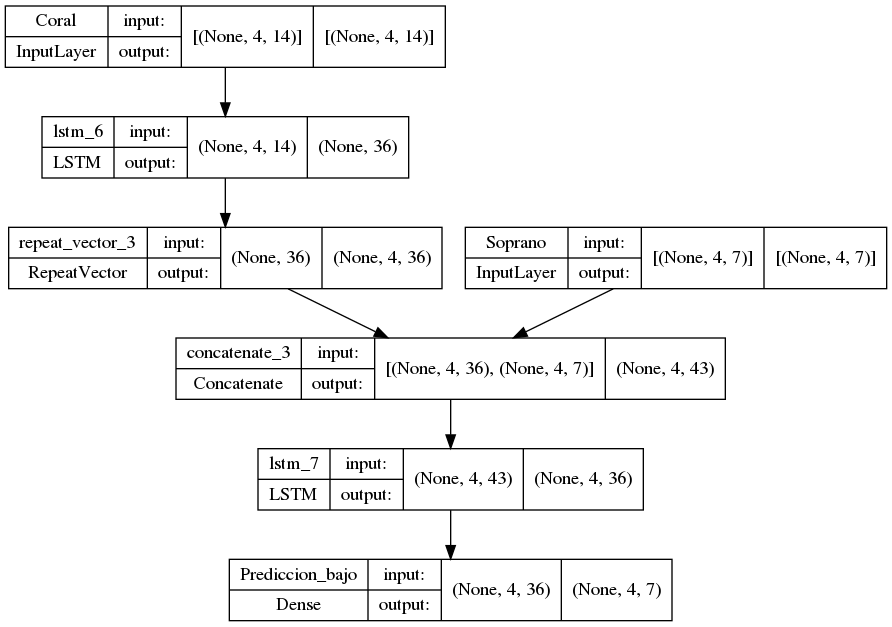

In [ ]:
# Creamos la red neuronal

input_1 = keras.Input(shape=(num_notas,size*2),name="Coral")
input_2 = keras.Input(shape=(num_notas,size),name="Soprano")

layers_1 = layers.LSTM(36)(input_1)
layers_1 = layers.RepeatVector(num_notas)(layers_1)

red_final = layers.concatenate([layers_1,input_2])

red_final = layers.LSTM(36,return_sequences=True)(red_final)
output = layers.Dense(size,name="Prediccion_bajo")(red_final)

model = keras.Model([input_1,input_2],output,name="W2v")
model.summary()

keras.utils.plot_model(model, graf_path + "w2v_model_baj.png", show_shapes=True)


In [ ]:
log_path = 'log/'

tb_callback = TensorBoard(
    log_dir=log_path,
    histogram_freq=2,
    write_graph=True
)
tb_callback.set_model(model)
callbacks = []
callbacks.append(tb_callback)

# A continuación se trata de crear el directorio log:
# - Si no existe se crea
# - Si ya existe se borran los datos que haya dentro de él

try:
    os.mkdir(log_path)
except:
    if OS_WINDOWS:
        !del log\*
    else:
        !rm log/*

rm: cannot remove 'log/train': Is a directory
rm: cannot remove 'log/validation': Is a directory



Epoch 1: mse improved from inf to 0.29812, saving model to model_current_best.h5


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:128: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).


Metrica igualdad mejorada de [0. 0. 0. 0.] a [0.12680979 0.15976036 0.17723415 0.19970045]
Metrica consonante mejorada de 0 a 0.6276834747878183

Epoch 1: mse improved from 0.29812 to 0.12173, saving model to model_current_best.h5
Metrica igualdad mejorada de [0.12680979 0.15976036 0.17723415 0.19970045] a [0.13629556 0.18172741 0.21717424 0.25661508]

Epoch 1: mse improved from 0.12173 to 0.10409, saving model to model_current_best.h5
Metrica igualdad mejorada de [0.13629556 0.18172741 0.21717424 0.25661508] a [0.13879181 0.17074388 0.23265102 0.28756865]

Epoch 1: mse improved from 0.10409 to 0.09827, saving model to model_current_best.h5

Epoch 1: mse improved from 0.09827 to 0.09259, saving model to model_current_best.h5
Metrica igualdad mejorada de [0.13879181 0.17074388 0.23265102 0.28756865] a [0.14478283 0.16974538 0.20968547 0.31203195]

Epoch 1: mse improved from 0.09259 to 0.08812, saving model to model_current_best.h5
Metrica igualdad mejorada de [0.14478283 0.16974538 0.20

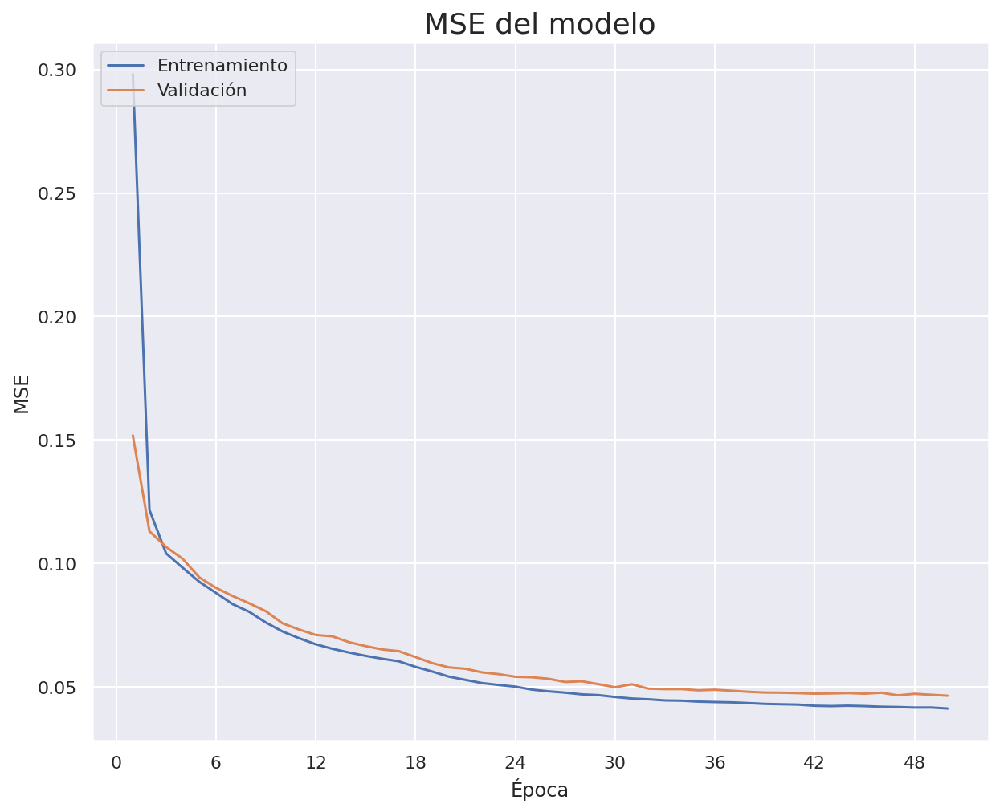

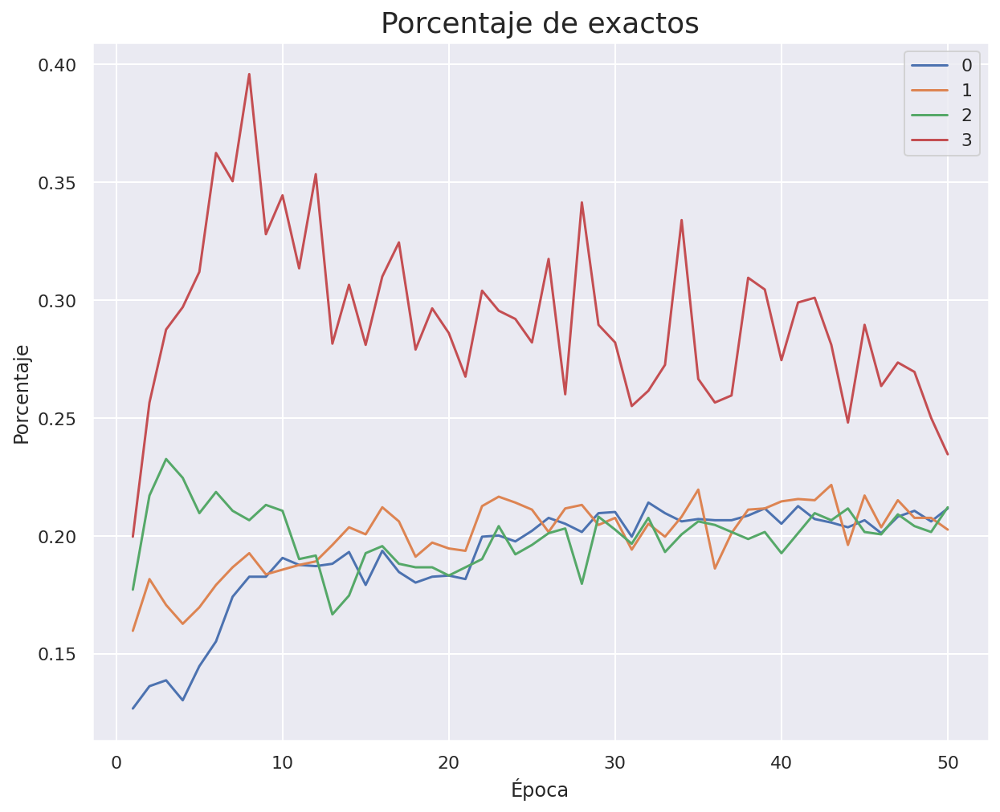

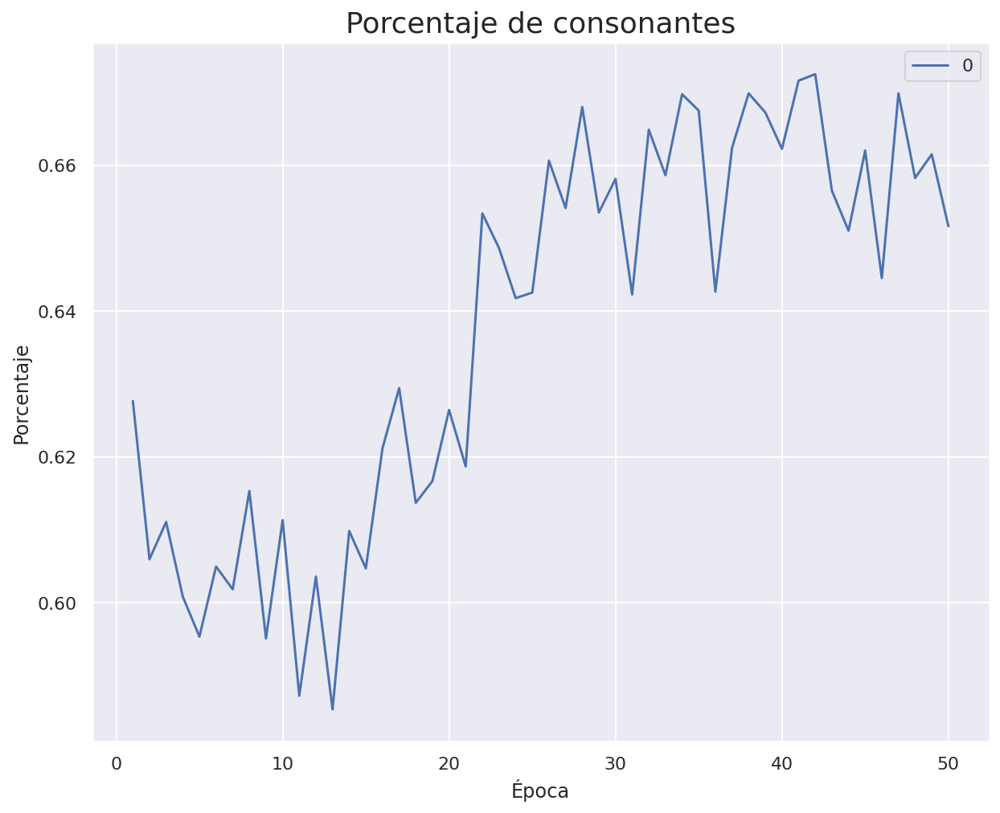


Epoch 1: mse did not improve from 0.04129


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:128: DeprecationWarning: Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).



Epoch 1: mse improved from 0.04129 to 0.04114, saving model to model_current_best.h5

Epoch 1: mse improved from 0.04114 to 0.04113, saving model to model_current_best.h5

Epoch 1: mse improved from 0.04113 to 0.04096, saving model to model_current_best.h5

Epoch 1: mse did not improve from 0.04096
Metrica consonante mejorada de 0.672491263105342 a 0.681228157763355

Epoch 1: mse did not improve from 0.04096

Epoch 1: mse improved from 0.04096 to 0.04057, saving model to model_current_best.h5

Epoch 1: mse improved from 0.04057 to 0.04046, saving model to model_current_best.h5

Epoch 1: mse did not improve from 0.04046

Epoch 1: mse improved from 0.04046 to 0.04027, saving model to model_current_best.h5

Epoch 1: mse improved from 0.04027 to 0.04010, saving model to model_current_best.h5

Epoch 1: mse improved from 0.04010 to 0.04001, saving model to model_current_best.h5

Epoch 1: mse did not improve from 0.04001

Epoch 1: mse improved from 0.04001 to 0.03987, saving model to model_c

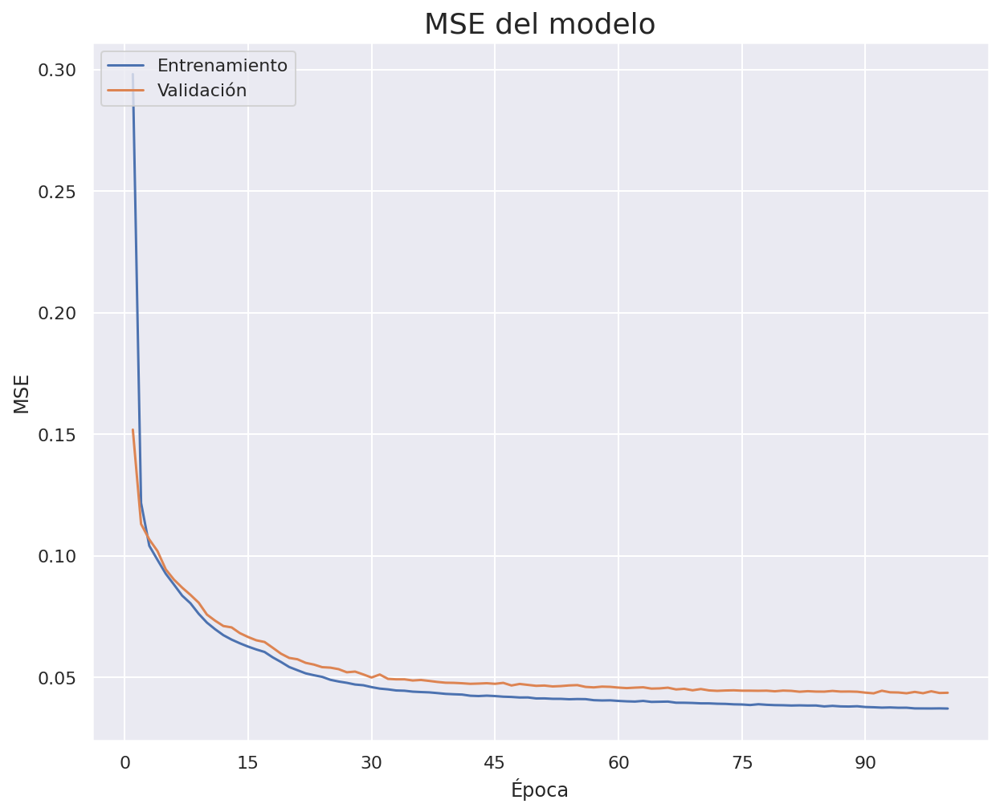

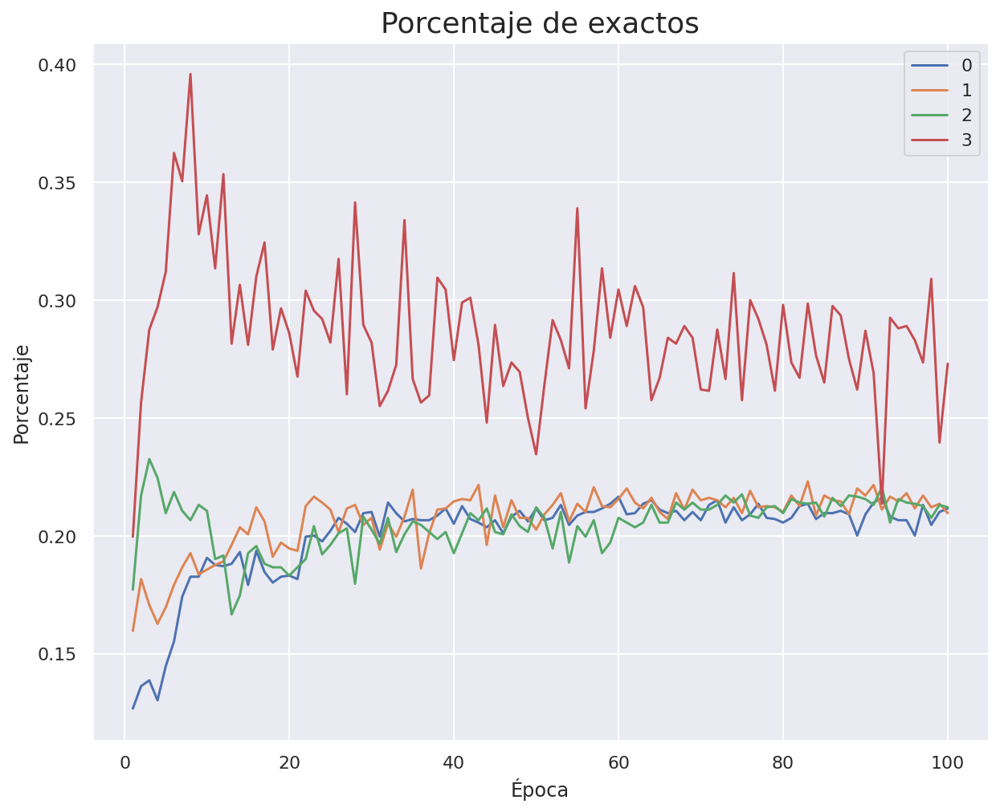

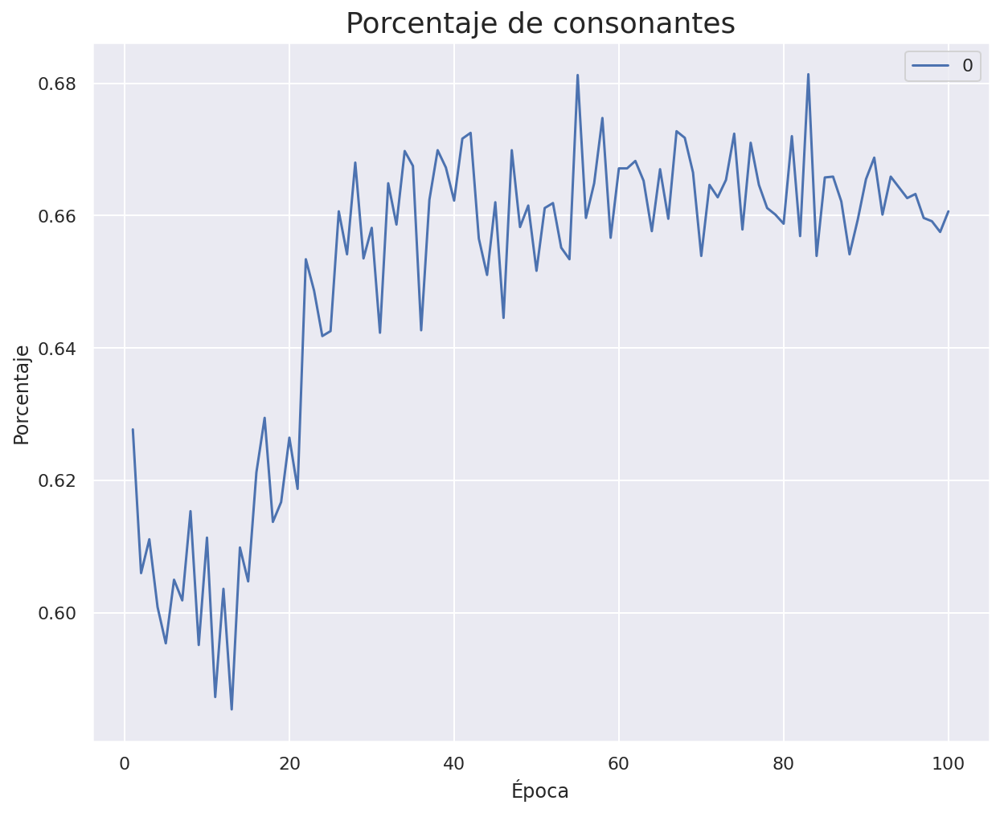

In [ ]:
# Entrenamos la red neuronal para diferentes epocas
epochs = 100
batch_size = 64
control_sobreajuste_val = True
grabar_detalles_training_para_tensorboard = True
met_mod = None
met_max = np.zeros(num_notas)
met_epoch = np.zeros(num_notas)

met_mod_con = None
met_max_con = 0
met_epoch_con = 0
# si no se van a analizar estos detalles en tensorboard mejor
# poner este flag a False ya que el grabarlos enlentence
# bastante el trainingmodel_current_best
model.compile(loss='mean_squared_error',
              optimizer='adam',
              metrics=['mse']) 

if not control_sobreajuste_val:
    history = model.fit([embed_train[:-1],embed_sop_train[1:]],
                        y_train, epochs=epochs,
                        batch_size=batch_size, verbose=2)
else:    
    acum_tr_mse = []
    acum_val_mse = []
    acum_met = []
    acum_met_con = []
    filepath="model_current_best.h5"
    checkpoint = ModelCheckpoint(filepath, monitor='mse', verbose=2, 
                                 save_best_only=True,
                                 mode='min') # graba sólo los que mejoran en validación

    if grabar_detalles_training_para_tensorboard:
        callbacks_list = callbacks + [checkpoint]
    else:
        callbacks_list = [checkpoint]
    
    
    for e in range(epochs):
        aux_1 = aug.scaling(aug.jitter(embed_train))
        aux_2 = aug.scaling(aug.jitter(embed_sop_train))
        history = model.fit([aux_1[:-1],aux_2[1:]], 
                            embed_baj_train[1:],
                            batch_size=batch_size,
                            epochs=1,
                            callbacks=callbacks_list,
                            verbose=0,
                            validation_data=([embed_val[:-1],embed_sop_val[1:]],
                                              embed_baj_val[1:]))
        

        res_prediction = model.predict([embed_val,embed_sop_val])

        met = metrica_iguales(ptos_cercanos(res_prediction,w2v),ptos_cercanos(embed_baj_val,w2v),num_notas)
        acum_met.append(met)
        if np.sum(met) > np.sum(met_max):
          print('Metrica igualdad mejorada de ' + str(met_max) + ' a ' + str(met))
          met_max = met
          met_mod = model
          model.save(path +  "met_mod.h5")
          met_epoch = epochs
        
        met_con = metrica_consonante(ptos_cercanos(res_prediction,w2v),ptos_cercanos(embed_baj_val,w2v))
        acum_met_con.append(met_con)
        if met_con > met_max_con:
          print('Metrica consonante mejorada de ' + str(met_max_con) + ' a ' + str(met_con))
          met_max_con = met_con
          met_mod_con = model
          model.save(path +  "met_mod_con.h5")
          met_epoch_con = epochs
          

        acum_tr_mse  += history.history['mse'] # mean_squared_error
        acum_val_mse += history.history['val_mse'] # val_mean_squared_error
        
        if (e+1)%50 == 0:
            grafica_entrenamiento(acum_tr_mse, acum_val_mse,"w2v_mse" + str((e+1)))
            grafica_metrica(acum_met,"Porcentaje de exactos","w2v_exactos"+ str((e+1)))
            grafica_metrica(acum_met_con,"Porcentaje de consonantes","w2v_consonantes"+ str((e+1)))

In [ ]:
# Mostramos los primeros 50 resultados
model = keras.models.load_model(path + 'met_mod_con.h5')
num_max = 50
sop = ptos_cercanos(embed_sop_test,w2v)
baj = ptos_cercanos(res_prediction,w2v)
for i in range(min(num_max,sop.shape[0])):
  print(i)
  play_musica(to_stream([sop[i],baj[i]]))

# Red neuronal 4 notas con Embeddings


In [ ]:
# Obtenemos los datos enventanados de cuatro notas del pickle o de los corals
datos_sop = []
datos_baj = []
datos_sol = []
voc = set()
num_notas = 4
train_perc = .6
val_perc = .8
tam = len(m21.corpus.chorales.ChoraleList().byBWV) 
punto_corte_1 = 0
punto_corte_2 = 0
conteo = 0
path = pick_path + "4_emb_sol/"

try:
  pickle_in = open(pick_path + str(num_notas) + "_datos_sop.pck","rb")
  datos_sop = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_baj.pck","rb")
  datos_baj = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_sol.pck","rb")
  datos_sol = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_cortes.pck","rb")
  ptos_corte = pickle.load(pickle_in)
  pickle_in.close()

  punto_corte_1,punto_corte_2 = ptos_corte

except:
  # Enventanamos los datos de la soprano y el bajo
  for coral in m21.corpus.chorales.ChoraleList().byBWV:
    x,y = enventanar(Coral(coral).voces_n['Soprano'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_sop.append(lista)
    x,y = enventanar(Coral(coral).voces_n['Bass'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_baj.append(lista)
    datos_sol.extend(y)
    conteo += 1
    if conteo == int(tam*train_perc):
      punto_corte_1 = len(datos_sop)
    if conteo == int(tam*val_perc):
      punto_corte_2 = len(datos_sop)
  
  pickle_out = open(pick_path + str(num_notas) + "_datos_sop.pck","wb")
  pickle.dump(datos_sop,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_baj.pck","wb")
  pickle.dump(datos_baj,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_sol.pck","wb")
  pickle.dump(datos_sol,pickle_out)
  pickle_out.close()

  ptos_corte = [punto_corte_1,punto_corte_2]
  pickle_out = open(pick_path + str(num_notas) + "_datos_cortes.pck","wb")
  pickle.dump(ptos_corte,pickle_out)
  pickle_out.close()

embed_sop = np.array(datos_sop,dtype='float32')
embed_baj = np.array(datos_baj,dtype='float32')

embed = np.concatenate((embed_sop,embed_baj),axis=1)
voc = np.unique(np.concatenate((embed_sop,embed_baj),axis=1))

embed_sop = to_index(embed_sop,voc)
embed_baj = to_index(embed_baj,voc)
embed = to_index(embed,voc)

# Separamos los datos en train, validation y test 
embed_train = embed[:punto_corte_1]
embed_sop_train = embed_sop[:punto_corte_1]
embed_baj_train = embed_baj[:punto_corte_1]
embed_test = embed[punto_corte_1:punto_corte_2]
embed_sop_test = embed_sop[punto_corte_1:punto_corte_2]
embed_baj_test = embed_baj[punto_corte_1:punto_corte_2]

embed_val = embed[punto_corte_2:]
embed_sop_val = embed_sop[punto_corte_2:]
embed_baj_val = embed_baj[punto_corte_2:]

In [ ]:
# Pasar a one hot y poner categorycal crossentropy min log loss
n_notas = len(np.unique(embed))
embed_baj_train_oh = np.zeros((embed_baj_train.shape[0],embed_baj_train.shape[1],n_notas))
for i in range(embed_baj_train.shape[0]):
  for j in range(embed_baj_train.shape[1]):
    embed_baj_train_oh[i][j][embed_baj_train[i][j].astype(int)] = 1

embed_baj_val_oh = np.zeros((embed_baj_val.shape[0],embed_baj_val.shape[1],n_notas))
for i in range(embed_baj_val.shape[0]):
  for j in range(embed_baj_val.shape[1]):
    embed_baj_val_oh[i][j][embed_baj_val[i][j].astype(int)] = 1

embed_baj_test_oh = np.zeros((embed_baj_test.shape[0],embed_baj_test.shape[1],n_notas))
for i in range(embed_baj_test.shape[0]):
  for j in range(embed_baj_test.shape[1]):
    embed_baj_test_oh[i][j][embed_baj_test[i][j].astype(int)] = 1

Model: "bajo"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Corales (InputLayer)           [(None, 8)]          0           []                               
                                                                                                  
 embedding (Embedding)          (None, 8, 12)        684         ['Corales[0][0]']                
                                                                                                  
 lstm_8 (LSTM)                  (None, 24)           3552        ['embedding[0][0]']              
                                                                                                  
 Soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                               

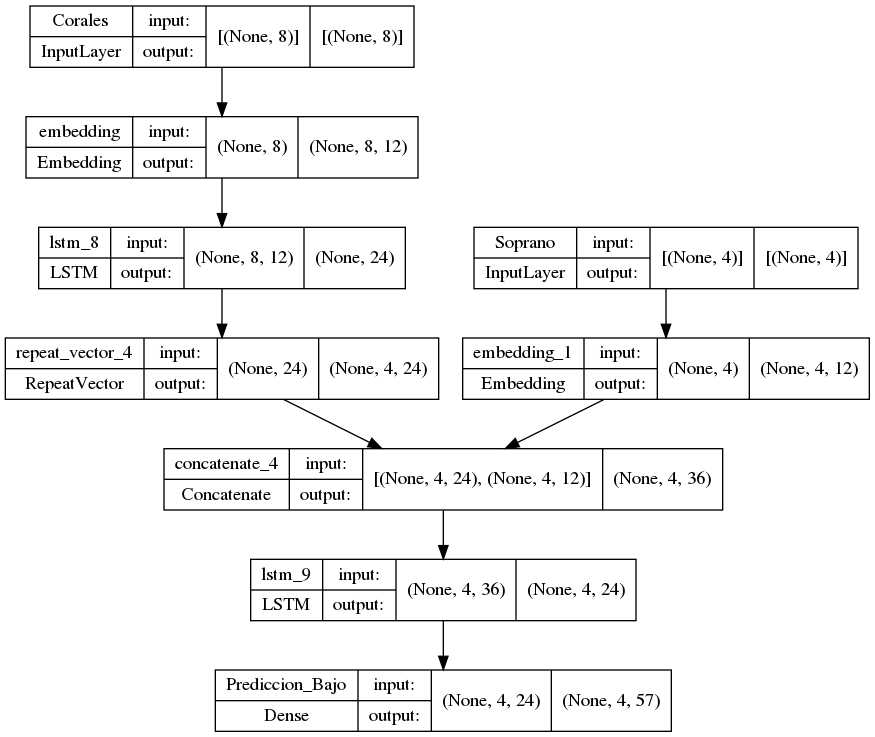

In [ ]:
input_1 = keras.Input(shape=(num_notas*2),name="Corales")
input_2 = keras.Input(shape=(num_notas), name="Soprano")

layers_1 = layers.Embedding(int(np.unique(embed)[-1]) + 1,12)(input_1)
layers_1 = layers.LSTM(24)(layers_1)
layers_1 = layers.RepeatVector(num_notas)(layers_1)

layers_2 = layers.Embedding(int(np.unique(embed)[-1]) + 1,12)(input_2)
red_final = layers.concatenate([layers_1,layers_2])

red_final = layers.LSTM(24,return_sequences=True)(red_final)
output = layers.Dense(n_notas, activation='softmax',name="Prediccion_Bajo")(red_final)

model = keras.Model([input_1,input_2],output,name="bajo")
model.summary()

keras.utils.plot_model(model, graf_path + "embedding_4_model_baj.png", show_shapes=True)

In [ ]:
log_path = 'log/'

tb_callback = TensorBoard(
    log_dir=log_path,
    histogram_freq=2,
    write_graph=True
)
tb_callback.set_model(model)
callbacks = []
callbacks.append(tb_callback)

# A continuación se trata de crear el directorio log:
# - Si no existe se crea
# - Si ya existe se borran los datos que haya dentro de él

try:
    os.mkdir(log_path)
except:
    if OS_WINDOWS:
        !del log\*
    else:
        !rm log/*

rm: cannot remove 'log/train': Is a directory
rm: cannot remove 'log/validation': Is a directory



Epoch 1: mse improved from inf to 0.01683, saving model to model_current_best.h5
Metrica igualdad mejorada de [0. 0. 0. 0.] a [0.21327757 0.20334553 0.20073183 0.20491375]
Metrica consonante mejorada de 0 a 0.7494772608468374

Epoch 1: mse improved from 0.01683 to 0.01636, saving model to model_current_best.h5
Metrica consonante mejorada de 0.7494772608468374 a 0.7519602718243596

Epoch 1: mse improved from 0.01636 to 0.01619, saving model to model_current_best.h5
Metrica igualdad mejorada de [0.21327757 0.20334553 0.20073183 0.20491375] a [0.21641401 0.2002091  0.24777836 0.26398327]
Metrica consonante mejorada de 0.7519602718243596 a 0.8413486670151594

Epoch 1: mse improved from 0.01619 to 0.01598, saving model to model_current_best.h5
Metrica igualdad mejorada de [0.21641401 0.2002091  0.24777836 0.26398327] a [0.27443806 0.24725562 0.24255097 0.24150549]
Metrica consonante mejorada de 0.8413486670151594 a 0.852848928384736

Epoch 1: mse improved from 0.01598 to 0.01565, saving mo

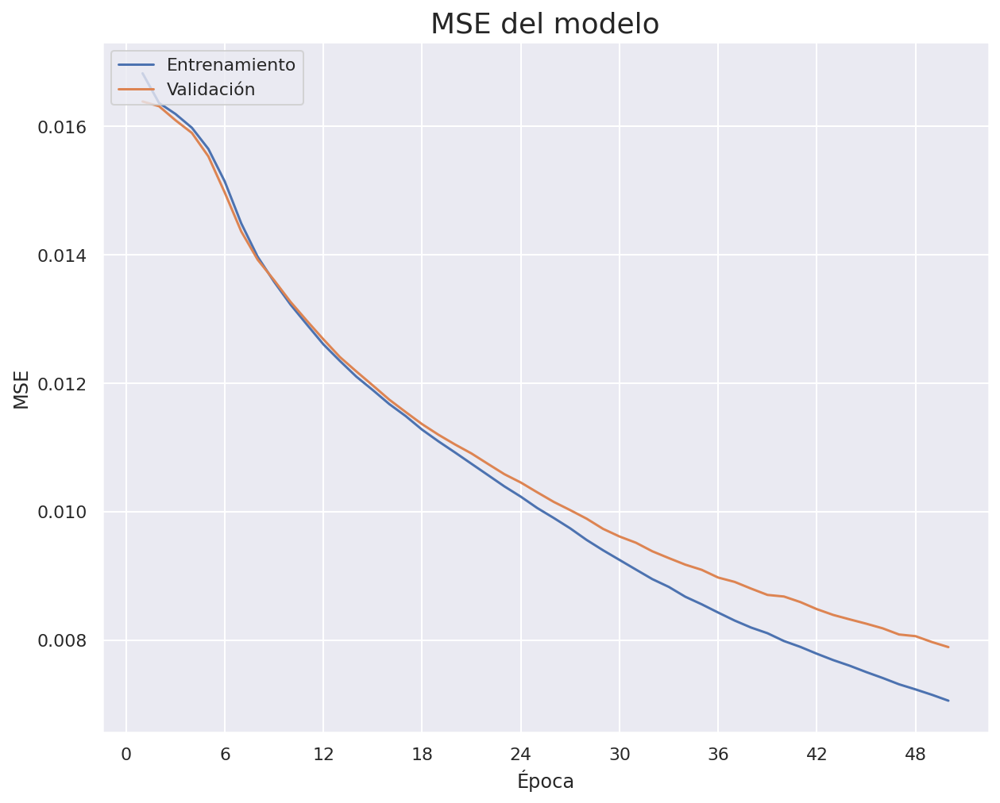

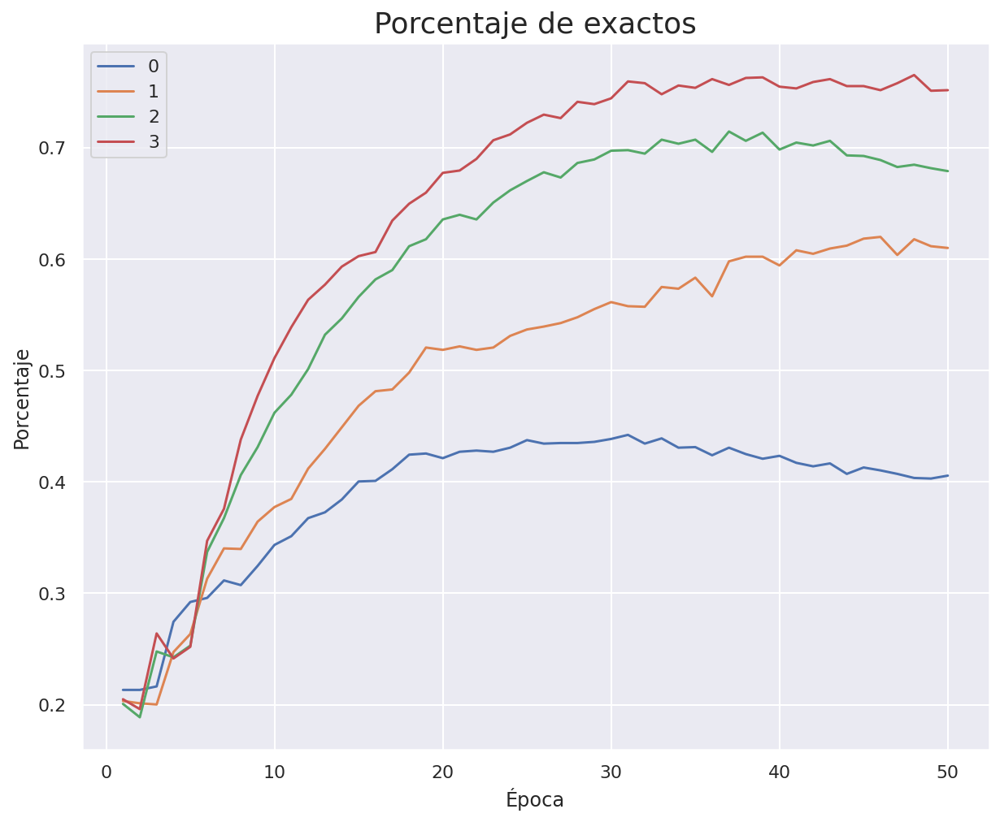

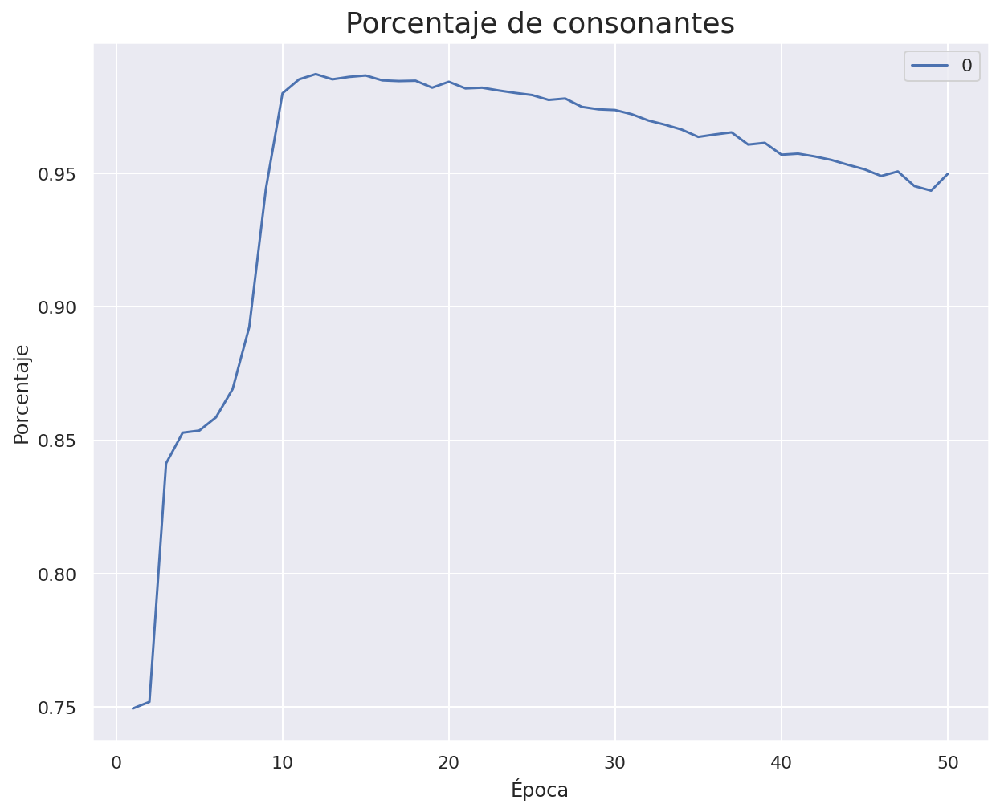


Epoch 1: mse improved from 0.00706 to 0.00696, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00696 to 0.00688, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00688 to 0.00679, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00679 to 0.00671, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00671 to 0.00665, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00665 to 0.00655, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00655 to 0.00649, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00649 to 0.00642, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00642 to 0.00636, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00636 to 0.00630, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00630 to 0.00624, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00624 to 0.00617, saving

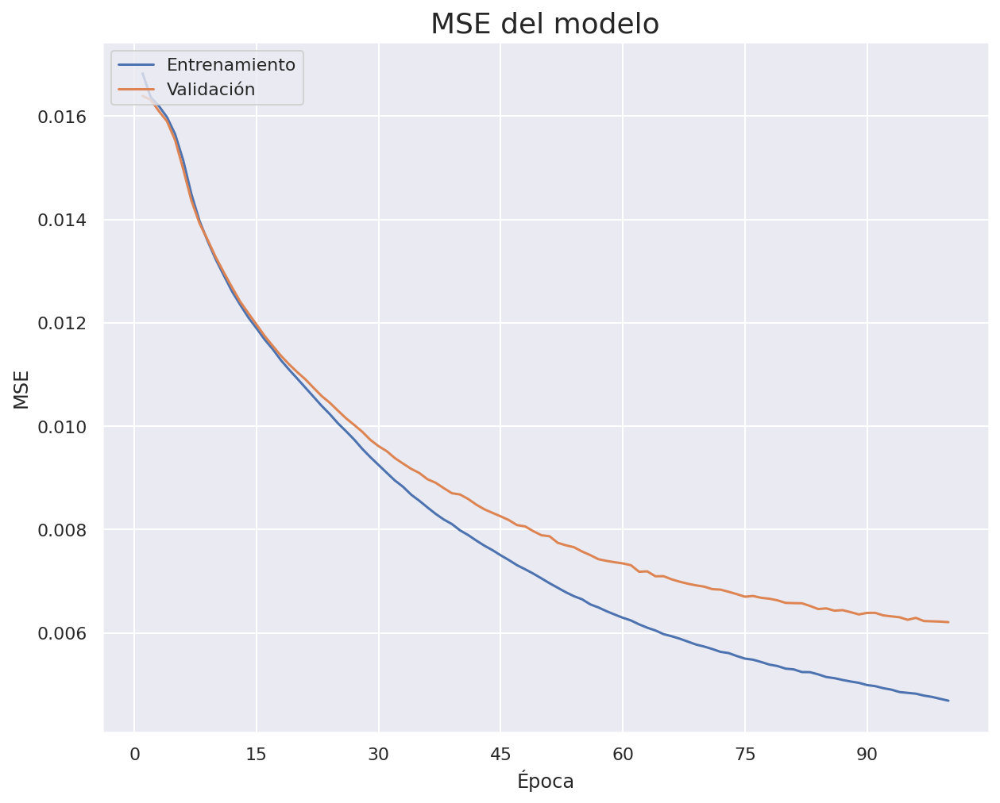

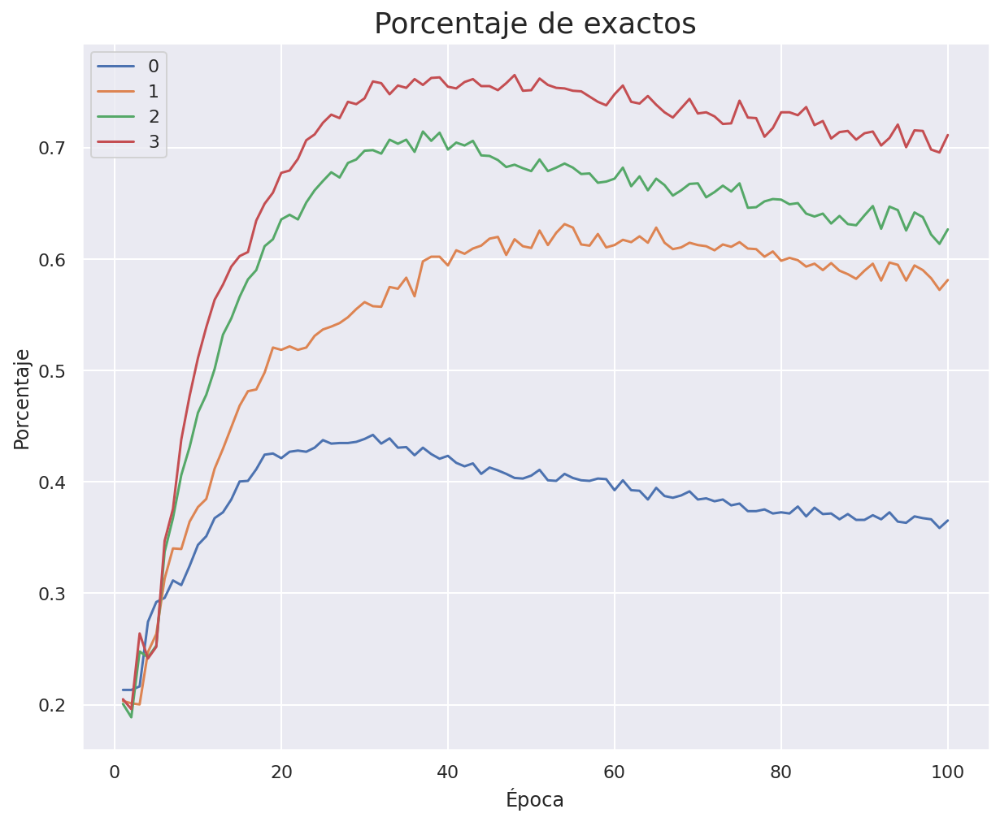

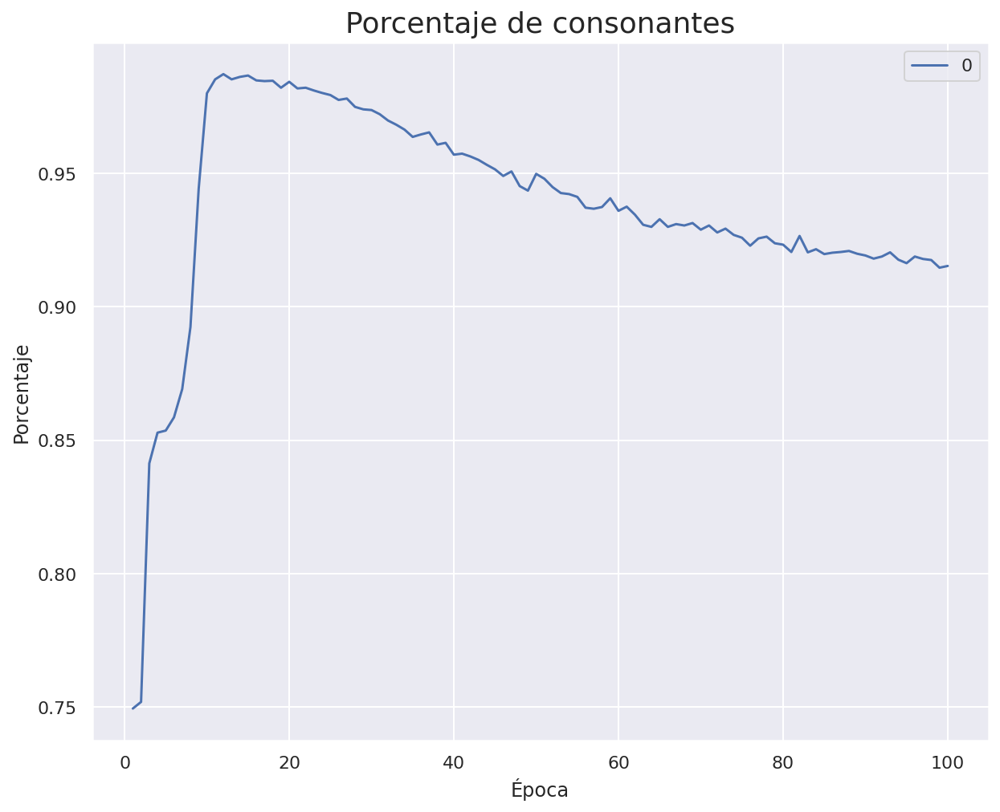

In [ ]:
# Entrenamos la red neuronal para diferentes epocas
# Batch nomalization
epochs = 100
batch_size = 64
control_sobreajuste_val = True
grabar_detalles_training_para_tensorboard = True
met_mod = None
met_max = np.zeros(num_notas)
met_epoch = np.zeros(num_notas)

met_mod_con = None
met_max_con = 0
met_epoch_con = 0
# si no se van a analizar estos detalles en tensorboard mejor
# poner este flag a False ya que el grabarlos enlentence
# bastante el trainingmodel_current_best
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              #optimizer=Adam(learning_rate=0.01), # más rápido
              metrics=['mse']) 

if not control_sobreajuste_val:
    history = model.fit([embed_train[:-1],embed_sop_train[1:]],
                        y_train, epochs=epochs,
                        batch_size=batch_size, verbose=2)
else:    
    acum_tr_mse = []
    acum_val_mse = []
    acum_met = []
    acum_met_con = []
    filepath="model_current_best.h5"
    checkpoint = ModelCheckpoint(filepath, monitor='mse', verbose=2, 
                                 save_best_only=True,
                                 mode='min') # graba sólo los que mejoran en validación

    if grabar_detalles_training_para_tensorboard:
        callbacks_list = callbacks + [checkpoint]
    else:
        callbacks_list = [checkpoint]
    
    
    for e in range(epochs):
        aux_1 = embed_train
        aux_2 = embed_sop_train
        history = model.fit([aux_1[:-1],aux_2[1:]], 
                            embed_baj_train_oh[1:],
                            batch_size=batch_size,
                            epochs=1,
                            callbacks=callbacks_list,
                            verbose=0,
                            validation_data=([embed_val[:-1],embed_sop_val[1:]],
                                              embed_baj_val_oh[1:]))
        

        
        prediccion = model.predict([embed_test,embed_sop_test])
        pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
        for i in range(pred_buena.shape[0]):
          for j in range(pred_buena.shape[1]):
            max_m = np.max(prediccion[i][j])
            pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
        res_prediction = to_nota(pred_buena,voc)

        met = metrica_iguales(res_prediction,to_nota(embed_baj_test,voc),num_notas)
        acum_met.append(met)
        if np.sum(met) > np.sum(met_max):
          print('Metrica igualdad mejorada de ' + str(met_max) + ' a ' + str(met))
          met_max = met
          met_mod = model
          model.save(path +  "met_mod.h5")
          met_epoch = epochs
        
        met_con = metrica_consonante(res_prediction,to_nota(embed_sop_test,voc))
        acum_met_con.append(met_con)
        if met_con > met_max_con:
          print('Metrica consonante mejorada de ' + str(met_max_con) + ' a ' + str(met_con))
          met_max_con = met_con
          met_mod_con = model
          model.save(path +  "met_mod_con.h5")
          met_epoch_con = epochs
          

        acum_tr_mse  += history.history['mse'] # mean_squared_error
        acum_val_mse += history.history['val_mse'] # val_mean_squared_error
        
        if (e+1)%50 == 0:
            grafica_entrenamiento(acum_tr_mse, acum_val_mse, "embedding_4_mse" + str(e+1))
            grafica_metrica(acum_met,"Porcentaje de exactos","embedding_4_exactos" + str(e+1))
            grafica_metrica(acum_met_con,"Porcentaje de consonantes","embedding_4_consonantes"+ str(e+1))

In [ ]:
model_baj = keras.models.load_model(path + 'met_mod_con.h5')
num_max = 50
prediccion = model_baj.predict([embed_test,embed_sop_test])
pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion[i][j])
    pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
sop = to_nota(embed_sop_test,voc)
baj = res_prediction
if sop.shape == baj.shape:
  for i in range(min(num_max,sop.shape[0])):
    print(i)
    play_musica(to_stream([sop[i],baj[i]]))

# Red neuronal 8 notas con Embeddings


In [ ]:
# Obtenemos los datos enventanados de cuatro notas del pickle o de los corals
datos_sop = []
datos_baj = []
datos_sol = []
voc = set()
num_notas = 8
train_perc = .6
val_perc = .8
tam = len(m21.corpus.chorales.ChoraleList().byBWV) 
punto_corte_1 = 0
punto_corte_2 = 0
conteo = 0
path = pick_path + "8_emb_sol/"

try:
  pickle_in = open(pick_path + str(num_notas) + "_datos_sop.pck","rb")
  datos_sop = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_baj.pck","rb")
  datos_baj = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_sol.pck","rb")
  datos_sol = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_cortes.pck","rb")
  ptos_corte = pickle.load(pickle_in)
  pickle_in.close()

  punto_corte_1,punto_corte_2 = ptos_corte

except:
  # Enventanamos los datos de la soprano y el bajo
  for coral in m21.corpus.chorales.ChoraleList().byBWV:
    x,y = enventanar(Coral(coral).voces_n['Soprano'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_sop.append(lista)
    x,y = enventanar(Coral(coral).voces_n['Bass'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_baj.append(lista)
    datos_sol.extend(y)
    conteo += 1
    if conteo == int(tam*train_perc):
      punto_corte_1 = len(datos_sop)
    if conteo == int(tam*val_perc):
      punto_corte_2 = len(datos_sop)
  
  pickle_out = open(pick_path + str(num_notas) + "_datos_sop.pck","wb")
  pickle.dump(datos_sop,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_baj.pck","wb")
  pickle.dump(datos_baj,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_sol.pck","wb")
  pickle.dump(datos_sol,pickle_out)
  pickle_out.close()

  ptos_corte = [punto_corte_1,punto_corte_2]
  pickle_out = open(pick_path + str(num_notas) + "_datos_cortes.pck","wb")
  pickle.dump(ptos_corte,pickle_out)
  pickle_out.close()

embed_sop = np.array(datos_sop,dtype='float32')
embed_baj = np.array(datos_baj,dtype='float32')

embed = np.concatenate((embed_sop,embed_baj),axis=1)
voc = np.unique(np.concatenate((embed_sop,embed_baj),axis=1))

embed_sop = to_index(embed_sop,voc)
embed_baj = to_index(embed_baj,voc)
embed = to_index(embed,voc)

# Separamos los datos en train, validation y test 
embed_train = embed[:punto_corte_1]
embed_sop_train = embed_sop[:punto_corte_1]
embed_baj_train = embed_baj[:punto_corte_1]
embed_test = embed[punto_corte_1:punto_corte_2]
embed_sop_test = embed_sop[punto_corte_1:punto_corte_2]
embed_baj_test = embed_baj[punto_corte_1:punto_corte_2]

embed_val = embed[punto_corte_2:]
embed_sop_val = embed_sop[punto_corte_2:]
embed_baj_val = embed_baj[punto_corte_2:]

In [ ]:
# Pasar a one hot y poner categorycal crossentropy min log loss
n_notas = len(np.unique(embed))
embed_baj_train_oh = np.zeros((embed_baj_train.shape[0],embed_baj_train.shape[1],n_notas))
for i in range(embed_baj_train.shape[0]):
  for j in range(embed_baj_train.shape[1]):
    embed_baj_train_oh[i][j][embed_baj_train[i][j].astype(int)] = 1

embed_baj_val_oh = np.zeros((embed_baj_val.shape[0],embed_baj_val.shape[1],n_notas))
for i in range(embed_baj_val.shape[0]):
  for j in range(embed_baj_val.shape[1]):
    embed_baj_val_oh[i][j][embed_baj_val[i][j].astype(int)] = 1

embed_baj_test_oh = np.zeros((embed_baj_test.shape[0],embed_baj_test.shape[1],n_notas))
for i in range(embed_baj_test.shape[0]):
  for j in range(embed_baj_test.shape[1]):
    embed_baj_test_oh[i][j][embed_baj_test[i][j].astype(int)] = 1

Model: "bajo"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_2 (Embedding)        (None, 16, 12)       684         ['Corales[0][0]']                
                                                                                                  
 lstm_10 (LSTM)                 (None, 24)           3552        ['embedding_2[0][0]']            
                                                                                                  
 Soprano (InputLayer)           [(None, 8)]          0           []                               
                                                                                               

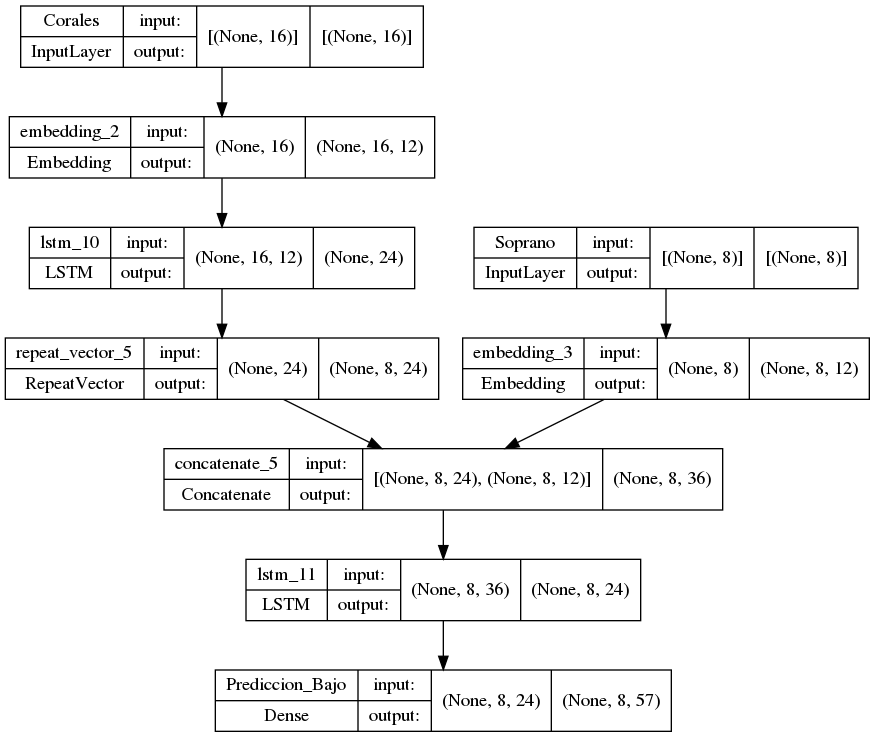

In [ ]:
input_1 = keras.Input(shape=(num_notas*2),name="Corales")
input_2 = keras.Input(shape=(num_notas), name="Soprano")

layers_1 = layers.Embedding(int(np.unique(embed)[-1]) + 1,12)(input_1)
layers_1 = layers.LSTM(24)(layers_1)
layers_1 = layers.RepeatVector(num_notas)(layers_1)

layers_2 = layers.Embedding(int(np.unique(embed)[-1]) + 1,12)(input_2)
red_final = layers.concatenate([layers_1,layers_2])

red_final = layers.LSTM(24,return_sequences=True)(red_final)
output = layers.Dense(n_notas, activation='softmax',name="Prediccion_Bajo")(red_final)

model = keras.Model([input_1,input_2],output,name="bajo")
model.summary()

keras.utils.plot_model(model, graf_path + "embedding_8_model_baj.png", show_shapes=True)

In [ ]:
log_path = 'log/'

tb_callback = TensorBoard(
    log_dir=log_path,
    histogram_freq=2,
    write_graph=True
)
tb_callback.set_model(model)
callbacks = []
callbacks.append(tb_callback)

# A continuación se trata de crear el directorio log:
# - Si no existe se crea
# - Si ya existe se borran los datos que haya dentro de él

try:
    os.mkdir(log_path)
except:
    if OS_WINDOWS:
        !del log\*
    else:
        !rm log/*

rm: cannot remove 'log/train': Is a directory
rm: cannot remove 'log/validation': Is a directory



Epoch 1: mse improved from inf to 0.01682, saving model to model_current_best.h5
Metrica igualdad mejorada de [0. 0. 0. 0. 0. 0. 0. 0.] a [0.21869688 0.2101983  0.20453258 0.20396601 0.20226629 0.20056657
 0.20113314 0.20623229]
Metrica consonante mejorada de 0 a 0.7495750708215297

Epoch 1: mse improved from 0.01682 to 0.01636, saving model to model_current_best.h5
Metrica consonante mejorada de 0.7495750708215297 a 0.7548158640226629

Epoch 1: mse improved from 0.01636 to 0.01629, saving model to model_current_best.h5
Metrica consonante mejorada de 0.7548158640226629 a 0.7963172804532578

Epoch 1: mse improved from 0.01629 to 0.01603, saving model to model_current_best.h5
Metrica consonante mejorada de 0.7963172804532578 a 0.8645892351274788

Epoch 1: mse improved from 0.01603 to 0.01587, saving model to model_current_best.h5
Metrica consonante mejorada de 0.8645892351274788 a 0.9041784702549575

Epoch 1: mse improved from 0.01587 to 0.01567, saving model to model_current_best.h5
Me

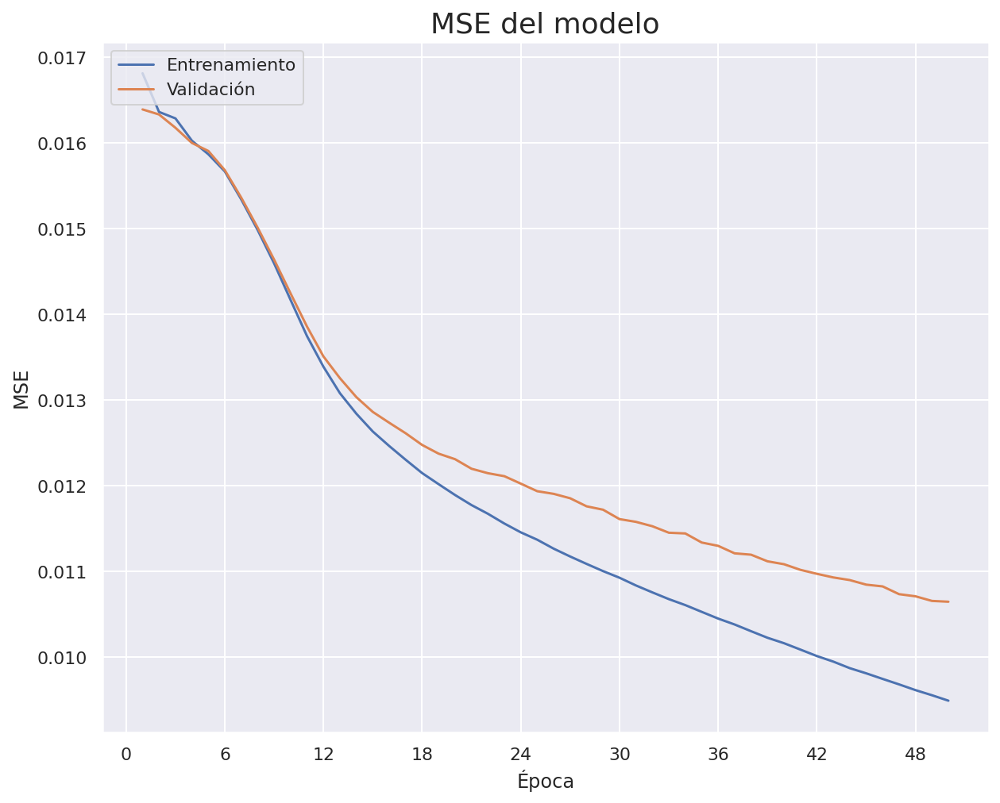

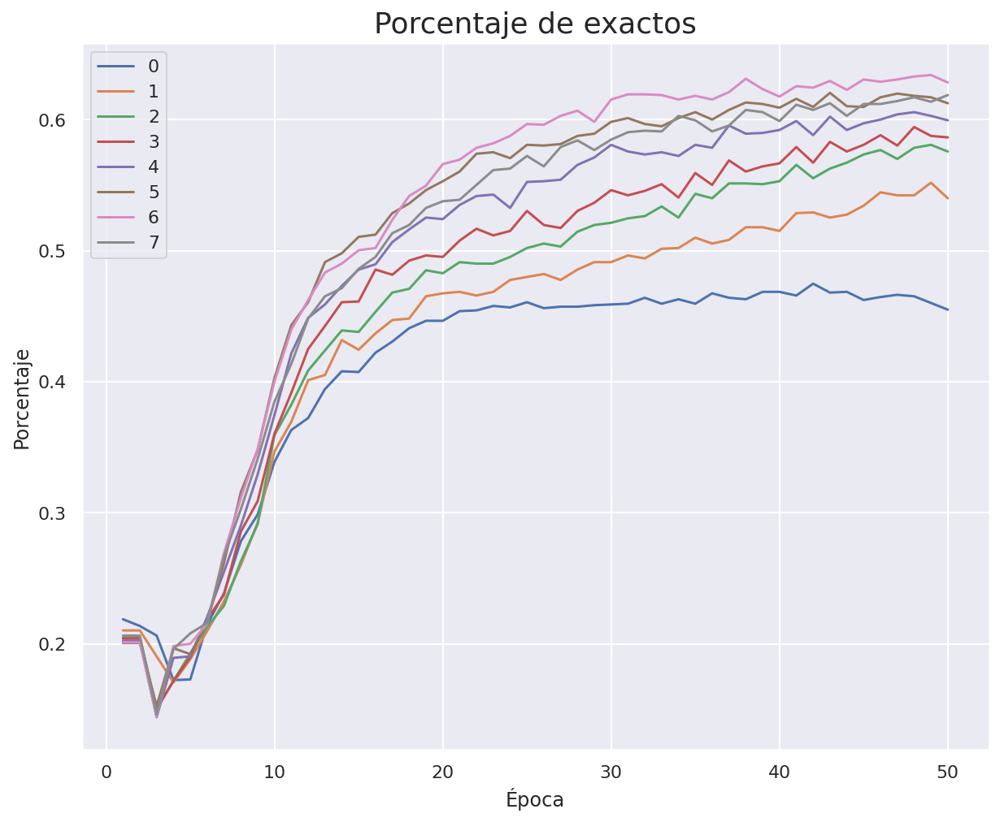

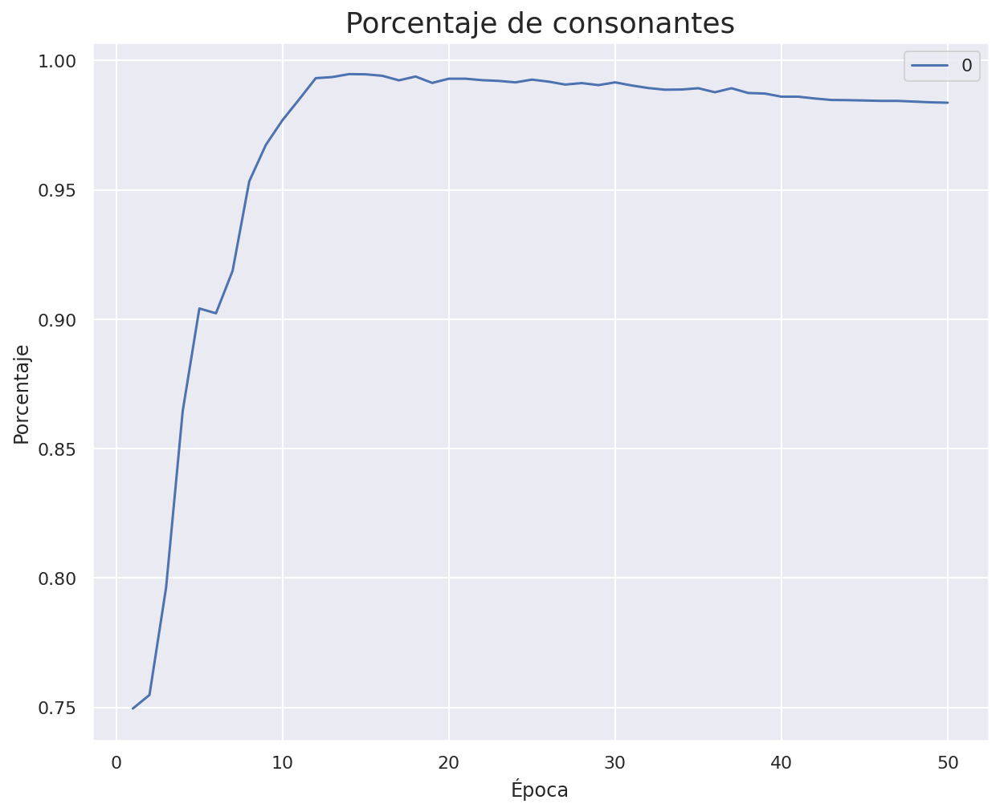


Epoch 1: mse improved from 0.00949 to 0.00944, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00944 to 0.00938, saving model to model_current_best.h5
Metrica igualdad mejorada de [0.46515581 0.54220963 0.57847025 0.59433428 0.60566572 0.61813031
 0.63286119 0.61699717] a [0.46062323 0.55977337 0.58073654 0.59773371 0.60679887 0.61473088
 0.63229462 0.61246459]

Epoch 1: mse improved from 0.00938 to 0.00931, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00931 to 0.00926, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00926 to 0.00920, saving model to model_current_best.h5

Epoch 1: mse improved from 0.00920 to 0.00914, saving model to model_current_best.h5
Metrica igualdad mejorada de [0.46062323 0.55977337 0.58073654 0.59773371 0.60679887 0.61473088
 0.63229462 0.61246459] a [0.4572238  0.56033994 0.60113314 0.59376771 0.60339943 0.61926346
 0.6305949  0.62322946]

Epoch 1: mse improved from 0.00914 to 0.00909, saving mod

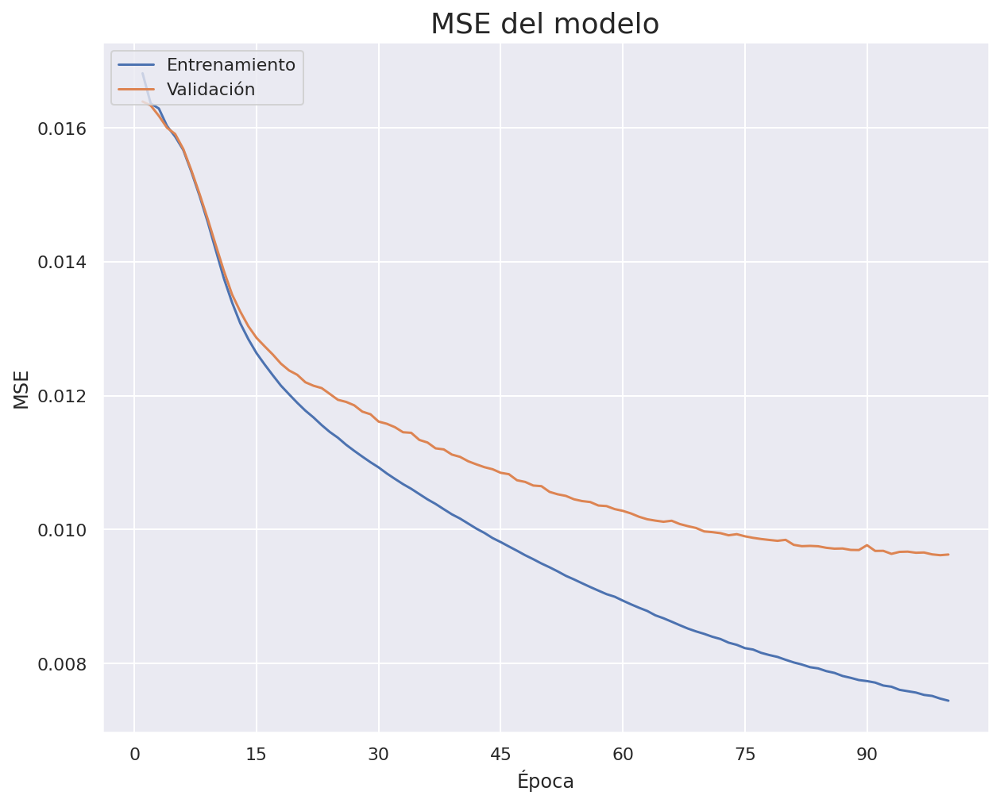

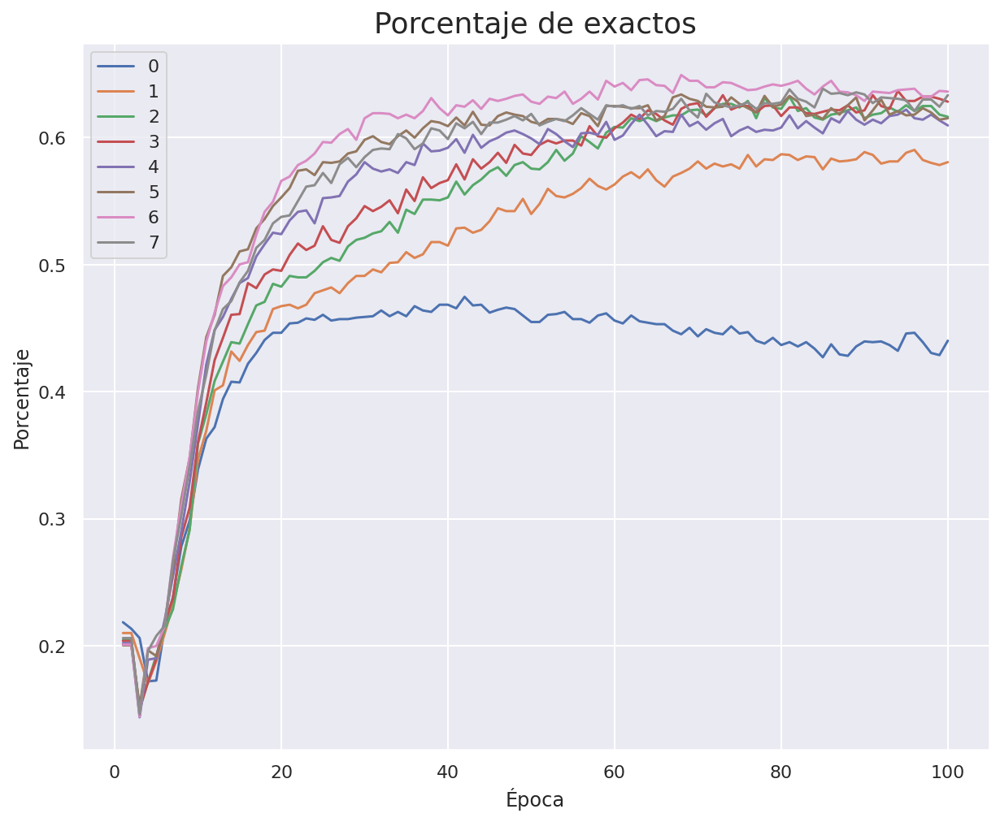

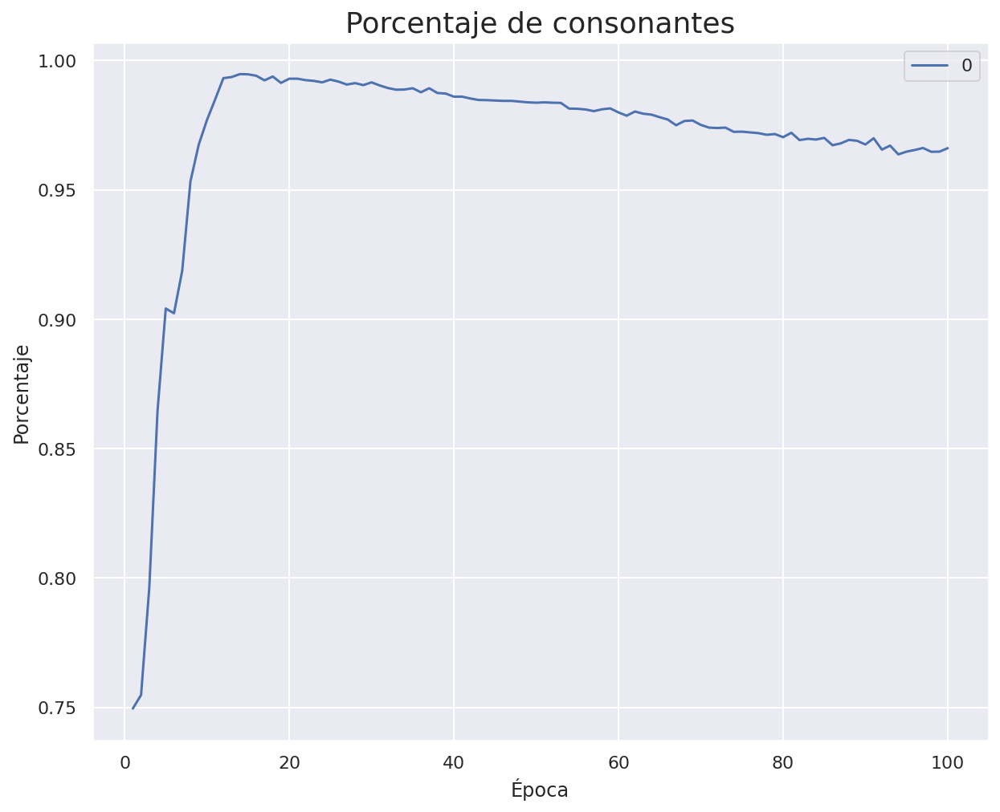

In [ ]:
# Entrenamos la red neuronal para diferentes epocas
# Batch nomalization
epochs = 100
batch_size = 64
control_sobreajuste_val = True
grabar_detalles_training_para_tensorboard = True
met_mod = None
met_max = np.zeros(num_notas)
met_epoch = np.zeros(num_notas)

met_mod_con = None
met_max_con = 0
met_epoch_con = 0
# si no se van a analizar estos detalles en tensorboard mejor
# poner este flag a False ya que el grabarlos enlentence
# bastante el trainingmodel_current_best
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              #optimizer=Adam(learning_rate=0.01), # más rápido
              metrics=['mse']) 

if not control_sobreajuste_val:
    history = model.fit([embed_train[:-1],embed_sop_train[1:]],
                        y_train, epochs=epochs,
                        batch_size=batch_size, verbose=2)
else:    
    acum_tr_mse = []
    acum_val_mse = []
    acum_met = []
    acum_met_con = []
    filepath="model_current_best.h5"
    checkpoint = ModelCheckpoint(filepath, monitor='mse', verbose=2, 
                                 save_best_only=True,
                                 mode='min') # graba sólo los que mejoran en validación

    if grabar_detalles_training_para_tensorboard:
        callbacks_list = callbacks + [checkpoint]
    else:
        callbacks_list = [checkpoint]
    
    
    for e in range(epochs):
        aux_1 = embed_train
        aux_2 = embed_sop_train
        history = model.fit([aux_1[:-1],aux_2[1:]], 
                            embed_baj_train_oh[1:],
                            batch_size=batch_size,
                            epochs=1,
                            callbacks=callbacks_list,
                            verbose=0,
                            validation_data=([embed_val[:-1],embed_sop_val[1:]],
                                              embed_baj_val_oh[1:]))
        

        
        prediccion = model.predict([embed_test,embed_sop_test])
        pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
        for i in range(pred_buena.shape[0]):
          for j in range(pred_buena.shape[1]):
            max_m = np.max(prediccion[i][j])
            pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
        res_prediction = to_nota(pred_buena,voc)

        met = metrica_iguales(res_prediction,to_nota(embed_baj_test,voc),num_notas)
        acum_met.append(met)
        if np.sum(met) > np.sum(met_max):
          print('Metrica igualdad mejorada de ' + str(met_max) + ' a ' + str(met))
          met_max = met
          met_mod = model
          model.save(path +  "met_mod.h5")
          met_epoch = epochs
        
        met_con = metrica_consonante(res_prediction,to_nota(embed_sop_test,voc))
        acum_met_con.append(met_con)
        if met_con > met_max_con:
          print('Metrica consonante mejorada de ' + str(met_max_con) + ' a ' + str(met_con))
          met_max_con = met_con
          met_mod_con = model
          model.save(path +  "met_mod_con.h5")
          met_epoch_con = epochs
          

        acum_tr_mse  += history.history['mse'] # mean_squared_error
        acum_val_mse += history.history['val_mse'] # val_mean_squared_error
        
        if (e+1)%50 == 0:
            grafica_entrenamiento(acum_tr_mse, acum_val_mse, "embedding_8_mse" + str(e+1))
            grafica_metrica(acum_met,"Porcentaje de exactos","embedding_8_exactos" + str(e+1))
            grafica_metrica(acum_met_con,"Porcentaje de consonantes","embedding_8_consonantes"+ str(e+1))

In [ ]:
model_baj = keras.models.load_model(path + 'met_mod_con.h5')
num_max = 50
prediccion = model_baj.predict([embed_test,embed_sop_test])
pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion[i][j])
    pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
sop = to_nota(embed_sop_test,voc)
baj = res_prediction
if sop.shape == baj.shape:
  for i in range(min(num_max,sop.shape[0])):
    print(i)
    play_musica(to_stream([sop[i],baj[i]]))

# Red neuronal 4 notas embeddings igual para todos


In [ ]:
# Obtenemos los datos enventanados de cuatro notas del pickle o de los corals
datos_sop = []
datos_baj = []
datos_sol = []
voc = set()
num_notas = 4
train_perc = .6
val_perc = .8
tam = len(m21.corpus.chorales.ChoraleList().byBWV) 
punto_corte_1 = 0
punto_corte_2 = 0
conteo = 0
path = pick_path + "4_emb_tod/"

try:
  pickle_in = open(pick_path + str(num_notas) + "_datos_sop.pck","rb")
  datos_sop = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_baj.pck","rb")
  datos_baj = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_sol.pck","rb")
  datos_sol = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_cortes.pck","rb")
  ptos_corte = pickle.load(pickle_in)
  pickle_in.close()

  punto_corte_1,punto_corte_2 = ptos_corte

except:
  # Enventanamos los datos de la soprano y el bajo
  for coral in m21.corpus.chorales.ChoraleList().byBWV:
    x,y = enventanar(Coral(coral).voces_n['Soprano'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_sop.append(lista)
    x,y = enventanar(Coral(coral).voces_n['Bass'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_baj.append(lista)
    datos_sol.extend(y)
    conteo += 1
    if conteo == int(tam*train_perc):
      punto_corte_1 = len(datos_sop)
    if conteo == int(tam*val_perc):
      punto_corte_2 = len(datos_sop)
  
  pickle_out = open(pick_path + str(num_notas) + "_datos_sop.pck","wb")
  pickle.dump(datos_sop,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_baj.pck","wb")
  pickle.dump(datos_baj,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_sol.pck","wb")
  pickle.dump(datos_sol,pickle_out)
  pickle_out.close()

  ptos_corte = [punto_corte_1,punto_corte_2]
  pickle_out = open(pick_path + str(num_notas) + "_datos_cortes.pck","wb")
  pickle.dump(ptos_corte,pickle_out)
  pickle_out.close()

embed_sop = np.array(datos_sop,dtype='float32')
embed_baj = np.array(datos_baj,dtype='float32')

embed = np.concatenate((embed_sop,embed_baj),axis=1)
voc = np.unique(embed)

embed_sop = to_index(embed_sop,voc)
embed_baj = to_index(embed_baj,voc)
embed = to_index(embed,voc)

# Separamos los datos en train, validation y test 
embed_train = embed[:punto_corte_1]
embed_sop_train = embed_sop[:punto_corte_1]
embed_baj_train = embed_baj[:punto_corte_1]
embed_test = embed[punto_corte_1:punto_corte_2]
embed_sop_test = embed_sop[punto_corte_1:punto_corte_2]
embed_baj_test = embed_baj[punto_corte_1:punto_corte_2]

embed_val = embed[punto_corte_2:]
embed_sop_val = embed_sop[punto_corte_2:]
embed_baj_val = embed_baj[punto_corte_2:]

print(embed_train.shape,embed_sop_train.shape,embed_baj_train.shape)
print(embed_val.shape,embed_sop_val.shape,embed_baj_val.shape)
print(embed_test.shape,embed_sop_test.shape,embed_baj_test.shape)

(5406, 8) (5406, 4) (5406, 4)
(2003, 8) (2003, 4) (2003, 4)
(1913, 8) (1913, 4) (1913, 4)


In [ ]:
# Pasar a one hot y poner categorycal crossentropy min log loss
n_notas = len(np.unique(embed))
embed_baj_train_oh = np.zeros((embed_baj_train.shape[0],embed_baj_train.shape[1],n_notas))
for i in range(embed_baj_train.shape[0]):
  for j in range(embed_baj_train.shape[1]):
    embed_baj_train_oh[i][j][embed_baj_train[i][j].astype(int)] = 1

embed_baj_val_oh = np.zeros((embed_baj_val.shape[0],embed_baj_val.shape[1],n_notas))
for i in range(embed_baj_val.shape[0]):
  for j in range(embed_baj_val.shape[1]):
    embed_baj_val_oh[i][j][embed_baj_val[i][j].astype(int)] = 1

embed_baj_test_oh = np.zeros((embed_baj_test.shape[0],embed_baj_test.shape[1],n_notas))
for i in range(embed_baj_test.shape[0]):
  for j in range(embed_baj_test.shape[1]):
    embed_baj_test_oh[i][j][embed_baj_test[i][j].astype(int)] = 1

Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                                  
 Bajo (InputLayer)              [(None, 4)]          0           []                               
                                                                                                  
 embedding_4 (Embedding)        (None, 4, 12)        684         ['Soprano[0][0]',                
                                                                  'Bajo[0][0]',                   
                                                                  'Soprano_adelantada[0][0]']     
                                                                                              

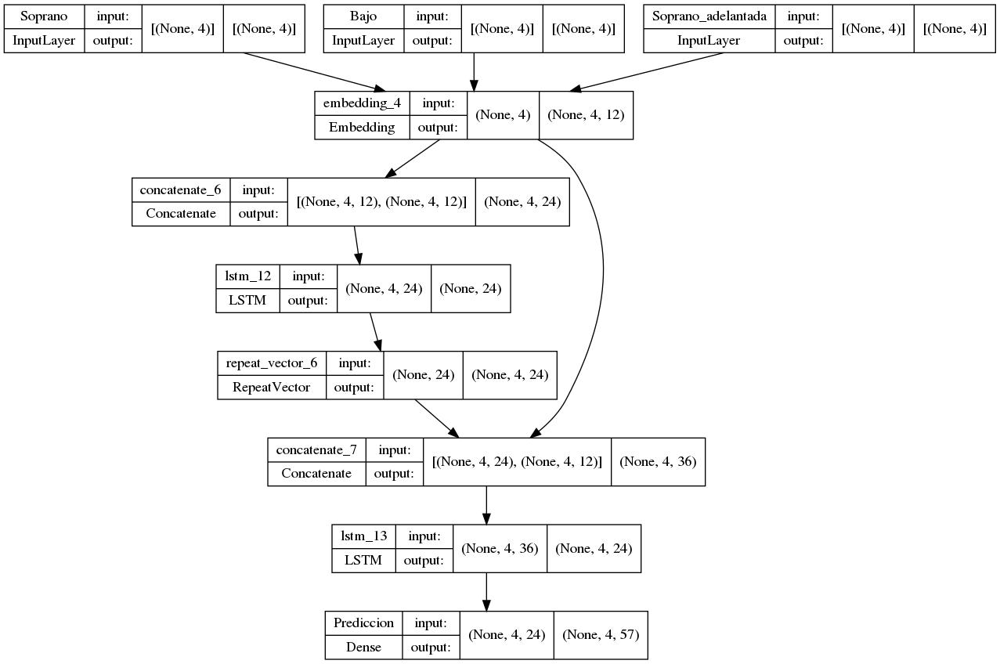

In [ ]:
n_notas = len(np.unique(embed))
input_1 = keras.Input(shape=(num_notas),name="Soprano")
input_1_5 = keras.Input(shape=(num_notas),name="Bajo")
input_2 = keras.Input(shape=(num_notas),name="Soprano_adelantada")

embedding_layer = layers.Embedding(n_notas,12)

layers_1_3 = embedding_layer(input_1)
layers_1_5 = embedding_layer(input_1_5)
layers_2 = embedding_layer(input_2)

layers_1 = layers.concatenate([layers_1_3,layers_1_5],axis=2)
layers_1 = layers.LSTM(24)(layers_1)
layers_1 = layers.RepeatVector(num_notas)(layers_1)

red_final = layers.concatenate([layers_1,layers_2])

red_final = layers.LSTM(24,return_sequences=True)(red_final)
output = layers.Dense(n_notas, activation='softmax',name="Prediccion")(red_final)

model = keras.Model([input_1,input_1_5,input_2],output,name="embed")
model.summary()

keras.utils.plot_model(model, graf_path + "embedding_4_juntos.png", show_shapes=True)

In [ ]:
log_path = 'log/'

tb_callback = TensorBoard(
    log_dir=log_path,
    histogram_freq=2,
    write_graph=True
)
tb_callback.set_model(model)
callbacks = []
callbacks.append(tb_callback)

# A continuación se trata de crear el directorio log:
# - Si no existe se crea
# - Si ya existe se borran los datos que haya dentro de él

try:
    os.mkdir(log_path)
except:
    if OS_WINDOWS:
        !del log\*
    else:
        !rm log/*

rm: cannot remove 'log/train': Is a directory
rm: cannot remove 'log/validation': Is a directory



Epoch 1: mse improved from -inf to 0.01688, saving model to model_current_best.h5
Metrica igualdad mejorada de [0. 0. 0. 0.] a [0.21327757 0.20334553 0.18975431 0.19654992]
Metrica consonante mejorada de 0 a 0.7519602718243596

Epoch 1: mse did not improve from 0.01688
Metrica igualdad mejorada de [0.21327757 0.20334553 0.18975431 0.19654992] a [0.20752744 0.20177731 0.20282279 0.20752744]
Metrica consonante mejorada de 0.7519602718243596 a 0.816257187663356

Epoch 1: mse did not improve from 0.01688
Metrica igualdad mejorada de [0.20752744 0.20177731 0.20282279 0.20752744] a [0.21327757 0.22948249 0.23052797 0.2096184 ]

Epoch 1: mse did not improve from 0.01688
Metrica igualdad mejorada de [0.21327757 0.22948249 0.23052797 0.2096184 ] a [0.23470988 0.2577104  0.28018819 0.24882384]
Metrica consonante mejorada de 0.816257187663356 a 0.8267119707266074

Epoch 1: mse did not improve from 0.01688
Metrica igualdad mejorada de [0.23470988 0.2577104  0.28018819 0.24882384] a [0.21536853 0.

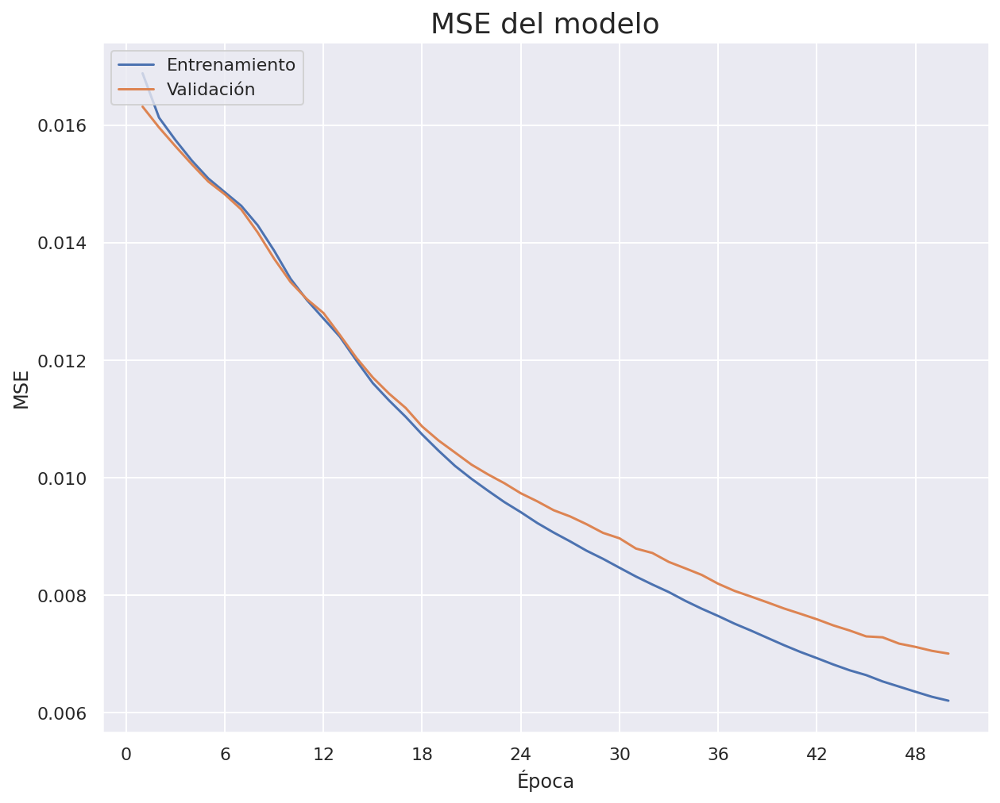

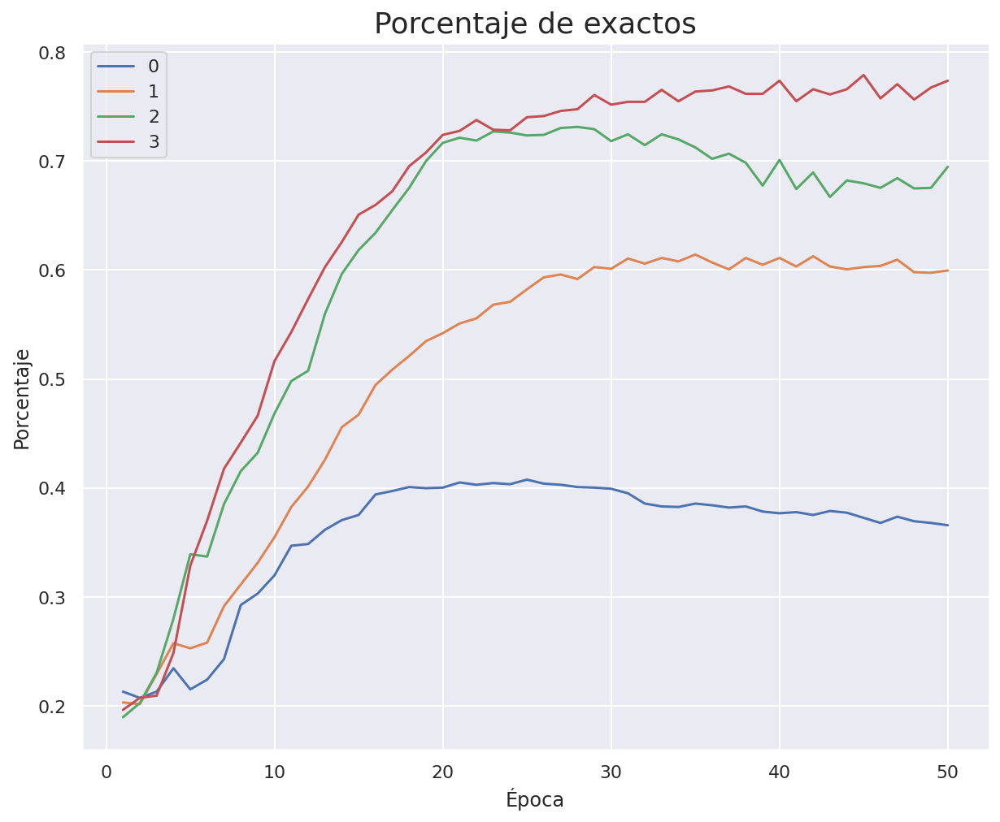

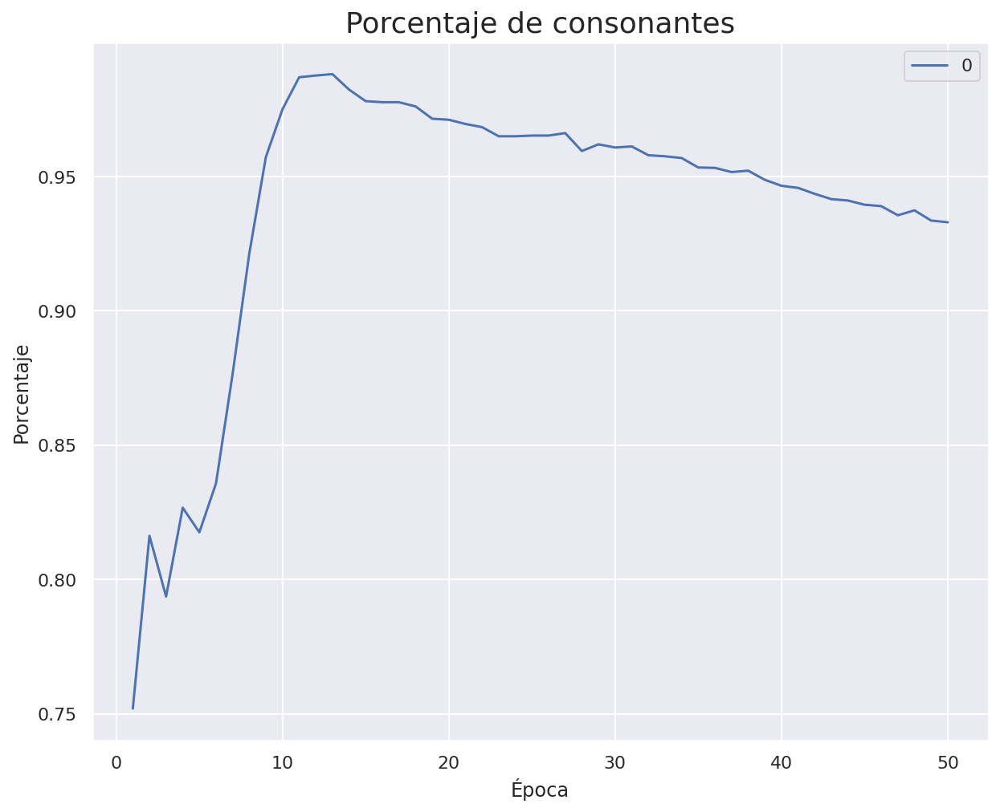


Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: mse did not improve from 0.01688

Epoch 1: m

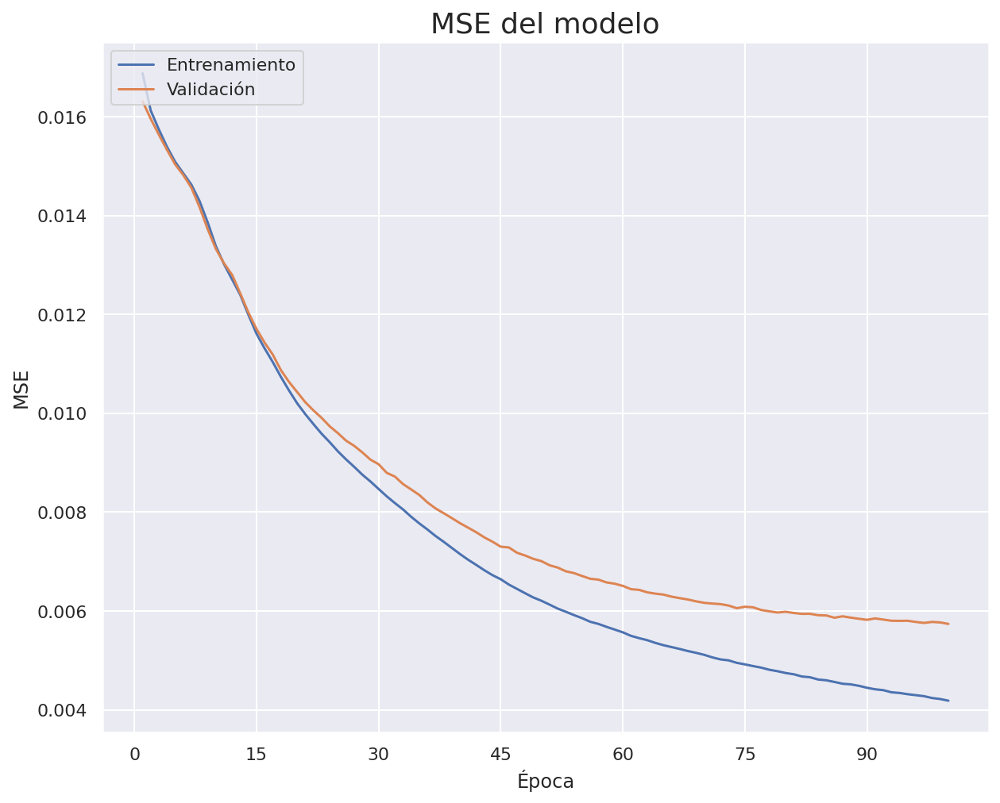

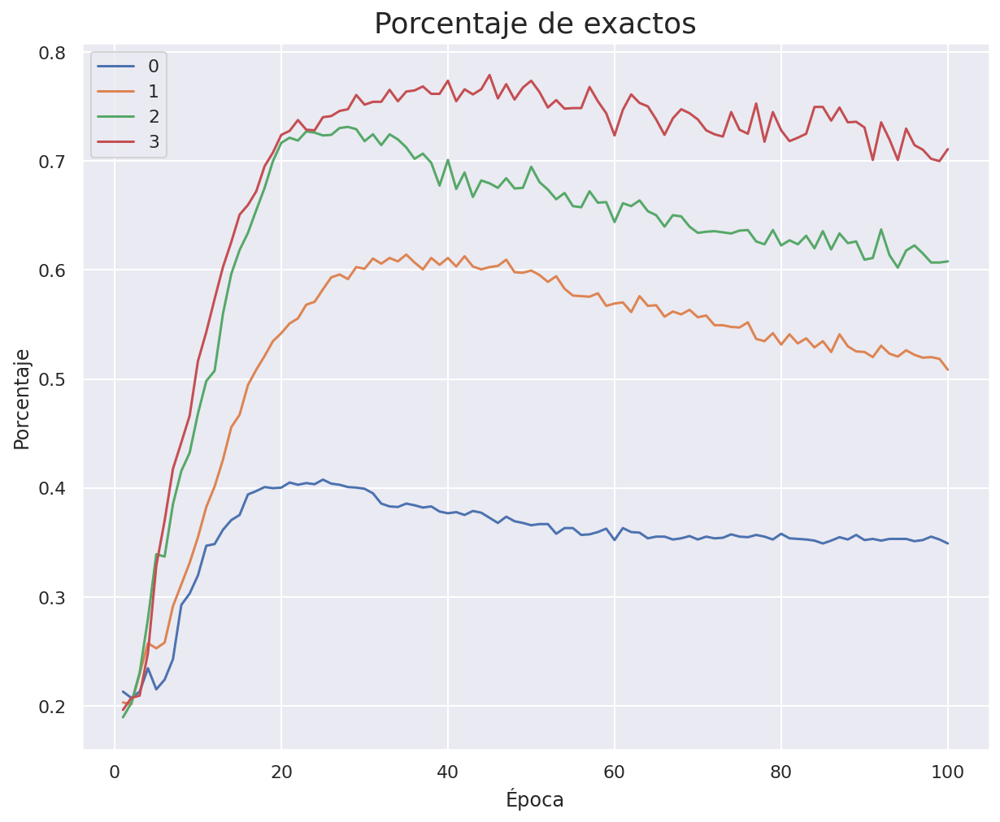

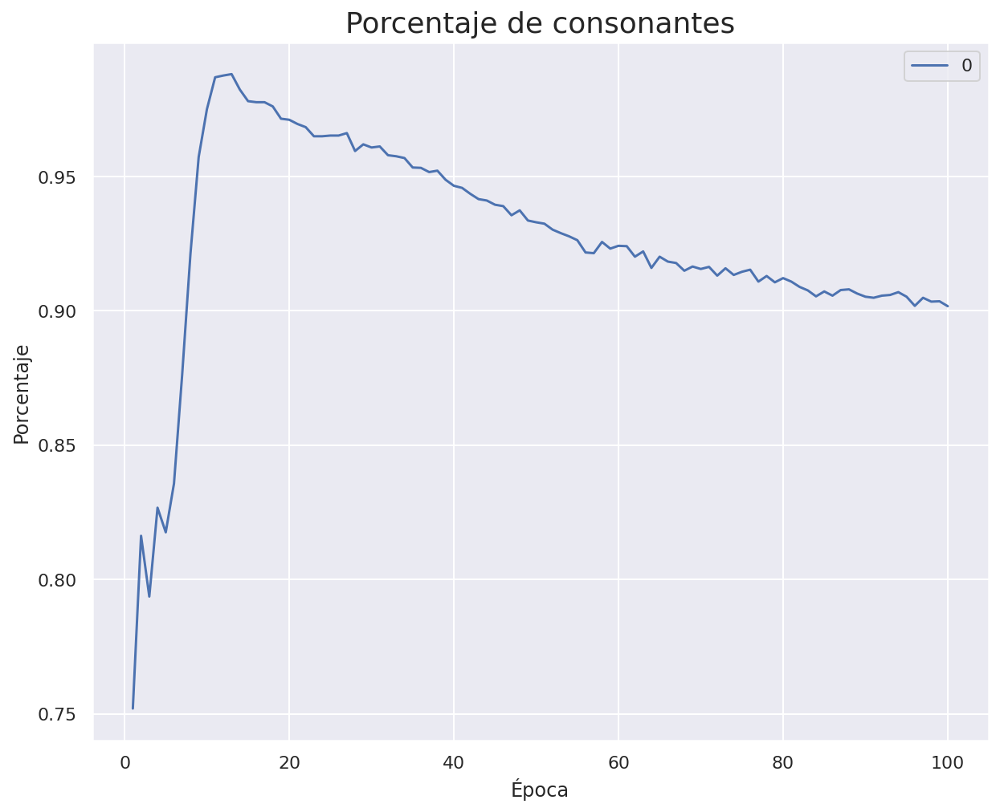

In [ ]:
# Entrenamos la red neuronal para diferentes epocas
# Batch nomalization
epochs = 100
batch_size = 64
control_sobreajuste_val = True
grabar_detalles_training_para_tensorboard = True
met_mod = None
met_max = np.zeros(num_notas)
met_epoch = np.zeros(num_notas)

met_mod_con = None
met_max_con = 0
met_epoch_con = 0
# si no se van a analizar estos detalles en tensorboard mejor
# poner este flag a False ya que el grabarlos enlentence
# bastante el trainingmodel_current_best
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              #optimizer=Adam(learning_rate=0.01), # más rápido
              metrics=['mse']) 

if not control_sobreajuste_val:
    history = model.fit([embed_sop_train[:-1],embed_baj_train[:-1],embed_sop_train[1:]],
                        y_train, epochs=epochs,
                        batch_size=batch_size, verbose=2)
else:    
    acum_tr_mse = []
    acum_val_mse = []
    acum_met = []
    acum_met_con = []
    filepath="model_current_best.h5"
    checkpoint = ModelCheckpoint(filepath, monitor='mse', verbose=2, 
                                 save_best_only=True,
                                 mode='max') # graba sólo los que mejoran en validación

    if grabar_detalles_training_para_tensorboard:
        callbacks_list = callbacks + [checkpoint]
    else:
        callbacks_list = [checkpoint]
    
    
    for e in range(epochs):
        aux_1 = embed_sop_train
        aux_1_5 = embed_baj_train
        aux_2 = embed_sop_train
        history = model.fit([aux_1[:-1],aux_1_5[:-1],aux_2[1:]], 
                            embed_baj_train_oh[1:],
                            batch_size=batch_size,
                            epochs=1,
                            callbacks=callbacks_list,
                            verbose=0,
                            validation_data=([embed_sop_val[:-1],embed_baj_val[:-1],embed_sop_val[1:]],
                                              embed_baj_val_oh[1:]))
        

        
        prediccion = model.predict([embed_sop_test,embed_baj_test,embed_sop_test])
        pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
        for i in range(pred_buena.shape[0]):
          for j in range(pred_buena.shape[1]):
            max_m = np.max(prediccion[i][j])
            pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
        res_prediction = to_nota(pred_buena,voc)

        met = metrica_iguales(res_prediction,to_nota(embed_baj_test,voc),num_notas)
        acum_met.append(met)
        if np.sum(met) > np.sum(met_max):
          print('Metrica igualdad mejorada de ' + str(met_max) + ' a ' + str(met))
          met_max = met
          met_mod = model
          model.save(path +  "met_mod.h5")
          met_epoch = epochs
        
        met_con = metrica_consonante(res_prediction,to_nota(embed_sop_test,voc))
        acum_met_con.append(met_con)
        if met_con > met_max_con:
          print('Metrica consonante mejorada de ' + str(met_max_con) + ' a ' + str(met_con))
          met_max_con = met_con
          met_mod_con = model
          model.save(path +  "met_mod_con.h5")
          met_epoch_con = epochs
          

        acum_tr_mse  += history.history['mse'] # mean_squared_error
        acum_val_mse += history.history['val_mse'] # val_mean_squared_error
        
        if (e+1)%50 == 0:
            grafica_entrenamiento(acum_tr_mse, acum_val_mse,"embedding_4_junto_mse")
            grafica_metrica(acum_met,"Porcentaje de exactos","embedding_4_junto_exacto")
            grafica_metrica(acum_met_con,"Porcentaje de consonantes","embedding_4_junto_consonante")

In [ ]:
model = keras.models.load_model(path + 'met_mod_con.h5')
num_max = 50
prediccion = model.predict([embed_sop_test,embed_baj_test,embed_sop_test])
pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion[i][j])
    pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
sop = to_nota(embed_sop_test,voc)
baj = res_prediction
if sop.shape == baj.shape:
  for i in range(min(num_max,sop.shape[0])):
    print(i)
    play_musica(to_stream([sop[i],baj[i]]))

In [ ]:
# Obtenemos los datos enventanados de cuatro notas del pickle o de los corals
datos_sop = []
datos_baj = []
datos_sol = []
voc = set()
num_notas = 4
train_perc = .6
val_perc = .8
tam = len(m21.corpus.chorales.ChoraleList().byBWV) 
punto_corte_1 = 0
punto_corte_2 = 0
conteo = 0
path = pick_path + "emb_dob/"

try:
  pickle_in = open(pick_path + str(num_notas) + "_datos_sop.pck","rb")
  datos_sop = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_alt.pck","rb")
  datos_alt = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_ten.pck","rb")
  datos_ten = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_baj.pck","rb")
  datos_baj = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_cortes.pck","rb")
  ptos_corte = pickle.load(pickle_in)
  pickle_in.close()

  punto_corte_1,punto_corte_2 = ptos_corte

except:
  # Enventanamos los datos de la soprano y el bajo
  for coral in m21.corpus.chorales.ChoraleList().byBWV:
    x,y = enventanar(Coral(coral).voces_n['Soprano'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_sop.append(lista)
    x,y = enventanar(Coral(coral).voces_n['Bass'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_baj.append(lista)
    datos_sol.extend(y)
    conteo += 1
    if conteo == int(tam*train_perc):
      punto_corte_1 = len(datos_sop)
    if conteo == int(tam*val_perc):
      punto_corte_2 = len(datos_sop)
  
  pickle_out = open(pick_path + str(num_notas) + "_datos_sop.pck","wb")
  pickle.dump(datos_sop,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_baj.pck","wb")
  pickle.dump(datos_baj,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_ten.pck","wb")
  pickle.dump(datos_ten,pickle_out)
  pickle_out.close()

  ptos_corte = [punto_corte_1,punto_corte_2]
  pickle_out = open(pick_path + str(num_notas) + "_datos_cortes.pck","wb")
  pickle.dump(ptos_corte,pickle_out)
  pickle_out.close()

embed_sop = np.array(datos_sop,dtype='float32')
embed_alt = np.array(datos_alt,dtype='float32')
embed_ten = np.array(datos_ten,dtype='float32')
embed_baj = np.array(datos_baj,dtype='float32')

embed = np.concatenate((embed_sop,embed_alt,embed_ten,embed_baj),axis=1)
voc = np.unique(np.concatenate((embed_sop,embed_alt,embed_ten,embed_baj),axis=1))

embed_sop = to_index(embed_sop,voc)
embed_alt = to_index(embed_alt,voc)
embed_ten = to_index(embed_ten,voc)
embed_baj = to_index(embed_baj,voc)
embed = to_index(embed,voc)

# Separamos los datos en train, validation y test 
embed_train = embed[:punto_corte_1]
embed_sop_train = embed_sop[:punto_corte_1]
embed_alt_train = embed_alt[:punto_corte_1]
embed_ten_train = embed_ten[:punto_corte_1]
embed_baj_train = embed_baj[:punto_corte_1]

embed_test = embed[punto_corte_1:punto_corte_2]
embed_sop_test = embed_sop[punto_corte_1:punto_corte_2]
embed_alt_test = embed_alt[punto_corte_1:punto_corte_2]
embed_ten_test = embed_ten[punto_corte_1:punto_corte_2]
embed_baj_test = embed_baj[punto_corte_1:punto_corte_2]

embed_val = embed[punto_corte_2:]
embed_sop_val = embed_sop[punto_corte_2:]
embed_alt_val = embed_alt[punto_corte_2:]
embed_ten_val = embed_ten[punto_corte_2:]
embed_baj_val = embed_baj[punto_corte_2:]

print(embed_train.shape,embed_sop_train.shape,embed_ten_train.shape)
print(embed_val.shape,embed_sop_val.shape,embed_ten_val.shape)
print(embed_test.shape,embed_sop_test.shape,embed_ten_test.shape)

(5406, 16) (5406, 4) (5406, 4)
(2003, 16) (2003, 4) (2003, 4)
(1913, 16) (1913, 4) (1913, 4)


In [ ]:
# Pasar a one hot y poner categorycal crossentropy min log loss
n_notas = len(np.unique(embed))
embed_baj_train_oh = np.zeros((embed_baj_train.shape[0],embed_baj_train.shape[1],n_notas))
for i in range(embed_baj_train.shape[0]):
  for j in range(embed_baj_train.shape[1]):
    embed_baj_train_oh[i][j][embed_baj_train[i][j].astype(int)] = 1

embed_baj_val_oh = np.zeros((embed_baj_val.shape[0],embed_baj_val.shape[1],n_notas))
for i in range(embed_baj_val.shape[0]):
  for j in range(embed_baj_val.shape[1]):
    embed_baj_val_oh[i][j][embed_baj_val[i][j].astype(int)] = 1

embed_baj_test_oh = np.zeros((embed_baj_test.shape[0],embed_baj_test.shape[1],n_notas))
for i in range(embed_baj_test.shape[0]):
  for j in range(embed_baj_test.shape[1]):
    embed_baj_test_oh[i][j][embed_baj_test[i][j].astype(int)] = 1

embed_alt_train_oh = np.zeros((embed_alt_train.shape[0],embed_alt_train.shape[1],n_notas))
for i in range(embed_alt_train.shape[0]):
  for j in range(embed_alt_train.shape[1]):
    embed_alt_train_oh[i][j][embed_alt_train[i][j].astype(int)] = 1

embed_alt_val_oh = np.zeros((embed_alt_val.shape[0],embed_alt_val.shape[1],n_notas))
for i in range(embed_alt_val.shape[0]):
  for j in range(embed_alt_val.shape[1]):
    embed_alt_val_oh[i][j][embed_alt_val[i][j].astype(int)] = 1

embed_alt_test_oh = np.zeros((embed_alt_test.shape[0],embed_alt_test.shape[1],n_notas))
for i in range(embed_alt_test.shape[0]):
  for j in range(embed_alt_test.shape[1]):
    embed_alt_test_oh[i][j][embed_alt_test[i][j].astype(int)] = 1

embed_ten_train_oh = np.zeros((embed_ten_train.shape[0],embed_ten_train.shape[1],n_notas))
for i in range(embed_ten_train.shape[0]):
  for j in range(embed_ten_train.shape[1]):
    embed_ten_train_oh[i][j][embed_ten_train[i][j].astype(int)] = 1

embed_ten_val_oh = np.zeros((embed_ten_val.shape[0],embed_ten_val.shape[1],n_notas))
for i in range(embed_ten_val.shape[0]):
  for j in range(embed_ten_val.shape[1]):
    embed_ten_val_oh[i][j][embed_ten_val[i][j].astype(int)] = 1

embed_ten_test_oh = np.zeros((embed_ten_test.shape[0],embed_ten_test.shape[1],n_notas))
for i in range(embed_ten_test.shape[0]):
  for j in range(embed_ten_test.shape[1]):
    embed_ten_test_oh[i][j][embed_ten_test[i][j].astype(int)] = 1

# Red neuronal 4 notas con Embeddings. Contralto después de bajo


In [ ]:
# Obtenemos los datos enventanados de cuatro notas del pickle o de los corals
datos_sop = []
datos_baj = []
datos_sol = []
voc = set()
num_notas = 4
train_perc = .6
val_perc = .8
tam = len(m21.corpus.chorales.ChoraleList().byBWV) 
punto_corte_1 = 0
punto_corte_2 = 0
conteo = 0
path = pick_path + "4_emb_sol/"

try:
  pickle_in = open(pick_path + str(num_notas) + "_datos_sop.pck","rb")
  datos_sop = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_baj.pck","rb")
  datos_baj = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_sol.pck","rb")
  datos_sol = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_cortes.pck","rb")
  ptos_corte = pickle.load(pickle_in)
  pickle_in.close()

  punto_corte_1,punto_corte_2 = ptos_corte

except:
  # Enventanamos los datos de la soprano y el bajo
  for coral in m21.corpus.chorales.ChoraleList().byBWV:
    x,y = enventanar(Coral(coral).voces_n['Soprano'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_sop.append(lista)
    x,y = enventanar(Coral(coral).voces_n['Bass'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_baj.append(lista)
    datos_sol.extend(y)
    conteo += 1
    if conteo == int(tam*train_perc):
      punto_corte_1 = len(datos_sop)
    if conteo == int(tam*val_perc):
      punto_corte_2 = len(datos_sop)
  
  pickle_out = open(pick_path + str(num_notas) + "_datos_sop.pck","wb")
  pickle.dump(datos_sop,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_baj.pck","wb")
  pickle.dump(datos_baj,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_sol.pck","wb")
  pickle.dump(datos_sol,pickle_out)
  pickle_out.close()

  ptos_corte = [punto_corte_1,punto_corte_2]
  pickle_out = open(pick_path + str(num_notas) + "_datos_cortes.pck","wb")
  pickle.dump(ptos_corte,pickle_out)
  pickle_out.close()

embed_sop = np.array(datos_sop,dtype='float32')
"""embed_alt = np.array(datos_alt,dtype='float32')
embed_ten = np.array(datos_ten,dtype='float32')"""
embed_baj = np.array(datos_baj,dtype='float32')

embed = np.concatenate((embed_sop,embed_baj),axis=1)
voc = np.unique(np.concatenate((embed_sop,embed_baj),axis=1))

embed_sop = to_index(embed_sop,voc)
embed_baj = to_index(embed_baj,voc)
embed = to_index(embed,voc)

# Separamos los datos en train, validation y test 
embed_train = embed[:punto_corte_1]
embed_sop_train = embed_sop[:punto_corte_1]
embed_baj_train = embed_baj[:punto_corte_1]
embed_test = embed[punto_corte_1:punto_corte_2]
embed_sop_test = embed_sop[punto_corte_1:punto_corte_2]
embed_baj_test = embed_baj[punto_corte_1:punto_corte_2]

embed_val = embed[punto_corte_2:]
embed_sop_val = embed_sop[punto_corte_2:]
embed_baj_val = embed_baj[punto_corte_2:]

In [ ]:
# Pasar a one hot y poner categorycal crossentropy min log loss
n_notas = len(np.unique(embed))
embed_baj_train_oh = np.zeros((embed_baj_train.shape[0],embed_baj_train.shape[1],n_notas))
for i in range(embed_baj_train.shape[0]):
  for j in range(embed_baj_train.shape[1]):
    embed_baj_train_oh[i][j][embed_baj_train[i][j].astype(int)] = 1

embed_baj_val_oh = np.zeros((embed_baj_val.shape[0],embed_baj_val.shape[1],n_notas))
for i in range(embed_baj_val.shape[0]):
  for j in range(embed_baj_val.shape[1]):
    embed_baj_val_oh[i][j][embed_baj_val[i][j].astype(int)] = 1

embed_baj_test_oh = np.zeros((embed_baj_test.shape[0],embed_baj_test.shape[1],n_notas))
for i in range(embed_baj_test.shape[0]):
  for j in range(embed_baj_test.shape[1]):
    embed_baj_test_oh[i][j][embed_baj_test[i][j].astype(int)] = 1

In [ ]:
datos_alt = []
try:
  pickle_in = open(pick_path + str(num_notas) + "_datos_alt.pck","rb")
  datos_alt = pickle.load(pickle_in)
  pickle_in.close()
except:
  for coral in m21.corpus.chorales.ChoraleList().byBWV:
    x,y = enventanar(Coral(coral).voces_n['Alto'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      datos_alt.append(lista)
  pickle_out = open(pick_path + str(num_notas) + "_datos_alt.pck","wb")
  pickle.dump(datos_alt,pickle_out)
  pickle_out.close()

"""embed_ten = np.array(datos_ten,dtype='float32')"""
embed_baj = np.array(datos_baj,dtype='float32')
embed_sop = np.array(datos_sop,dtype='float32')
embed_alt = np.array(datos_alt,dtype='float32')

embed = np.concatenate((embed_sop,embed_baj),axis=1)
voc = np.unique(np.concatenate((embed_sop,embed_baj),axis=1))

embed_sop = to_index(embed_sop,voc)
embed_alt = to_index(embed_alt,voc)
embed_baj = to_index(embed_baj,voc)
embed = to_index(embed,voc)

# Separamos los datos en train, validation y test 
embed_train = embed[:punto_corte_1]
embed_sop_train = embed_sop[:punto_corte_1]
embed_alt_train = embed_alt[:punto_corte_1]
embed_baj_train = embed_baj[:punto_corte_1]
embed_test = embed[punto_corte_1:punto_corte_2]
embed_sop_test = embed_sop[punto_corte_1:punto_corte_2]
embed_alt_test = embed_alt[punto_corte_1:punto_corte_2]
embed_baj_test = embed_baj[punto_corte_1:punto_corte_2]

embed_val = embed[punto_corte_2:]
embed_sop_val = embed_sop[punto_corte_2:]
embed_alt_val = embed_sop[punto_corte_2:]
embed_baj_val = embed_baj[punto_corte_2:]

In [ ]:
# Pasar a one hot y poner categorycal crossentropy min log loss
n_notas = len(np.unique(embed))
embed_alt_train_oh = np.zeros((embed_alt_train.shape[0],embed_alt_train.shape[1],n_notas))
for i in range(embed_alt_train.shape[0]):
  for j in range(embed_alt_train.shape[1]):
    embed_alt_train_oh[i][j][embed_alt_train[i][j].astype(int)] = 1

embed_alt_val_oh = np.zeros((embed_alt_val.shape[0],embed_alt_val.shape[1],n_notas))
for i in range(embed_alt_val.shape[0]):
  for j in range(embed_alt_val.shape[1]):
    embed_alt_val_oh[i][j][embed_alt_val[i][j].astype(int)] = 1

embed_alt_test_oh = np.zeros((embed_alt_test.shape[0],embed_alt_test.shape[1],n_notas))
for i in range(embed_alt_test.shape[0]):
  for j in range(embed_alt_test.shape[1]):
    embed_alt_test_oh[i][j][embed_alt_test[i][j].astype(int)] = 1

embed_baj_train_oh = np.zeros((embed_baj_train.shape[0],embed_baj_train.shape[1],n_notas))
for i in range(embed_baj_train.shape[0]):
  for j in range(embed_baj_train.shape[1]):
    embed_baj_train_oh[i][j][embed_baj_train[i][j].astype(int)] = 1

embed_baj_val_oh = np.zeros((embed_baj_val.shape[0],embed_baj_val.shape[1],n_notas))
for i in range(embed_baj_val.shape[0]):
  for j in range(embed_baj_val.shape[1]):
    embed_baj_val_oh[i][j][embed_baj_val[i][j].astype(int)] = 1

embed_baj_test_oh = np.zeros((embed_baj_test.shape[0],embed_baj_test.shape[1],n_notas))
for i in range(embed_baj_test.shape[0]):
  for j in range(embed_baj_test.shape[1]):
    embed_baj_test_oh[i][j][embed_baj_test[i][j].astype(int)] = 1

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 sopbaj (InputLayer)            [(None, 8)]          0           []                               
                                                                                                  
 sop1 (InputLayer)              [(None, 4)]          0           []                               
                                                                                                  
 sop (InputLayer)               [(None, 4)]          0           []                               
                                                                                                  
 baj (InputLayer)               [(None, 4)]          0           []                               
                                                                                              

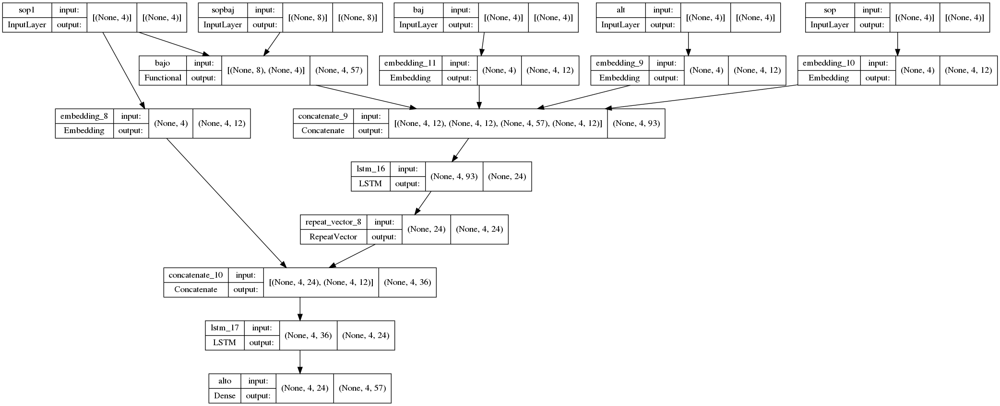

In [ ]:
input_1 = keras.Input(shape=(num_notas*2),name="sopbaj")
input_2 = keras.Input(shape=(num_notas),name="sop1")
input_3 = keras.Input(shape=(num_notas),name="alt")
input_4 = keras.Input(shape=(num_notas),name="sop")
input_5 = keras.Input(shape=(num_notas),name="baj")

layers_1 = layers.Embedding(int(np.unique(embed)[-1]) + 1,12)(input_1)
layers_1 = layers.LSTM(24)(layers_1)
layers_1 = layers.RepeatVector(num_notas)(layers_1)

layers_2 = layers.Embedding(int(np.unique(embed)[-1]) + 1,12)(input_2)
red_final = layers.concatenate([layers_1,layers_2])

red_final = layers.LSTM(24,return_sequences=True)(red_final)
output = layers.Dense(n_notas, activation='softmax')(red_final)

model = keras.Model([input_1,input_2],output,name="bajo")
#model.summary()

#keras.utils.plot_model(model, "embed.png", show_shapes=True)
output_1 = model([input_1,input_2])

layer_1 = layers.Embedding(int(np.unique(embed)[-1]) + 1,12)(input_1)
layer_2 = layers.Embedding(int(np.unique(embed)[-1]) + 1,12)(input_2)
layer_3 = layers.Embedding(int(np.unique(embed)[-1]) + 1,12)(input_3)
layer_4 = layers.Embedding(int(np.unique(embed)[-1]) + 1,12)(input_4)
layer_5 = layers.Embedding(int(np.unique(embed)[-1]) + 1,12)(input_5)

presente = layers.concatenate([layer_4,layer_5,output_1,layer_3])
presente = layers.LSTM(24)(presente)
presente = layers.RepeatVector(num_notas)(presente)
red_final = layers.concatenate([presente,layer_2])
red_final = layers.LSTM(24,return_sequences=True)(red_final)
output_2  = layers.Dense(n_notas, activation='softmax',name="alto")(red_final)

model_2 = keras.Model([input_1,input_4,input_3,input_5,input_2],[output_1,output_2])
model_2.summary()



keras.utils.plot_model(model_2, graf_path + "embedding_4_alt_desp.png", show_shapes=True)

In [ ]:
# quedarse con el maximo y sacar el indice (intentarlo) 
log_path = 'log/'

tb_callback = TensorBoard(
    log_dir=log_path,
    histogram_freq=2,
    write_graph=True
)
tb_callback.set_model(model)
callbacks = []
callbacks.append(tb_callback)

# A continuación se trata de crear el directorio log:
# - Si no existe se crea
# - Si ya existe se borran los datos que haya dentro de él

try:
    os.mkdir(log_path)
except:
    if OS_WINDOWS:
        !del log\*
    else:
        !rm log/*

rm: cannot remove 'log/train': Is a directory
rm: cannot remove 'log/validation': Is a directory



Epoch 1: bajo_mse improved from inf to 0.01686, saving model to model_current_best.h5
Metrica igualdad bajo mejorada de [0. 0. 0. 0.] a [0.15420805 0.1589127  0.1855724  0.20805018]
Metrica consonante bajo mejorada de 0 a 0.7486931521170935
Metrica igualdad alto mejorada de [0. 0. 0. 0.] a [0.20805018 0.20857292 0.20752744 0.20334553]
Metrica consonante alto mejorada de 0 a 0.7494772608468374
Metrica consonante alto-bajo mejorada de [0. 0. 0. 0.] a [0.67224255 0.66178777 0.7276529  0.74438055]
Metrica quitas/octavas [1. 1.] a [0.42847186 0.        ]

Epoch 1: bajo_mse improved from 0.01686 to 0.01636, saving model to model_current_best.h5
Metrica igualdad bajo mejorada de [0.15420805 0.1589127  0.1855724  0.20805018] a [0.2122321  0.20334553 0.20125457 0.20543649]
Metrica igualdad alto mejorada de [0.20805018 0.20857292 0.20752744 0.20334553] a [0.22686879 0.30371145 0.29221119 0.25509671]
Metrica consonante alto mejorada de 0.7494772608468374 a 0.799790904338735
Metrica quitas/octava

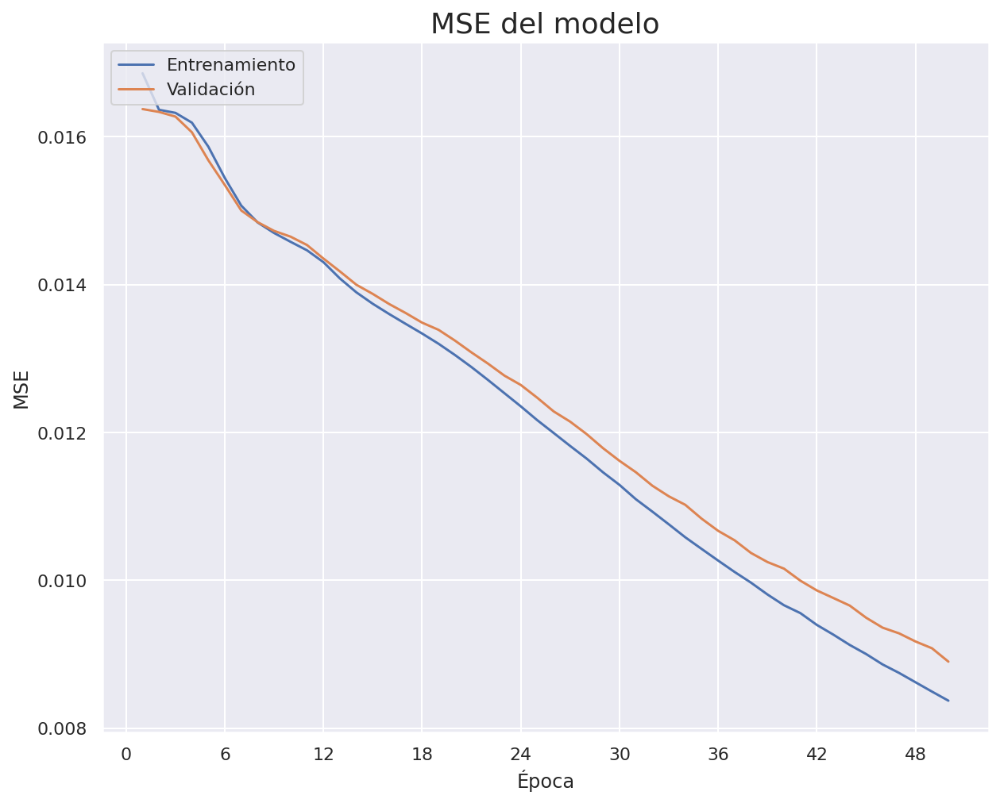

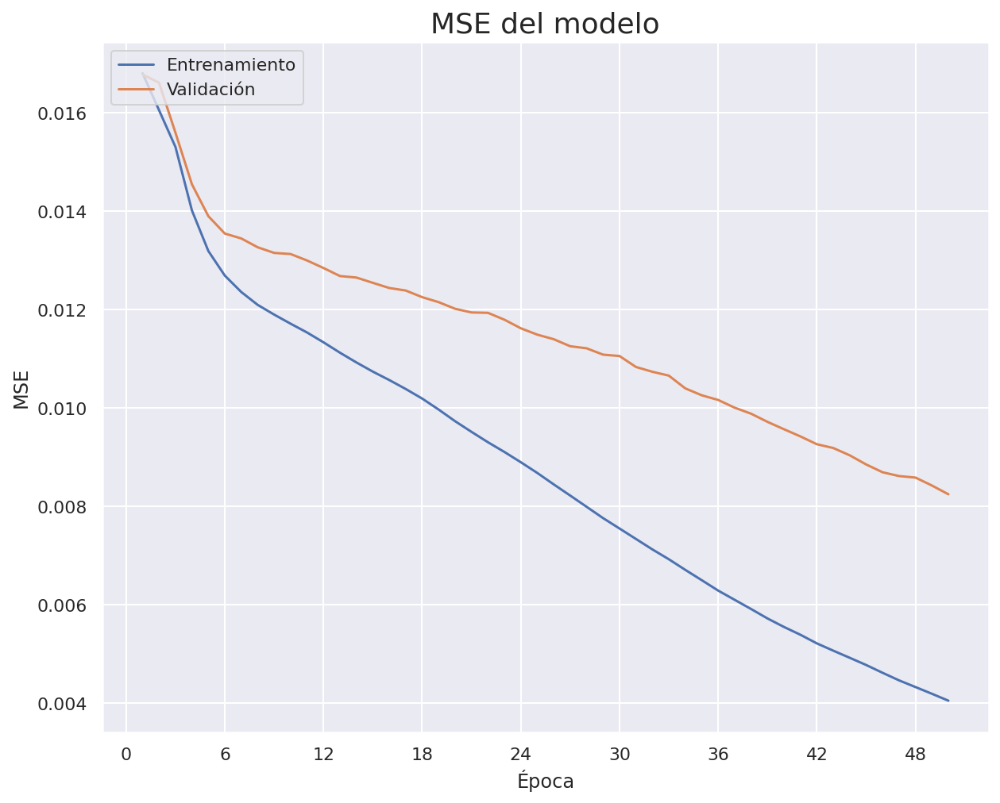

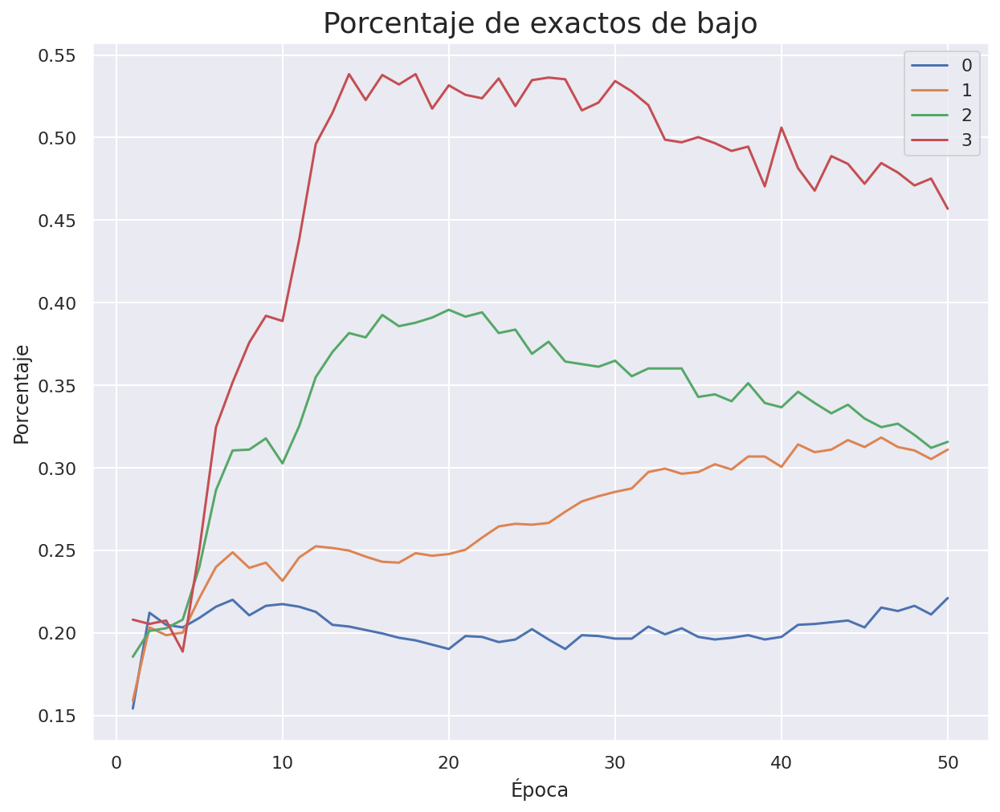

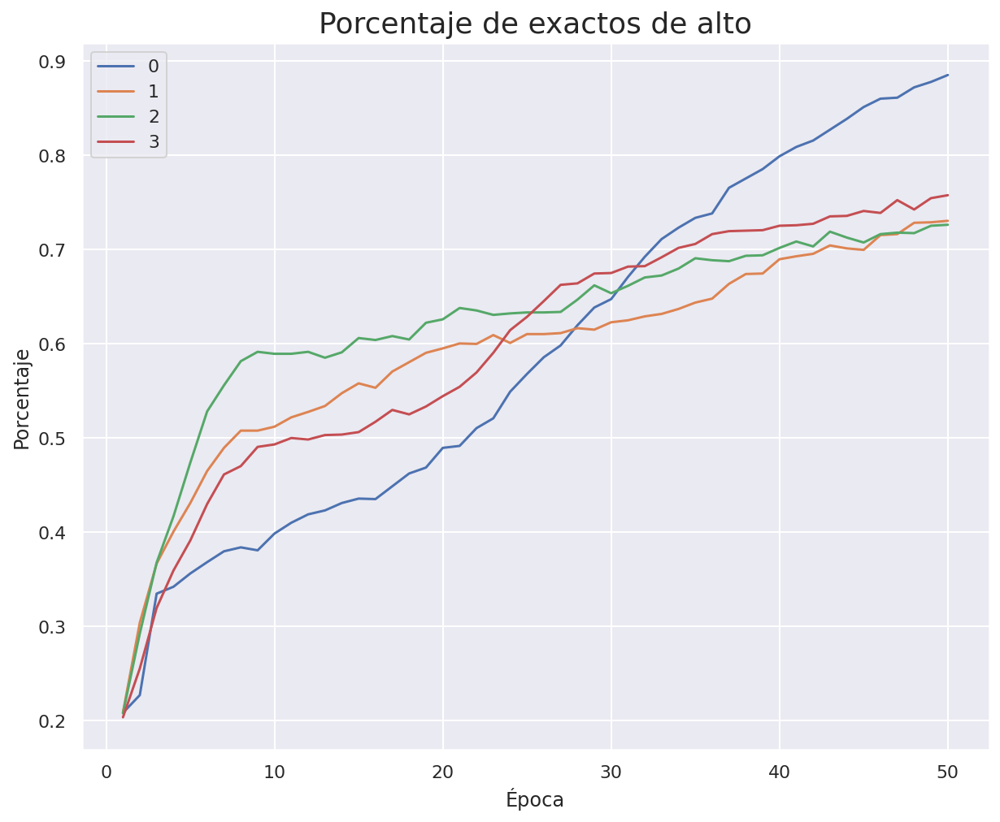

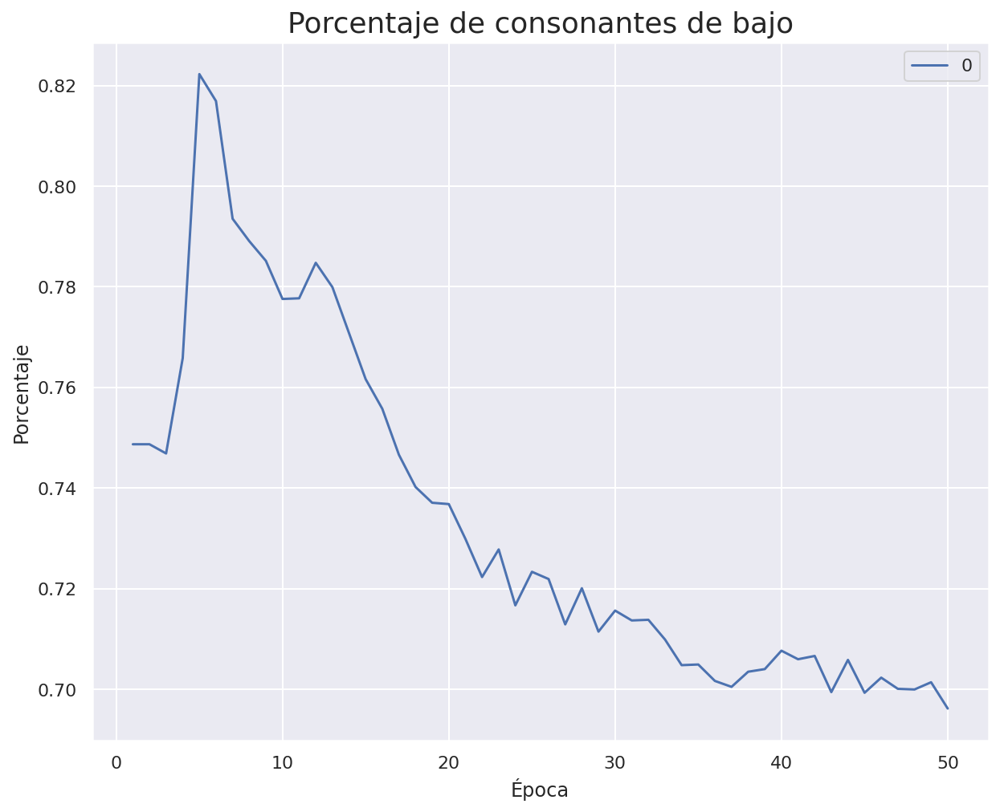

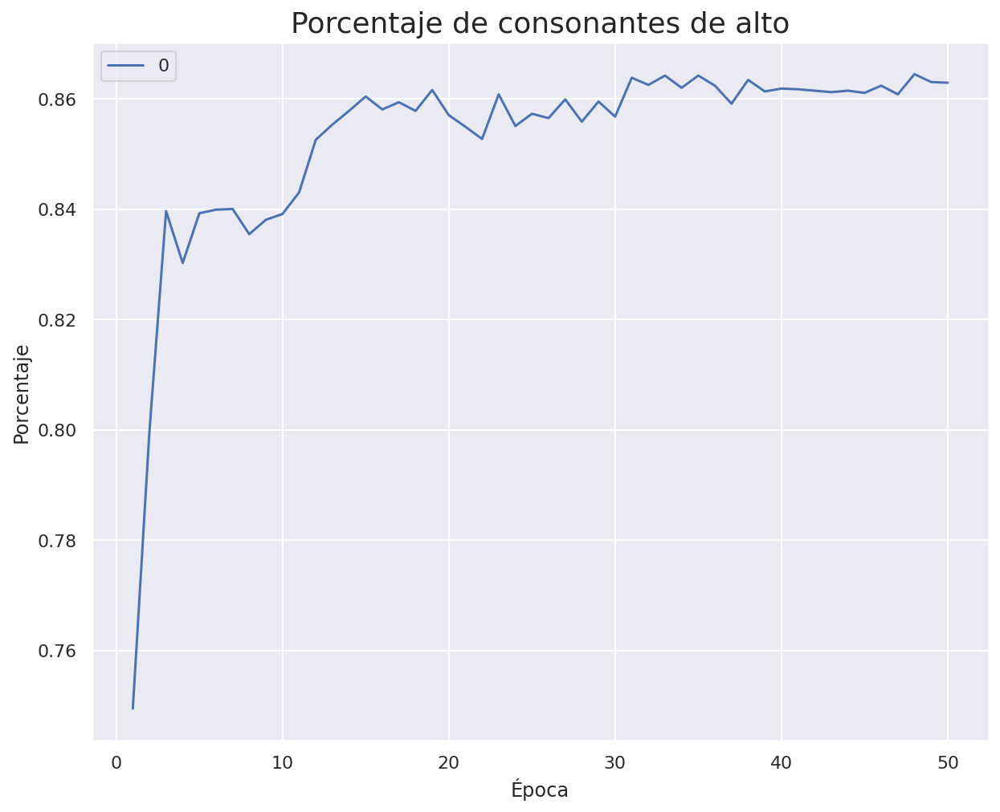

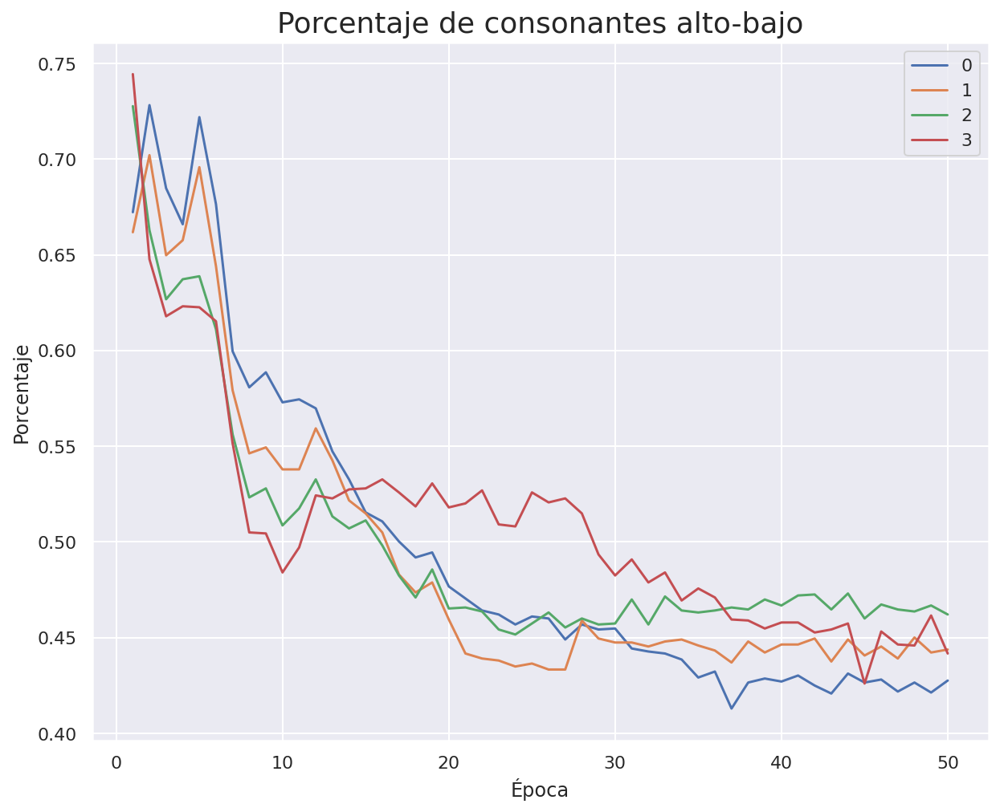

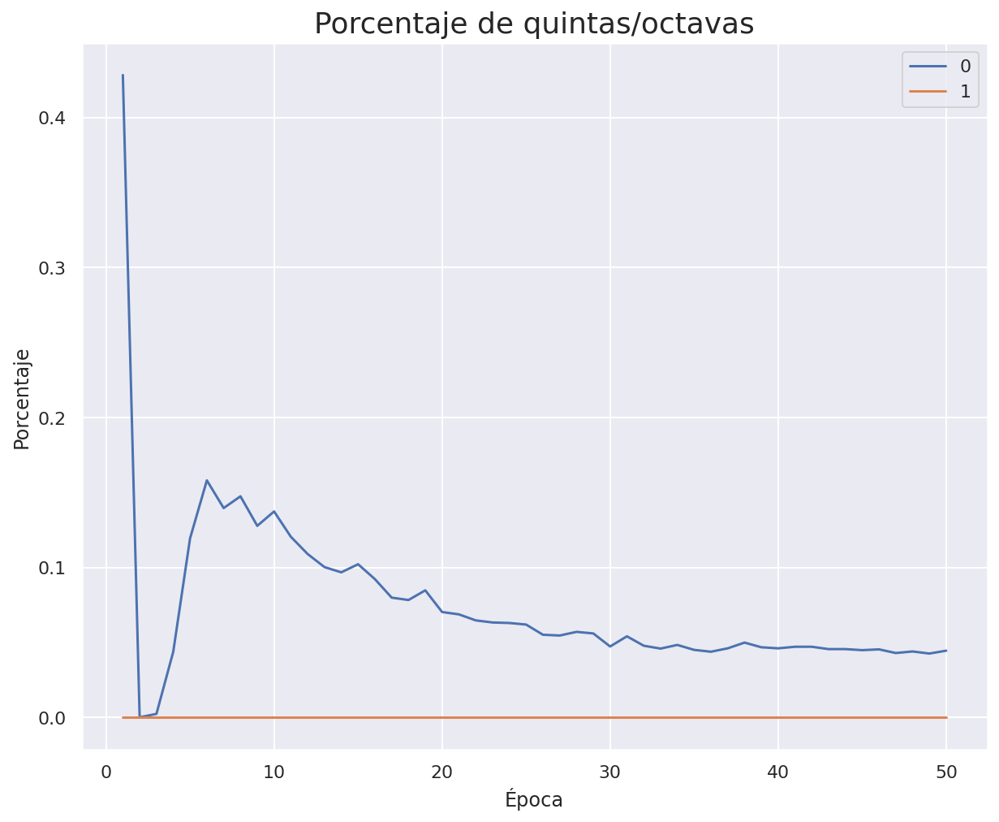


Epoch 1: bajo_mse improved from 0.00837 to 0.00825, saving model to model_current_best.h5
Metrica igualdad alto mejorada de [0.88499739 0.7302666  0.72608468 0.75744903] a [0.88552013 0.74072138 0.72190277 0.76529012]

Epoch 1: bajo_mse improved from 0.00825 to 0.00814, saving model to model_current_best.h5
Metrica igualdad alto mejorada de [0.88552013 0.74072138 0.72190277 0.76529012] a [0.88813382 0.75013068 0.72503921 0.76685834]

Epoch 1: bajo_mse improved from 0.00814 to 0.00801, saving model to model_current_best.h5
Metrica igualdad alto mejorada de [0.88813382 0.75013068 0.72503921 0.76685834] a [0.89074752 0.74856247 0.72974386 0.76894929]

Epoch 1: bajo_mse improved from 0.00801 to 0.00793, saving model to model_current_best.h5
Metrica igualdad alto mejorada de [0.89074752 0.74856247 0.72974386 0.76894929] a [0.89597491 0.7516989  0.73444851 0.77260847]
Metrica consonante alto mejorada de 0.8644798745426032 a 0.8650026136957658

Epoch 1: bajo_mse improved from 0.00793 to 0.00

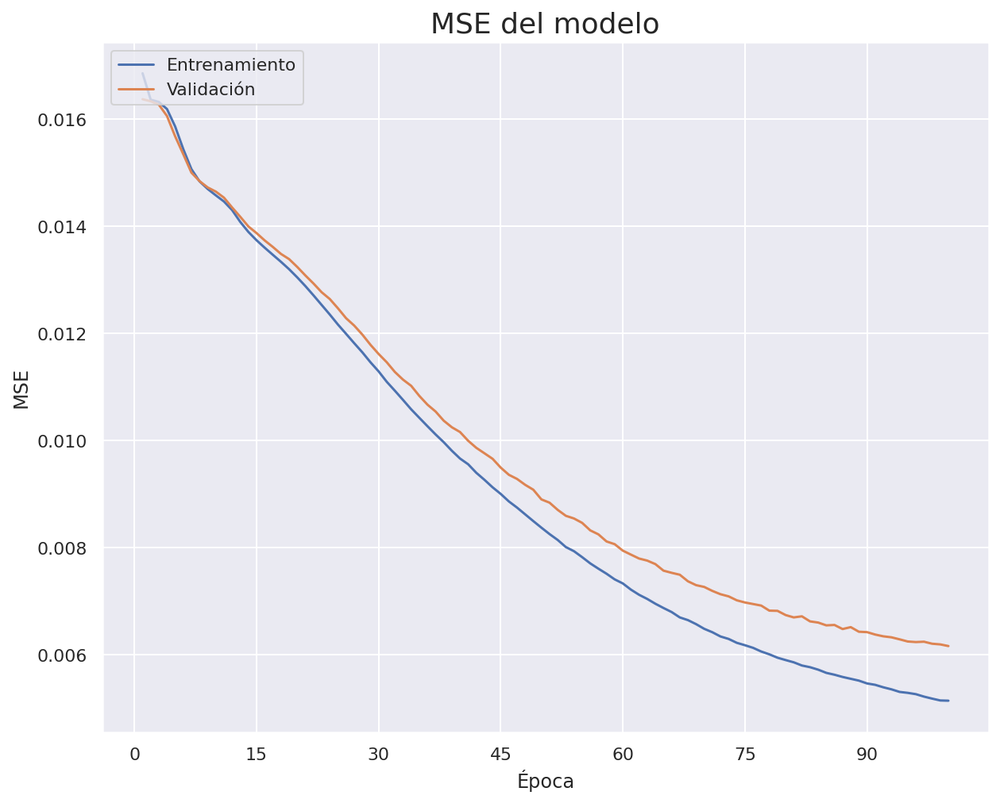

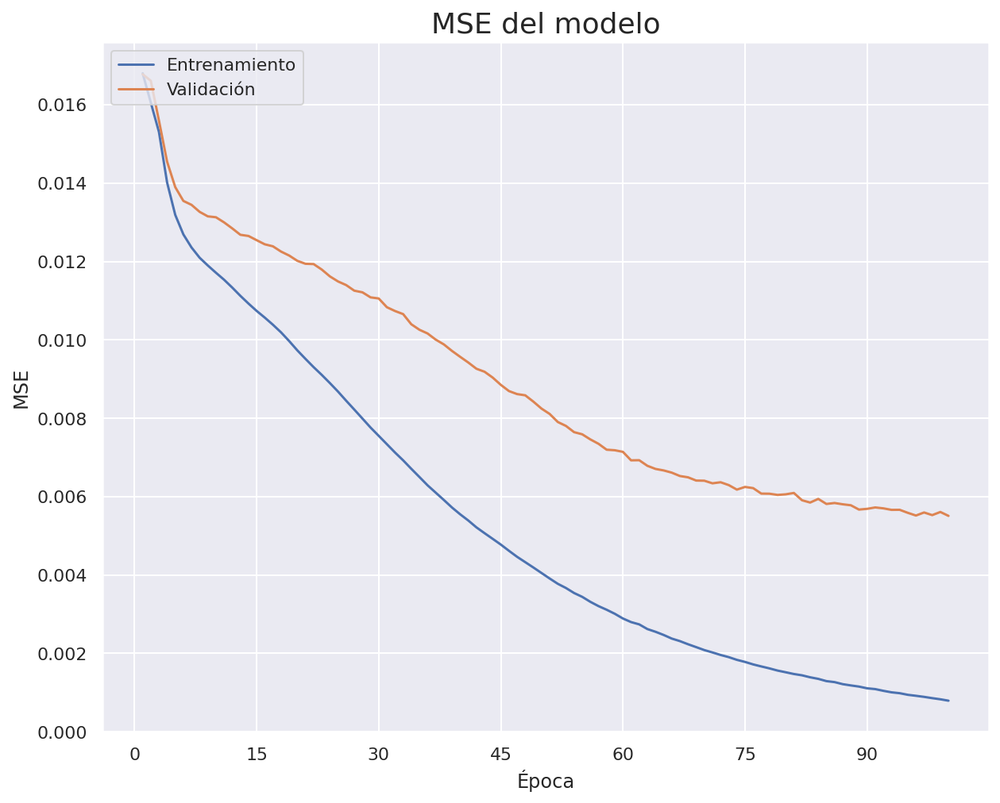

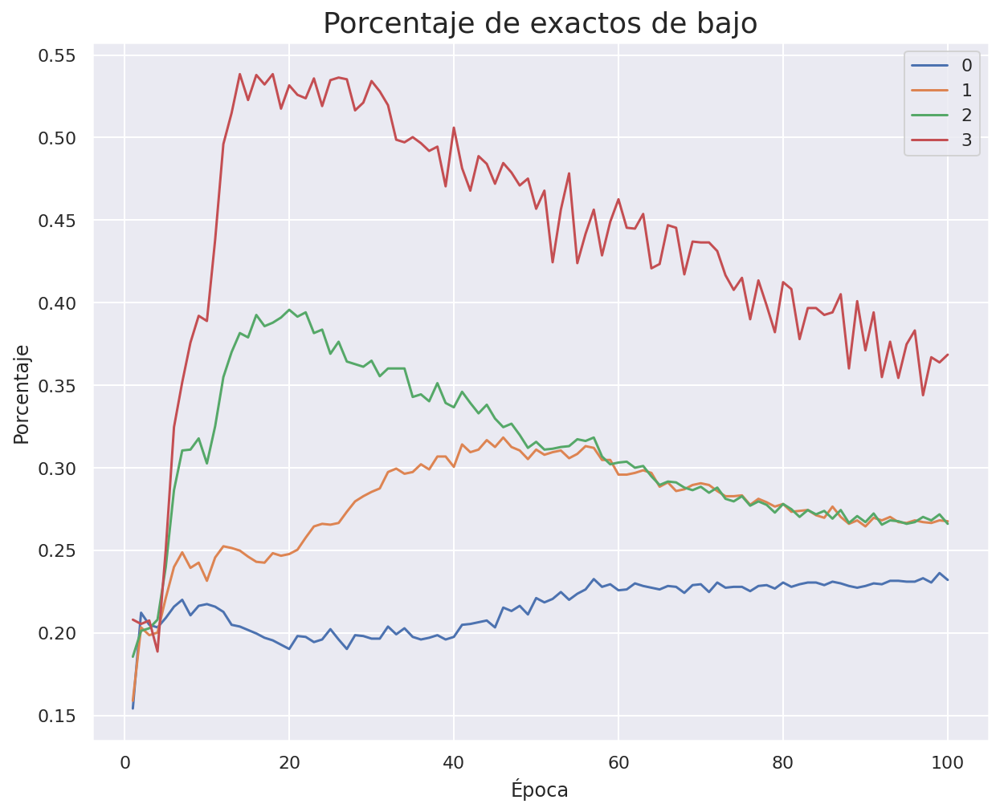

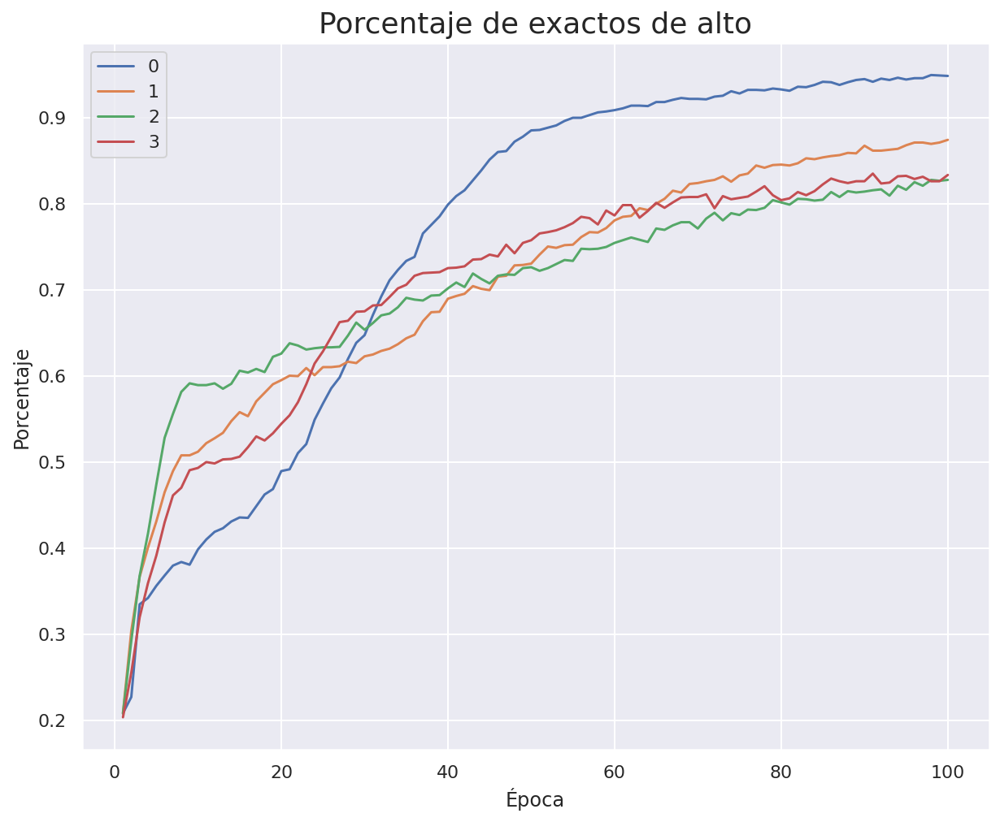

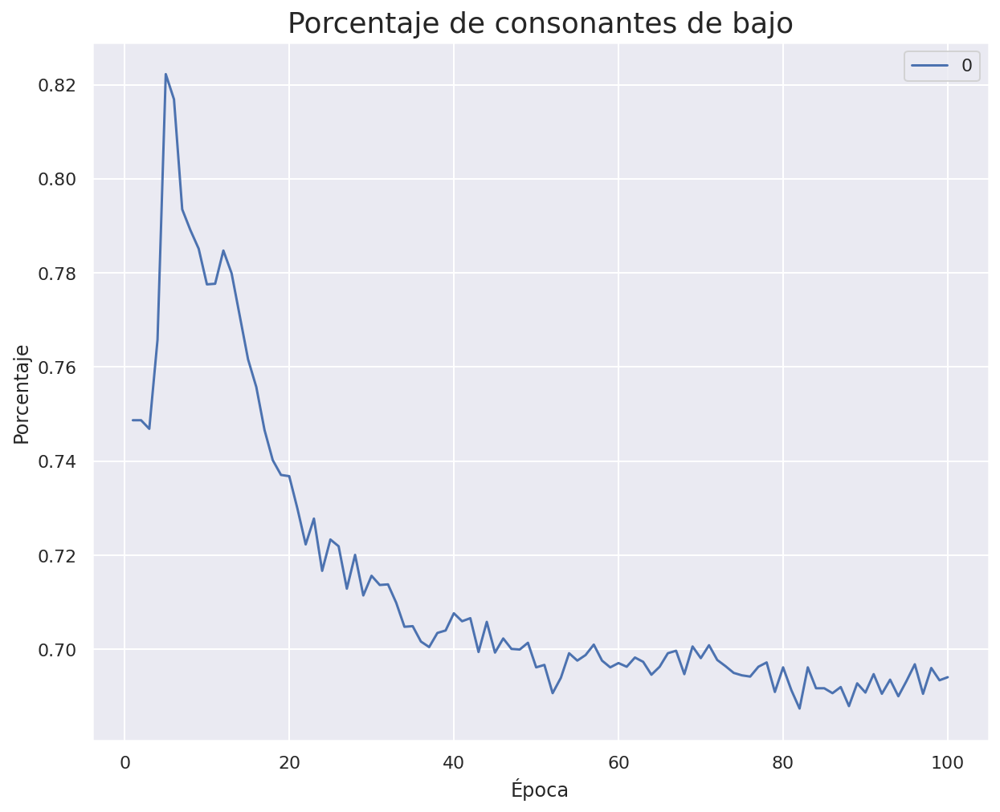

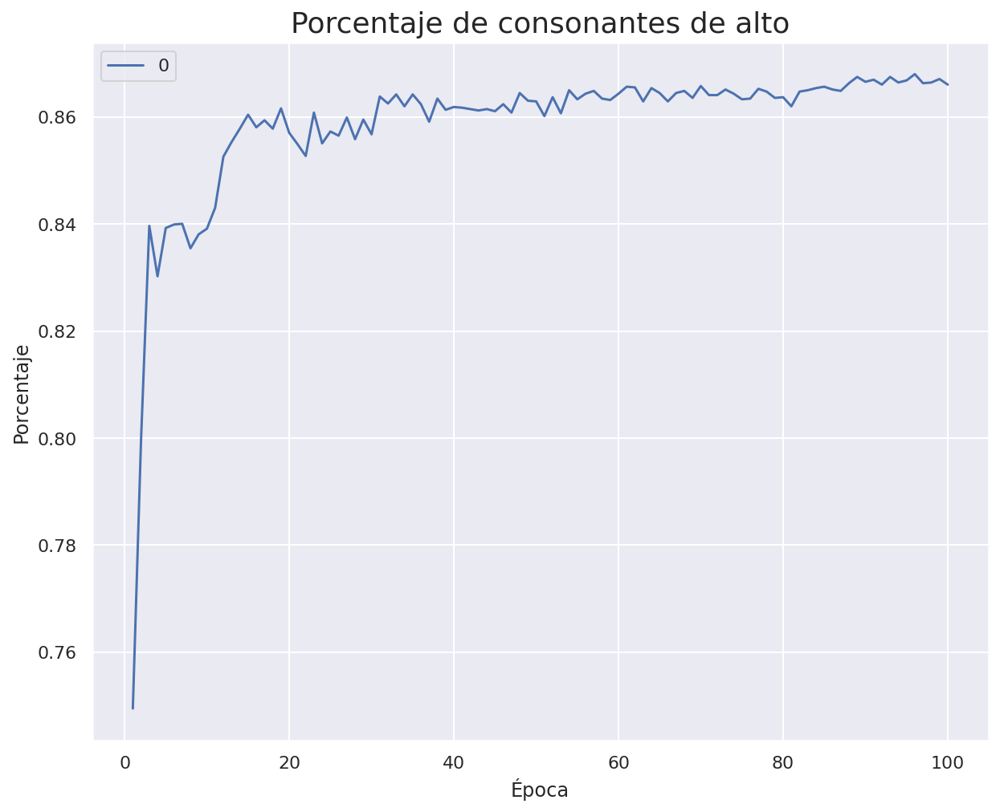

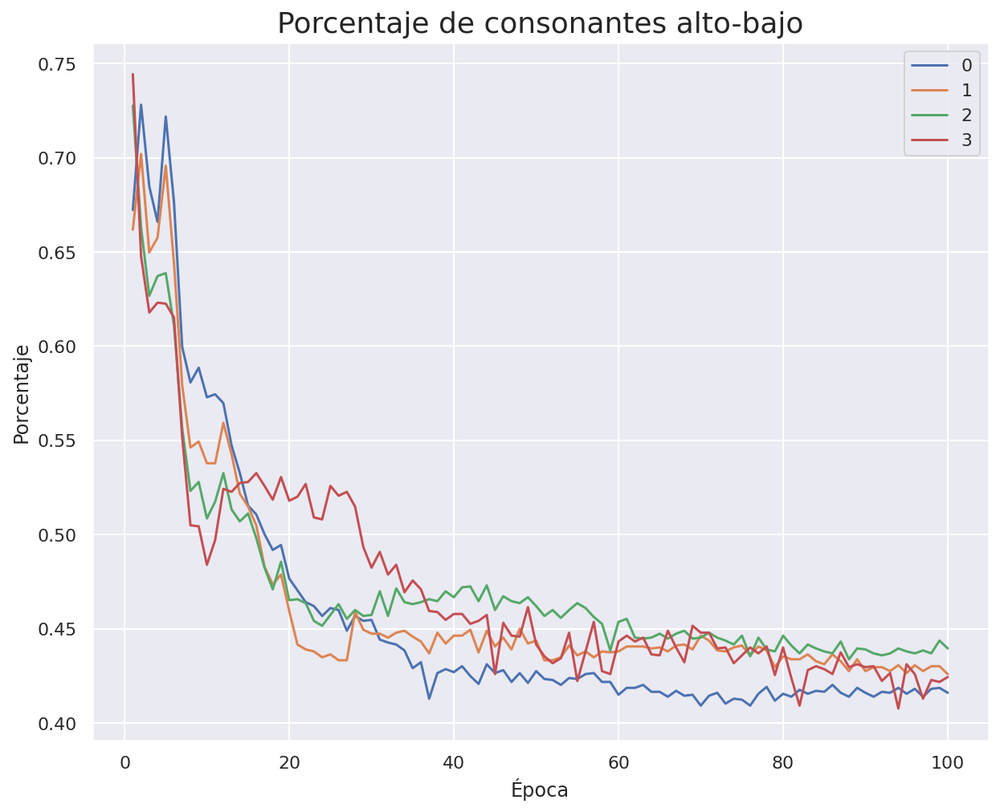

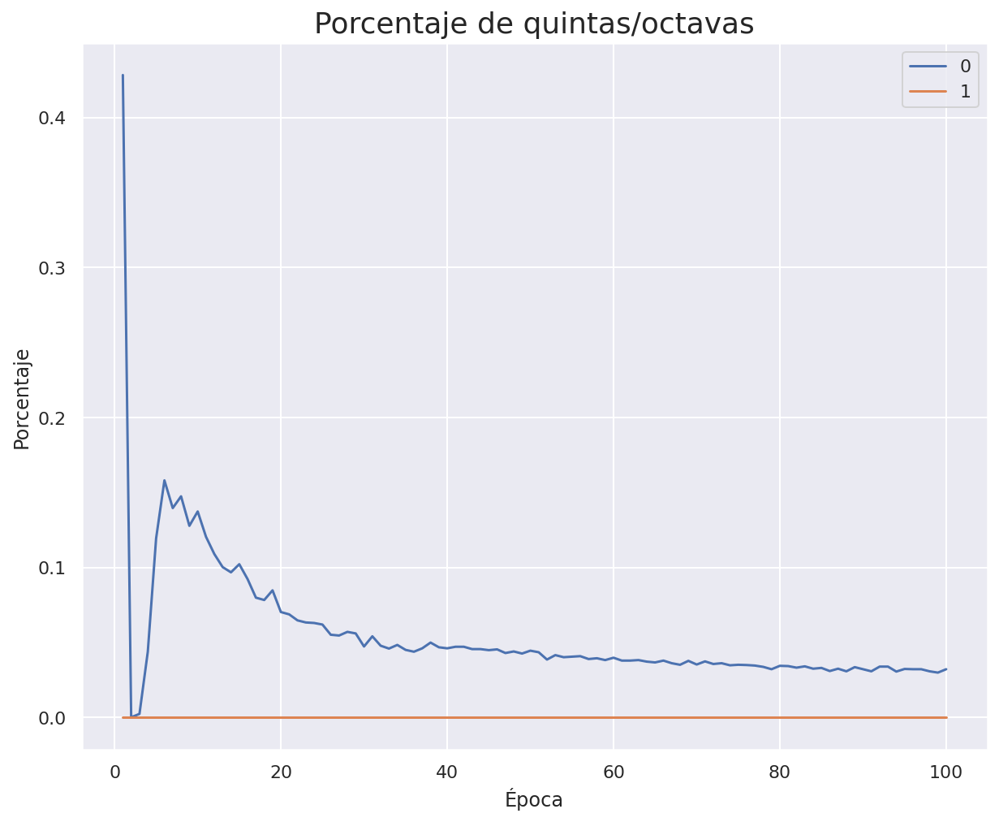

In [ ]:
# Entrenamos la red neuronal para diferentes epocas
# Batch nomalization
epochs = 100
batch_size = 64
control_sobreajuste_val = True
grabar_detalles_training_para_tensorboard = True
met_mod = None
met_max = np.zeros(num_notas)
met_epoch = np.zeros(num_notas)

met_mod_1 = None
met_max_1 = np.zeros(num_notas)
met_epoch_1 = np.zeros(num_notas)

met_mod_con = None
met_max_con = 0
met_epoch_con = 0

met_mod_con_1 = None
met_max_con_1 = 0
met_epoch_con_1 = 0

met_mod_con_2 = None
met_max_con_2 = np.zeros(num_notas)
met_epoch_con_2 = np.zeros(num_notas)

met_quin = None
met_min_quin = np.ones(2)
met_epoch_quin = np.zeros(2)
# si no se van a analizar estos detalles en tensorboard mejor
# poner este flag a False ya que el grabarlos enlentence
# bastante el trainingmodel_current_best
model_2.compile(loss=['categorical_crossentropy','categorical_crossentropy'],
              optimizer='adam',
              #optimizer=Adam(learning_rate=0.01), # más rápido
              metrics=['mse']) 

if not control_sobreajuste_val:
    history = model.fit([embed_train[:-1],embed_sop_train[1:]],
                        y_train, epochs=epochs,
                        batch_size=batch_size, verbose=2)
else:    
    acum_tr_mse = []
    acum_tr_mse_1 = []
    acum_val_mse = []
    acum_val_mse_1 = []
    acum_met = []
    acum_met_1 = []
    acum_met_con = []
    acum_met_con_1 = []
    acum_met_con_2 = []
    acum_met_quin = []
    filepath="model_current_best.h5"
    checkpoint = ModelCheckpoint(filepath, monitor='bajo_mse', verbose=2, 
                                 save_best_only=True,
                                 mode='min') # graba sólo los que mejoran en validación

    if grabar_detalles_training_para_tensorboard:
        callbacks_list = callbacks + [checkpoint]
    else:
        callbacks_list = [checkpoint]
    
    
    for e in range(epochs):
        aux_1 = embed_train
        aux_2 = embed_sop_train
        aux_3 = embed_alt_train
        aux_4 = embed_baj_train
        history = model_2.fit([aux_1[:-1],aux_2[1:],aux_3[1:],aux_4[1:],aux_2[:-1]], 
                            [embed_baj_train_oh[1:],embed_alt_train_oh[1:]],
                            batch_size=batch_size,
                            epochs=1,
                            callbacks=callbacks_list,
                            verbose=0,
                            validation_data=([embed_val[:-1],embed_sop_val[1:],embed_alt_val[1:],embed_baj_val[1:],embed_sop_val[:-1]],
                                              [embed_baj_val_oh[1:],embed_alt_val_oh[1:]]))
        

        
        [prediccion,prediccion_1] = model_2.predict([embed_test,embed_sop_test,embed_alt_test,embed_baj_test,embed_sop_test])
        pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
        for i in range(pred_buena.shape[0]):
          for j in range(pred_buena.shape[1]):
            max_m = np.max(prediccion[i][j])
            pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
        res_prediction = to_nota(pred_buena,voc)

        met = metrica_iguales(res_prediction,to_nota(embed_baj_test,voc),num_notas)
        acum_met.append(met)
        if np.sum(met) > np.sum(met_max):
          print('Metrica igualdad bajo mejorada de ' + str(met_max) + ' a ' + str(met))
          met_max = met
          met_mod = model
          model_2.save(path + 'met_mod.h5')
          met_epoch = epochs
        
        met_con = metrica_consonante(res_prediction,to_nota(embed_sop_test,voc))
        acum_met_con.append(met_con)
        if met_con > met_max_con:
          print('Metrica consonante bajo mejorada de ' + str(met_max_con) + ' a ' + str(met_con))
          met_max_con = met_con
          met_mod_con = model_2
          model_2.save(path + 'met_mod_con.h5')
          met_epoch_con = epochs
          
        pred_buena = np.zeros((prediccion_1.shape[0],prediccion.shape[1]))
        for i in range(pred_buena.shape[0]):
          for j in range(pred_buena.shape[1]):
            max_m = np.max(prediccion_1[i][j])
            pred_buena[i][j] = np.where(prediccion_1[i][j]==max_m )[0][0]
        res_prediction_1 = to_nota(pred_buena,voc)

        met_1 = metrica_iguales(res_prediction_1,to_nota(embed_alt_test,voc),num_notas)
        acum_met_1.append(met_1)
        if np.sum(met_1) > np.sum(met_max_1):
          print('Metrica igualdad alto mejorada de ' + str(met_max_1) + ' a ' + str(met_1))
          met_max_1 = met_1
          met_mod_1 = model_2
          model_2.save(path + 'met_mod._1.h5')
          met_epoch_1 = epochs
        
        met_con_1 = metrica_consonante(res_prediction_1,to_nota(embed_sop_test,voc))
        acum_met_con_1.append(met_con_1)
        if met_con_1 > met_max_con_1:
          print('Metrica consonante alto mejorada de ' + str(met_max_con_1) + ' a ' + str(met_con_1))
          met_max_con_1 = met_con_1
          met_mod_con_1 = model_2
          model_2.save(path + 'met_mod_con_1.h5')
          met_epoch_con_1 = epochs
        
        met_con_2 = metrica_consonante_1(res_prediction,res_prediction_1,to_nota(embed_sop_test,voc))
        acum_met_con_2.append(met_con_2)
        if np.sum(met_con_2) > np.sum(met_max_con_2):
          print('Metrica consonante alto-bajo mejorada de ' + str(met_max_con_2) + ' a ' + str(met_con_2))
          met_max_con_2 = met_con_2
          met_mod_con_2 = model_2
          model_2.save(path + 'met_mod_con_2.h5')
          met_epoch_con_2 = epochs

        met_quin = quint_oct(res_prediction,res_prediction_1)
        acum_met_quin.append(met_quin)
        if np.sum(met_quin) < np.sum(met_min_quin):
          print('Metrica quitas/octavas ' + str(met_min_quin) + ' a ' + str(met_quin))
          met_min_quin = met_quin
          met_mod_quin = model_2
          model_2.save(path + 'met_mod_quin.h5')
          met_epoch_quin = epochs

        acum_tr_mse  += history.history['bajo_mse'] # mean_squared_error
        acum_val_mse += history.history['val_bajo_mse'] # val_mean_squared_error

        acum_tr_mse_1  += history.history['alto_mse'] # mean_squared_error
        acum_val_mse_1 += history.history['val_alto_mse'] # val_mean_squared_error

        if (e+1)%50 == 0:
            grafica_entrenamiento(acum_tr_mse, acum_val_mse,"embedding_4_alt_desp_baj_mse")
            grafica_entrenamiento(acum_tr_mse_1, acum_val_mse_1,"embedding_4_alt_desp_alt_mse")
            grafica_metrica(acum_met,"Porcentaje de exactos de bajo","embedding_4_alt_desp_baj_ig")
            grafica_metrica(acum_met_1,"Porcentaje de exactos de alto","embedding_4_alt_desp_alt_ig")
            grafica_metrica(acum_met_con,"Porcentaje de consonantes de bajo","embedding_4_alt_desp_cons_baj")
            grafica_metrica(acum_met_con_1,"Porcentaje de consonantes de alto","embedding_4_alt_desp_cons_alt")
            grafica_metrica(acum_met_con_2,"Porcentaje de consonantes alto-bajo","embedding_4_alt_desp_cons_baj_alt")
            grafica_metrica(acum_met_quin,"Porcentaje de quintas/octavas","embedding_4_alt_desp_quint")

In [ ]:
model_baj = keras.models.load_model(path + 'met_mod_con_2.h5')
num_max = 50
[prediccion,prediccion_1] = model_baj.predict([embed_test,embed_sop_test,embed_alt_test,embed_baj_test,embed_sop_test])
pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion[i][j])
    pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
sop = to_nota(embed_sop_test,voc)
baj = res_prediction
pred_buena = np.zeros((prediccion_1.shape[0],prediccion_1.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion_1[i][j])
    pred_buena[i][j] = np.where(prediccion_1[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
alt = res_prediction
if sop.shape == baj.shape:
  for i in range(min(num_max,sop.shape[0])):
    print(i)
    play_musica(to_stream([sop[i],alt[1],baj[i]]))

# Red neuronal 4 notas con Embeddings. Contralto y bajo a la vez


In [ ]:
# Obtenemos los datos enventanados de cuatro notas del pickle o de los corals
datos_sop = []
datos_baj = []
datos_sol = []
voc = set()
num_notas = 4
train_perc = .6
val_perc = .8
tam = len(m21.corpus.chorales.ChoraleList().byBWV) 
punto_corte_1 = 0
punto_corte_2 = 0
conteo = 0
path = pick_path + "emb_dob/"

try:
  pickle_in = open(pick_path + str(num_notas) + "_datos_sop.pck","rb")
  datos_sop = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_alt.pck","rb")
  datos_alt = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_baj.pck","rb")
  datos_baj = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_sol.pck","rb")
  datos_sol = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_cortes.pck","rb")
  ptos_corte = pickle.load(pickle_in)
  pickle_in.close()

  punto_corte_1,punto_corte_2 = ptos_corte

except:
  # Enventanamos los datos de la soprano y el bajo
  for coral in m21.corpus.chorales.ChoraleList().byBWV:
    x,y = enventanar(Coral(coral).voces_n['Soprano'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_sop.append(lista)
    x,y = enventanar(Coral(coral).voces_n['Bass'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_baj.append(lista)
    datos_sol.extend(y)
    conteo += 1
    if conteo == int(tam*train_perc):
      punto_corte_1 = len(datos_sop)
    if conteo == int(tam*val_perc):
      punto_corte_2 = len(datos_sop)
  
  pickle_out = open(pick_path + str(num_notas) + "_datos_sop.pck","wb")
  pickle.dump(datos_sop,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_baj.pck","wb")
  pickle.dump(datos_baj,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_sol.pck","wb")
  pickle.dump(datos_sol,pickle_out)
  pickle_out.close()

  ptos_corte = [punto_corte_1,punto_corte_2]
  pickle_out = open(pick_path + str(num_notas) + "_datos_cortes.pck","wb")
  pickle.dump(ptos_corte,pickle_out)
  pickle_out.close()

embed_sop = np.array(datos_sop,dtype='float32')
embed_alt = np.array(datos_alt,dtype='float32')
"""embed_ten = np.array(datos_ten,dtype='float32')"""
embed_baj = np.array(datos_baj,dtype='float32')

embed = np.concatenate((embed_sop,embed_alt,embed_baj),axis=1)
voc = np.unique(np.concatenate((embed_sop,embed_alt,embed_baj),axis=1))

embed_sop = to_index(embed_sop,voc)
embed_alt = to_index(embed_alt,voc)
embed_baj = to_index(embed_baj,voc)
embed = to_index(embed,voc)

# Separamos los datos en train, validation y test 
embed_train = embed[:punto_corte_1]
embed_sop_train = embed_sop[:punto_corte_1]
embed_alt_train = embed_alt[:punto_corte_1]
embed_baj_train = embed_baj[:punto_corte_1]
embed_test = embed[punto_corte_1:punto_corte_2]
embed_sop_test = embed_sop[punto_corte_1:punto_corte_2]
embed_alt_test = embed_alt[punto_corte_1:punto_corte_2]
embed_baj_test = embed_baj[punto_corte_1:punto_corte_2]

embed_val = embed[punto_corte_2:]
embed_sop_val = embed_sop[punto_corte_2:]
embed_alt_val = embed_alt[punto_corte_2:]
embed_baj_val = embed_baj[punto_corte_2:]

print(embed_train.shape,embed_sop_train.shape,embed_baj_train.shape)
print(embed_val.shape,embed_sop_val.shape,embed_baj_val.shape)
print(embed_test.shape,embed_sop_test.shape,embed_baj_test.shape)

(5406, 12) (5406, 4) (5406, 4)
(2003, 12) (2003, 4) (2003, 4)
(1913, 12) (1913, 4) (1913, 4)


In [ ]:
# Pasar a one hot y poner categorycal crossentropy min log loss
n_notas = len(np.unique(embed))
embed_baj_train_oh = np.zeros((embed_baj_train.shape[0],embed_baj_train.shape[1],n_notas))
for i in range(embed_baj_train.shape[0]):
  for j in range(embed_baj_train.shape[1]):
    embed_baj_train_oh[i][j][embed_baj_train[i][j].astype(int)] = 1

embed_baj_val_oh = np.zeros((embed_baj_val.shape[0],embed_baj_val.shape[1],n_notas))
for i in range(embed_baj_val.shape[0]):
  for j in range(embed_baj_val.shape[1]):
    embed_baj_val_oh[i][j][embed_baj_val[i][j].astype(int)] = 1

embed_baj_test_oh = np.zeros((embed_baj_test.shape[0],embed_baj_test.shape[1],n_notas))
for i in range(embed_baj_test.shape[0]):
  for j in range(embed_baj_test.shape[1]):
    embed_baj_test_oh[i][j][embed_baj_test[i][j].astype(int)] = 1

embed_alt_train_oh = np.zeros((embed_alt_train.shape[0],embed_alt_train.shape[1],n_notas))
for i in range(embed_alt_train.shape[0]):
  for j in range(embed_alt_train.shape[1]):
    embed_alt_train_oh[i][j][embed_alt_train[i][j].astype(int)] = 1

embed_alt_val_oh = np.zeros((embed_alt_val.shape[0],embed_alt_val.shape[1],n_notas))
for i in range(embed_alt_val.shape[0]):
  for j in range(embed_alt_val.shape[1]):
    embed_alt_val_oh[i][j][embed_alt_val[i][j].astype(int)] = 1

embed_alt_test_oh = np.zeros((embed_alt_test.shape[0],embed_alt_test.shape[1],n_notas))
for i in range(embed_alt_test.shape[0]):
  for j in range(embed_alt_test.shape[1]):
    embed_alt_test_oh[i][j][embed_alt_test[i][j].astype(int)] = 1

Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 Corales (InputLayer)           [(None, 12)]         0           []                               
                                                                                                  
 embedding_12 (Embedding)       (None, 12, 24)       1368        ['Corales[0][0]']                
                                                                                                  
 lstm_18 (LSTM)                 (None, 25)           5000        ['embedding_12[0][0]']           
                                                                                                  
 Soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                              

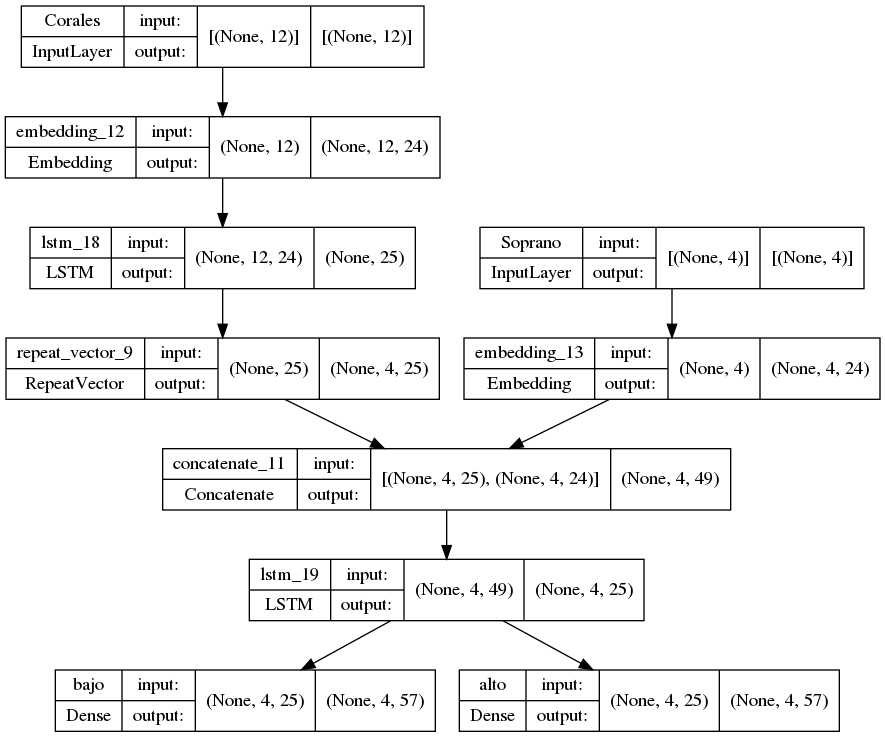

In [ ]:
num_neu = 25

input_1 = keras.Input(shape=(num_notas*3),name='Corales')
input_2 = keras.Input(shape=(num_notas),name='Soprano')

layers_1 = layers.Embedding(int(np.unique(embed)[-1]) + 1,24)(input_1)
layers_1 = layers.LSTM(num_neu)(layers_1)
layers_1 = layers.RepeatVector(num_notas)(layers_1)

layers_2 = layers.Embedding(int(np.unique(embed)[-1]) + 1,24)(input_2)
red_final = layers.concatenate([layers_1,layers_2])

red_final = LSTM(num_neu,return_sequences=True)(red_final)
output_1 = layers.Dense(n_notas, activation='softmax',name='bajo')(red_final)
output_2 = layers.Dense(n_notas, activation='softmax',name='alto')(red_final)

model = keras.Model([input_1,input_2],[output_1,output_2],name="embed")
model.summary()

keras.utils.plot_model(model, graf_path + "4_embedding_model_separado.png", show_shapes=True)

In [ ]:
# lstm bidireccional
# conv 1d
# ver si ha escrito lo de bach
log_path = 'log/'

tb_callback = TensorBoard(
    log_dir=log_path,
    histogram_freq=2,
    write_graph=True
)
tb_callback.set_model(model)
callbacks = []
callbacks.append(tb_callback)

# A continuación se trata de crear el directorio log:
# - Si no existe se crea
# - Si ya existe se borran los datos que haya dentro de él

try:
    os.mkdir(log_path)
except:
    if OS_WINDOWS:
        !del log\*
    else:
        !rm log/*

rm: cannot remove 'log/train': Is a directory
rm: cannot remove 'log/validation': Is a directory



Epoch 1: bajo_mse improved from inf to 0.01686, saving model to model_current_best.h5
Metrica igualdad bajo mejorada de [0. 0. 0. 0.] a [0.21327757 0.20334553 0.20073183 0.20491375]
Metrica consonante bajo mejorada de 0 a 0.7494772608468374
Metrica igualdad alto mejorada de [0. 0. 0. 0.] a [0.22791427 0.24934658 0.25405123 0.25405123]
Metrica consonante alto mejorada de 0 a 0.7956089911134344
Metrica consonante alto-bajo mejorada de [0. 0. 0. 0.] a [0.75483534 0.7276529  0.72138003 0.72033455]
Metrica quitas/octavas [1. 1.] a [0. 0.]

Epoch 1: bajo_mse improved from 0.01686 to 0.01622, saving model to model_current_best.h5
Metrica consonante bajo mejorada de 0.7494772608468374 a 0.8451385258755881
Metrica igualdad alto mejorada de [0.22791427 0.24934658 0.25405123 0.25405123] a [0.24882384 0.25091479 0.25457397 0.2577104 ]

Epoch 1: bajo_mse improved from 0.01622 to 0.01602, saving model to model_current_best.h5
Metrica consonante bajo mejorada de 0.8451385258755881 a 0.85964453737584

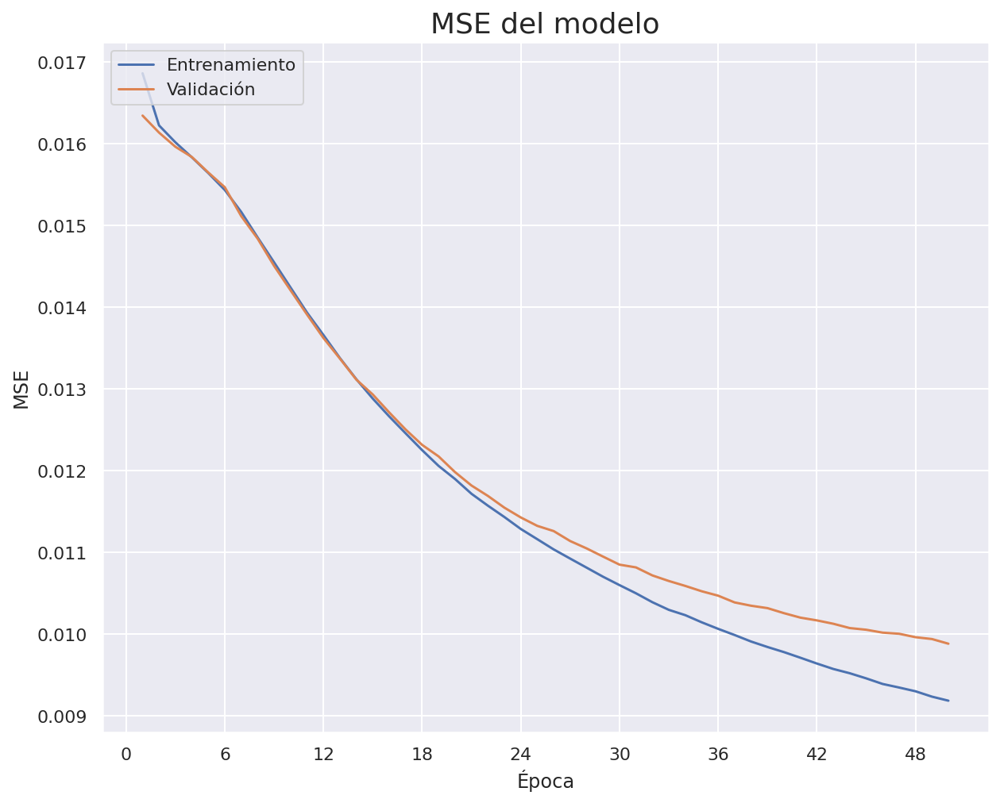

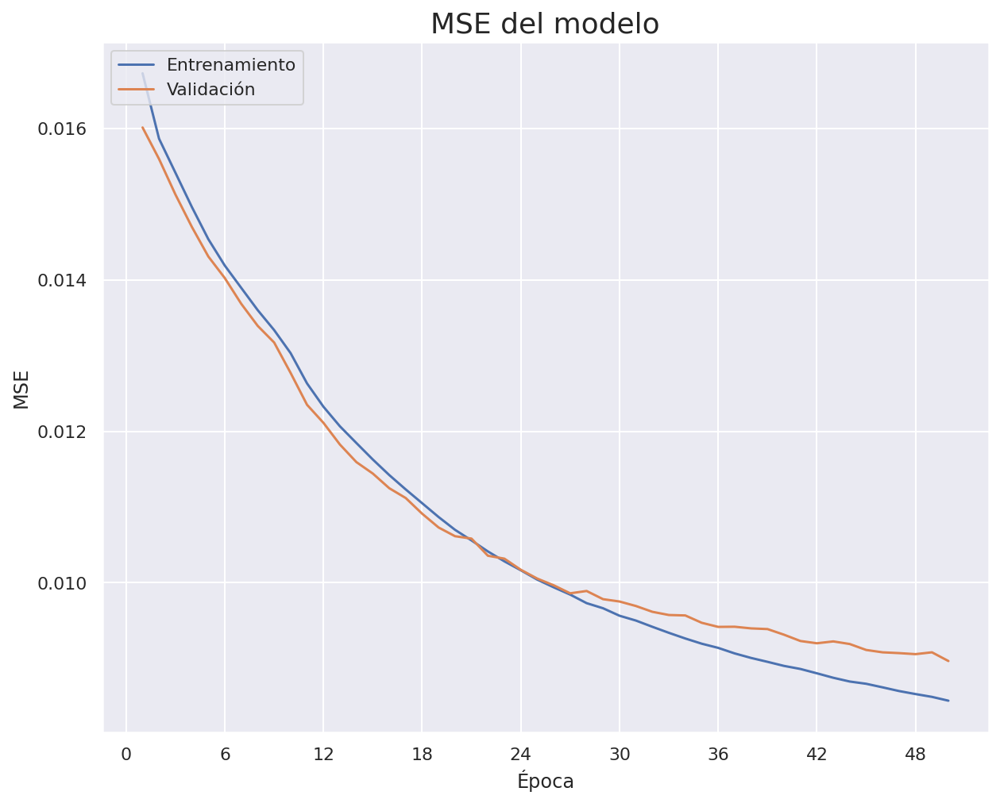

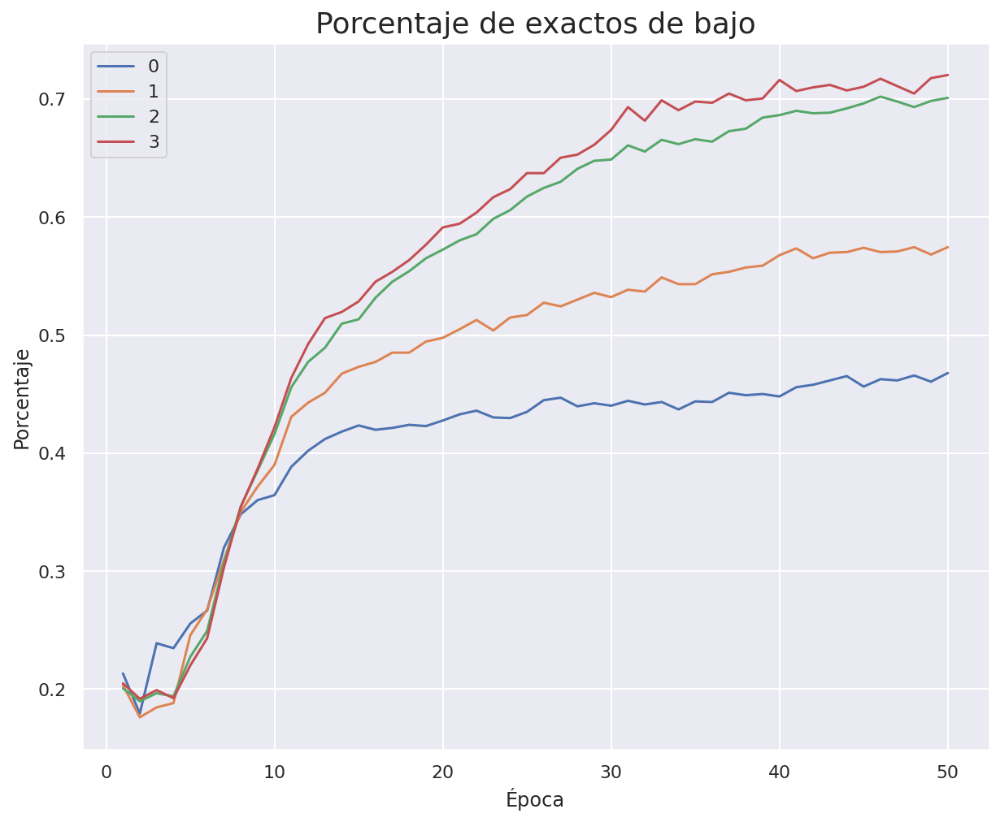

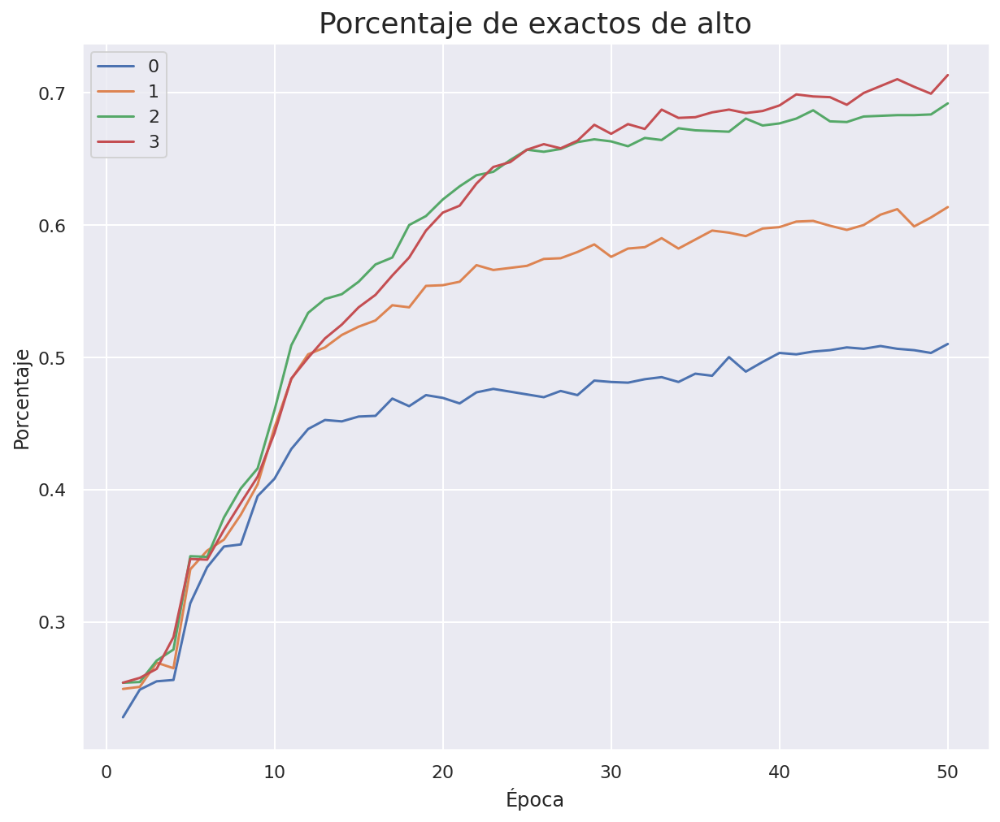

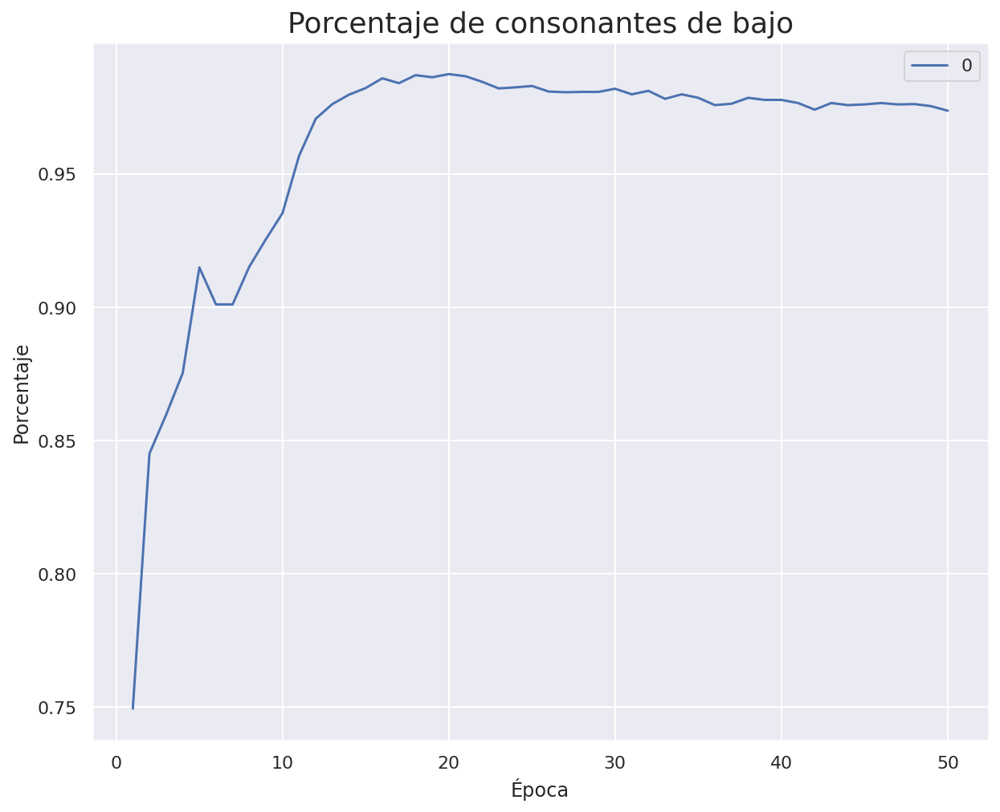

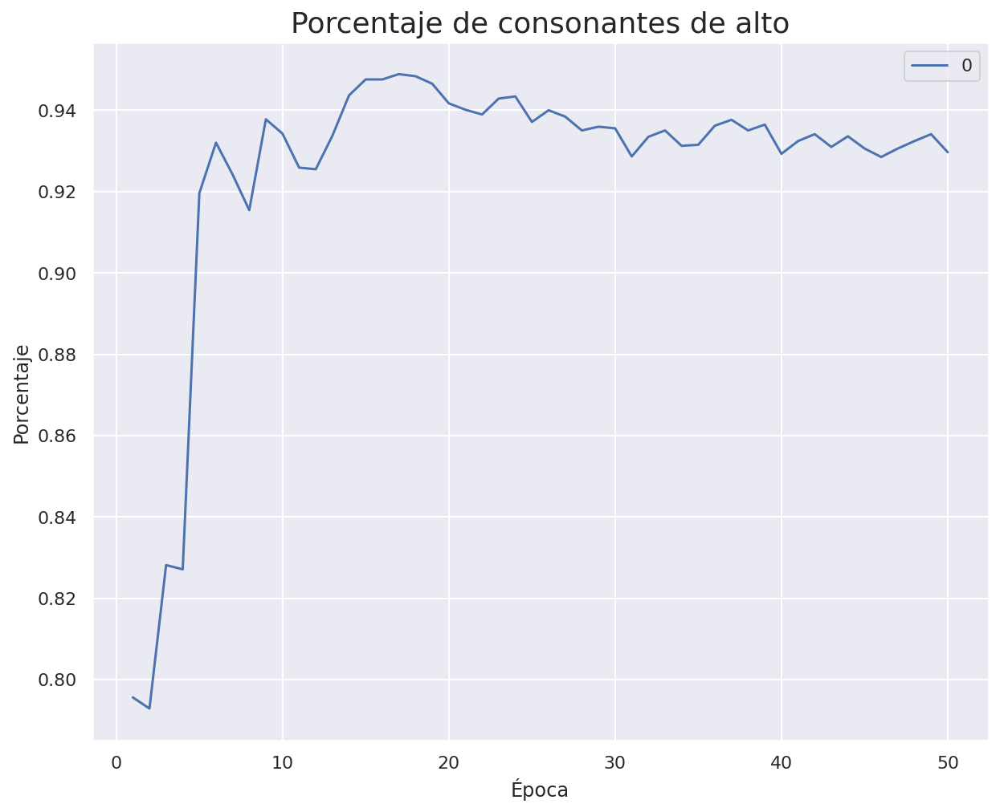

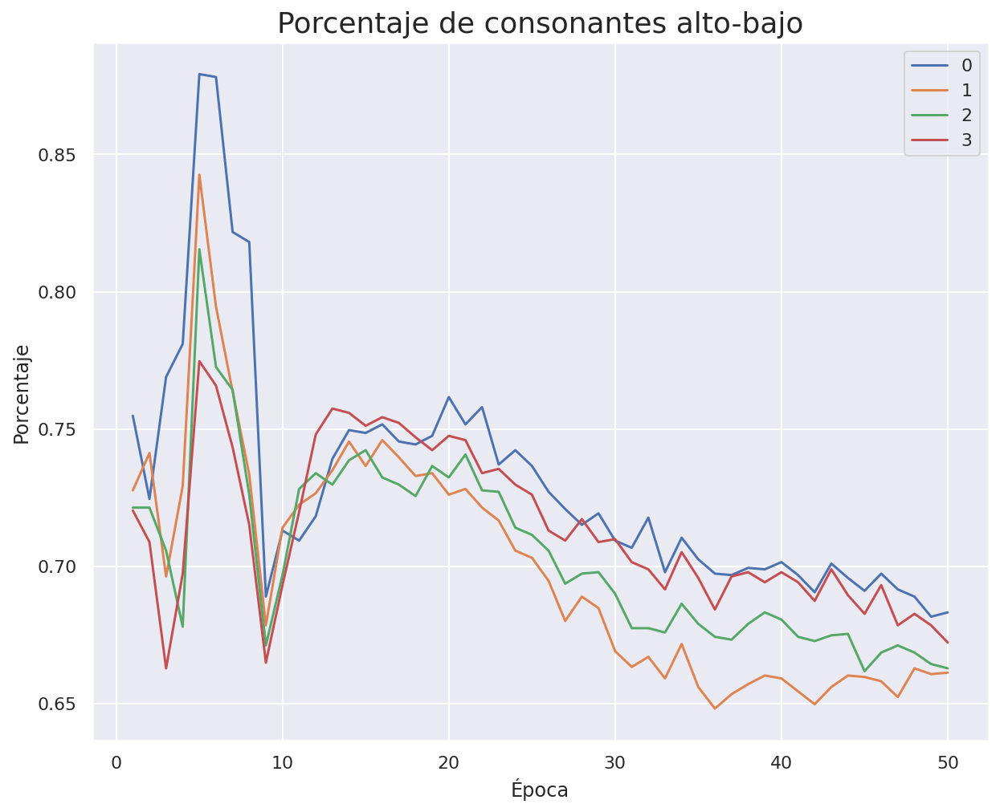

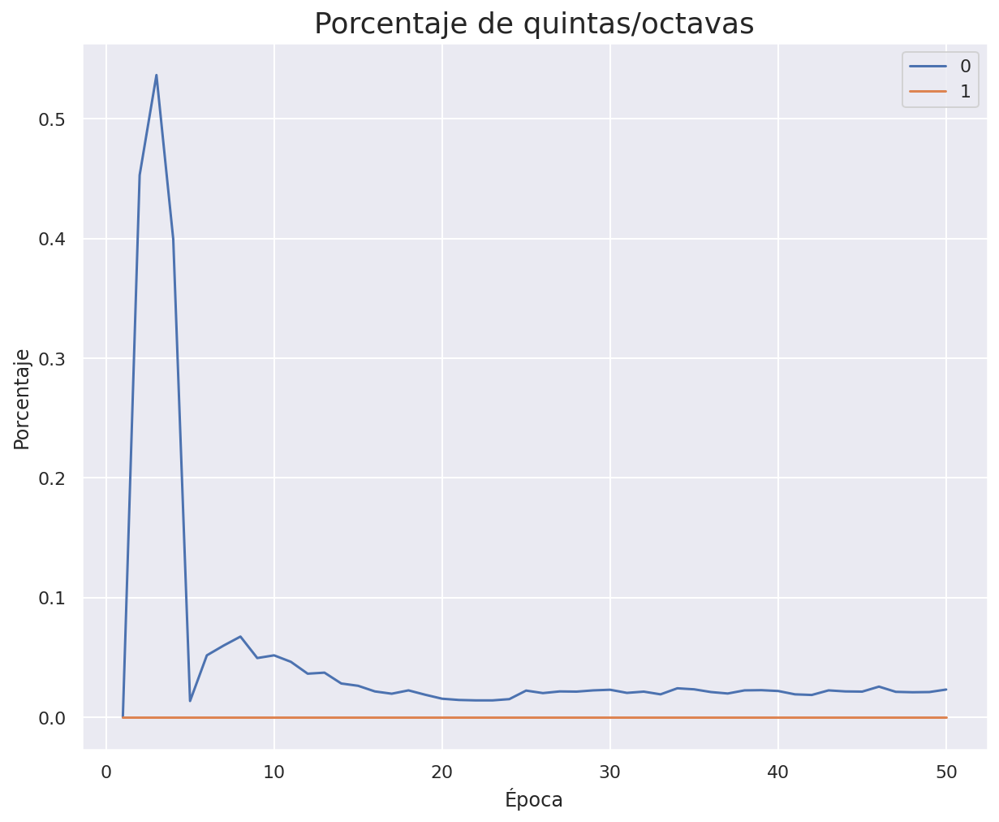


Epoch 1: bajo_mse improved from 0.00919 to 0.00914, saving model to model_current_best.h5
Metrica igualdad bajo mejorada de [0.46785154 0.57449033 0.7009932  0.72033455] a [0.47516989 0.58233142 0.69785677 0.72294825]

Epoch 1: bajo_mse improved from 0.00914 to 0.00909, saving model to model_current_best.h5
Metrica igualdad alto mejorada de [0.51019341 0.61369577 0.69210664 0.71353894] a [0.51280711 0.61265029 0.69733403 0.70987977]

Epoch 1: bajo_mse improved from 0.00909 to 0.00905, saving model to model_current_best.h5

Epoch 1: bajo_mse improved from 0.00905 to 0.00900, saving model to model_current_best.h5
Metrica igualdad bajo mejorada de [0.47516989 0.58233142 0.69785677 0.72294825] a [0.46941976 0.58703607 0.70047047 0.72556194]

Epoch 1: bajo_mse improved from 0.00900 to 0.00893, saving model to model_current_best.h5
Metrica igualdad alto mejorada de [0.51280711 0.61265029 0.69733403 0.70987977] a [0.51698902 0.62049137 0.69681129 0.71667538]

Epoch 1: bajo_mse improved from 

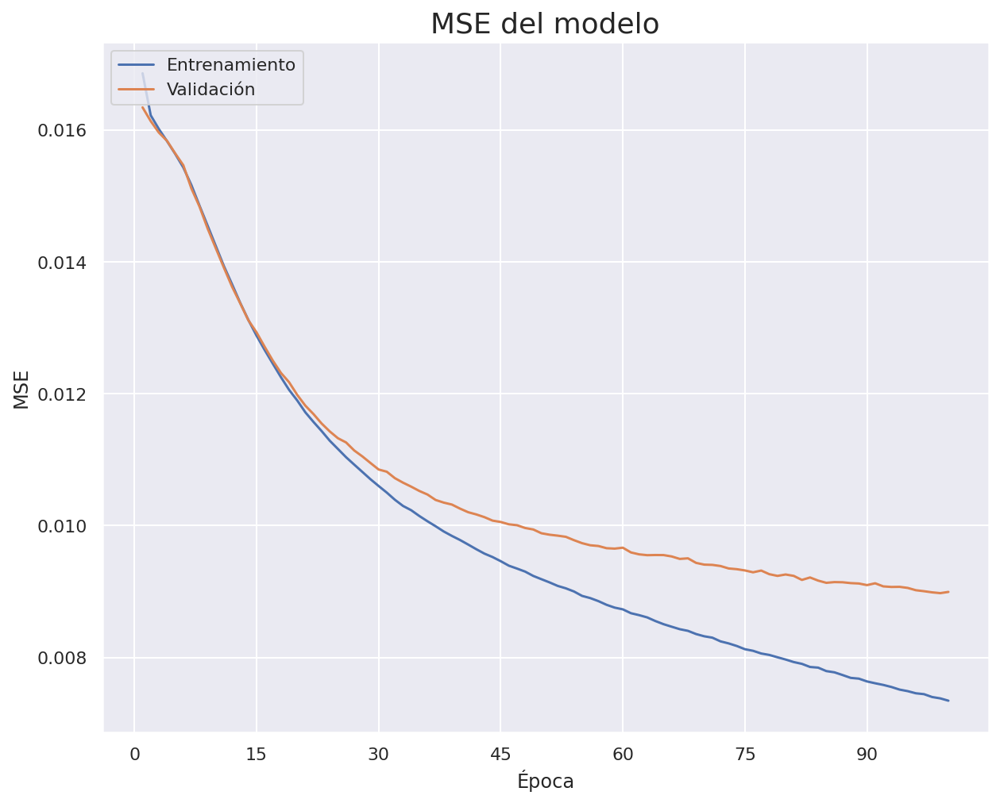

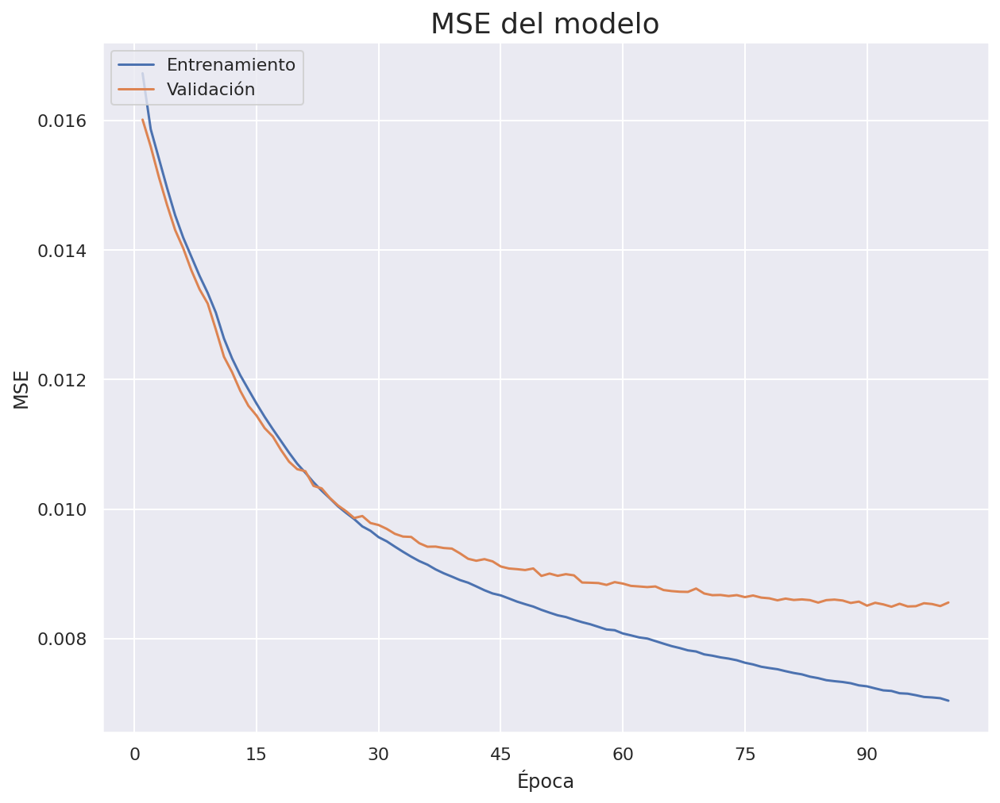

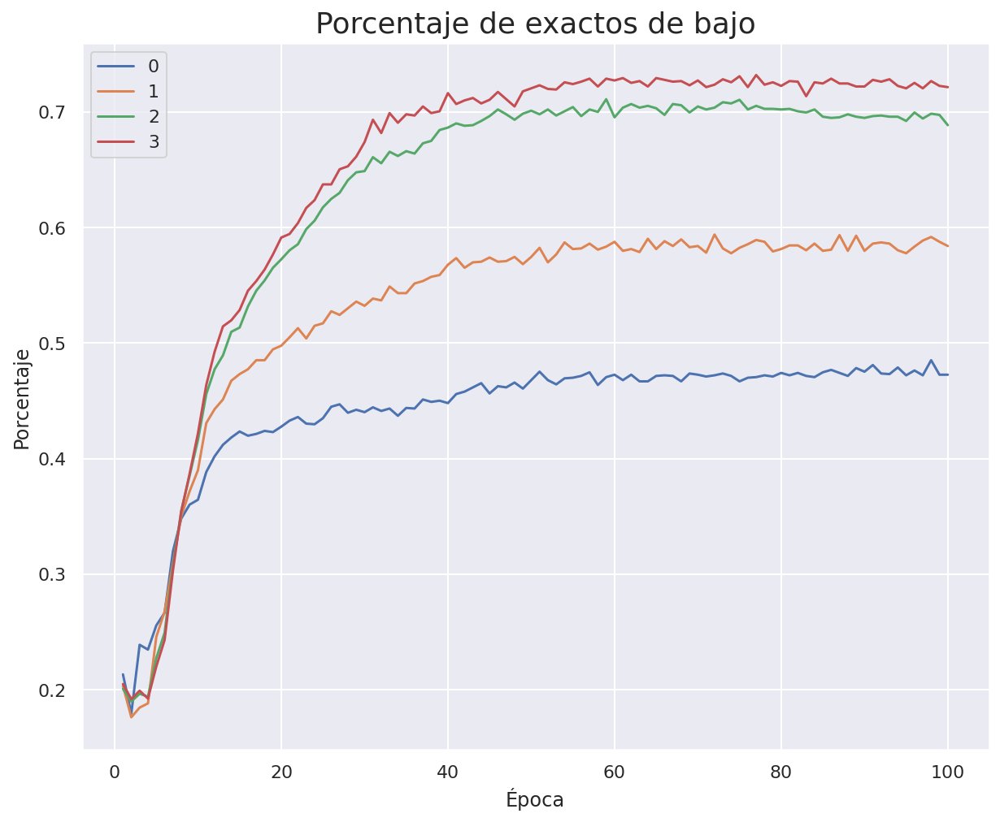

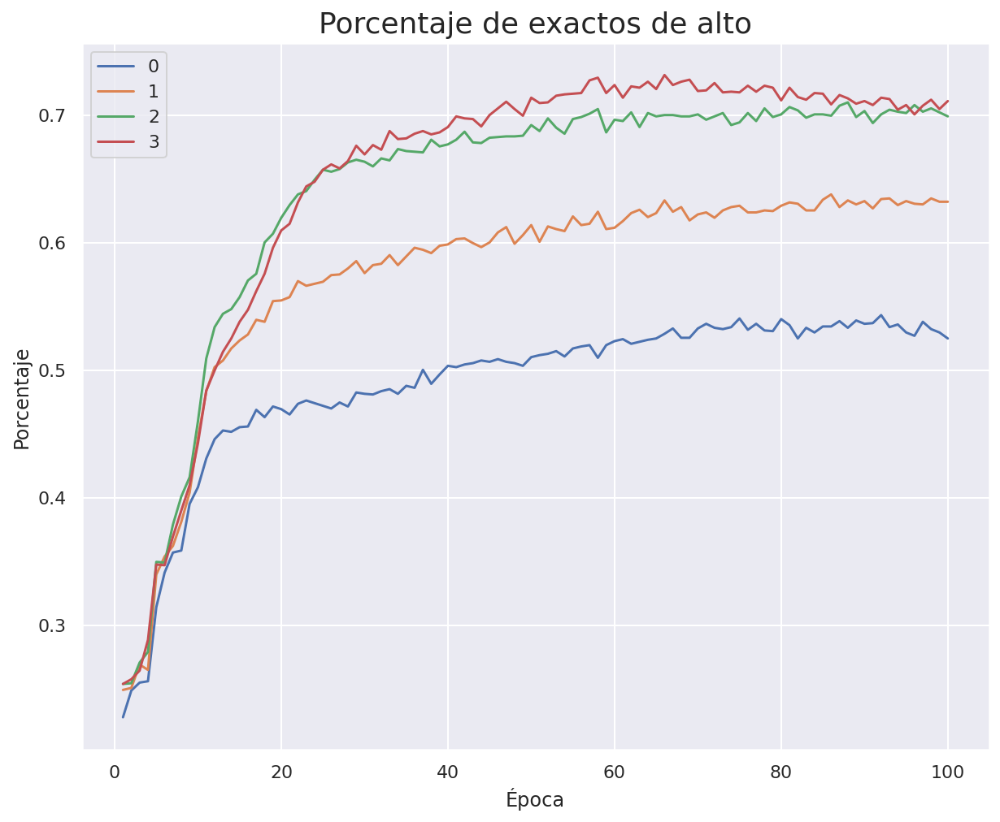

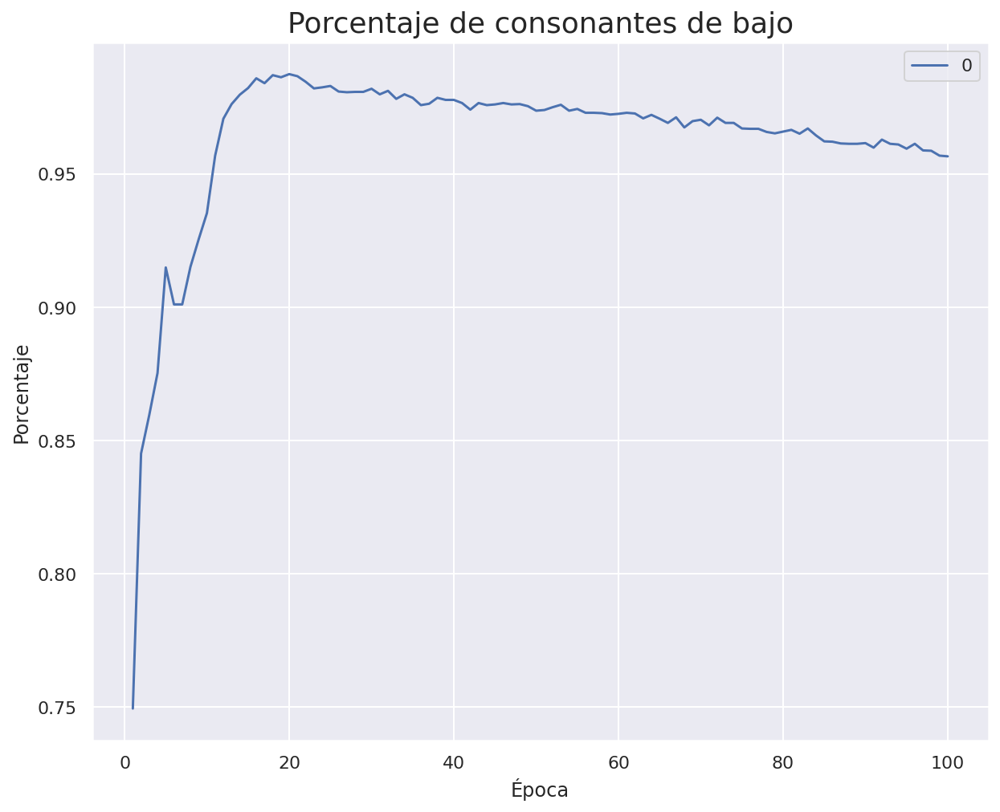

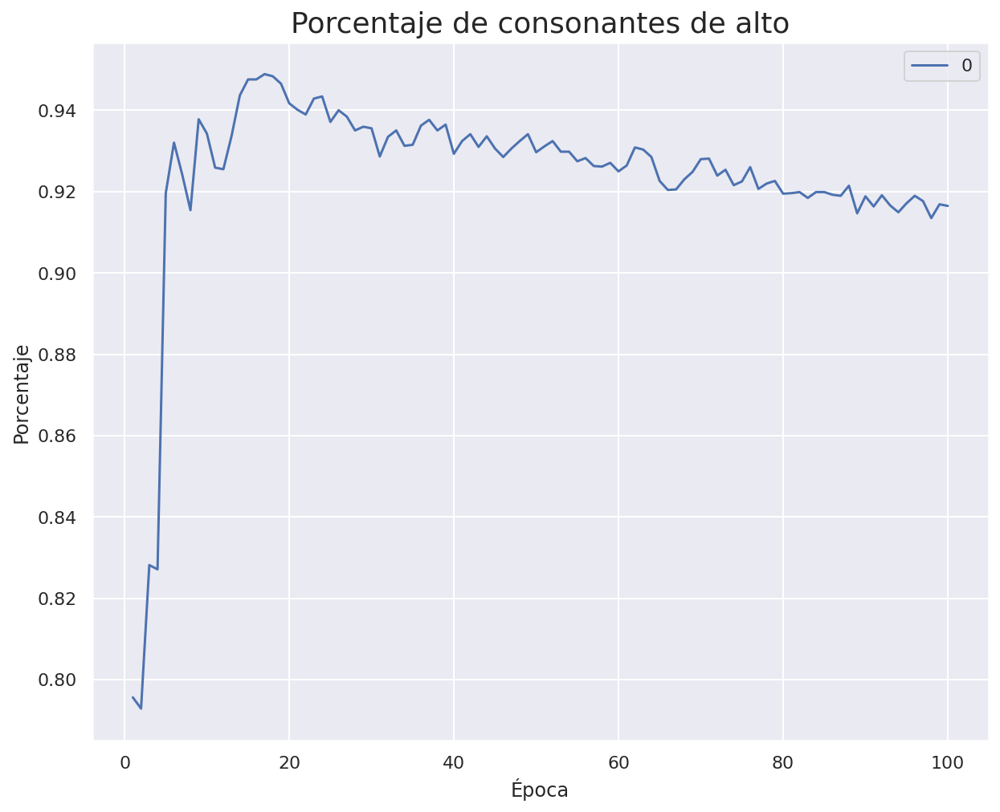

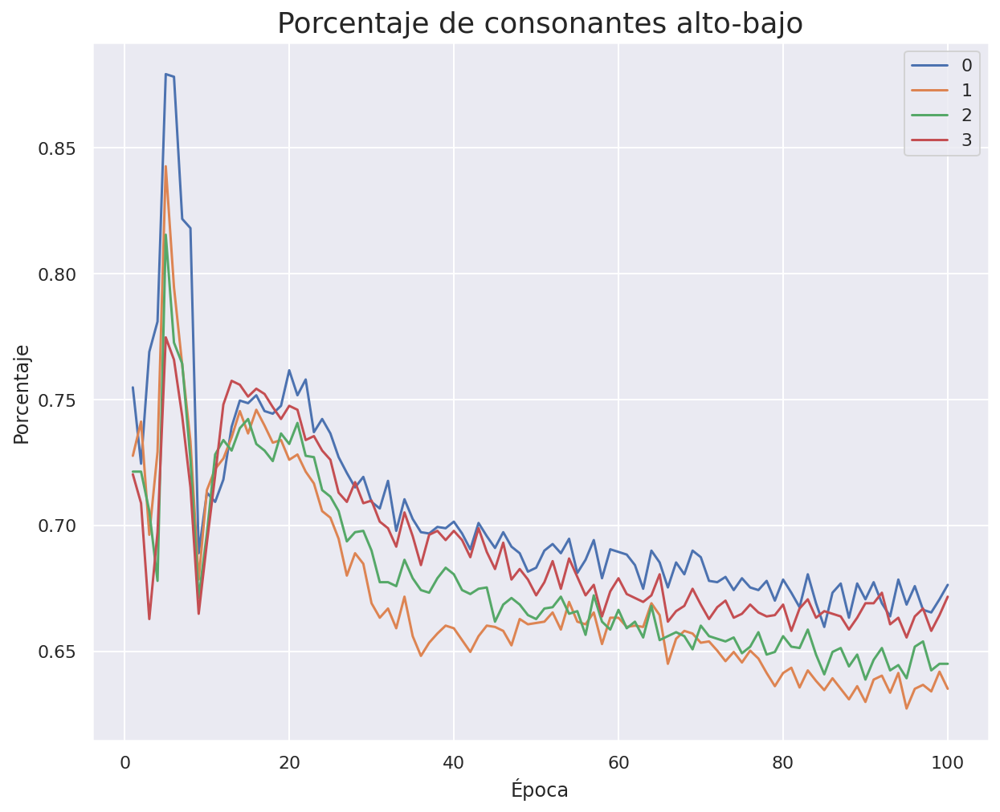

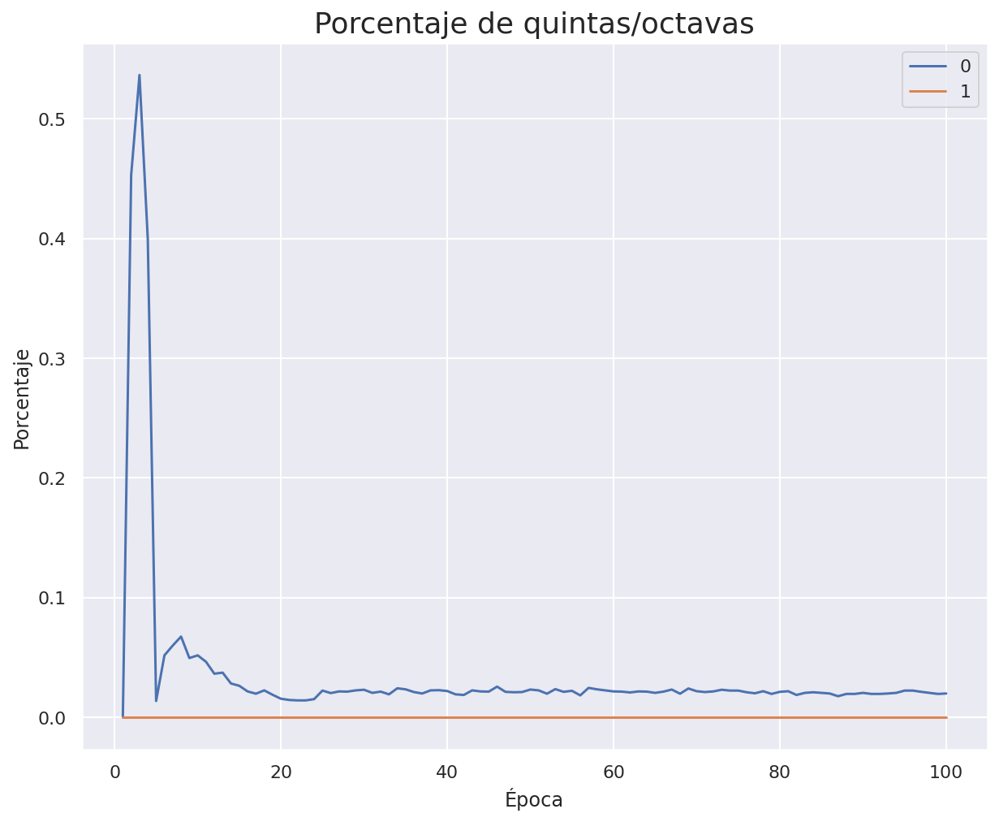

In [ ]:
# Entrenamos la red neuronal para diferentes epocas
# Batch nomalization
# Model.save
# Mirar accuaracy individualmente (buscar calculo del accuaracy)
epochs = 100
batch_size = 64
control_sobreajuste_val = True
grabar_detalles_training_para_tensorboard = True
met_mod = None
met_max = np.zeros(num_notas)
met_epoch = np.zeros(num_notas)

met_mod_1 = None
met_max_1 = np.zeros(num_notas)
met_epoch_1 = np.zeros(num_notas)

met_mod_con = None
met_max_con = 0
met_epoch_con = 0

met_mod_con_1 = None
met_max_con_1 = 0
met_epoch_con_1 = 0

met_mod_con_2 = None
met_max_con_2 = np.zeros(num_notas)
met_epoch_con_2 = np.zeros(num_notas)

met_quin = None
met_min_quin = np.ones(2)
met_epoch_quin = np.zeros(2)
# si no se van a analizar estos detalles en tensorboard mejor
# poner este flag a False ya que el grabarlos enlentence
# bastante el trainingmodel_current_best
model.compile(loss=['categorical_crossentropy','categorical_crossentropy'],
              optimizer='adam',
              #optimizer=Adam(learning_rate=0.01), # más rápido
              metrics=['mse']) 

if not control_sobreajuste_val:
    history = model.fit([embed_train[:-1],embed_sop_train[1:]],
                        y_train, epochs=epochs,
                        batch_size=batch_size, verbose=2)
else:    
    acum_tr_mse = []
    acum_tr_mse_1 = []
    acum_val_mse = []
    acum_val_mse_1 = []
    acum_met = []
    acum_met_1 = []
    acum_met_con = []
    acum_met_con_1 = []
    acum_met_con_2 = []
    acum_met_quin = []
    filepath="model_current_best.h5"
    checkpoint = ModelCheckpoint(filepath, monitor='bajo_mse', verbose=2, 
                                 save_best_only=True,
                                 mode='min') # graba sólo los que mejoran en validación

    if grabar_detalles_training_para_tensorboard:
        callbacks_list = callbacks + [checkpoint]
    else:
        callbacks_list = [checkpoint]
    
    
    for e in range(epochs):
        aux_1 = embed_train
        aux_2 = embed_sop_train
        history = model.fit([aux_1[:-1],aux_2[1:]], 
                            [embed_baj_train_oh[1:],embed_alt_train_oh[1:]],
                            batch_size=batch_size,
                            epochs=1,
                            callbacks=callbacks_list,
                            verbose=0,
                            validation_data=([embed_val[:-1],embed_sop_val[1:]],
                                              [embed_baj_val_oh[1:],embed_alt_val_oh[1:]]))
        

        
        [prediccion,prediccion_1] = model.predict([embed_test,embed_sop_test])
        pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
        for i in range(pred_buena.shape[0]):
          for j in range(pred_buena.shape[1]):
            max_m = np.max(prediccion[i][j])
            pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
        res_prediction = to_nota(pred_buena,voc)

        met = metrica_iguales(res_prediction,to_nota(embed_baj_test,voc),num_notas)
        acum_met.append(met)
        if np.sum(met) > np.sum(met_max):
          print('Metrica igualdad bajo mejorada de ' + str(met_max) + ' a ' + str(met))
          met_max = met
          met_mod = model
          model.save(path + 'met_mod.h5')
          met_epoch = epochs
        
        met_con = metrica_consonante(res_prediction,to_nota(embed_sop_test,voc))
        acum_met_con.append(met_con)
        if met_con > met_max_con:
          print('Metrica consonante bajo mejorada de ' + str(met_max_con) + ' a ' + str(met_con))
          met_max_con = met_con
          met_mod_con = model
          model.save(path + 'met_mod_con.h5')
          met_epoch_con = epochs
          
        pred_buena = np.zeros((prediccion_1.shape[0],prediccion.shape[1]))
        for i in range(pred_buena.shape[0]):
          for j in range(pred_buena.shape[1]):
            max_m = np.max(prediccion_1[i][j])
            pred_buena[i][j] = np.where(prediccion_1[i][j]==max_m )[0][0]
        res_prediction_1 = to_nota(pred_buena,voc)

        met_1 = metrica_iguales(res_prediction_1,to_nota(embed_alt_test,voc),num_notas)
        acum_met_1.append(met_1)
        if np.sum(met_1) > np.sum(met_max_1):
          print('Metrica igualdad alto mejorada de ' + str(met_max_1) + ' a ' + str(met_1))
          met_max_1 = met_1
          met_mod_1 = model
          model.save(path + 'met_mod_1.h5')
          met_epoch_1 = e
        
        met_con_1 = metrica_consonante(res_prediction_1,to_nota(embed_sop_test,voc))
        acum_met_con_1.append(met_con_1)
        if met_con_1 > met_max_con_1:
          print('Metrica consonante alto mejorada de ' + str(met_max_con_1) + ' a ' + str(met_con_1))
          met_max_con_1 = met_con_1
          met_mod_con_1 = model
          model.save(path + 'met_mod_con_1.h5')
          met_epoch_con_1 = e
        
        met_con_2 = metrica_consonante_1(res_prediction,res_prediction_1,to_nota(embed_sop_test,voc))
        acum_met_con_2.append(met_con_2)
        if np.sum(met_con_2) > np.sum(met_max_con_2):
          print('Metrica consonante alto-bajo mejorada de ' + str(met_max_con_2) + ' a ' + str(met_con_2))
          met_max_con_2 = met_con_2
          met_mod_con_2 = model
          model.save(path + 'met_mod_con_2.h5')
          met_epoch_con_2 = e

        met_quin = quint_oct(res_prediction,res_prediction_1)
        acum_met_quin.append(met_quin)
        if np.sum(met_quin) < np.sum(met_min_quin):
          print('Metrica quitas/octavas ' + str(met_min_quin) + ' a ' + str(met_quin))
          met_min_quin = met_quin
          met_mod_quin = model
          model.save(path + 'met_mod_quin.h5')
          met_epoch_quin = e

        acum_tr_mse  += history.history['bajo_mse'] # mean_squared_error
        acum_val_mse += history.history['val_bajo_mse'] # val_mean_squared_error

        acum_tr_mse_1  += history.history['alto_mse'] # mean_squared_error
        acum_val_mse_1 += history.history['val_alto_mse'] # val_mean_squared_error

        if (e+1)%50 == 0:
            grafica_entrenamiento(acum_tr_mse, acum_val_mse,"4_embed_sep_bajomse_" + str(e+1))
            grafica_entrenamiento(acum_tr_mse_1, acum_val_mse_1,"4_embed_sep_altomse"+ str(e+1))
            grafica_metrica(acum_met,"Porcentaje de exactos de bajo","4_embed_sep_exacto_bajo"+ str(e+1))
            grafica_metrica(acum_met_1,"Porcentaje de exactos de alto","4_embed_sep_exacto_alto"+ str(e+1))
            grafica_metrica(acum_met_con,"Porcentaje de consonantes de bajo","4_embed_sep_consonante_bajo"+ str(e+1))
            grafica_metrica(acum_met_con_1,"Porcentaje de consonantes de alto","4_embed_sep_consonante_alto"+ str(e+1))
            grafica_metrica(acum_met_con_2,"Porcentaje de consonantes alto-bajo","4_embed_sep_consonante_alto_bajo"+ str(e+1))
            grafica_metrica(acum_met_quin,"Porcentaje de quintas/octavas","4_embed_sep_exacto_quintas_octavas"+ str(e+1))

##  Prueba con el mejor bajo mse


In [ ]:
model_baj = keras.models.load_model('model_current_best.h5')
num_max = 50
[prediccion,prediccion_1] = model_baj.predict([embed_train,embed_sop_train])
pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion[i][j])
    pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
sop = to_nota(embed_sop_train,voc)
alt_1 = to_nota(embed_alt_train,voc)
baj_1 = to_nota(embed_baj_train,voc)
baj = res_prediction
pred_buena = np.zeros((prediccion_1.shape[0],prediccion_1.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion_1[i][j])
    pred_buena[i][j] = np.where(prediccion_1[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
alt = res_prediction
if sop.shape == baj.shape:
  for i in range(min(num_max,sop.shape[0])):
    print(i)
    play_musica(to_stream([sop[i],alt[i],baj[i]]))
    play_musica(to_stream([sop[i],alt_1[i],baj_1[i]]))
    show_musica(to_stream([sop[i],alt[i],baj[i]]))
    show_musica(to_stream([sop[i],alt_1[i],baj_1[i]]))

In [ ]:
model_baj = keras.models.load_model('model_current_best.h5')
num_max = 50
[prediccion,prediccion_1] = model_baj.predict([embed_test,embed_sop_test])
pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion[i][j])
    pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
sop = to_nota(embed_sop_test,voc)
alt_1 = to_nota(embed_alt_test,voc)
baj_1 = to_nota(embed_baj_test,voc)
baj = res_prediction
pred_buena = np.zeros((prediccion_1.shape[0],prediccion_1.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion_1[i][j])
    pred_buena[i][j] = np.where(prediccion_1[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
alt = res_prediction
if sop.shape == baj.shape:
  for i in range(min(num_max,sop.shape[0])):
    print(i)
    play_musica(to_stream([sop[i],alt[i],baj[i]]))
    play_musica(to_stream([sop[i],alt_1[i],baj_1[i]]))
    show_musica(to_stream([sop[i],alt[i],baj[i]]))
    show_musica(to_stream([sop[i],alt_1[i],baj_1[i]]))

## Prueba máximo condicion


In [ ]:
model_baj = keras.models.load_model(path + 'met_mod_con_2.h5')
num_max = 50
[prediccion,prediccion_1] = model_baj.predict([embed_train,embed_sop_train])
pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion[i][j])
    pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
sop = to_nota(embed_sop_train,voc)
alt_1 = to_nota(embed_alt_train,voc)
baj_1 = to_nota(embed_baj_train,voc)
baj = res_prediction
pred_buena = np.zeros((prediccion_1.shape[0],prediccion_1.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion_1[i][j])
    pred_buena[i][j] = np.where(prediccion_1[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
alt = res_prediction
if sop.shape == baj.shape:
  for i in range(min(num_max,sop.shape[0])):
    print(i)
    play_musica(to_stream([sop[i],alt[i],baj[i]]))
    play_musica(to_stream([sop[i],alt_1[i],baj_1[i]]))
    show_musica(to_stream([sop[i],alt[i],baj[i]]))
    show_musica(to_stream([sop[i],alt_1[i],baj_1[i]]))

In [ ]:
model_baj = keras.models.load_model(path + 'met_mod_con_2.h5')
num_max = 50
[prediccion,prediccion_1] = model_baj.predict([embed_test,embed_sop_test])
pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion[i][j])
    pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
sop = to_nota(embed_sop_test,voc)
alt_1 = to_nota(embed_alt_test,voc)
baj_1 = to_nota(embed_baj_test,voc)
baj = res_prediction
pred_buena = np.zeros((prediccion_1.shape[0],prediccion_1.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion_1[i][j])
    pred_buena[i][j] = np.where(prediccion_1[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
alt = res_prediction
if sop.shape == baj.shape:
  for i in range(min(num_max,sop.shape[0])):
    print(i)
    play_musica(to_stream([sop[i],alt[i],baj[i]]))
    play_musica(to_stream([sop[i],alt_1[i],baj_1[i]]))
    show_musica(to_stream([sop[i],alt[i],baj[i]]))
    show_musica(to_stream([sop[i],alt_1[i],baj_1[i]]))

## Prueba máximo concordancia


In [ ]:
if met_epoch_con > met_epoch_con_1:
  model_baj = keras.models.load_model(path + 'met_mod_con.h5')
else:
  model_baj = keras.models.load_model(path + 'met_mod_con_1.h5')
num_max = 50
[prediccion,prediccion_1] = model_baj.predict([embed_train,embed_sop_train])
pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion[i][j])
    pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
sop = to_nota(embed_sop_train,voc)
alt_1 = to_nota(embed_alt_train,voc)
baj_1 = to_nota(embed_baj_train,voc)
baj = res_prediction
pred_buena = np.zeros((prediccion_1.shape[0],prediccion_1.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion_1[i][j])
    pred_buena[i][j] = np.where(prediccion_1[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
alt = res_prediction
if sop.shape == baj.shape:
  for i in range(min(num_max,sop.shape[0])):
    print(i)
    play_musica(to_stream([sop[i],alt[i],baj[i]]))
    play_musica(to_stream([sop[i],alt_1[i],baj_1[i]]))
    show_musica(to_stream([sop[i],alt[i],baj[i]]))
    show_musica(to_stream([sop[i],alt_1[i],baj_1[i]]))

In [ ]:
if met_epoch_con > met_epoch_con_1:
  model_baj = keras.models.load_model(path + 'met_mod_con.h5')
else:
  model_baj = keras.models.load_model(path + 'met_mod_con_1.h5')
num_max = 50
[prediccion,prediccion_1] = model_baj.predict([embed_test,embed_sop_test])
pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion[i][j])
    pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
sop = to_nota(embed_sop_test,voc)
alt_1 = to_nota(embed_alt_test,voc)
baj_1 = to_nota(embed_baj_test,voc)
baj = res_prediction
pred_buena = np.zeros((prediccion_1.shape[0],prediccion_1.shape[1]))
for i in range(pred_buena.shape[0]):
  for j in range(pred_buena.shape[1]):
    max_m = np.max(prediccion_1[i][j])
    pred_buena[i][j] = np.where(prediccion_1[i][j]==max_m )[0][0]
res_prediction = to_nota(pred_buena,voc)
alt = res_prediction
if sop.shape == baj.shape:
  for i in range(min(num_max,sop.shape[0])):
    print(i)
    play_musica(to_stream([sop[i],alt[i],baj[i]]))
    play_musica(to_stream([sop[i],alt_1[i],baj_1[i]]))
    show_musica(to_stream([sop[i],alt[i],baj[i]]))
    show_musica(to_stream([sop[i],alt_1[i],baj_1[i]]))

# Carga de Datos Final

In [ ]:
# Obtenemos los datos enventanados de cuatro notas del pickle o de los corals
datos_sop = []
datos_baj = []
datos_sol = []
voc = set()
num_notas = 4
train_perc = .6
val_perc = .8
tam = len(m21.corpus.chorales.ChoraleList().byBWV) 
punto_corte_1 = 0
punto_corte_2 = 0
conteo = 0
path = pick_path + "emb_dob/"

try:
  pickle_in = open(pick_path + str(num_notas) + "_datos_sop.pck","rb")
  datos_sop = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_alt.pck","rb")
  datos_alt = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_ten.pck","rb")
  datos_ten = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_baj.pck","rb")
  datos_baj = pickle.load(pickle_in)
  pickle_in.close()

  pickle_in = open(pick_path + str(num_notas) + "_datos_cortes.pck","rb")
  ptos_corte = pickle.load(pickle_in)
  pickle_in.close()

  punto_corte_1,punto_corte_2 = ptos_corte

except:
  # Enventanamos los datos de la soprano y el bajo
  for coral in m21.corpus.chorales.ChoraleList().byBWV:
    x,y = enventanar(Coral(coral).voces_n['Soprano'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_sop.append(lista)
    x,y = enventanar(Coral(coral).voces_n['Bass'],compases=False,notas=True,num_notas=num_notas)
    for lista in x.tolist():
      voc.update(lista)
      datos_baj.append(lista)
    datos_sol.extend(y)
    conteo += 1
    if conteo == int(tam*train_perc):
      punto_corte_1 = len(datos_sop)
    if conteo == int(tam*val_perc):
      punto_corte_2 = len(datos_sop)
  
  pickle_out = open(pick_path + str(num_notas) + "_datos_sop.pck","wb")
  pickle.dump(datos_sop,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_baj.pck","wb")
  pickle.dump(datos_baj,pickle_out)
  pickle_out.close()

  pickle_out = open(pick_path + str(num_notas) + "_datos_ten.pck","wb")
  pickle.dump(datos_ten,pickle_out)
  pickle_out.close()

  ptos_corte = [punto_corte_1,punto_corte_2]
  pickle_out = open(pick_path + str(num_notas) + "_datos_cortes.pck","wb")
  pickle.dump(ptos_corte,pickle_out)
  pickle_out.close()

embed_sop = np.array(datos_sop,dtype='float32')
embed_alt = np.array(datos_alt,dtype='float32')
embed_ten = np.array(datos_ten,dtype='float32')
embed_baj = np.array(datos_baj,dtype='float32')

embed = np.concatenate((embed_sop,embed_alt,embed_ten,embed_baj),axis=1)
voc = np.unique(np.concatenate((embed_sop,embed_alt,embed_ten,embed_baj),axis=1))

embed_sop = to_index(embed_sop,voc)
embed_alt = to_index(embed_alt,voc)
embed_ten = to_index(embed_ten,voc)
embed_baj = to_index(embed_baj,voc)
embed = to_index(embed,voc)

# Separamos los datos en train, validation y test 
embed_train = embed[:punto_corte_1]
embed_sop_train = embed_sop[:punto_corte_1]
embed_alt_train = embed_alt[:punto_corte_1]
embed_ten_train = embed_ten[:punto_corte_1]
embed_baj_train = embed_baj[:punto_corte_1]

embed_test = embed[punto_corte_1:punto_corte_2]
embed_sop_test = embed_sop[punto_corte_1:punto_corte_2]
embed_alt_test = embed_alt[punto_corte_1:punto_corte_2]
embed_ten_test = embed_ten[punto_corte_1:punto_corte_2]
embed_baj_test = embed_baj[punto_corte_1:punto_corte_2]

embed_val = embed[punto_corte_2:]
embed_sop_val = embed_sop[punto_corte_2:]
embed_alt_val = embed_alt[punto_corte_2:]
embed_ten_val = embed_ten[punto_corte_2:]
embed_baj_val = embed_baj[punto_corte_2:]

print(embed_train.shape,embed_sop_train.shape,embed_ten_train.shape)
print(embed_val.shape,embed_sop_val.shape,embed_ten_val.shape)
print(embed_test.shape,embed_sop_test.shape,embed_ten_test.shape)

(5406, 16) (5406, 4) (5406, 4)
(2003, 16) (2003, 4) (2003, 4)
(1913, 16) (1913, 4) (1913, 4)


In [ ]:
# Pasar a one hot y poner categorycal crossentropy min log loss
n_notas = len(np.unique(embed))
embed_baj_train_oh = np.zeros((embed_baj_train.shape[0],embed_baj_train.shape[1],n_notas))
for i in range(embed_baj_train.shape[0]):
  for j in range(embed_baj_train.shape[1]):
    embed_baj_train_oh[i][j][embed_baj_train[i][j].astype(int)] = 1

embed_baj_val_oh = np.zeros((embed_baj_val.shape[0],embed_baj_val.shape[1],n_notas))
for i in range(embed_baj_val.shape[0]):
  for j in range(embed_baj_val.shape[1]):
    embed_baj_val_oh[i][j][embed_baj_val[i][j].astype(int)] = 1

embed_baj_test_oh = np.zeros((embed_baj_test.shape[0],embed_baj_test.shape[1],n_notas))
for i in range(embed_baj_test.shape[0]):
  for j in range(embed_baj_test.shape[1]):
    embed_baj_test_oh[i][j][embed_baj_test[i][j].astype(int)] = 1

embed_alt_train_oh = np.zeros((embed_alt_train.shape[0],embed_alt_train.shape[1],n_notas))
for i in range(embed_alt_train.shape[0]):
  for j in range(embed_alt_train.shape[1]):
    embed_alt_train_oh[i][j][embed_alt_train[i][j].astype(int)] = 1

embed_alt_val_oh = np.zeros((embed_alt_val.shape[0],embed_alt_val.shape[1],n_notas))
for i in range(embed_alt_val.shape[0]):
  for j in range(embed_alt_val.shape[1]):
    embed_alt_val_oh[i][j][embed_alt_val[i][j].astype(int)] = 1

embed_alt_test_oh = np.zeros((embed_alt_test.shape[0],embed_alt_test.shape[1],n_notas))
for i in range(embed_alt_test.shape[0]):
  for j in range(embed_alt_test.shape[1]):
    embed_alt_test_oh[i][j][embed_alt_test[i][j].astype(int)] = 1

embed_ten_train_oh = np.zeros((embed_ten_train.shape[0],embed_ten_train.shape[1],n_notas))
for i in range(embed_ten_train.shape[0]):
  for j in range(embed_ten_train.shape[1]):
    embed_ten_train_oh[i][j][embed_ten_train[i][j].astype(int)] = 1

embed_ten_val_oh = np.zeros((embed_ten_val.shape[0],embed_ten_val.shape[1],n_notas))
for i in range(embed_ten_val.shape[0]):
  for j in range(embed_ten_val.shape[1]):
    embed_ten_val_oh[i][j][embed_ten_val[i][j].astype(int)] = 1

embed_ten_test_oh = np.zeros((embed_ten_test.shape[0],embed_ten_test.shape[1],n_notas))
for i in range(embed_ten_test.shape[0]):
  for j in range(embed_ten_test.shape[1]):
    embed_ten_test_oh[i][j][embed_ten_test[i][j].astype(int)] = 1

# Red neuronal final. Búsqueda mayor media de consonancia

Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding (Embedding)          (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm (LSTM)                    (None, 10)           1400        ['embedding[0][0]']              
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                              

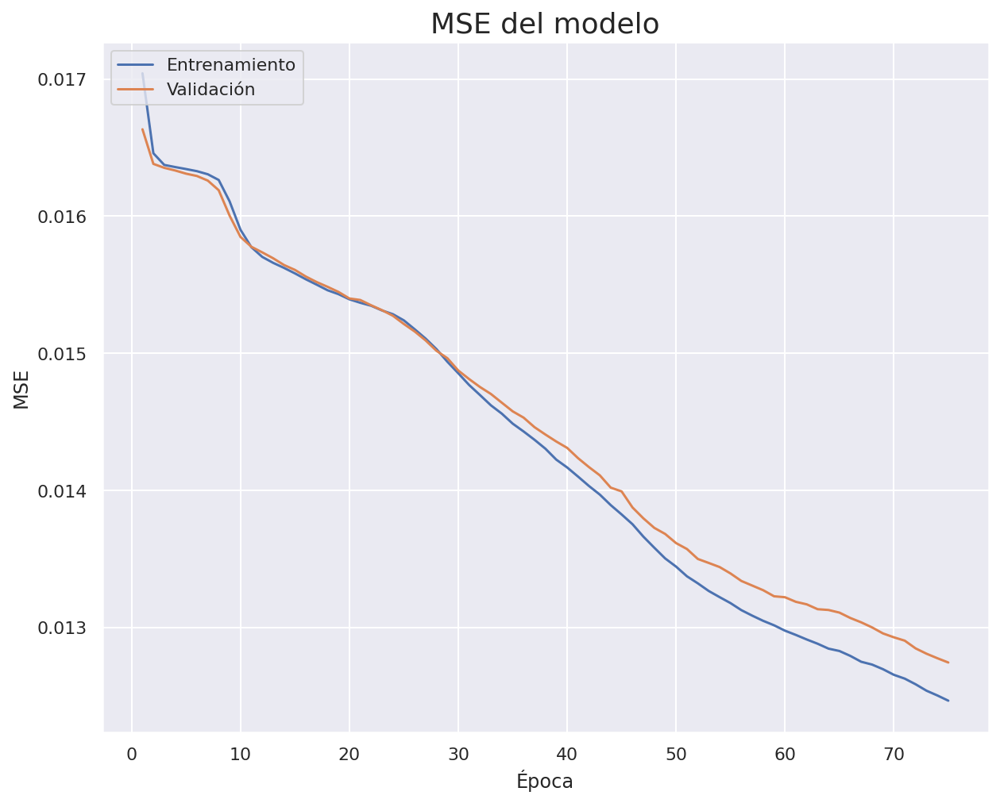

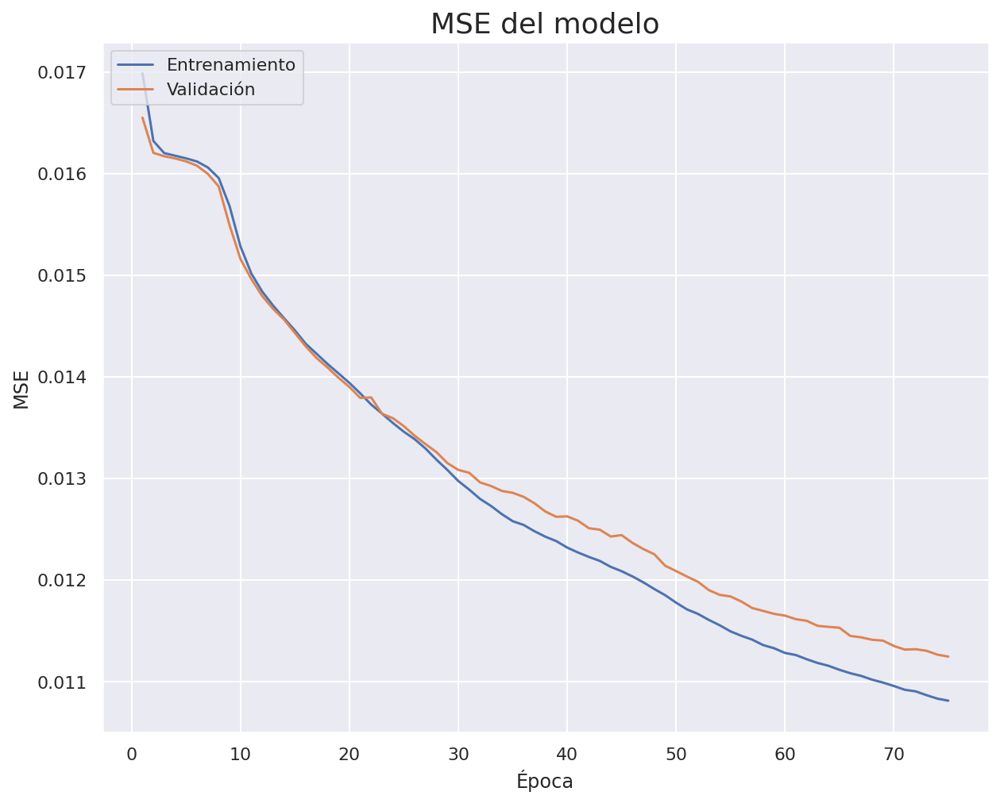

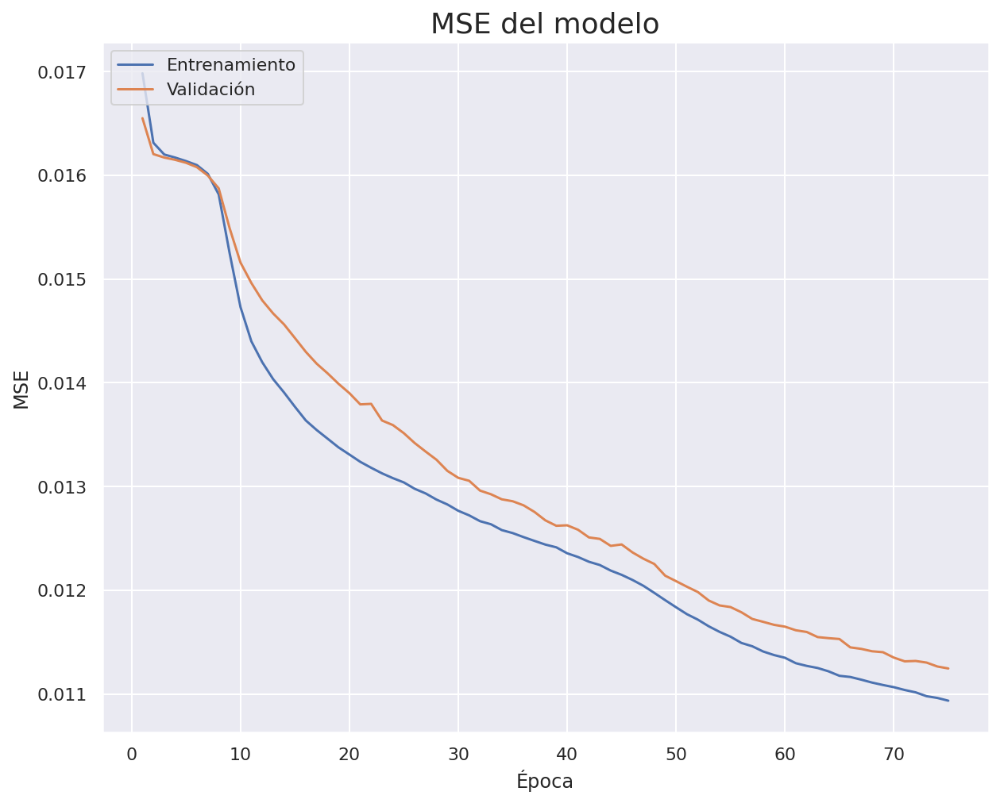

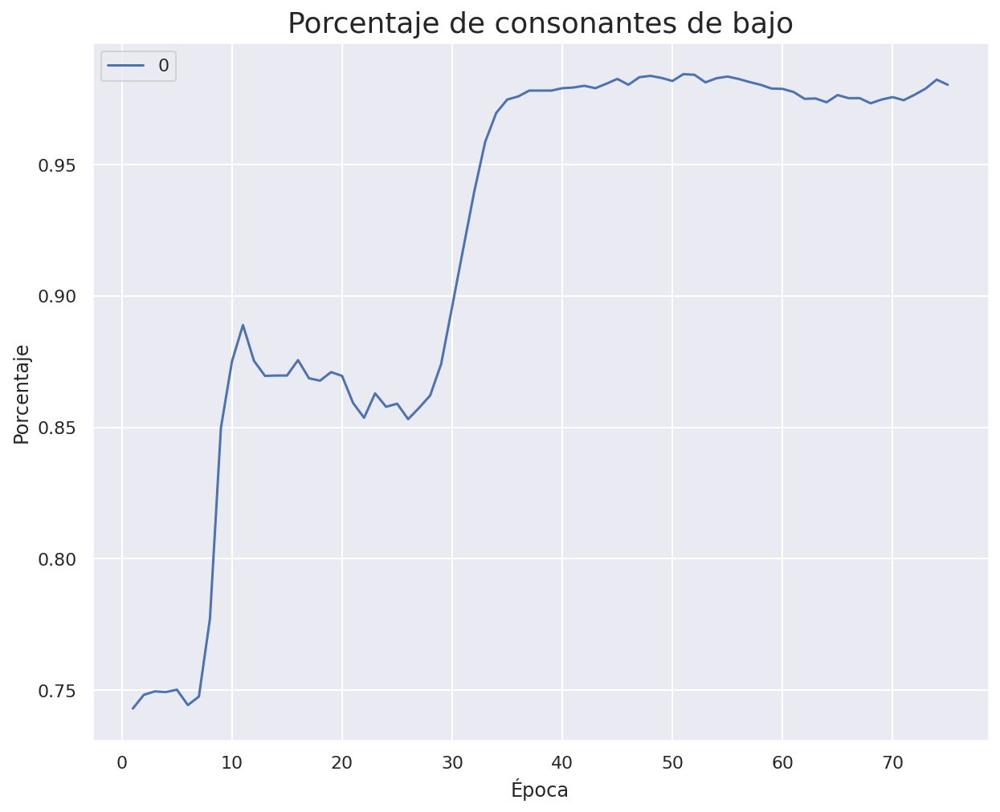

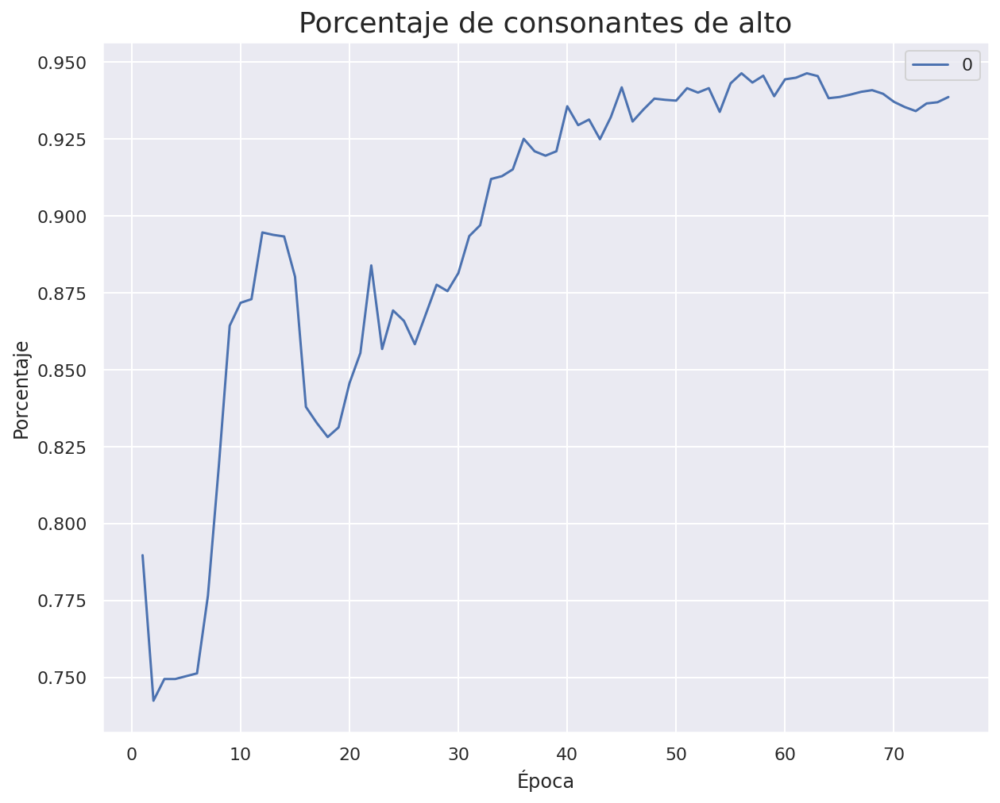

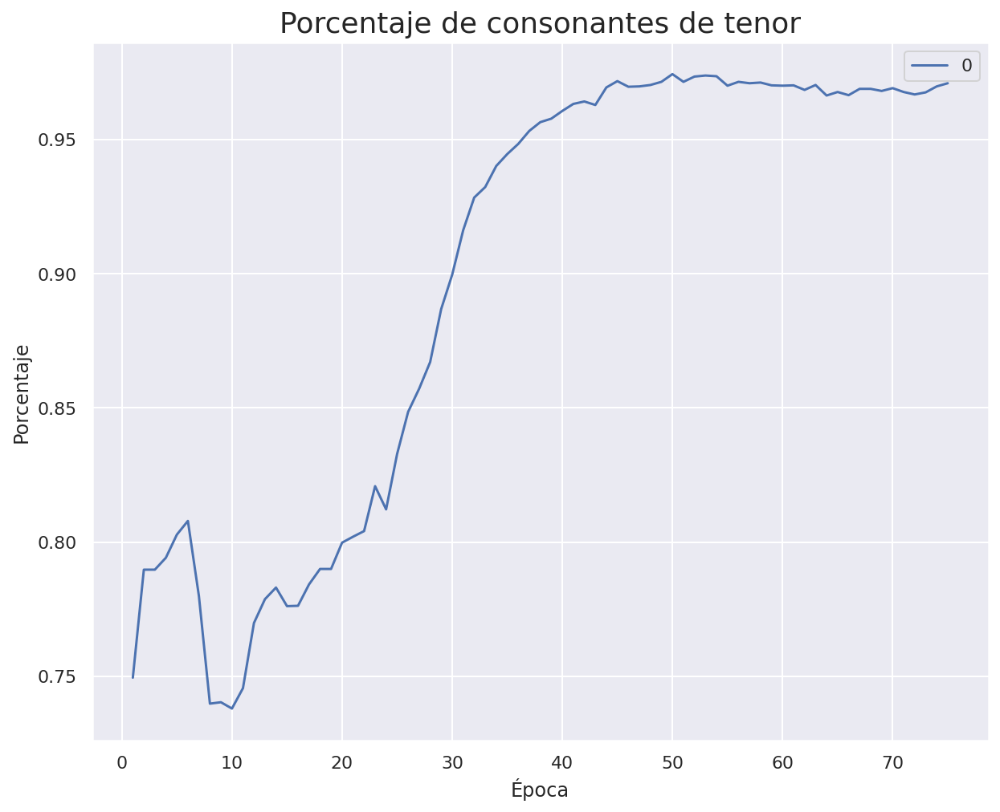

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_2 (Embedding)        (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_2 (LSTM)                  (None, 11)           1584        ['embedding_2[0][0]']            
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

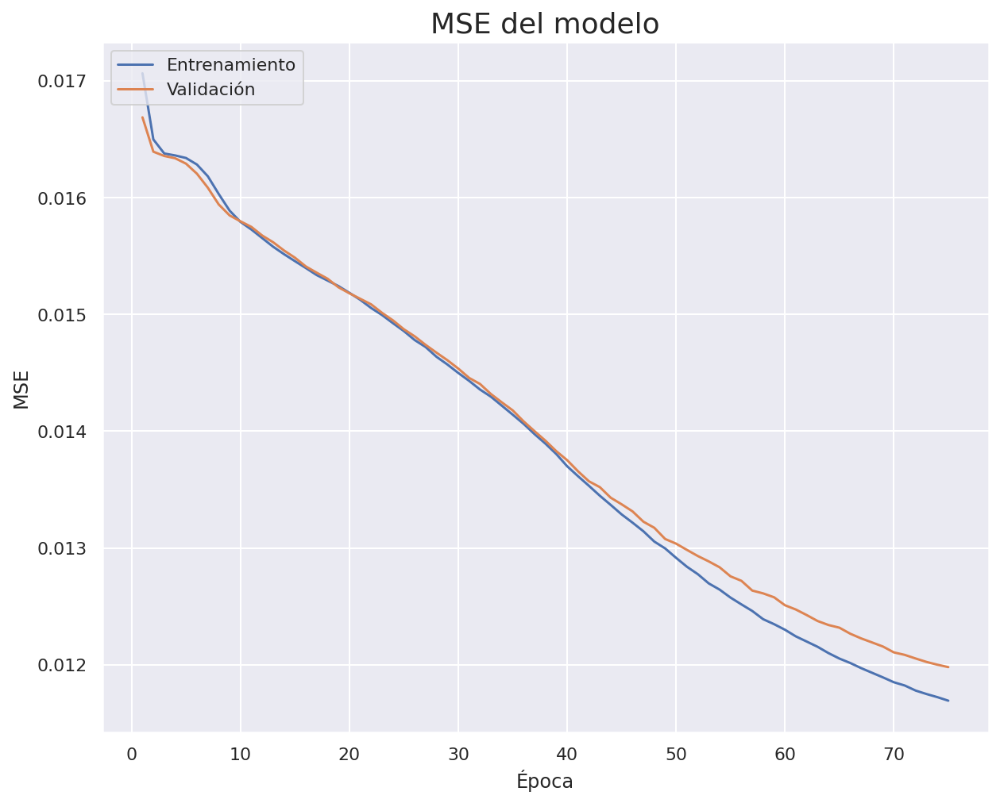

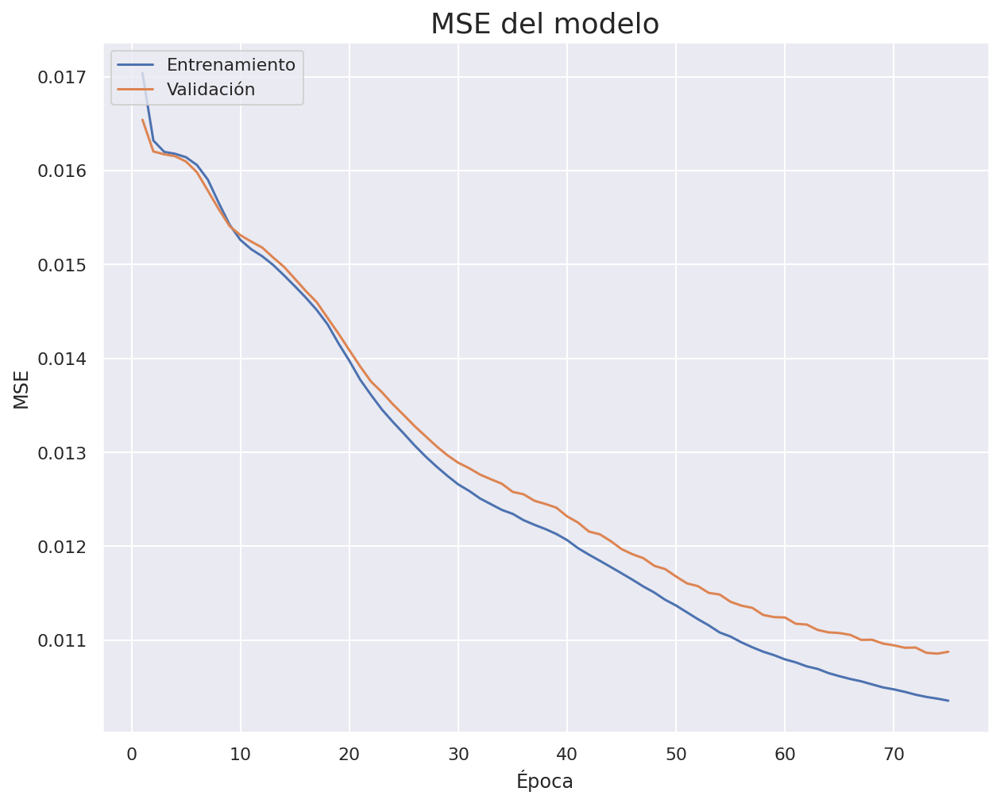

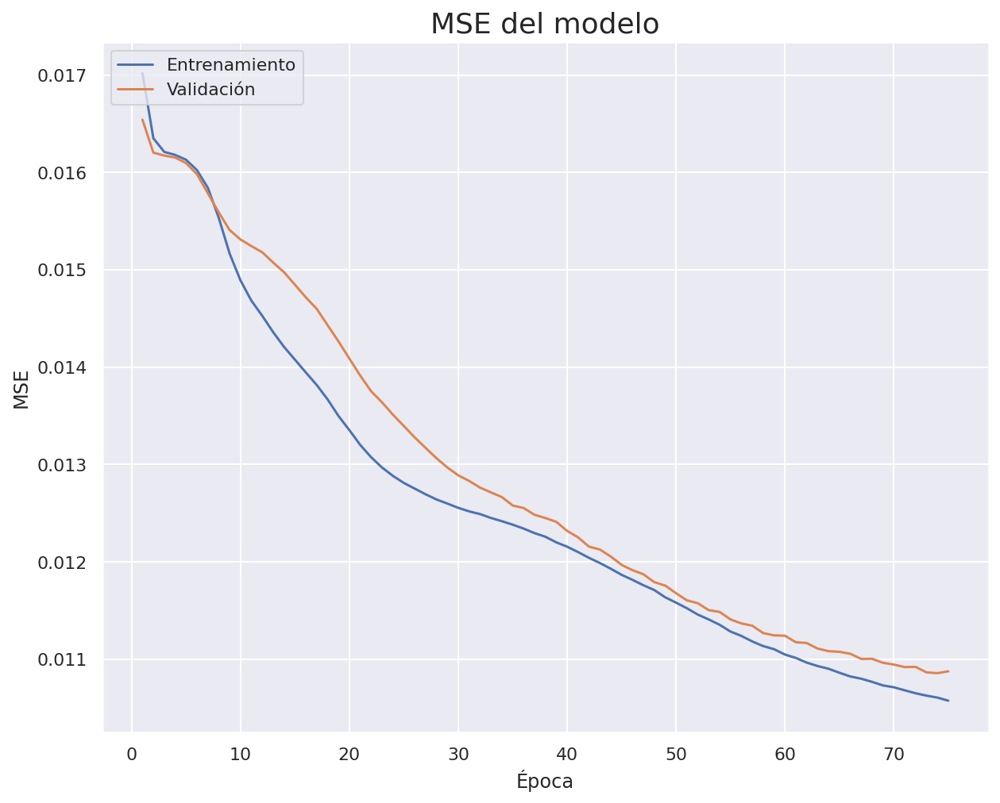

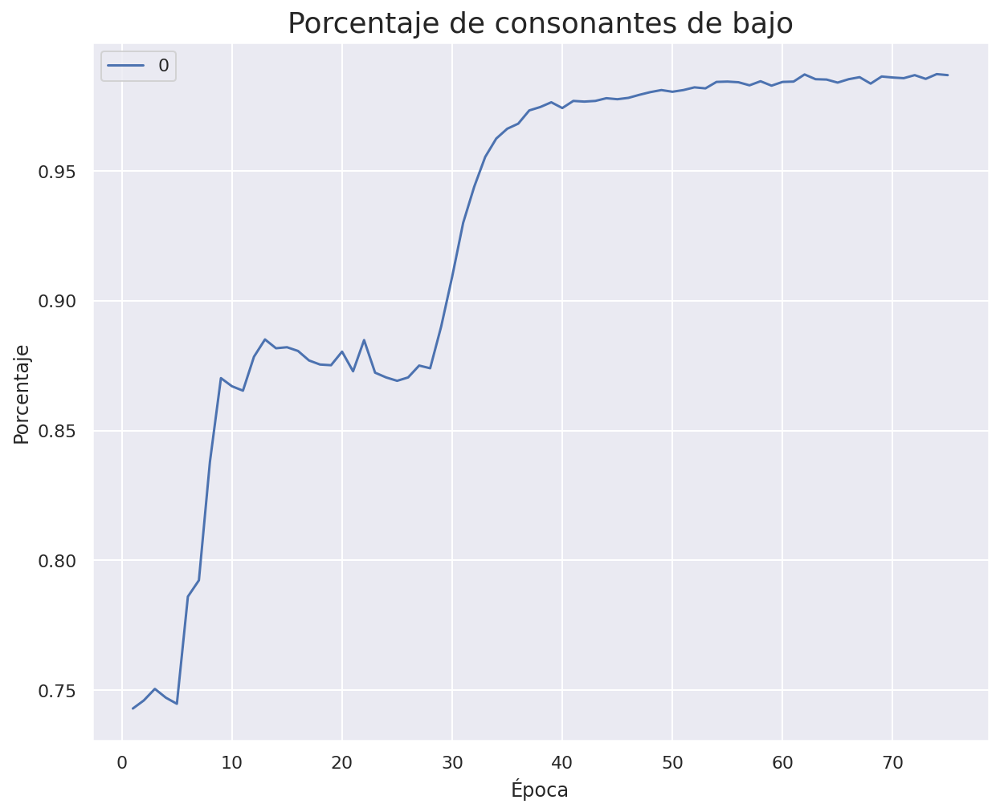

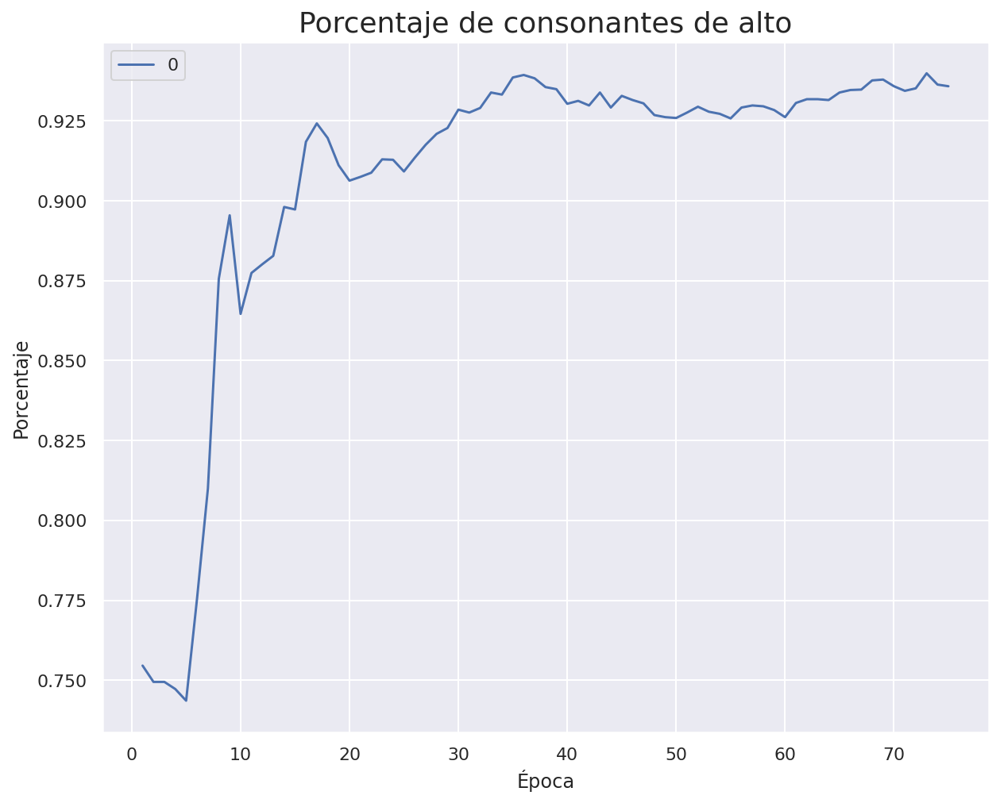

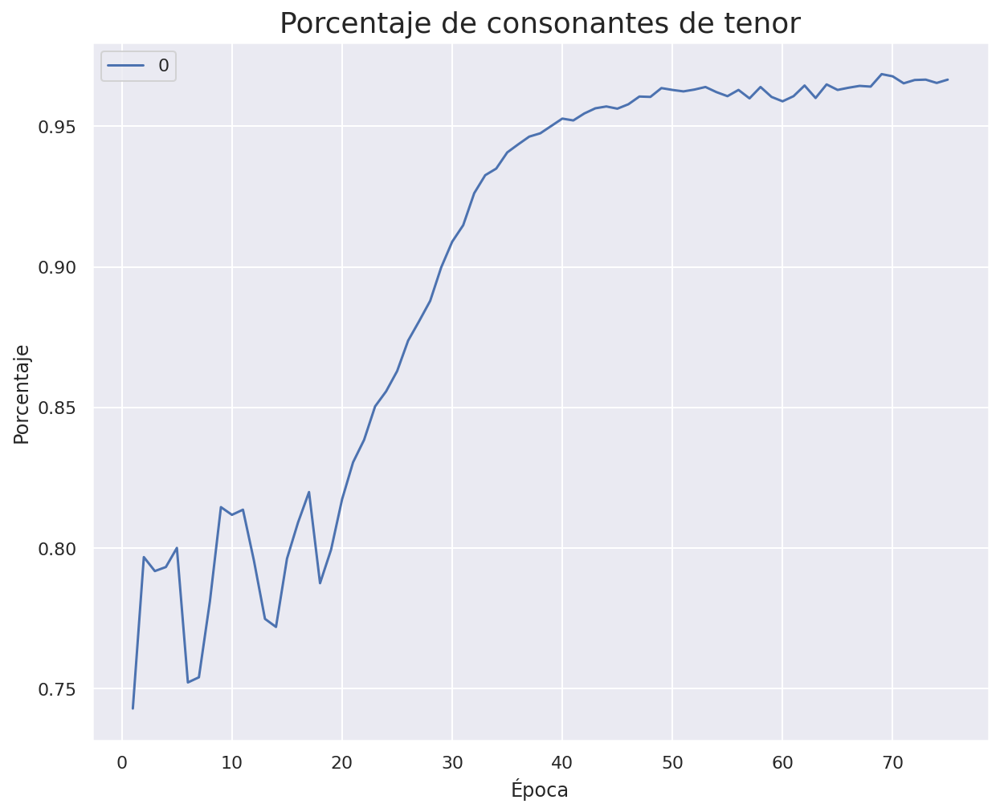

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_4 (Embedding)        (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_4 (LSTM)                  (None, 12)           1776        ['embedding_4[0][0]']            
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

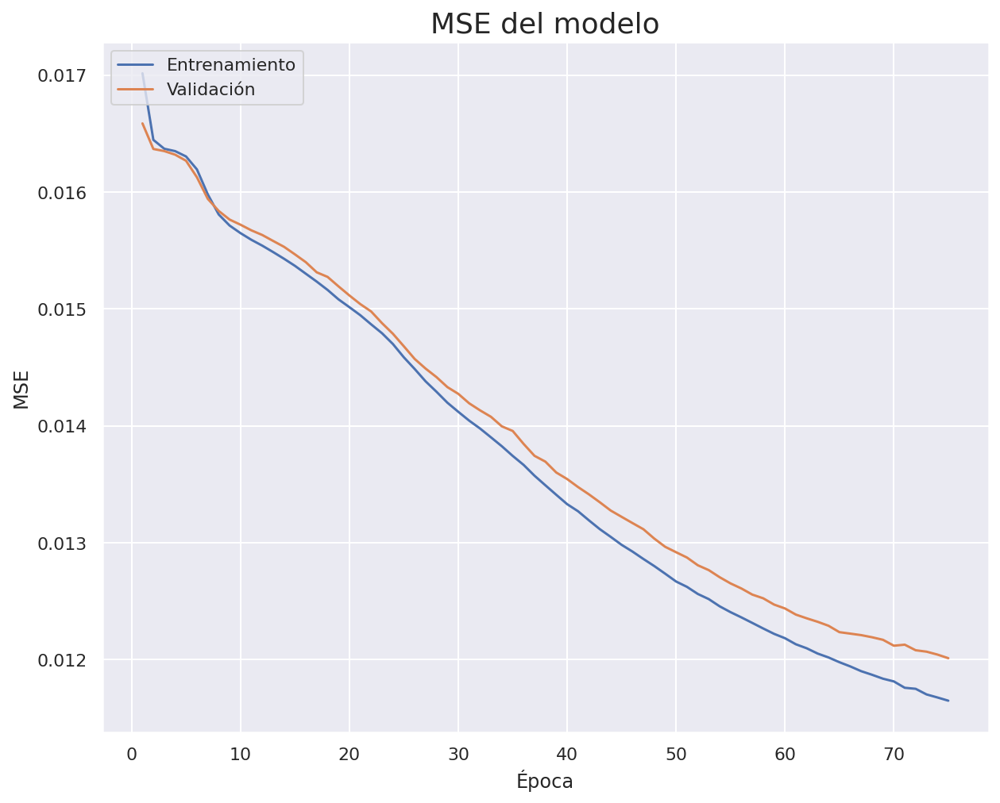

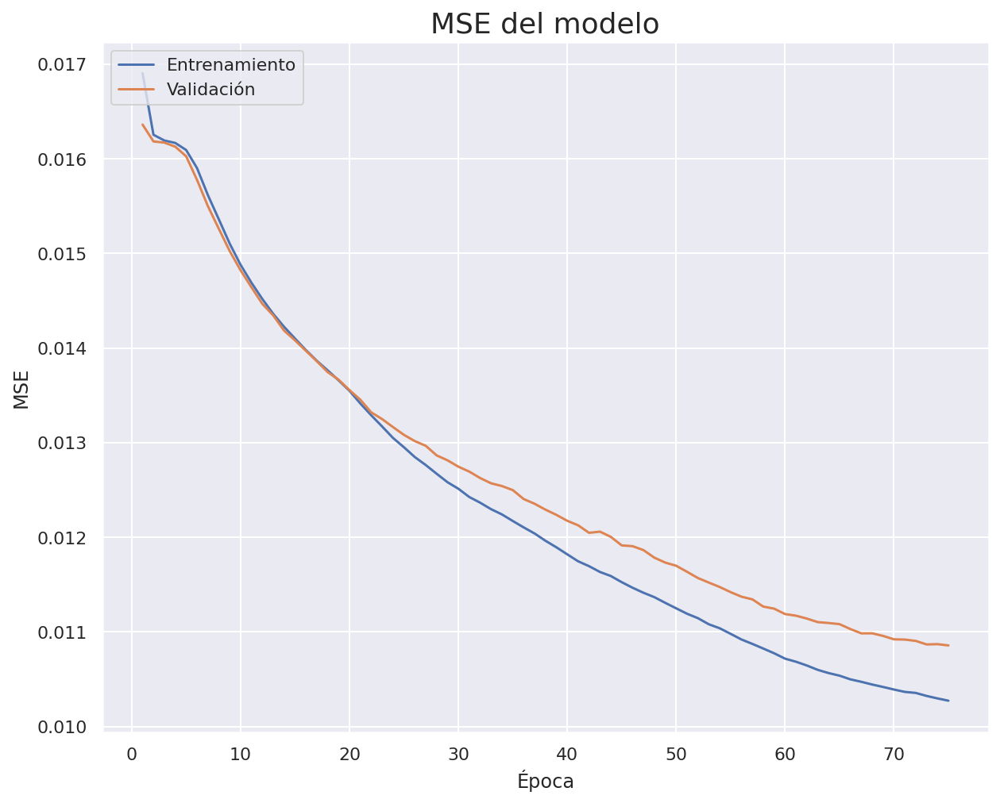

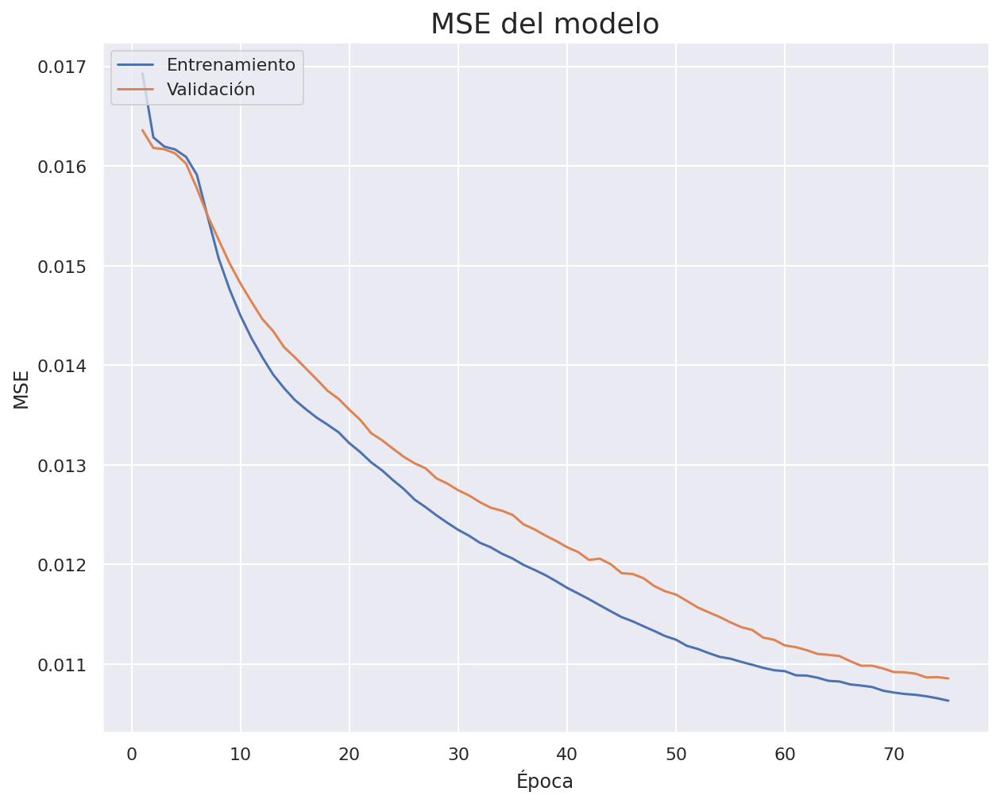

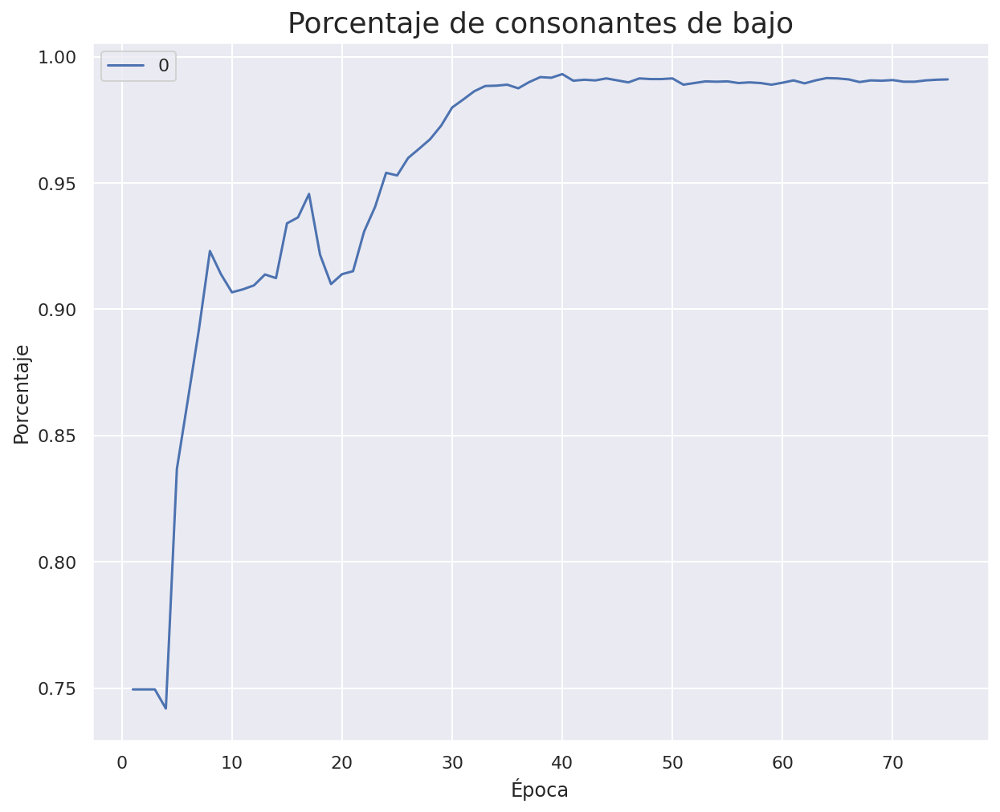

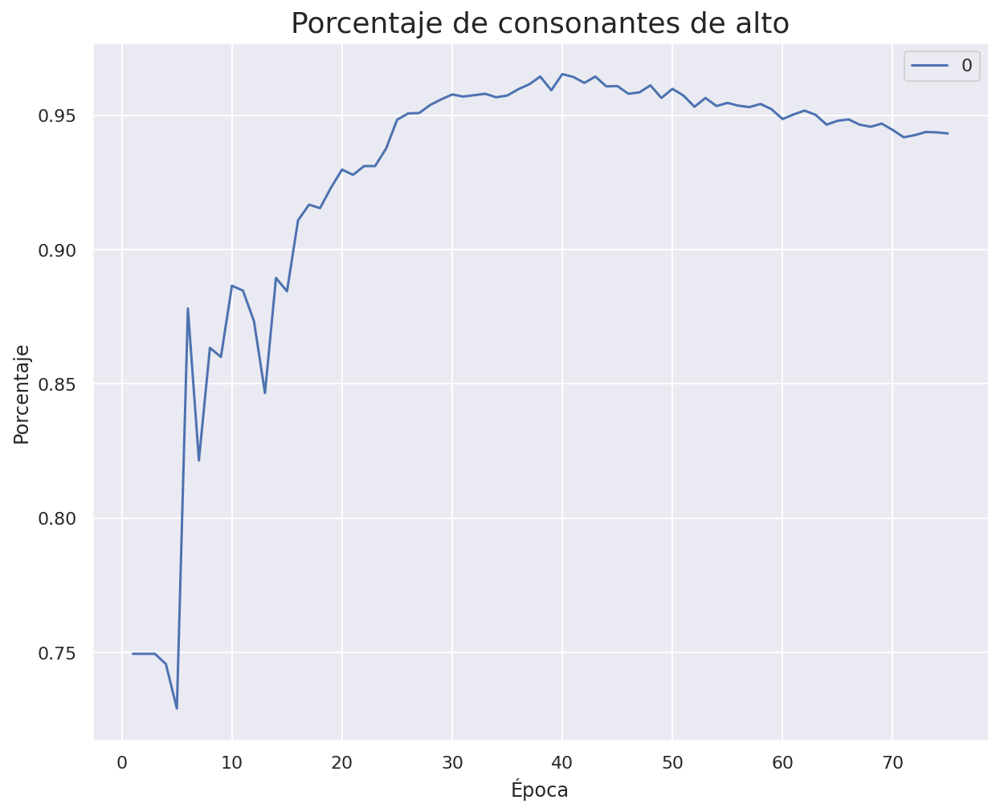

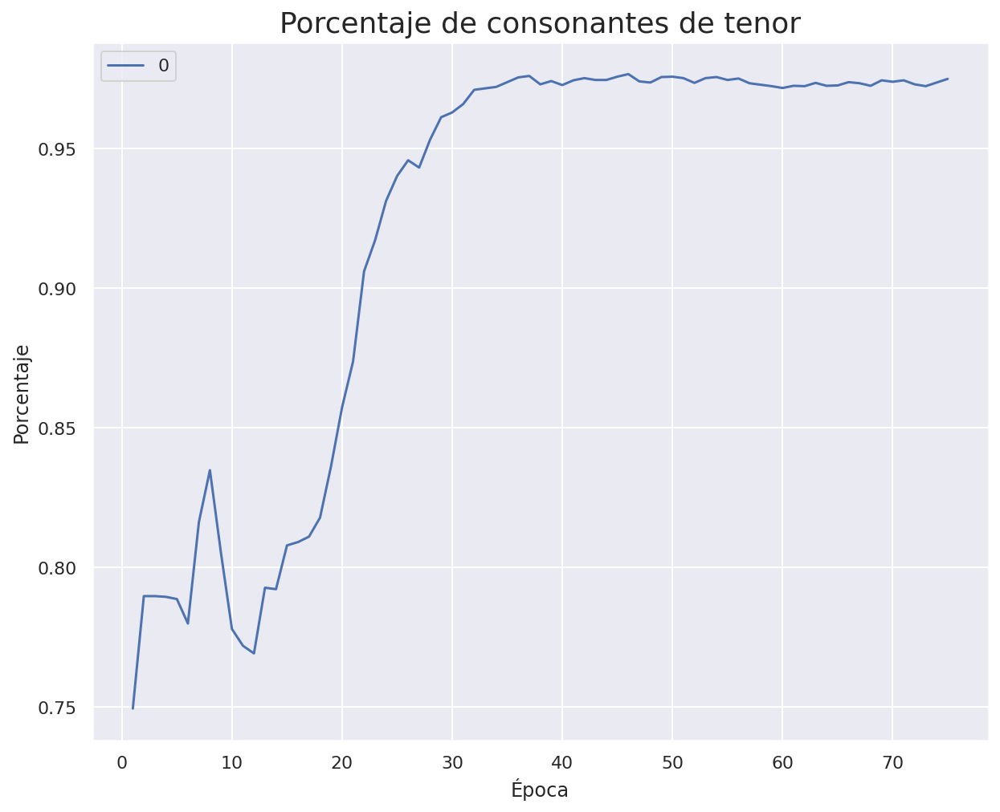

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_6 (Embedding)        (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_6 (LSTM)                  (None, 13)           1976        ['embedding_6[0][0]']            
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

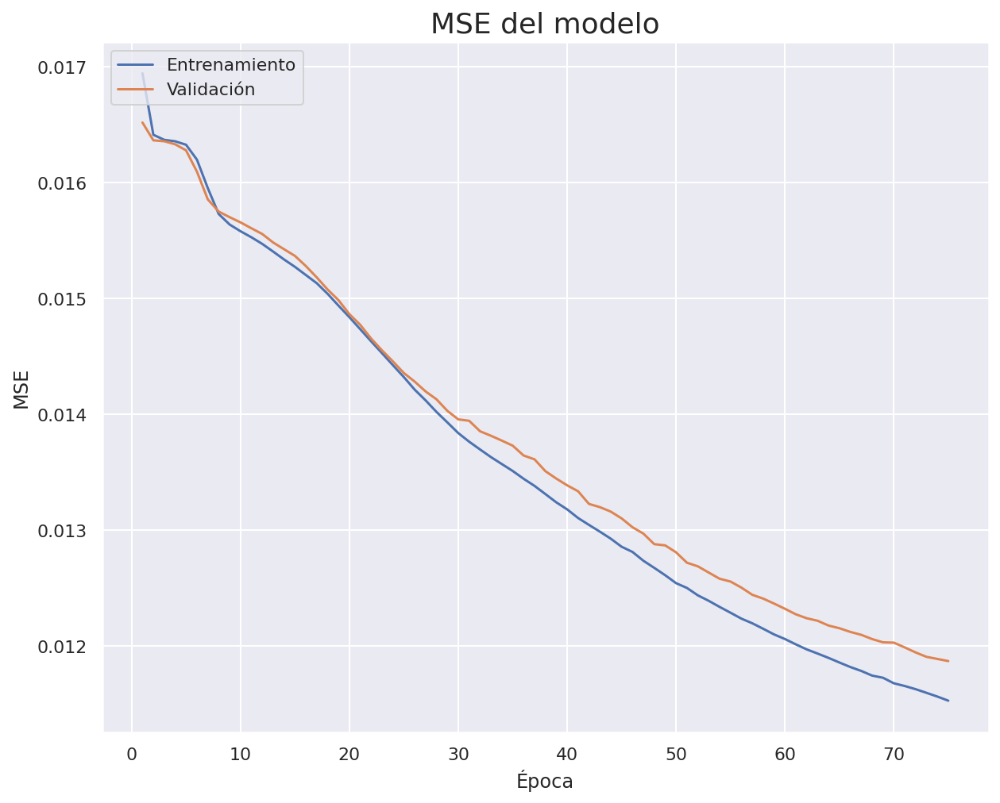

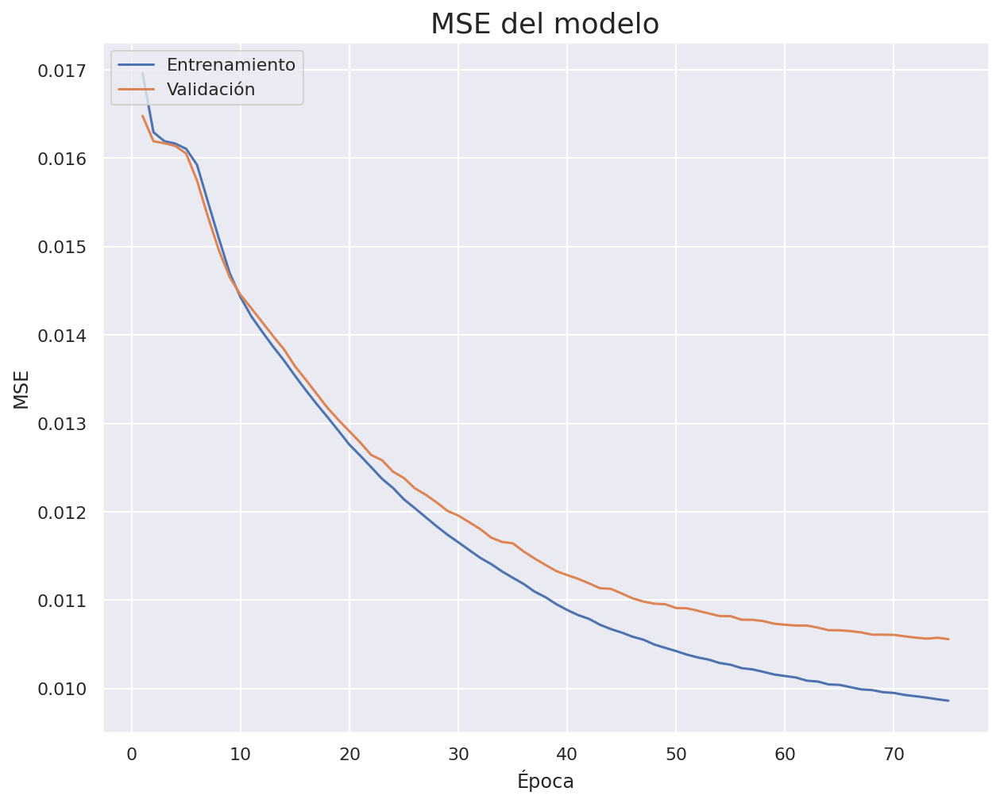

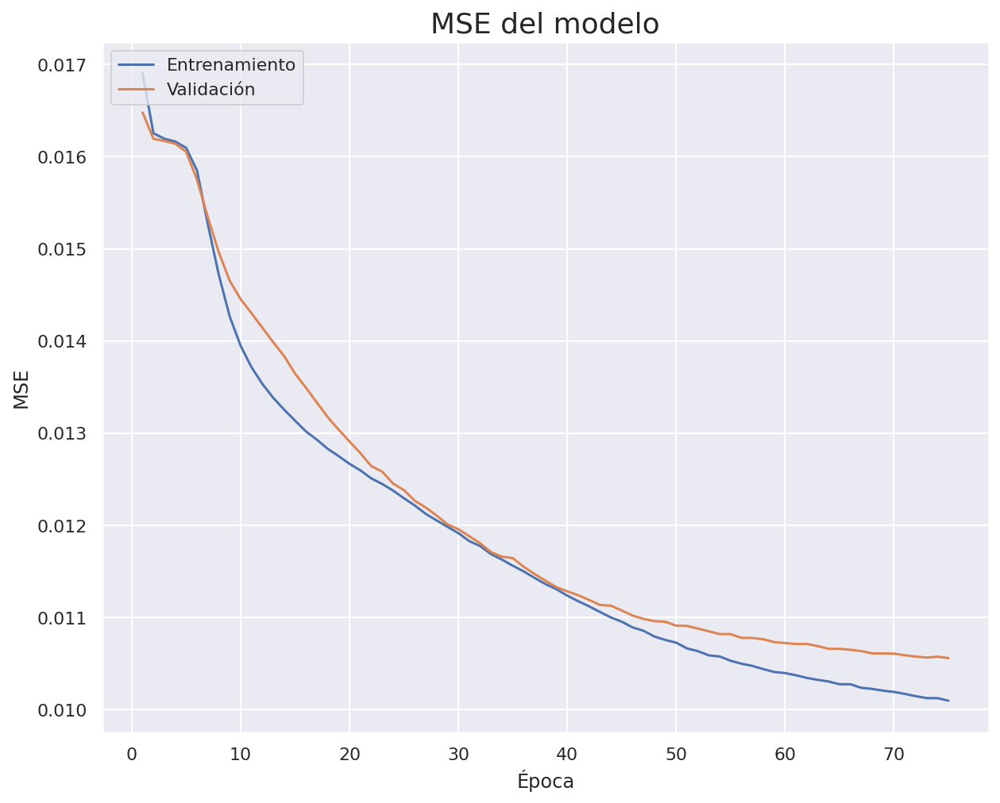

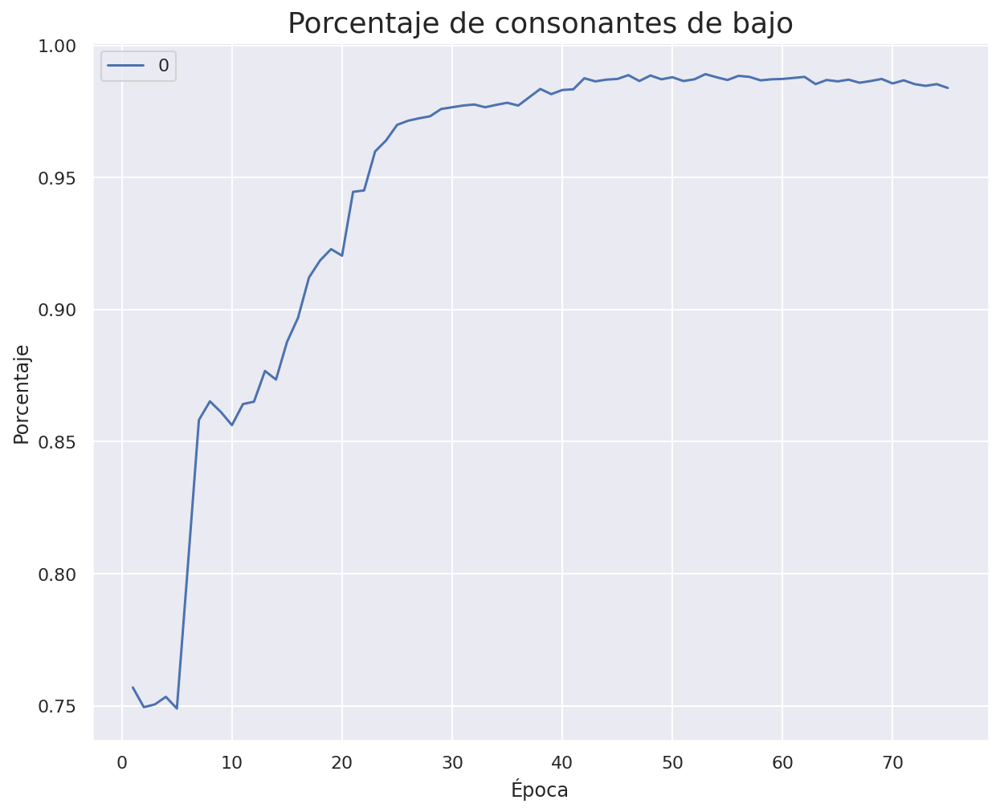

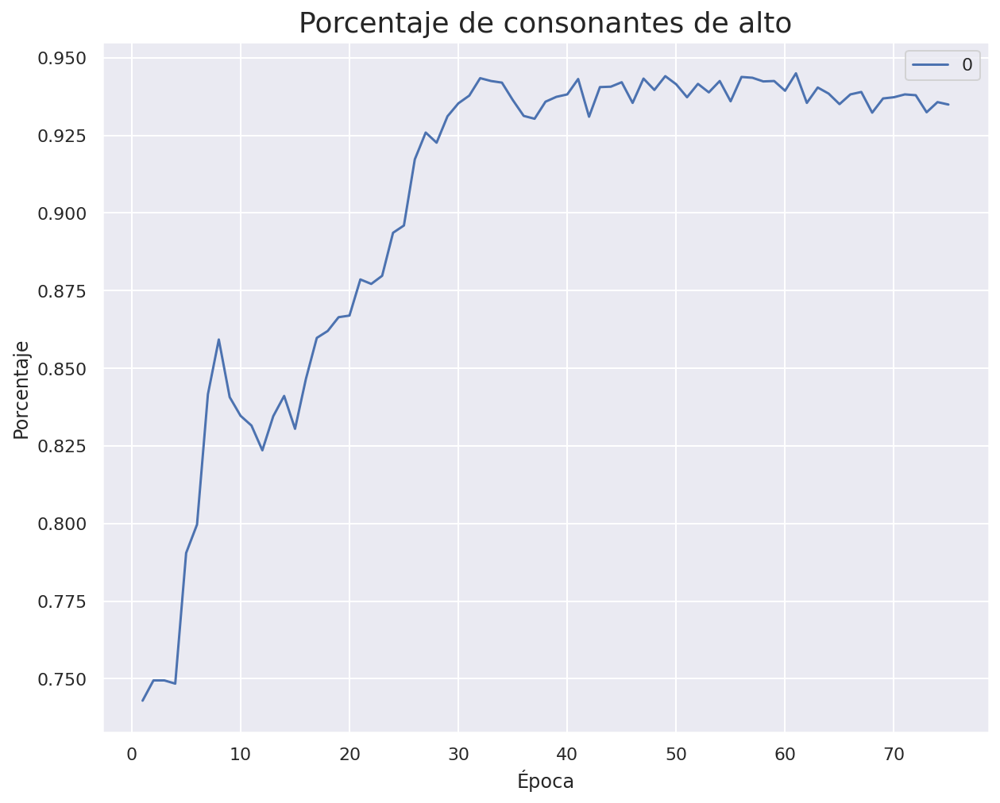

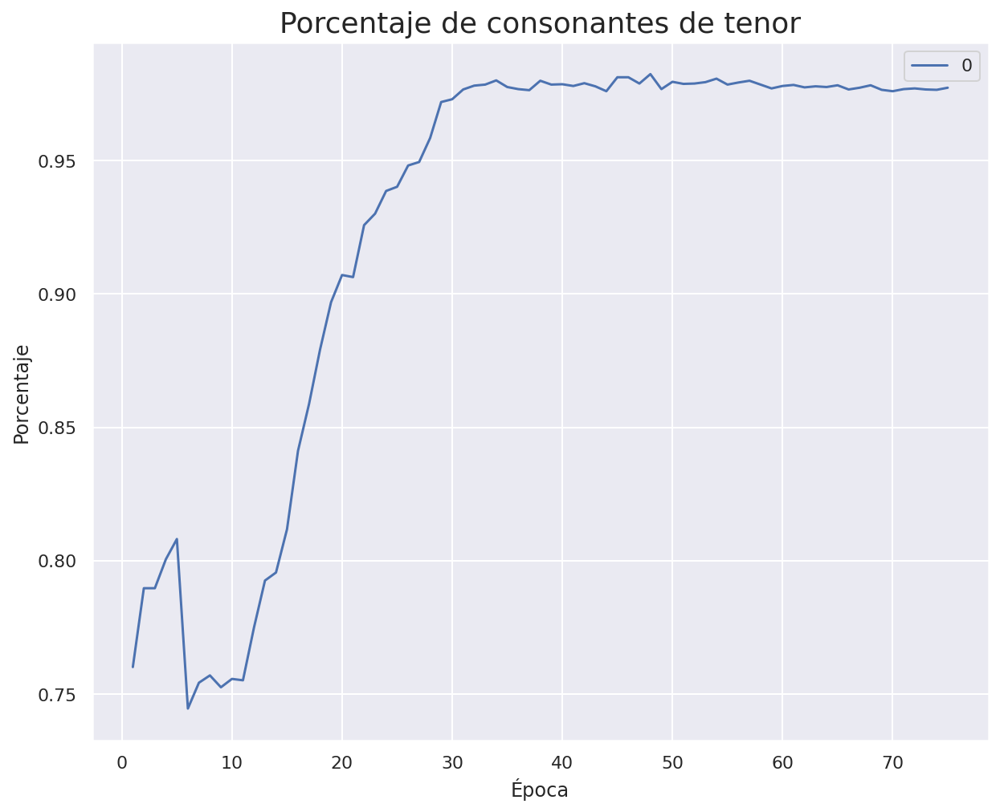

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_8 (Embedding)        (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_8 (LSTM)                  (None, 14)           2184        ['embedding_8[0][0]']            
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

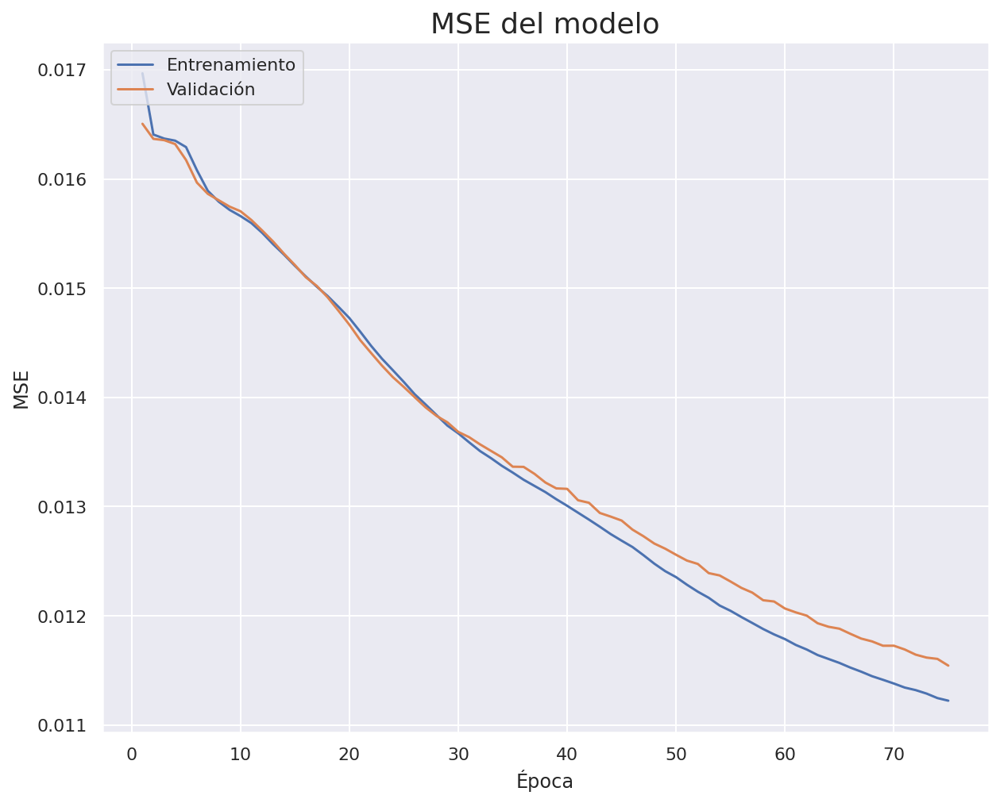

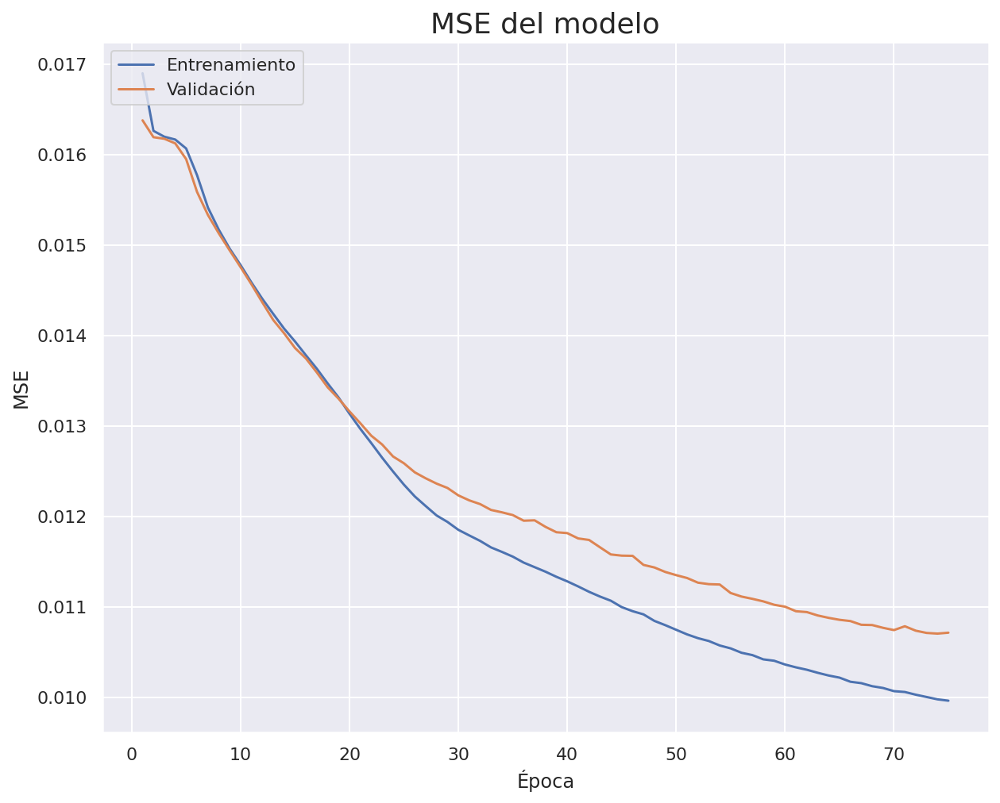

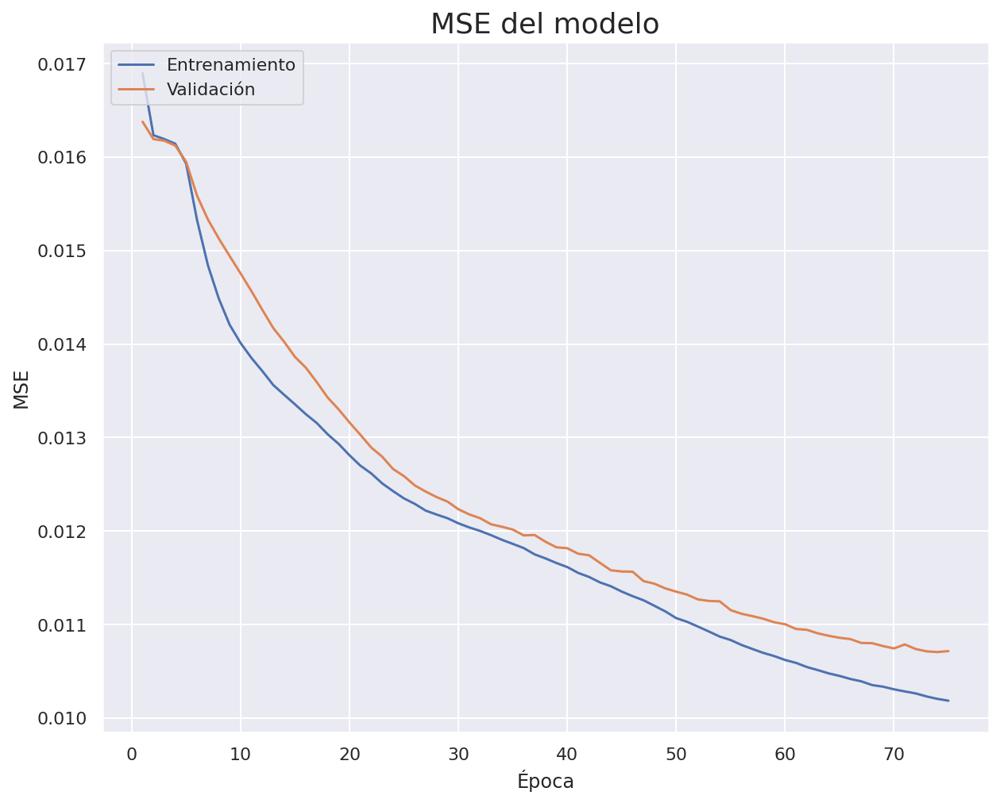

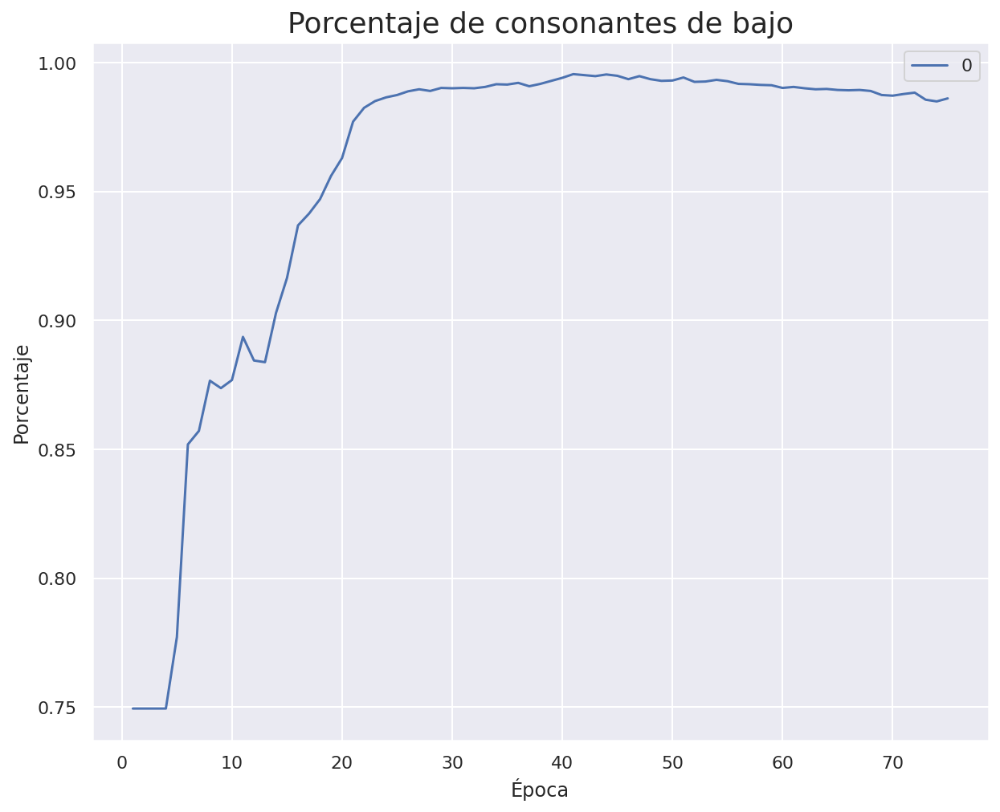

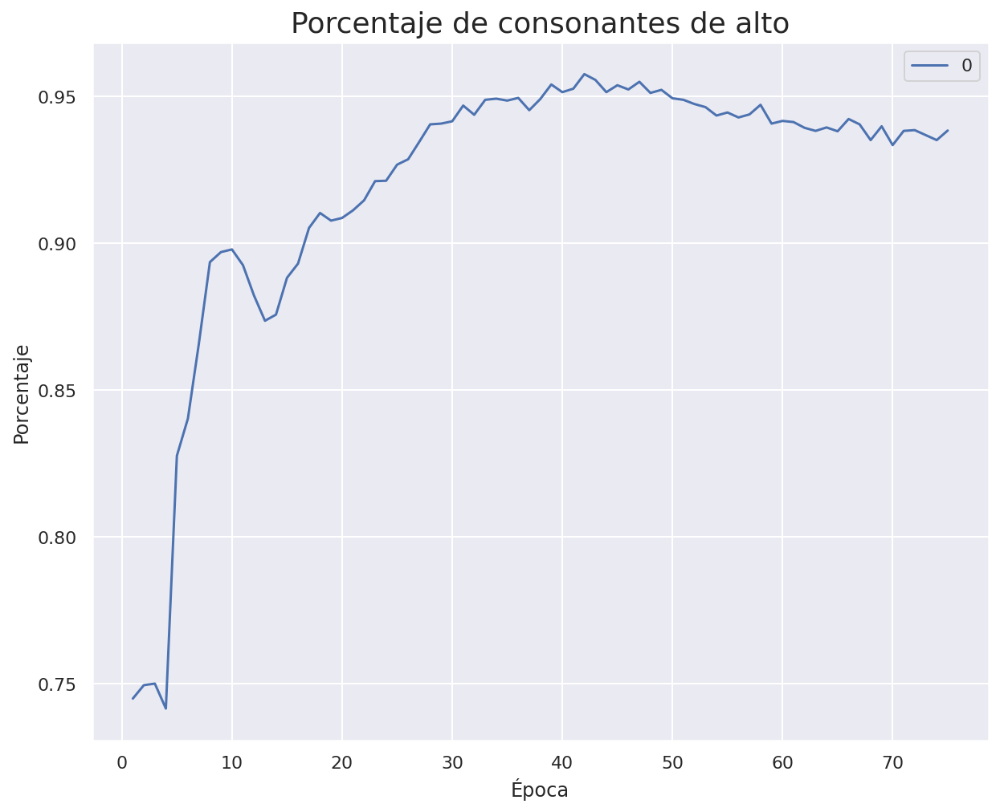

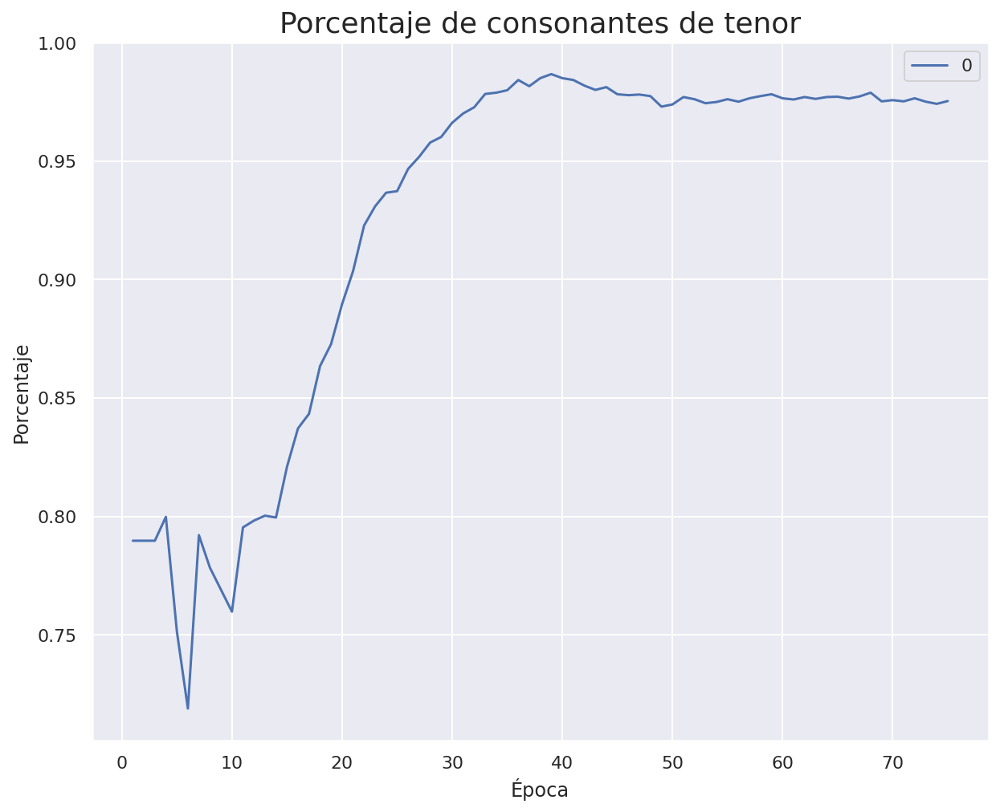

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_10 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_10 (LSTM)                 (None, 15)           2400        ['embedding_10[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

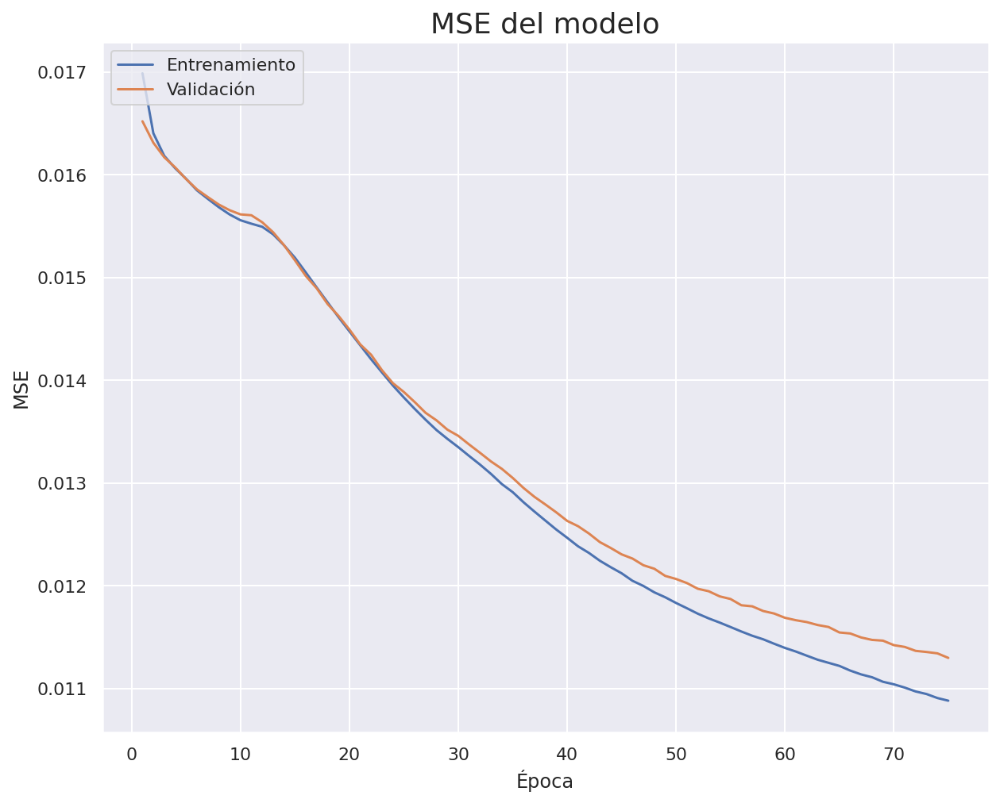

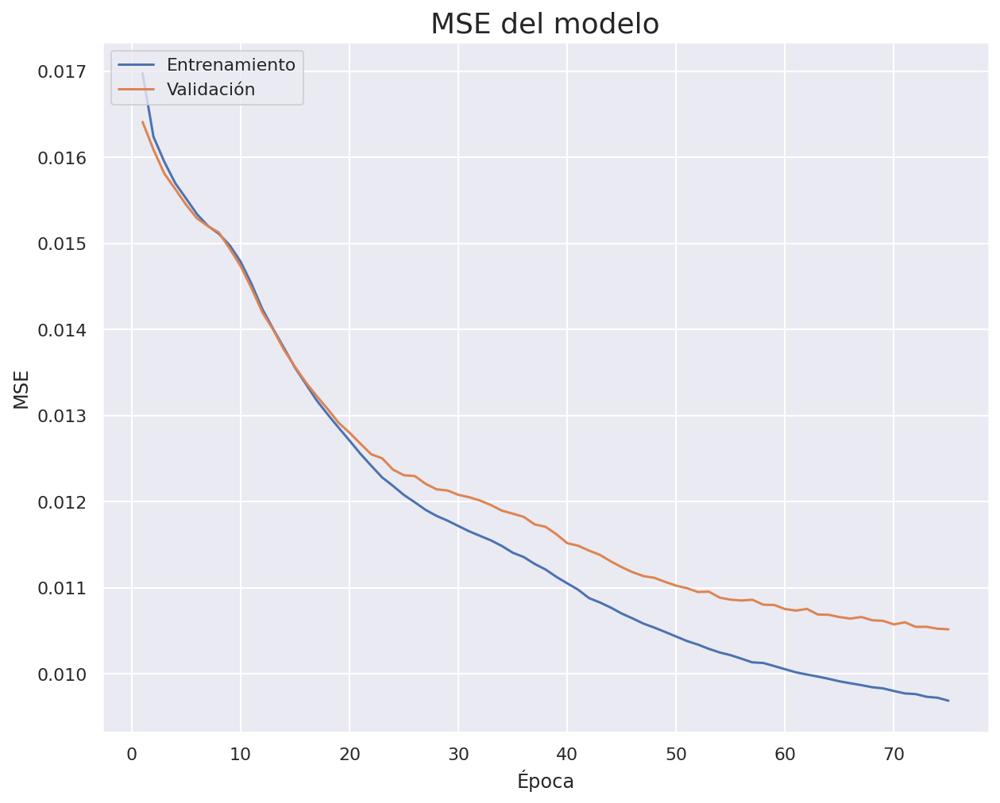

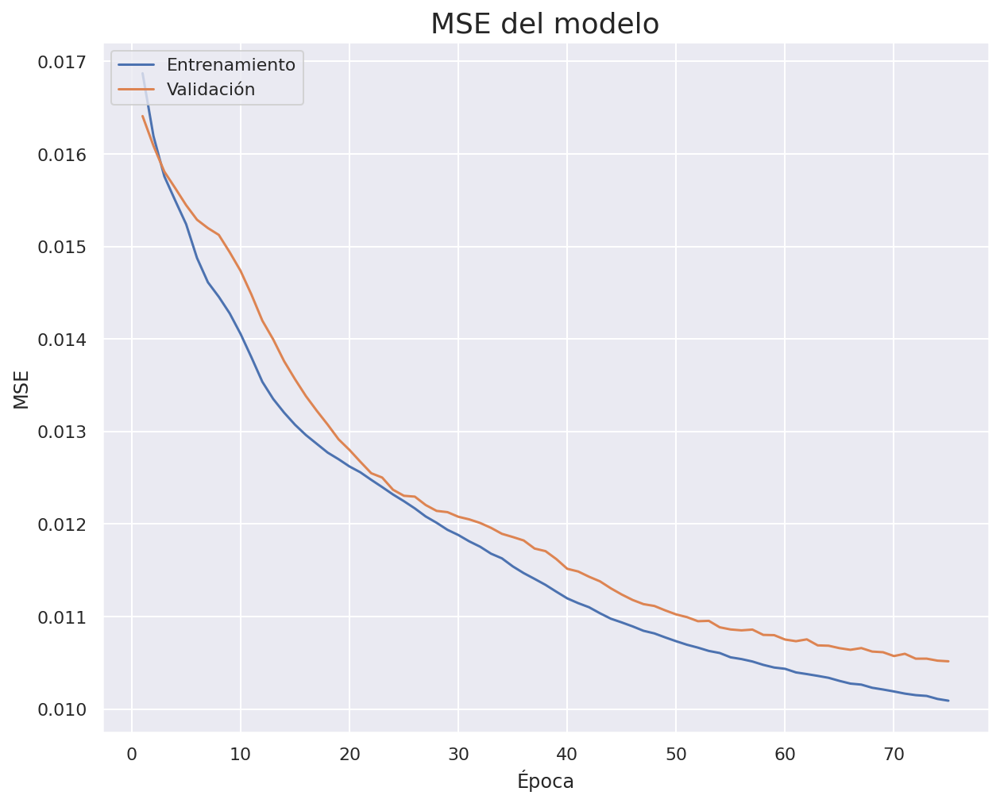

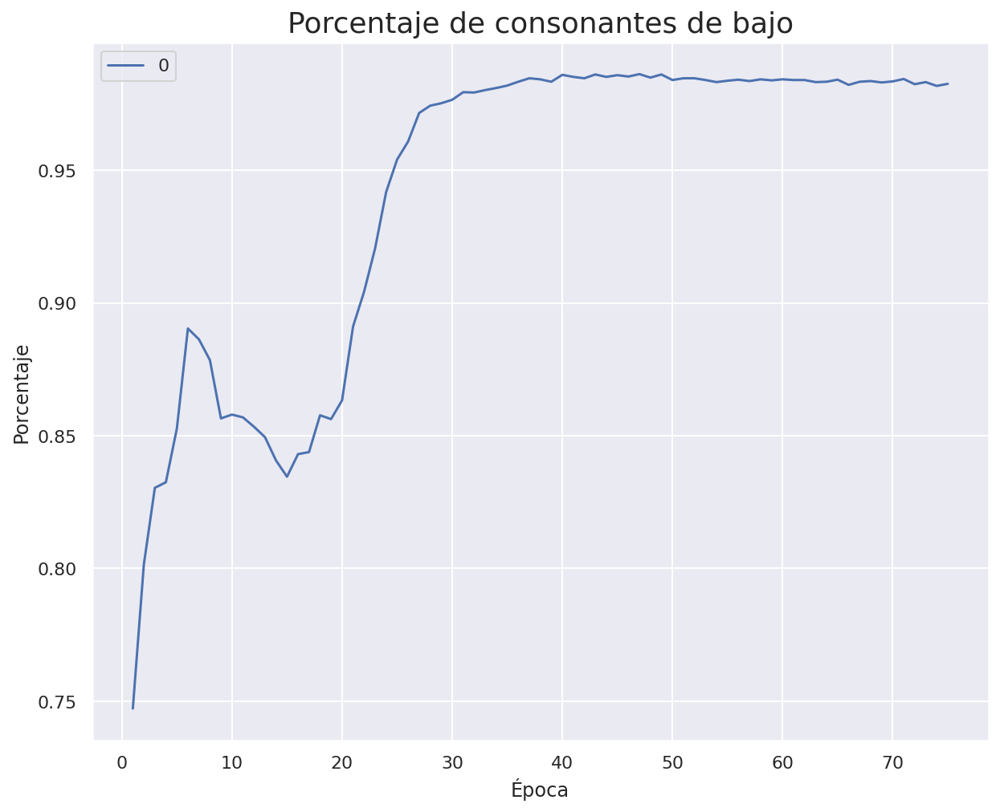

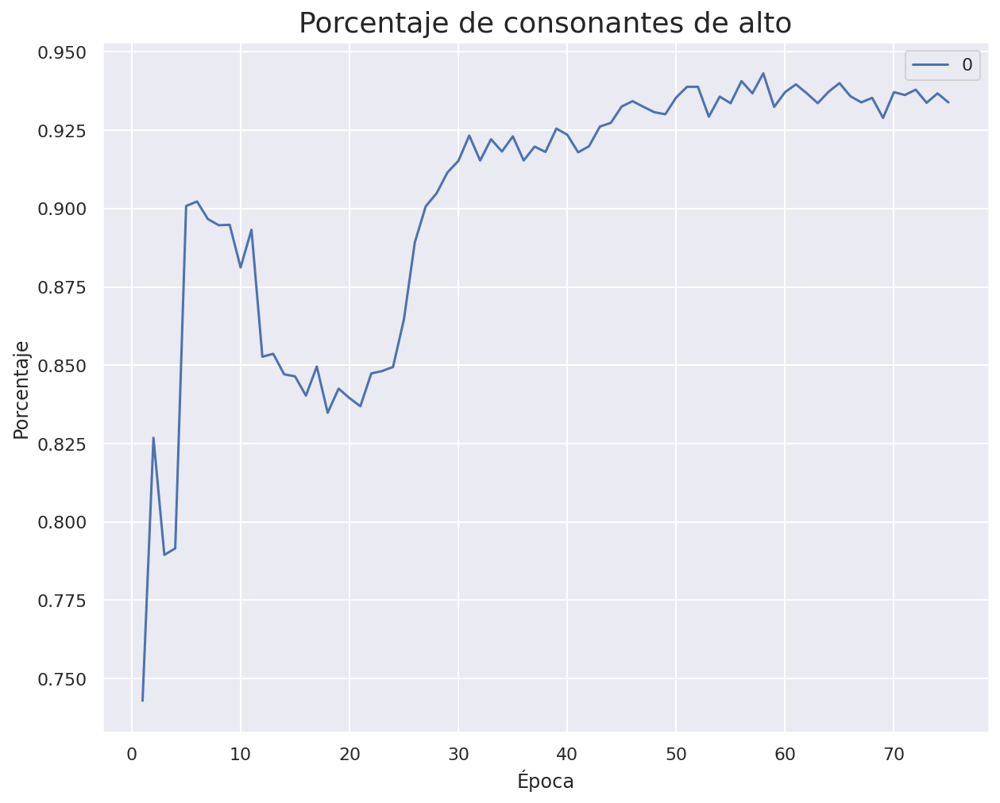

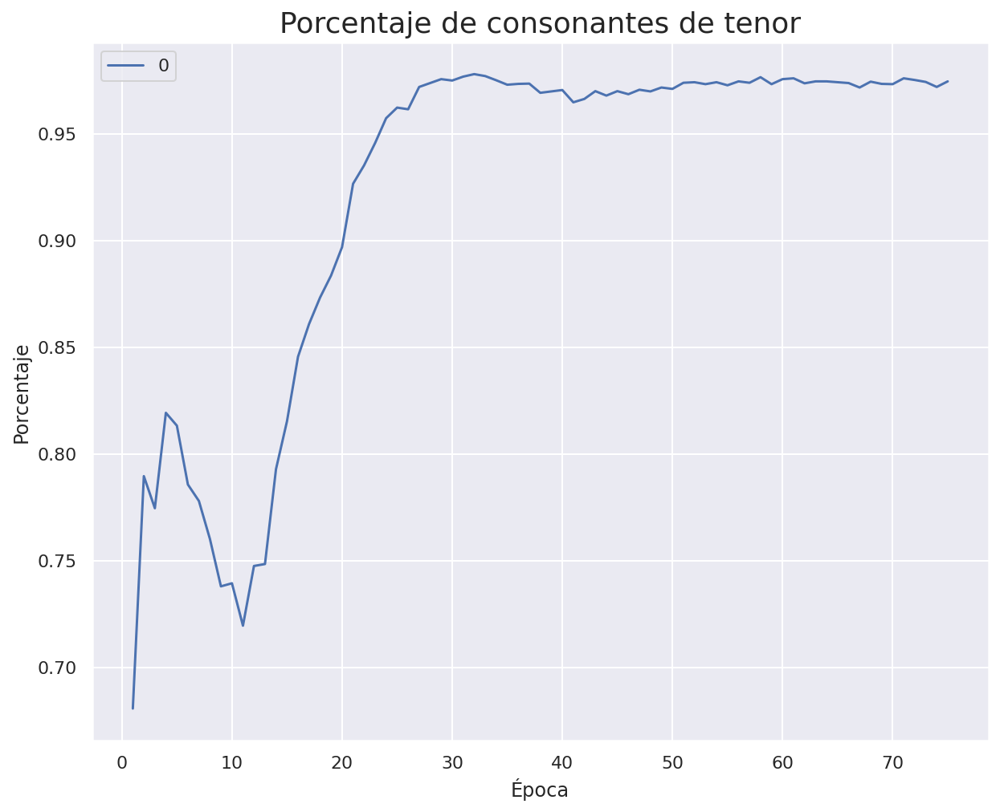

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_12 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_12 (LSTM)                 (None, 16)           2624        ['embedding_12[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

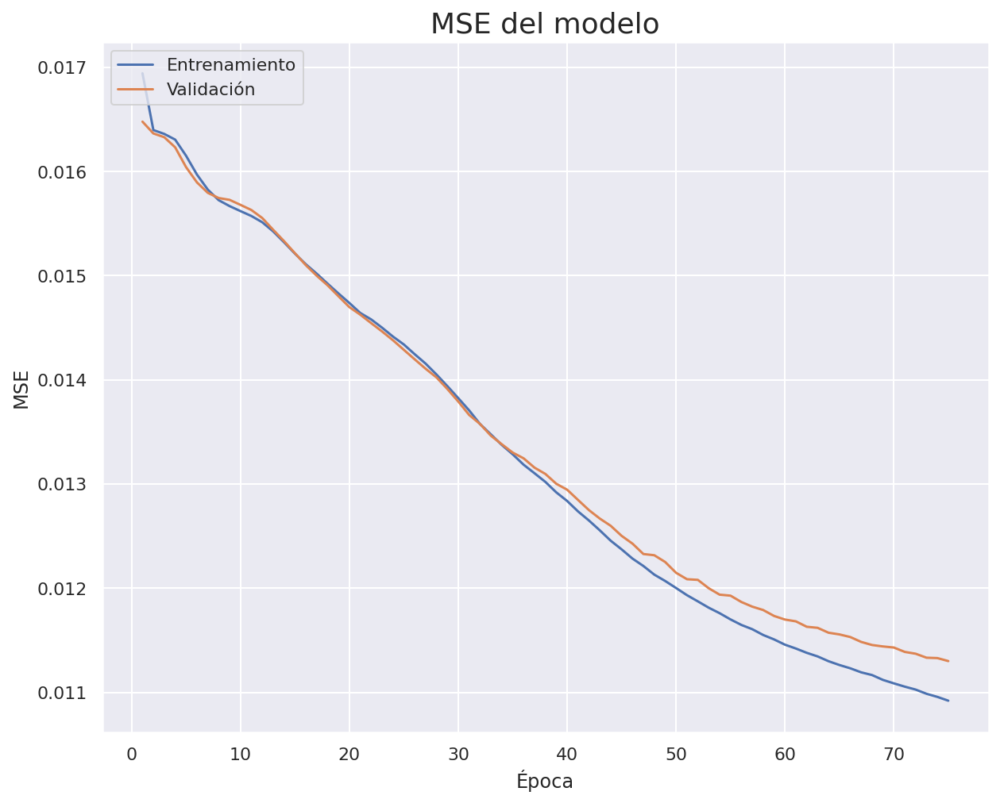

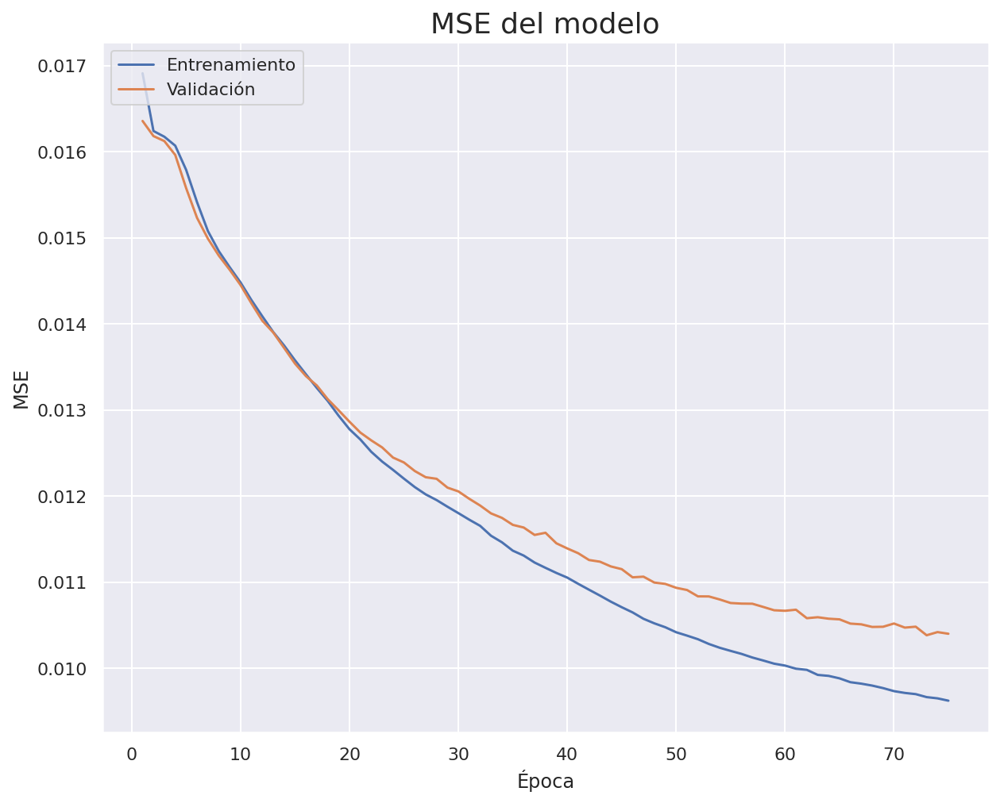

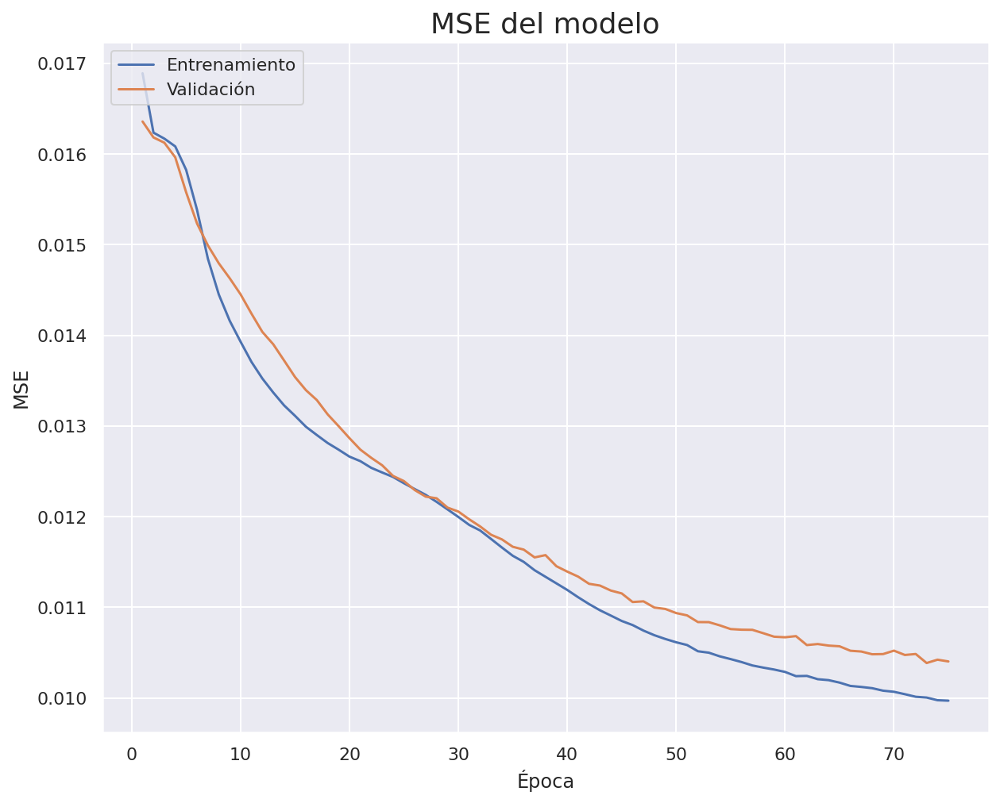

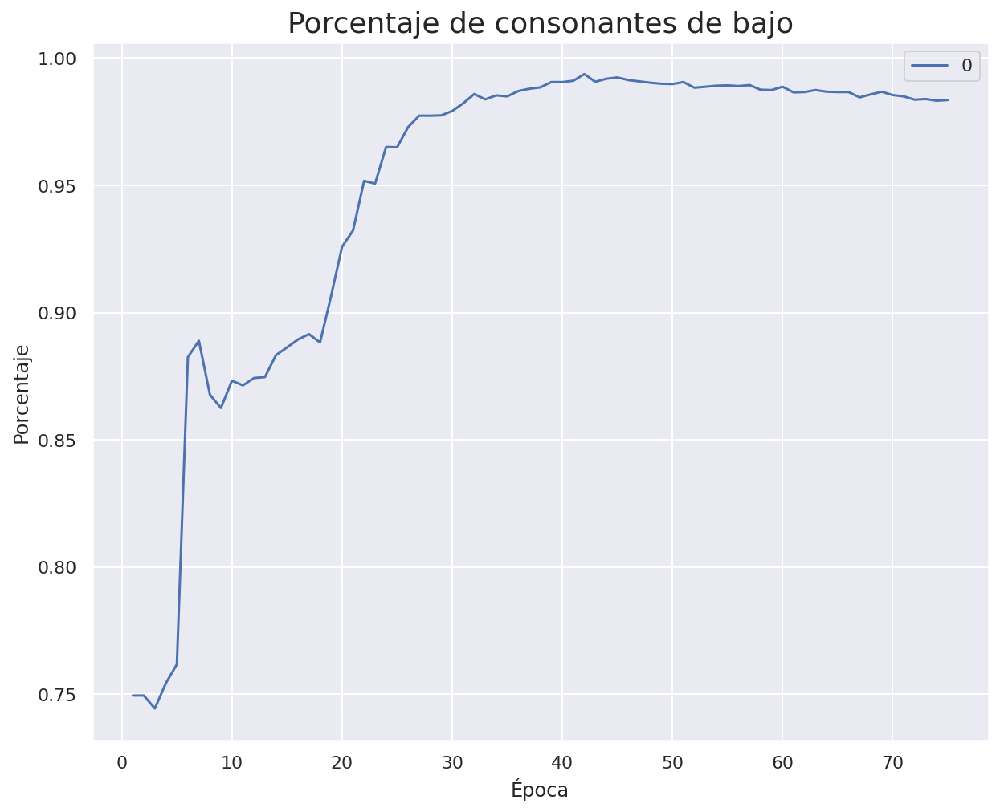

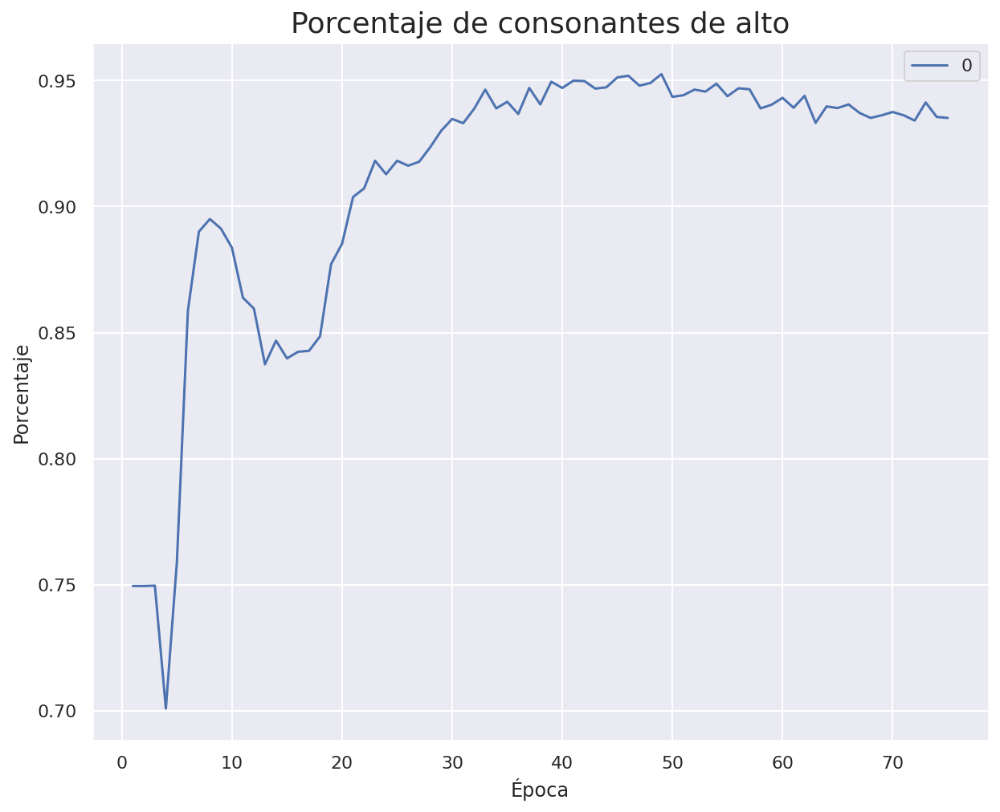

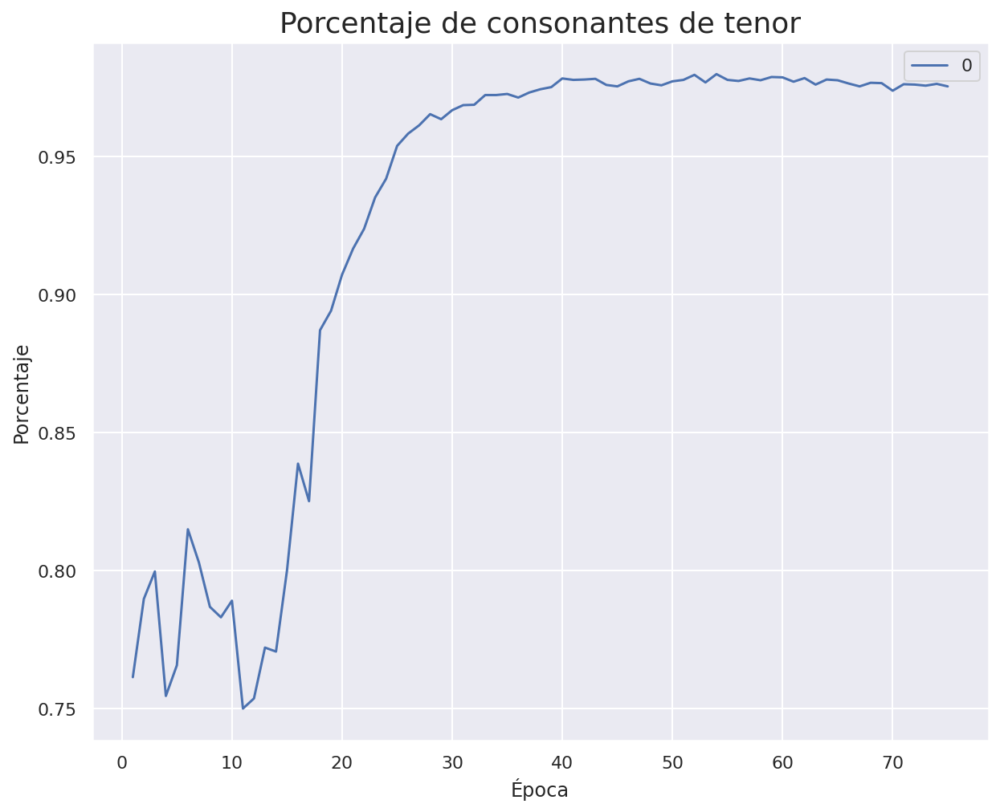

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_14 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_14 (LSTM)                 (None, 17)           2856        ['embedding_14[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

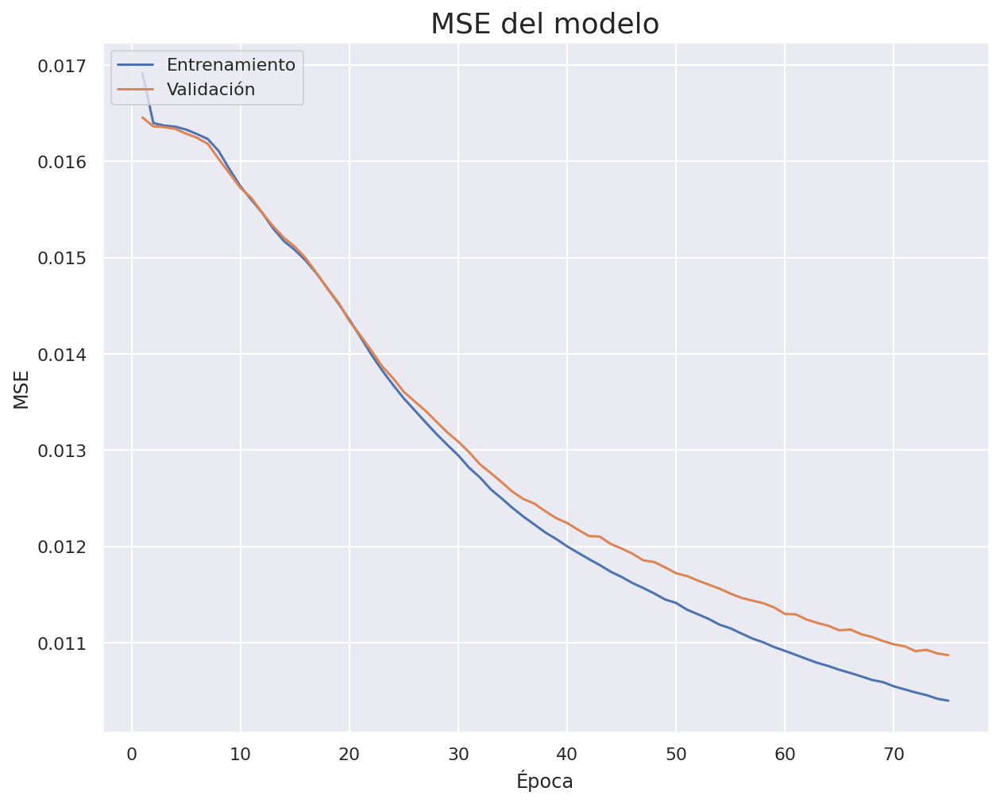

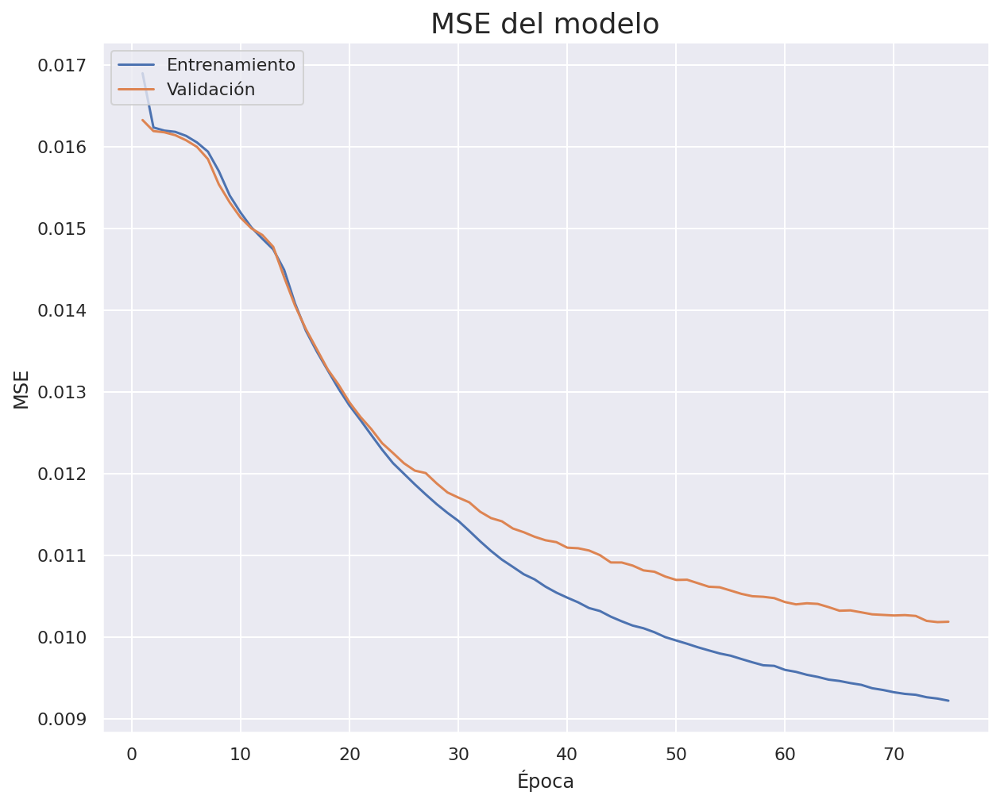

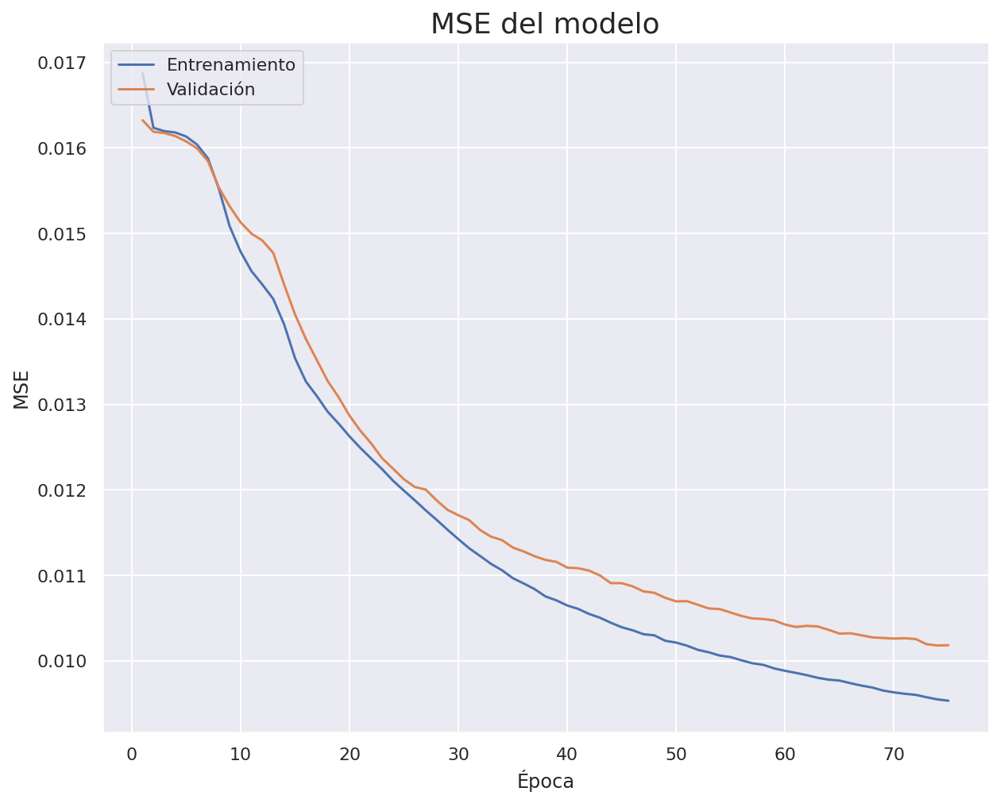

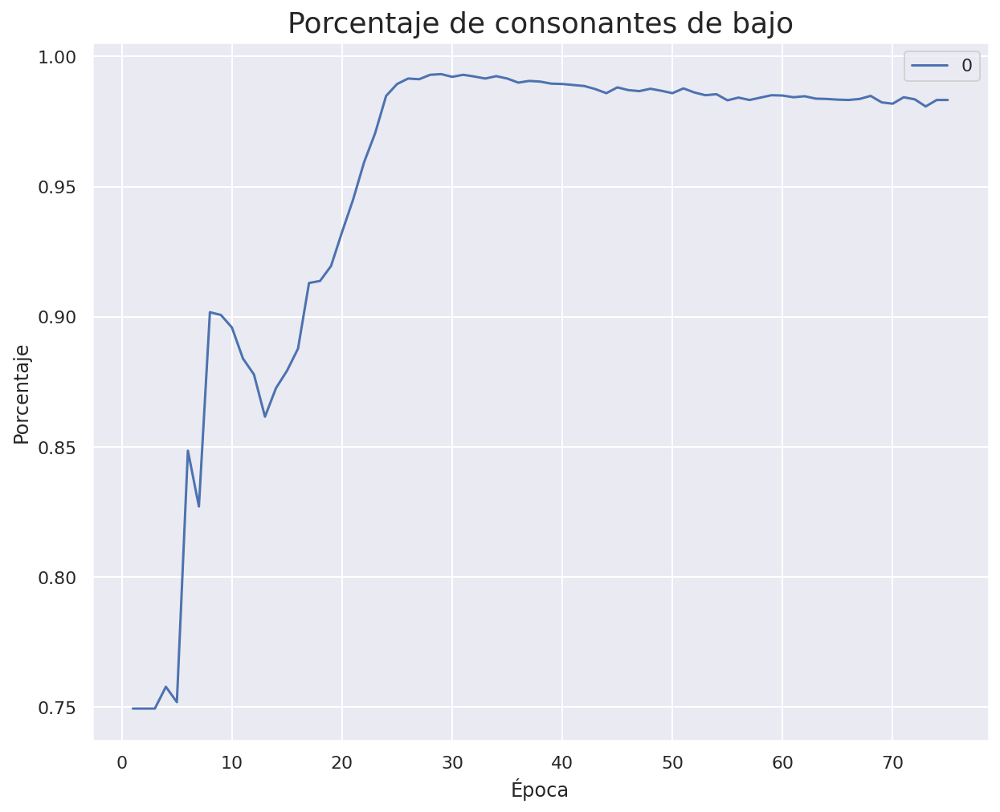

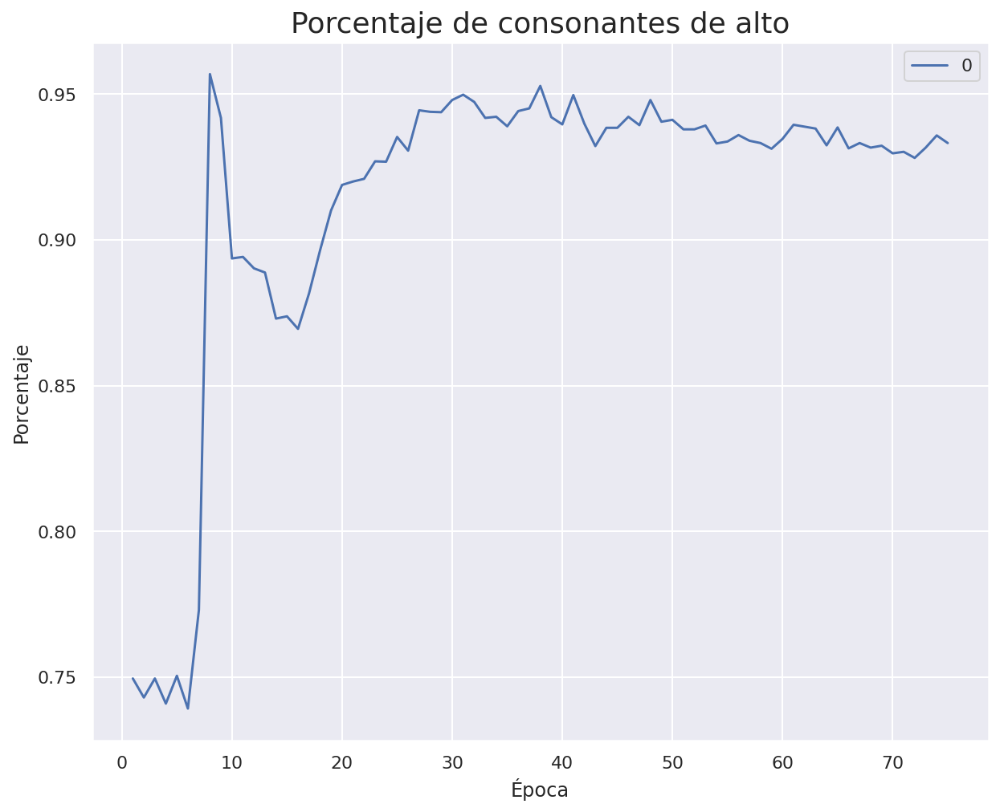

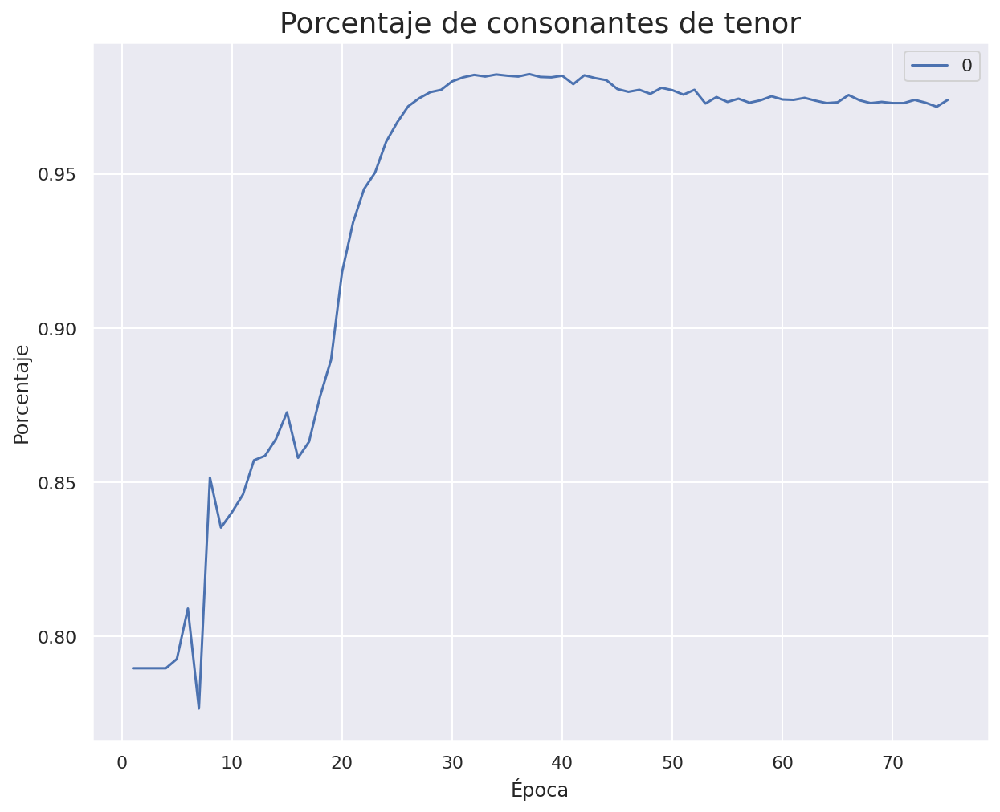

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_16 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_16 (LSTM)                 (None, 18)           3096        ['embedding_16[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

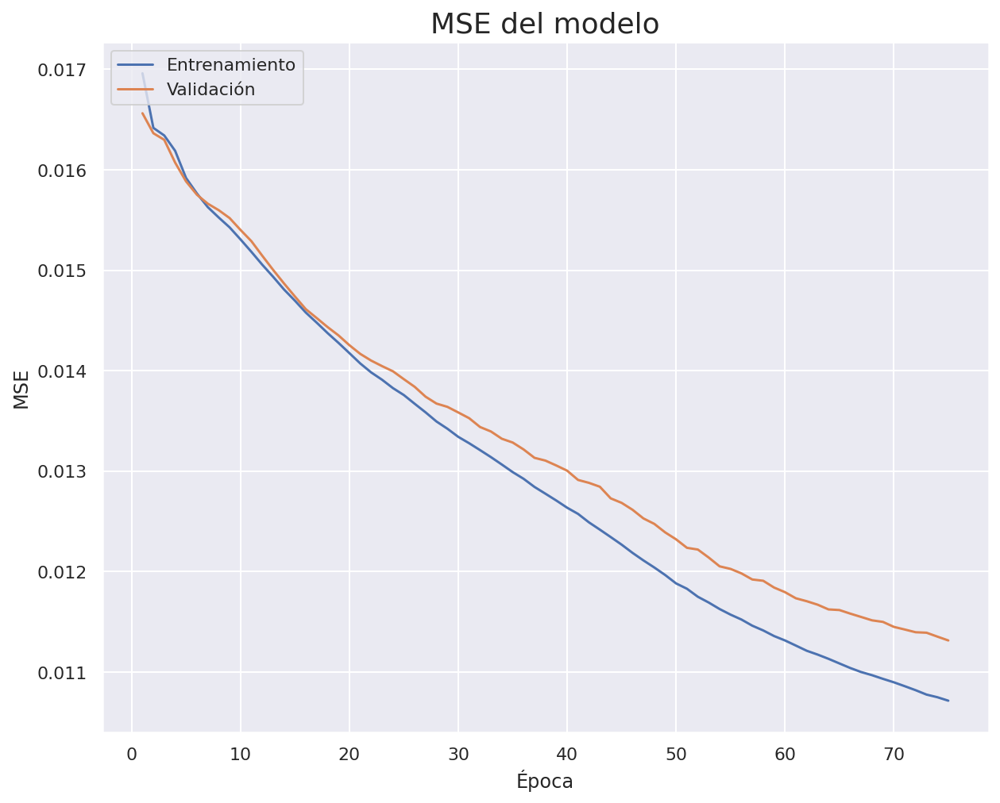

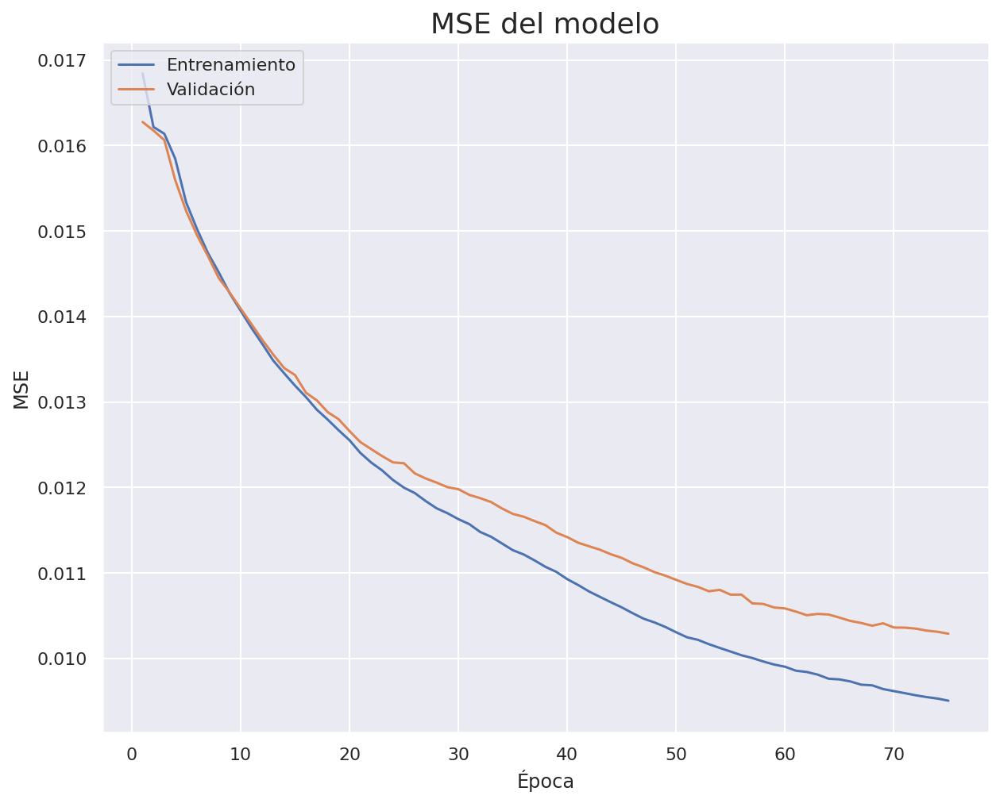

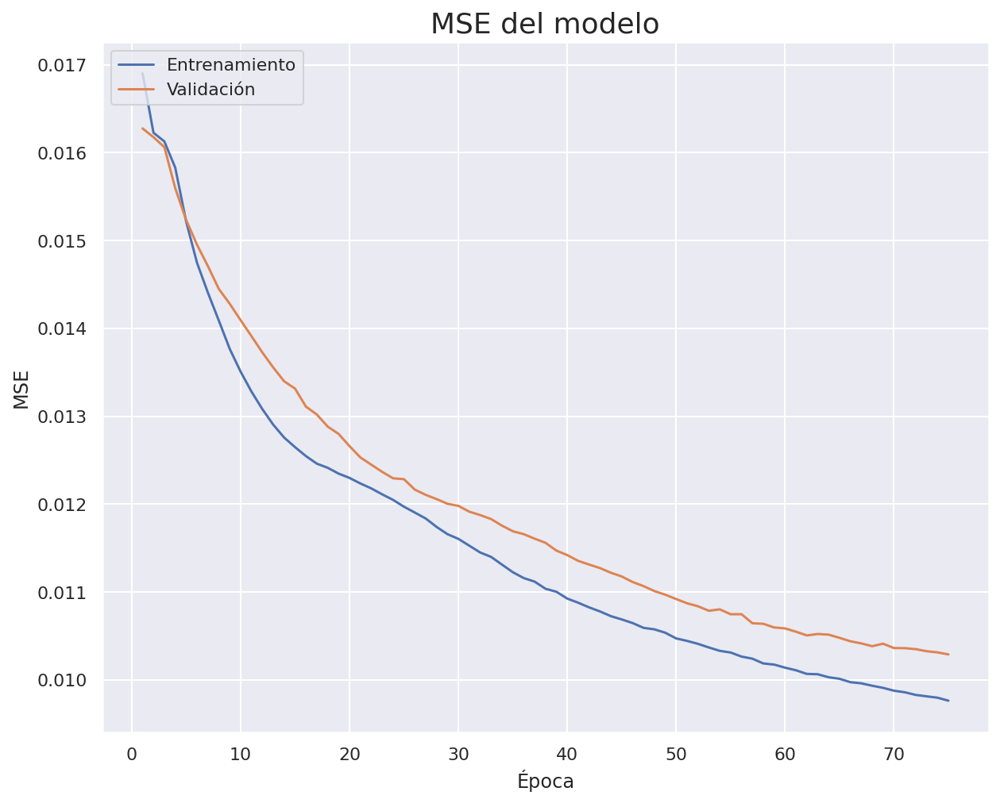

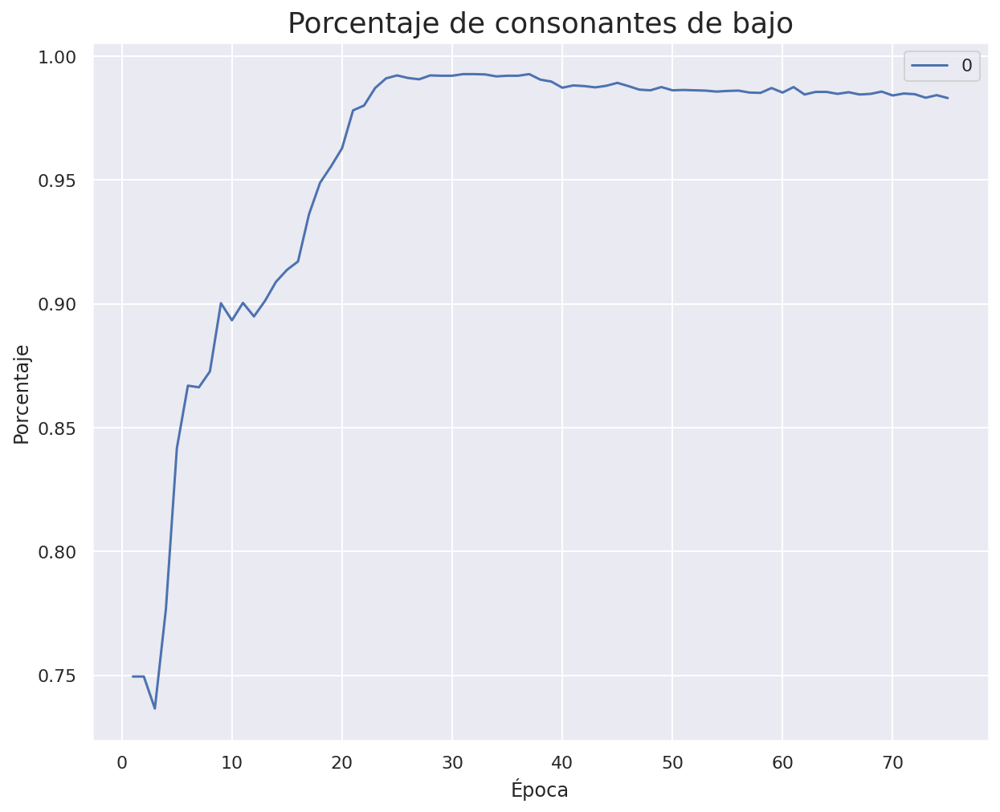

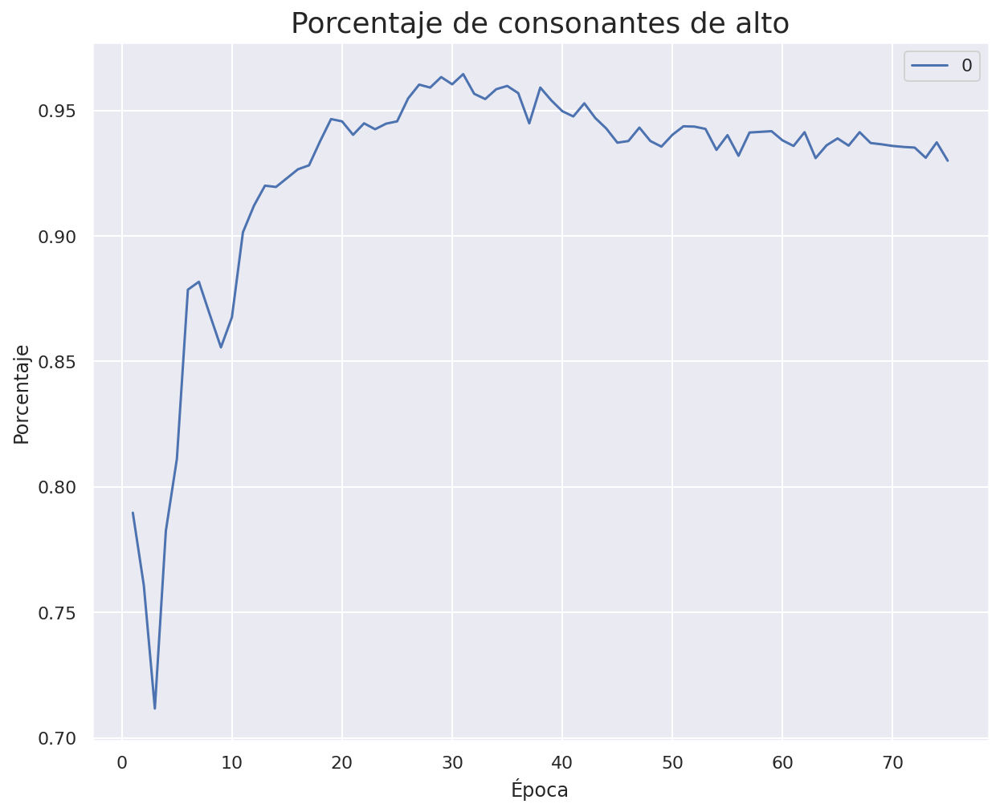

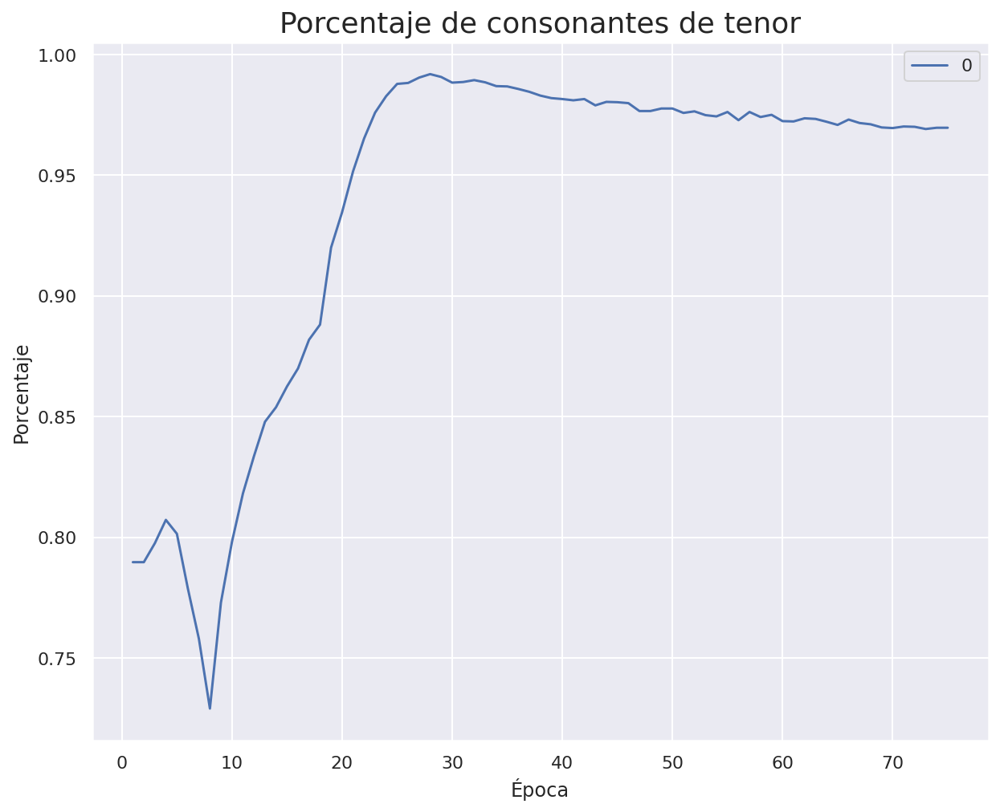

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_18 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_18 (LSTM)                 (None, 19)           3344        ['embedding_18[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

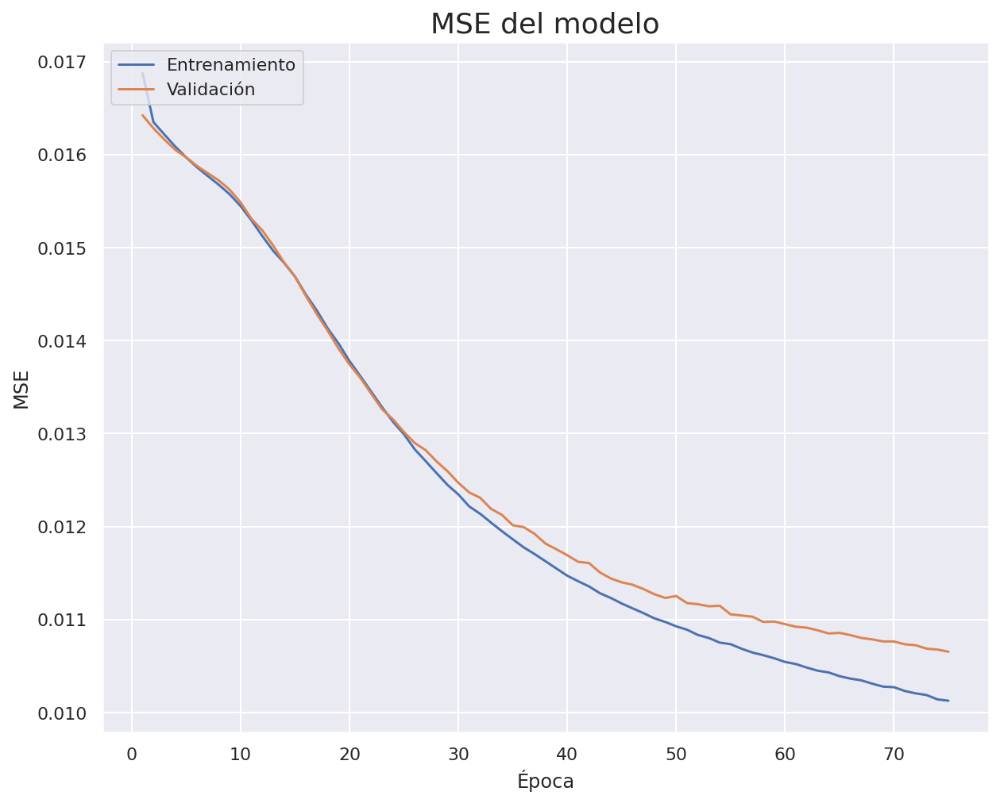

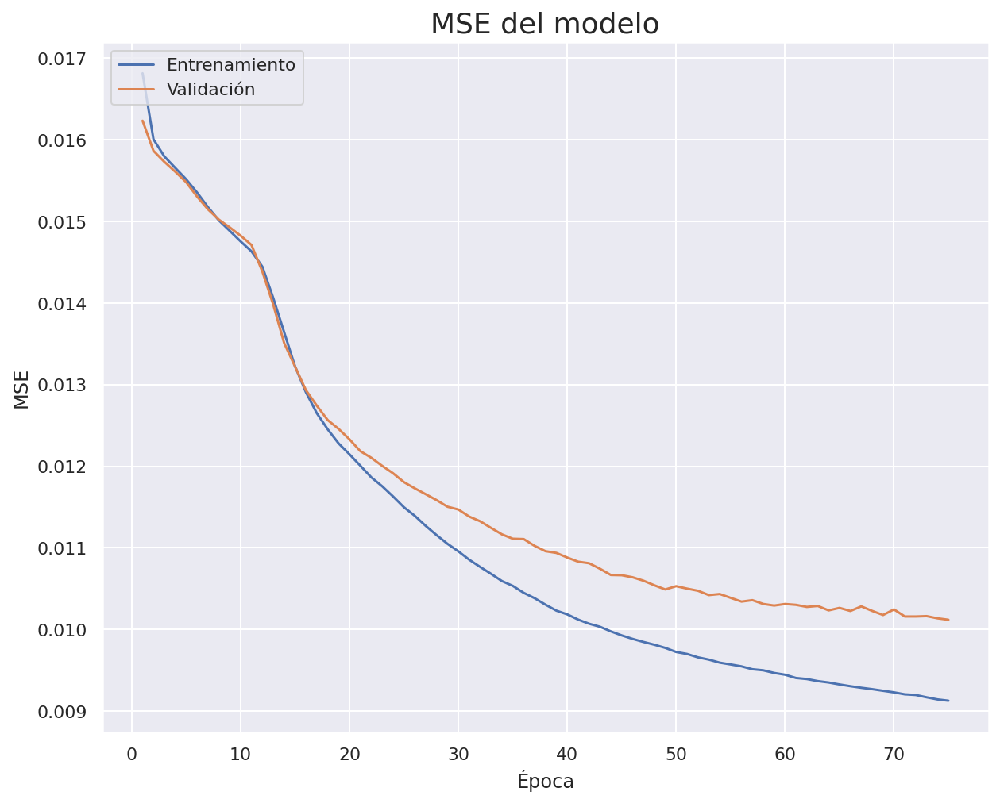

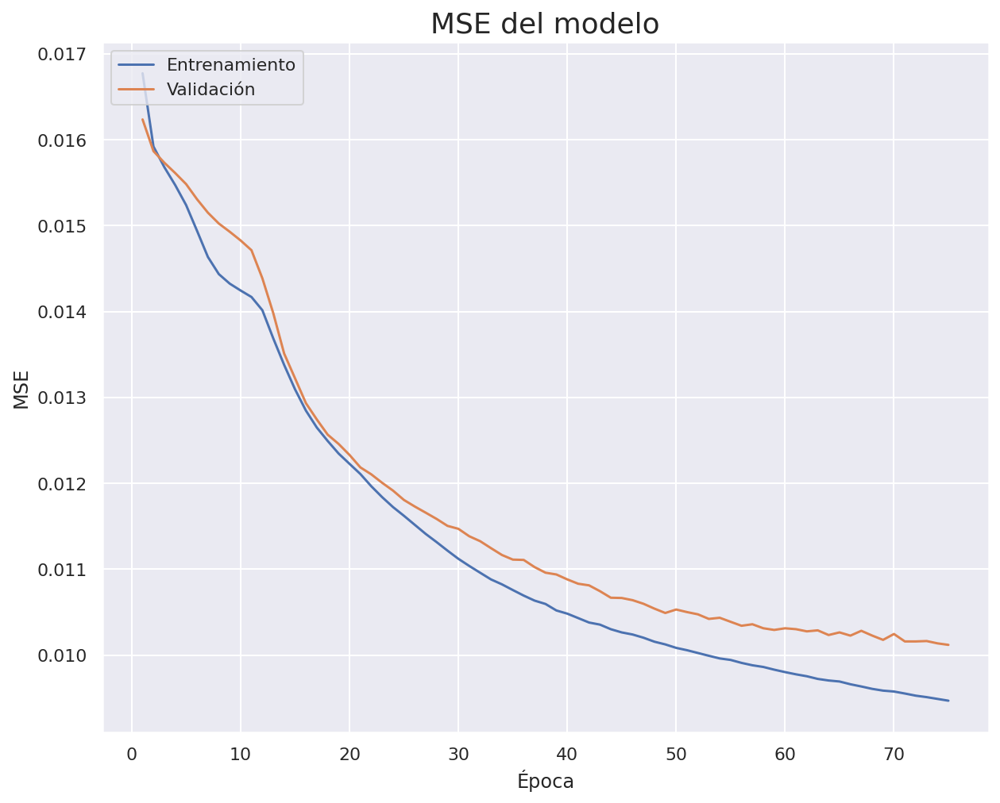

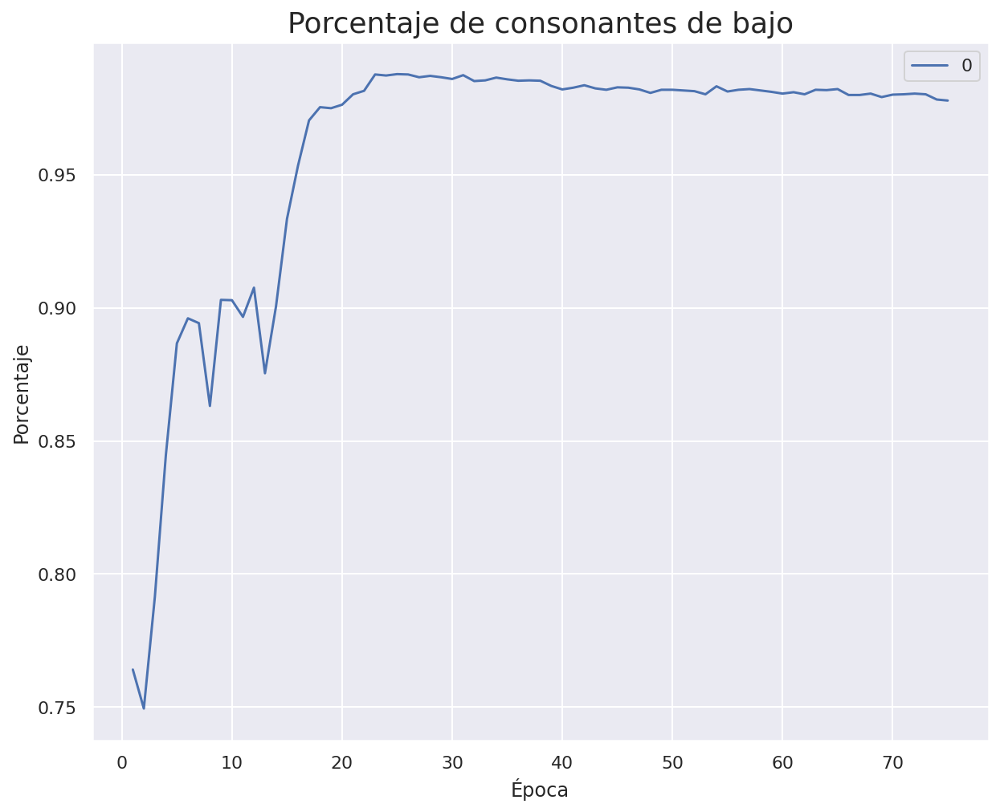

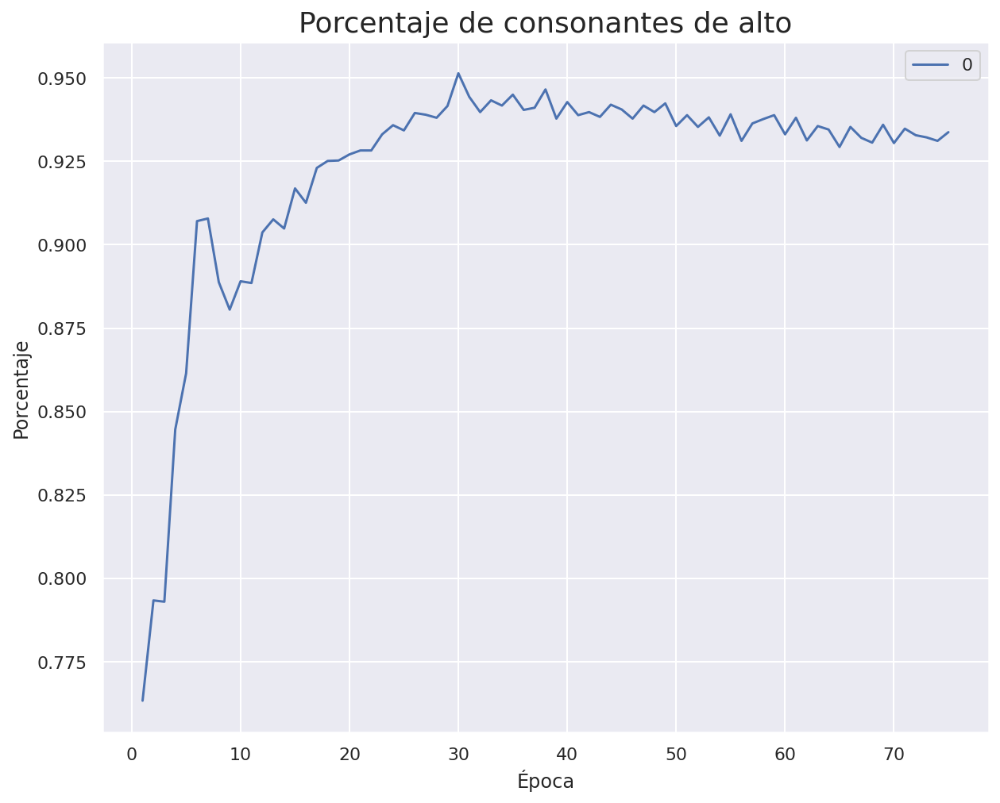

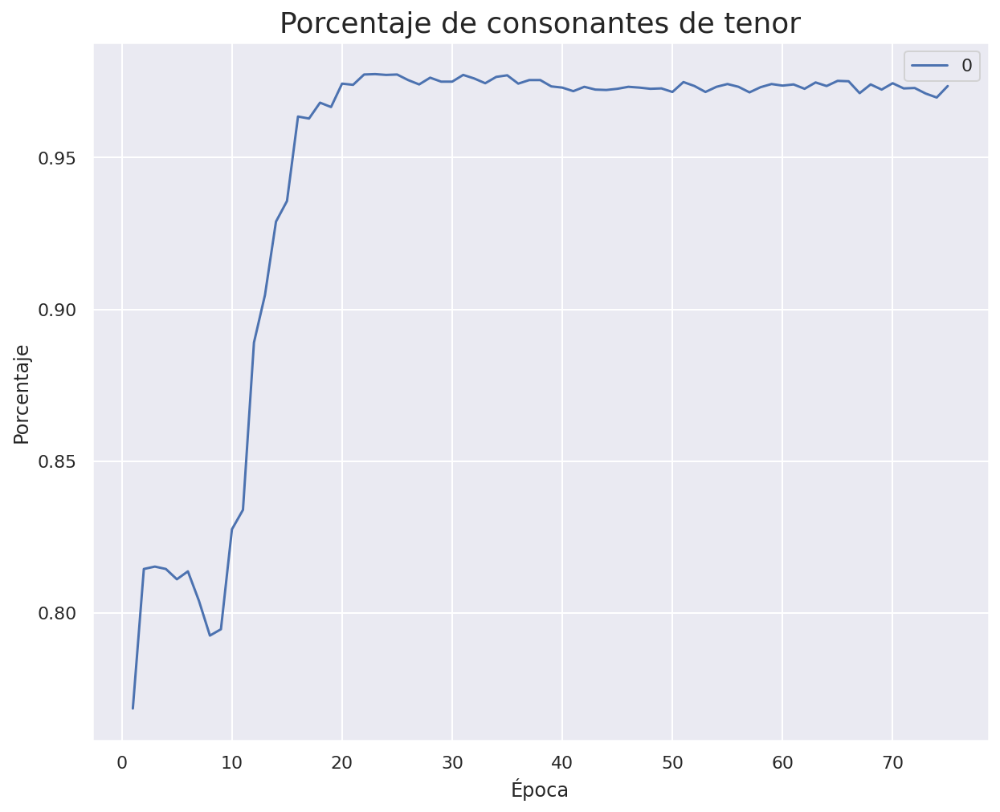

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_20 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_20 (LSTM)                 (None, 20)           3600        ['embedding_20[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

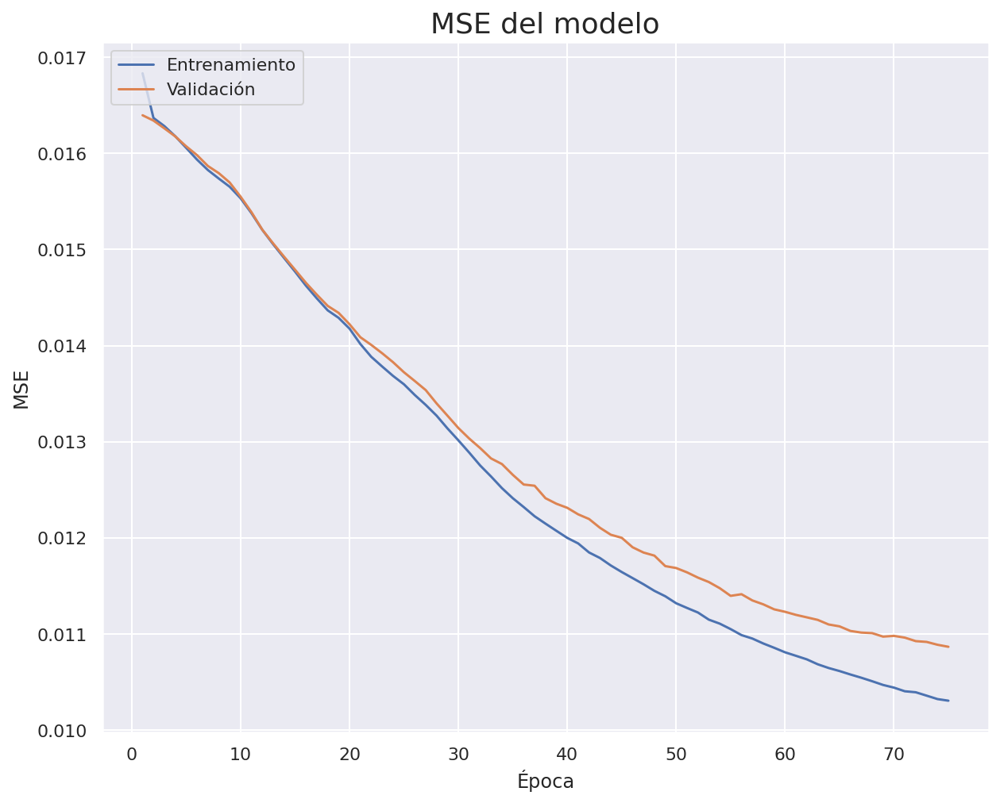

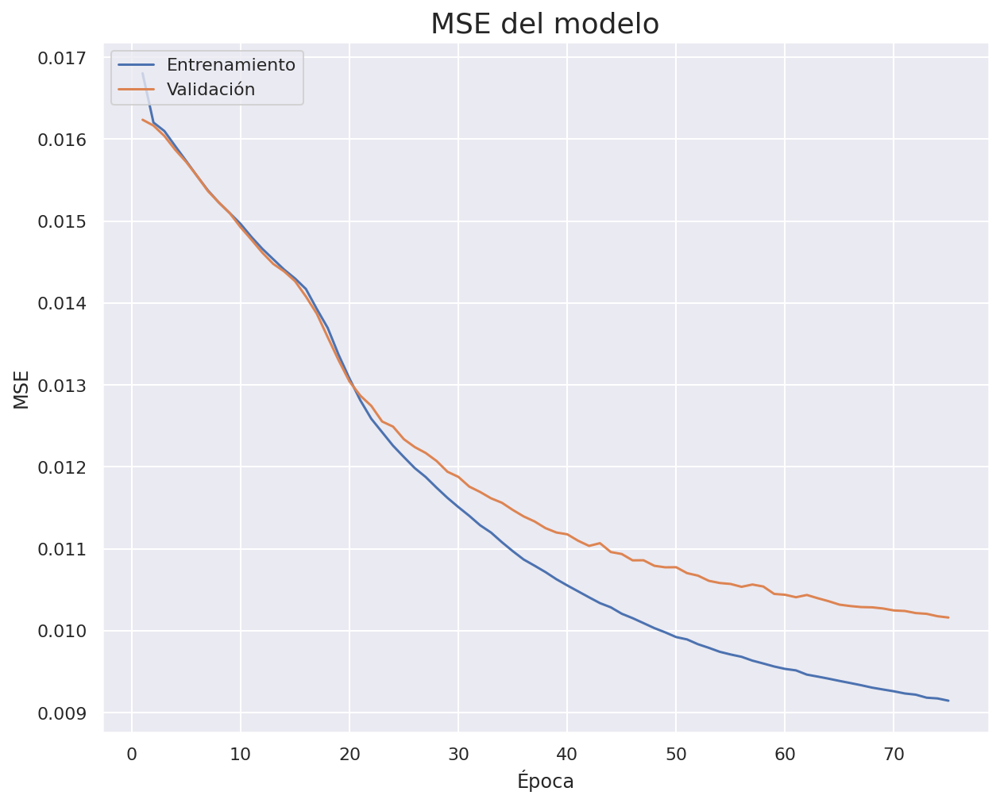

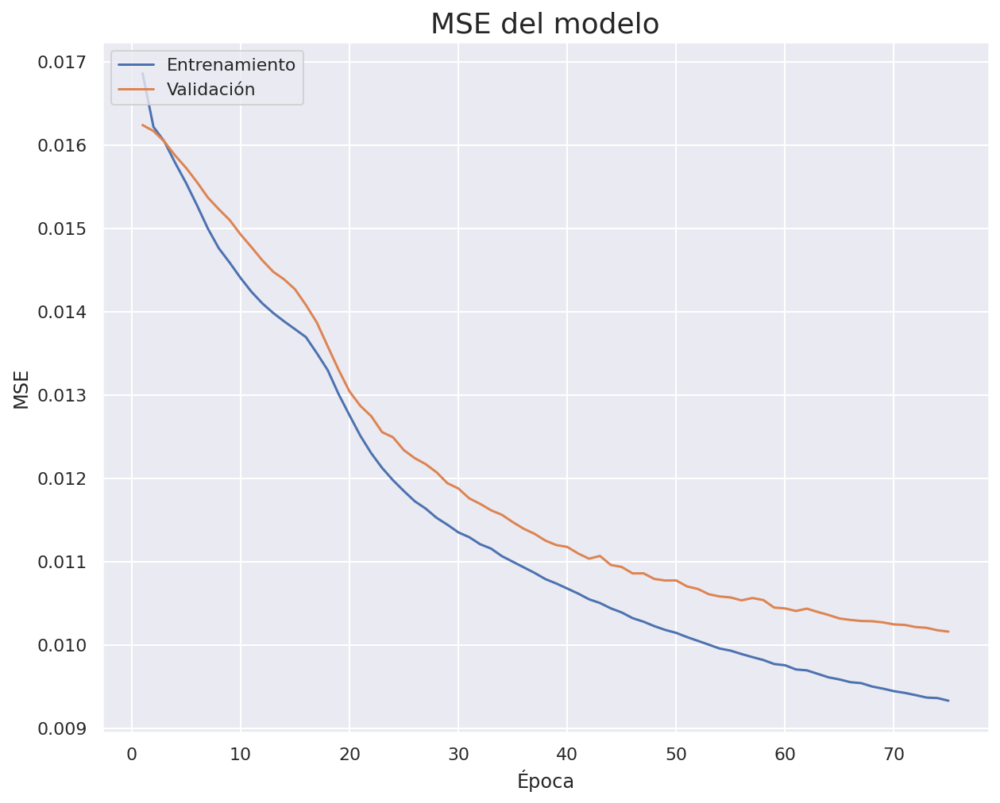

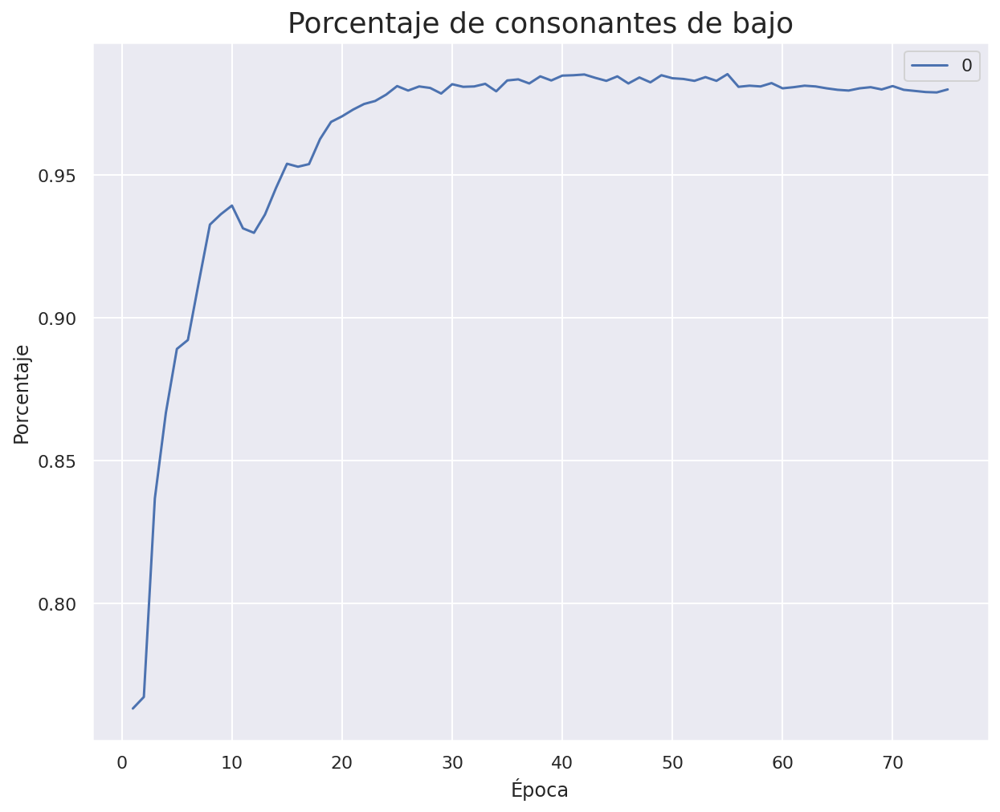

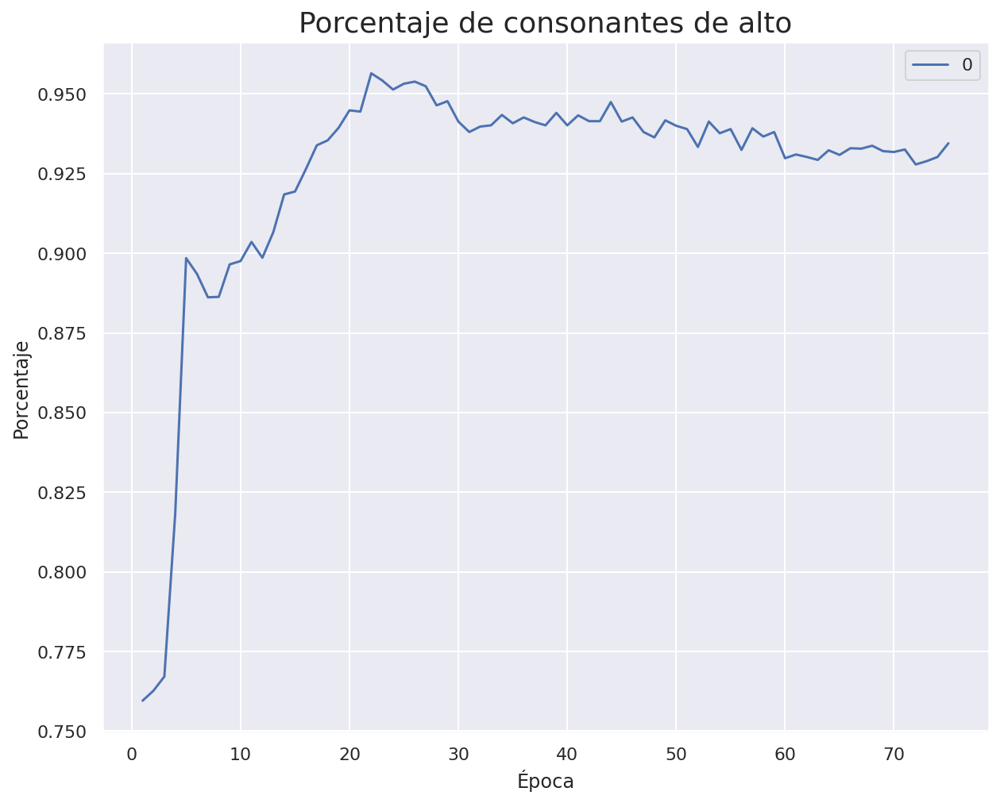

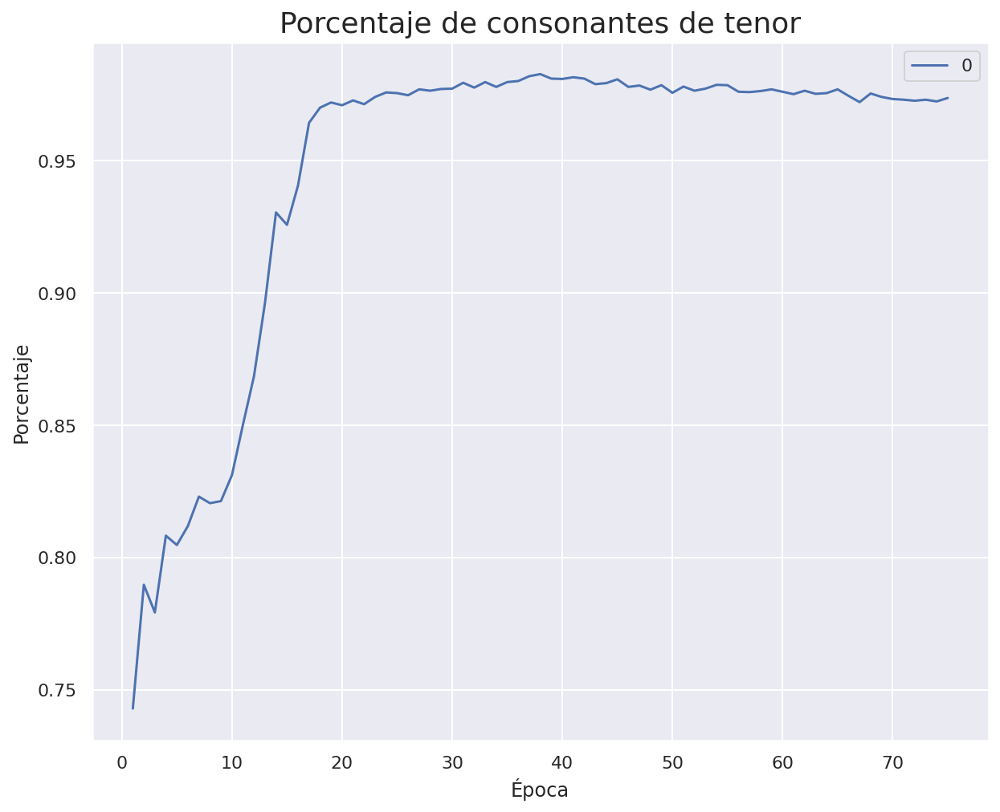

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_22 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_22 (LSTM)                 (None, 21)           3864        ['embedding_22[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

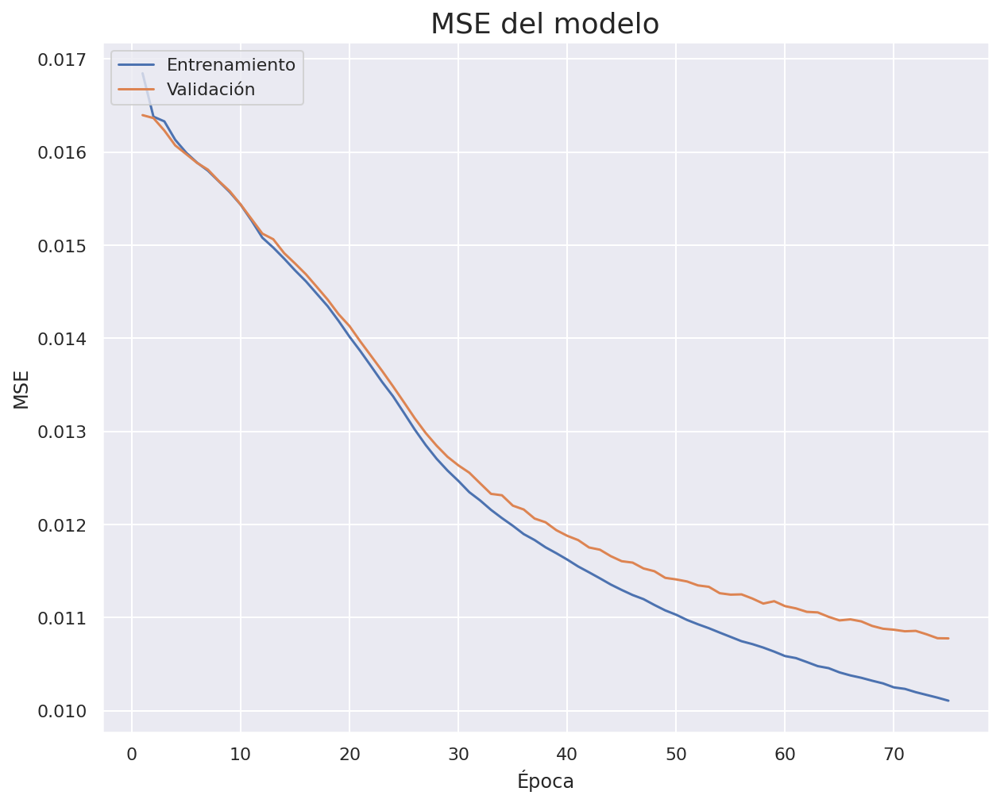

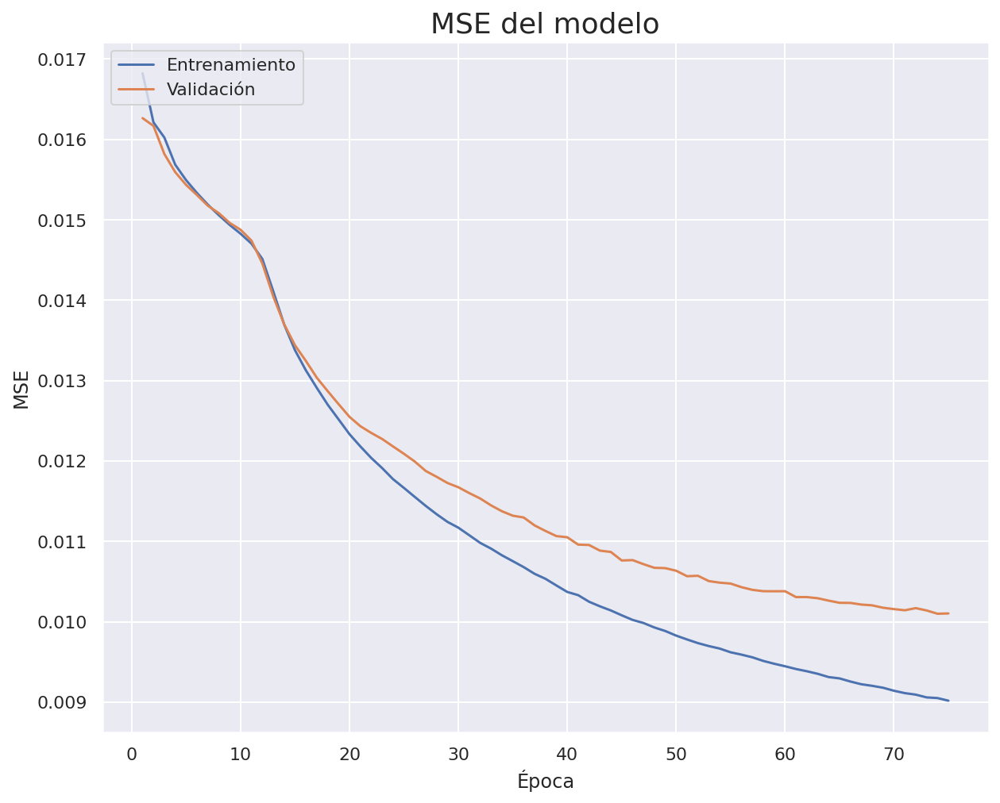

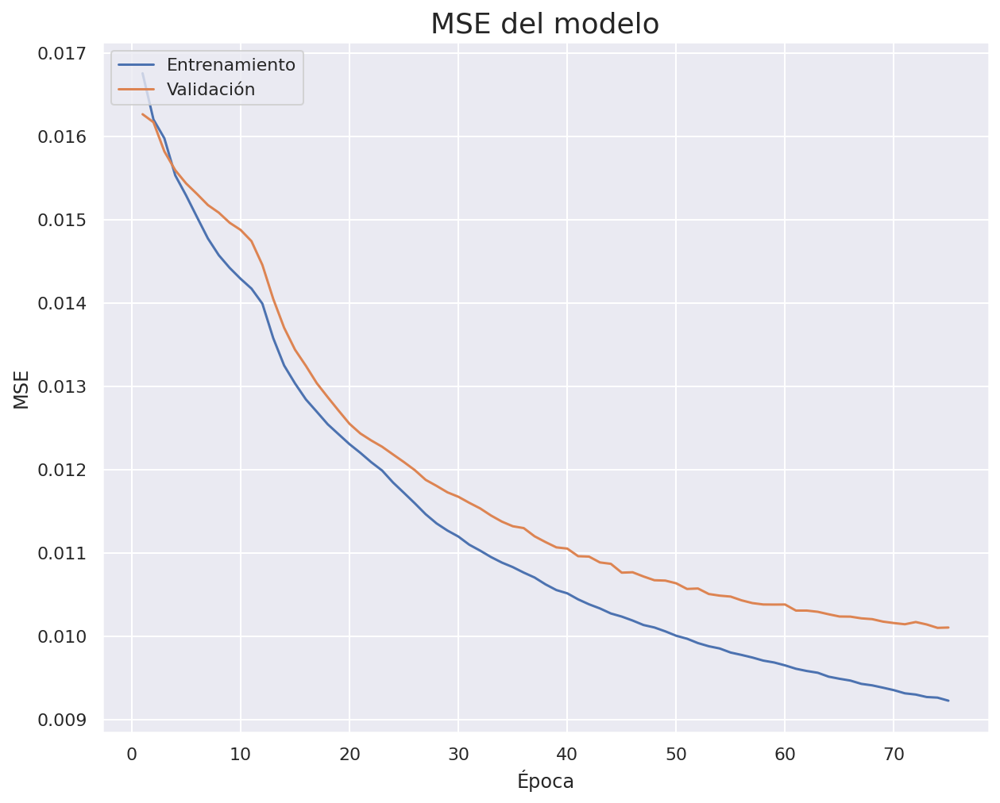

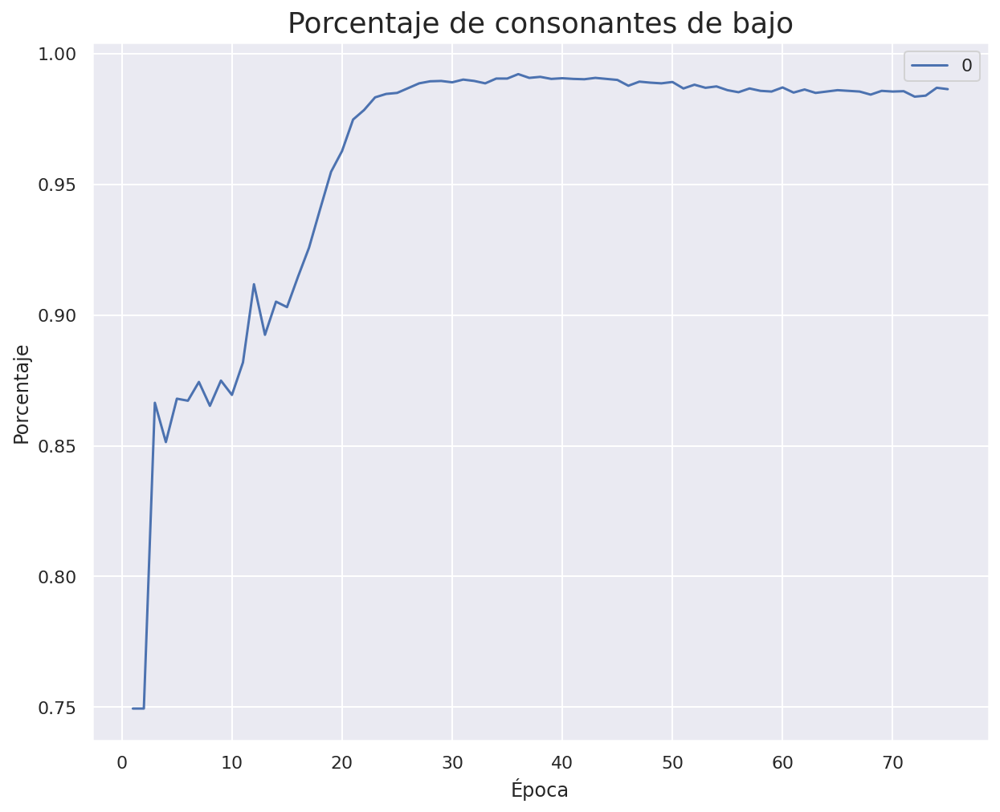

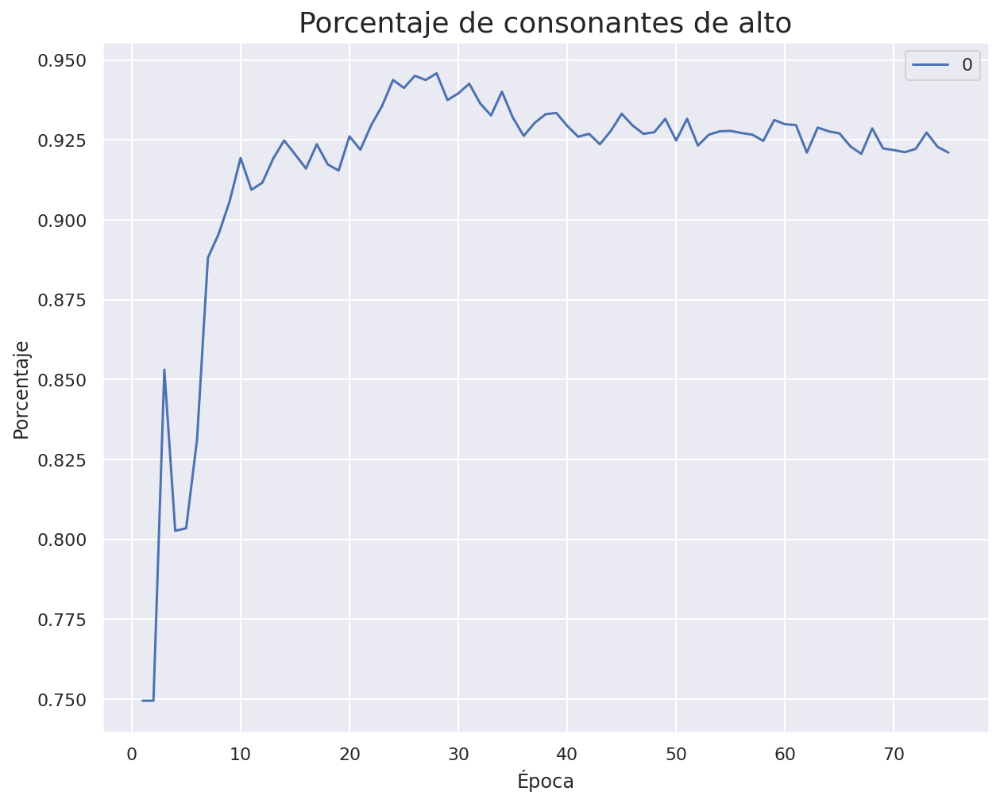

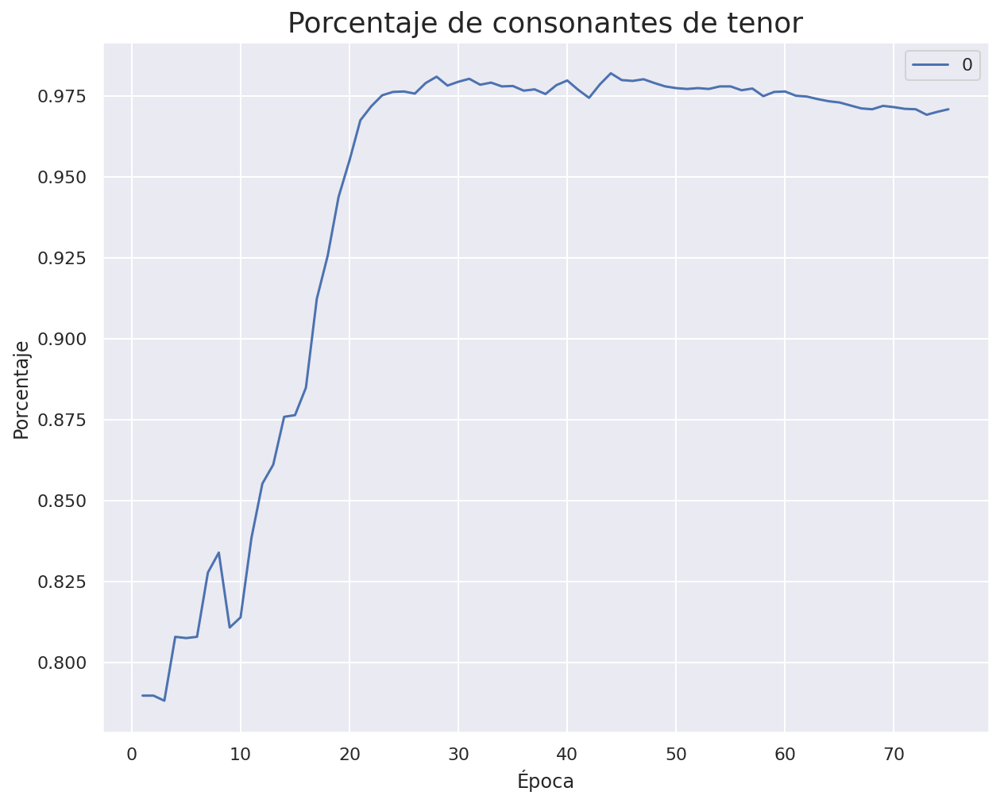

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_24 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_24 (LSTM)                 (None, 22)           4136        ['embedding_24[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

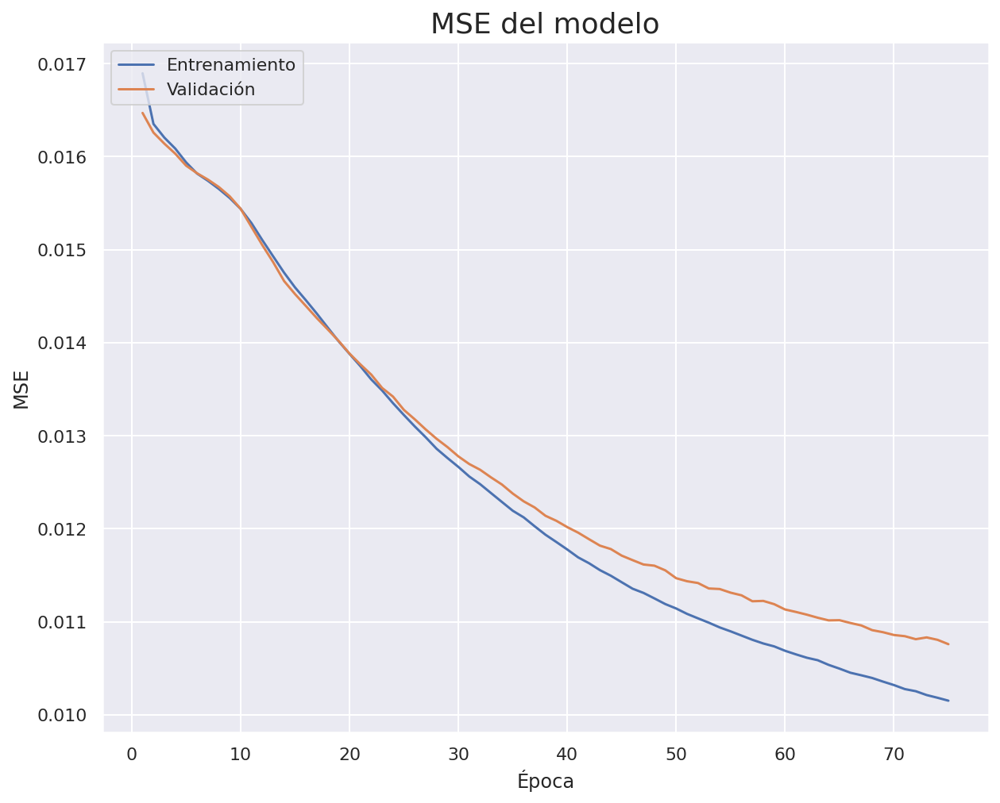

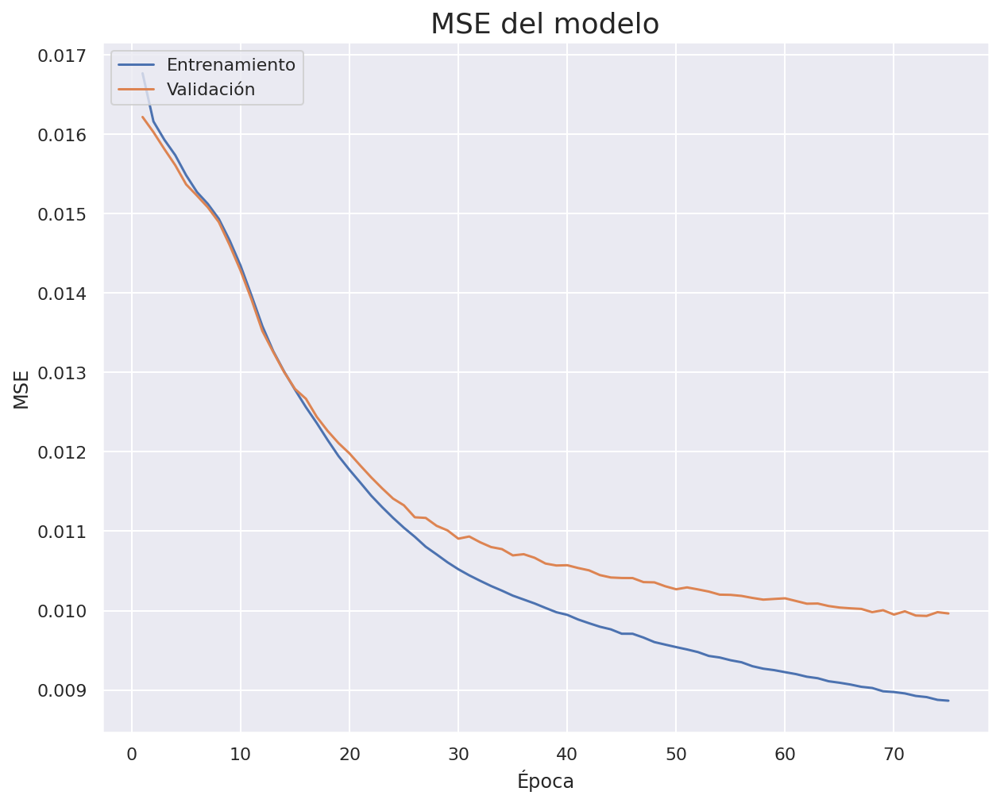

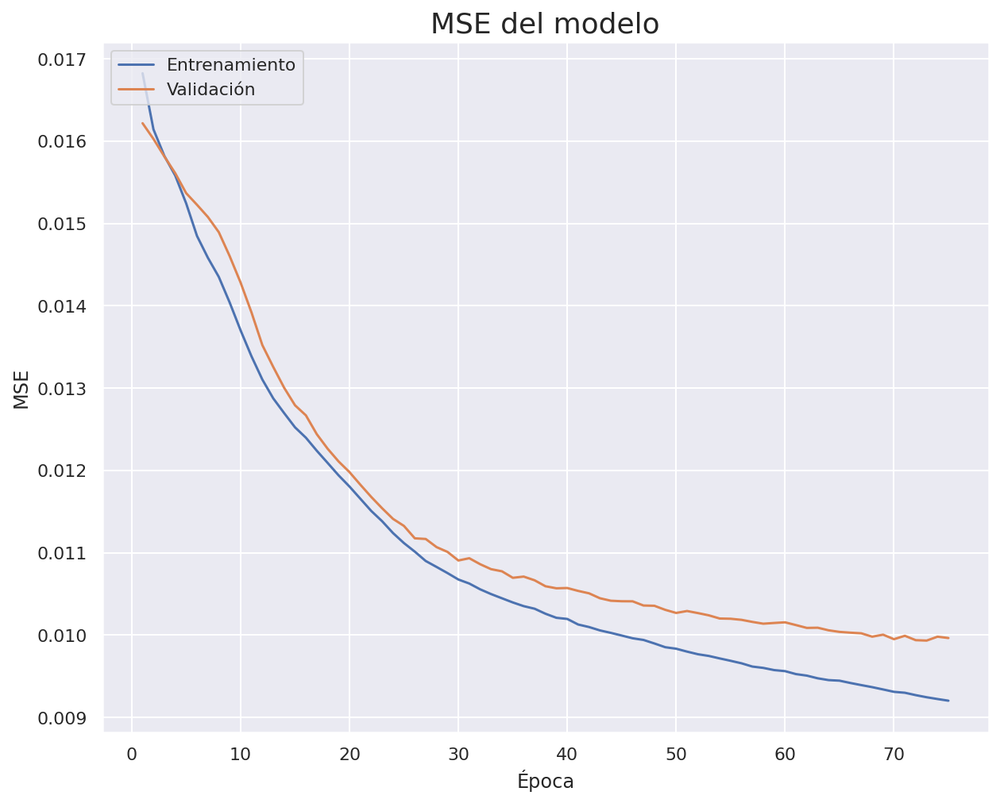

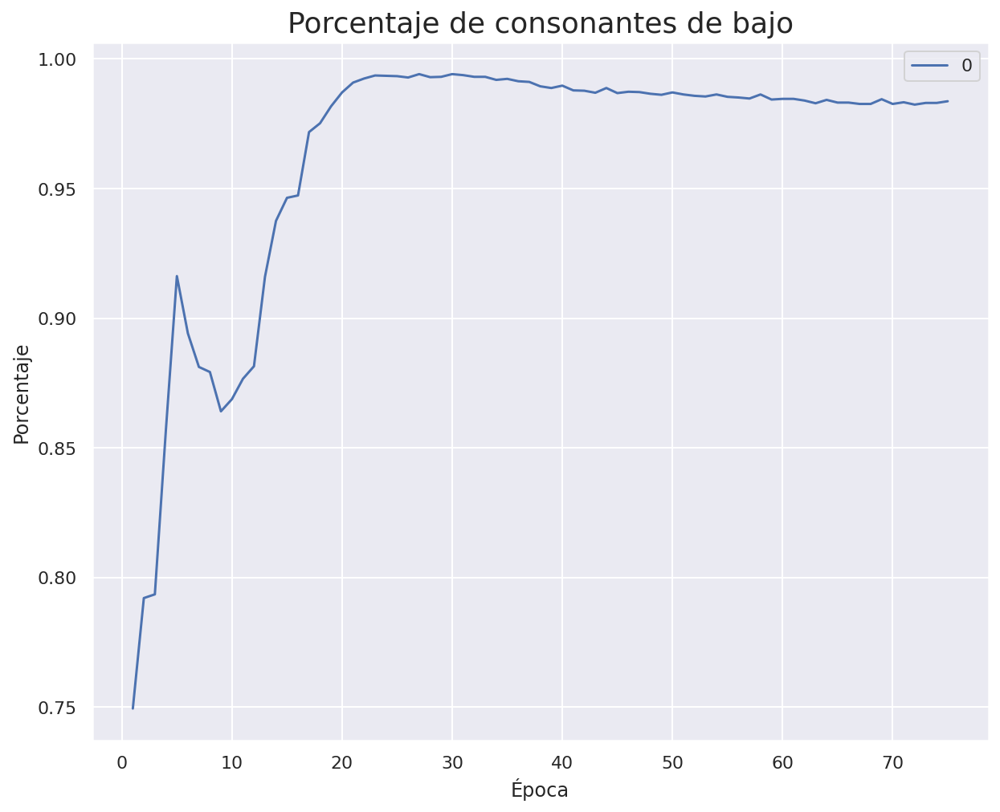

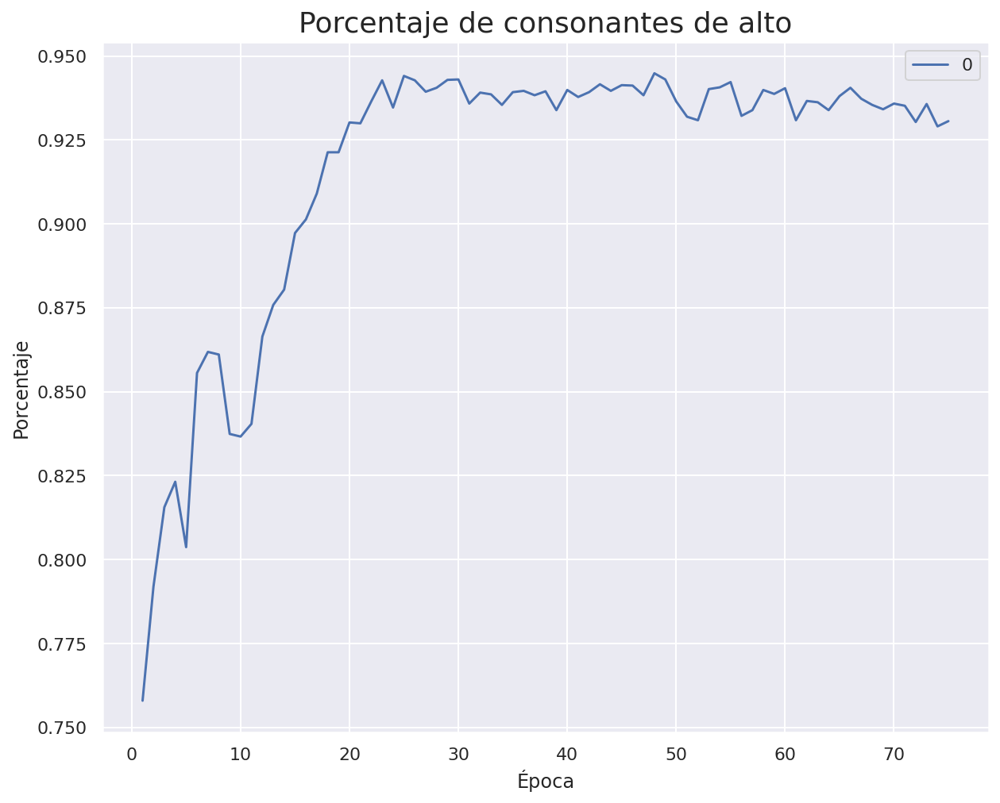

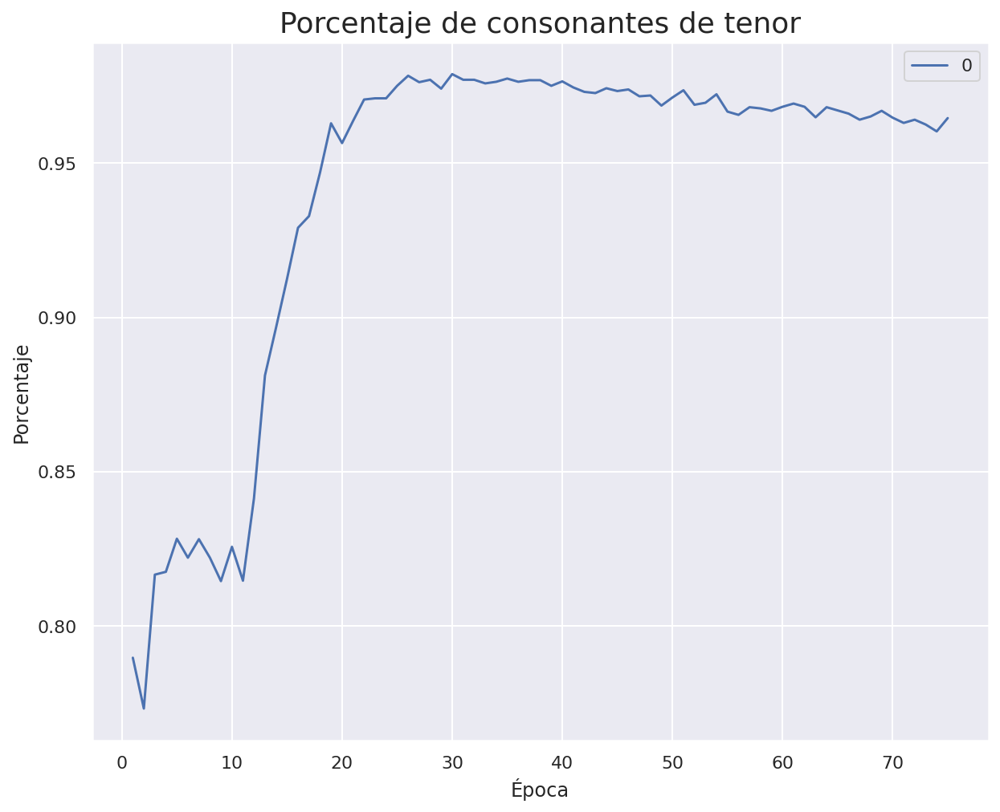

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_26 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_26 (LSTM)                 (None, 23)           4416        ['embedding_26[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

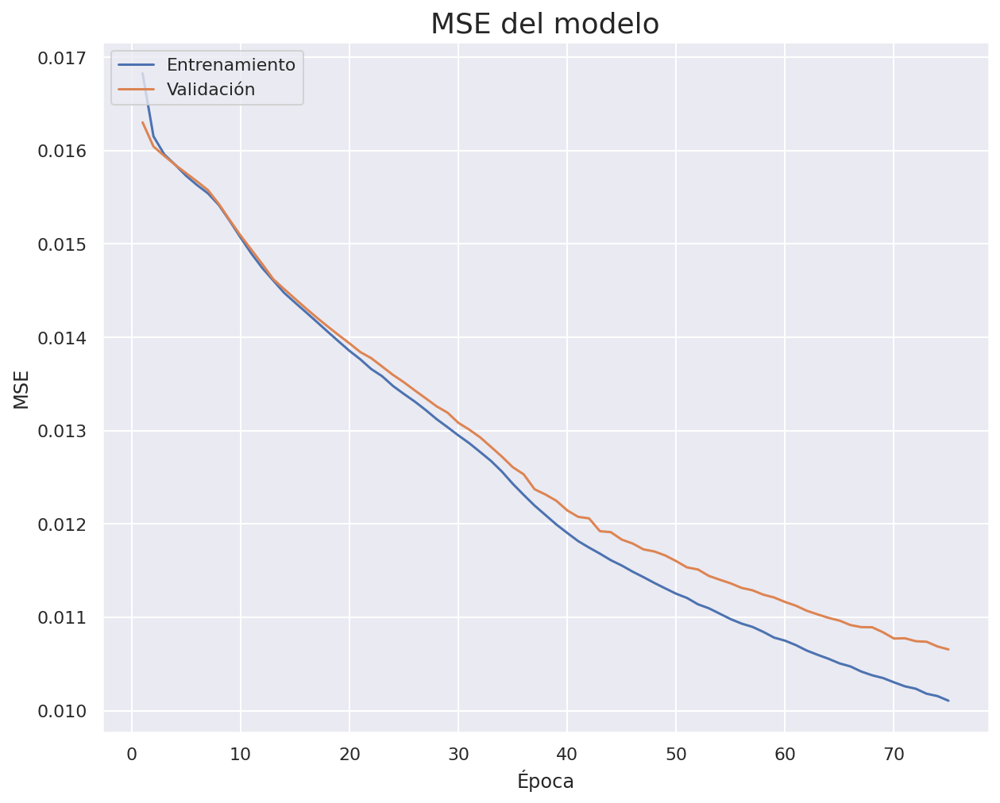

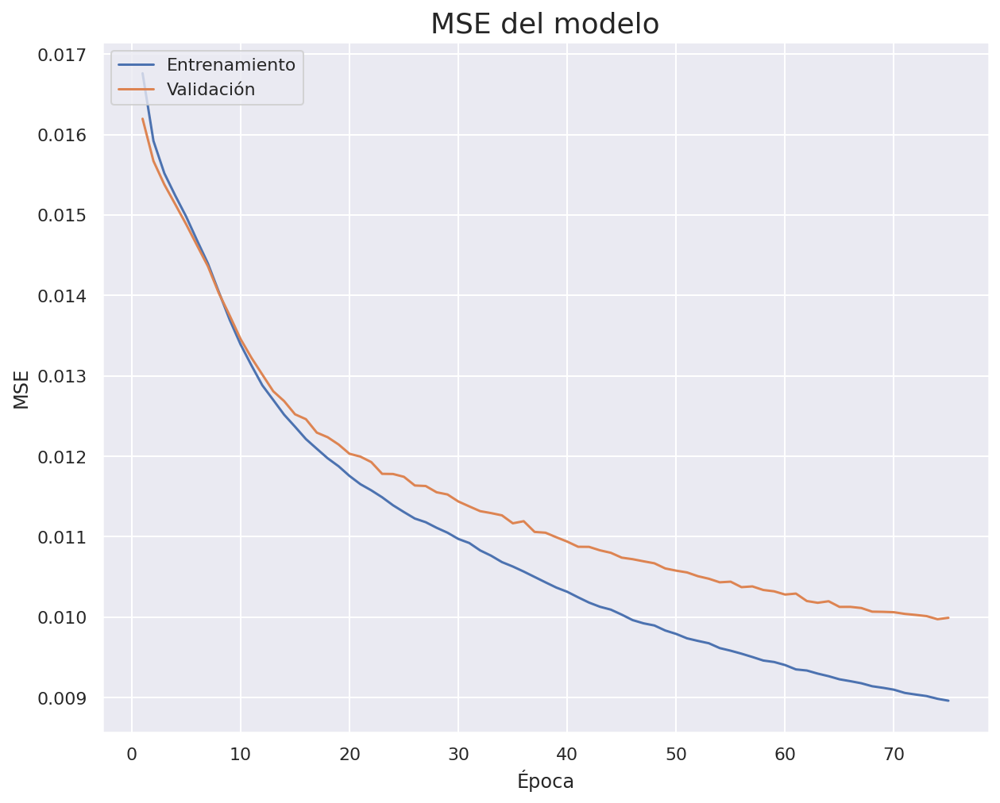

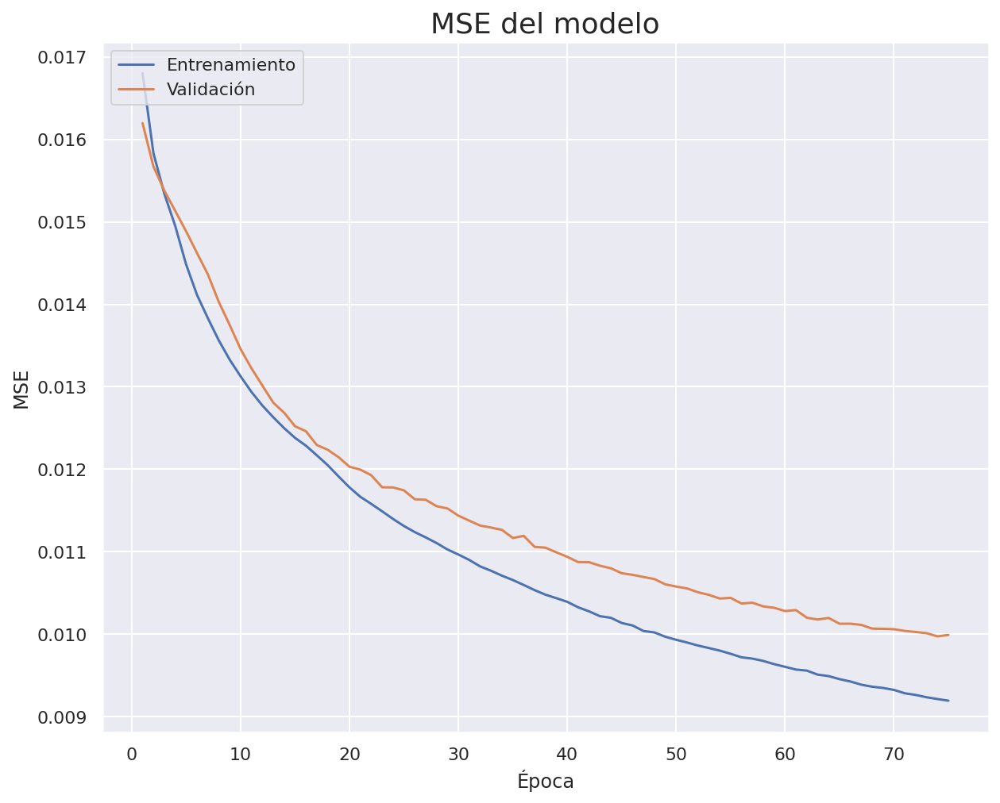

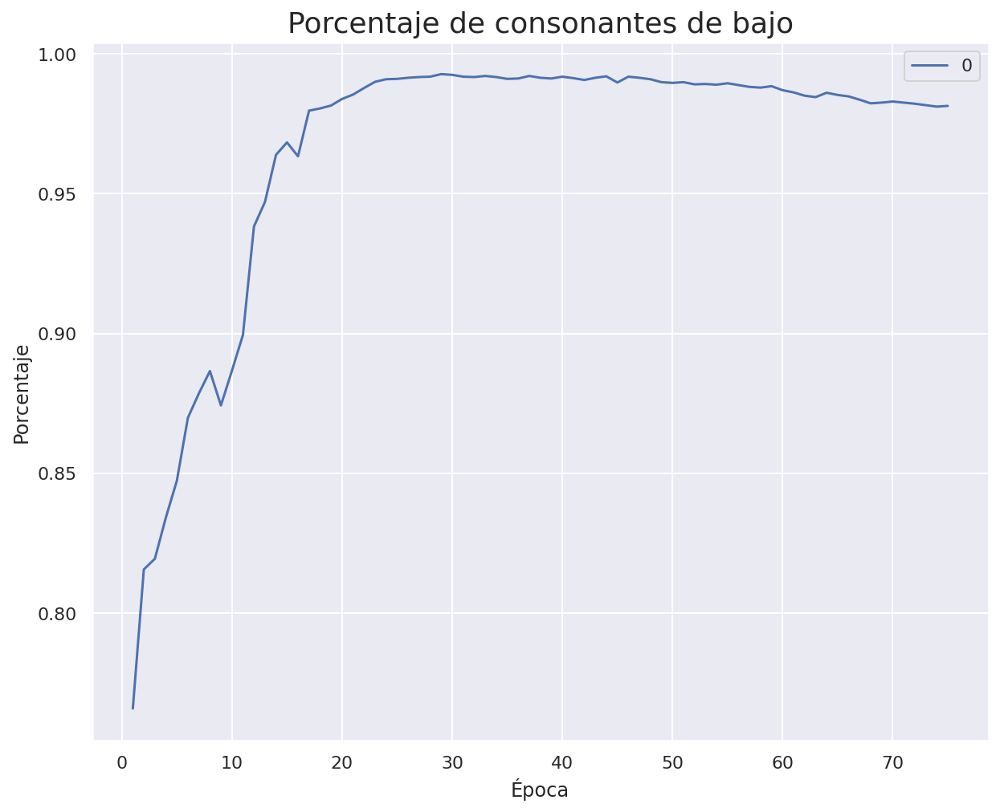

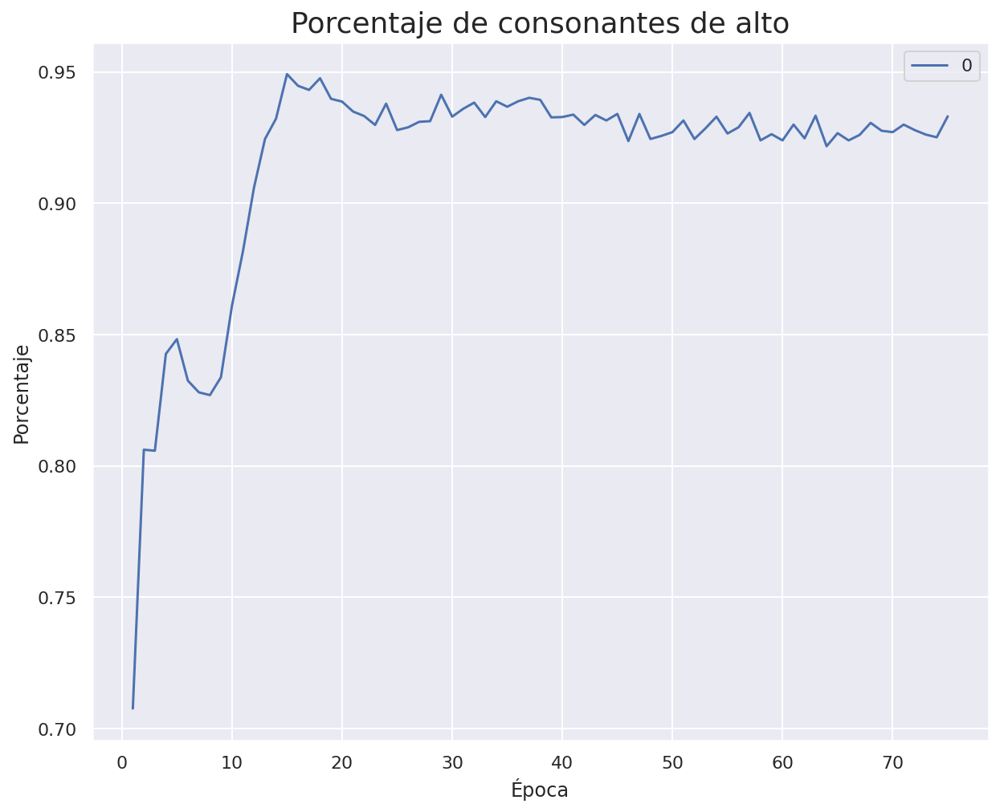

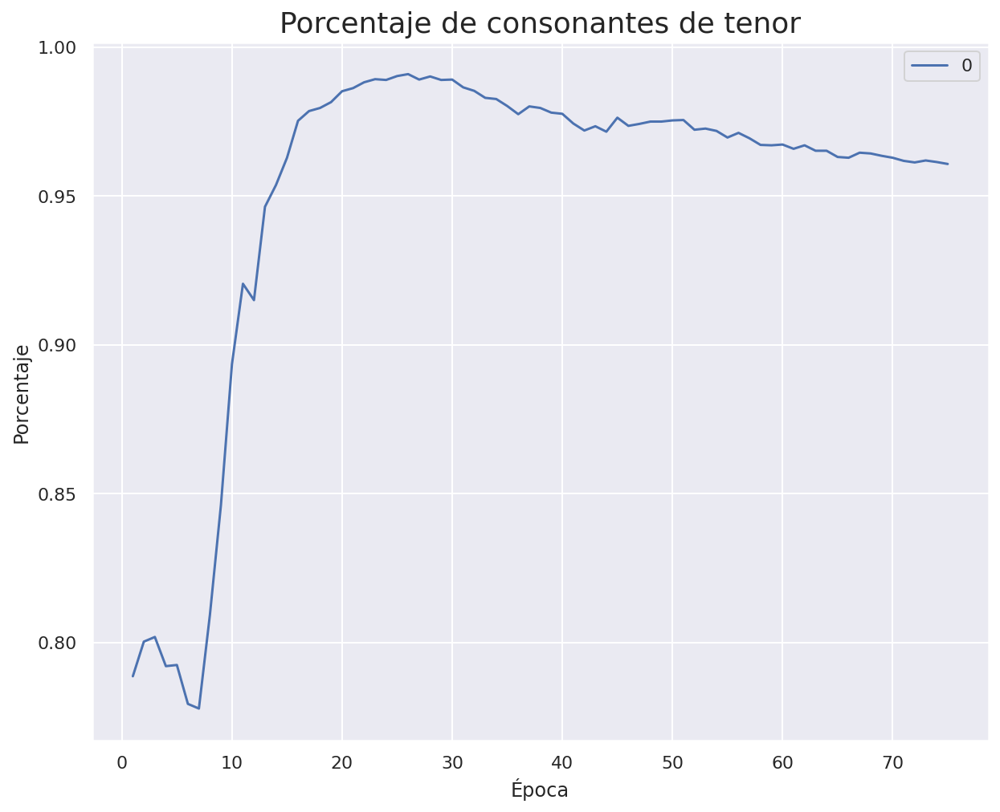

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_28 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_28 (LSTM)                 (None, 24)           4704        ['embedding_28[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

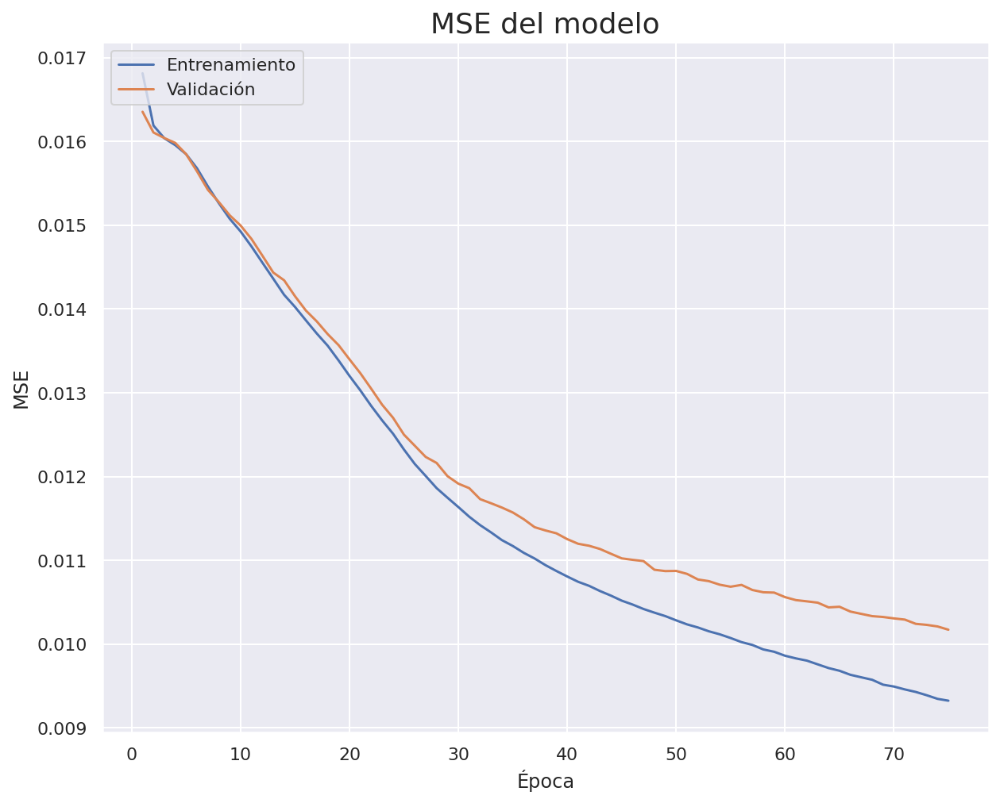

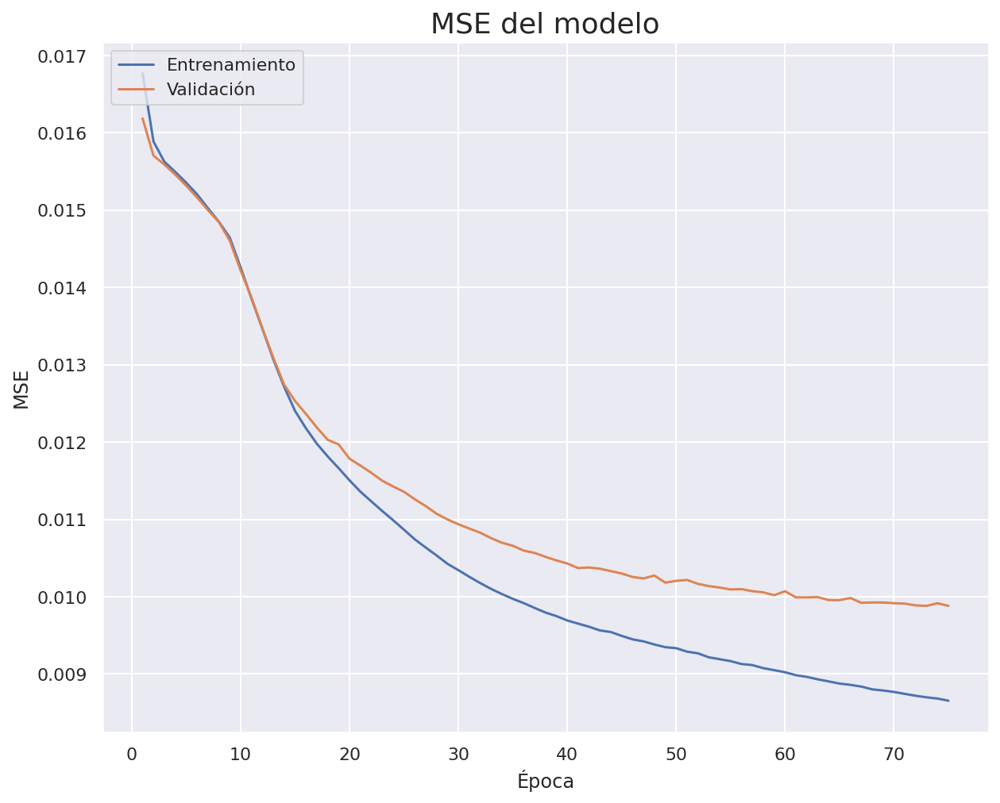

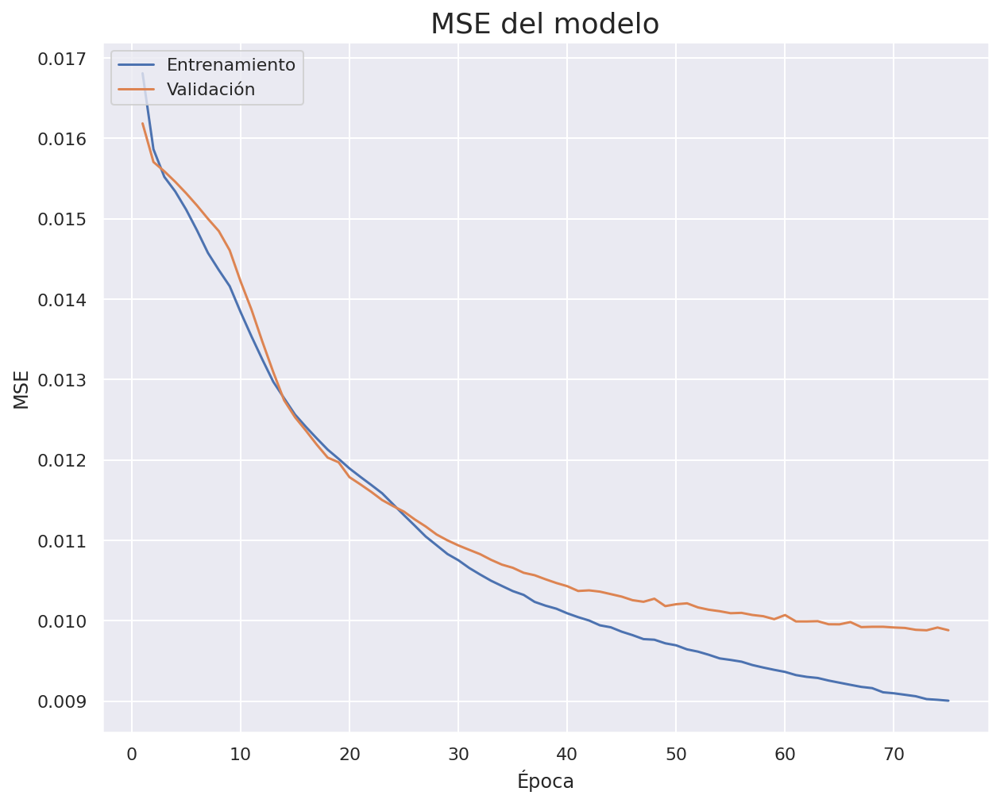

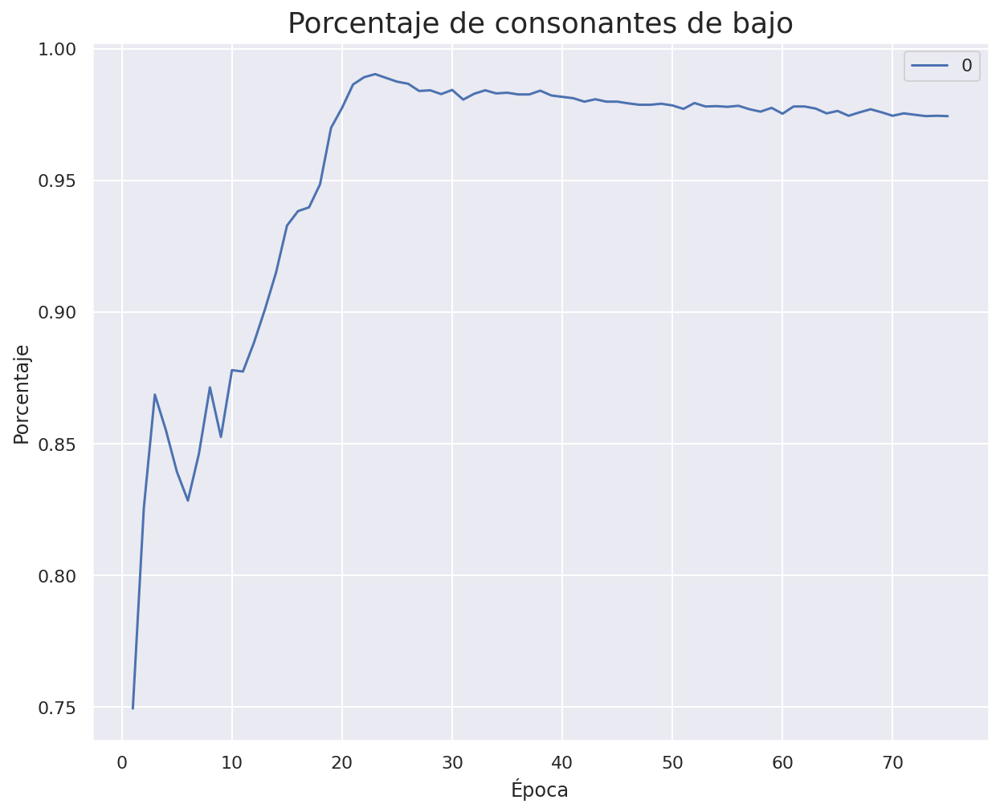

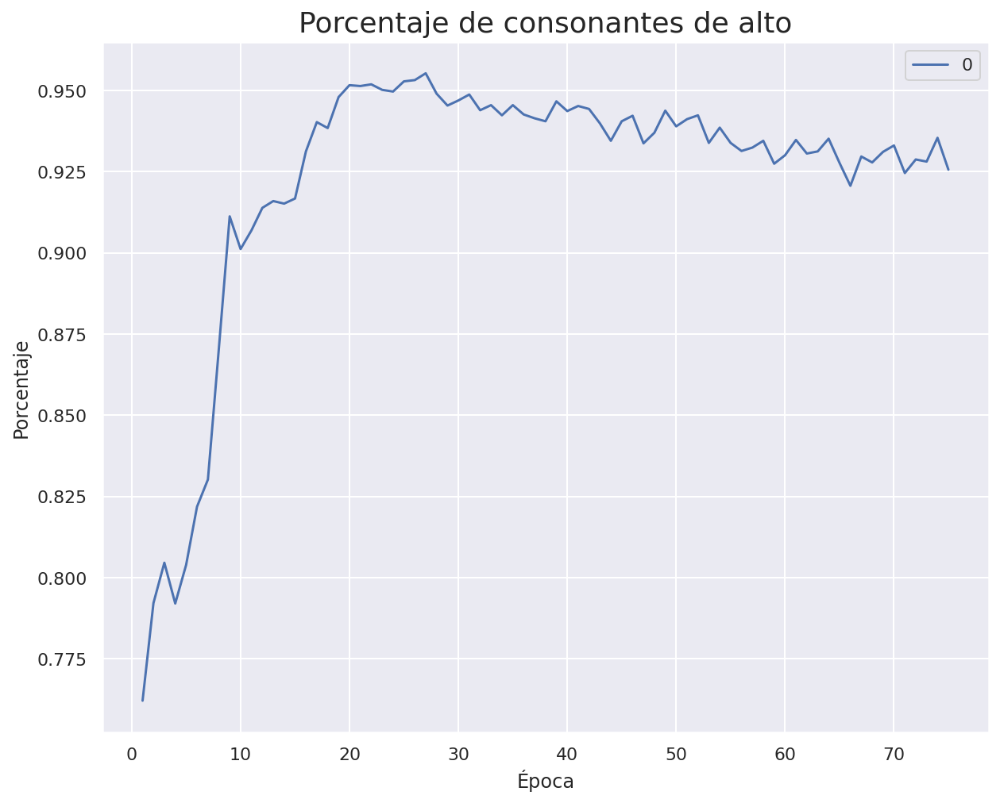

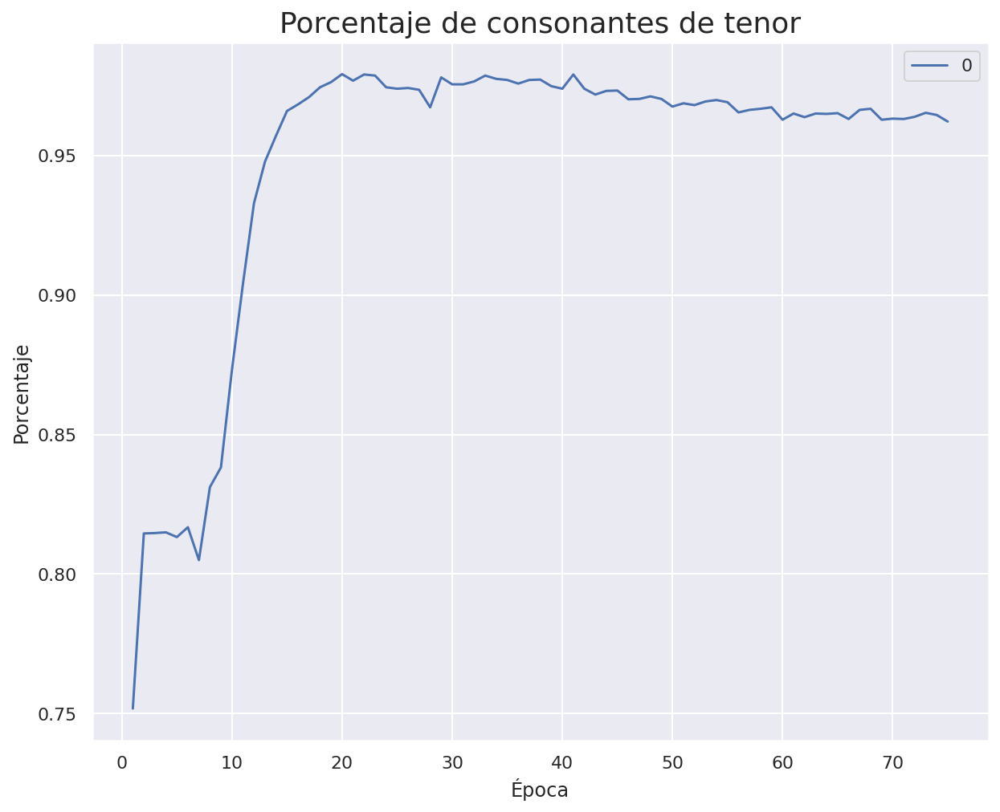

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_30 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_30 (LSTM)                 (None, 25)           5000        ['embedding_30[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

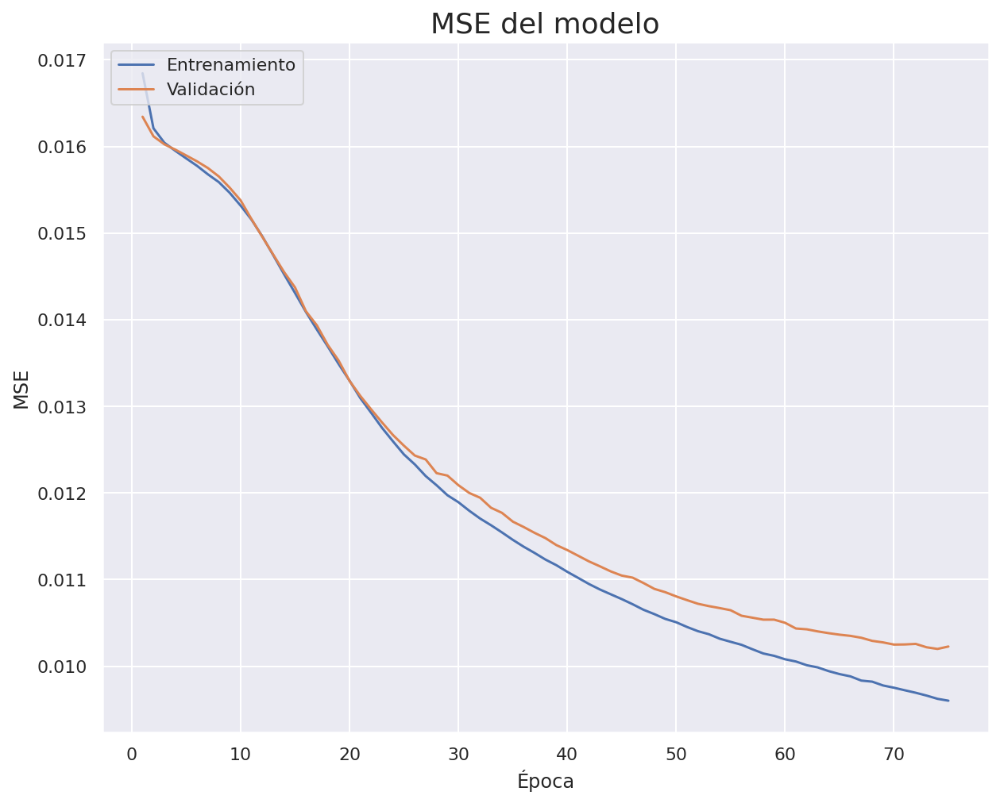

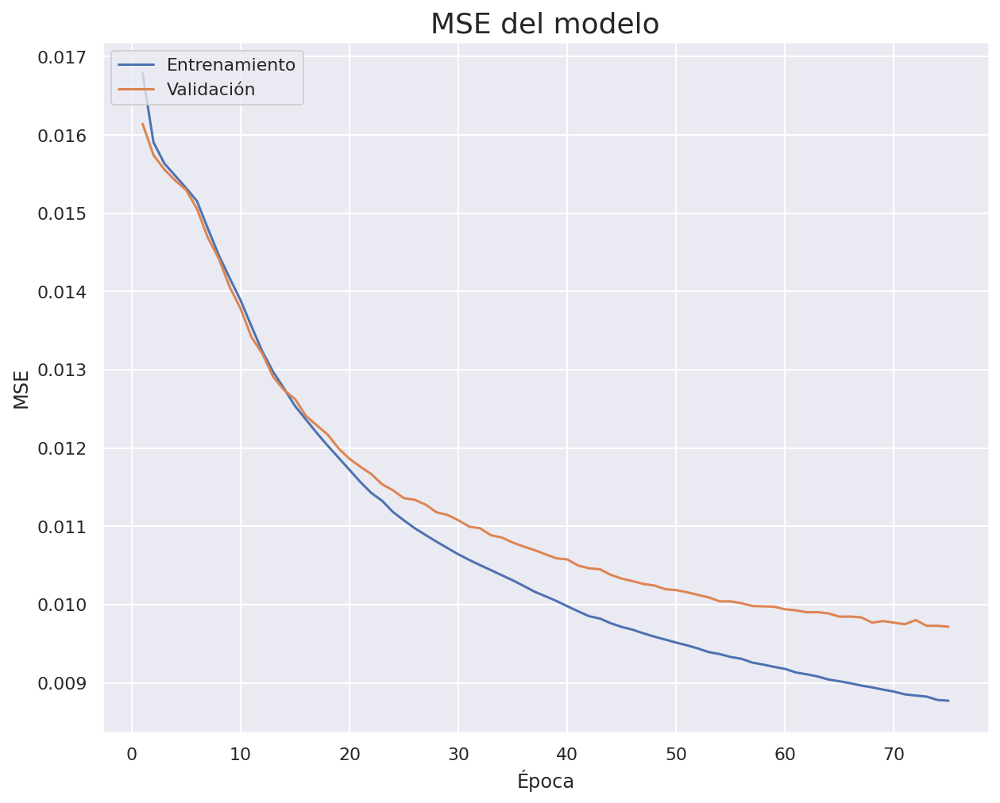

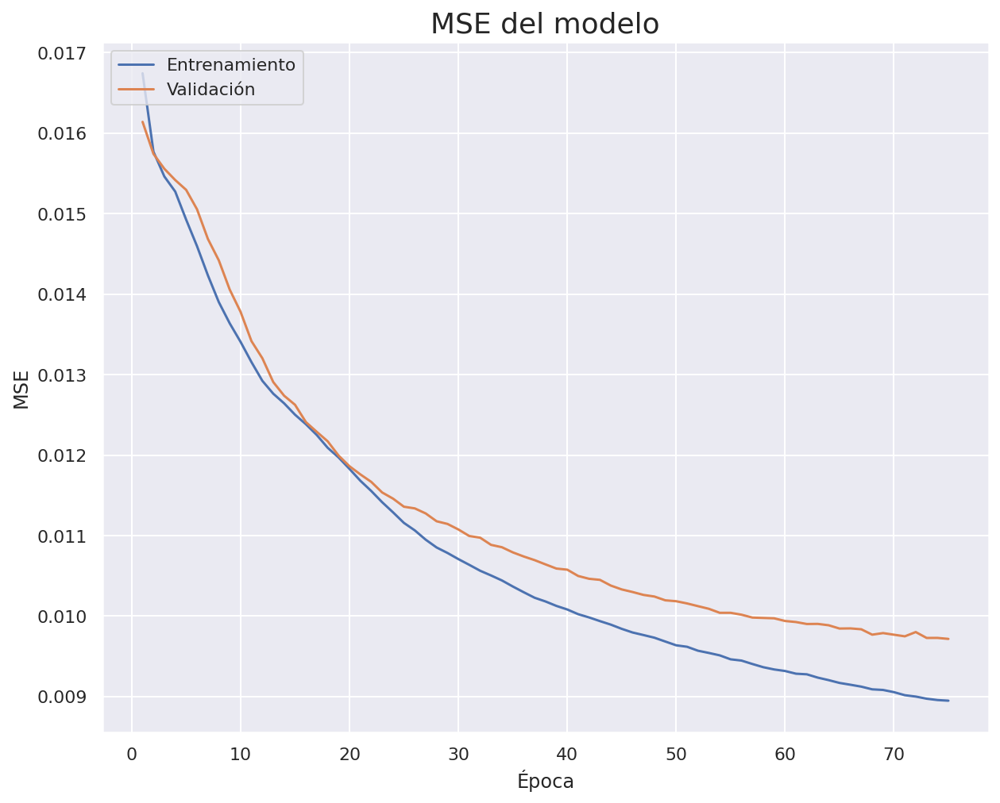

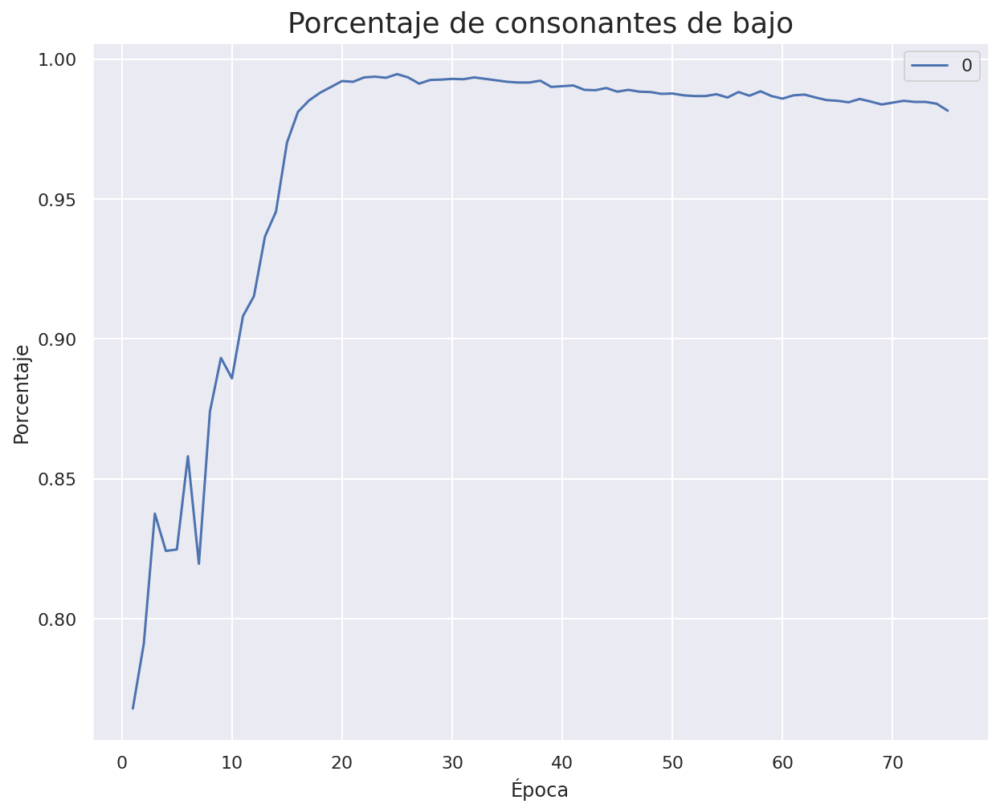

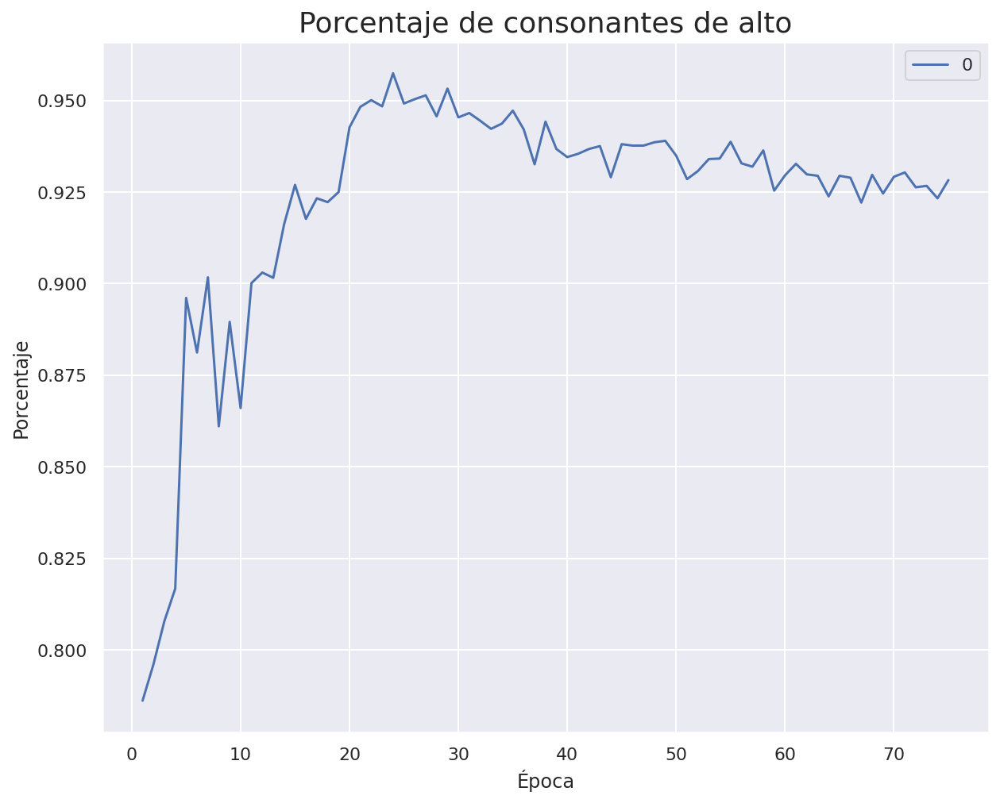

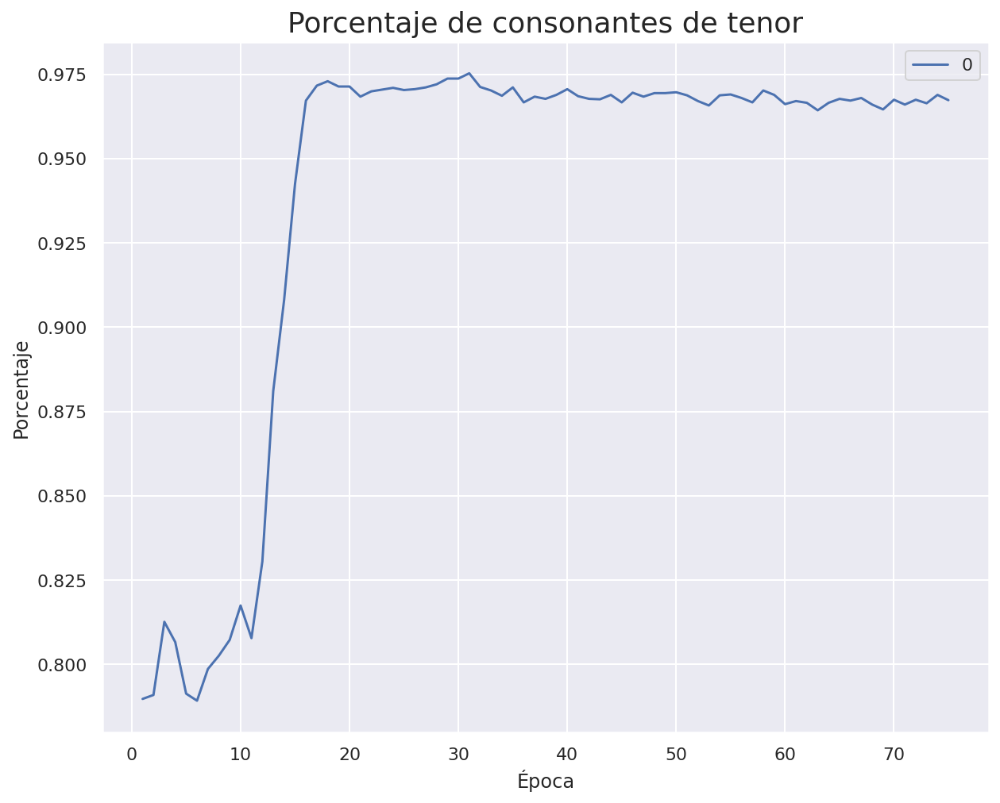

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_32 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_32 (LSTM)                 (None, 26)           5304        ['embedding_32[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

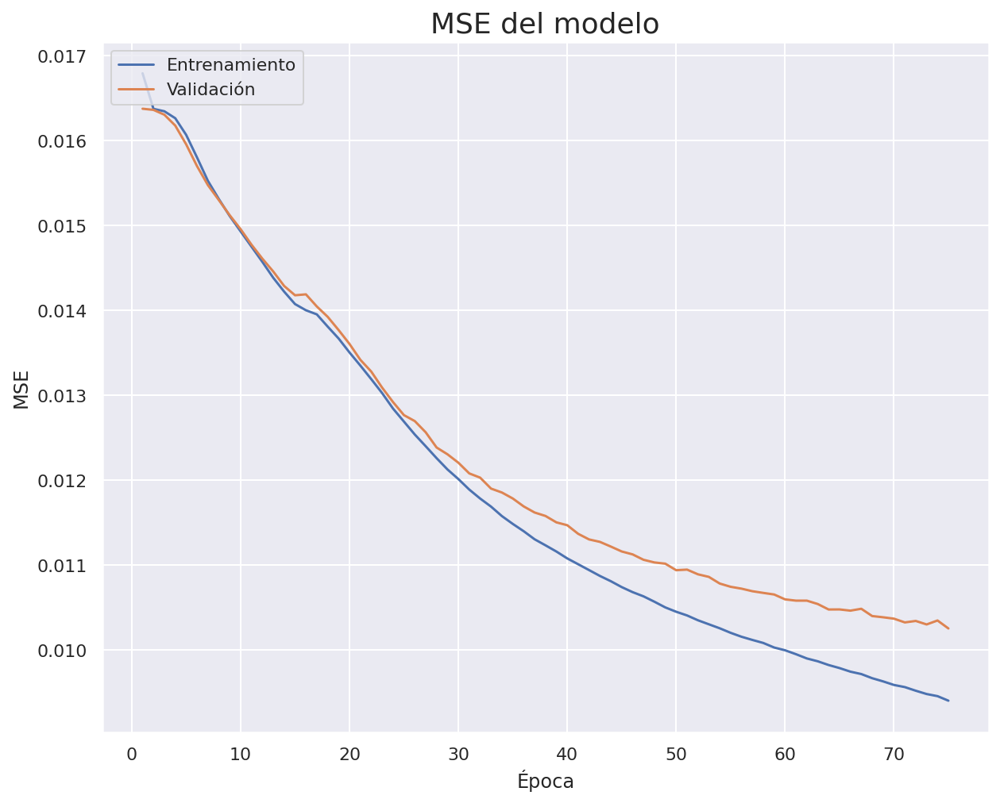

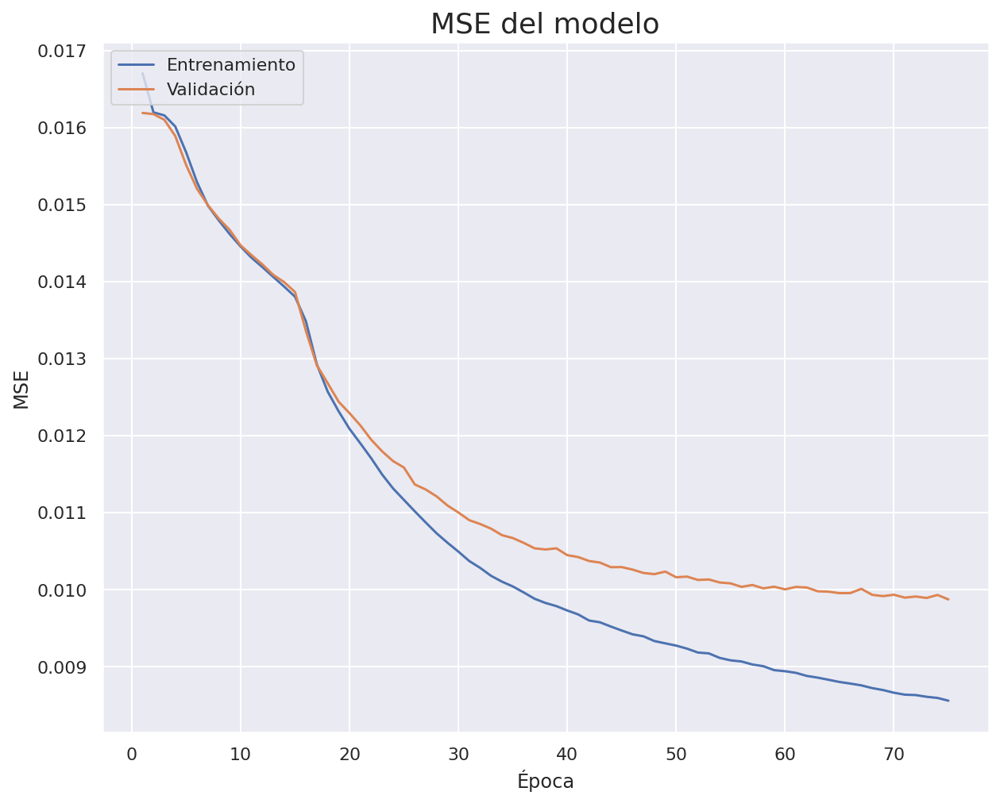

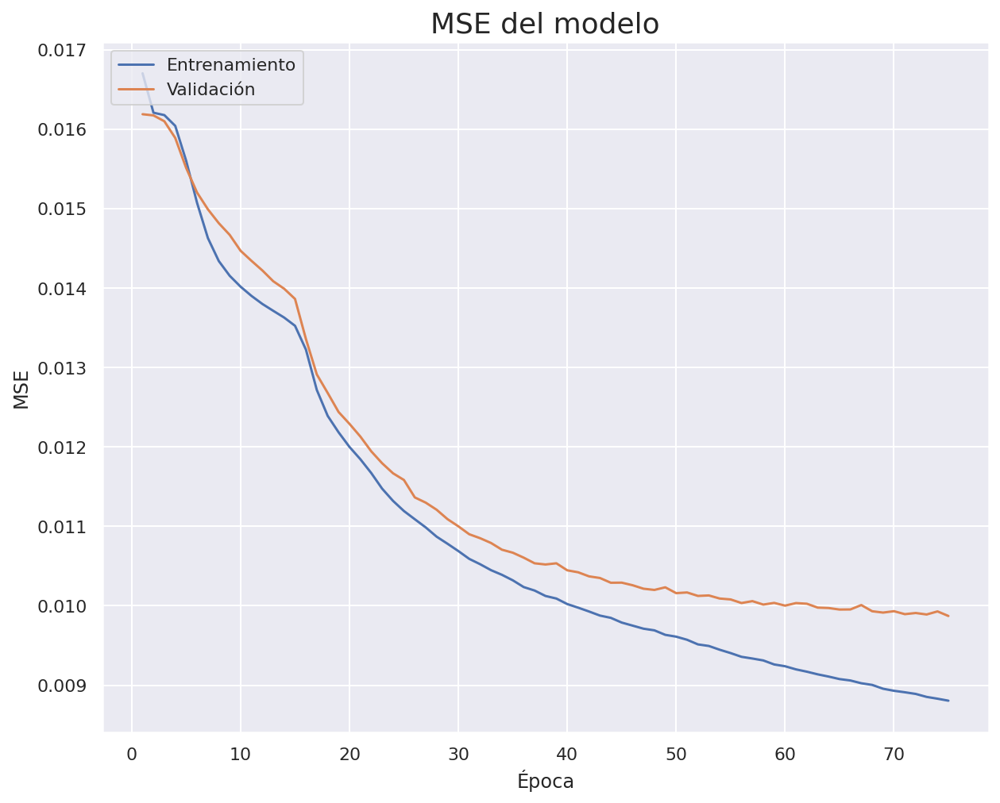

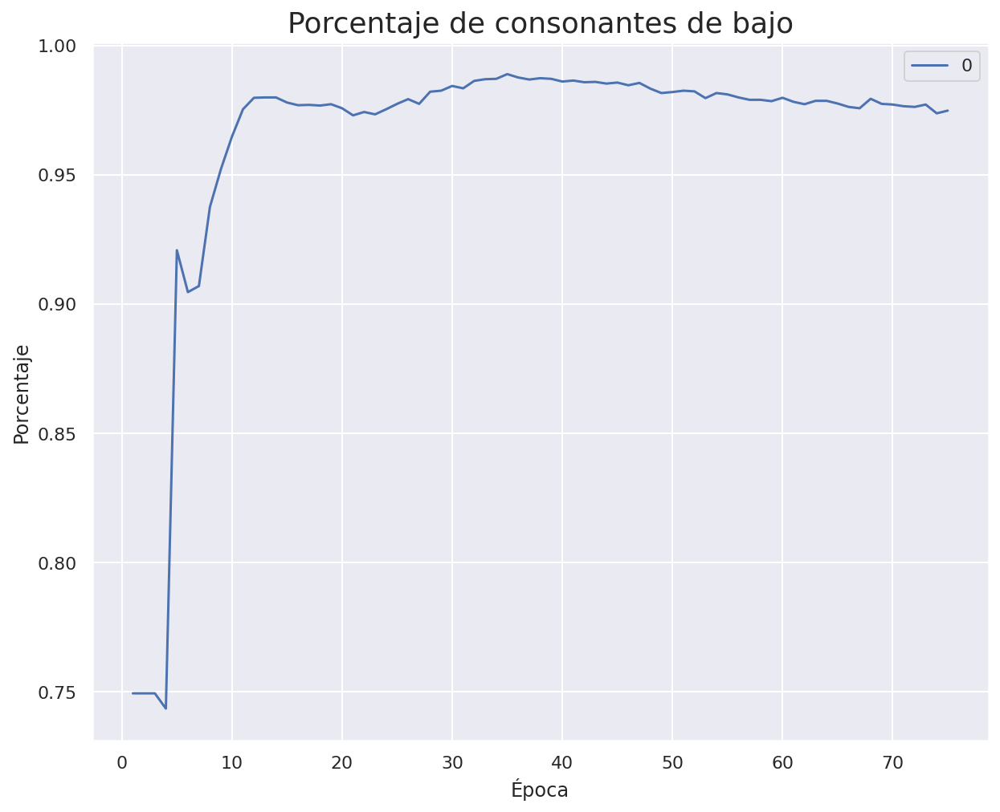

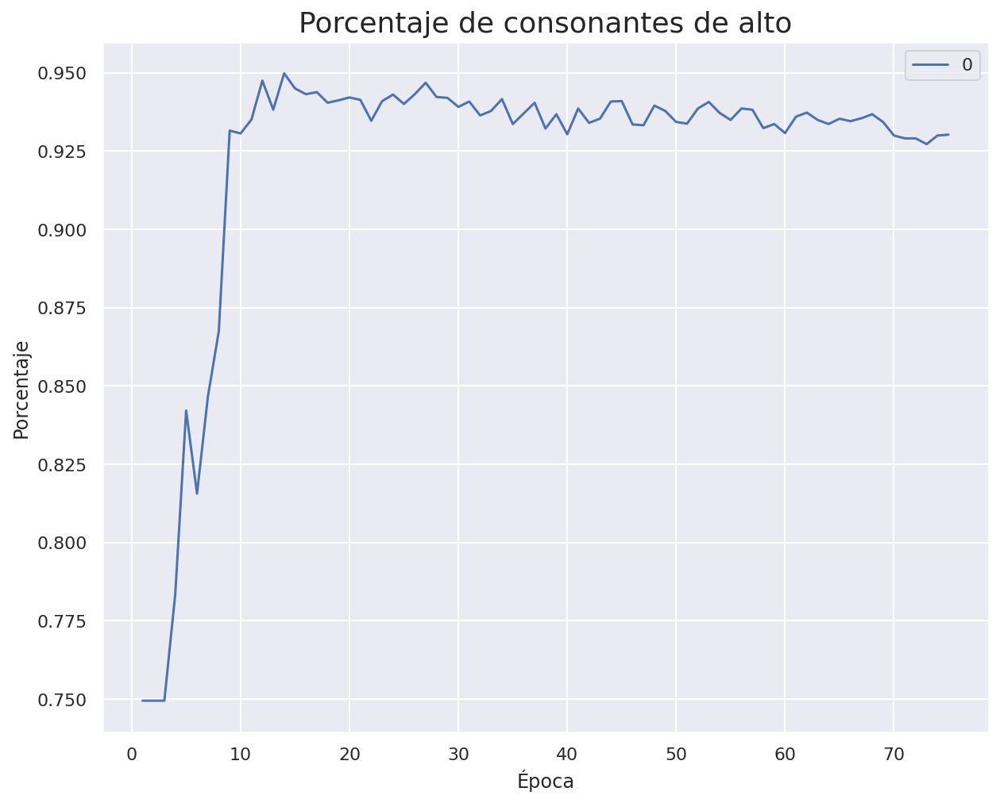

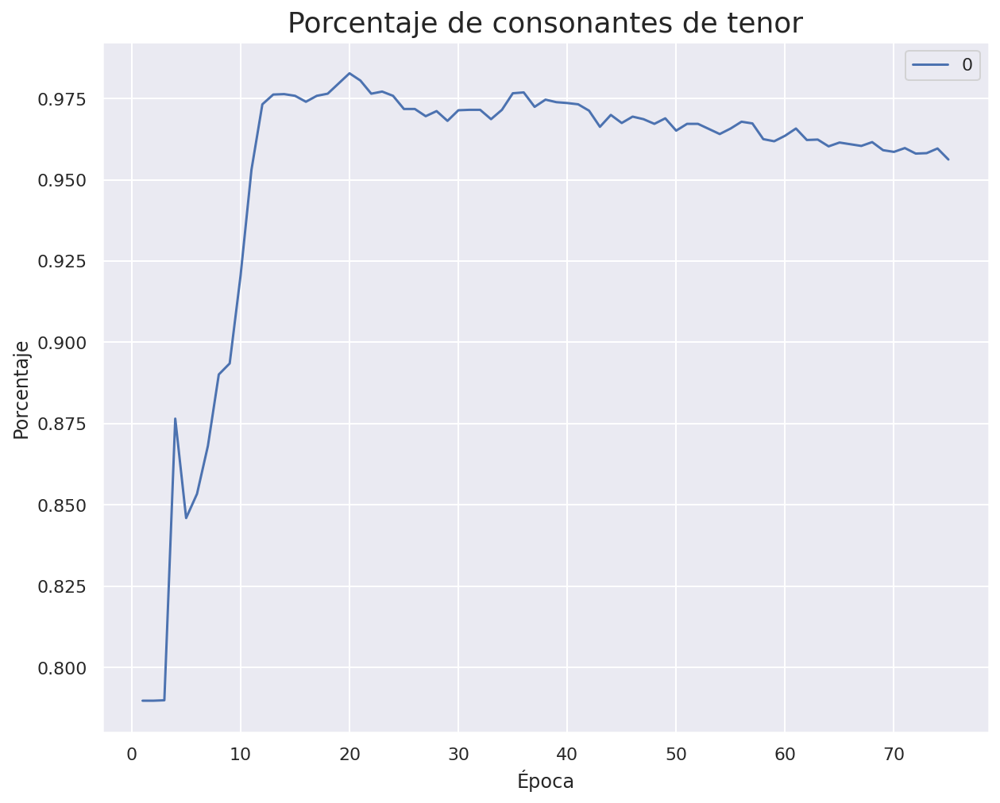

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_34 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_34 (LSTM)                 (None, 27)           5616        ['embedding_34[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

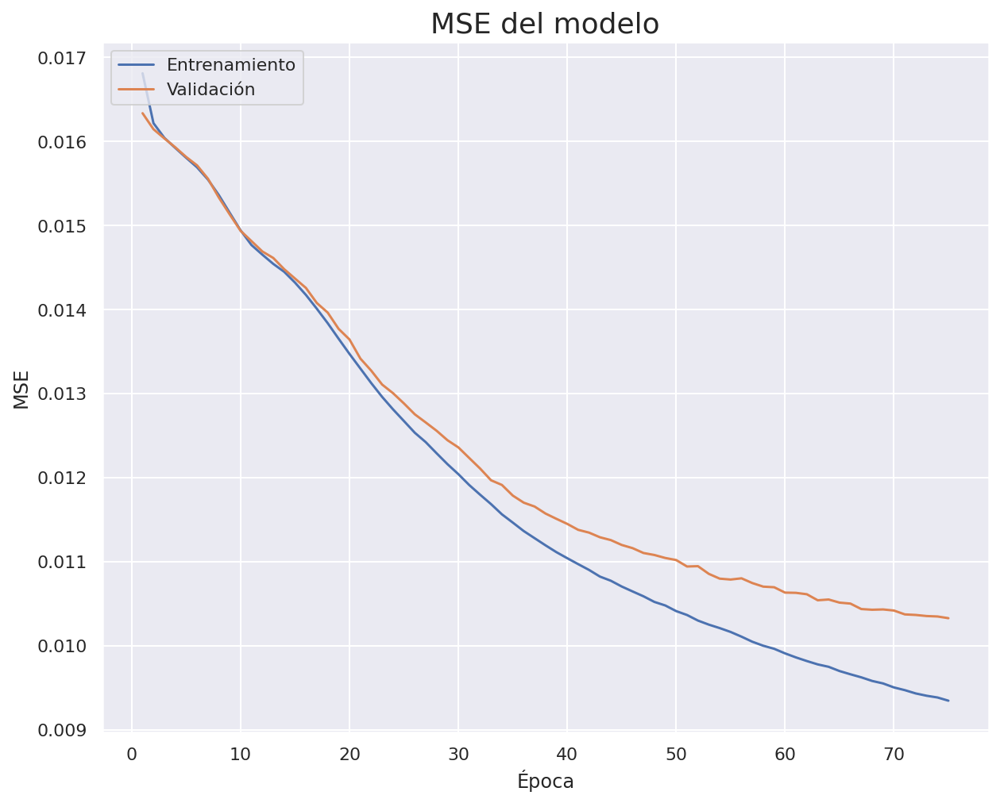

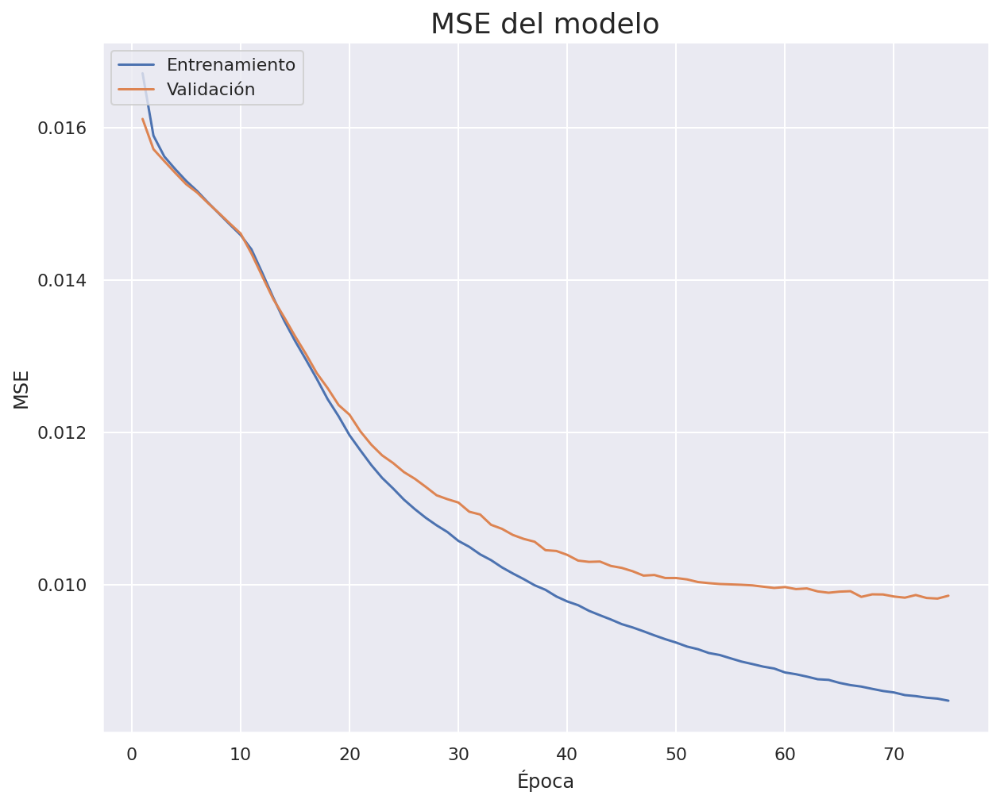

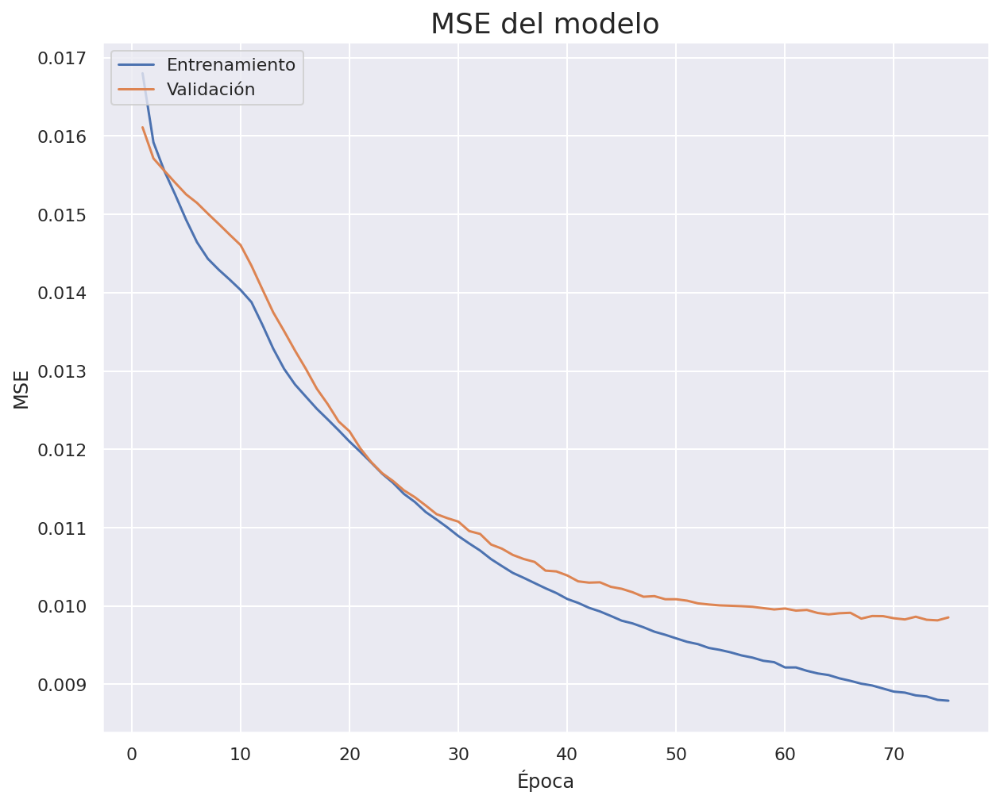

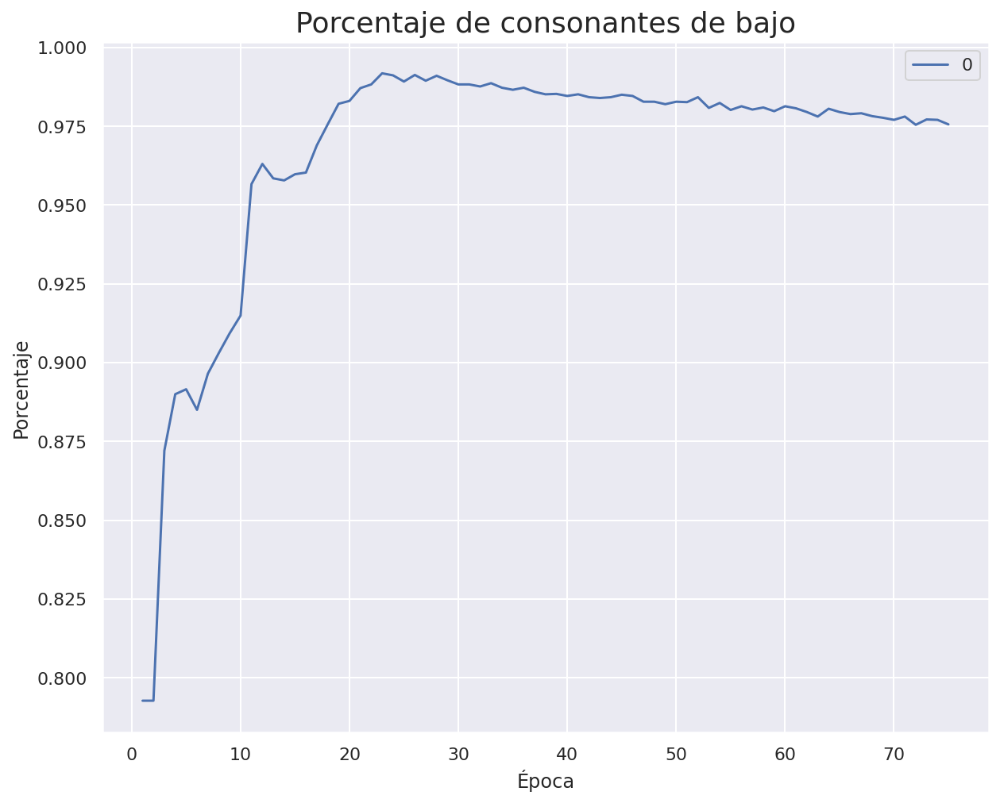

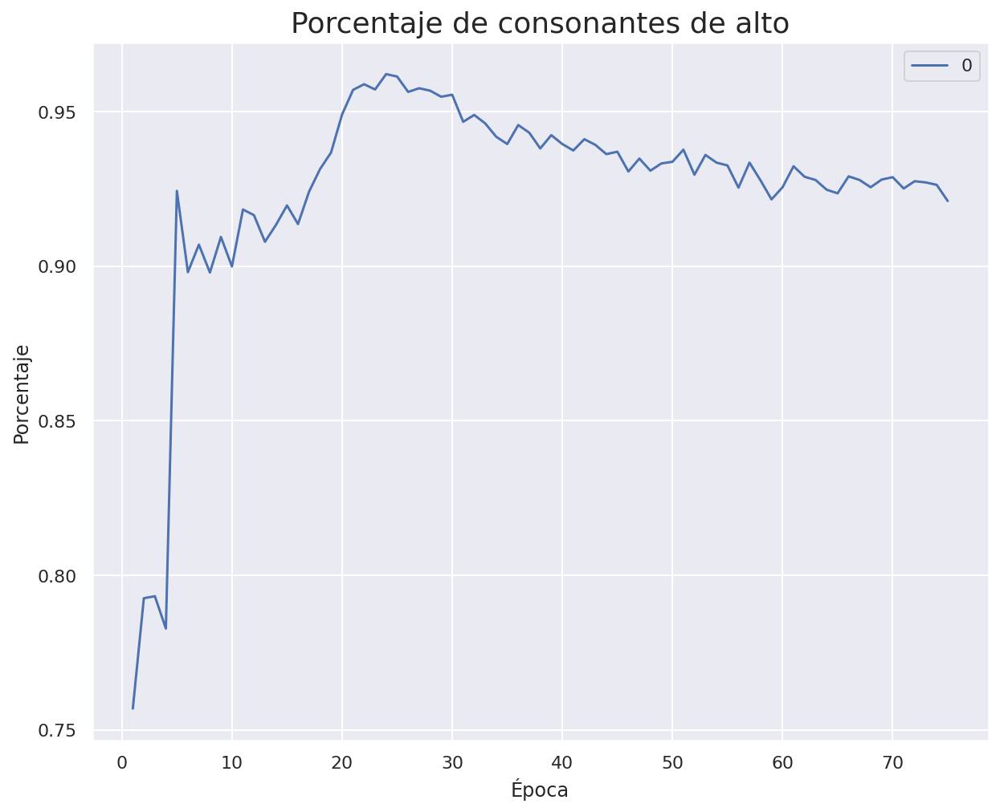

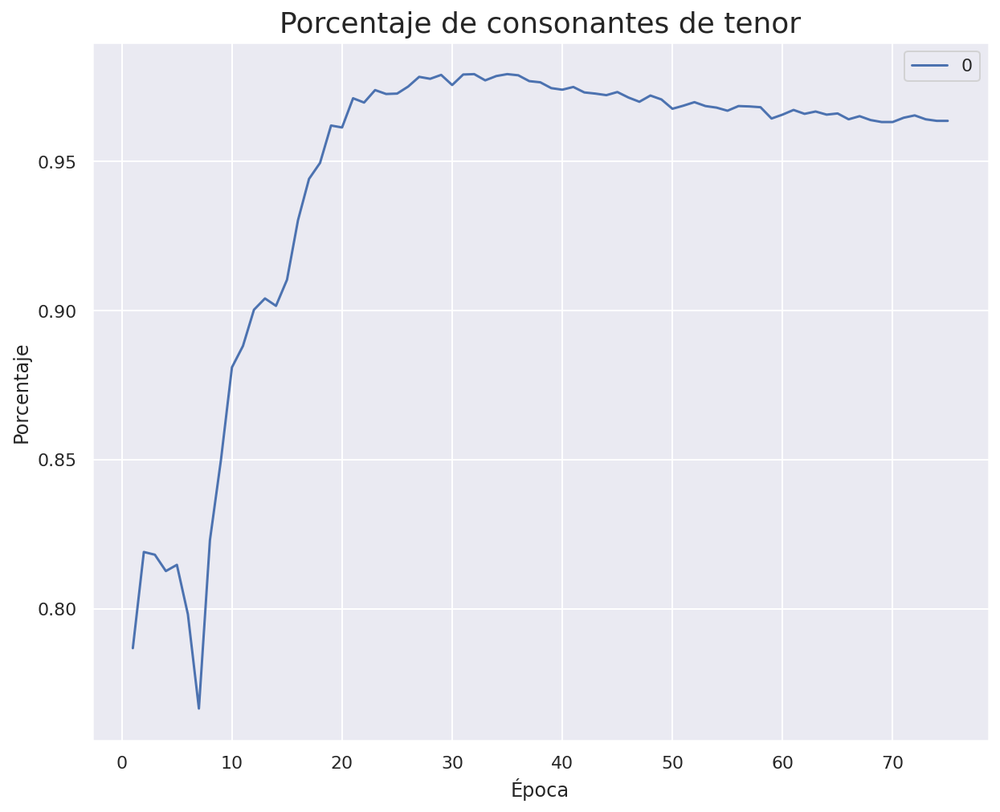

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_36 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_36 (LSTM)                 (None, 28)           5936        ['embedding_36[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

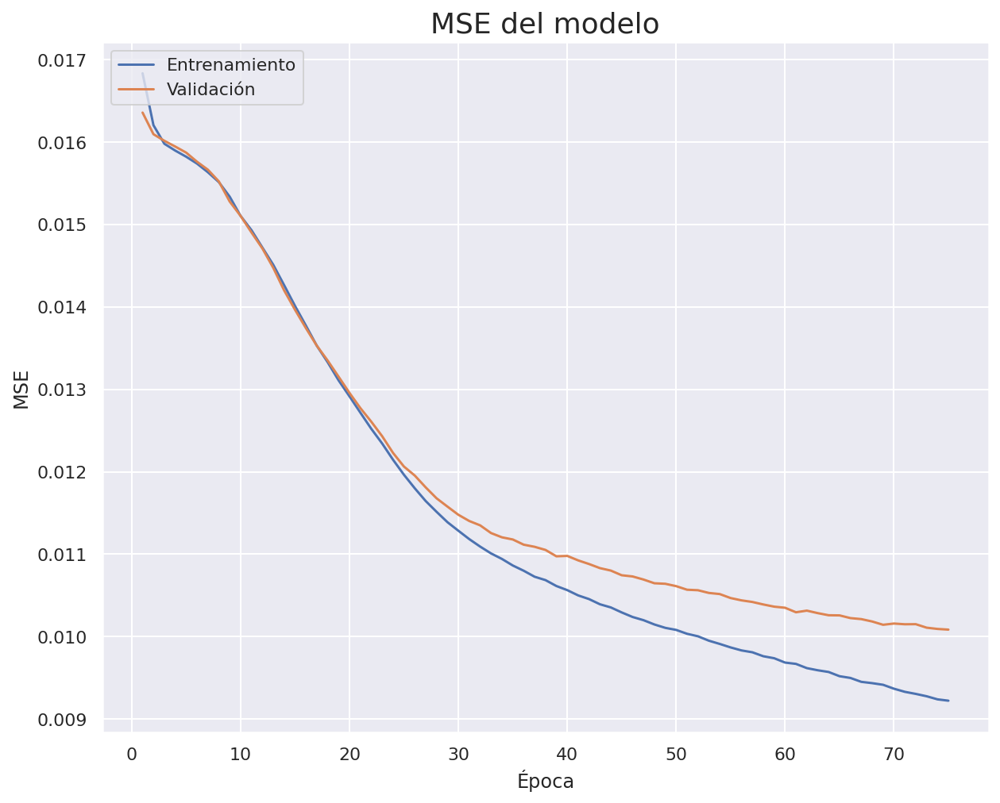

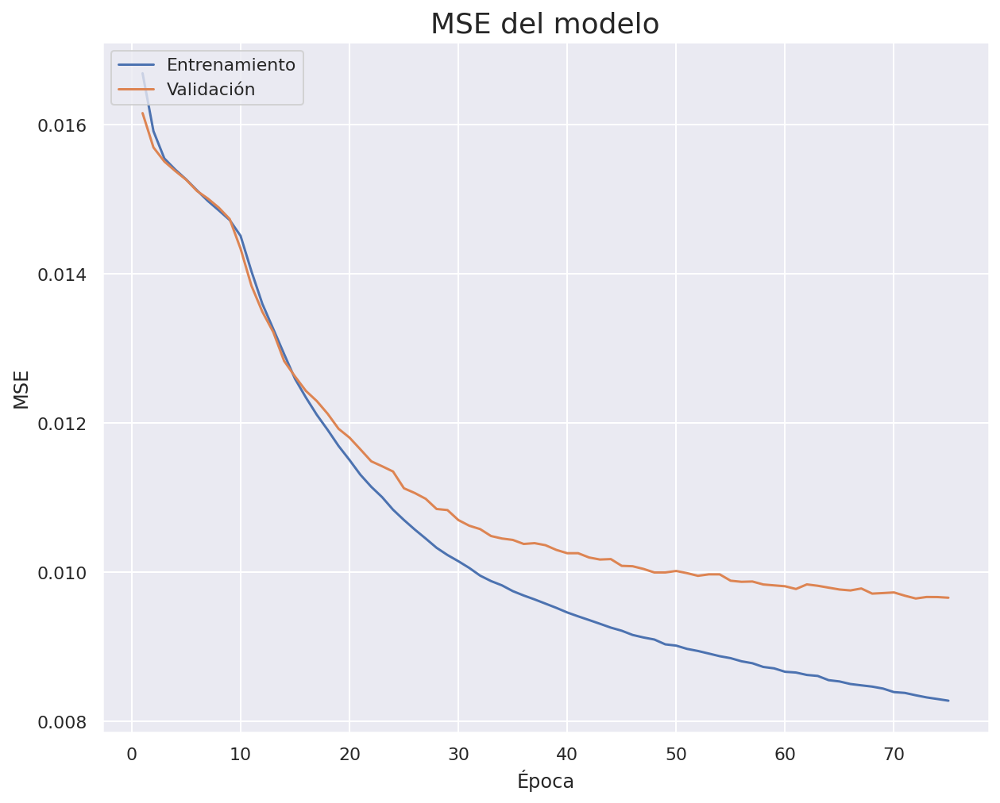

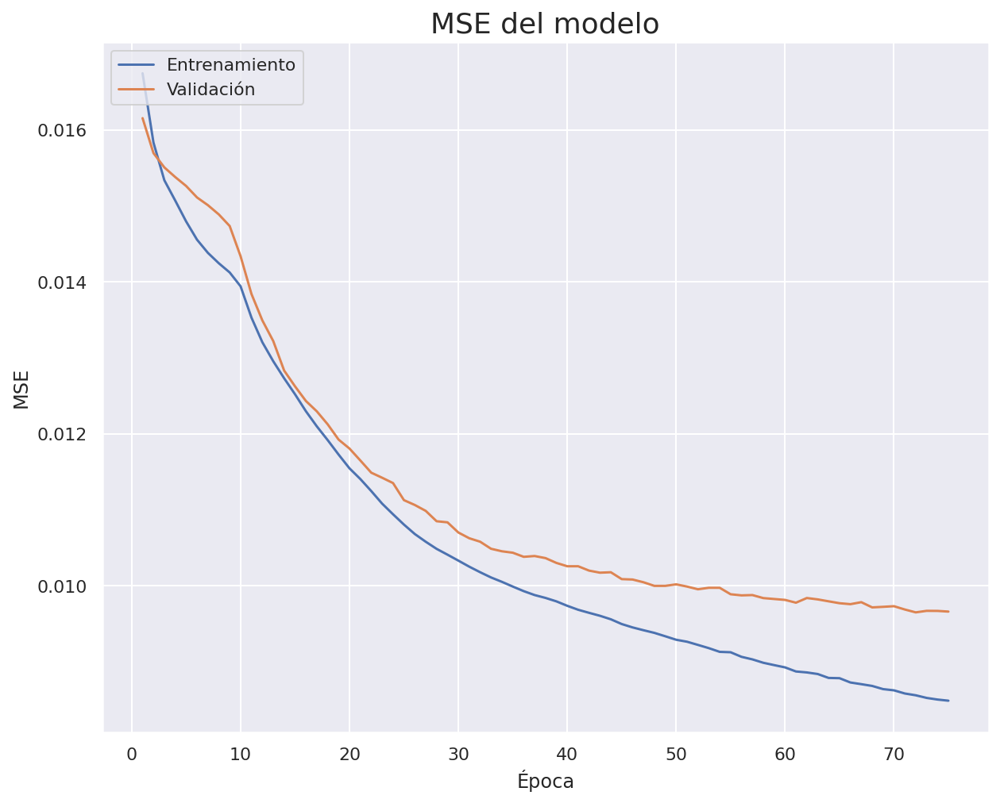

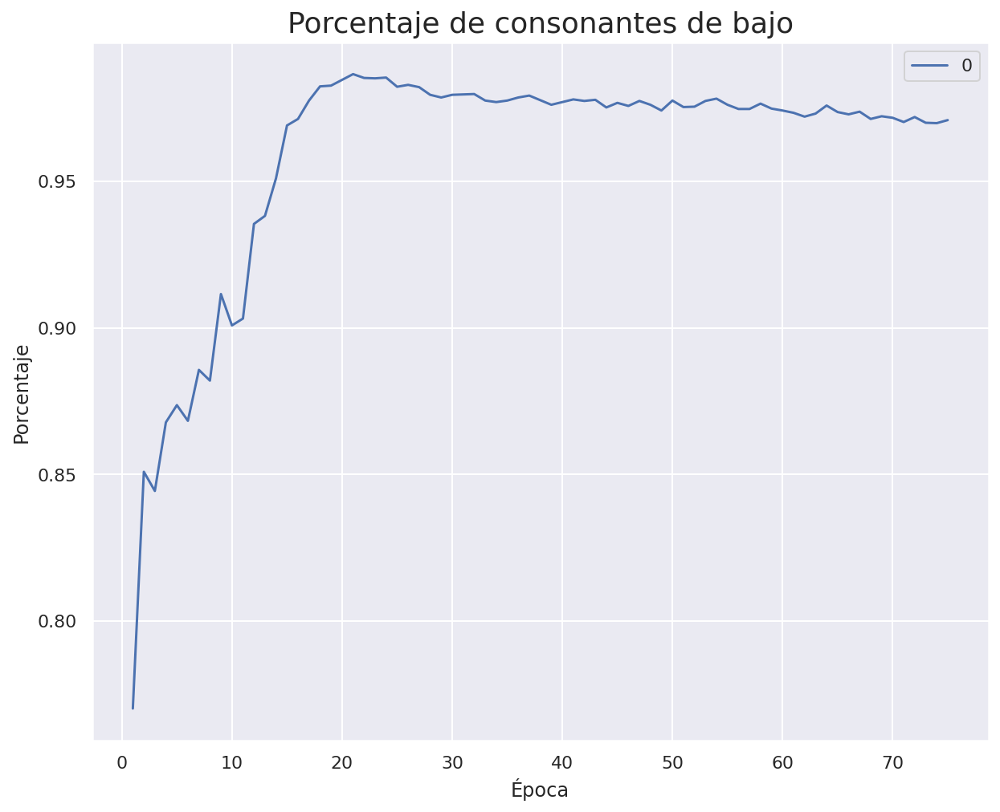

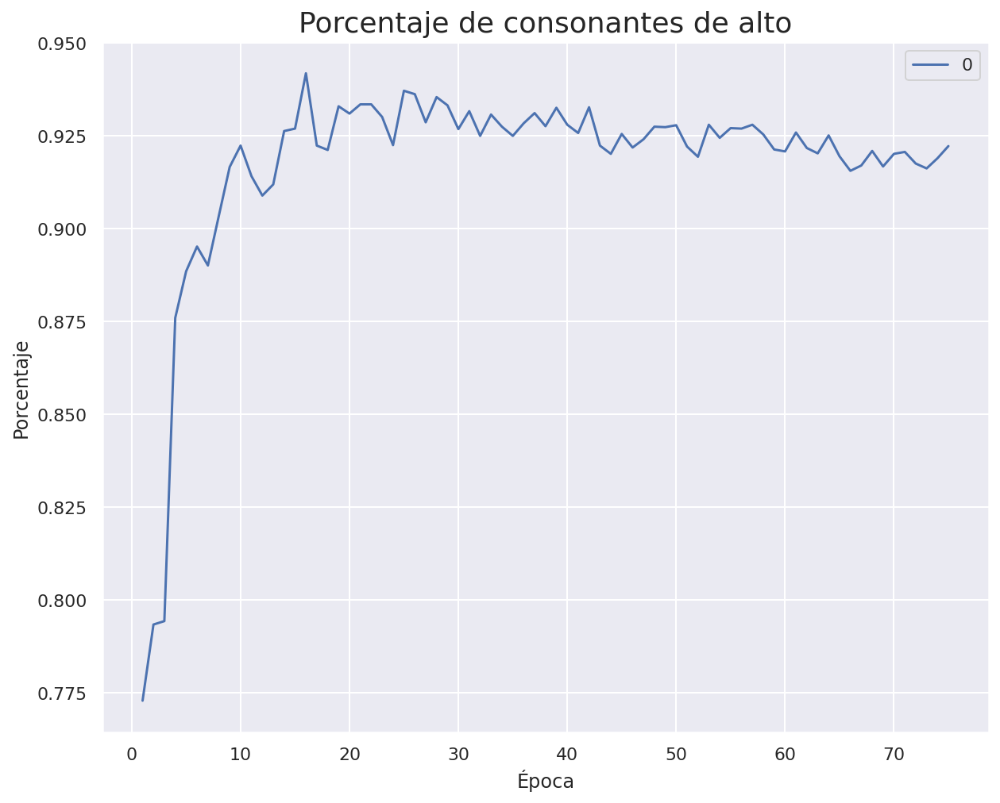

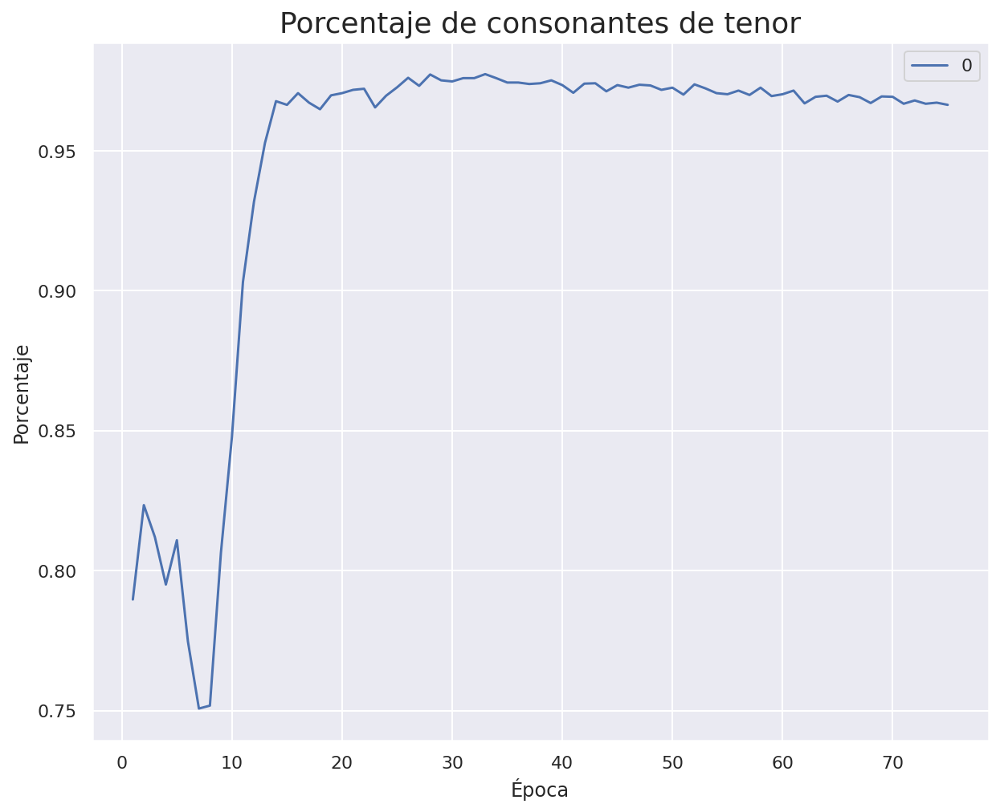

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_38 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_38 (LSTM)                 (None, 29)           6264        ['embedding_38[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

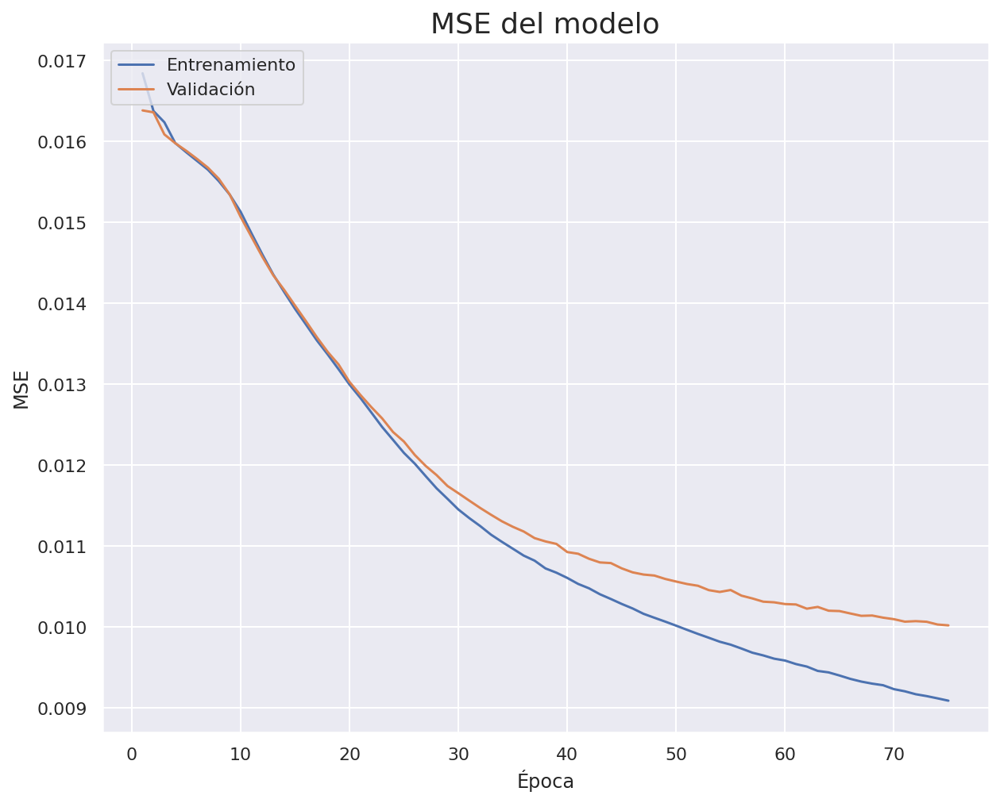

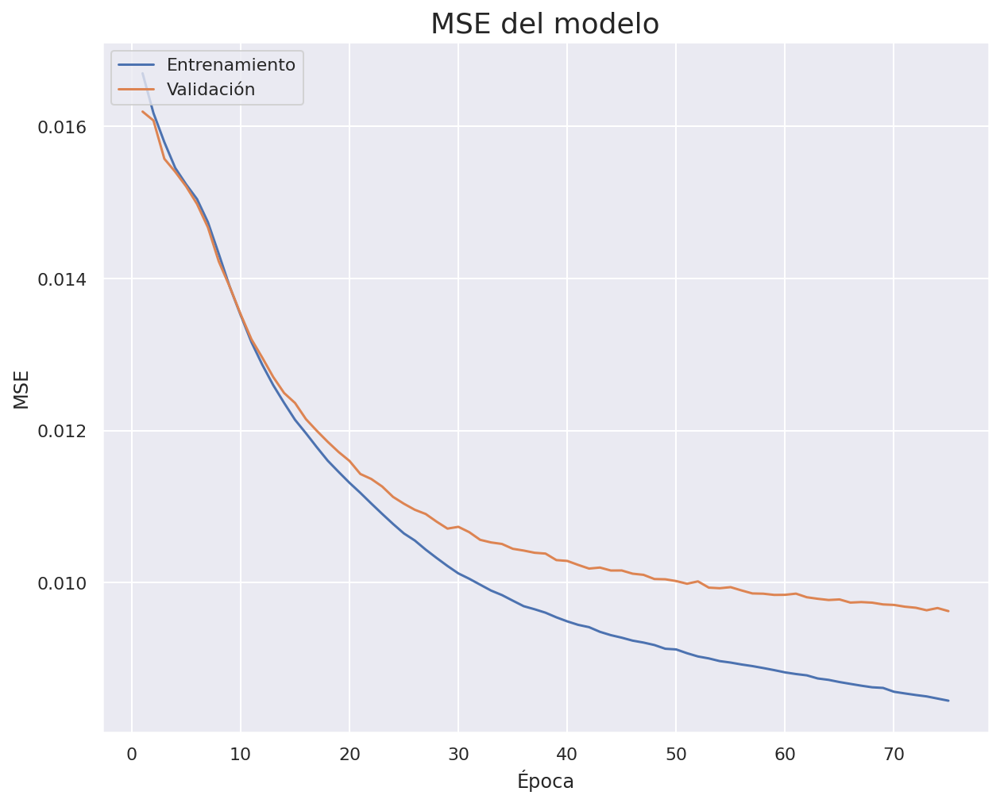

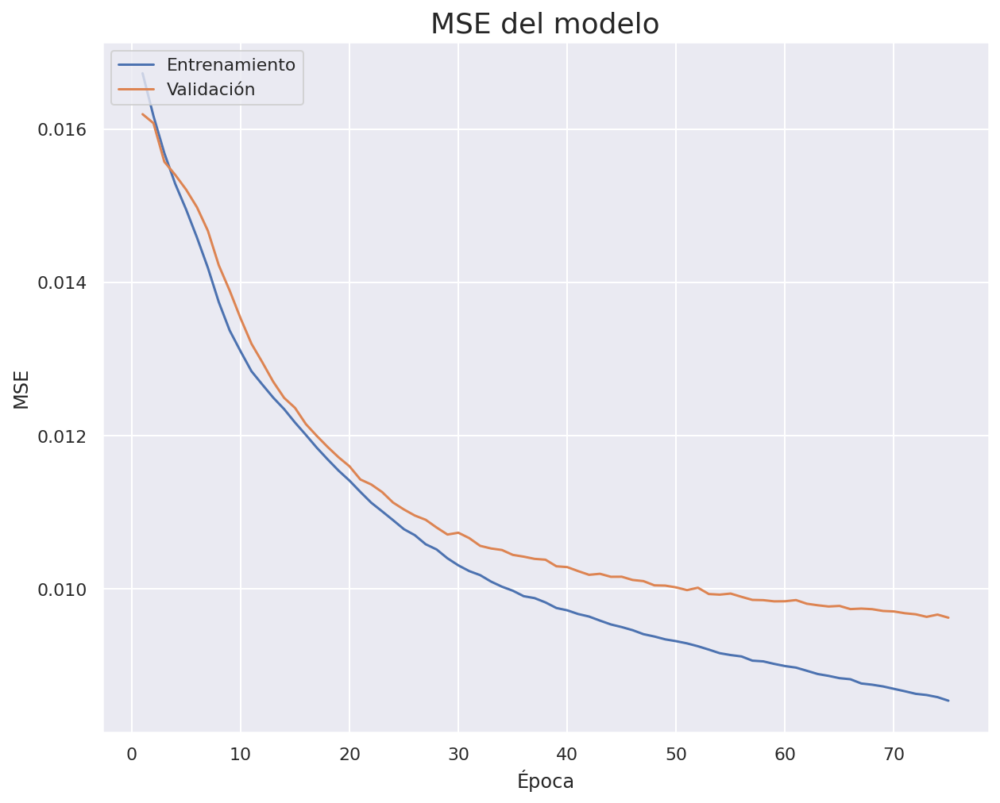

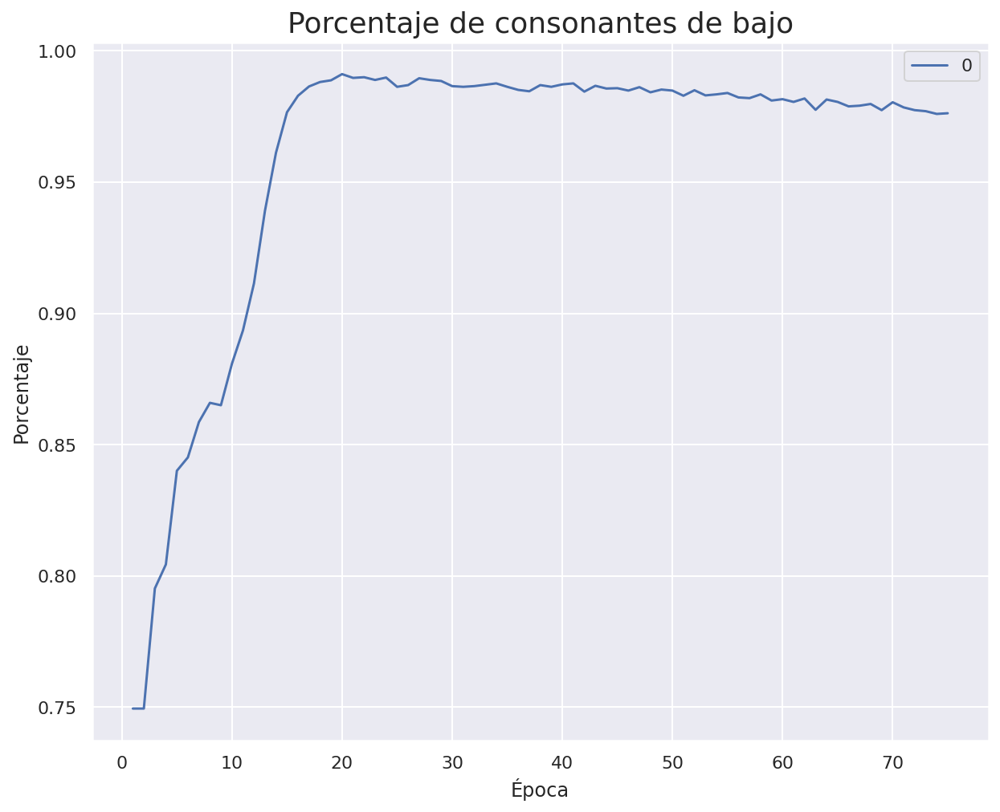

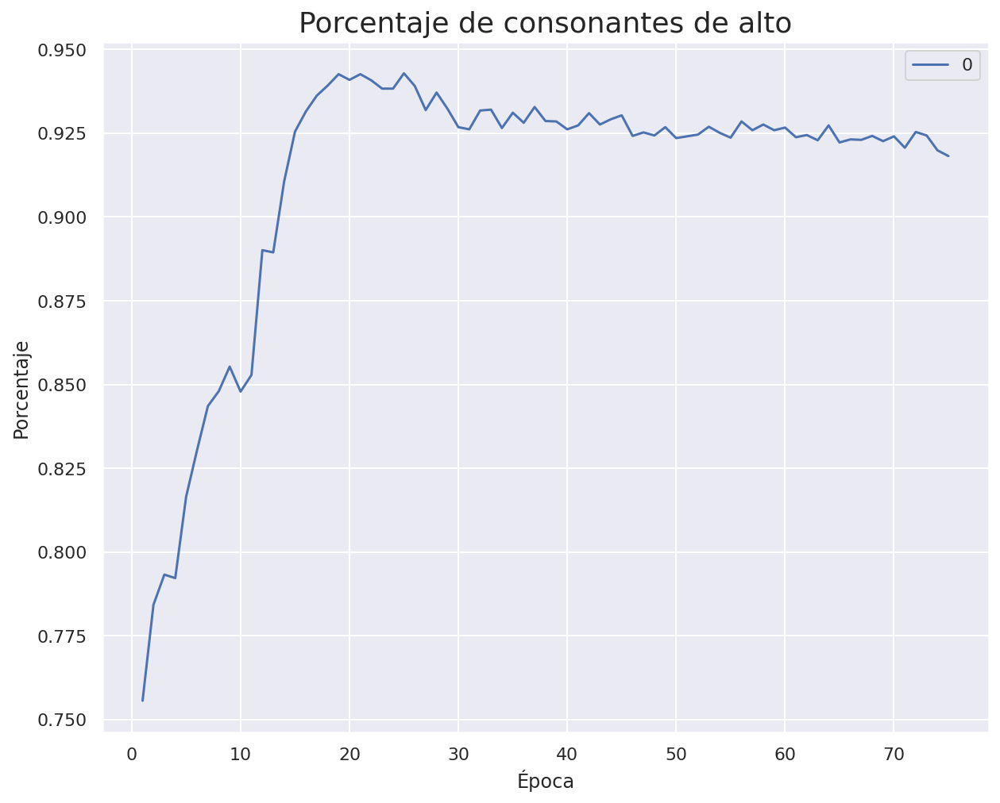

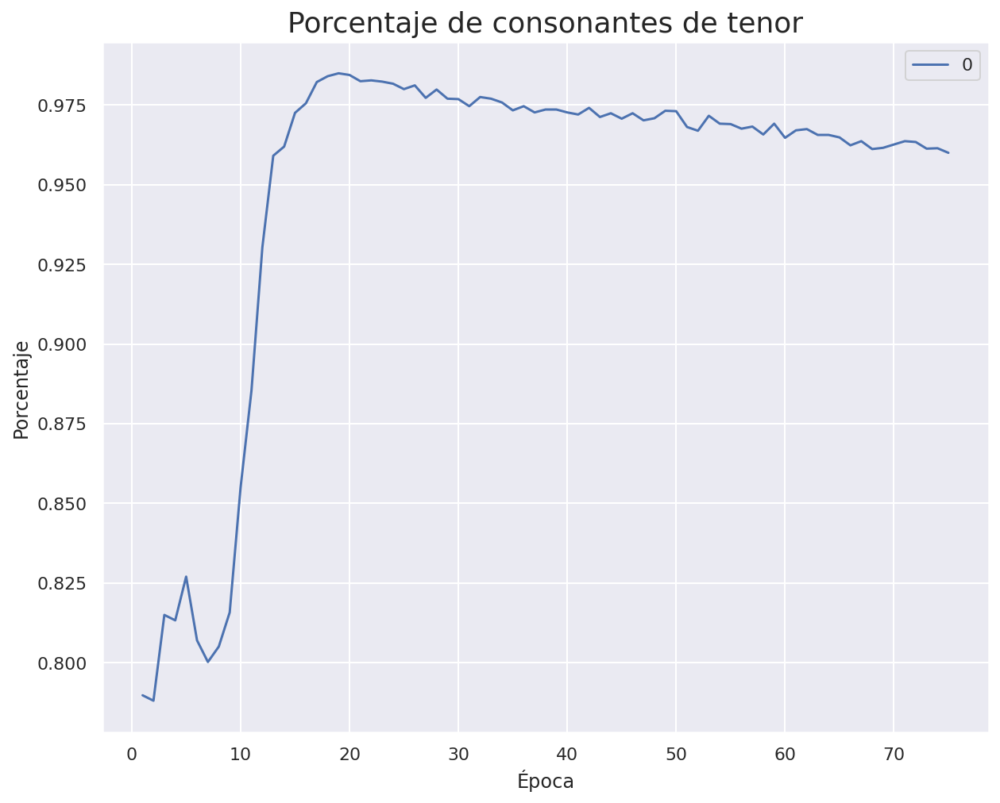

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_40 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_40 (LSTM)                 (None, 30)           6600        ['embedding_40[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

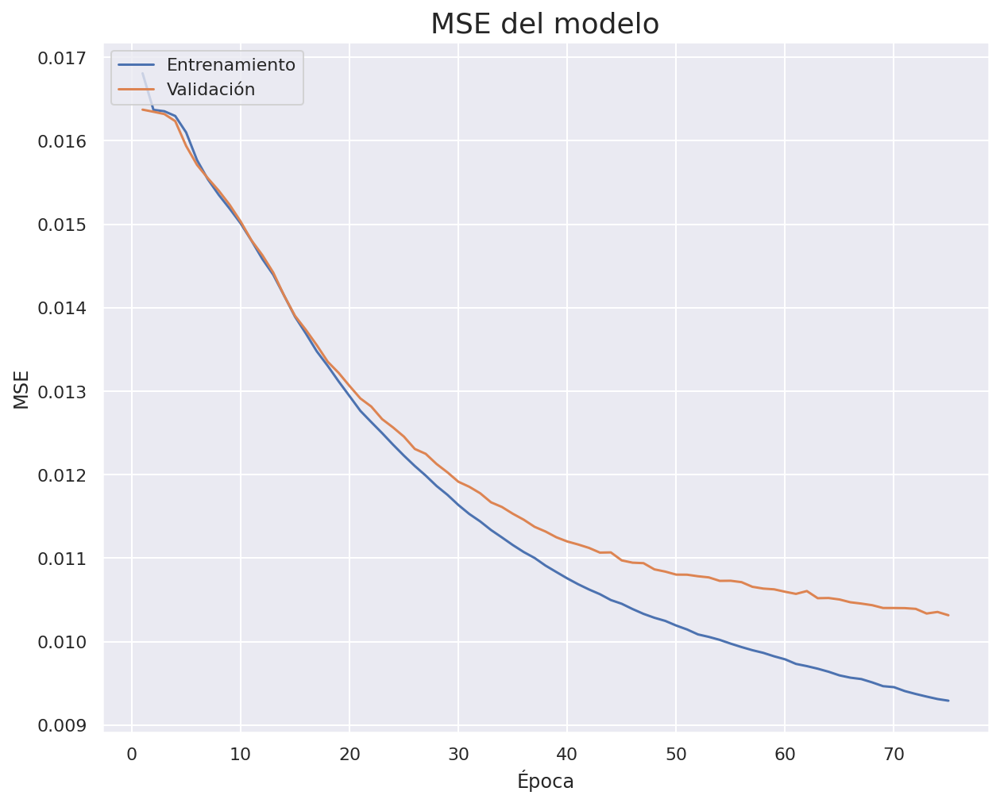

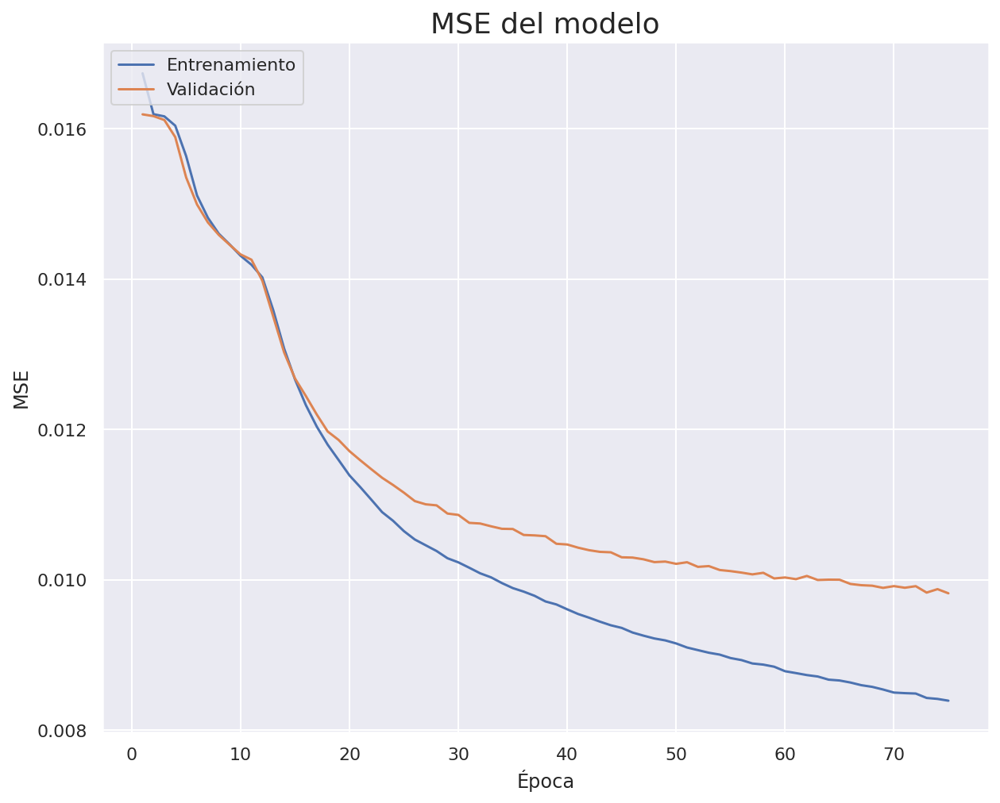

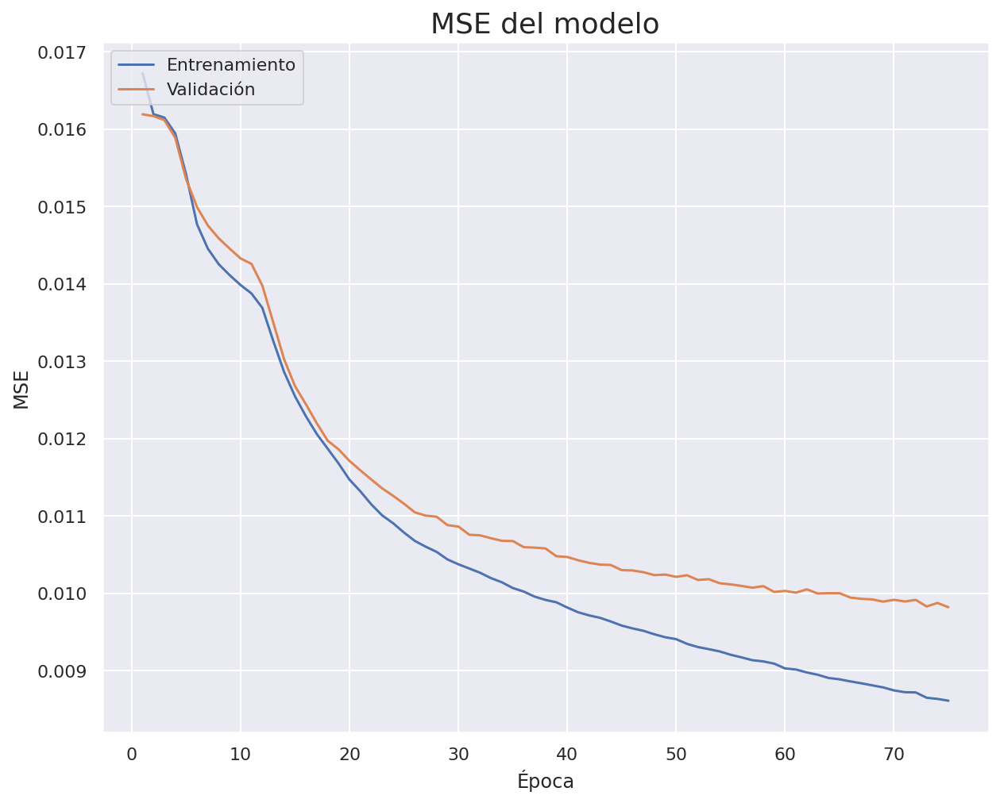

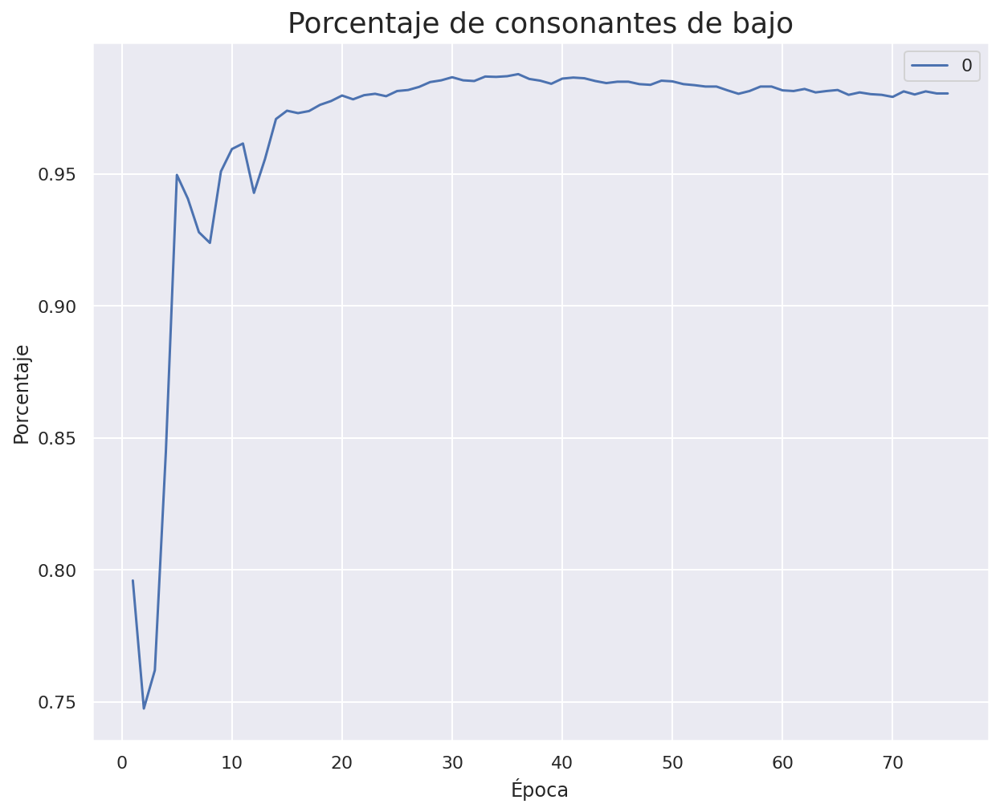

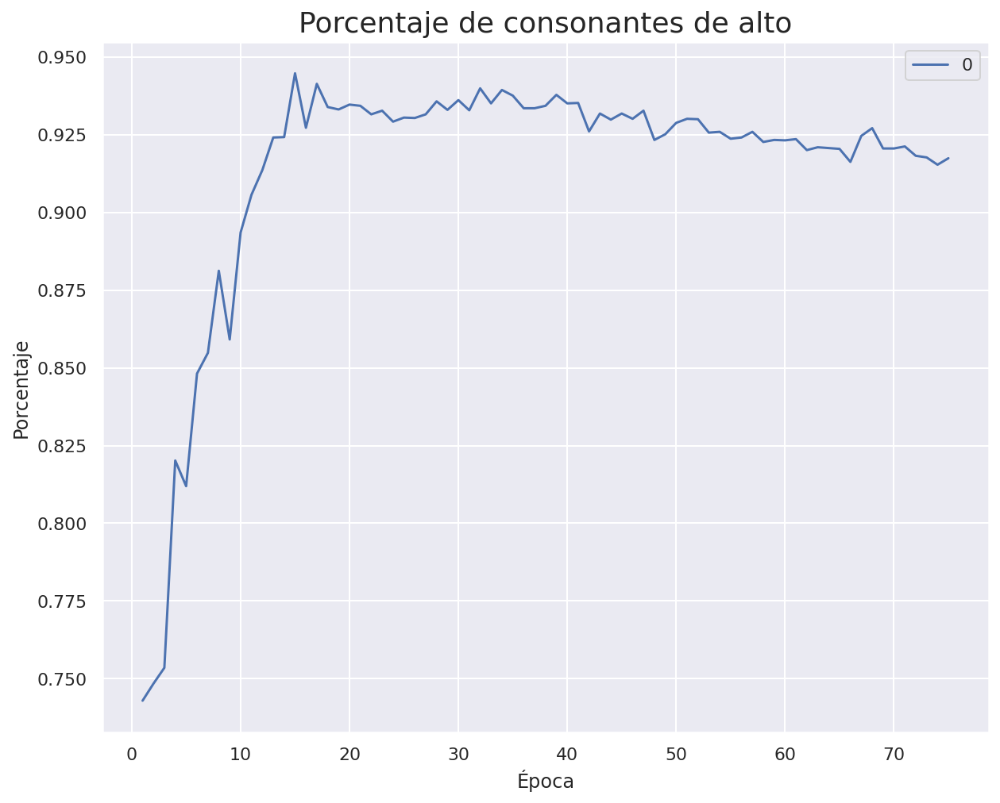

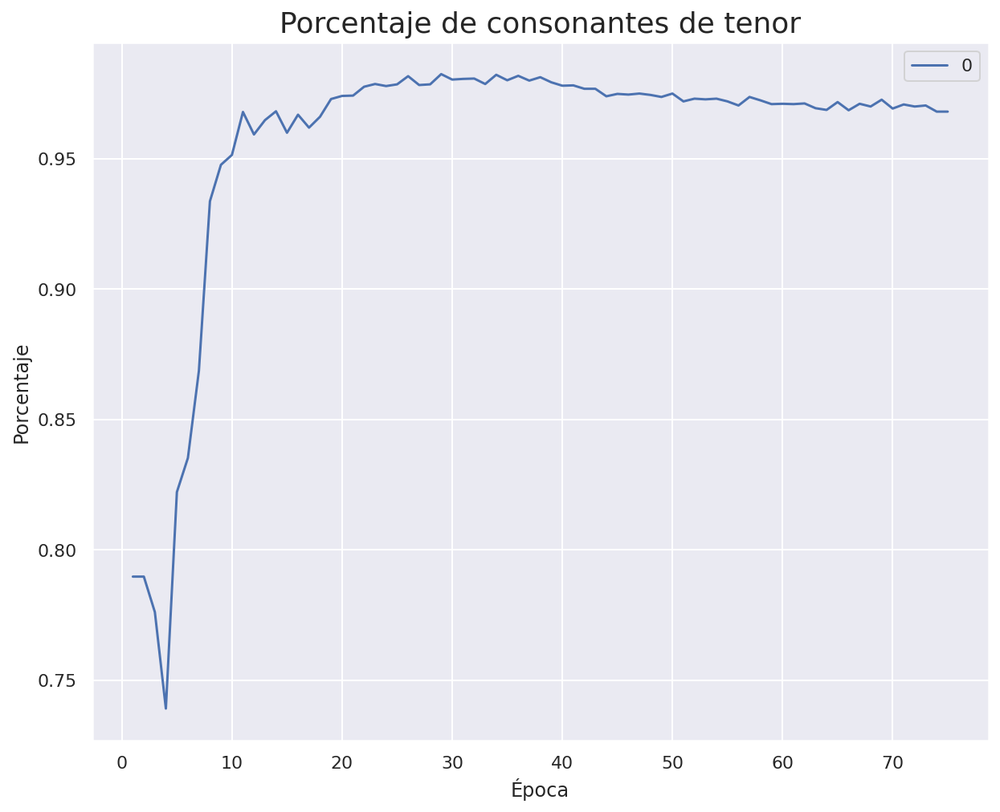

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_42 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_42 (LSTM)                 (None, 31)           6944        ['embedding_42[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

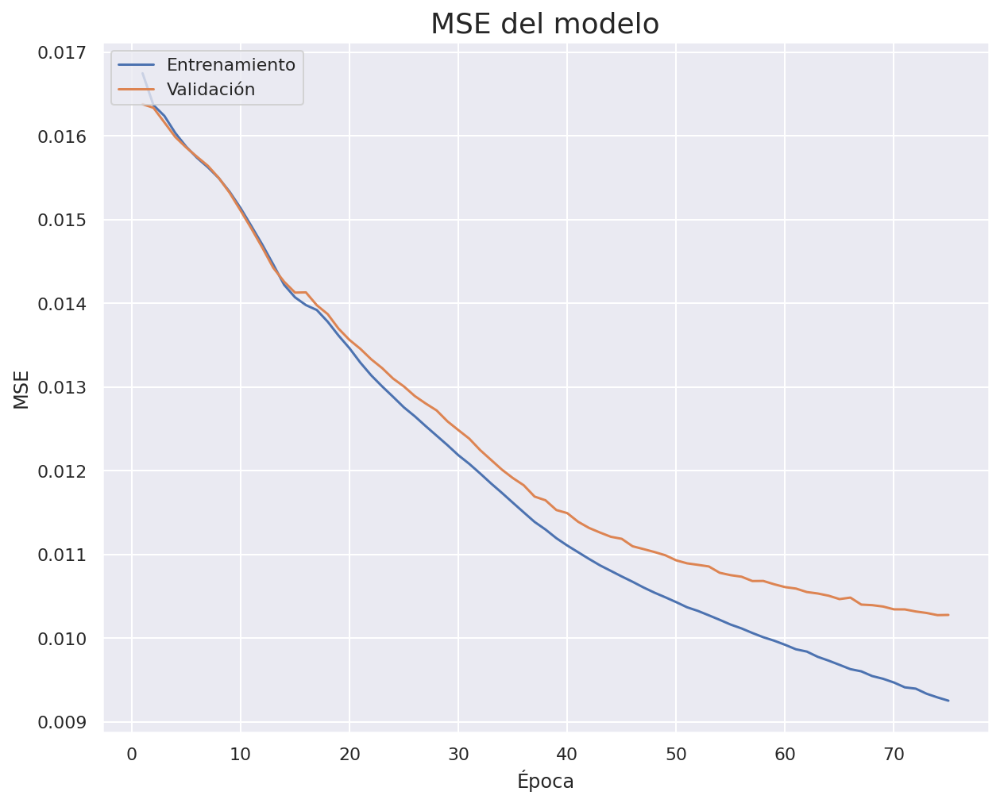

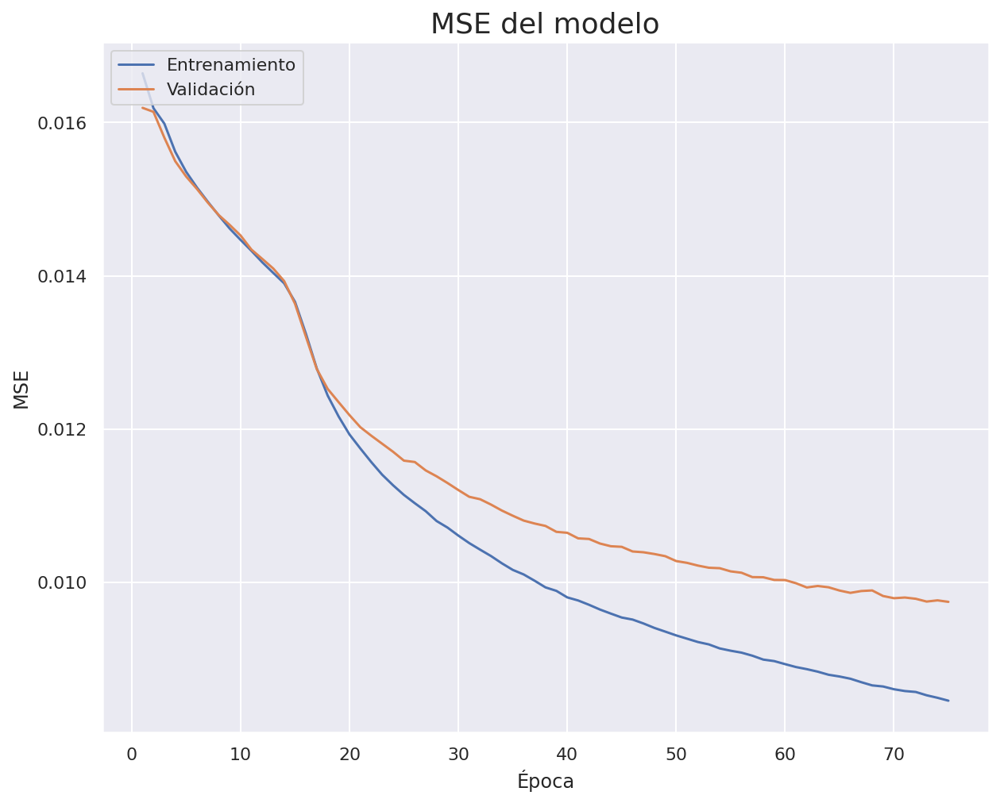

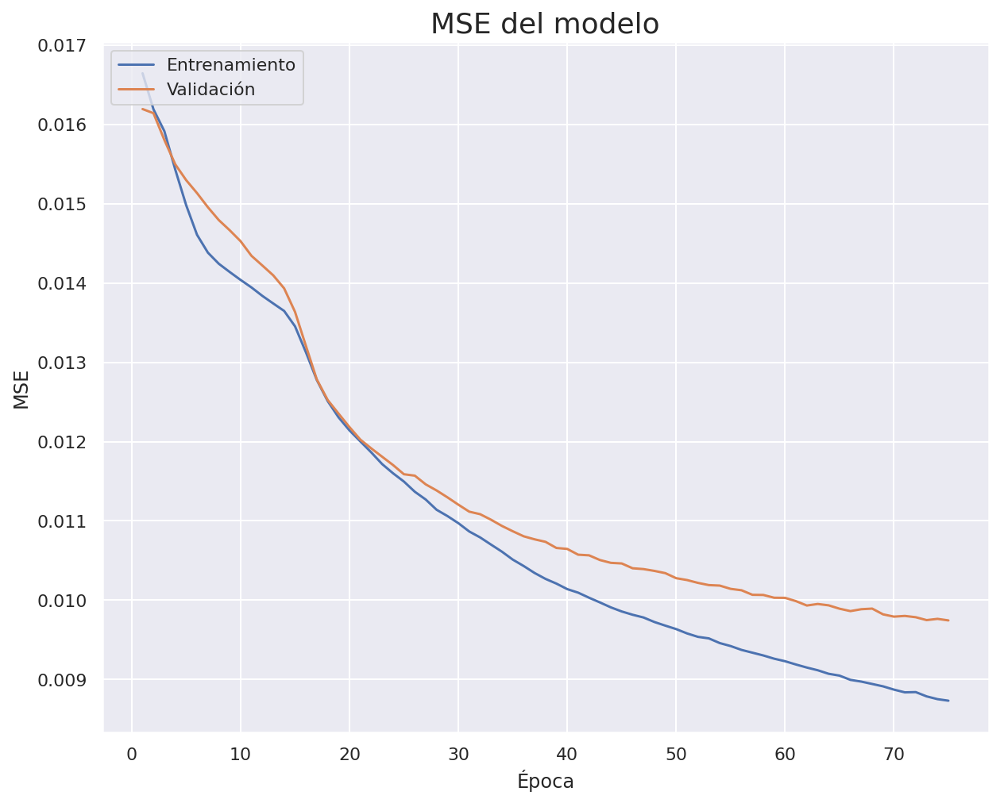

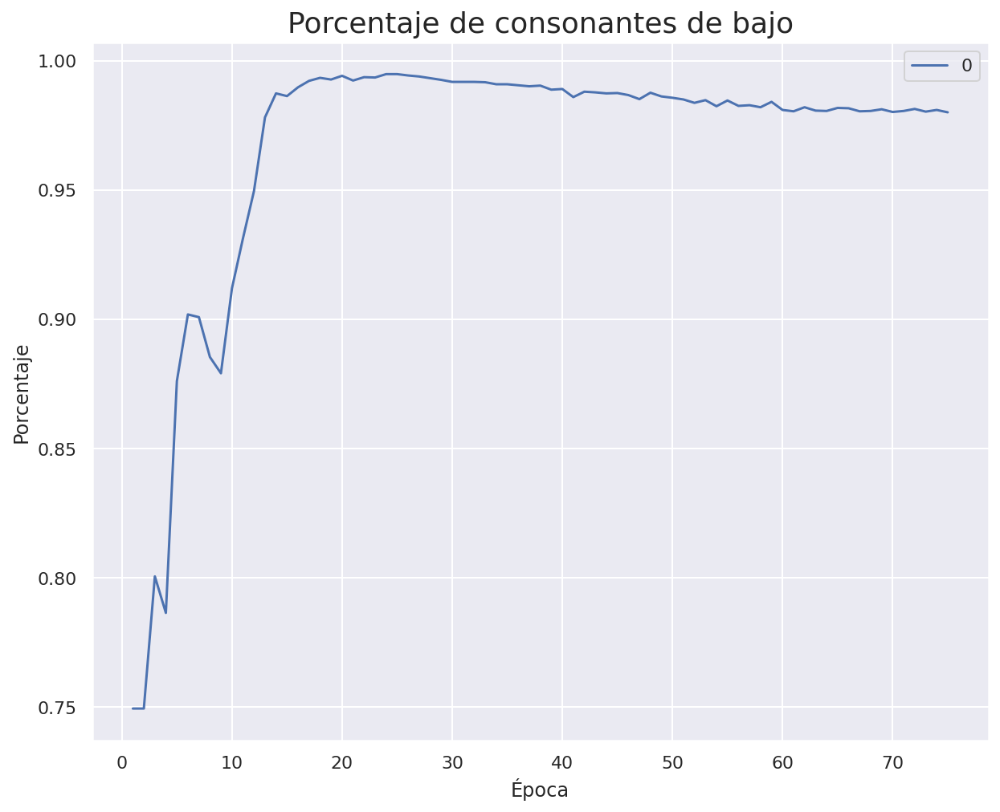

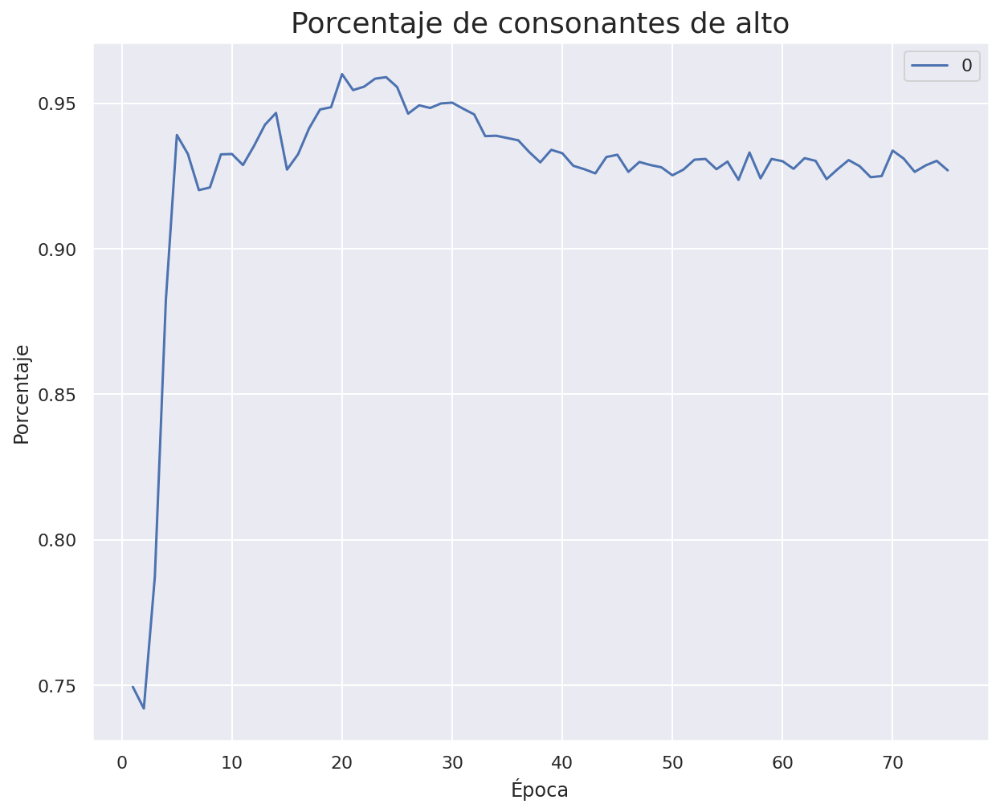

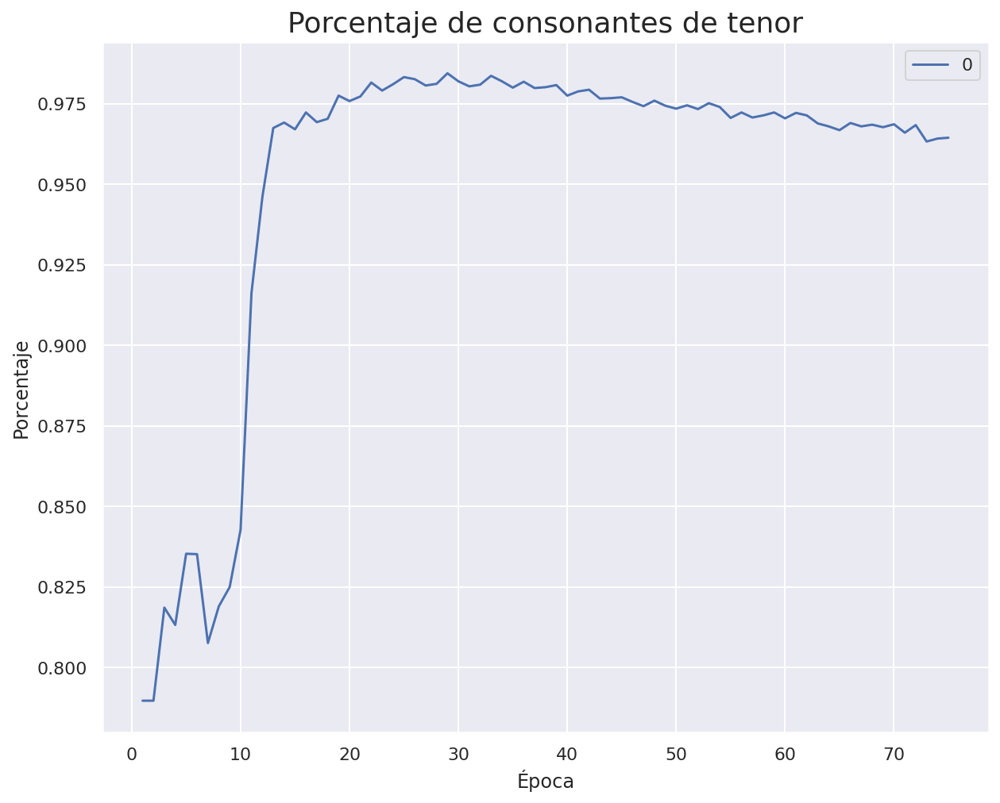

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_44 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_44 (LSTM)                 (None, 32)           7296        ['embedding_44[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

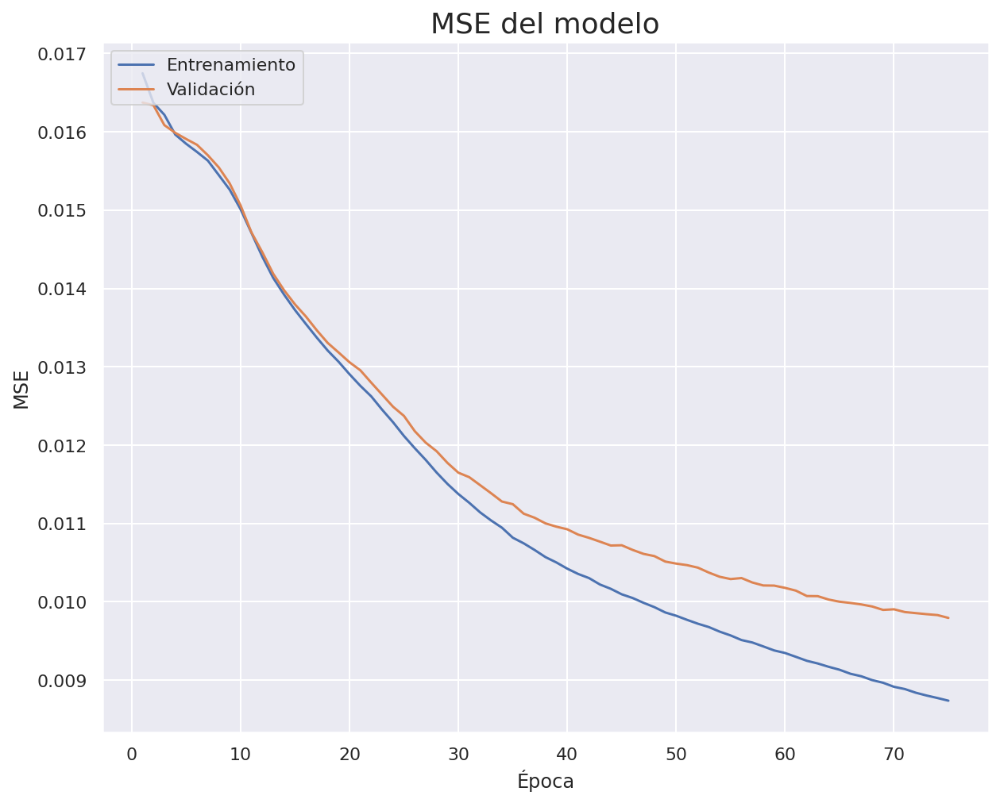

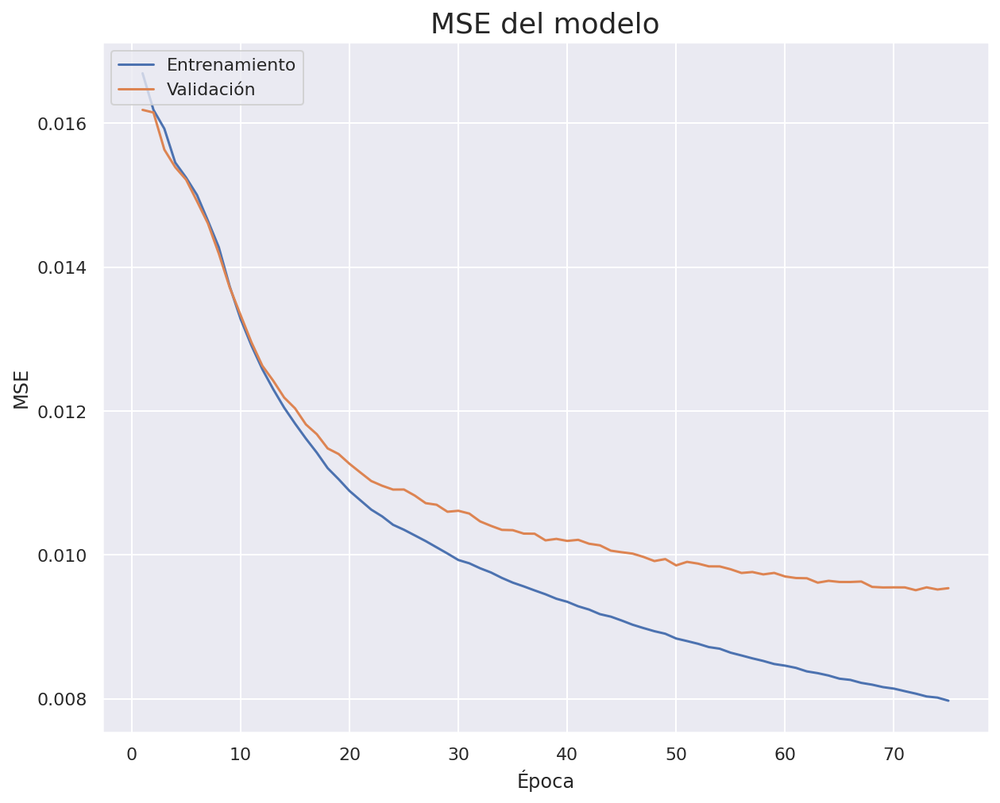

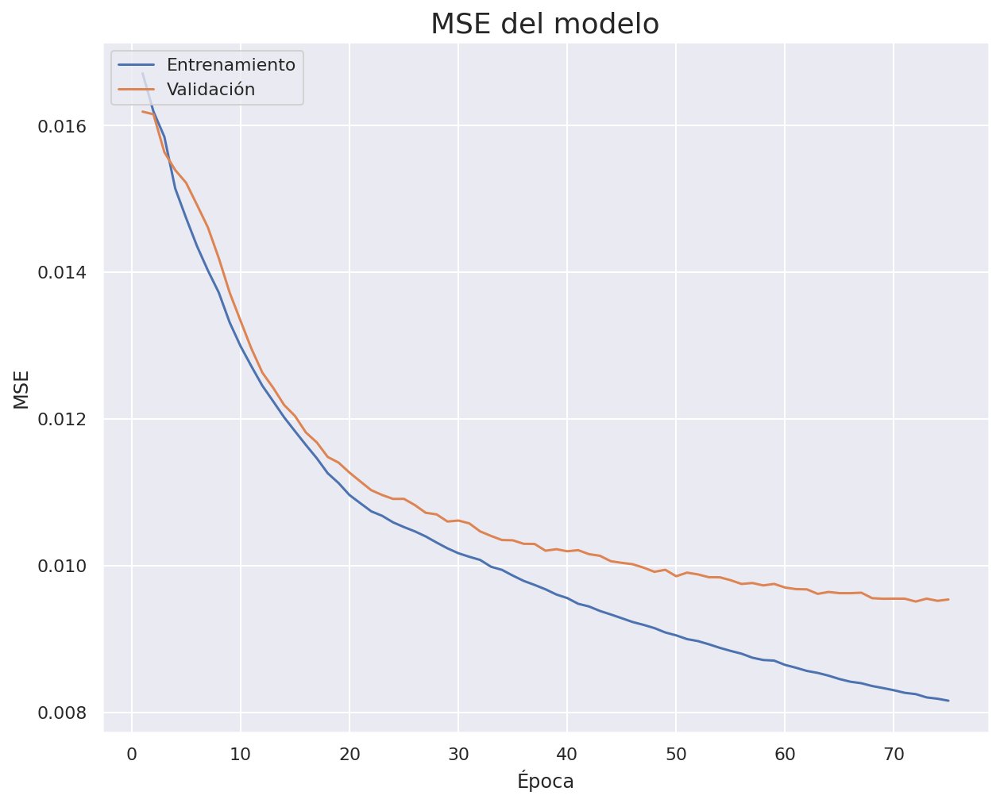

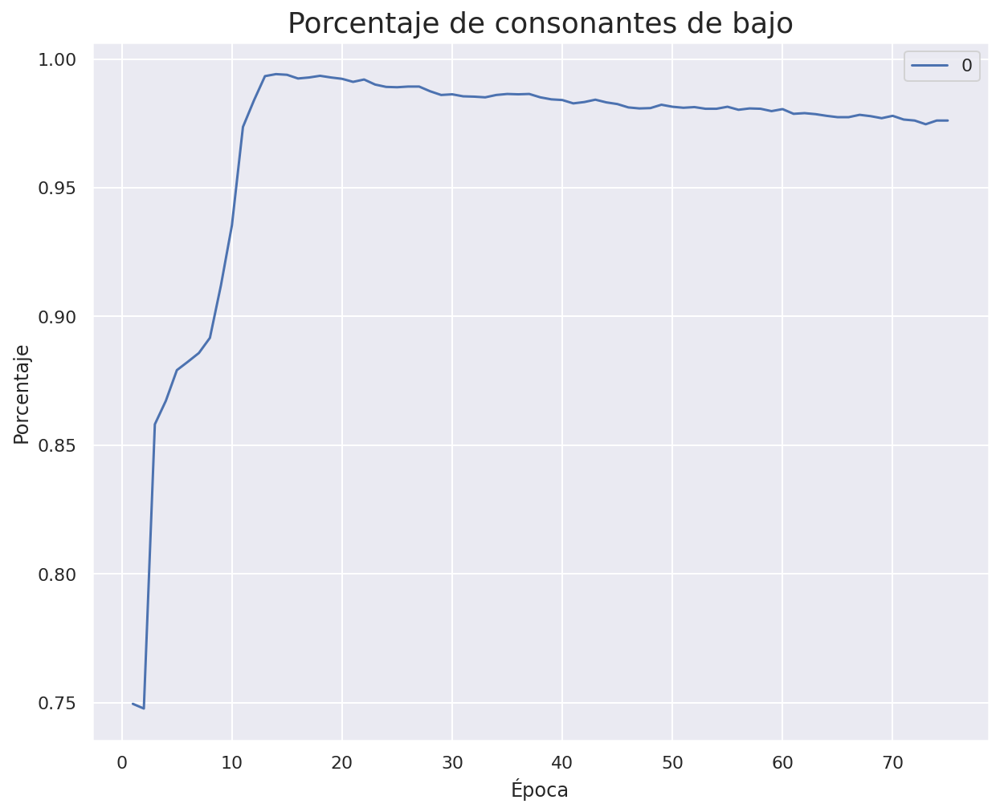

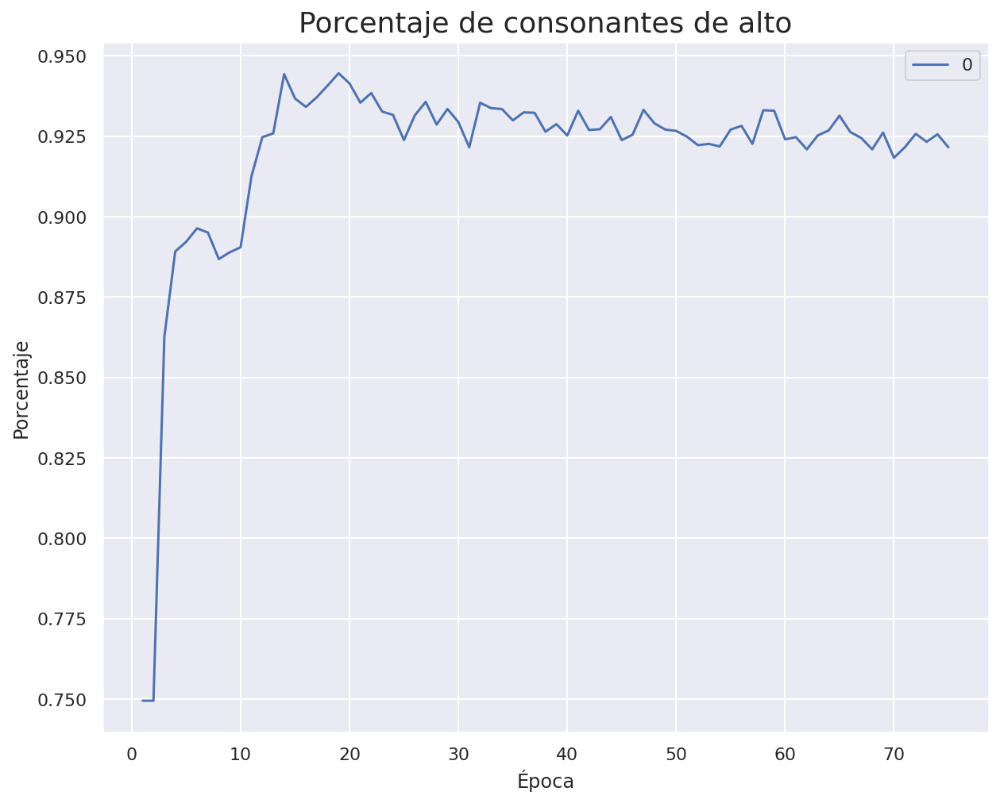

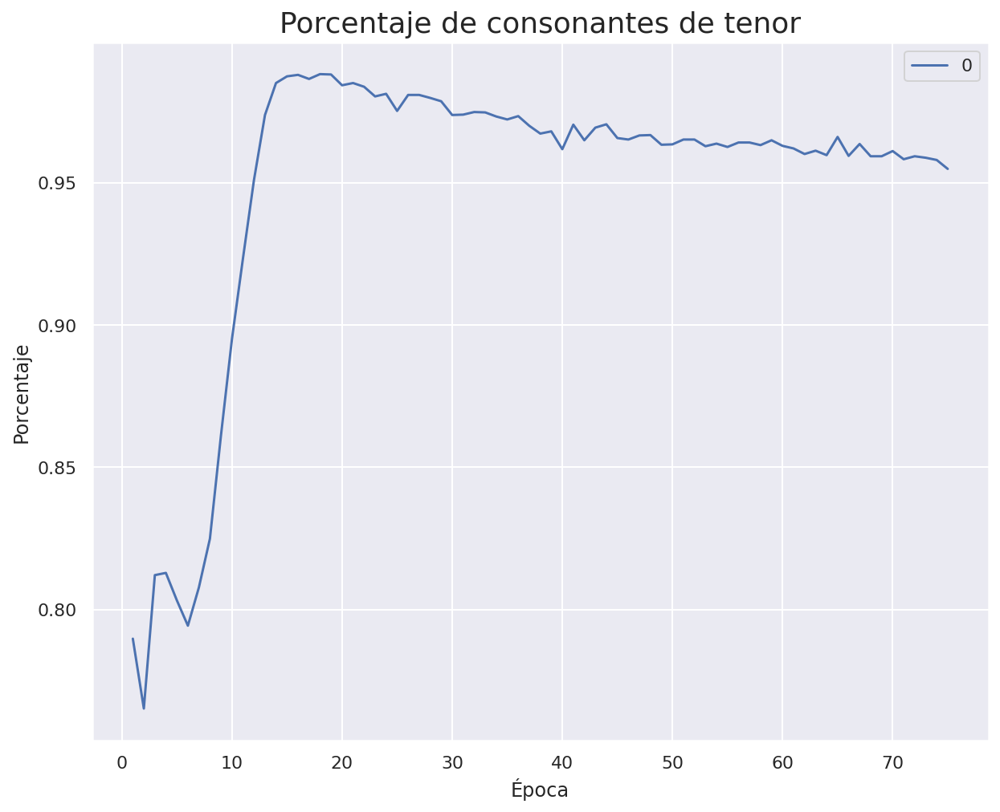

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_46 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_46 (LSTM)                 (None, 33)           7656        ['embedding_46[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

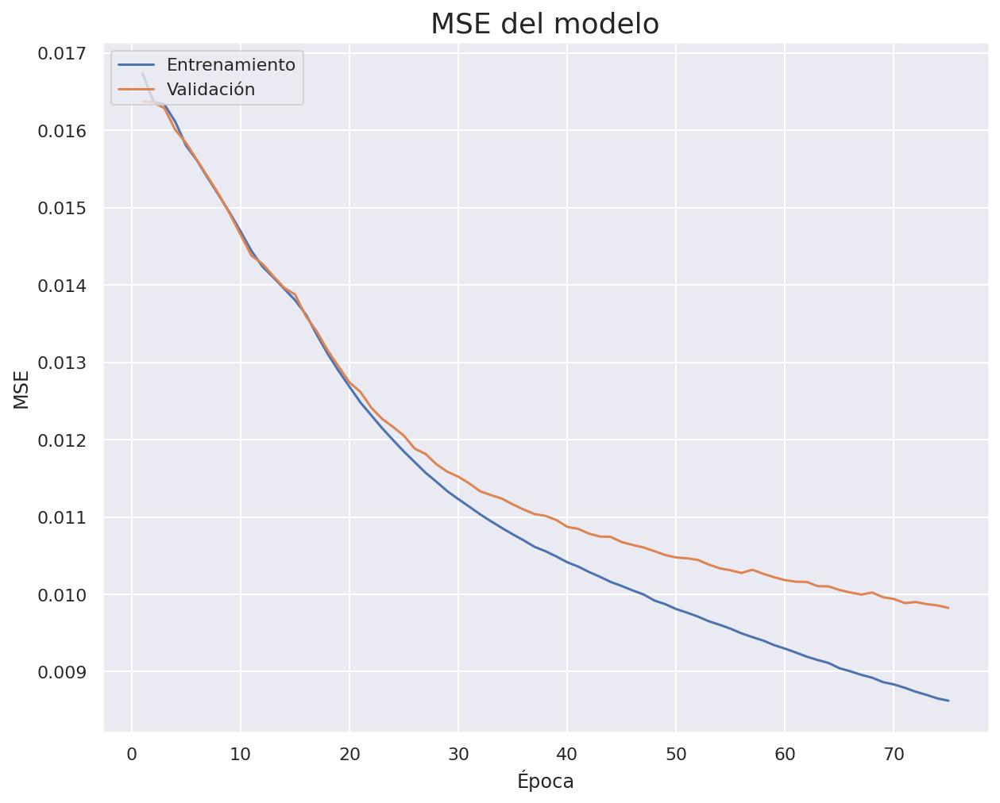

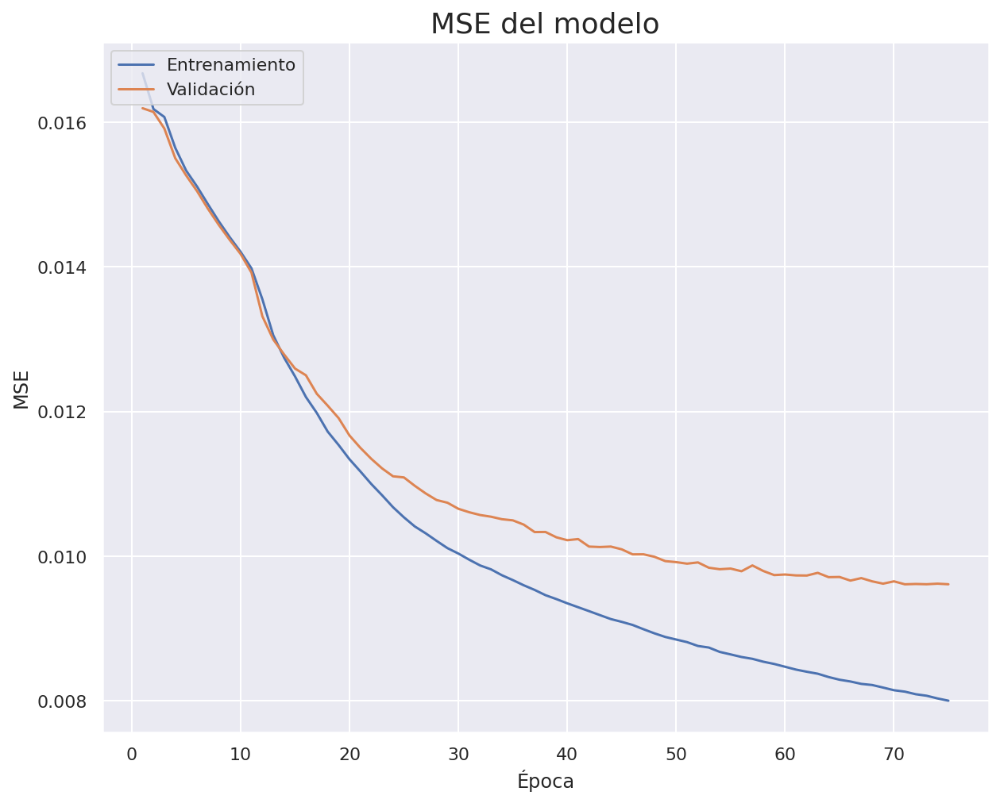

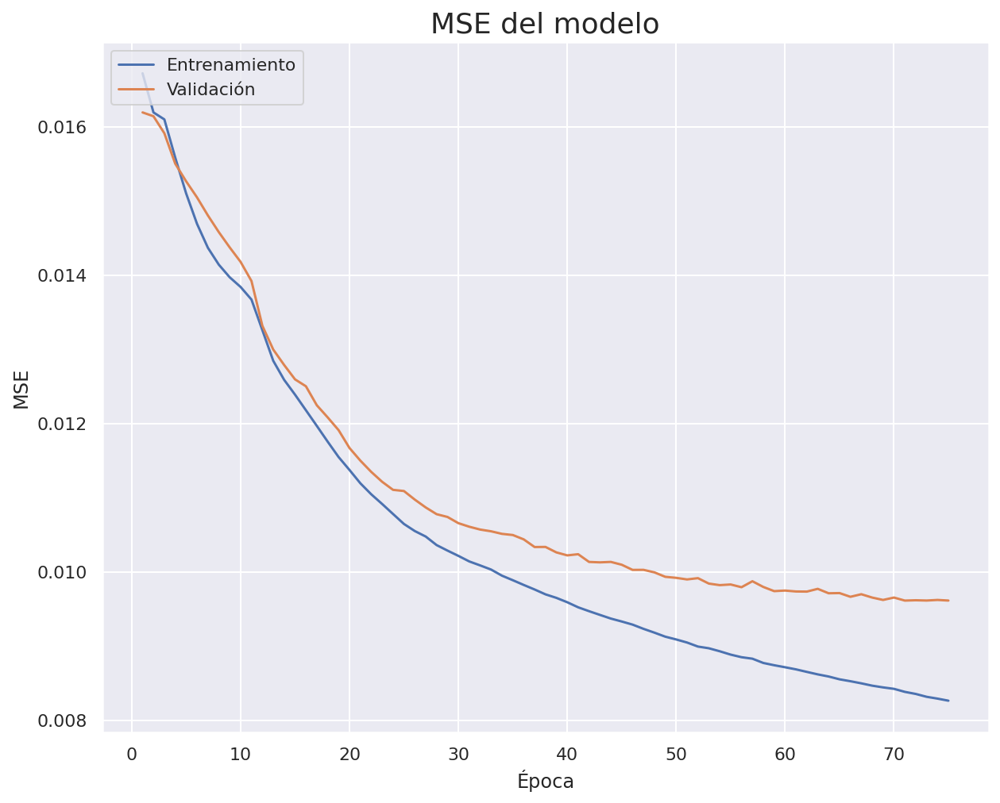

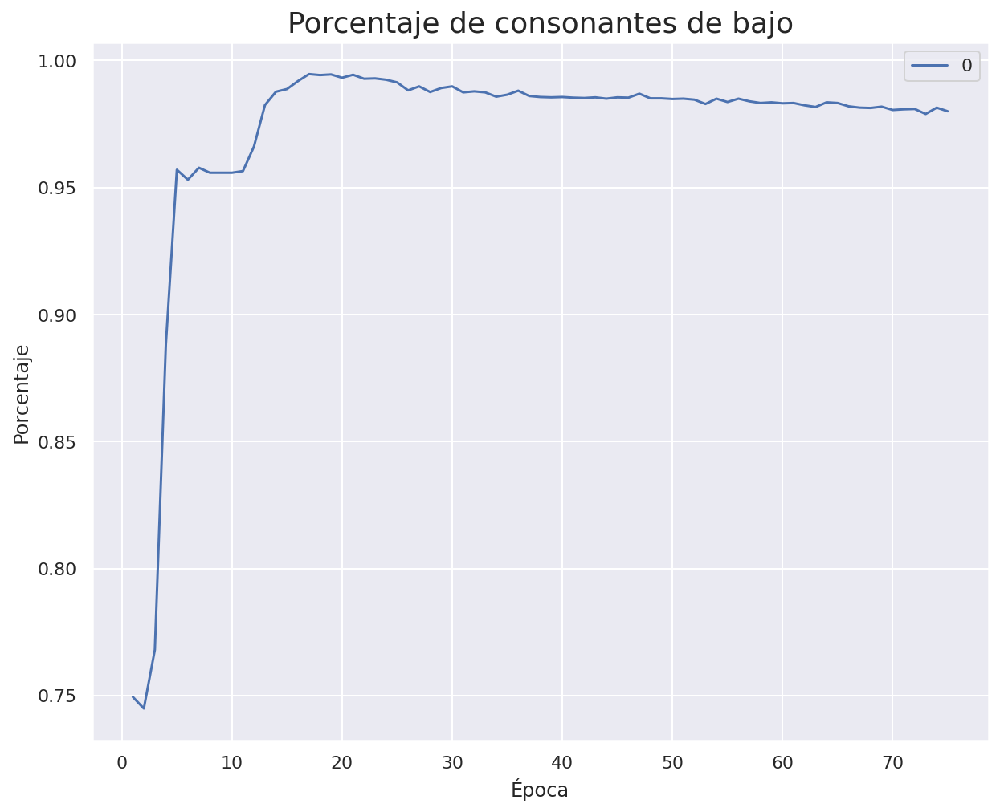

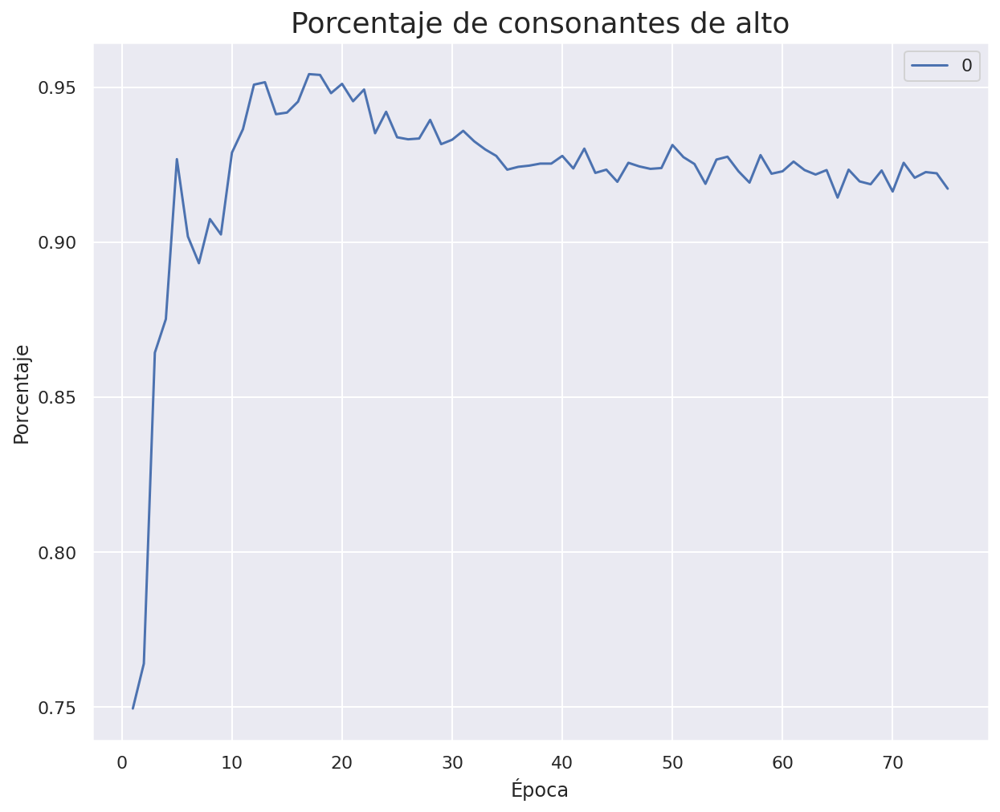

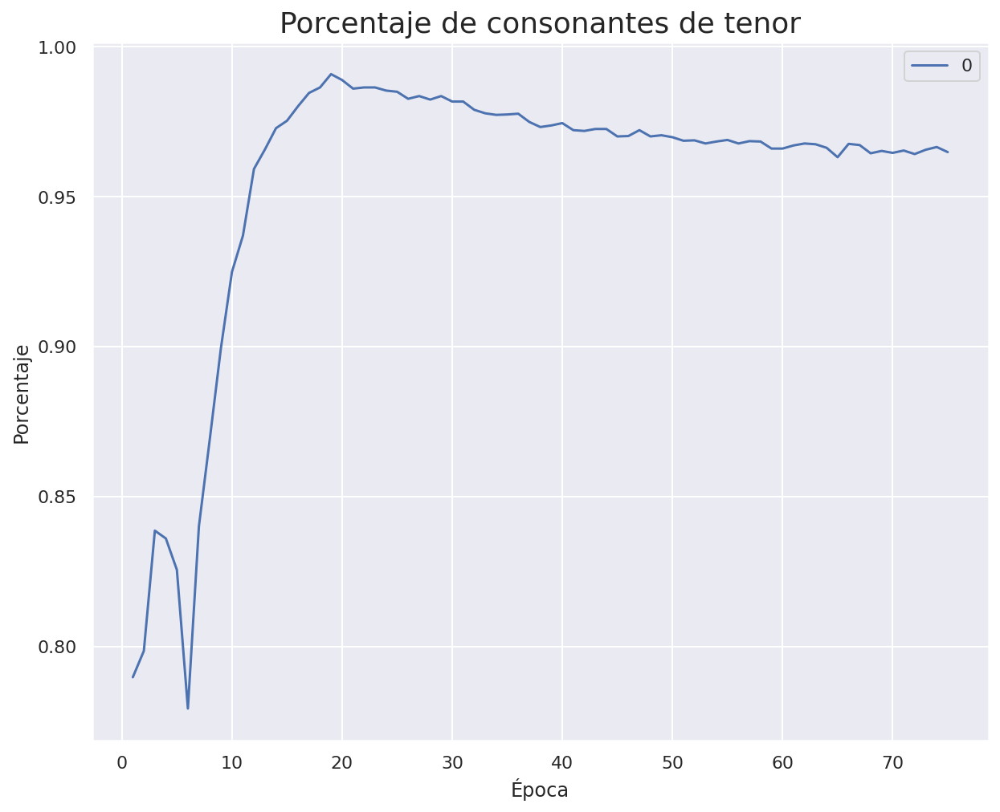

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_48 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_48 (LSTM)                 (None, 34)           8024        ['embedding_48[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

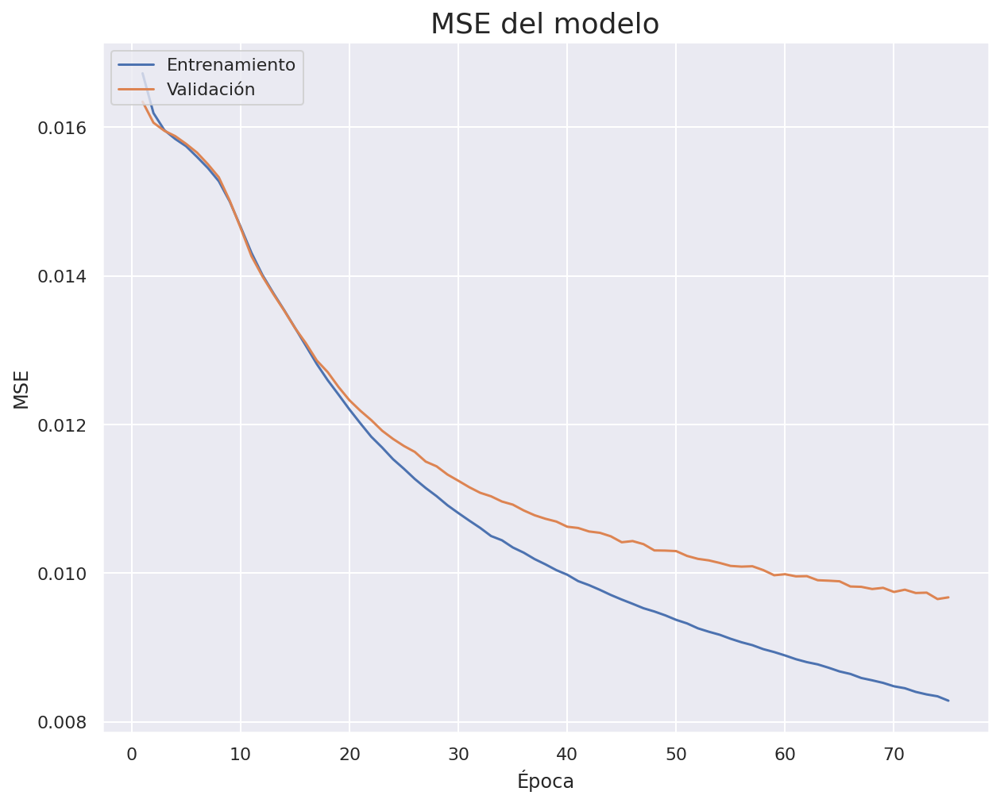

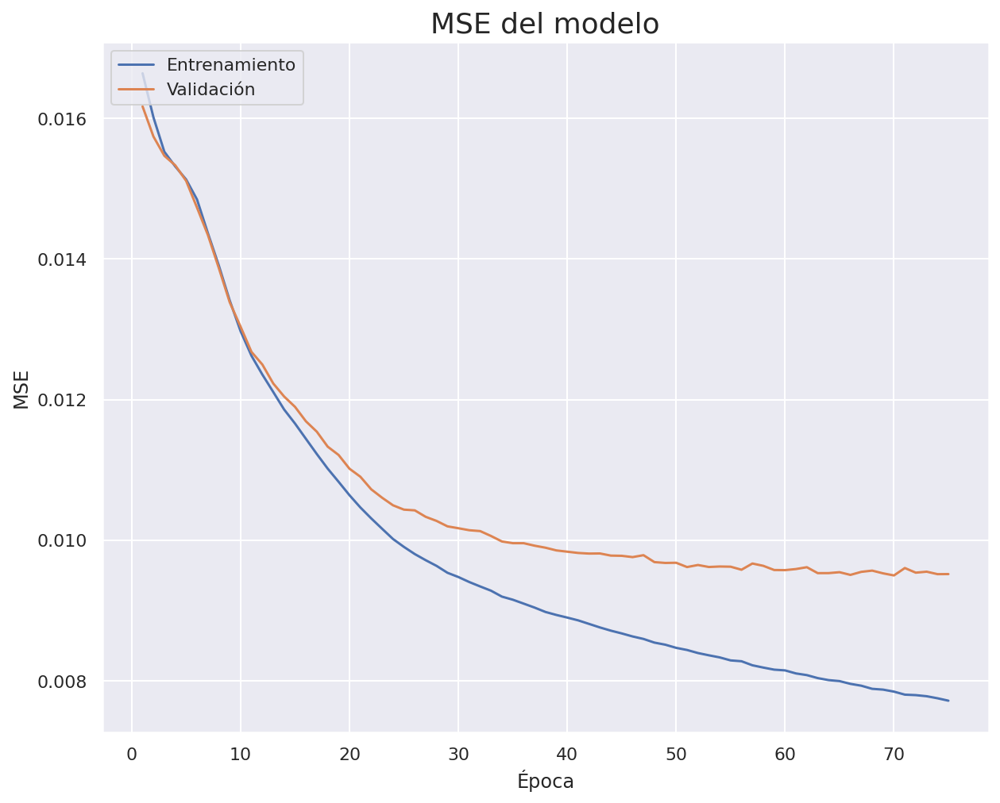

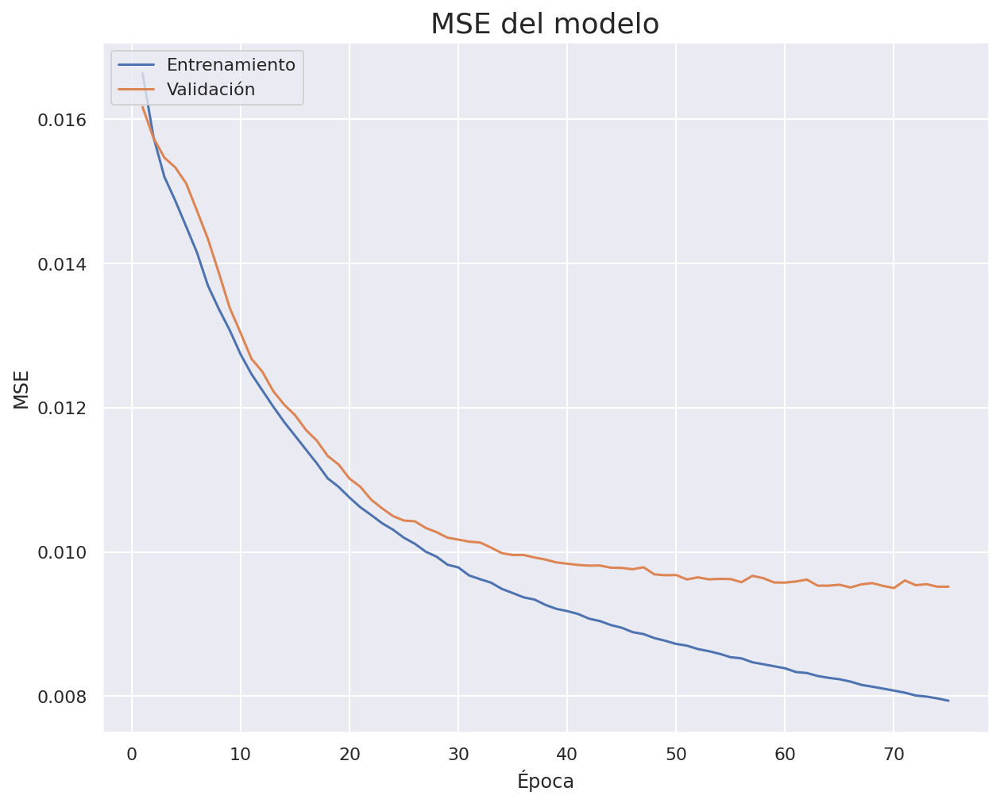

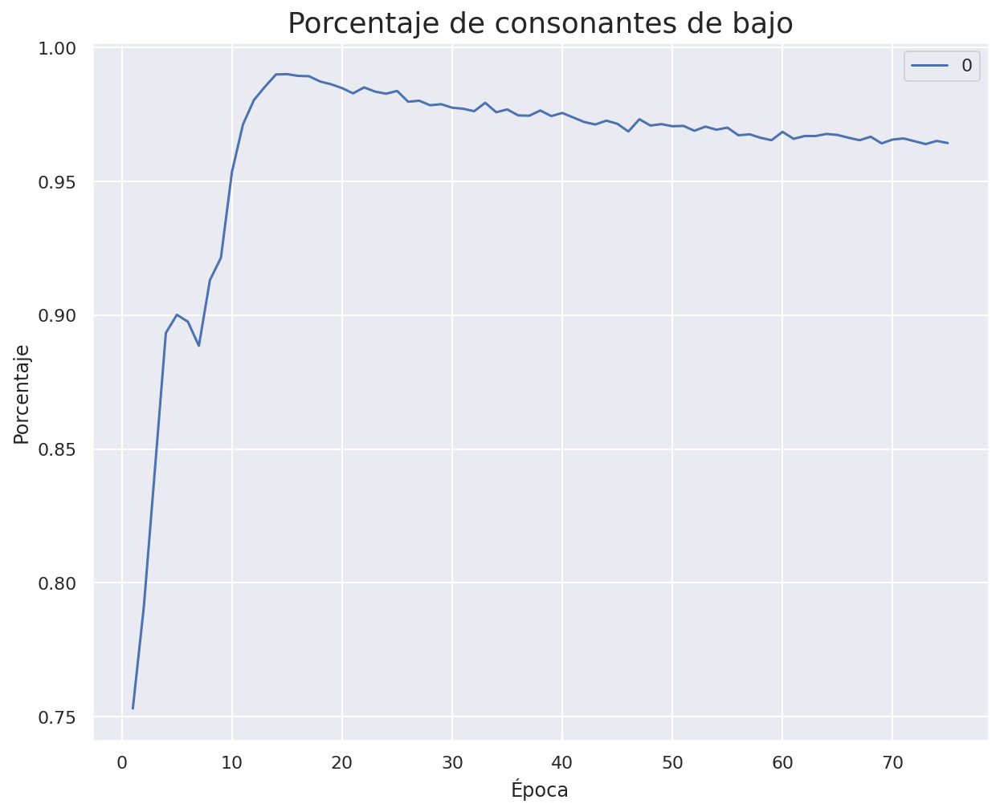

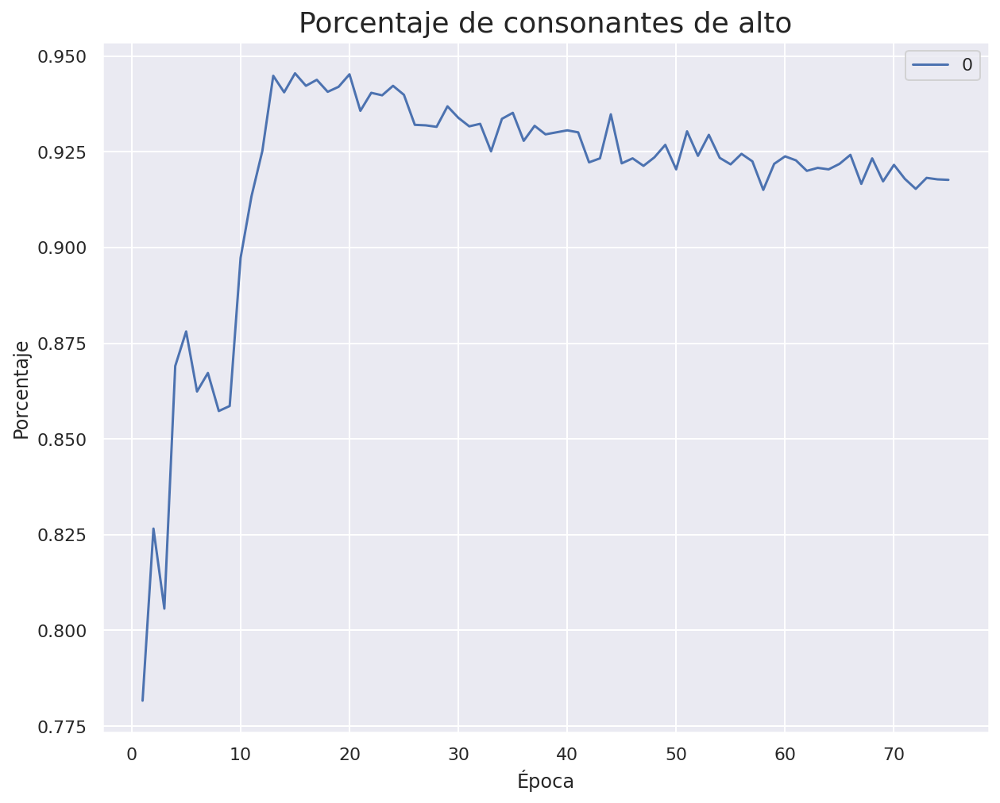

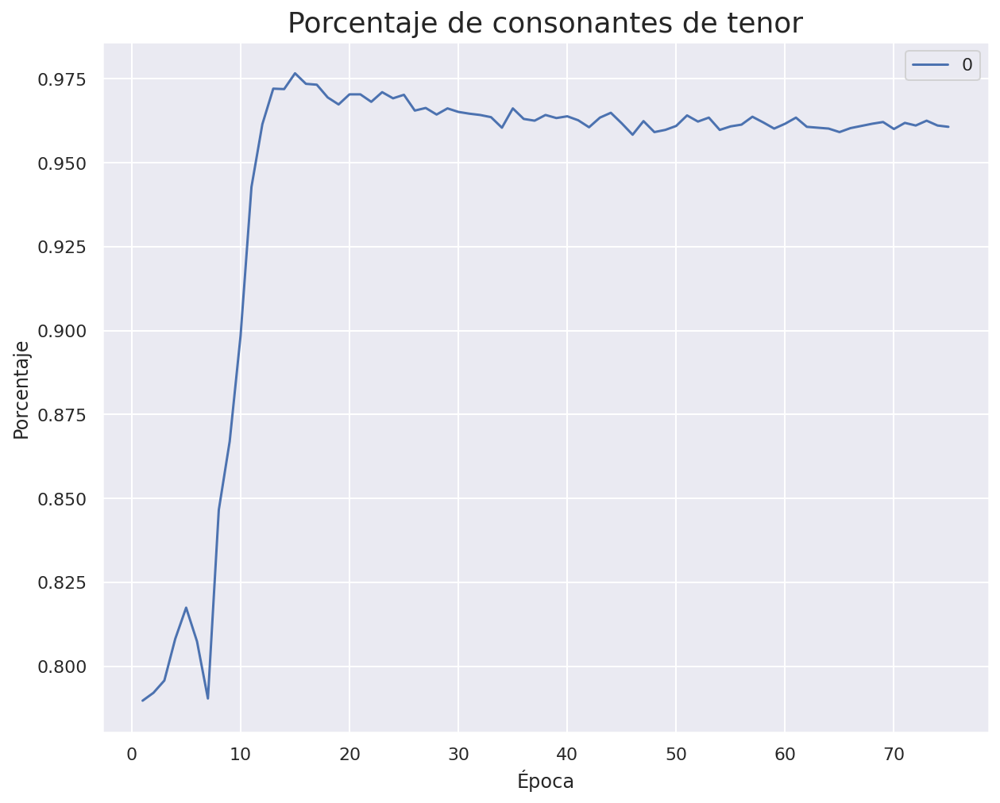

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_50 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_50 (LSTM)                 (None, 35)           8400        ['embedding_50[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

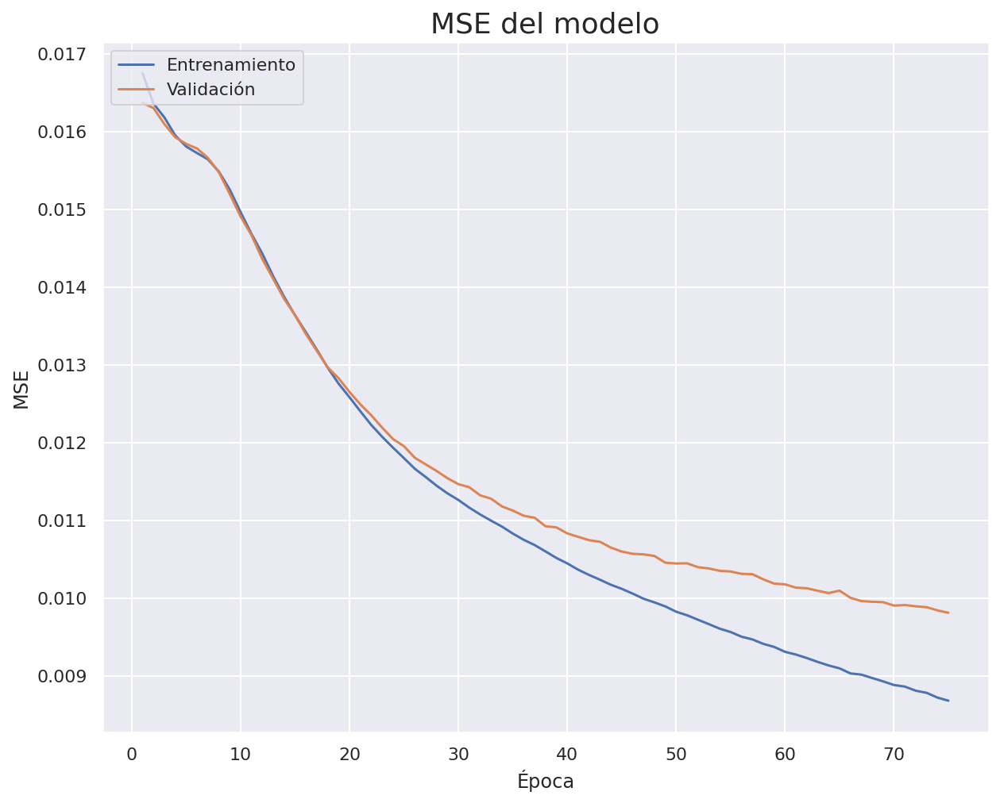

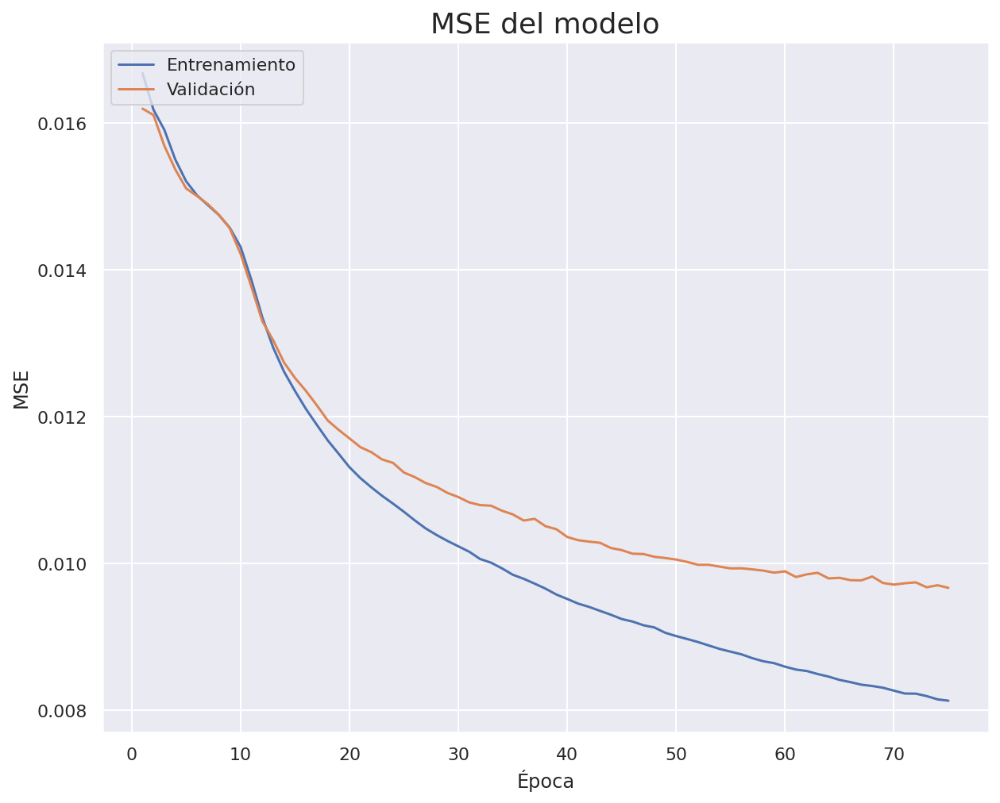

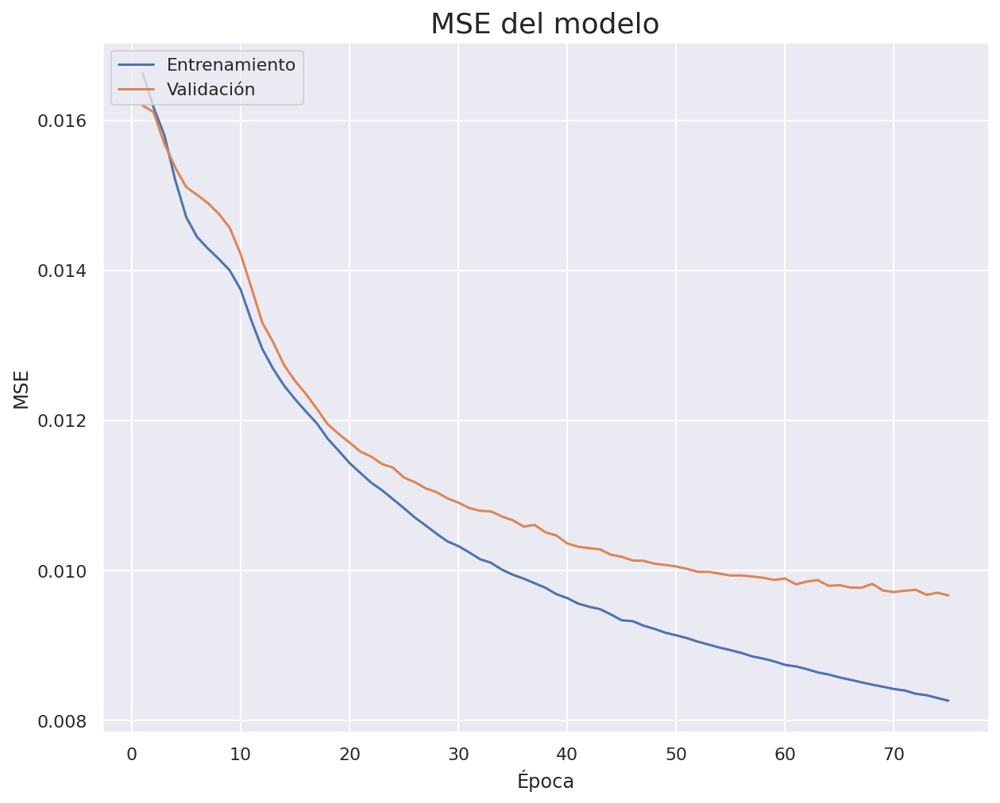

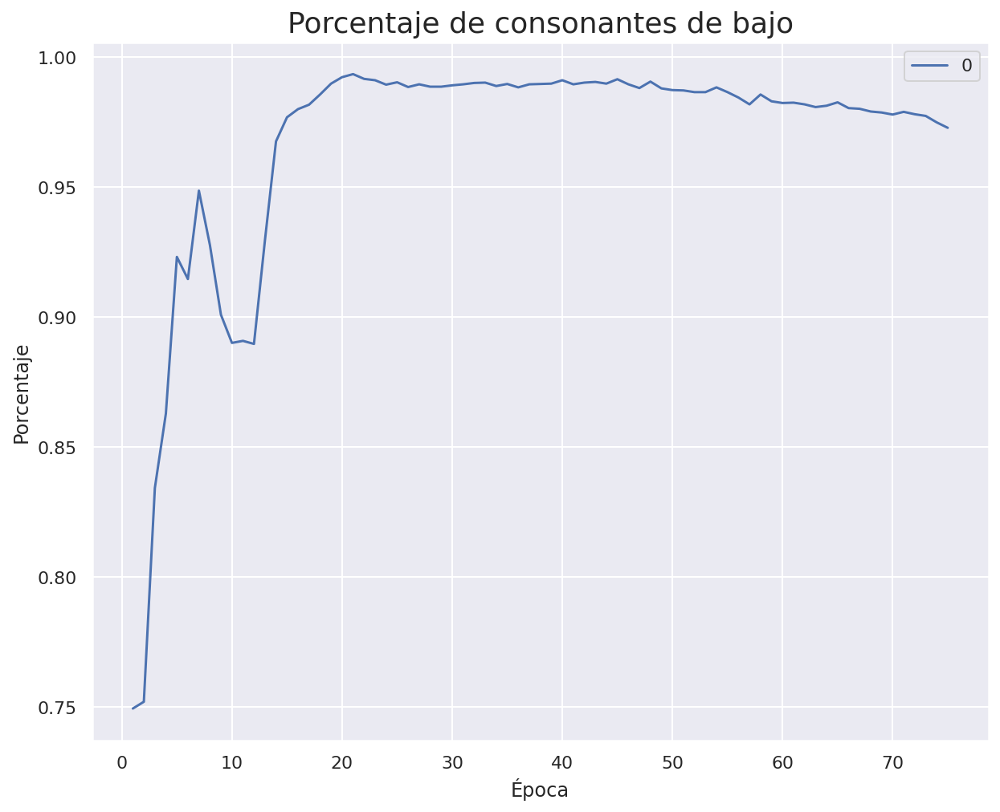

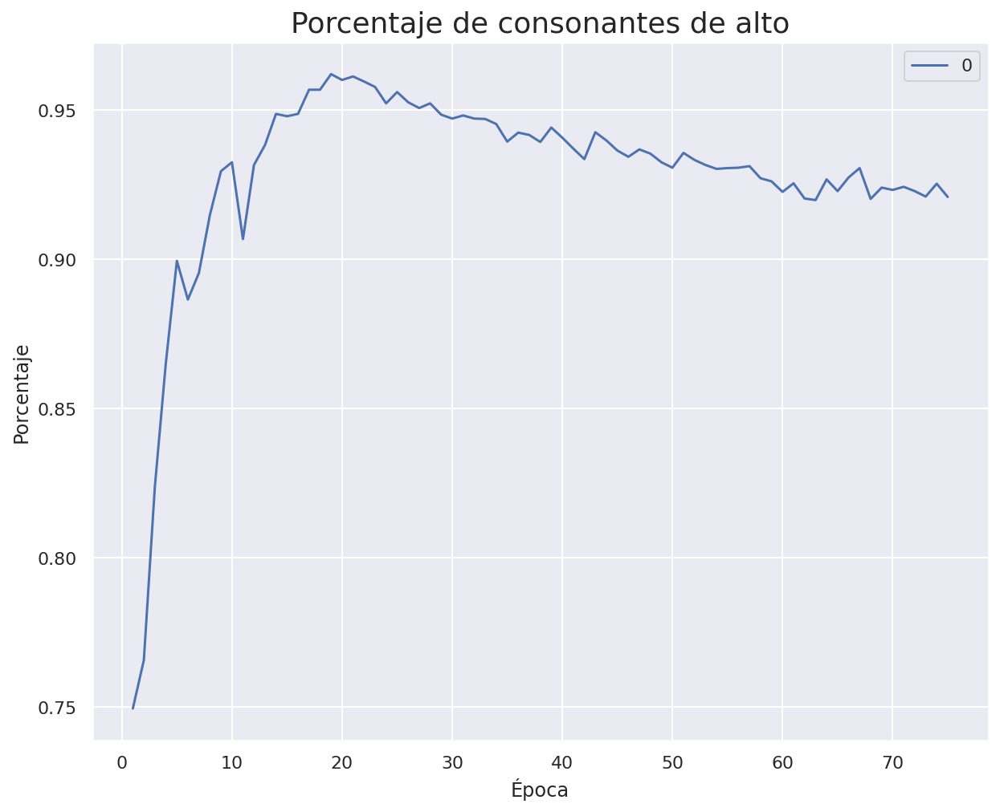

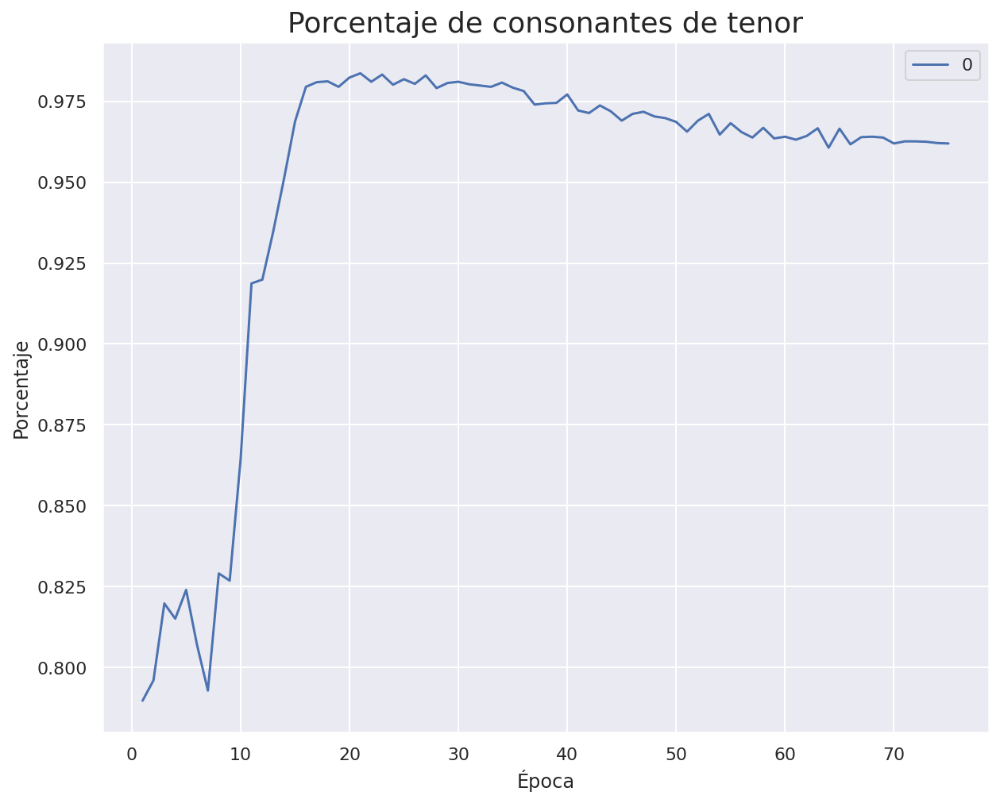

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_52 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_52 (LSTM)                 (None, 36)           8784        ['embedding_52[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

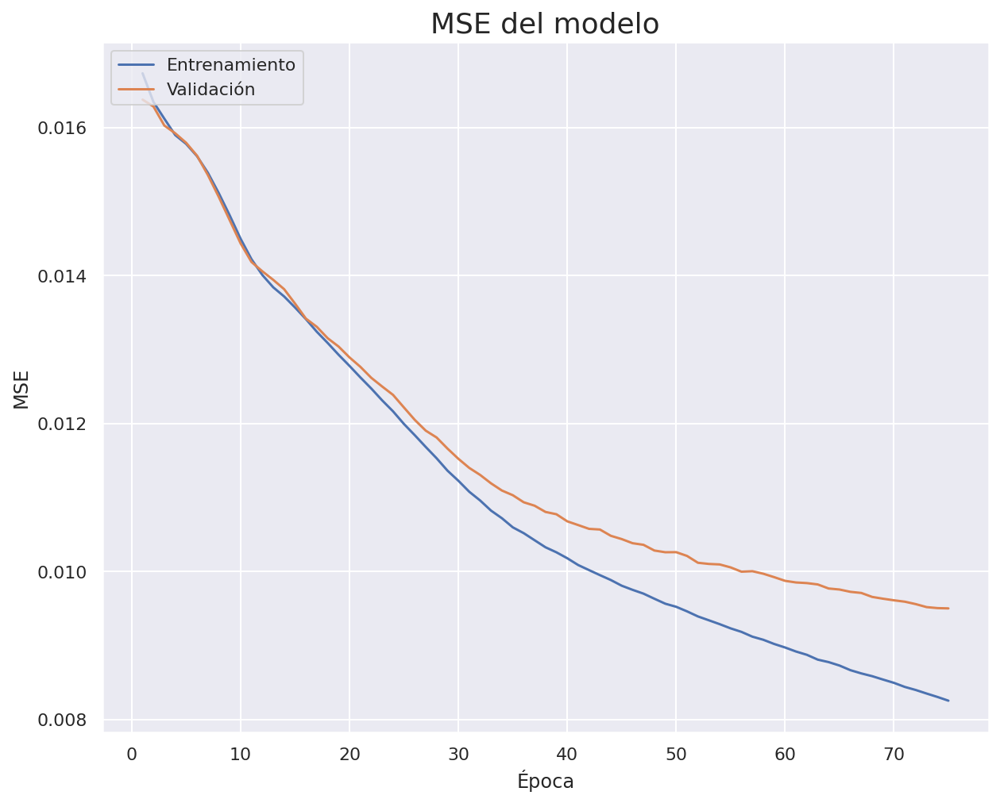

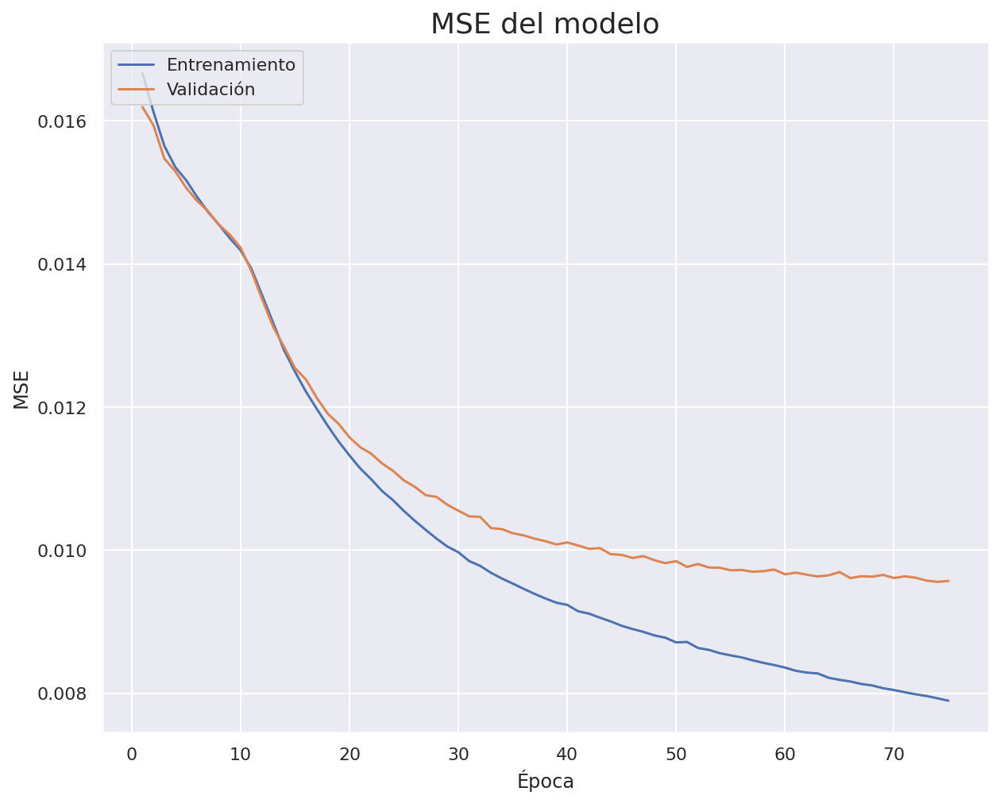

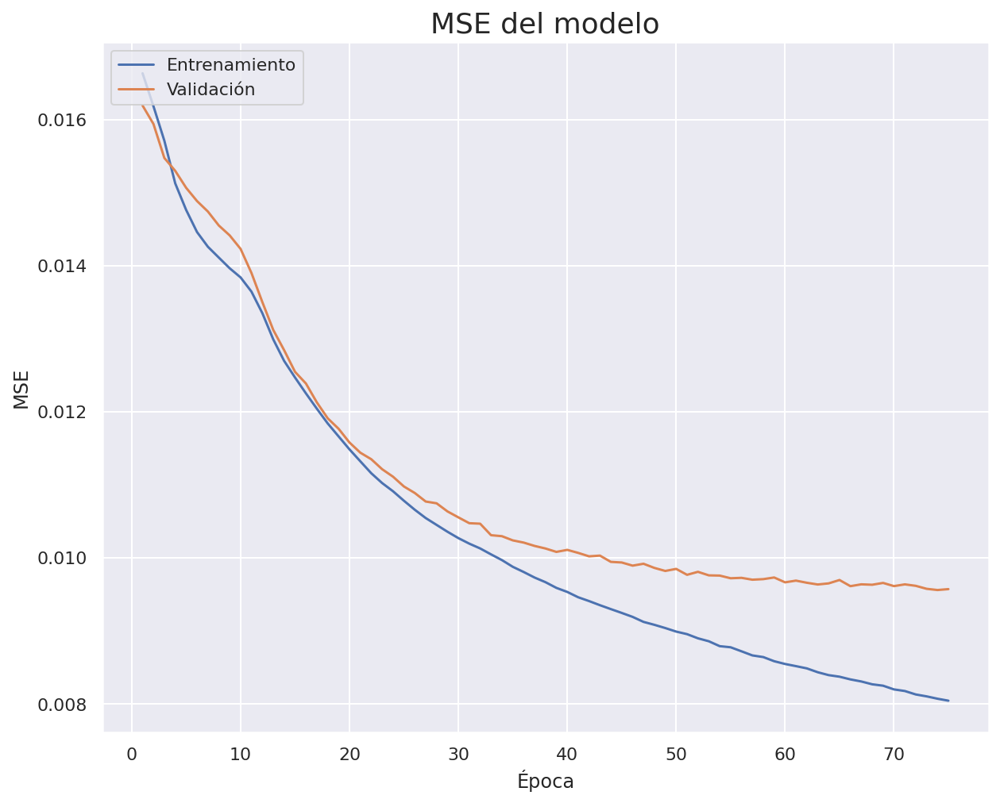

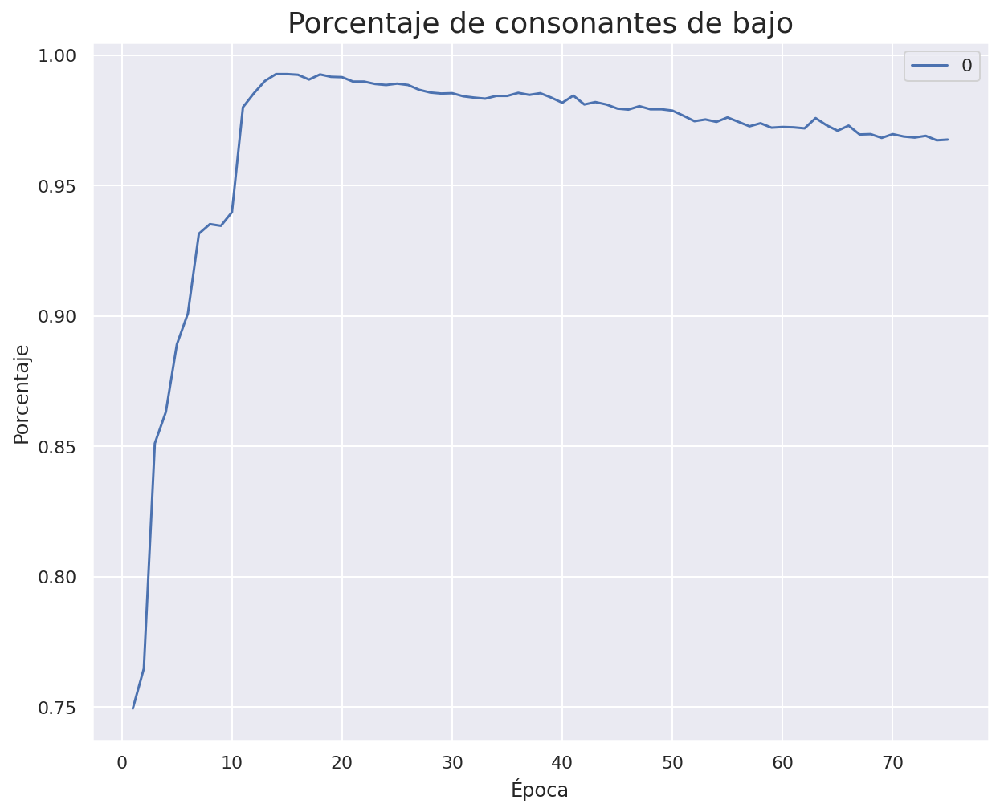

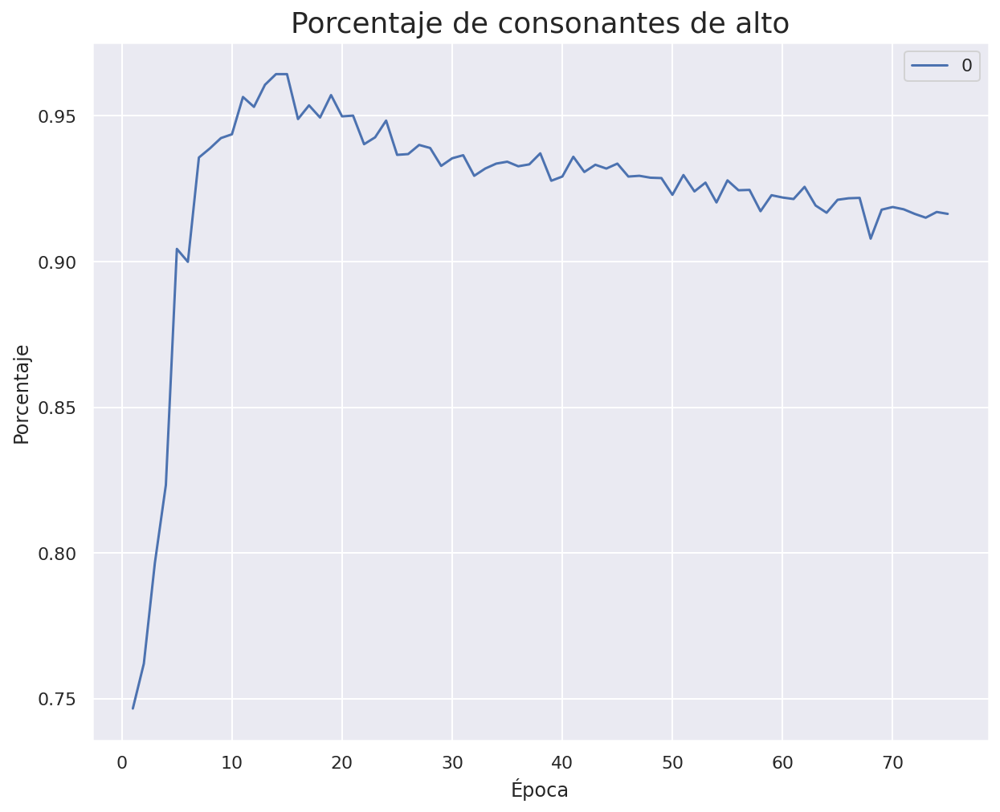

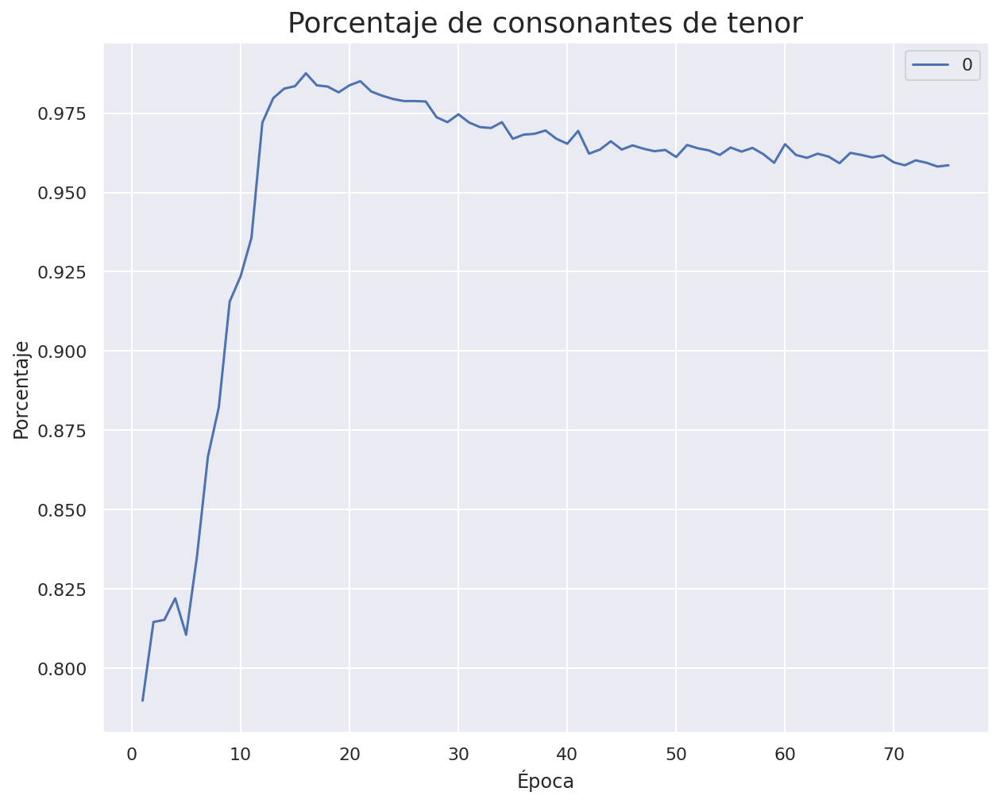

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_54 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_54 (LSTM)                 (None, 37)           9176        ['embedding_54[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

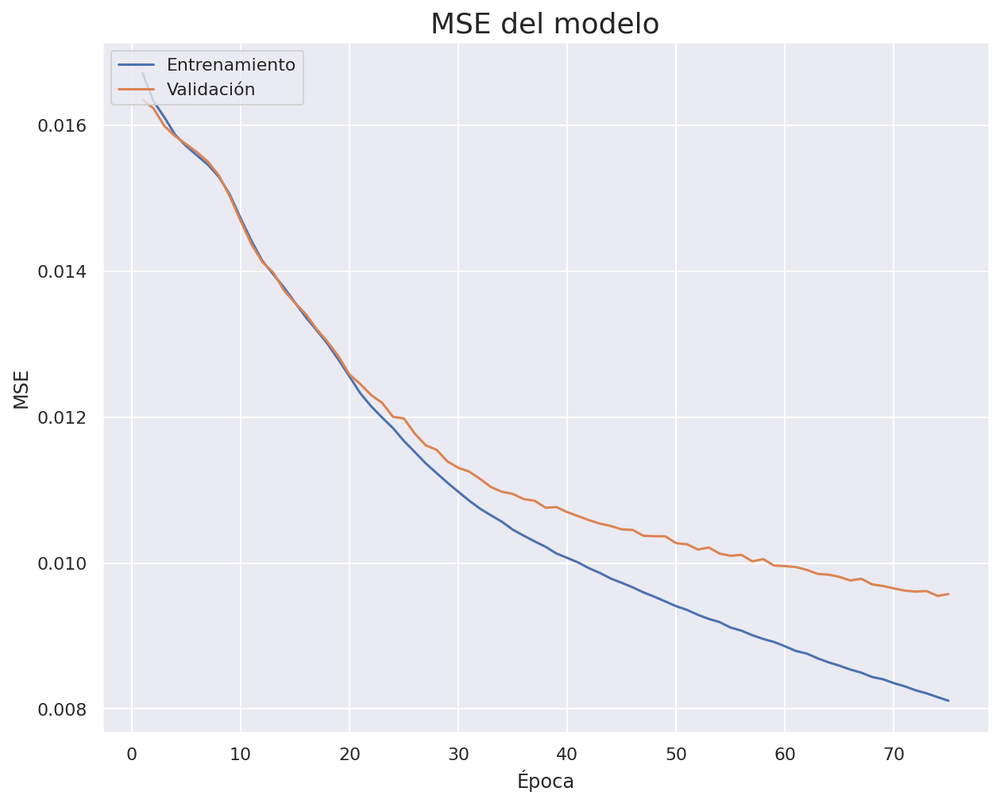

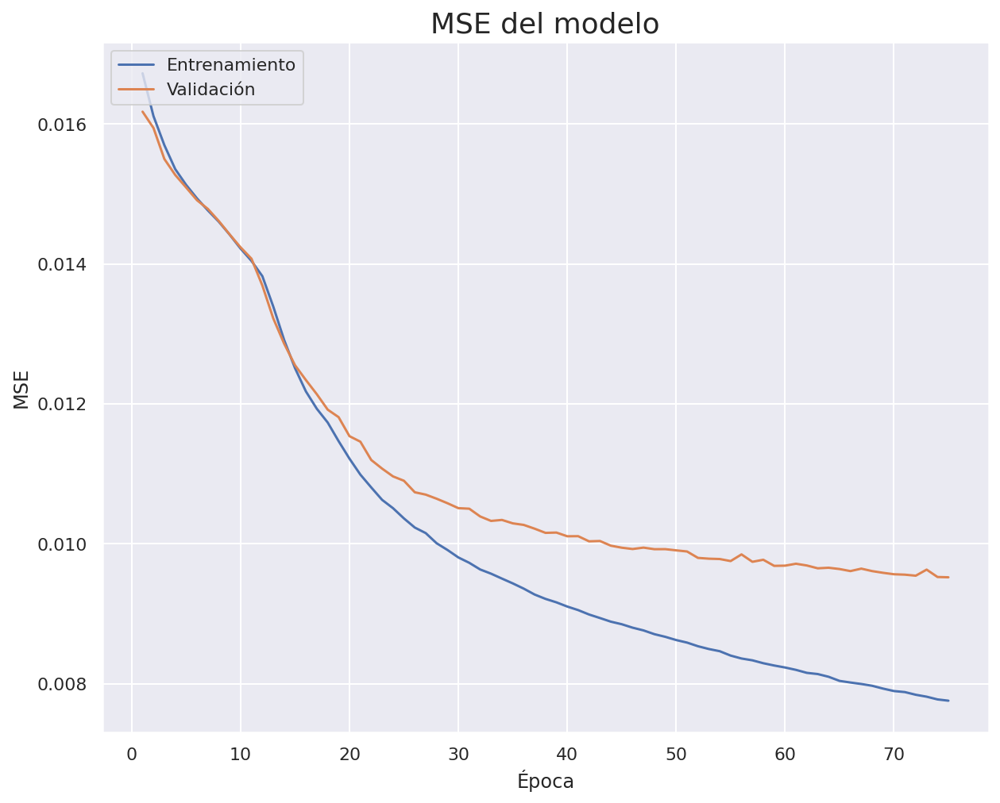

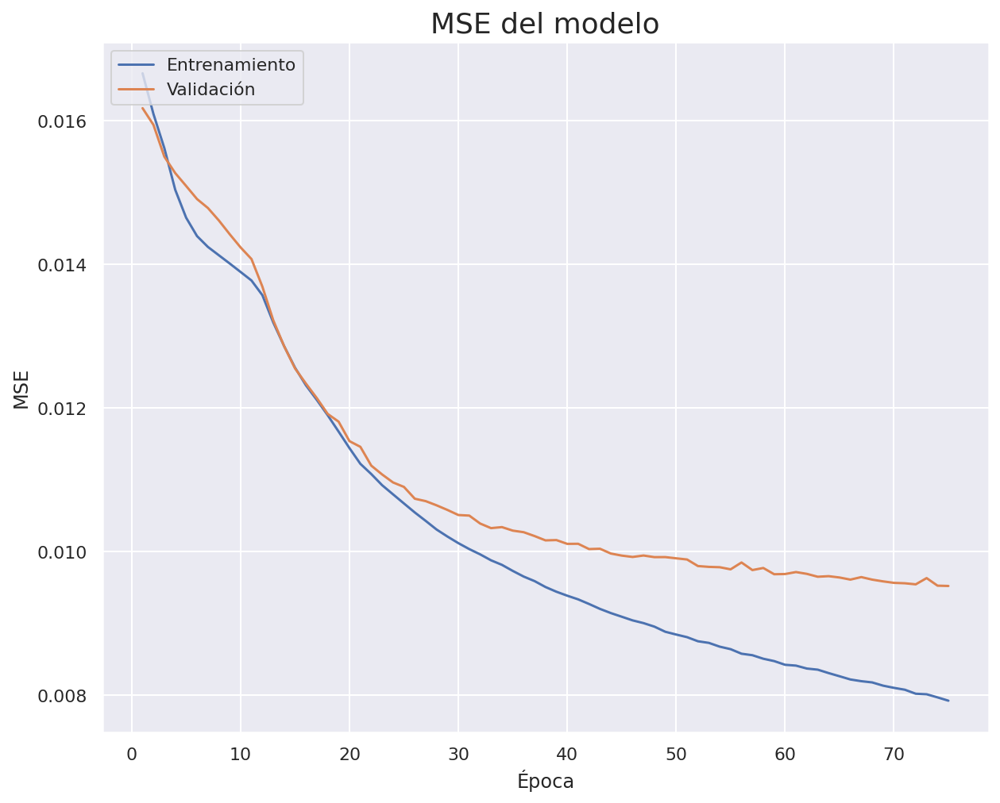

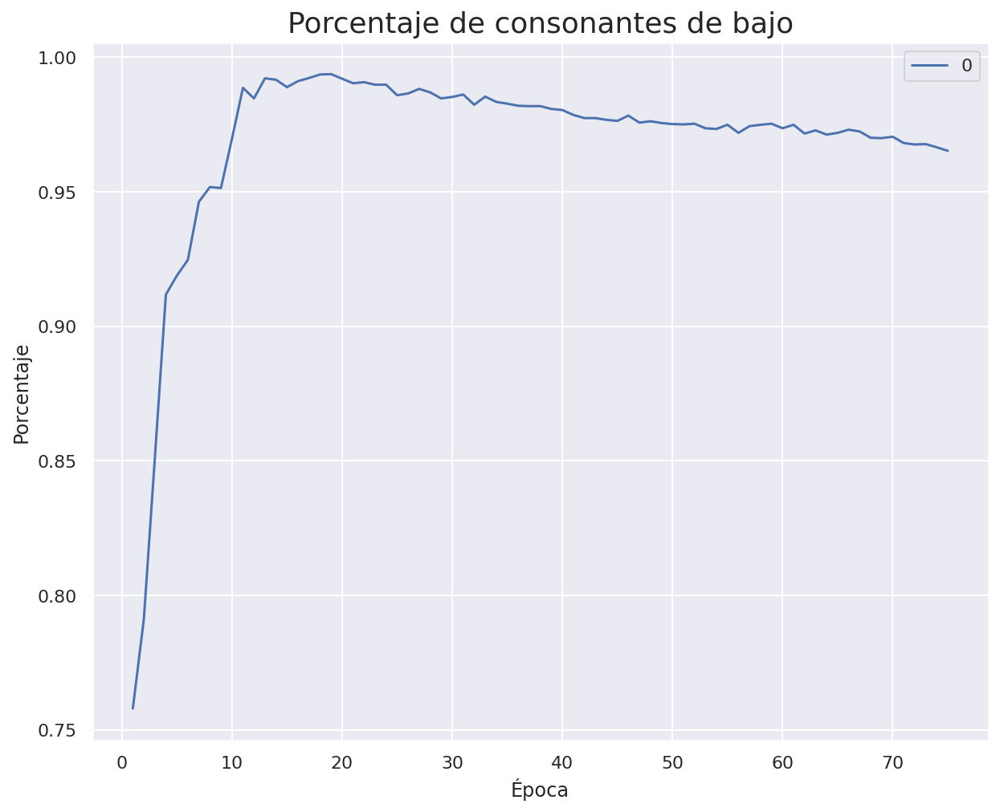

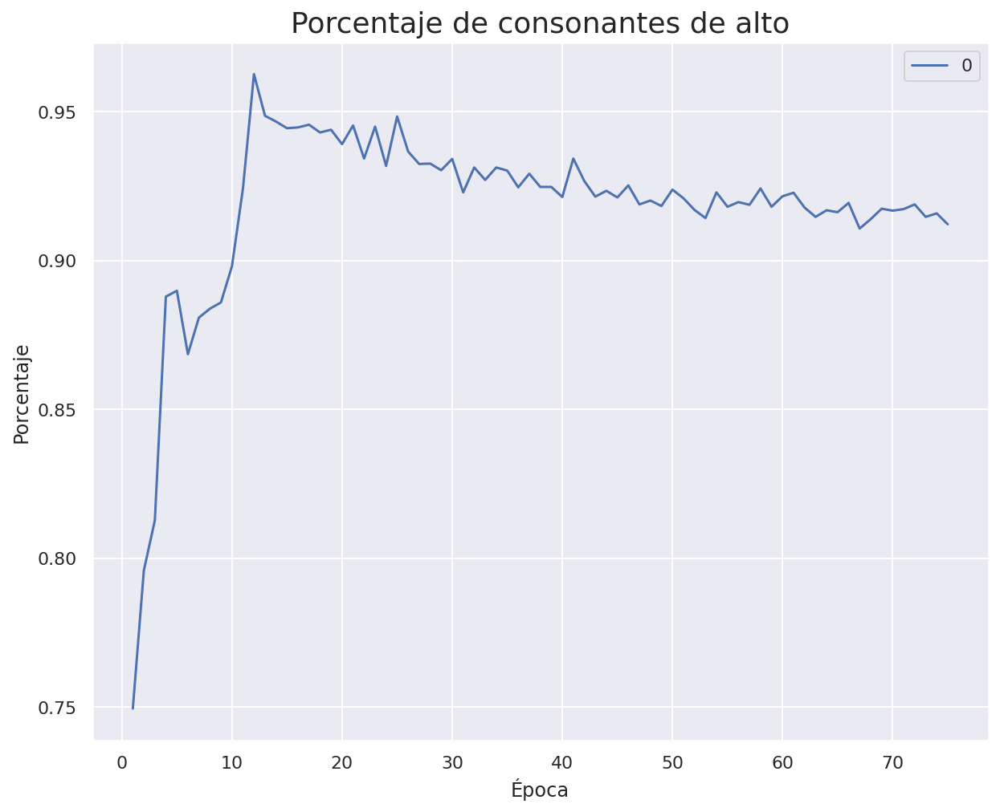

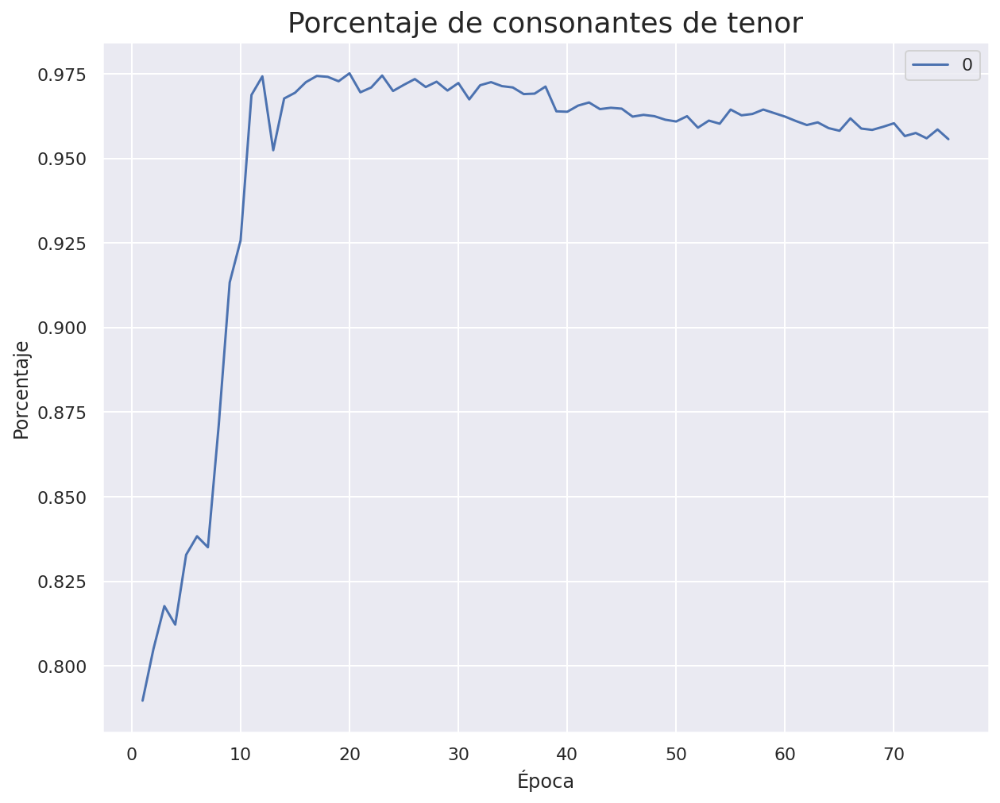

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_56 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_56 (LSTM)                 (None, 38)           9576        ['embedding_56[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

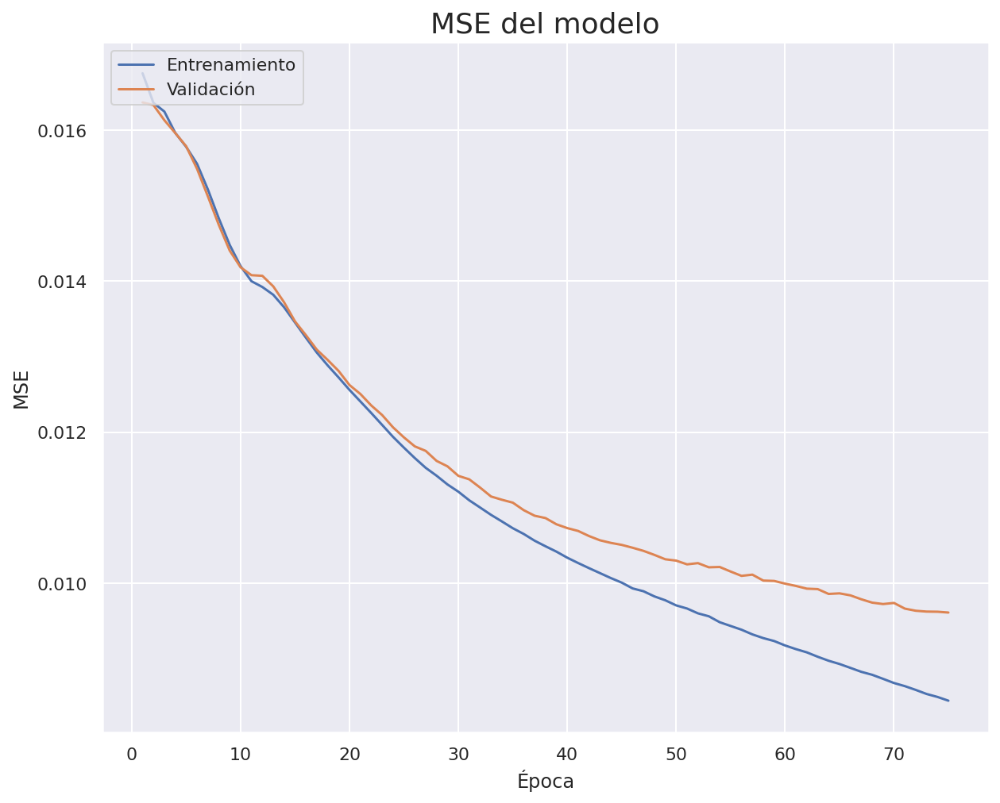

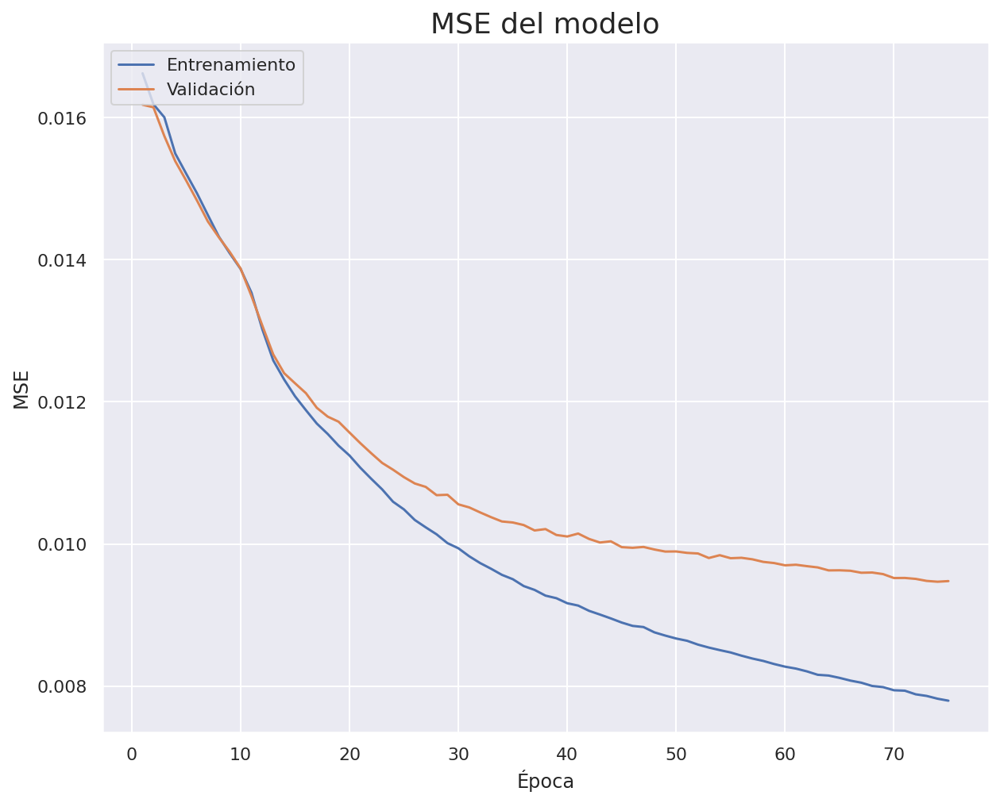

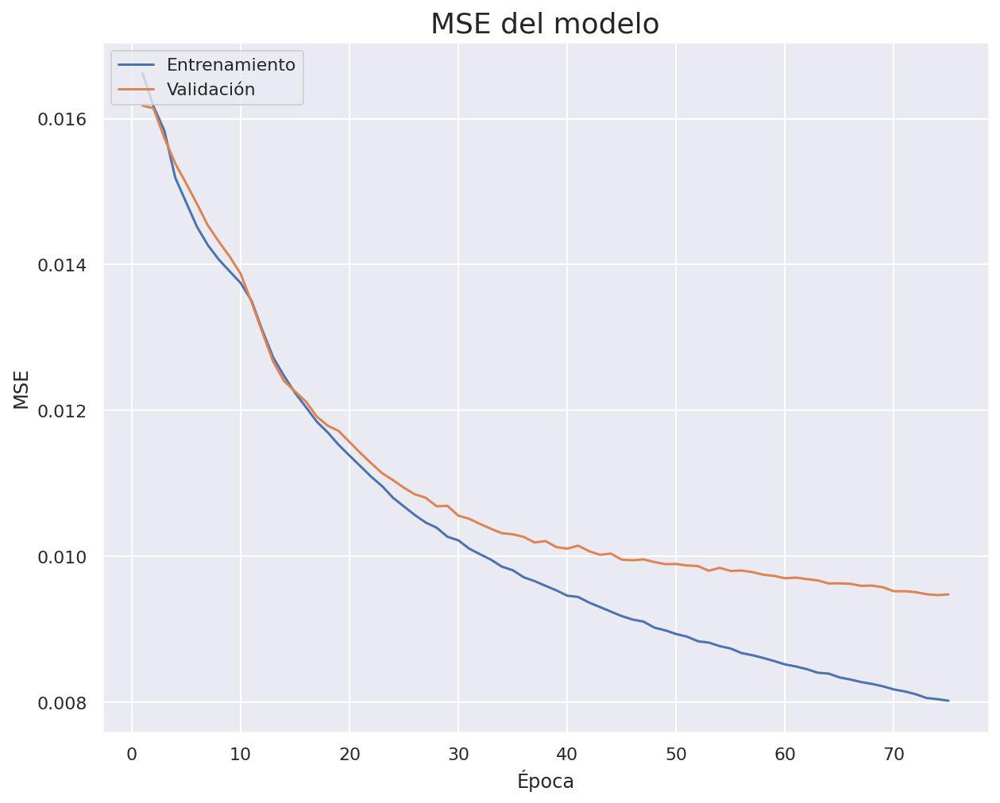

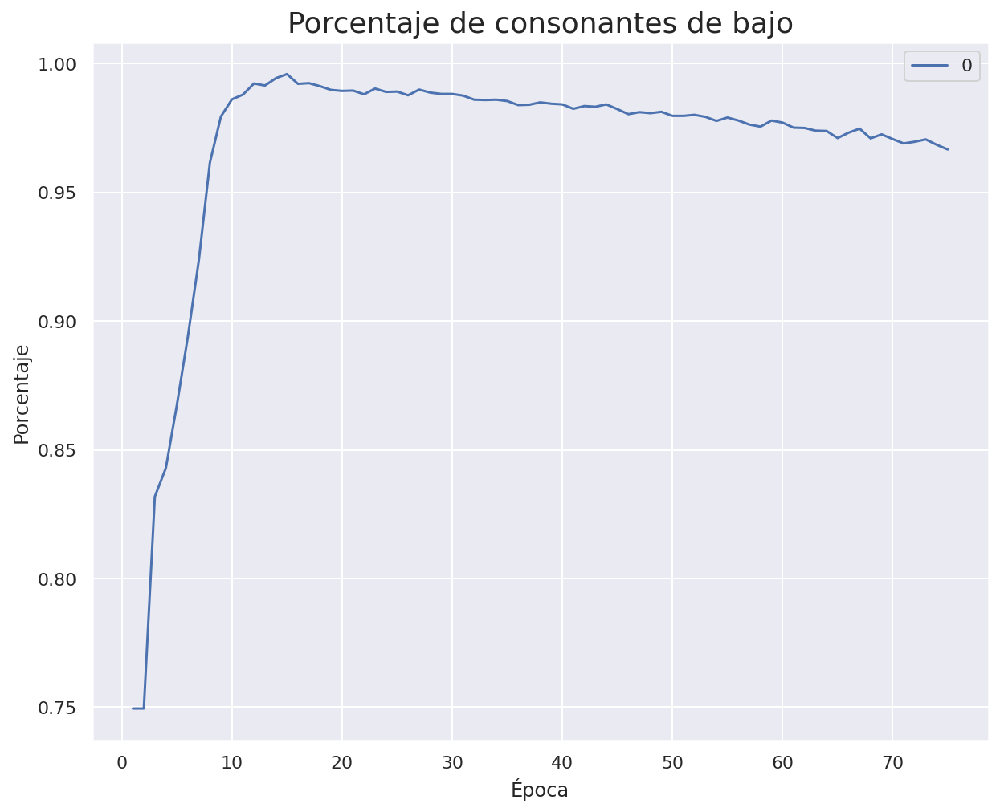

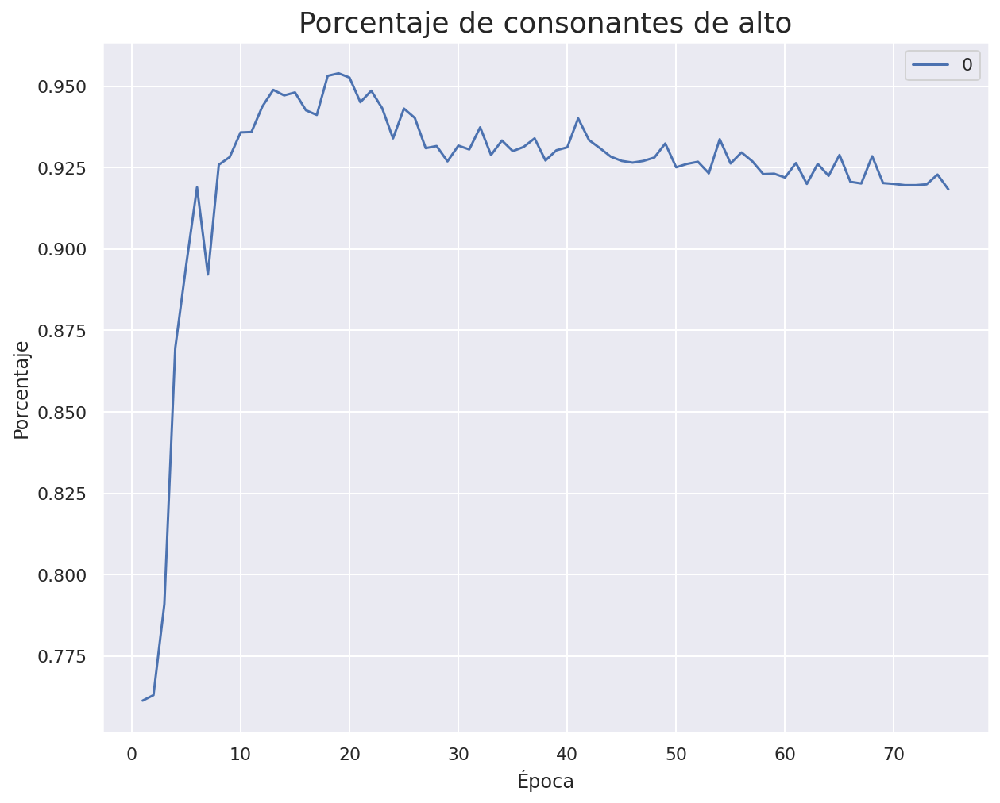

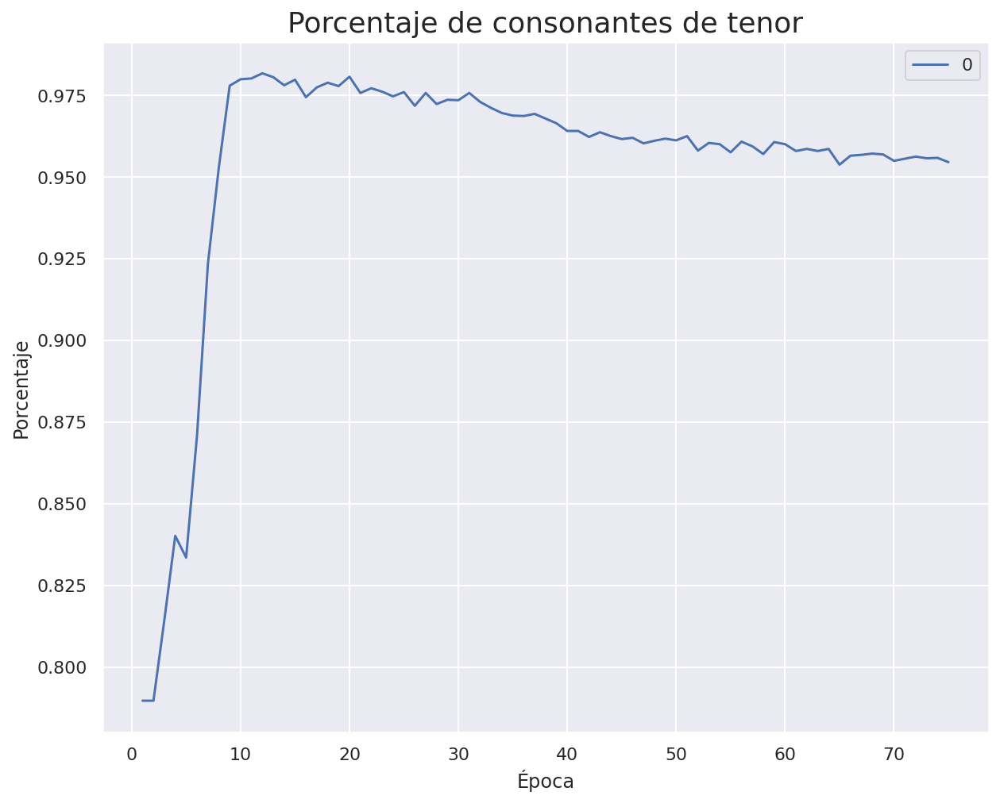

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_58 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_58 (LSTM)                 (None, 39)           9984        ['embedding_58[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

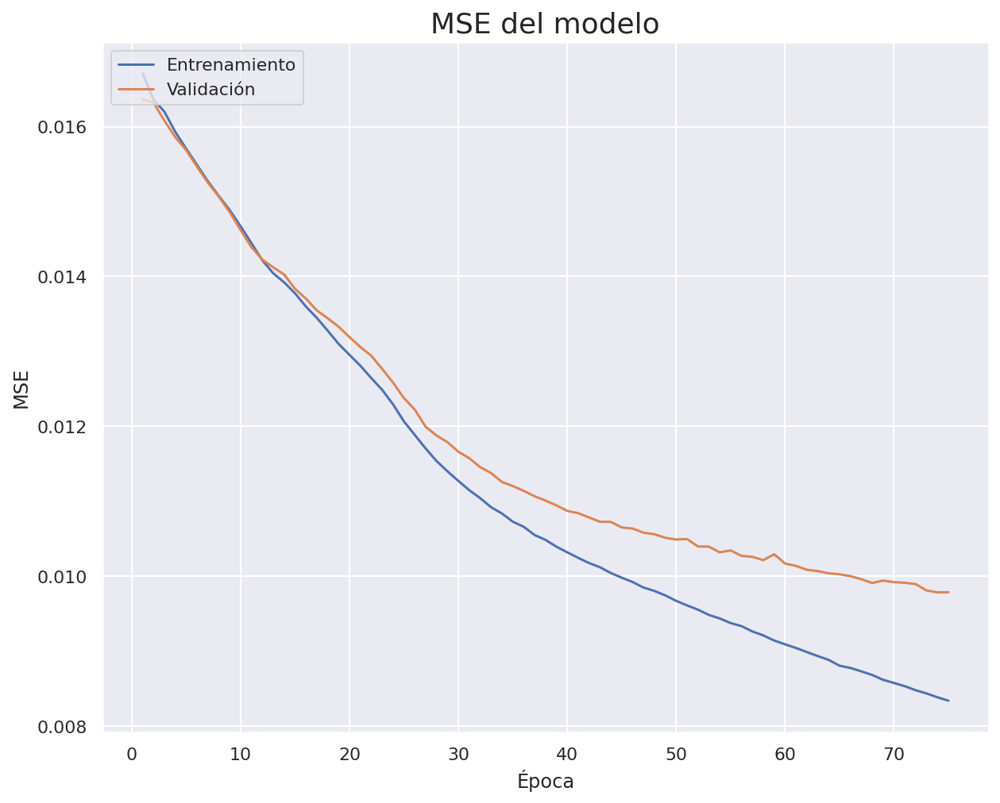

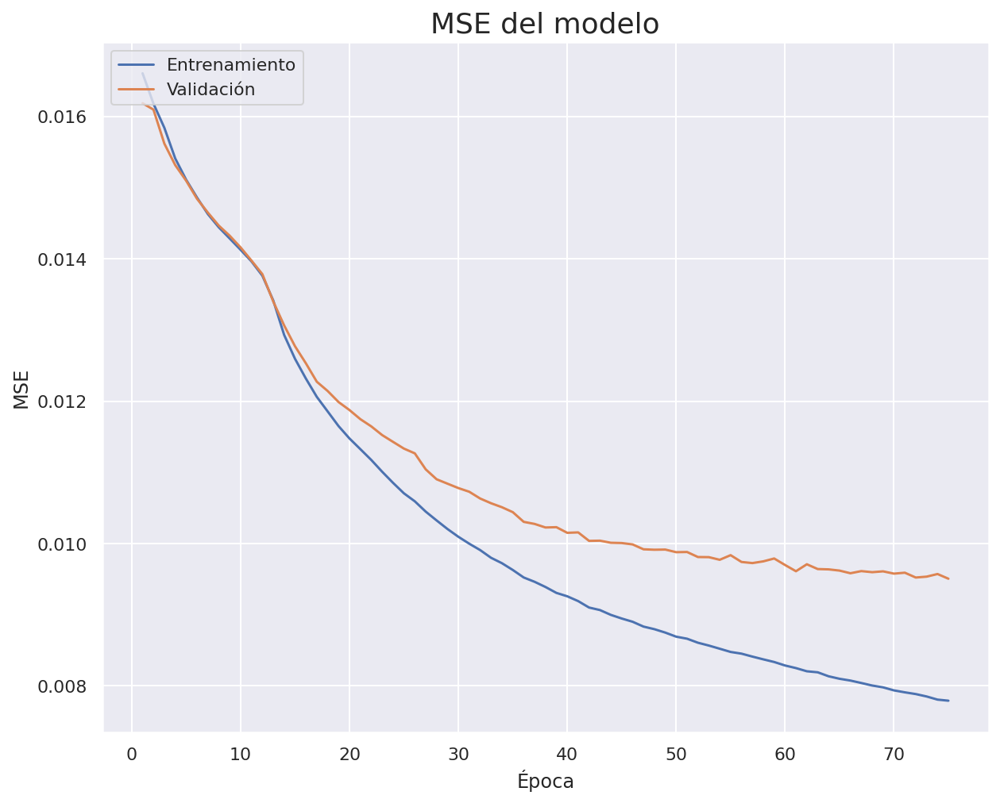

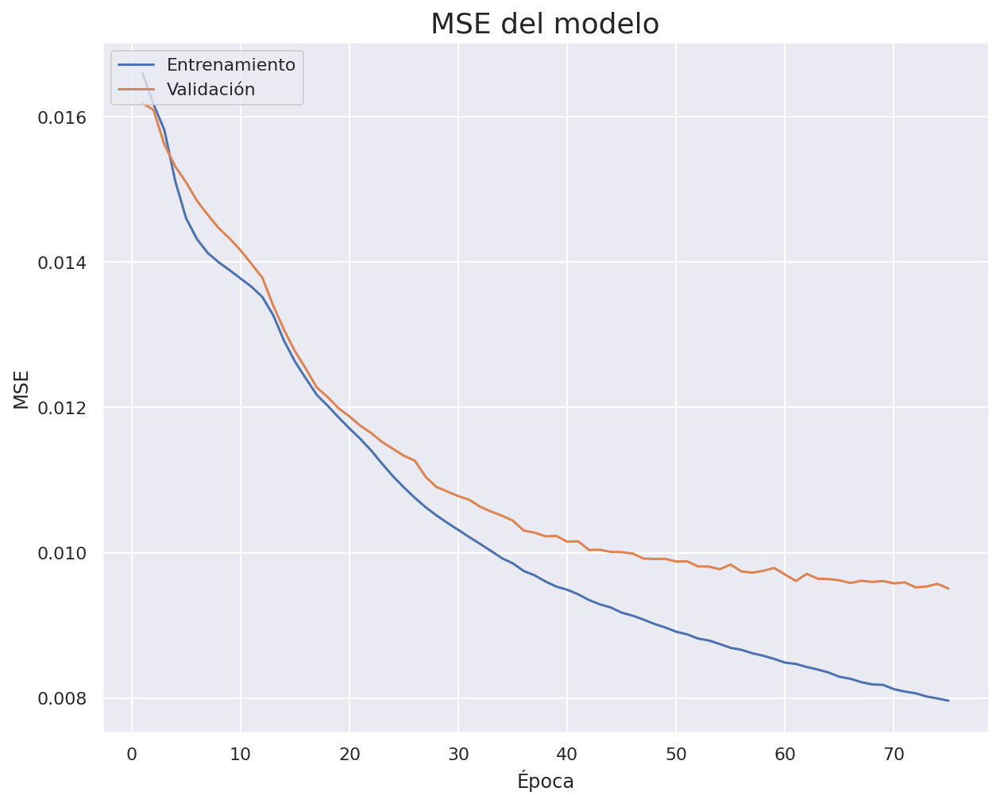

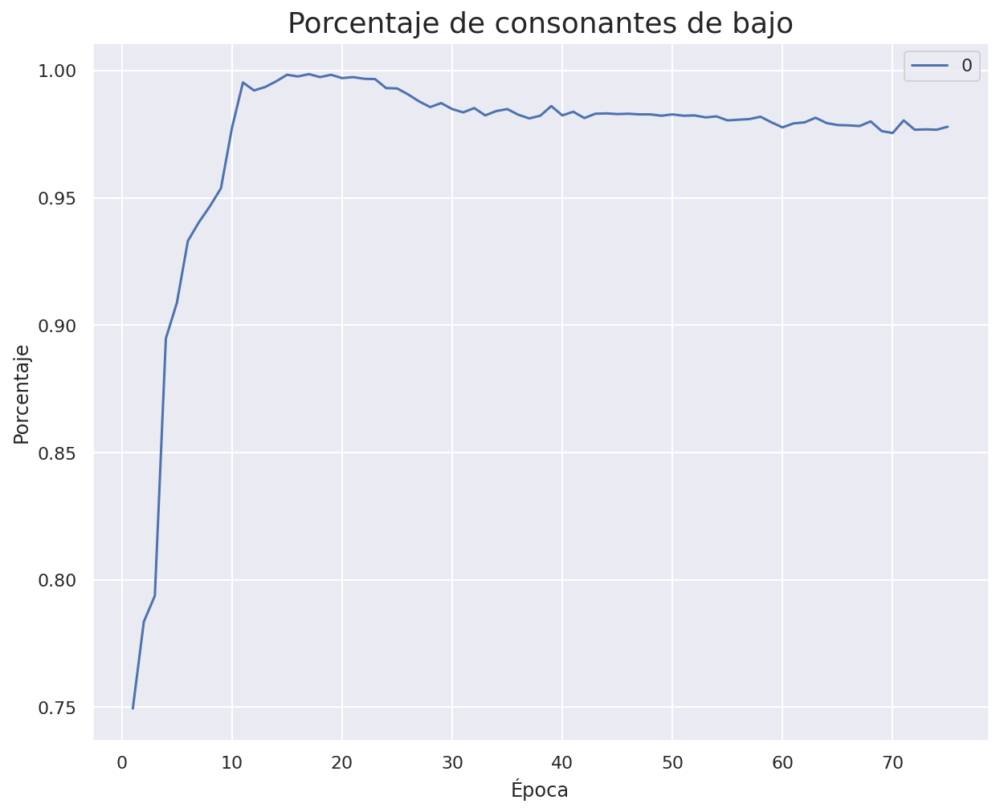

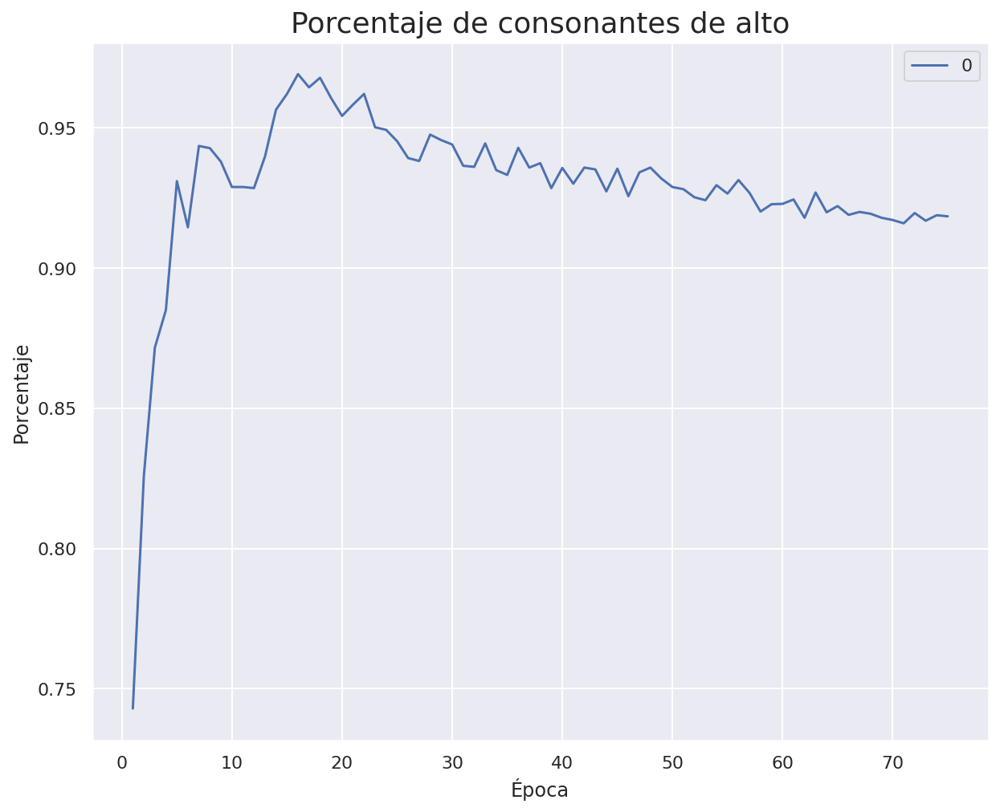

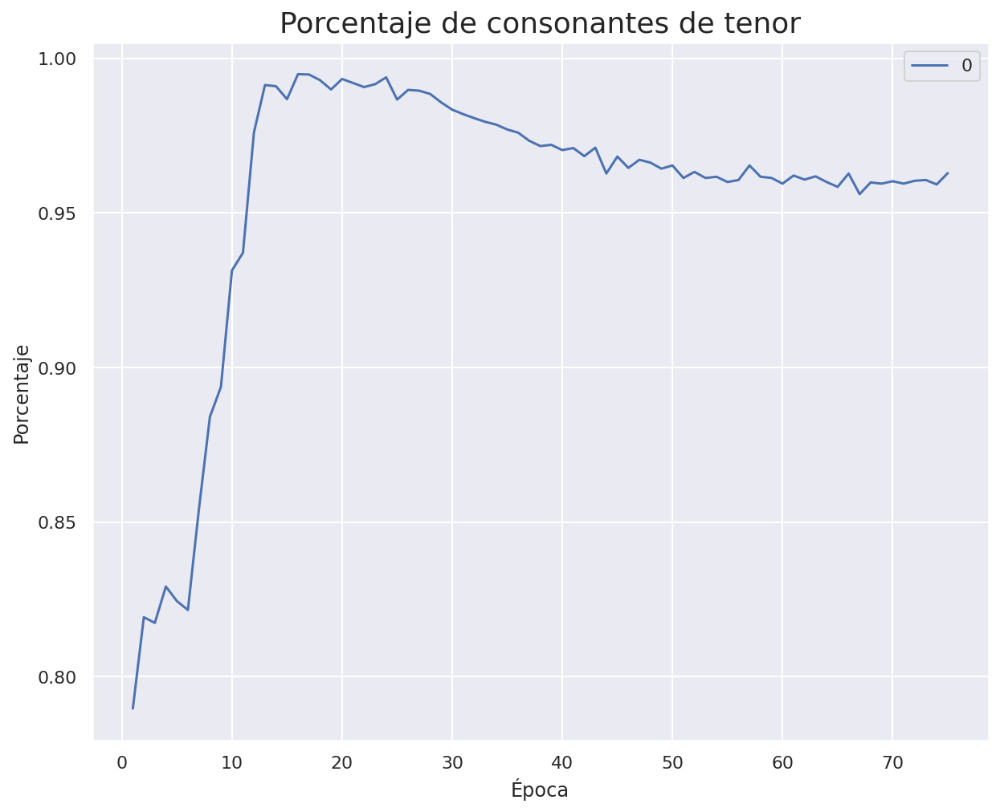

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_60 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_60 (LSTM)                 (None, 40)           10400       ['embedding_60[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

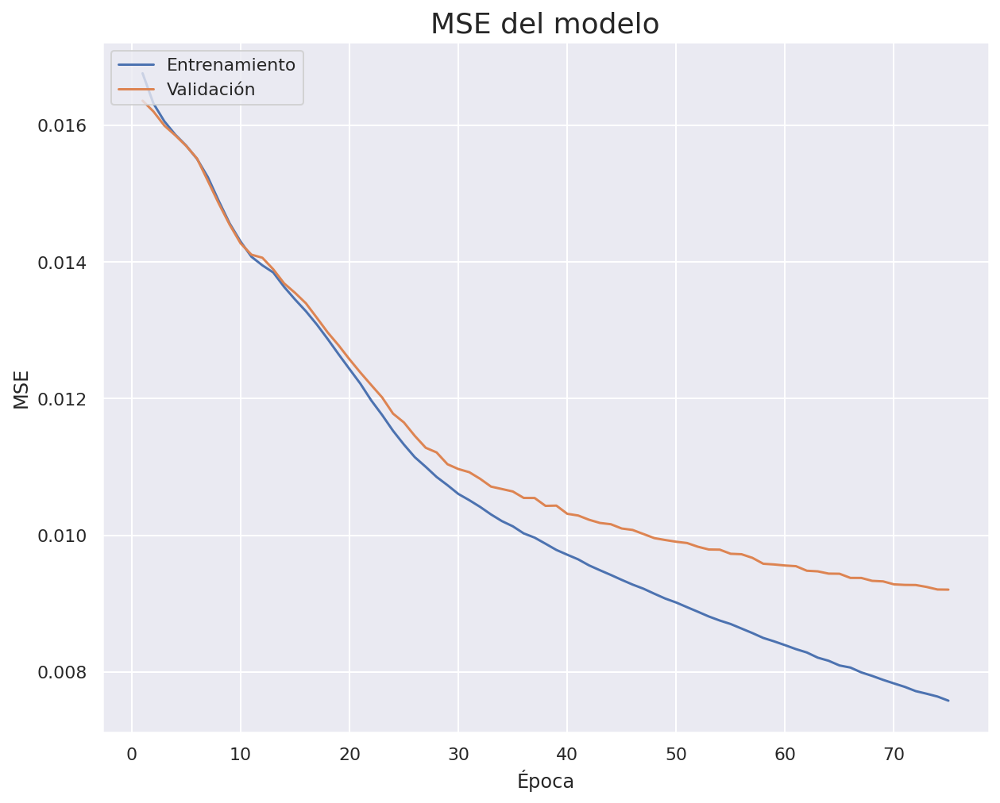

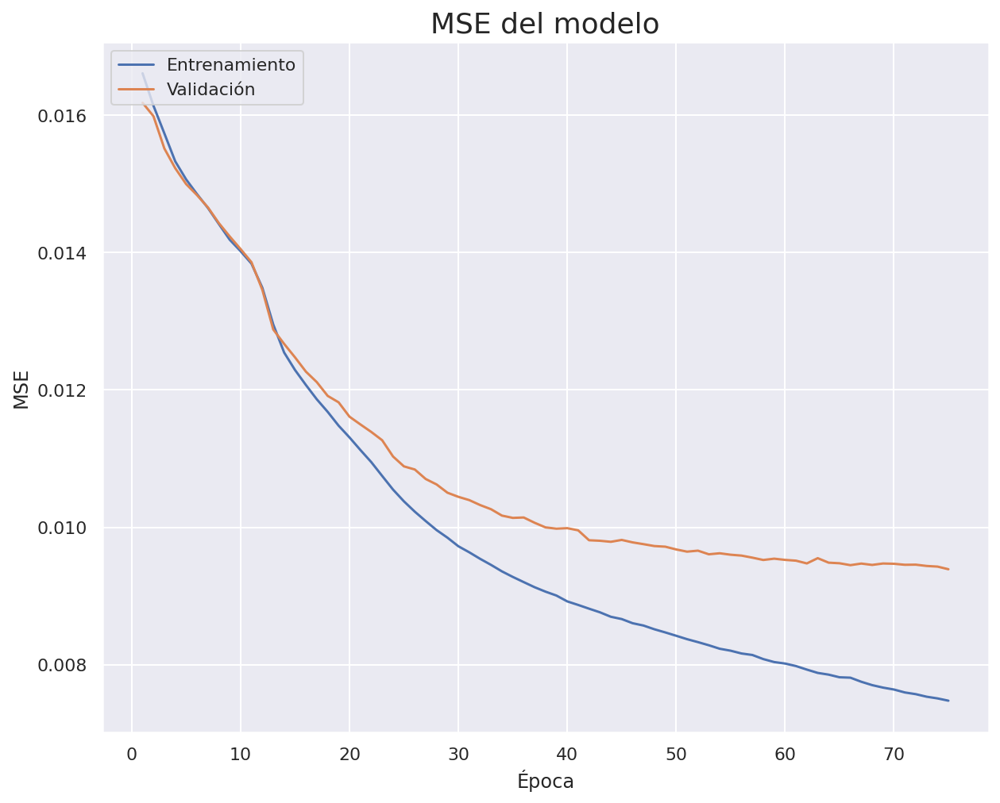

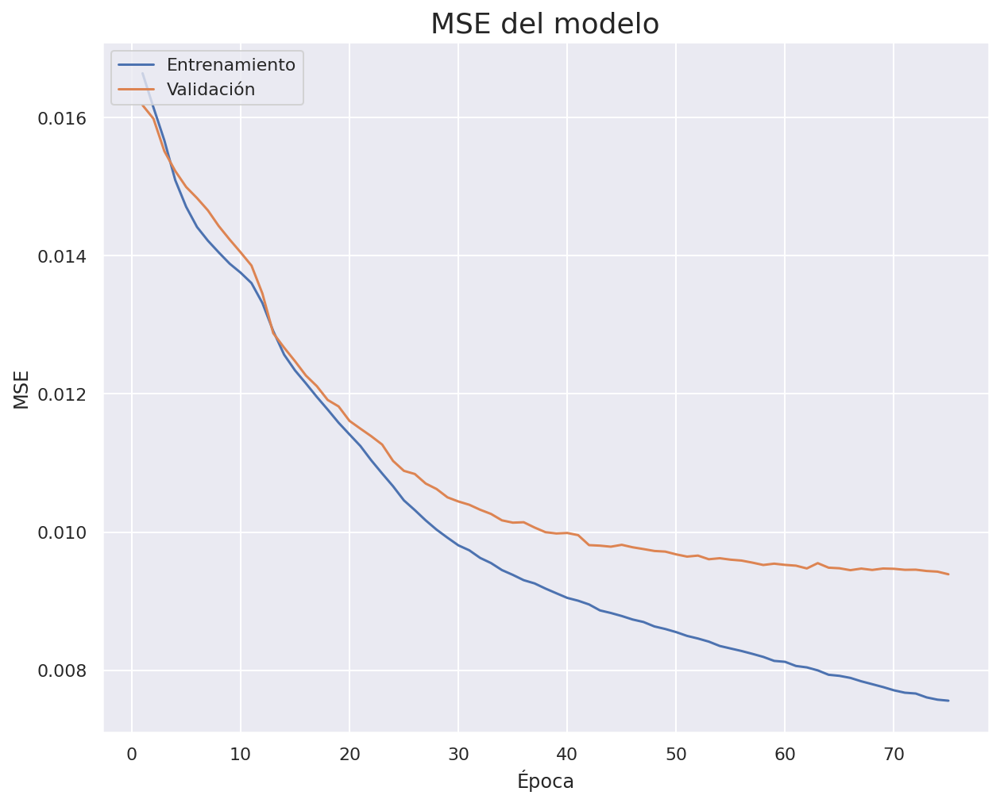

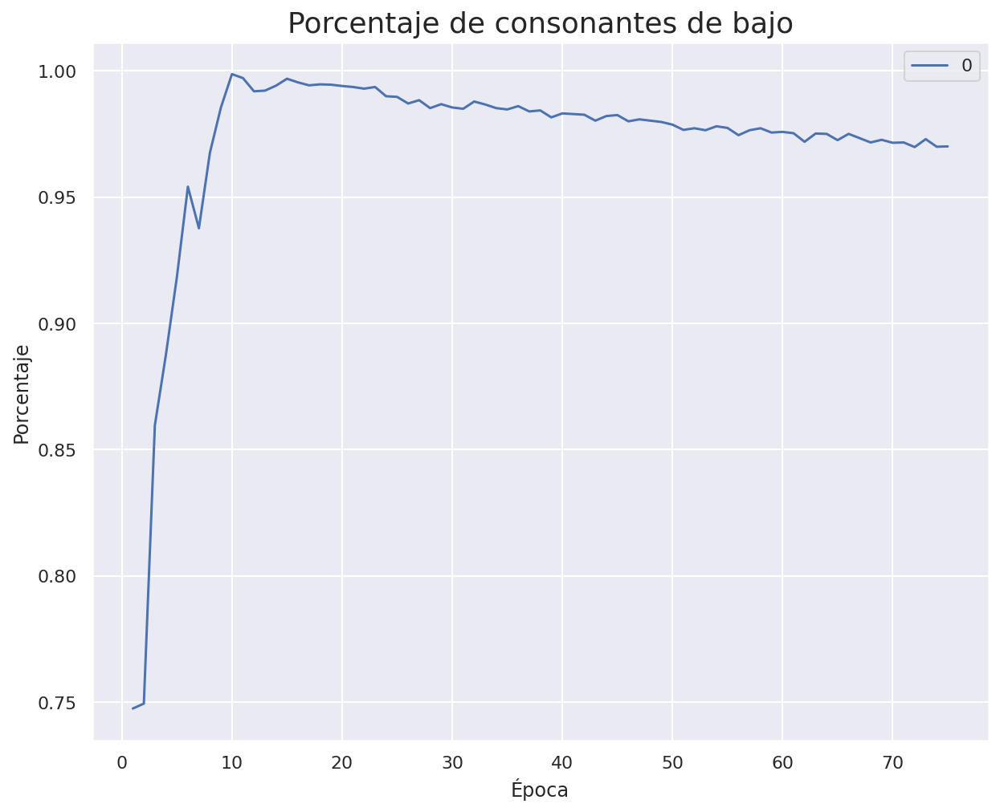

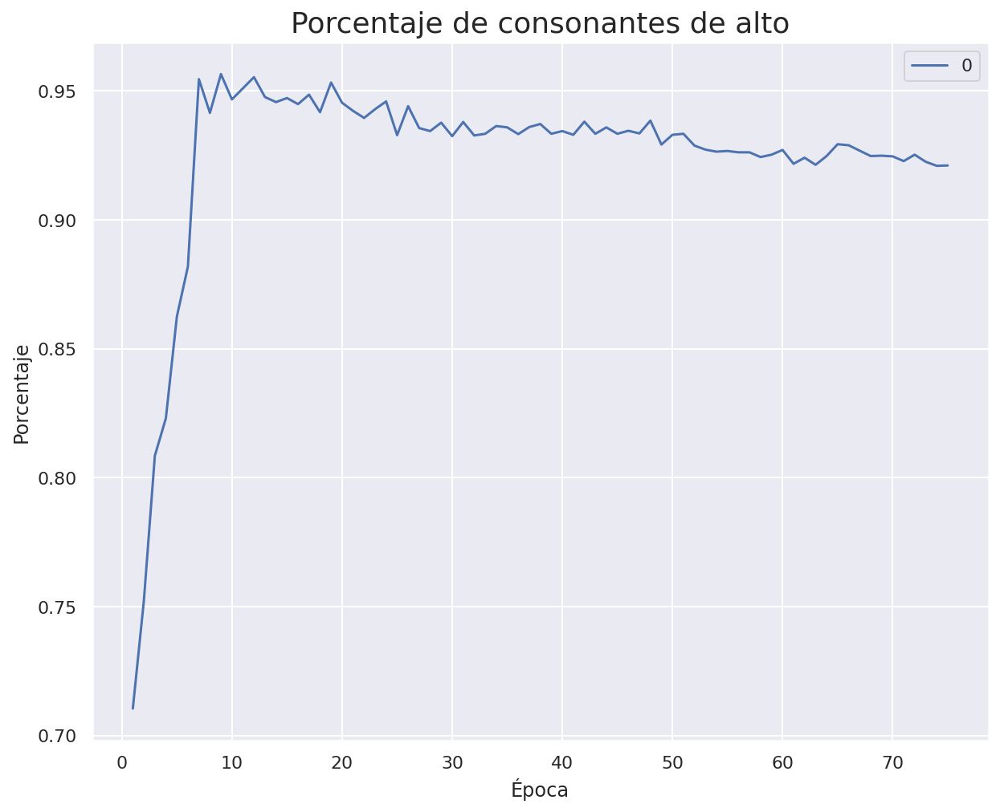

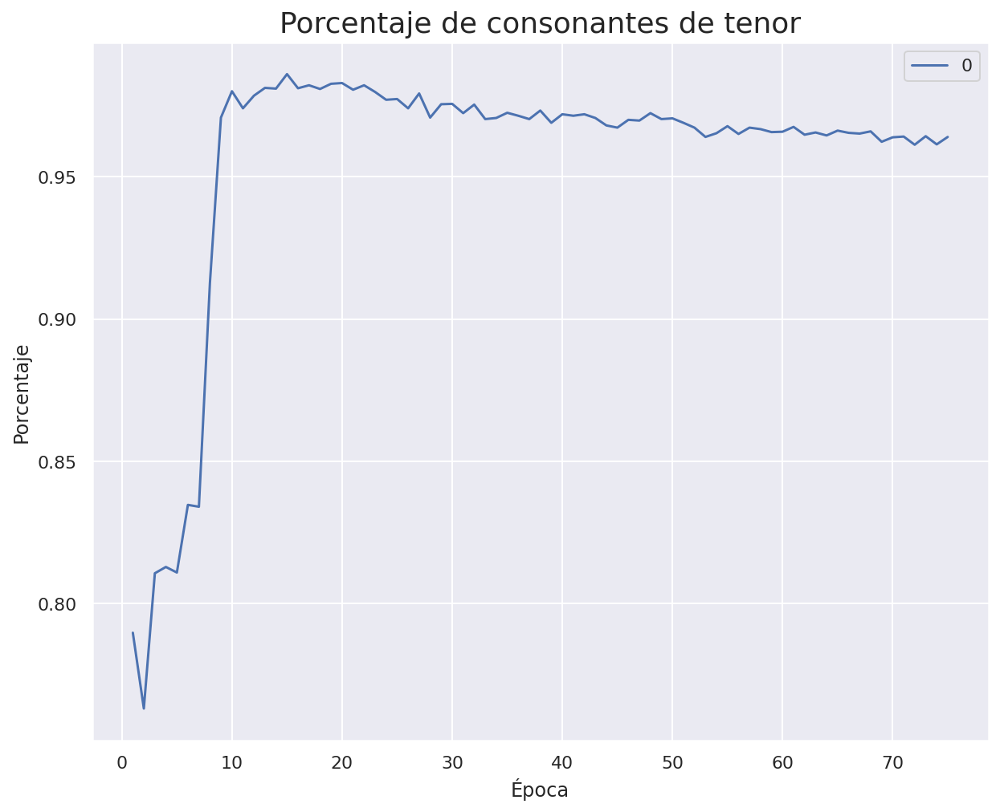

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_62 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_62 (LSTM)                 (None, 41)           10824       ['embedding_62[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

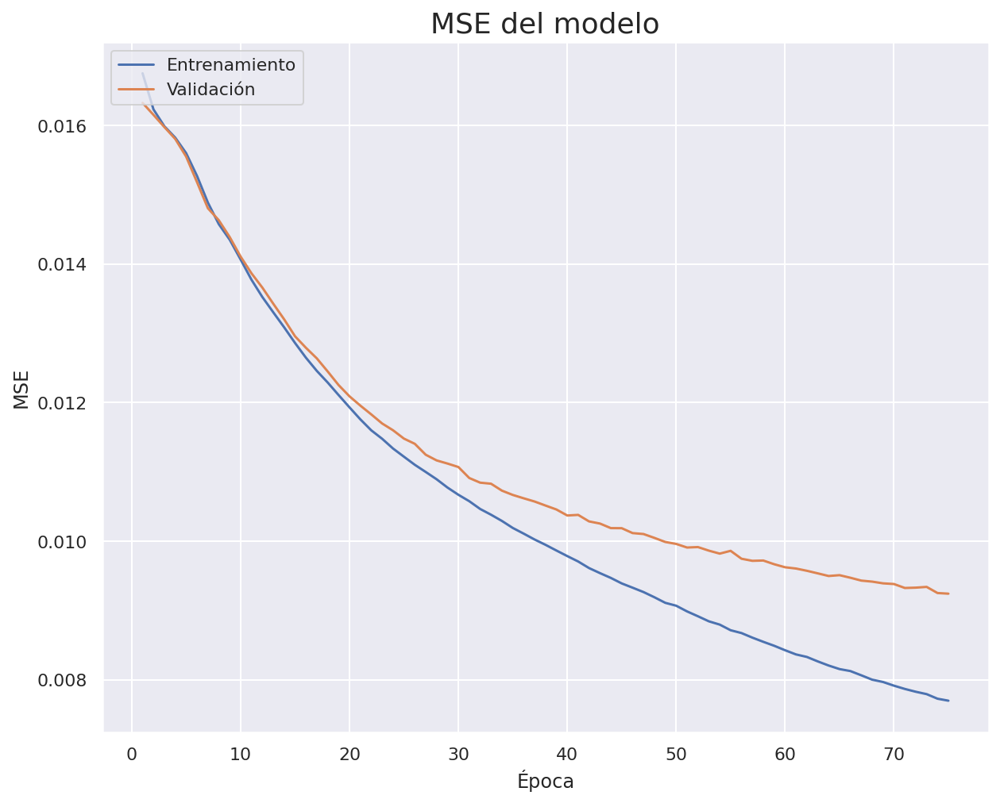

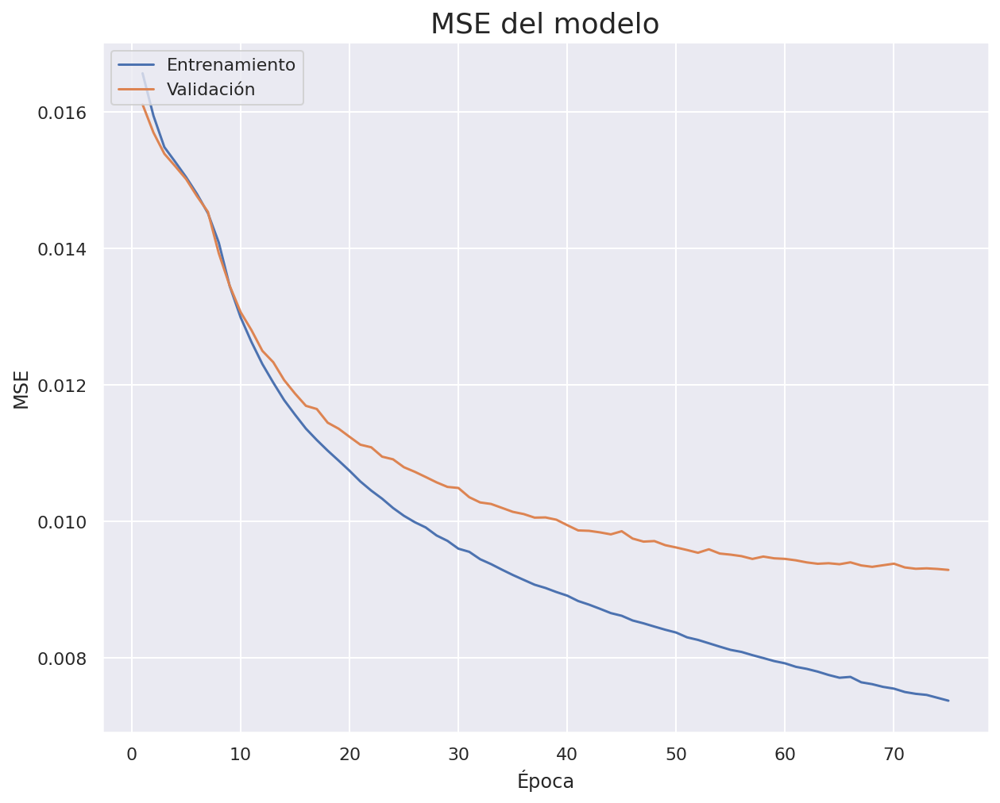

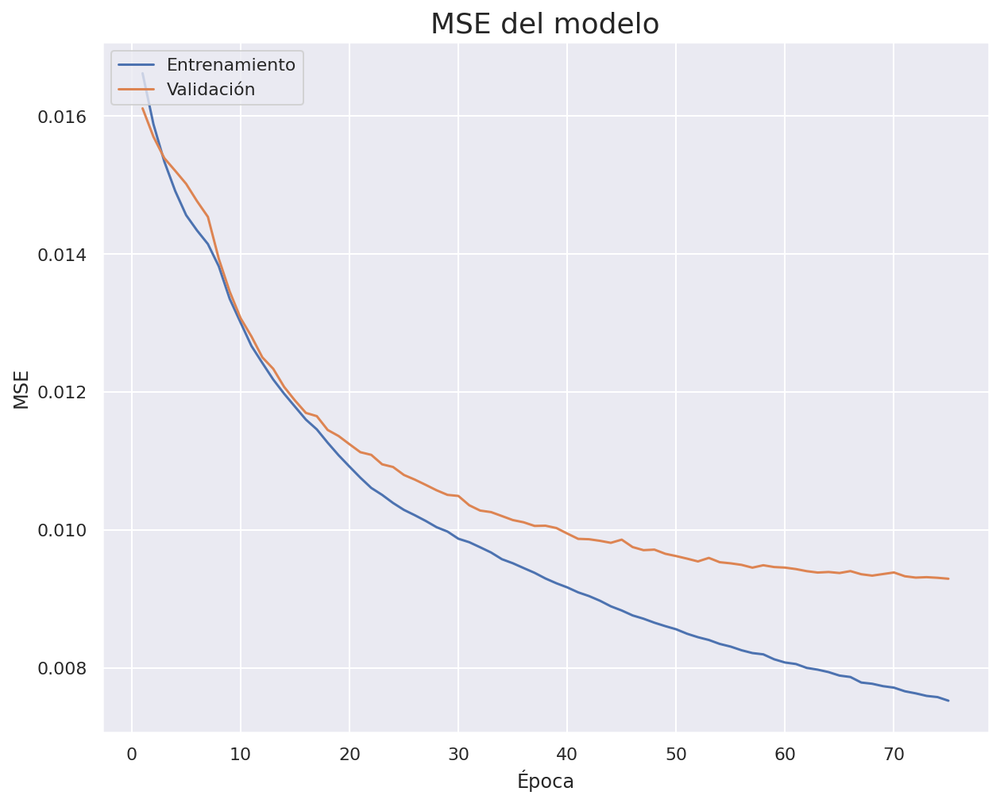

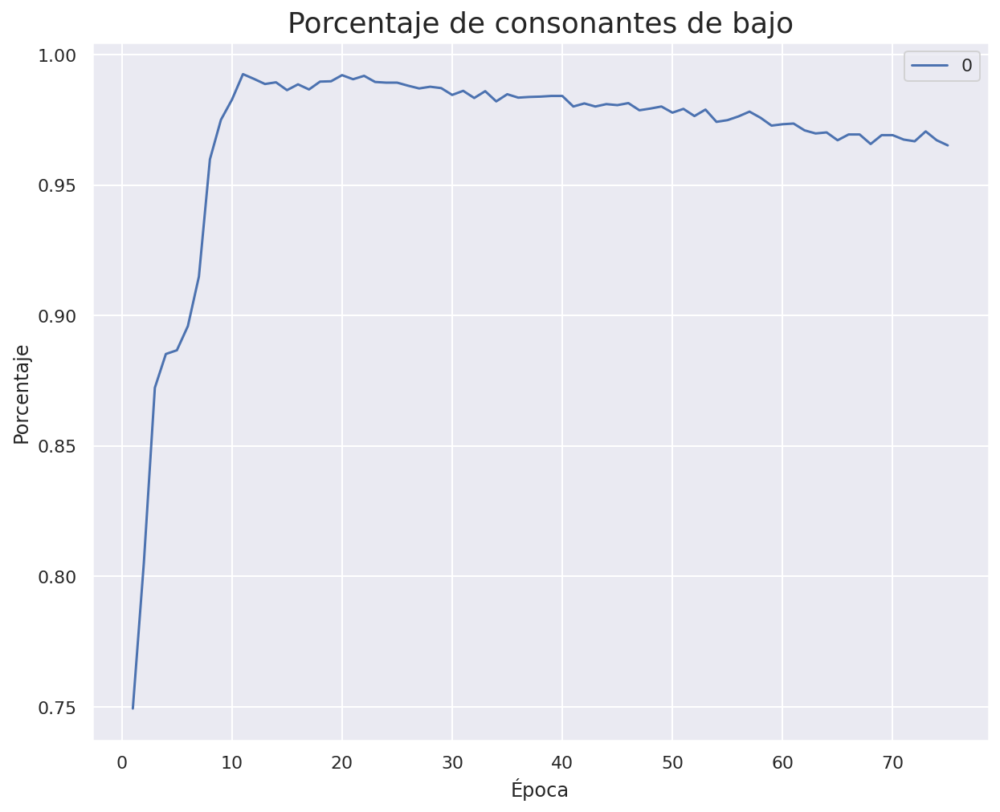

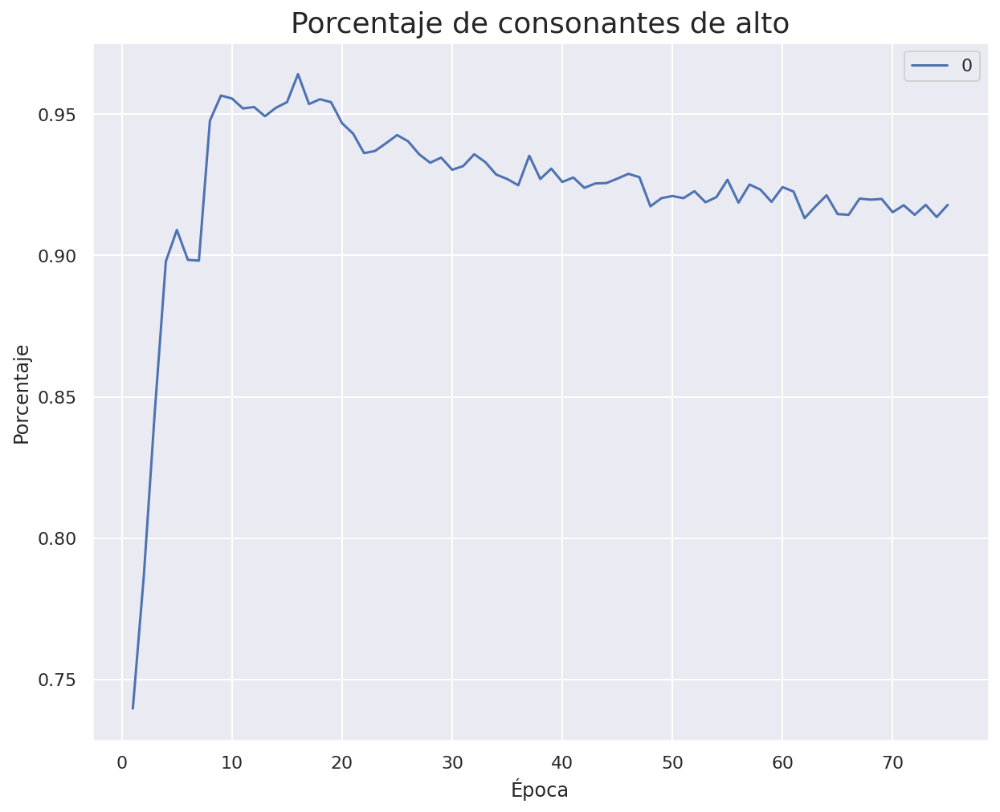

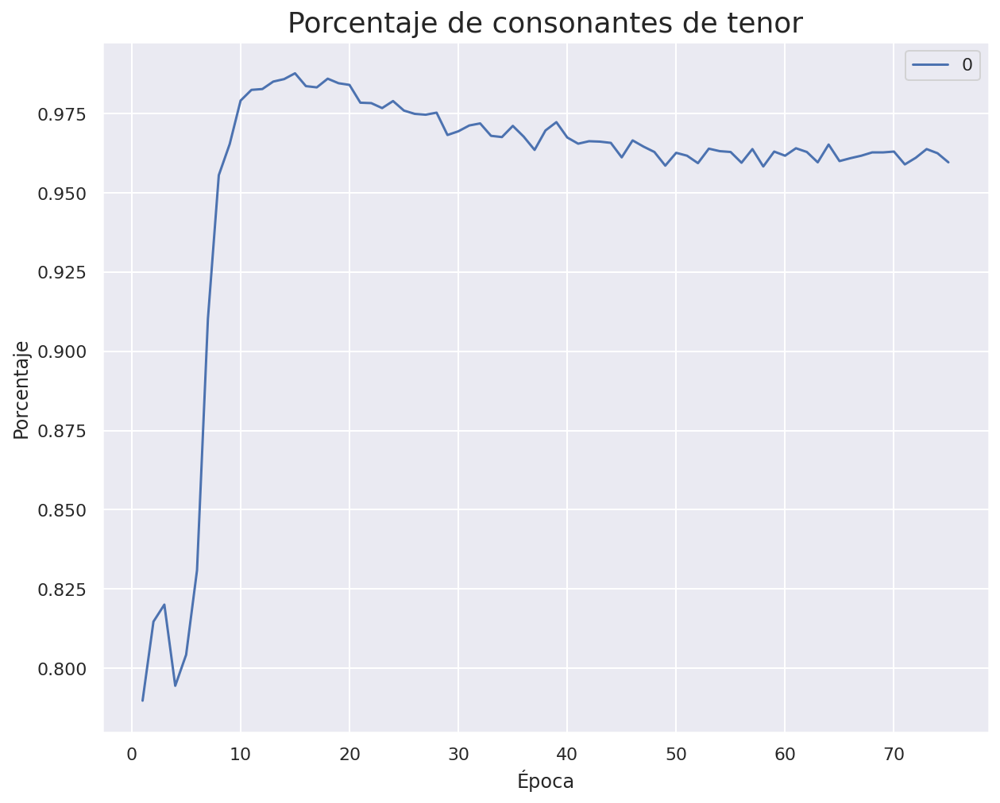

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_64 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_64 (LSTM)                 (None, 42)           11256       ['embedding_64[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

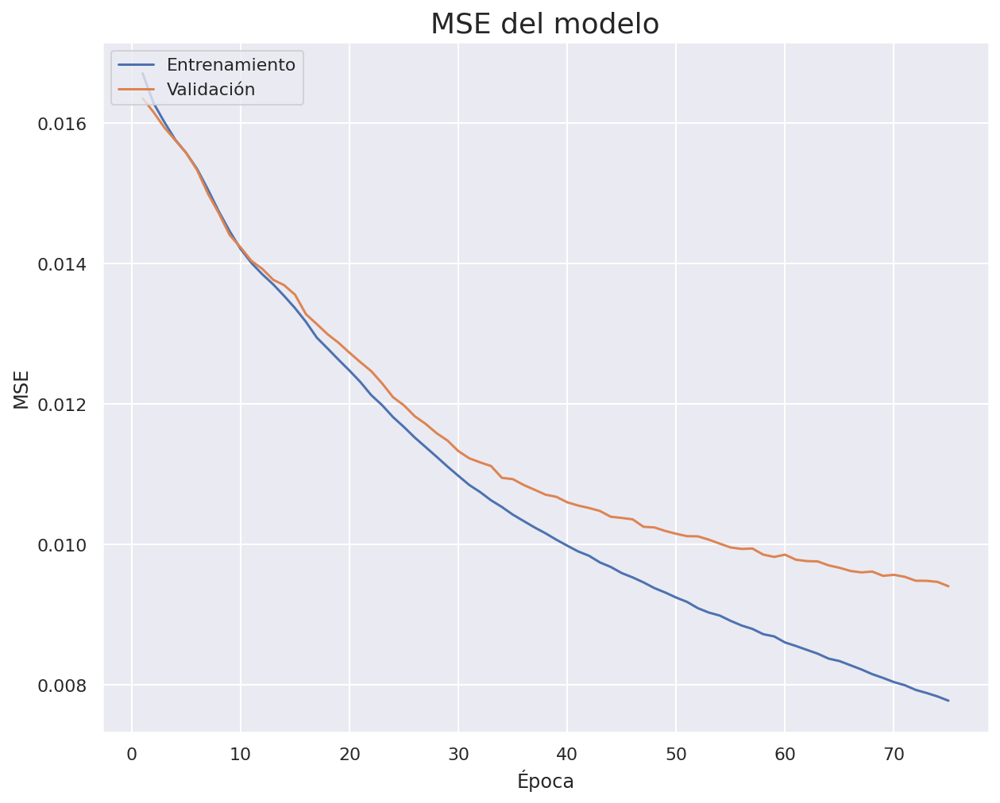

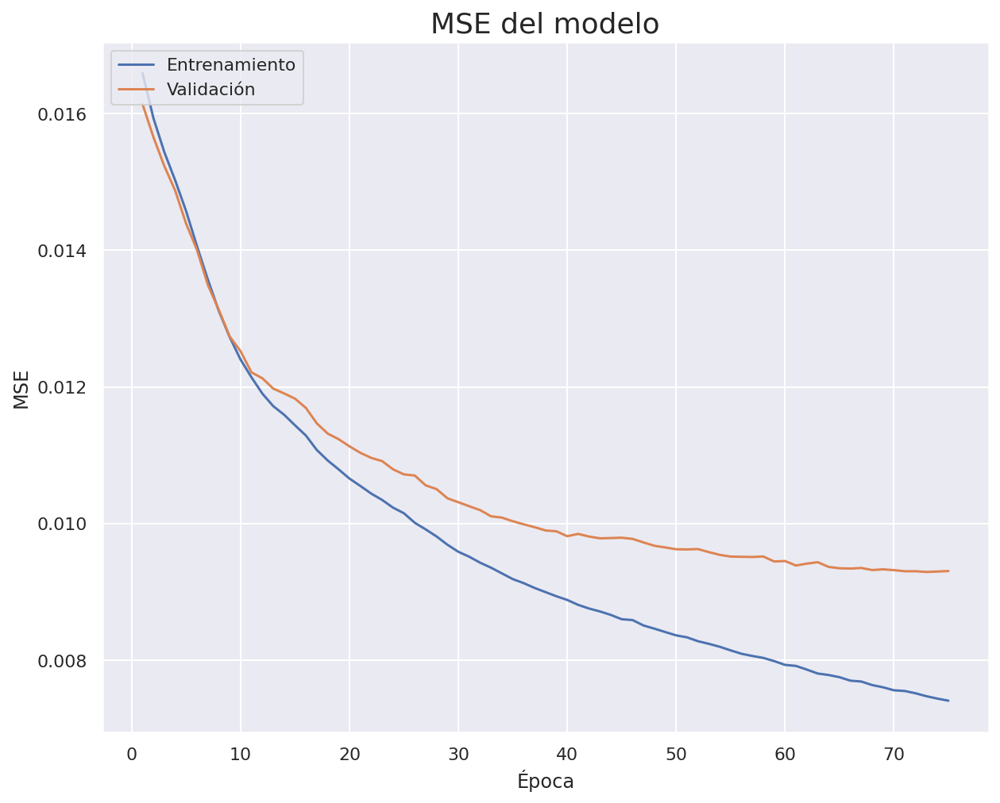

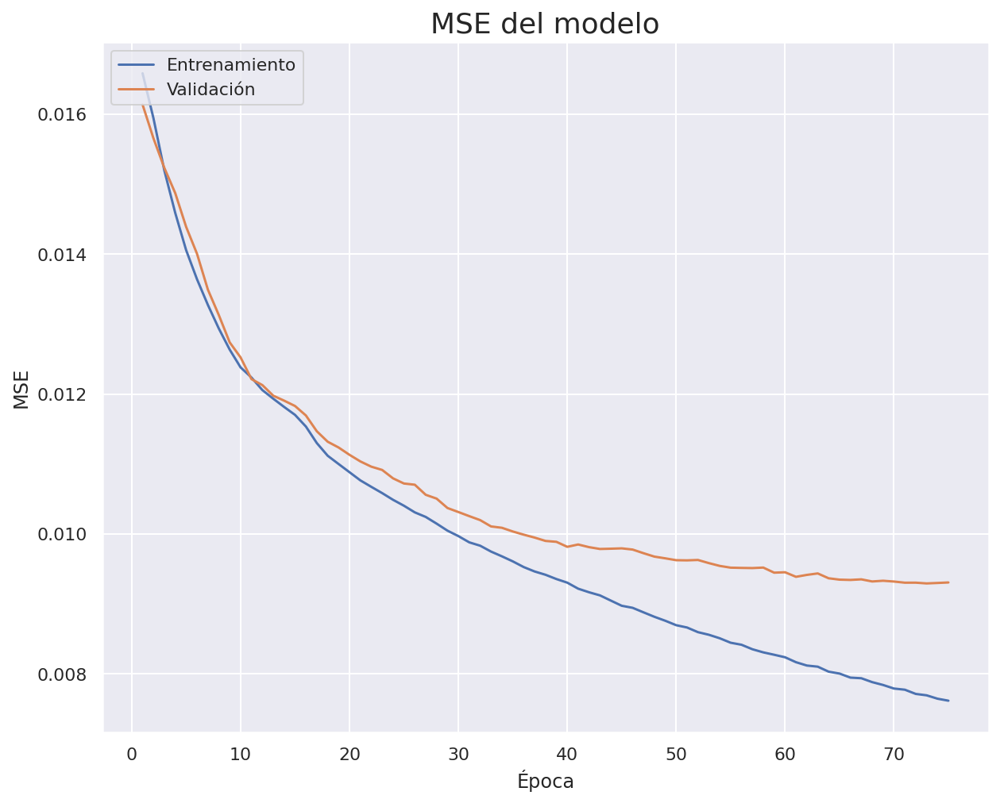

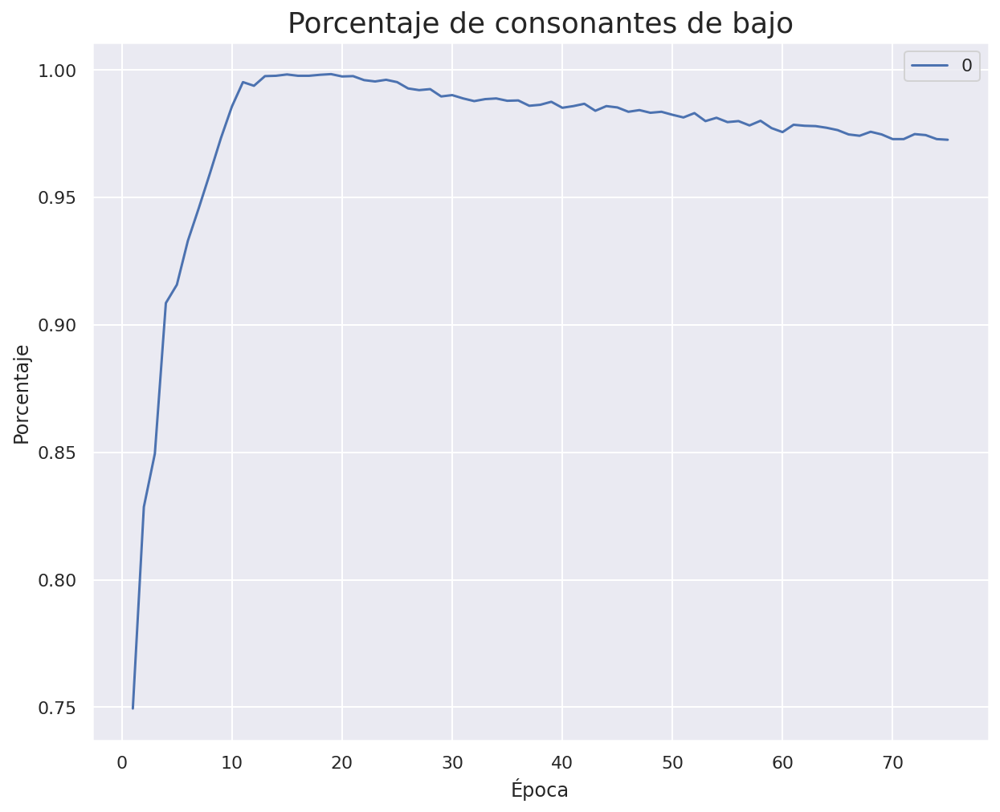

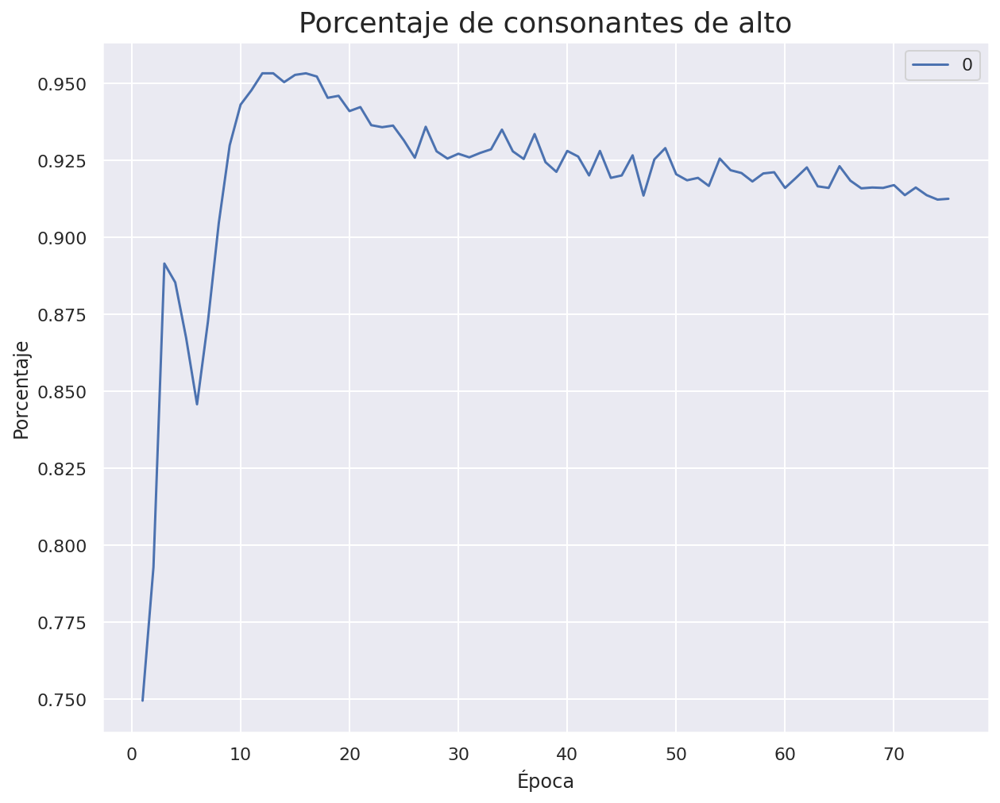

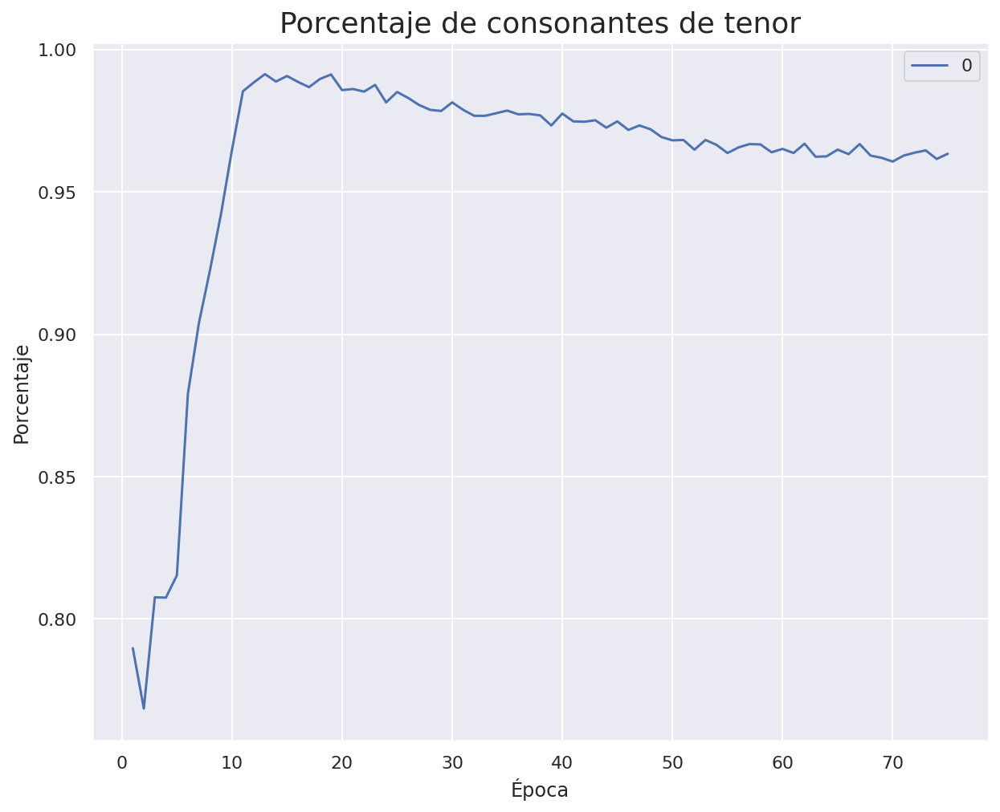

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_66 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_66 (LSTM)                 (None, 43)           11696       ['embedding_66[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

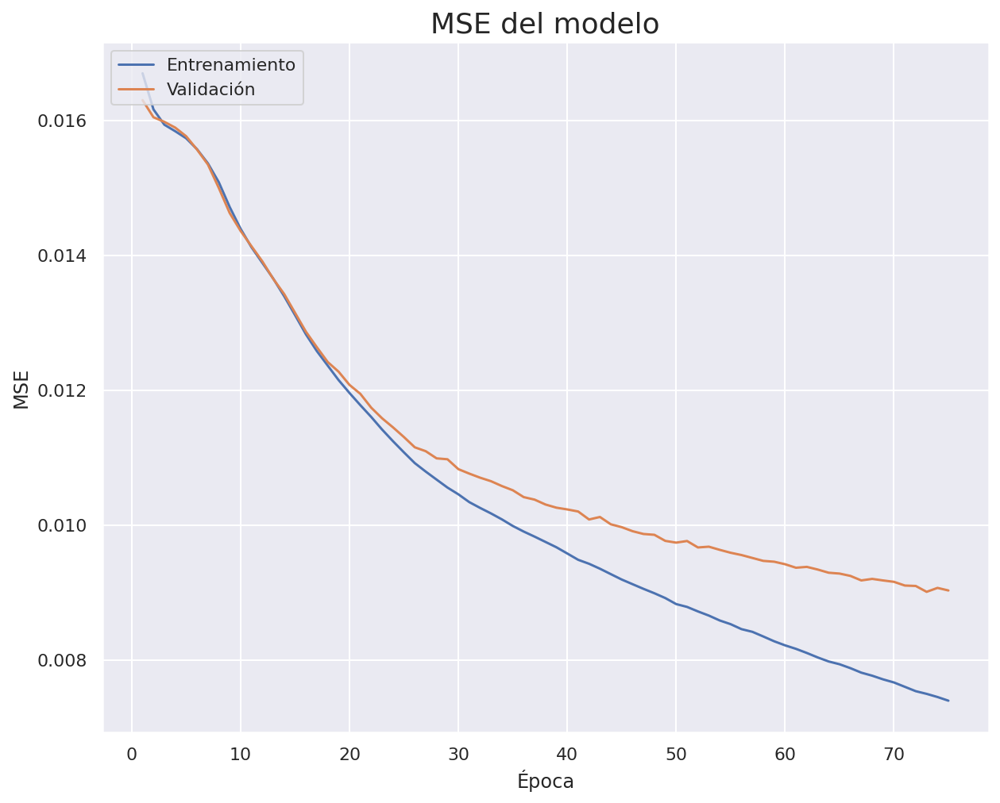

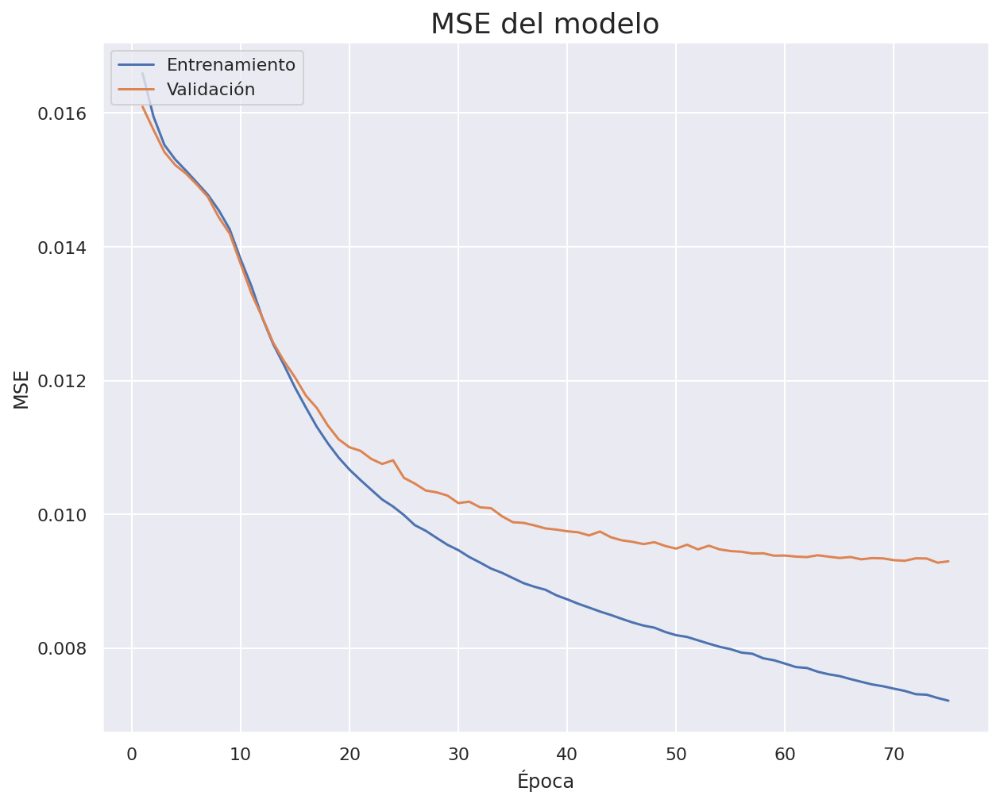

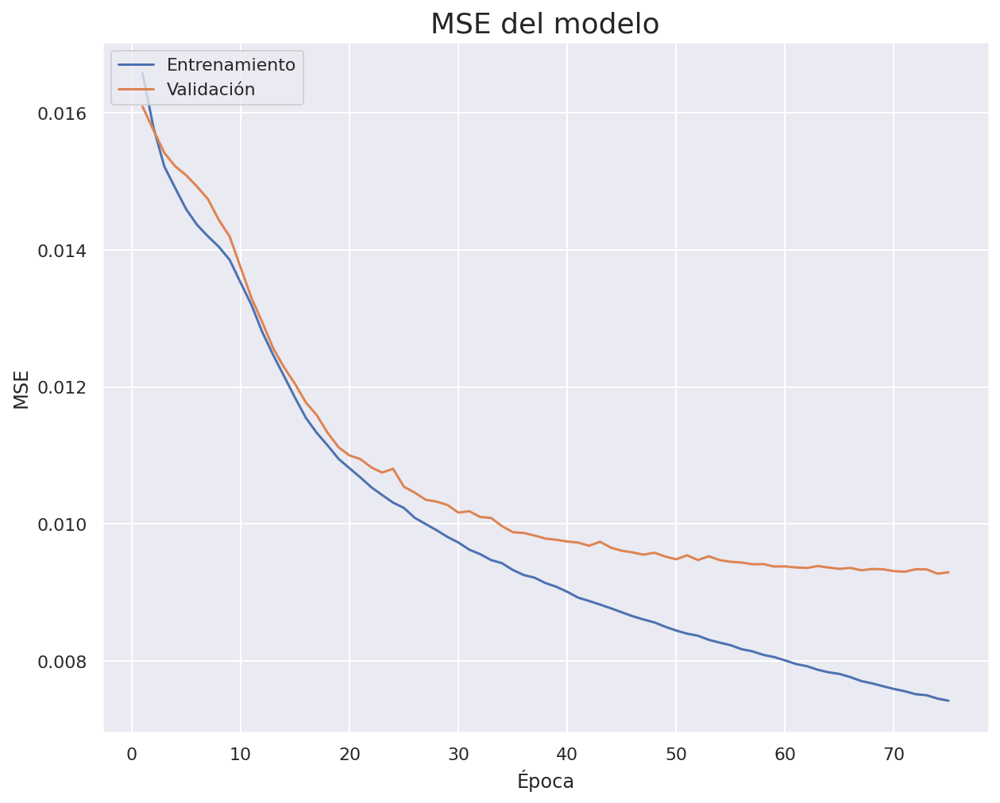

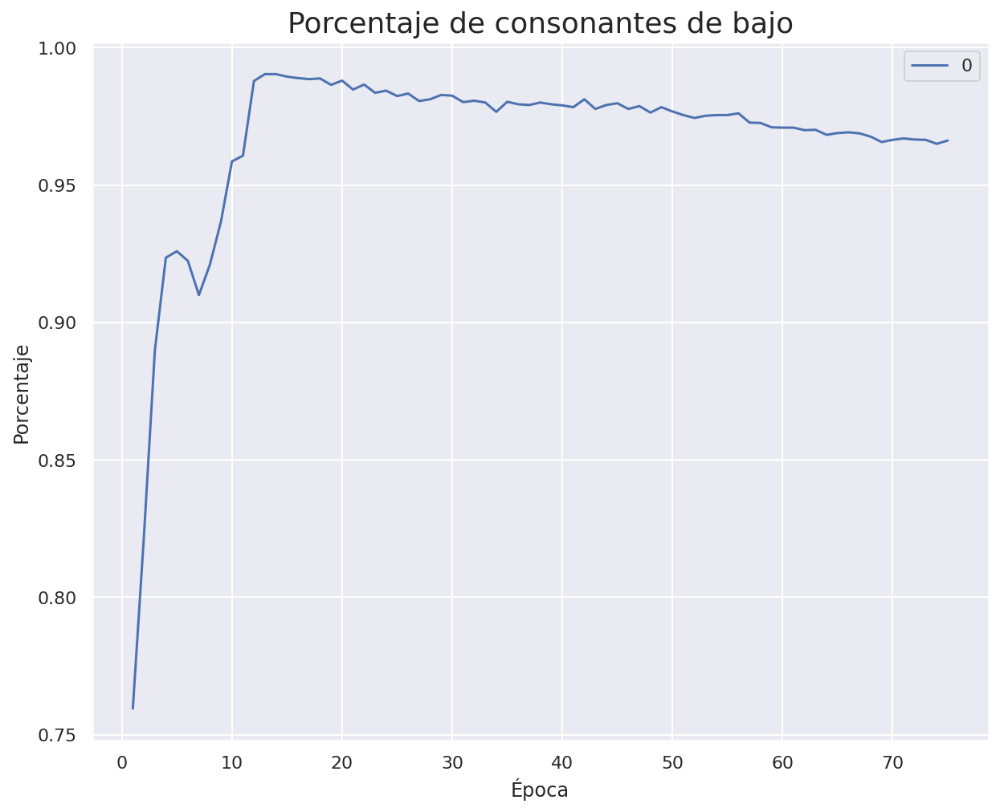

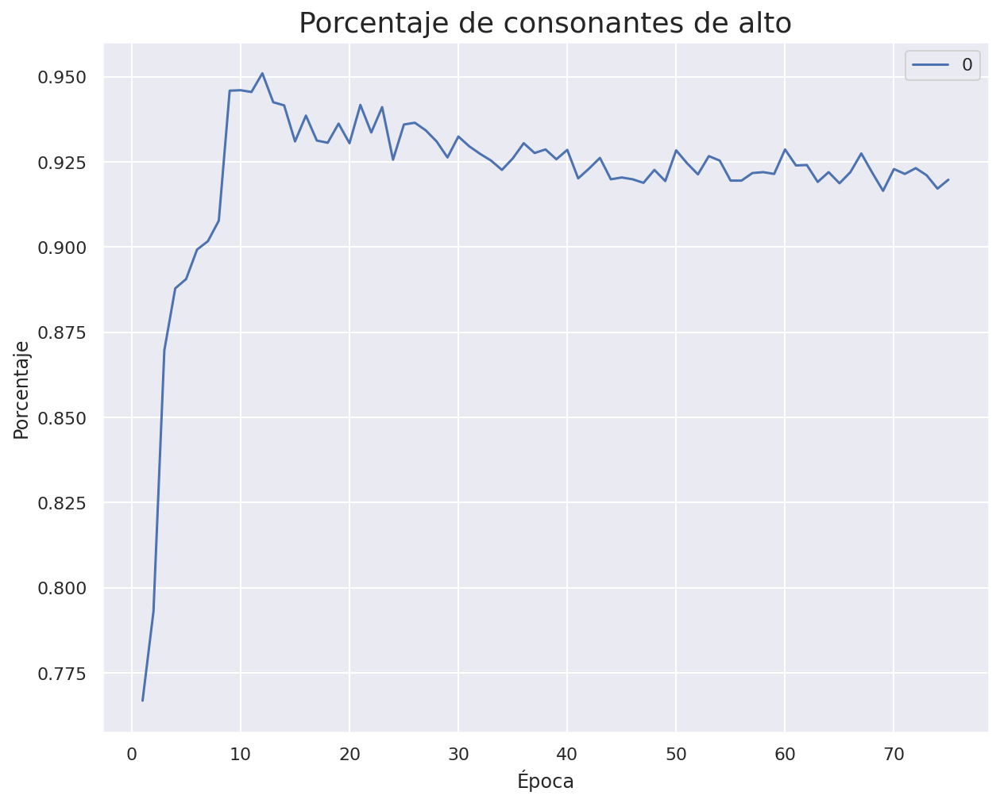

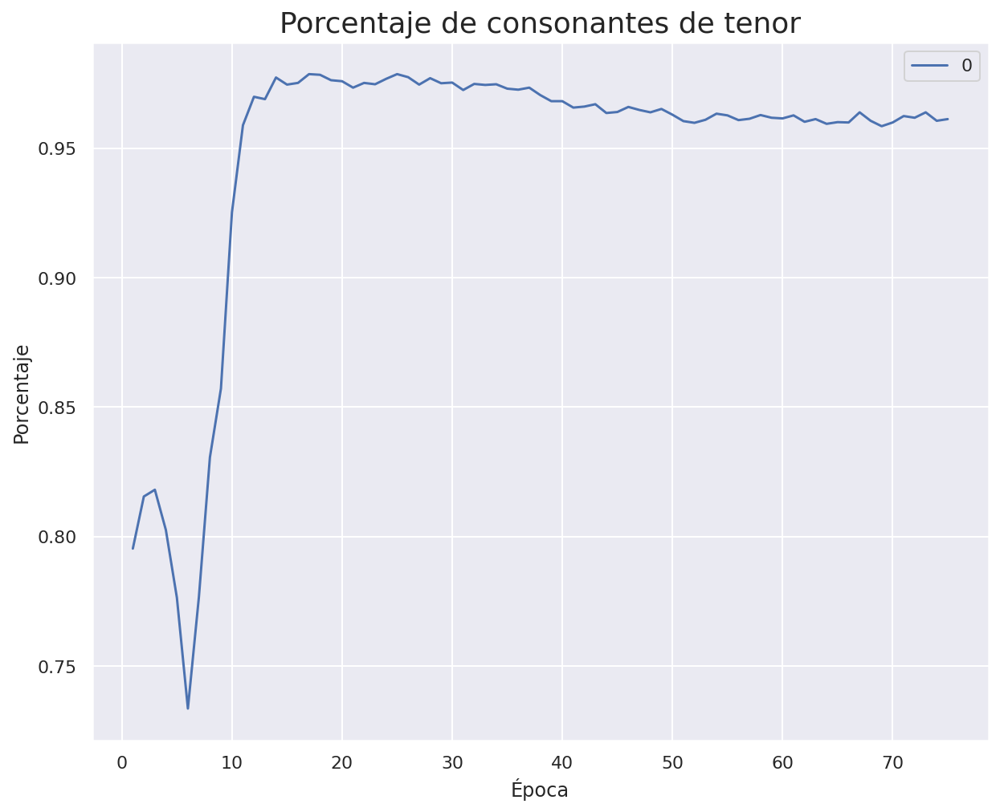

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_68 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_68 (LSTM)                 (None, 44)           12144       ['embedding_68[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

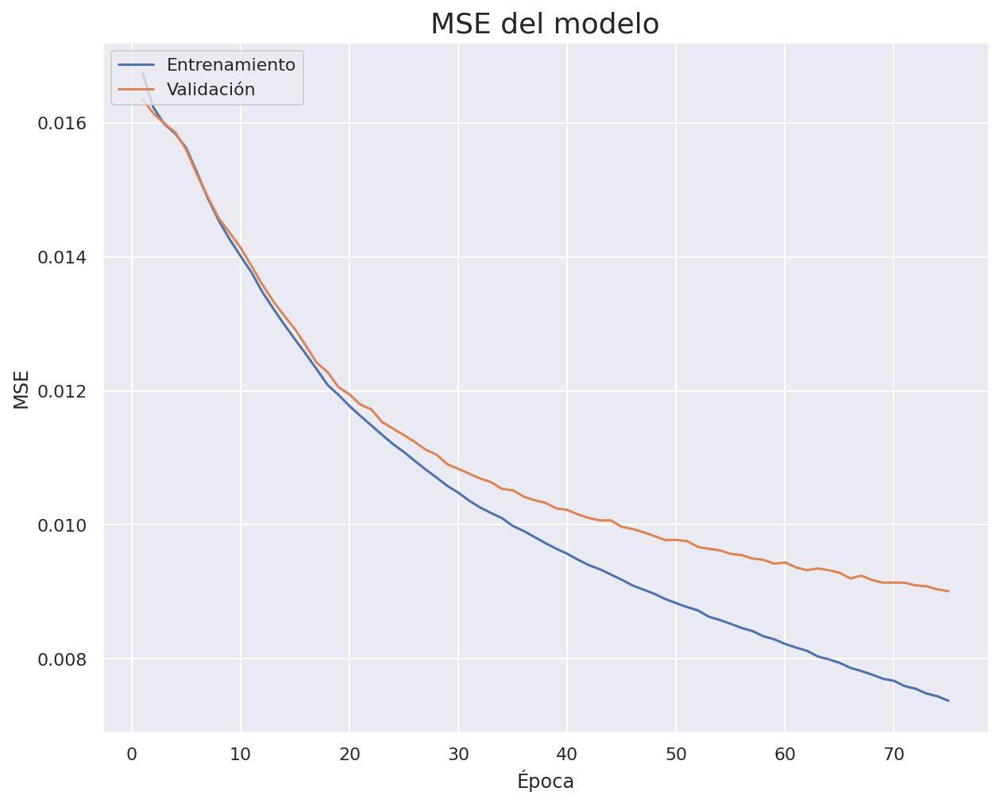

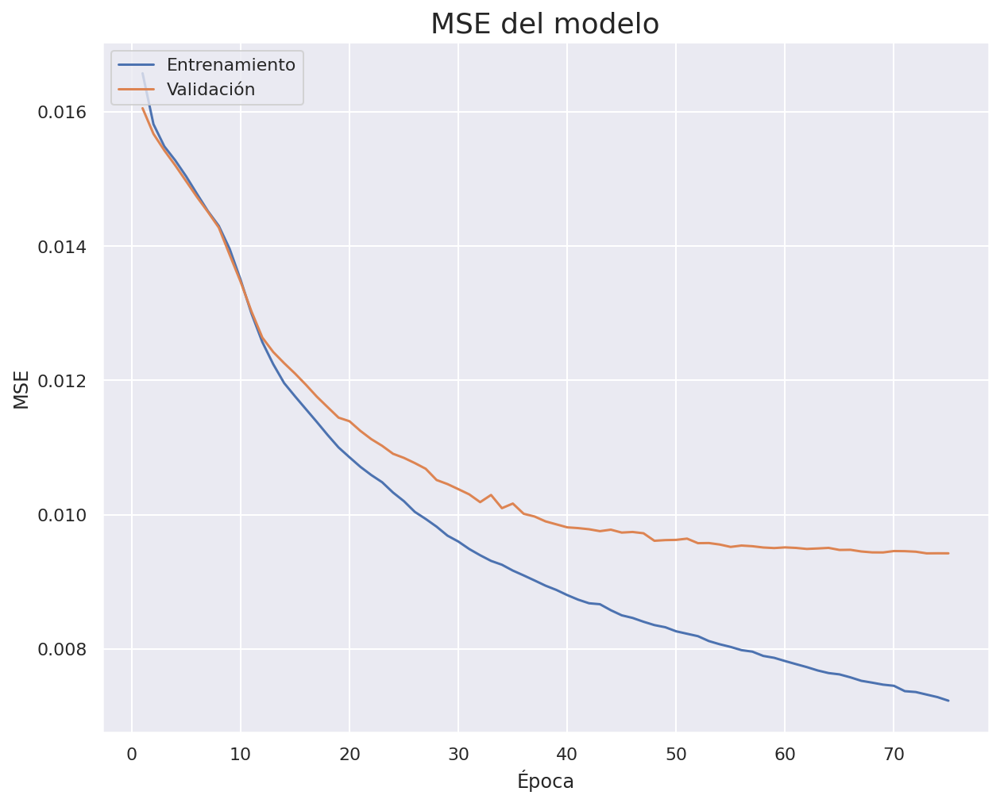

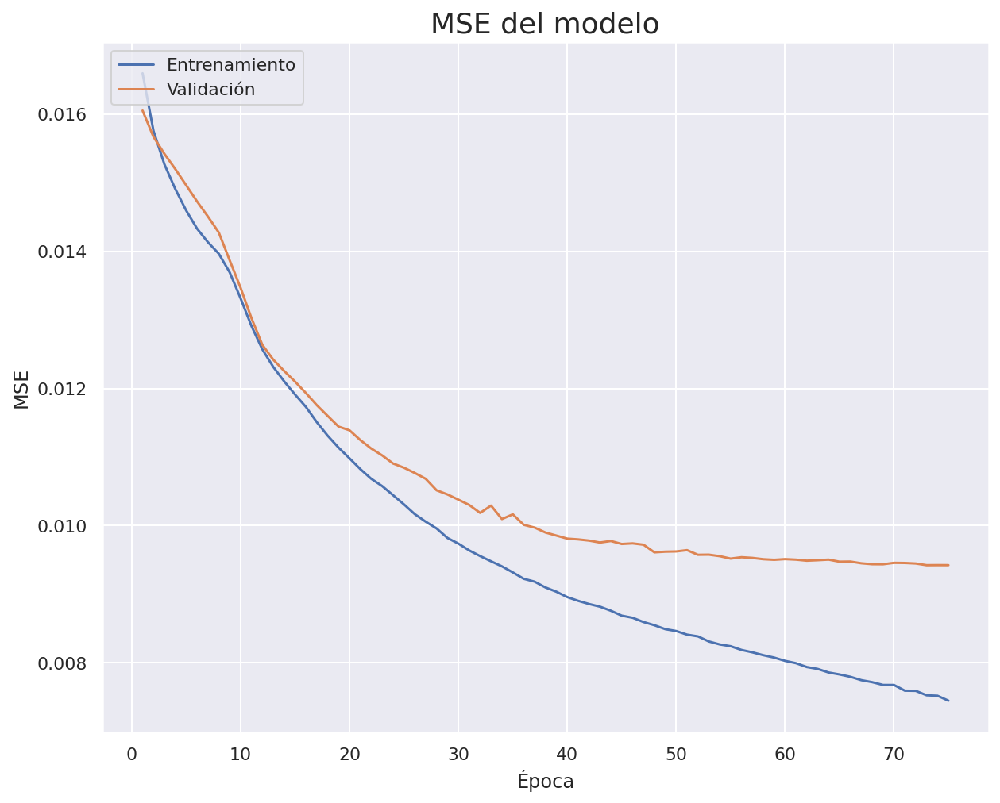

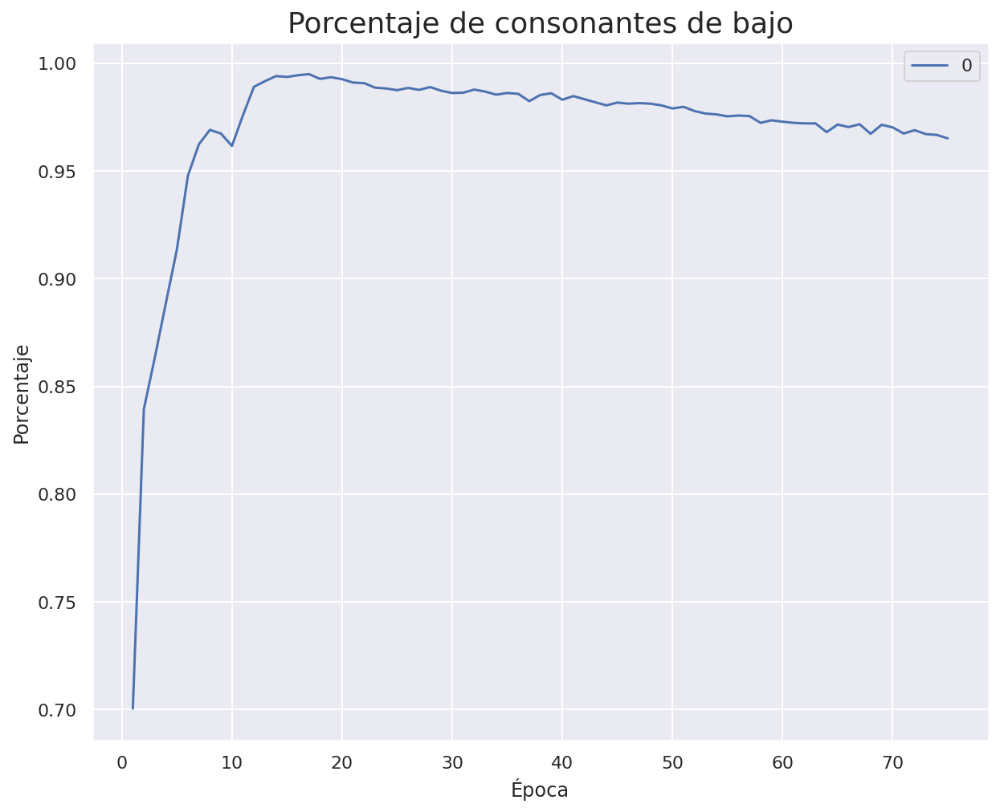

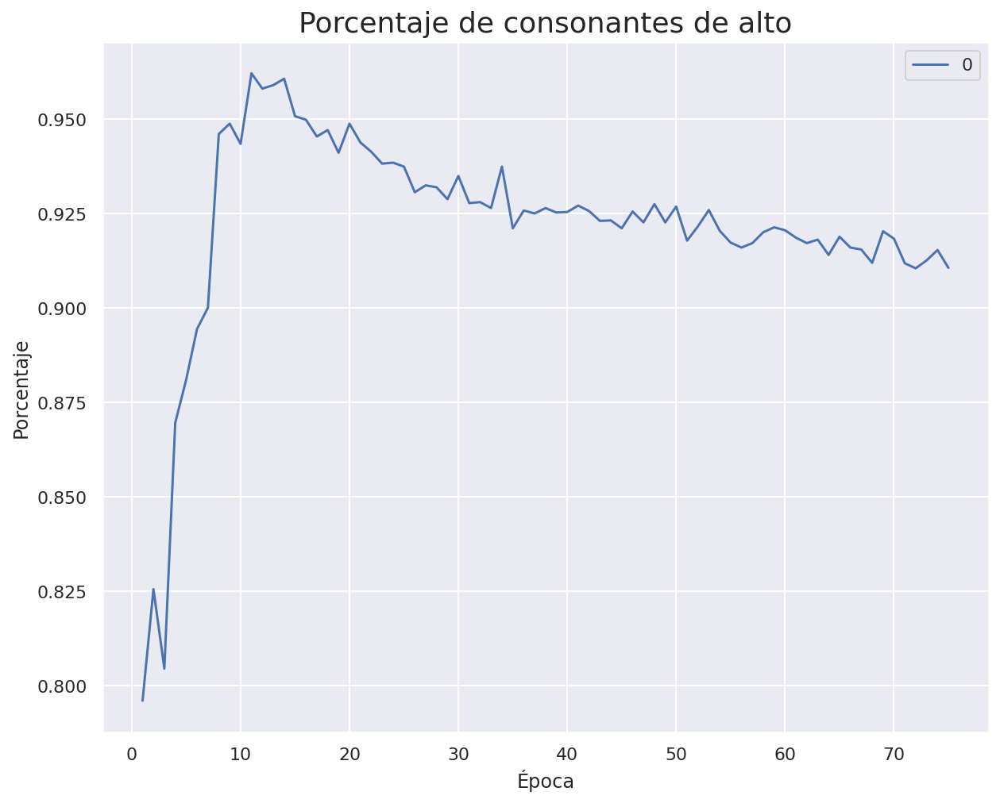

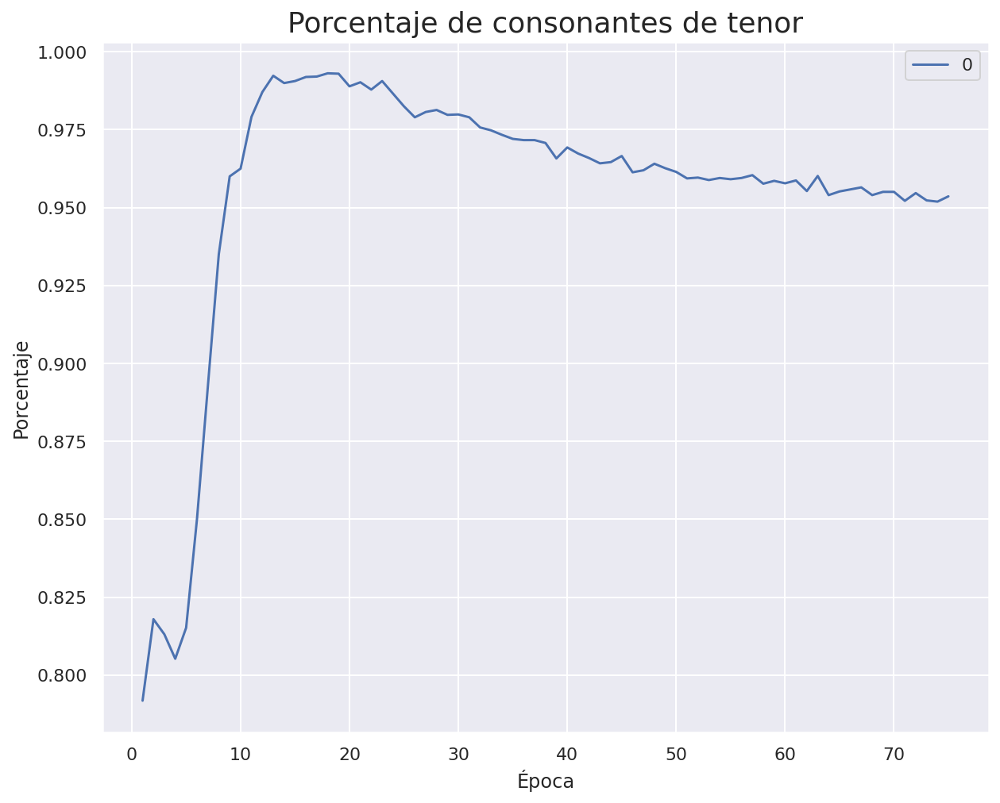

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_70 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_70 (LSTM)                 (None, 45)           12600       ['embedding_70[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

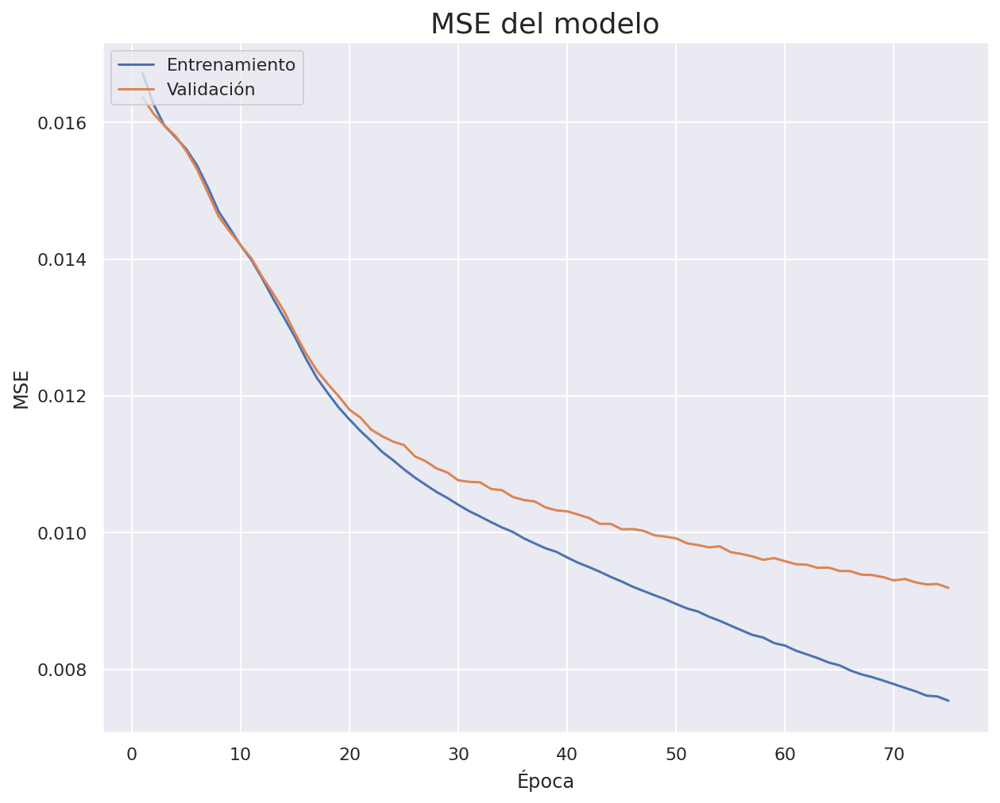

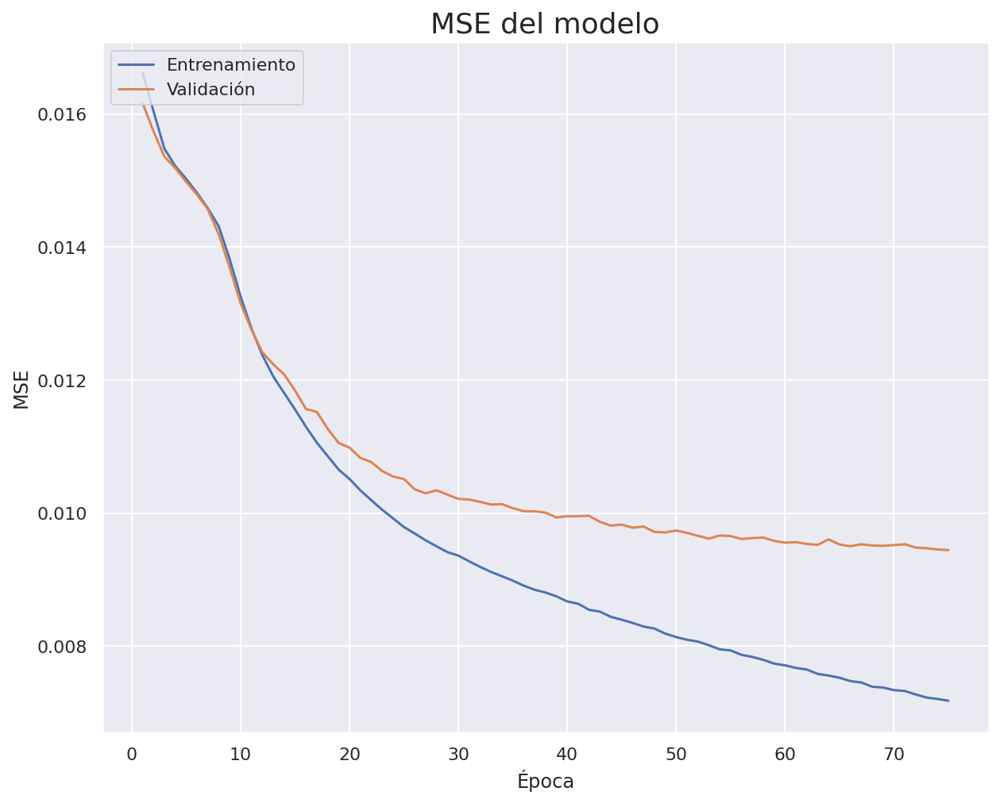

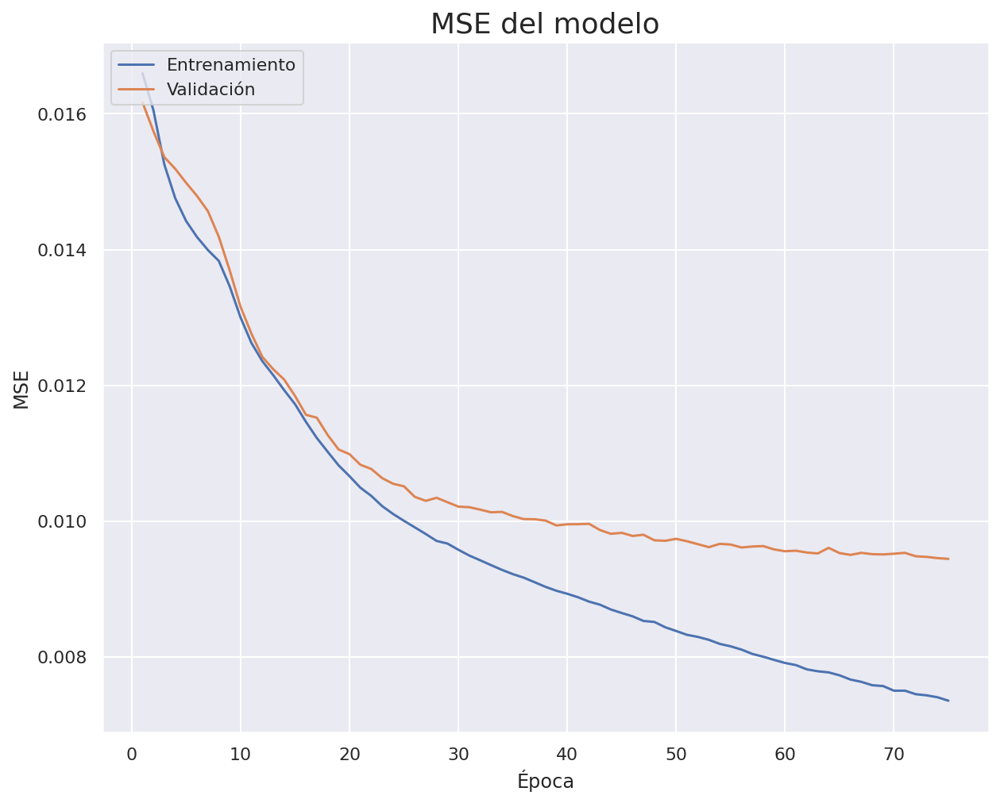

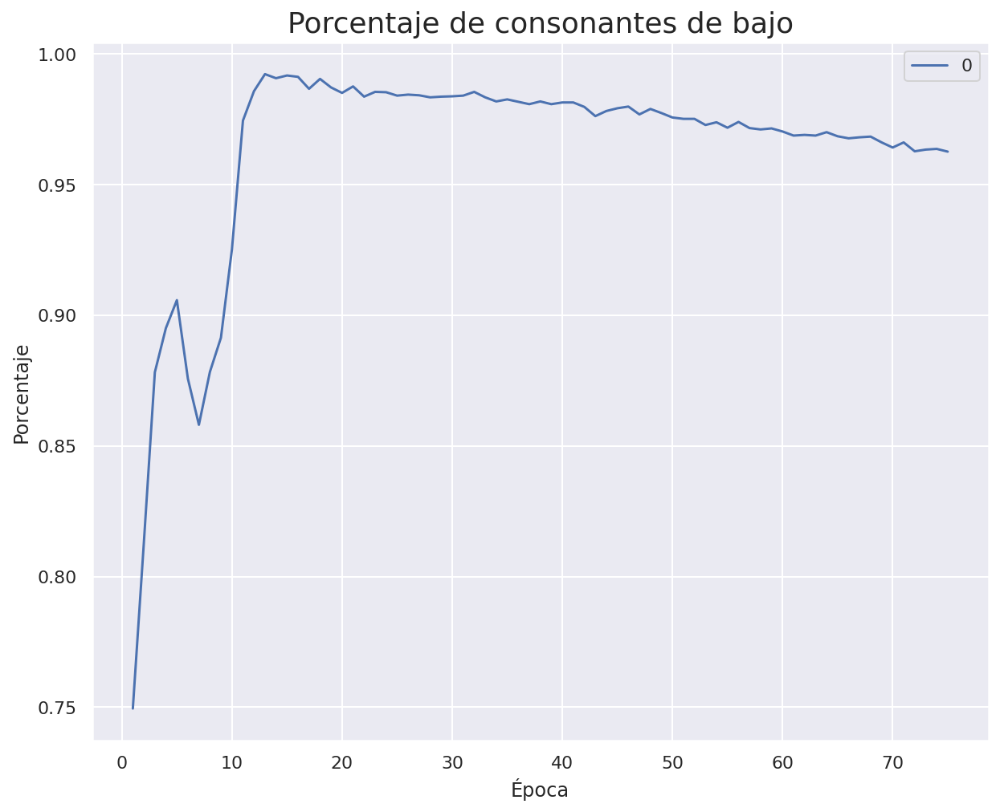

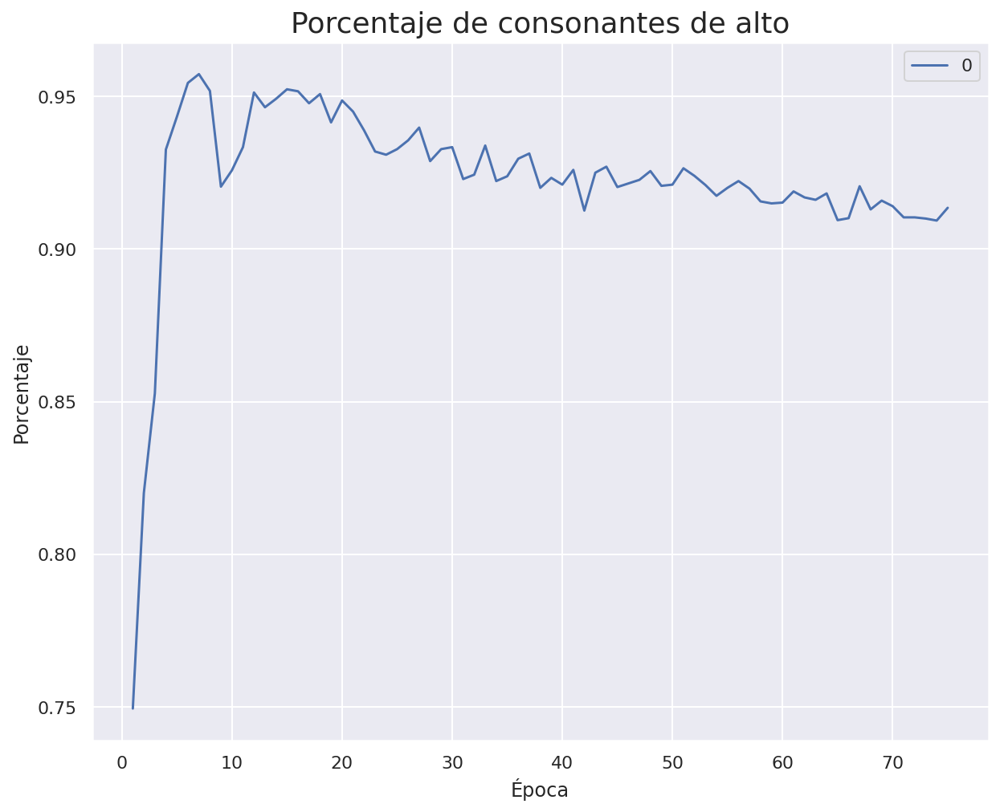

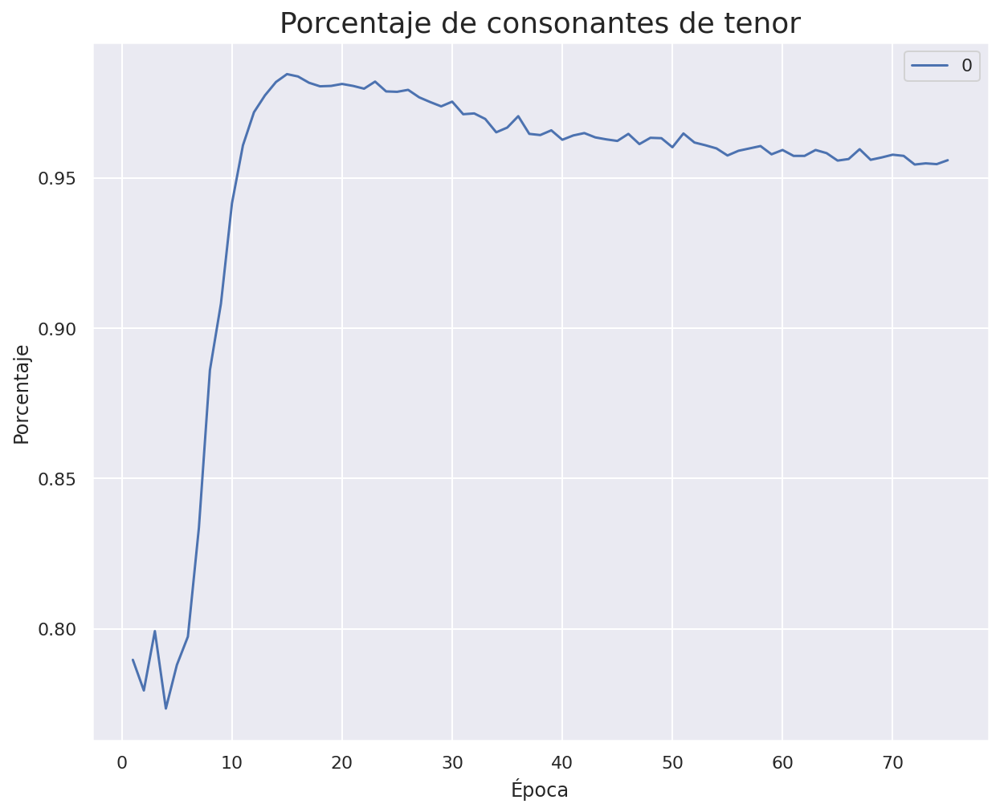

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_72 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_72 (LSTM)                 (None, 46)           13064       ['embedding_72[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

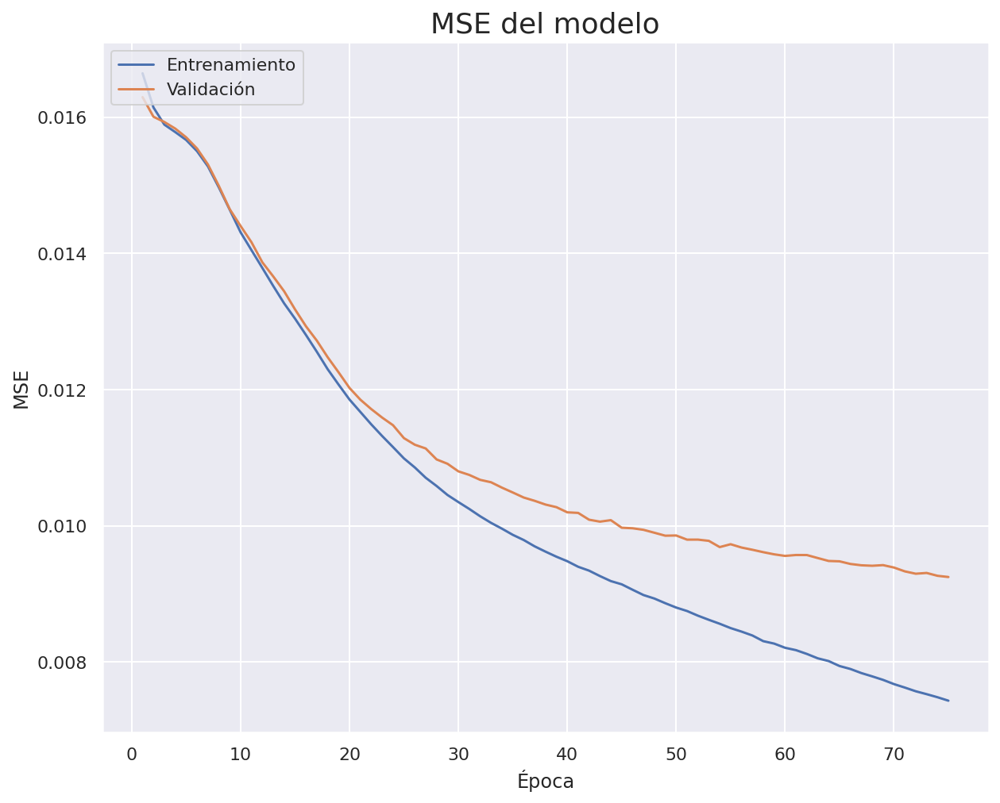

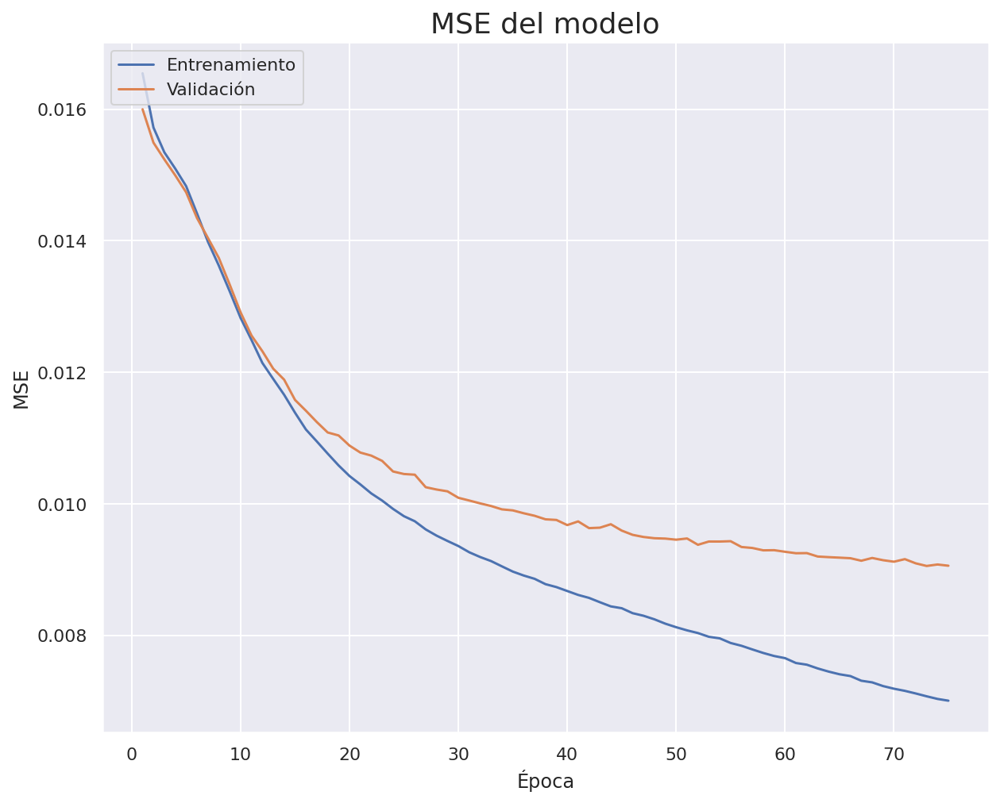

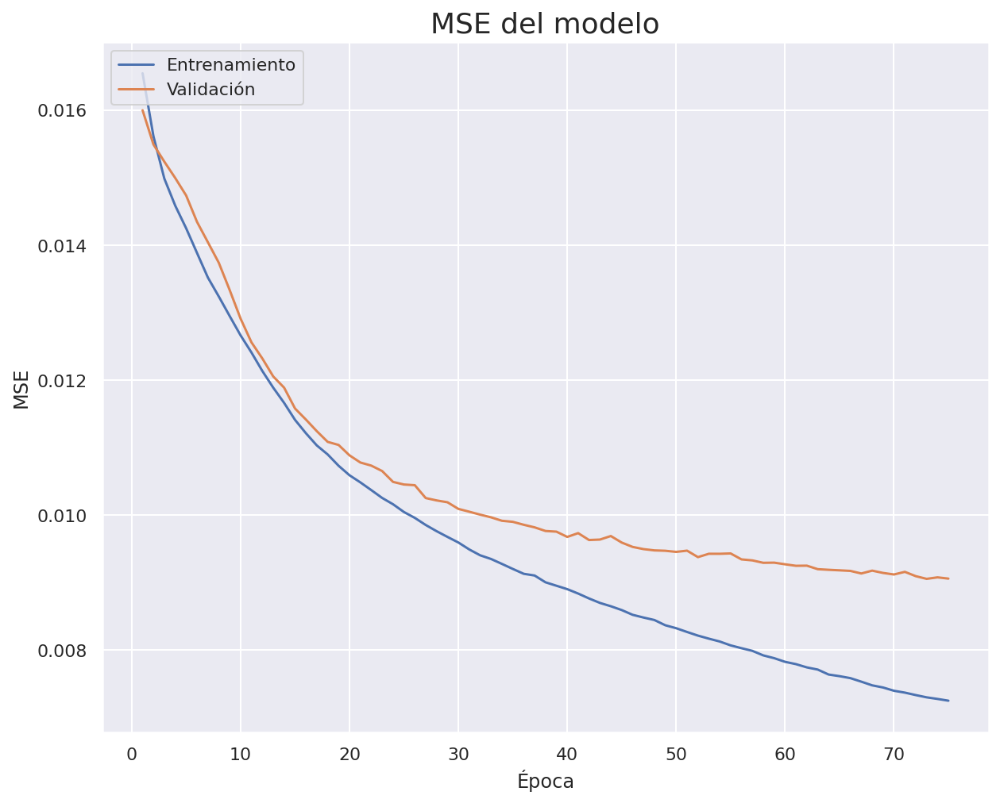

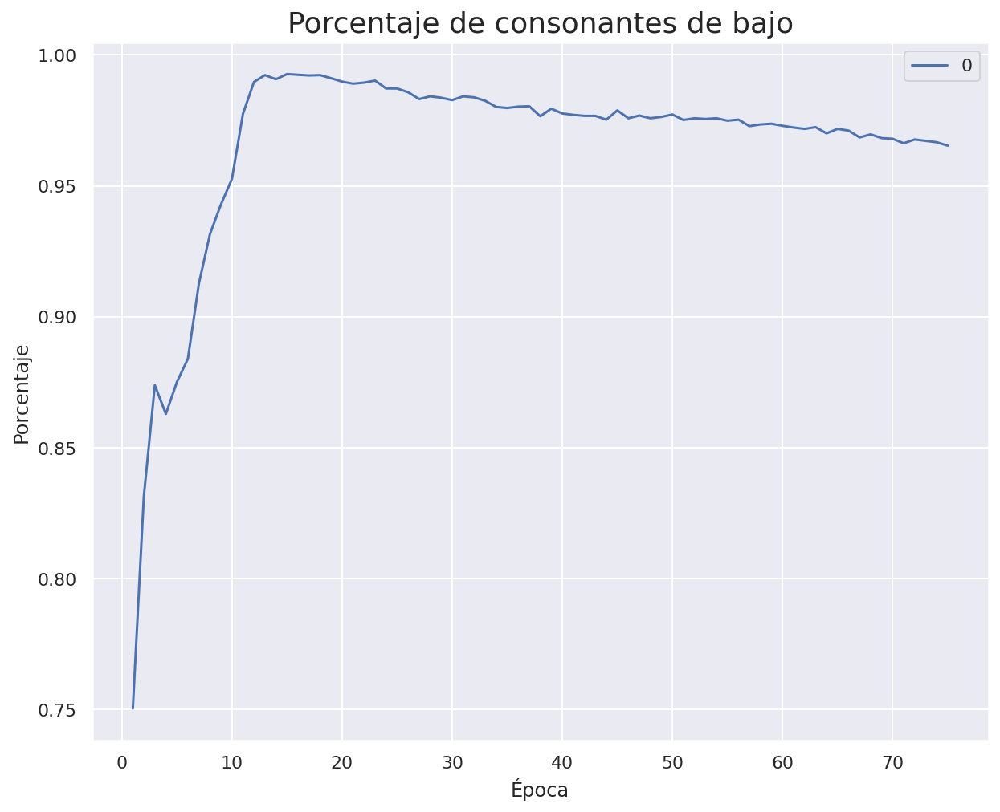

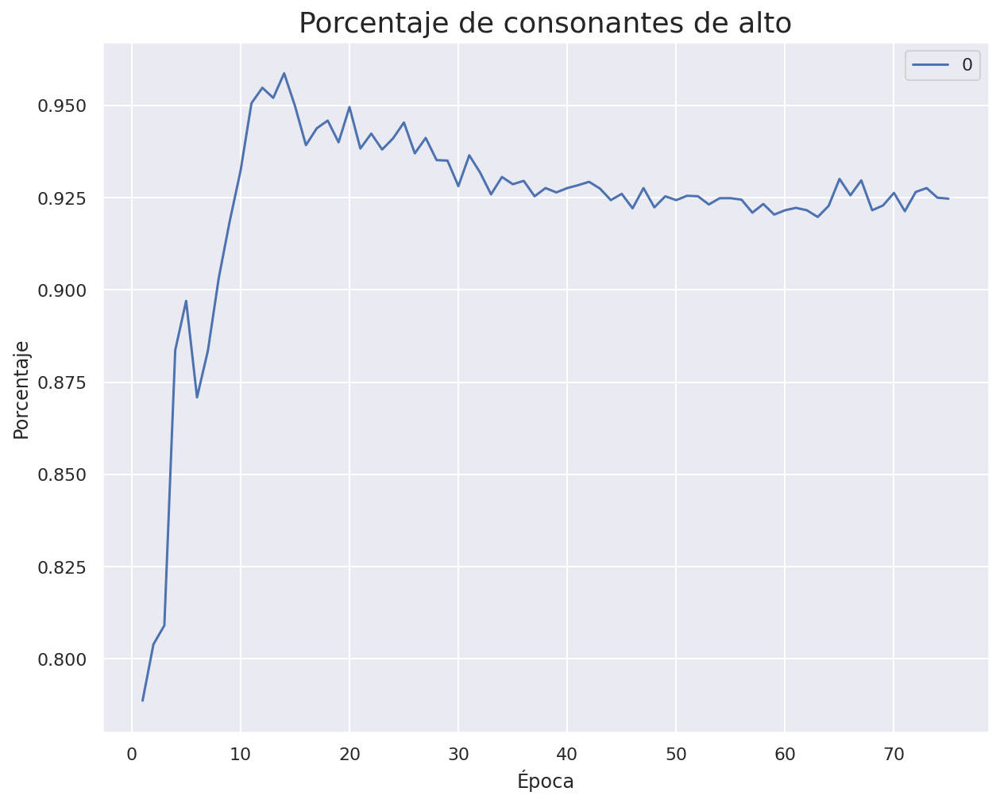

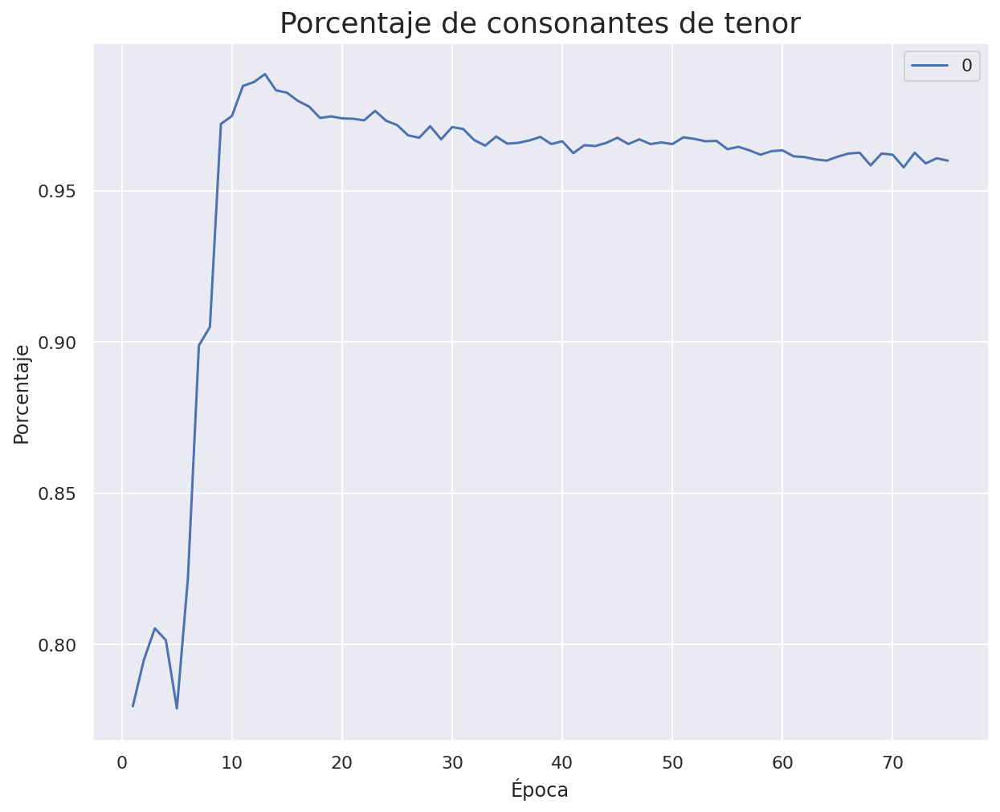

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_74 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_74 (LSTM)                 (None, 47)           13536       ['embedding_74[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

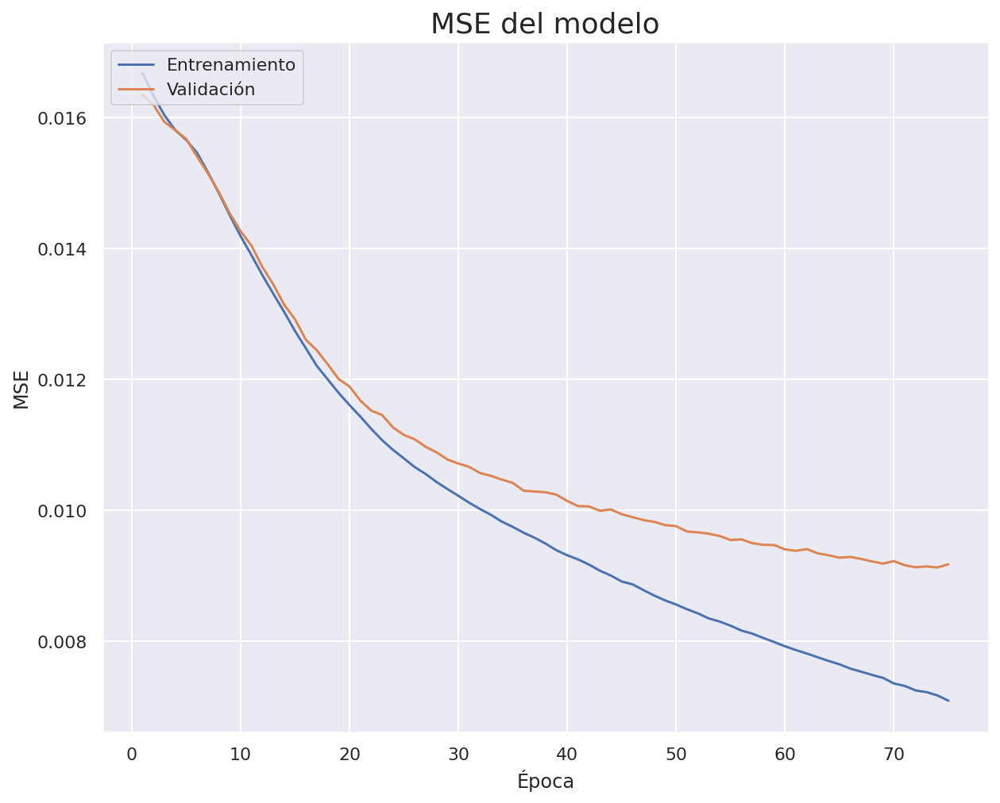

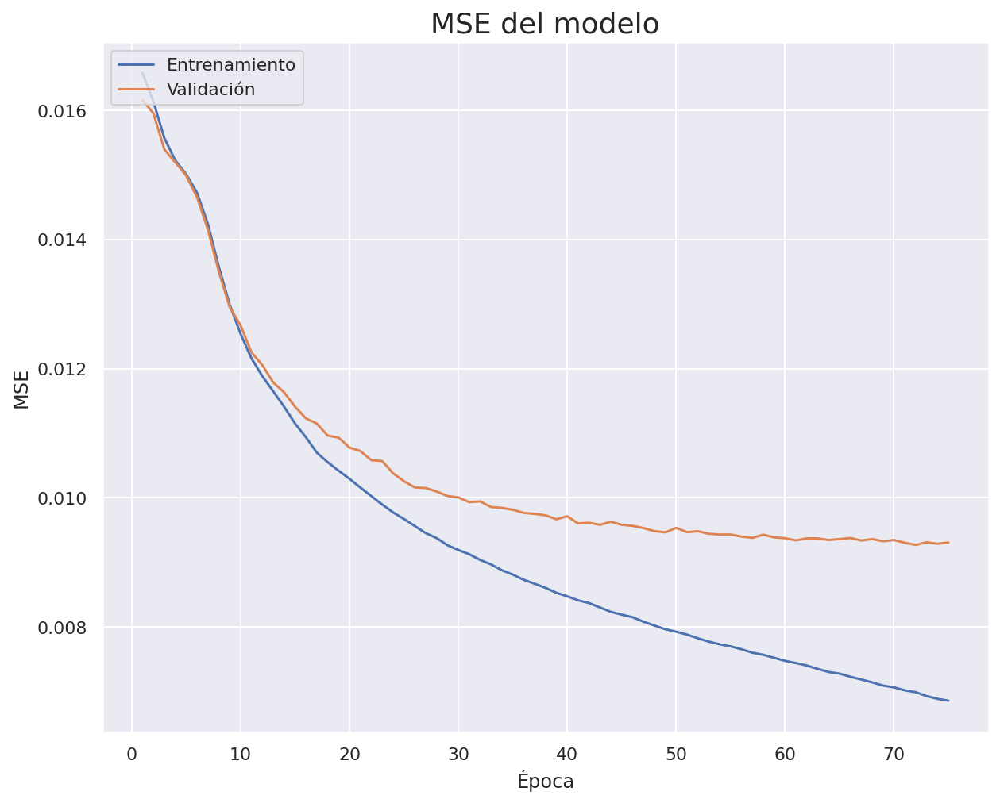

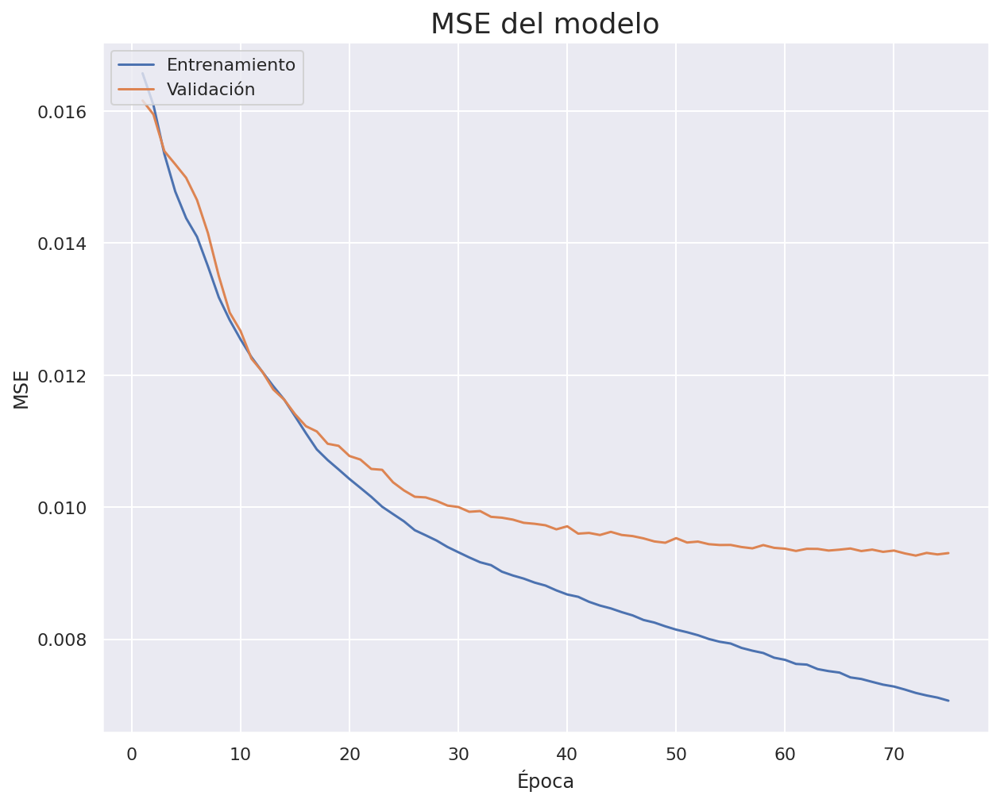

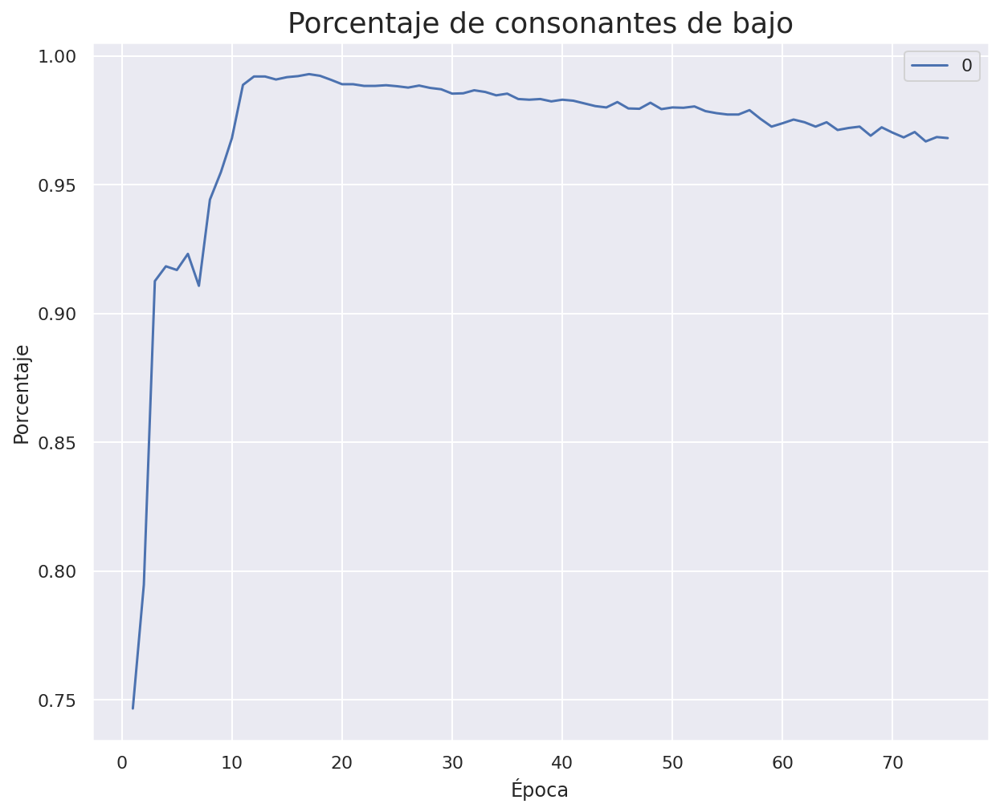

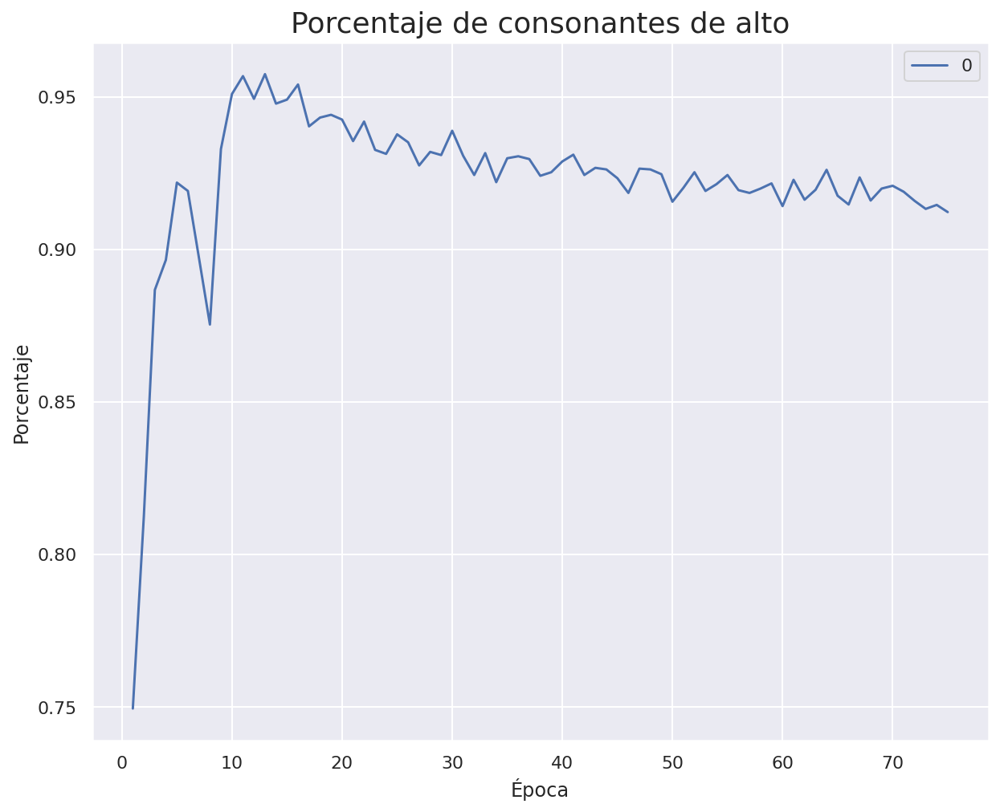

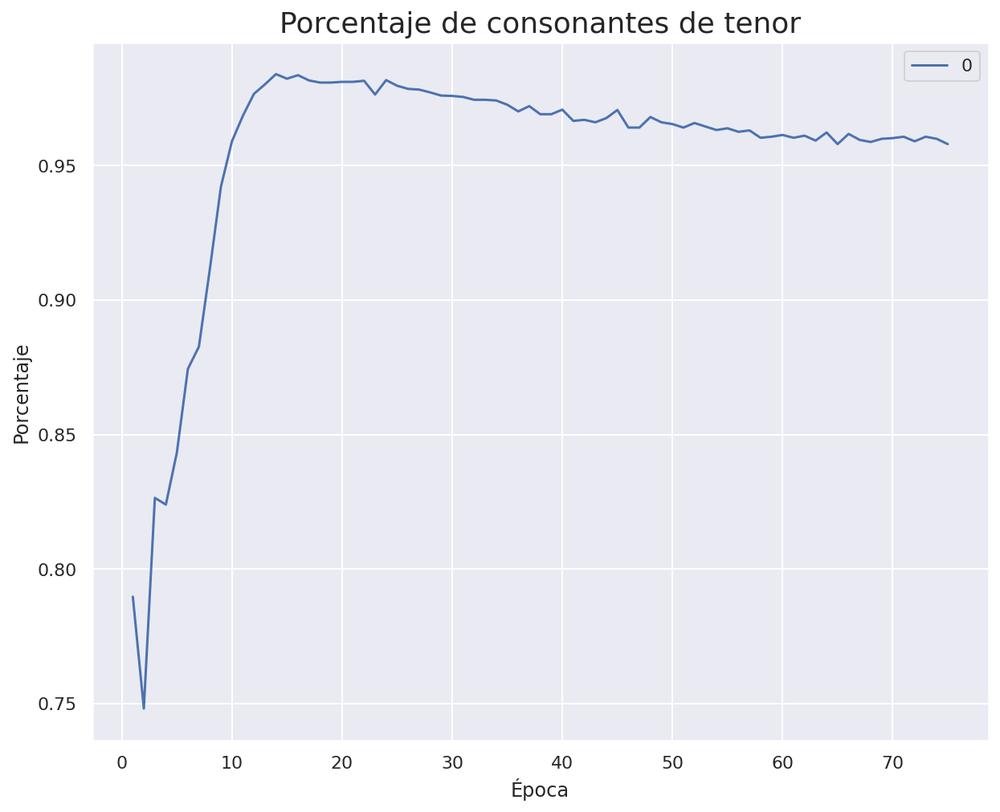

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_76 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_76 (LSTM)                 (None, 48)           14016       ['embedding_76[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

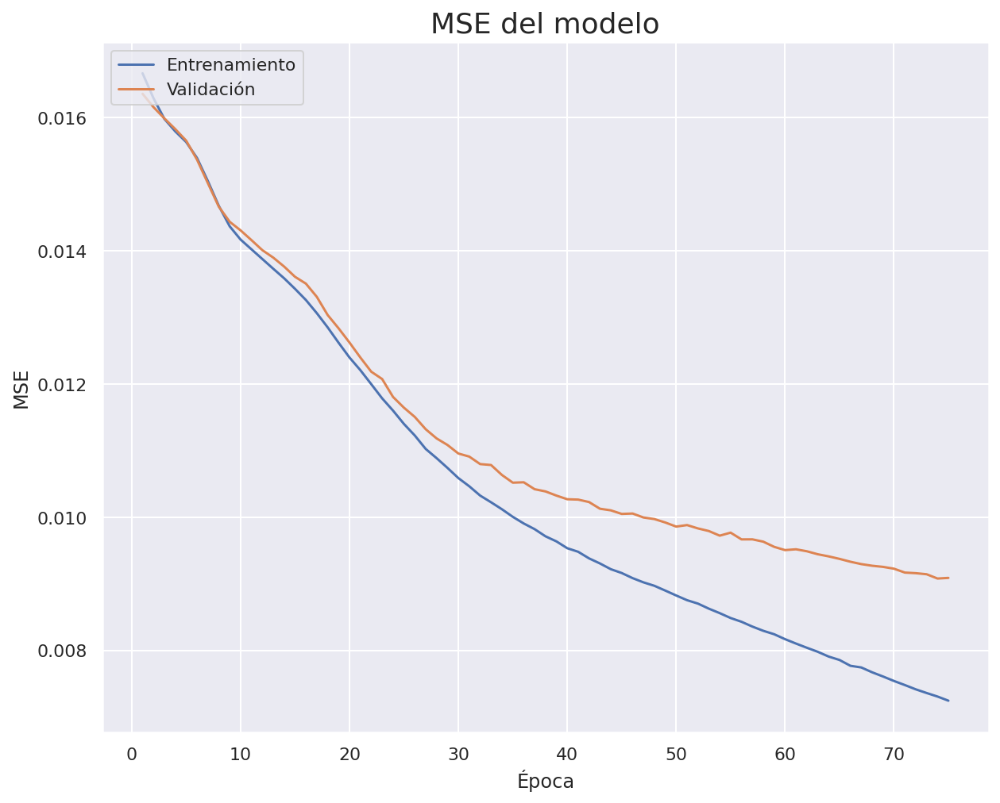

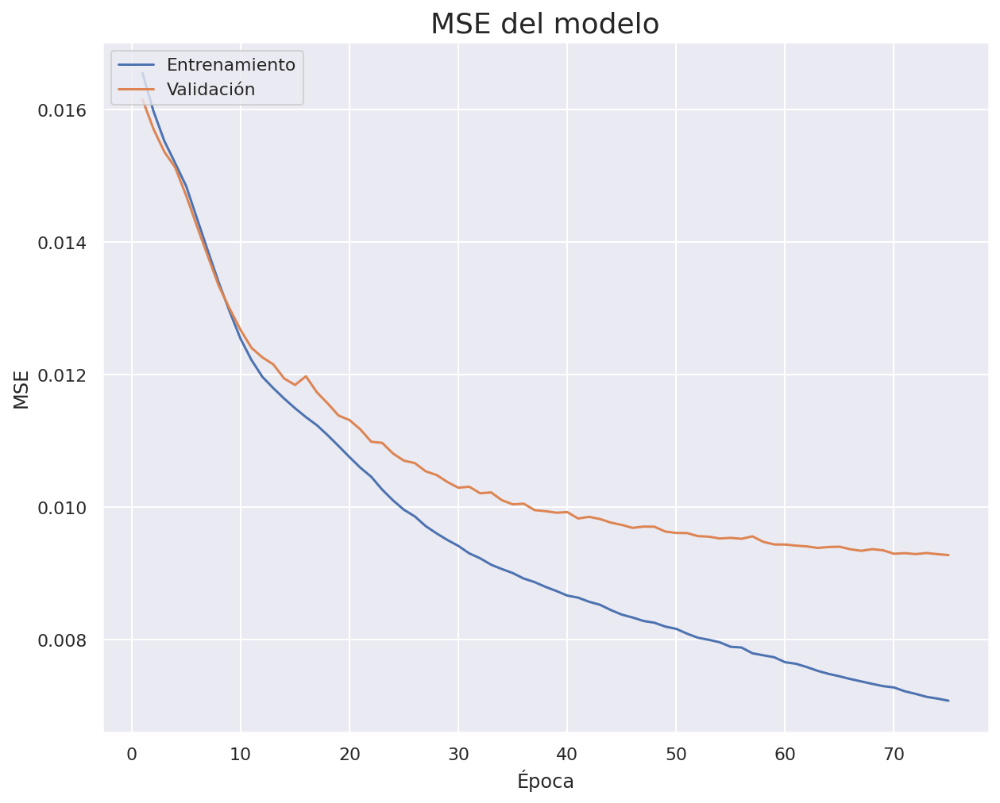

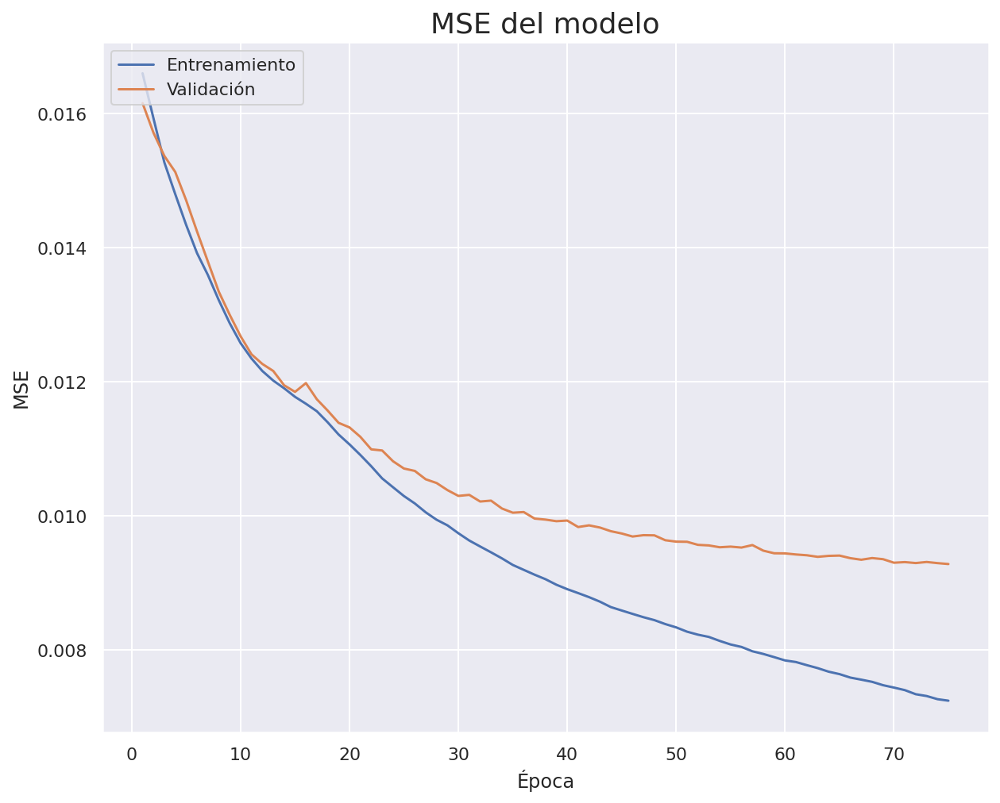

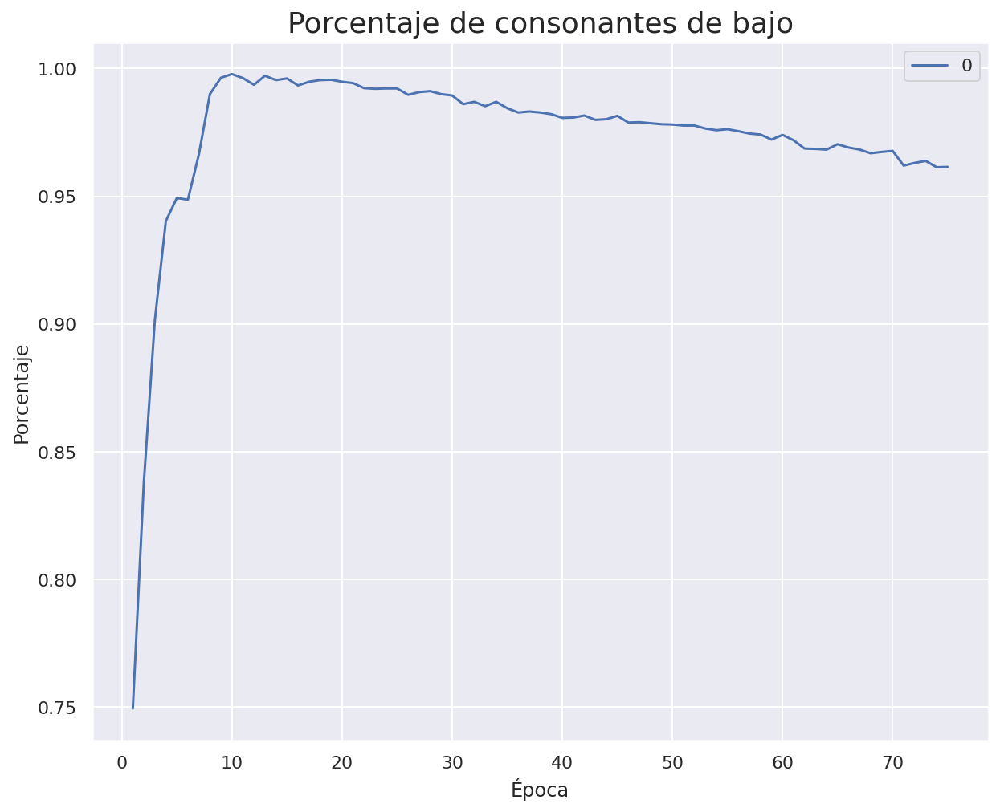

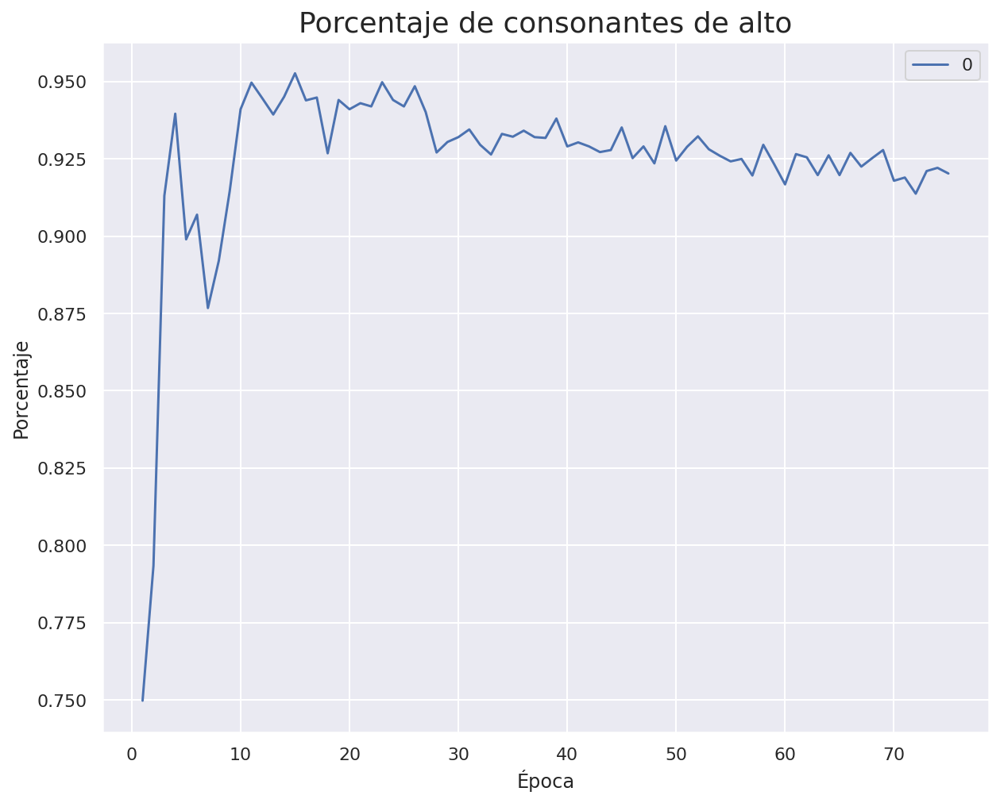

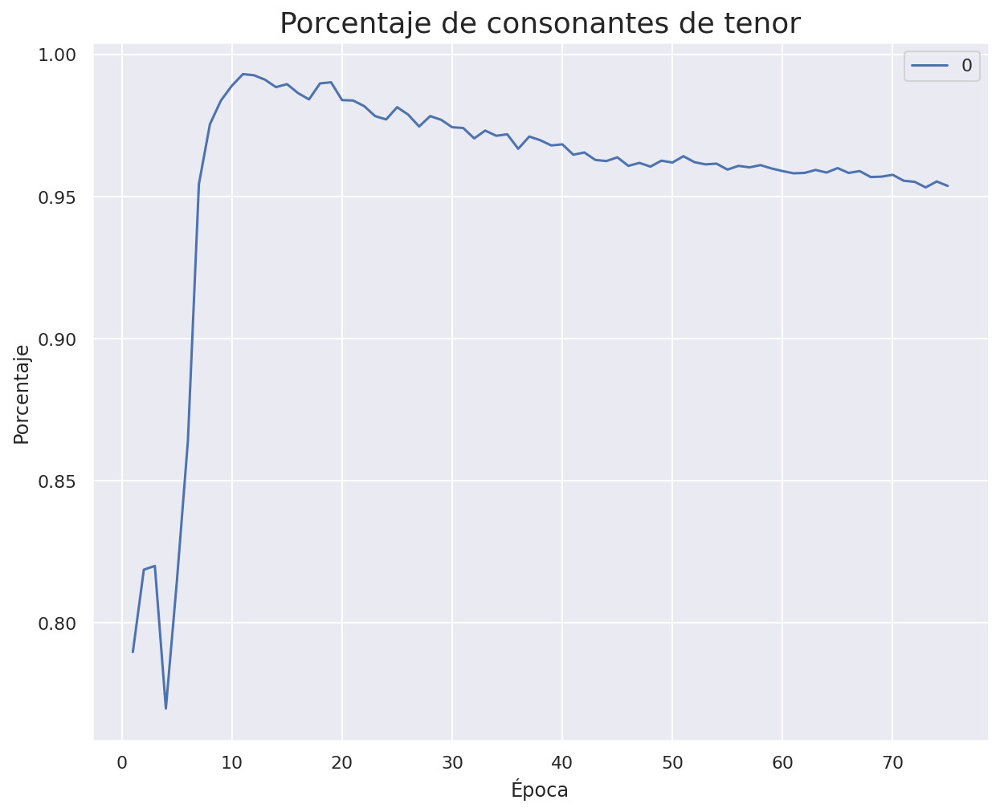

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_78 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_78 (LSTM)                 (None, 49)           14504       ['embedding_78[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

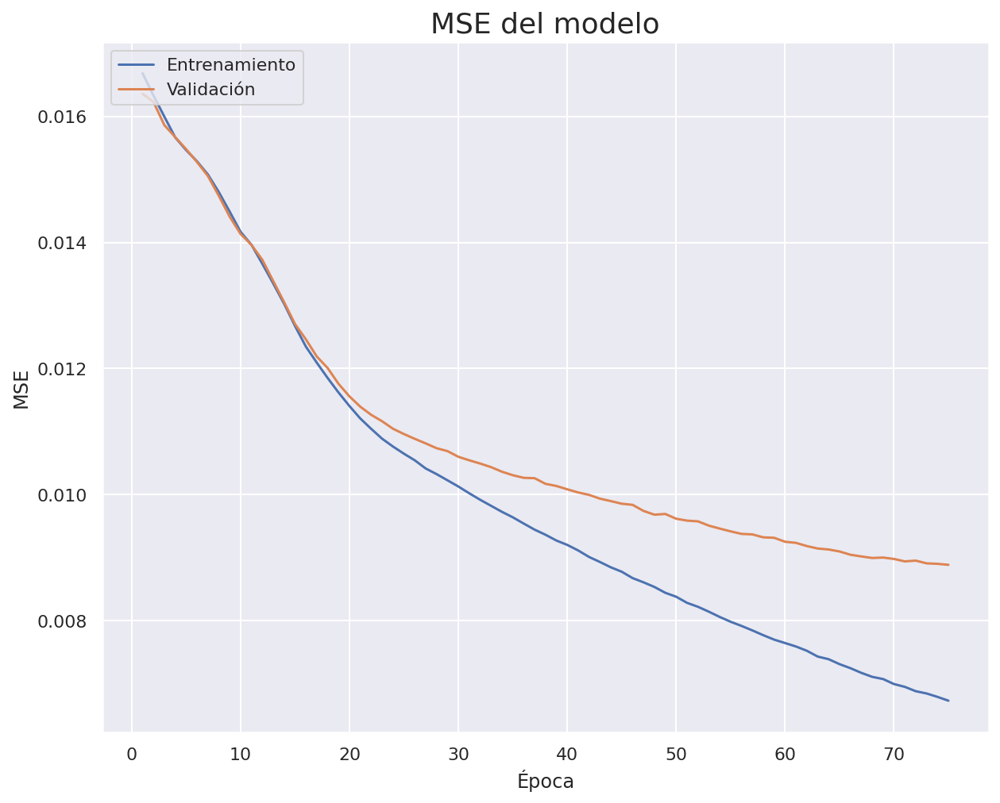

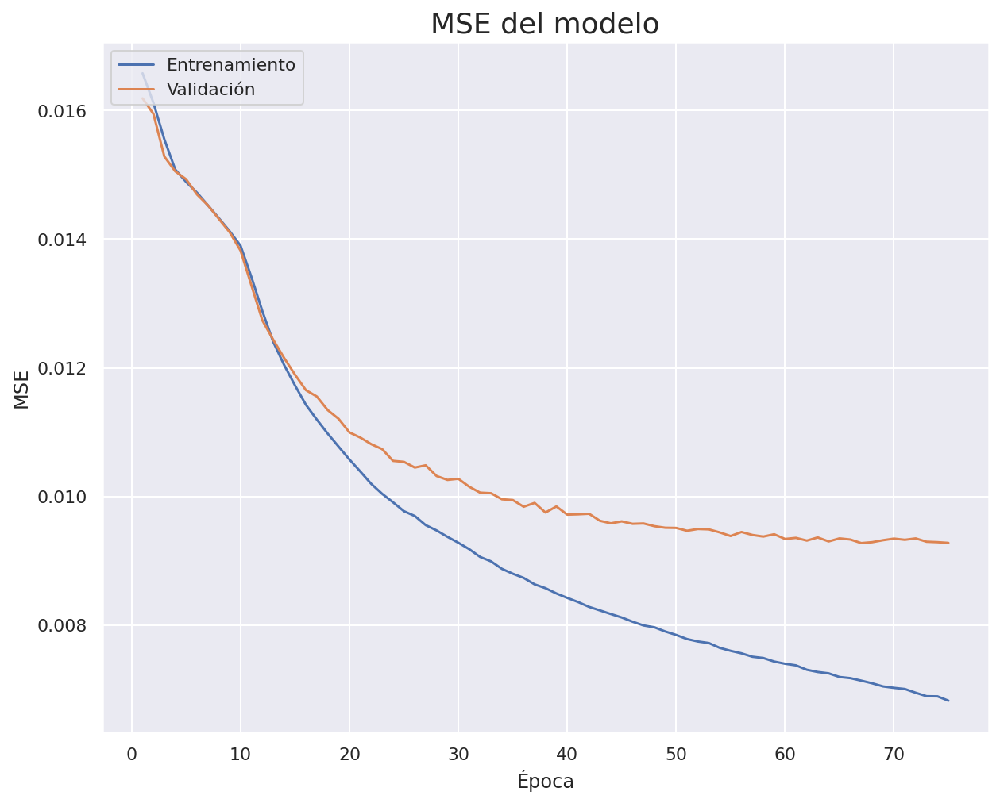

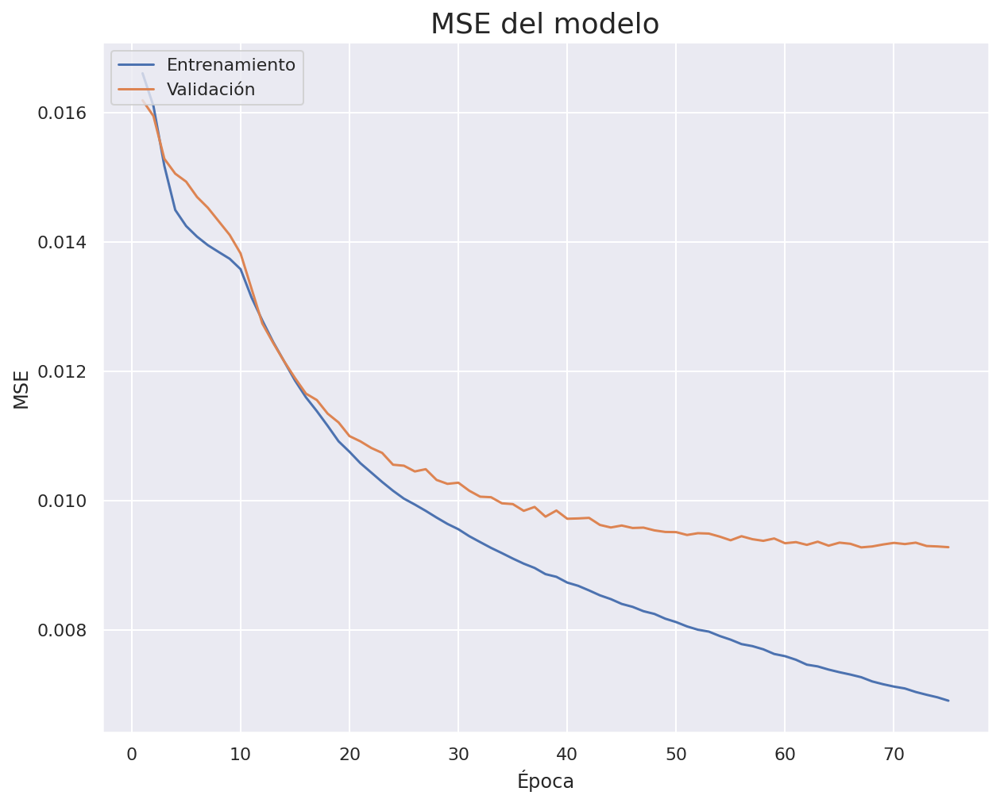

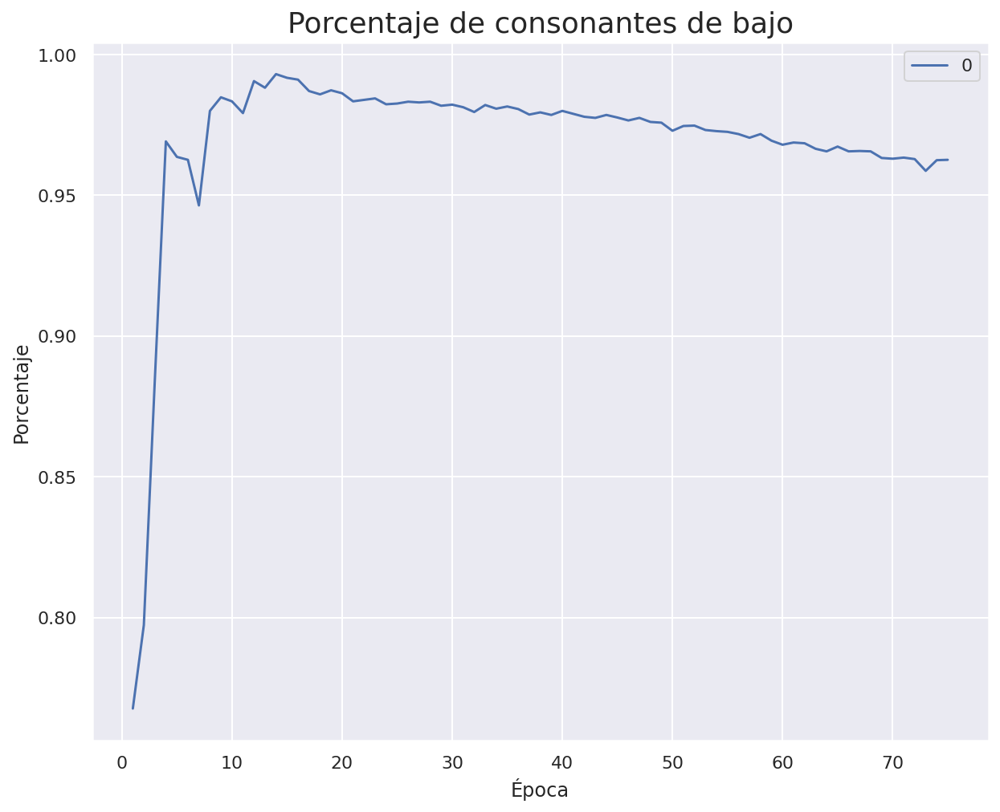

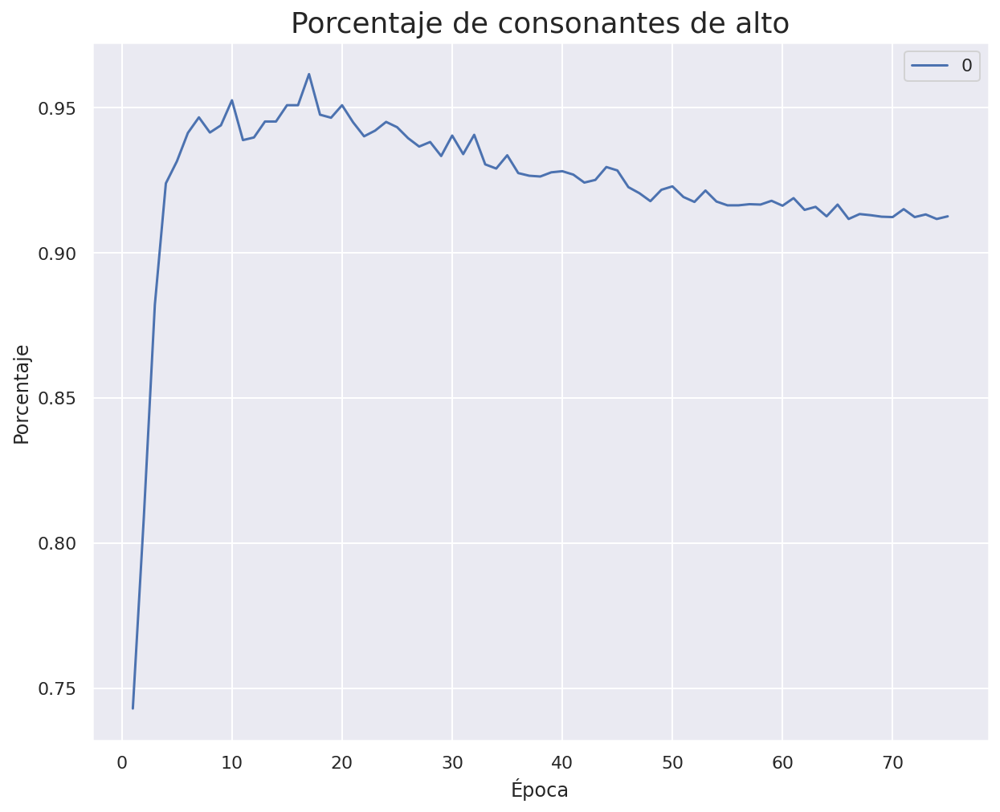

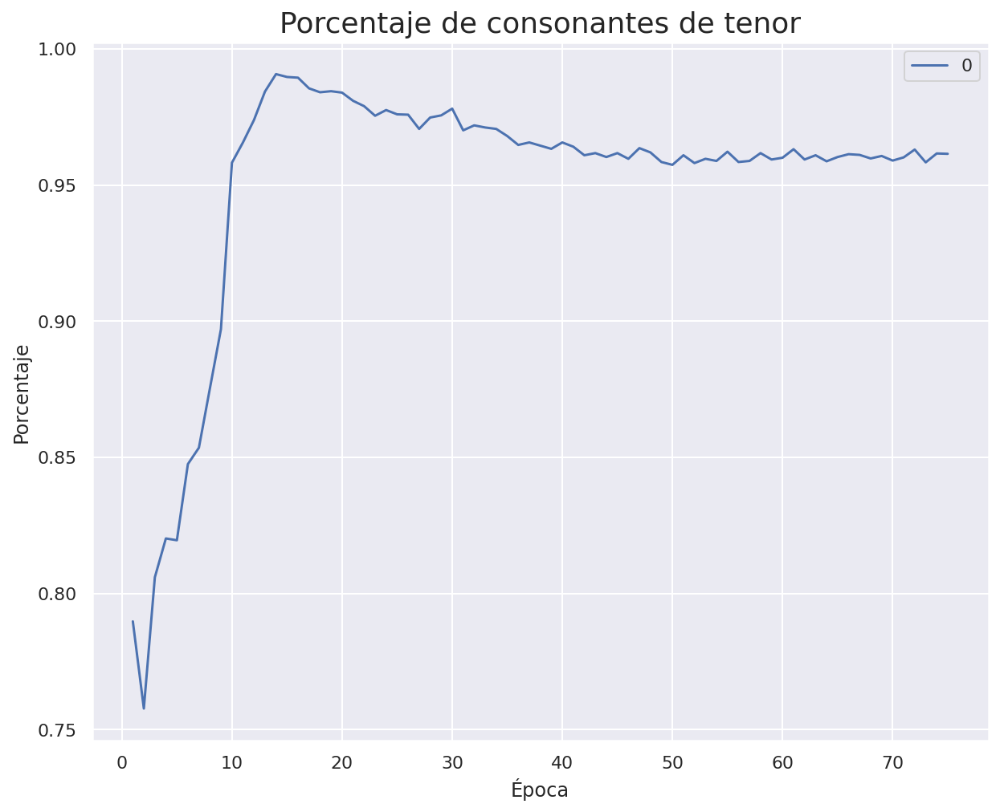

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_80 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_80 (LSTM)                 (None, 50)           15000       ['embedding_80[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

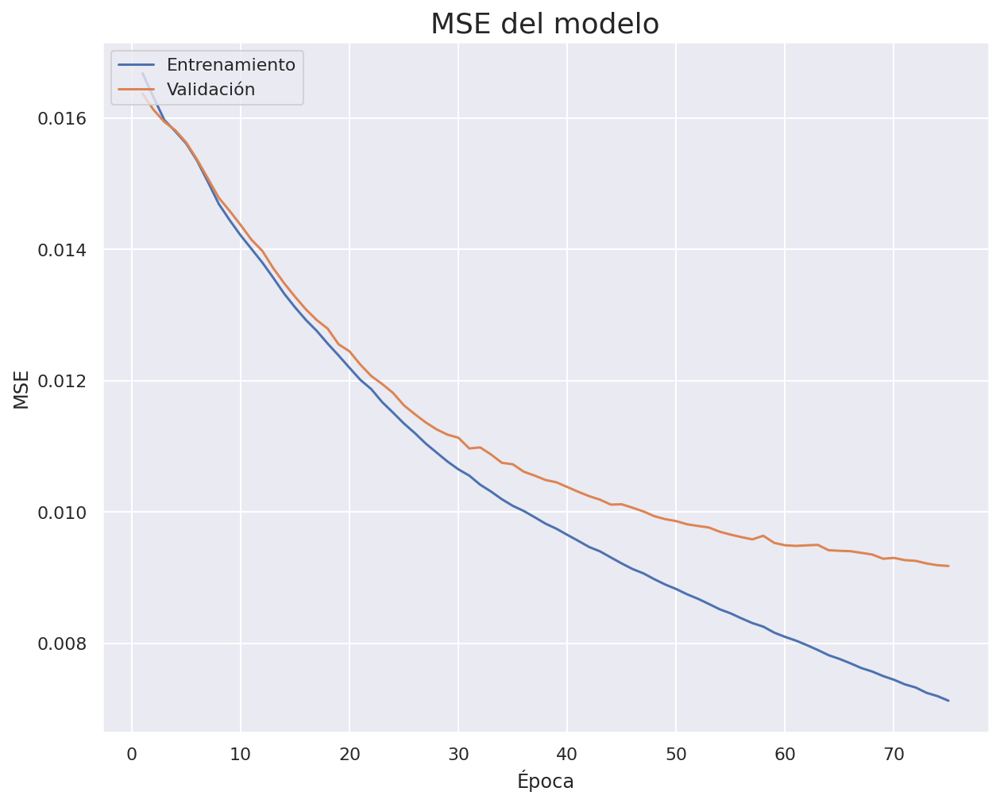

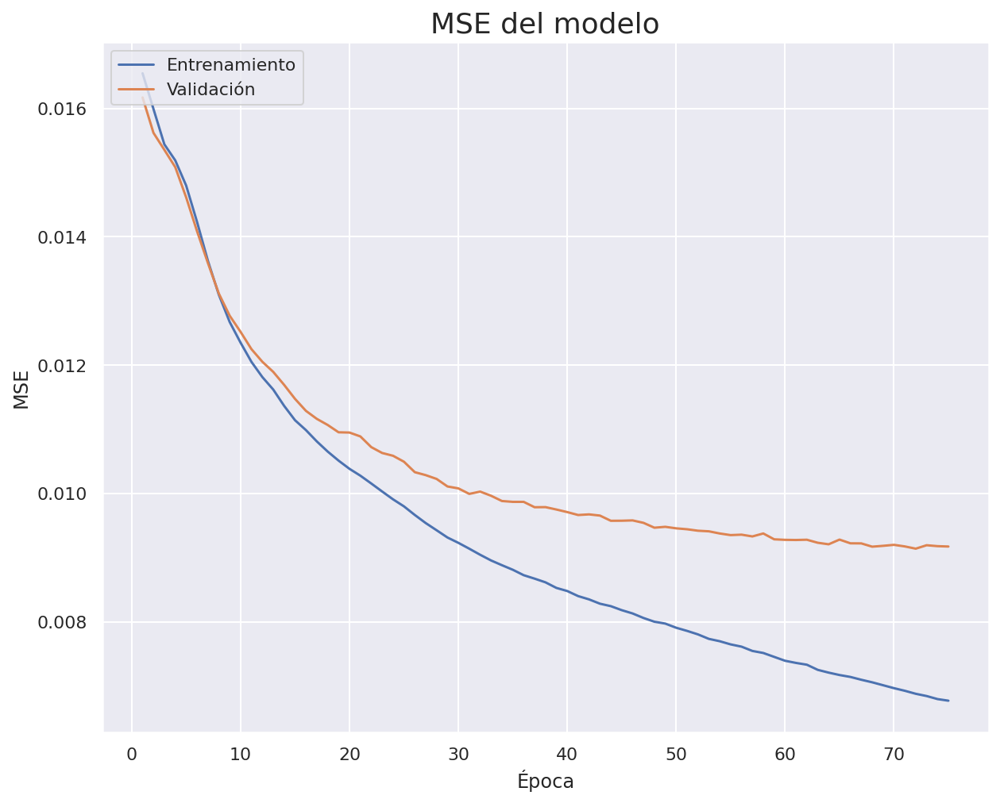

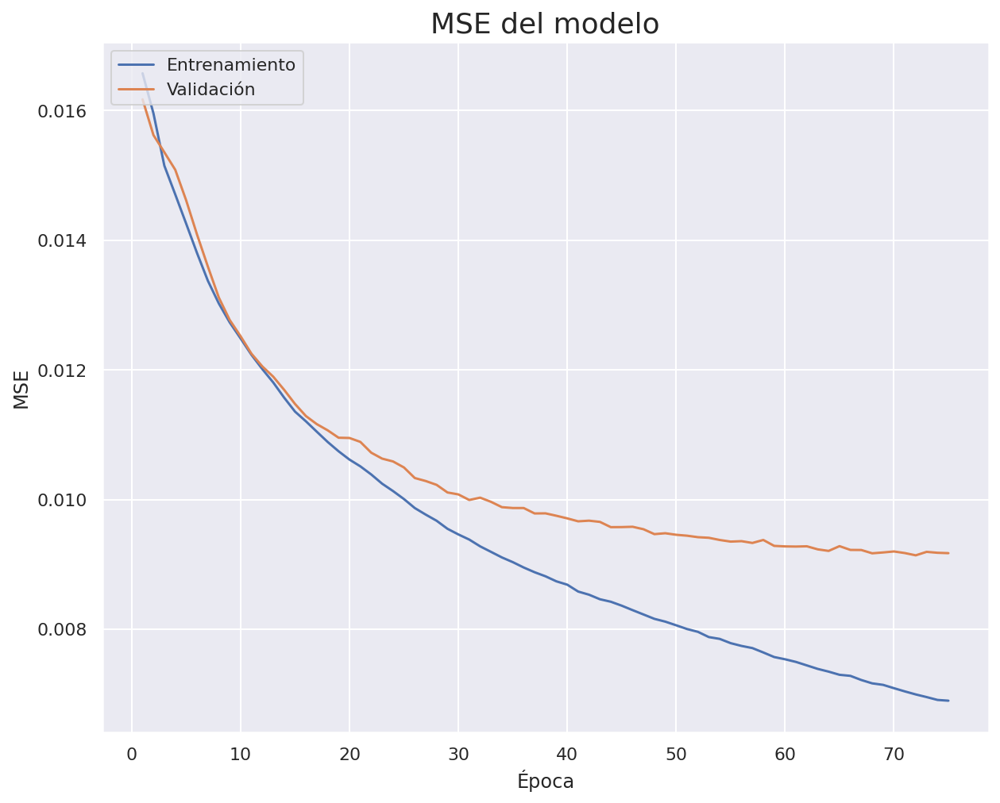

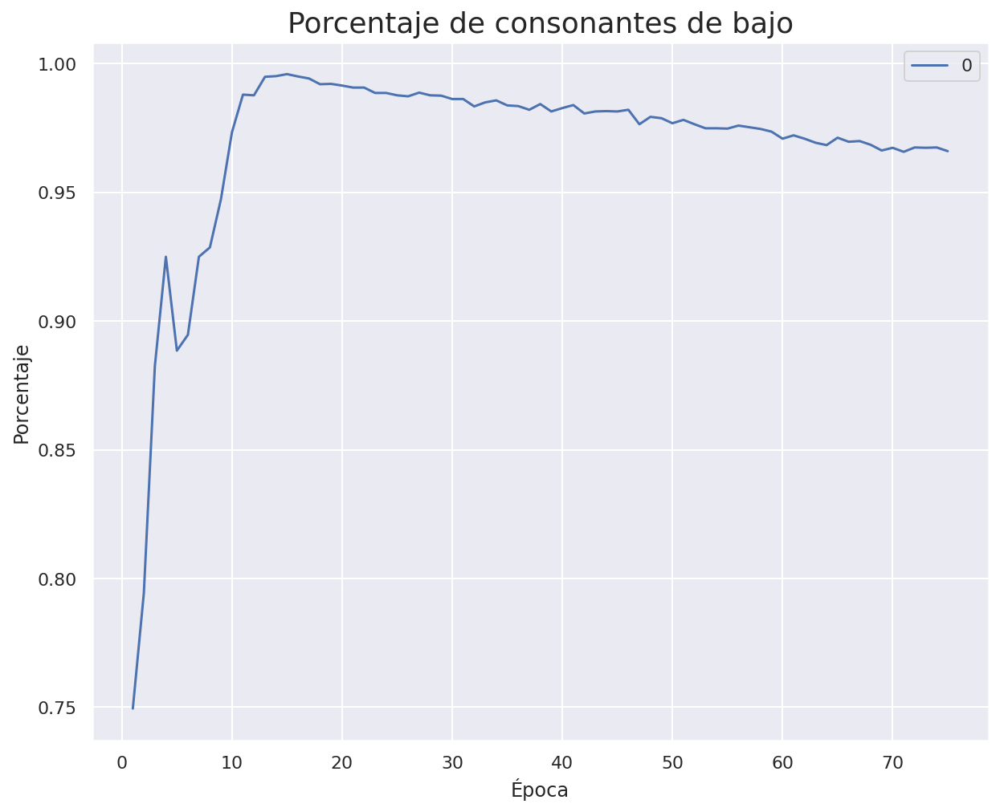

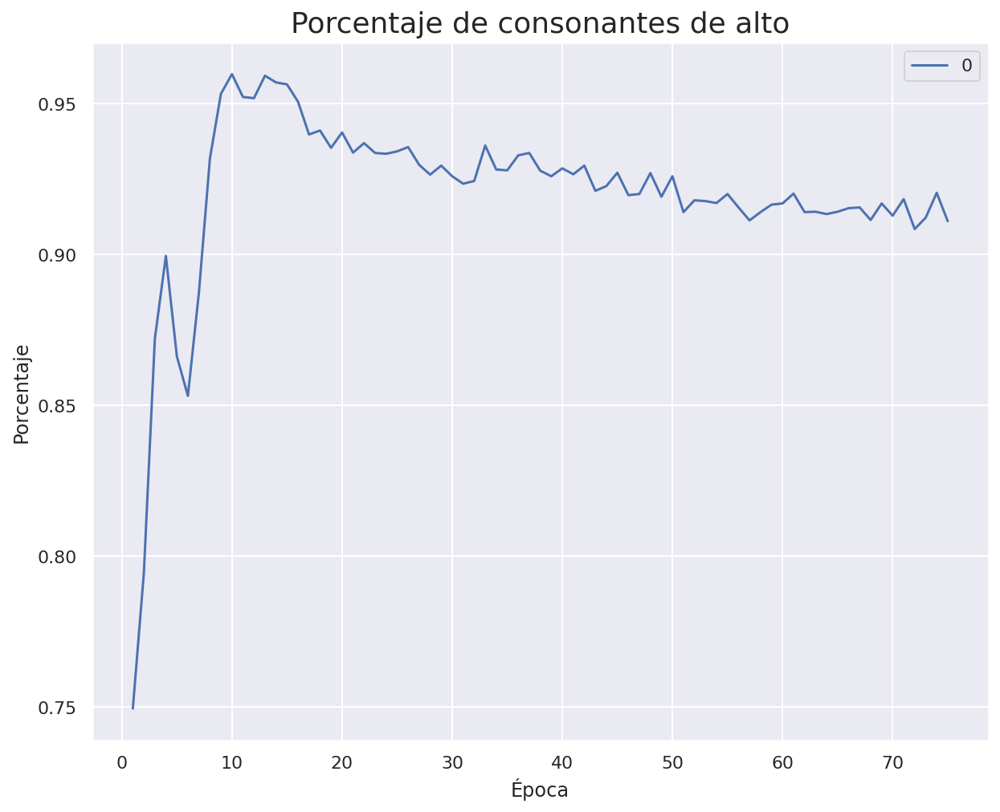

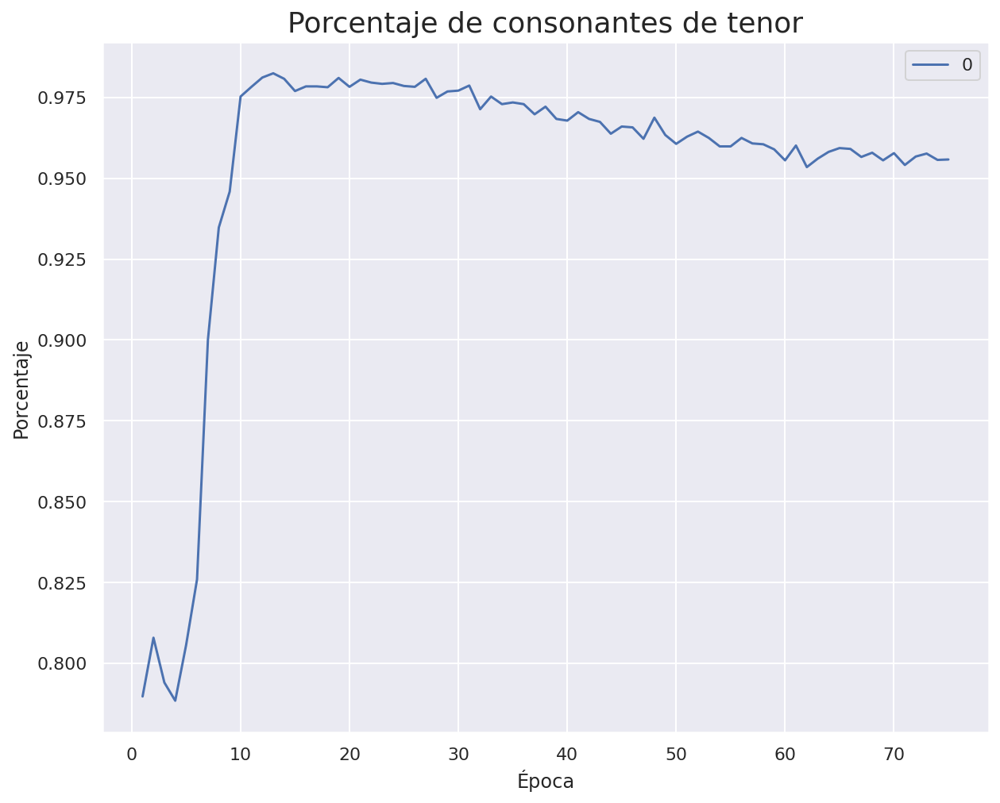

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_82 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_82 (LSTM)                 (None, 51)           15504       ['embedding_82[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

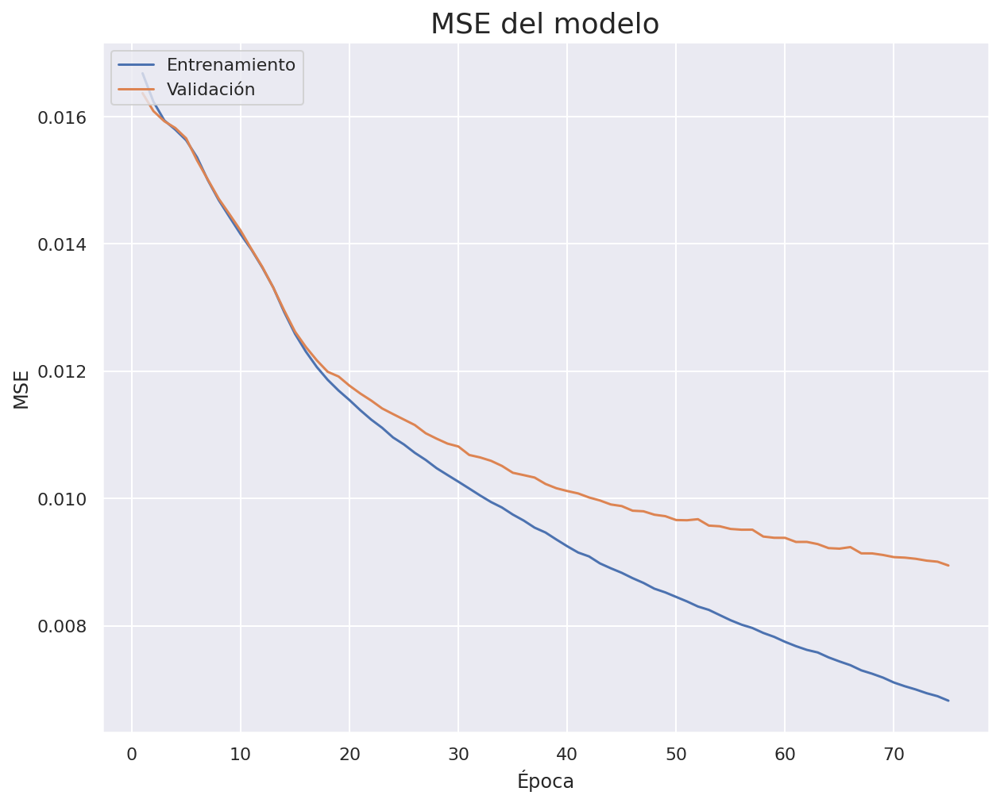

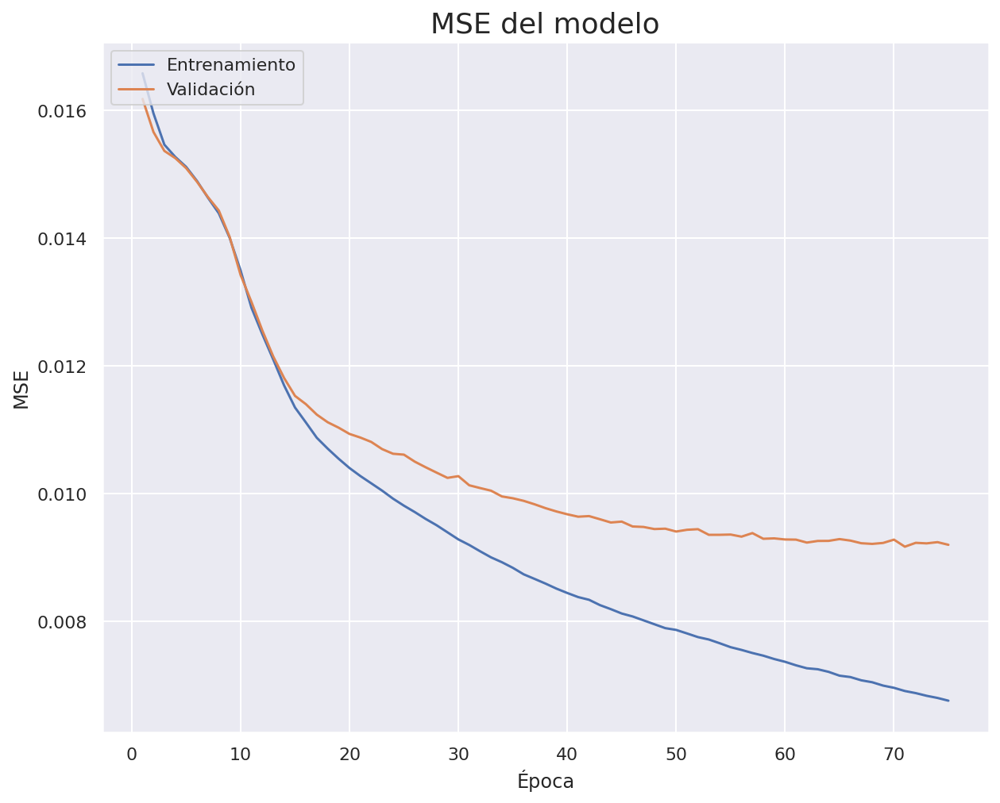

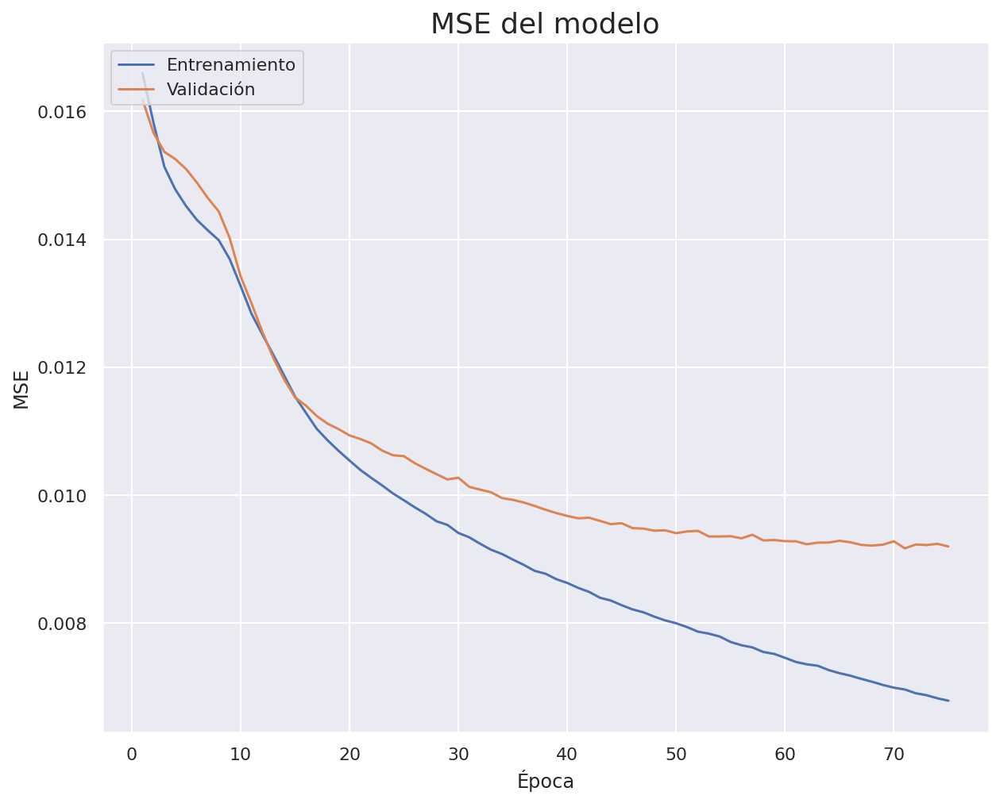

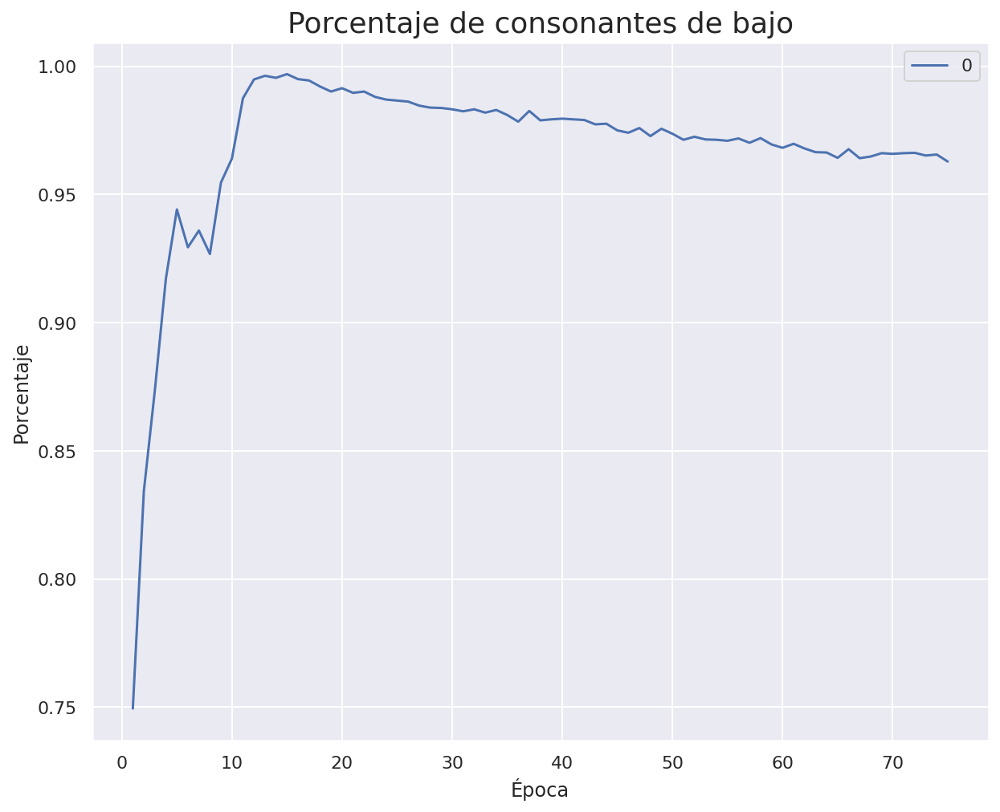

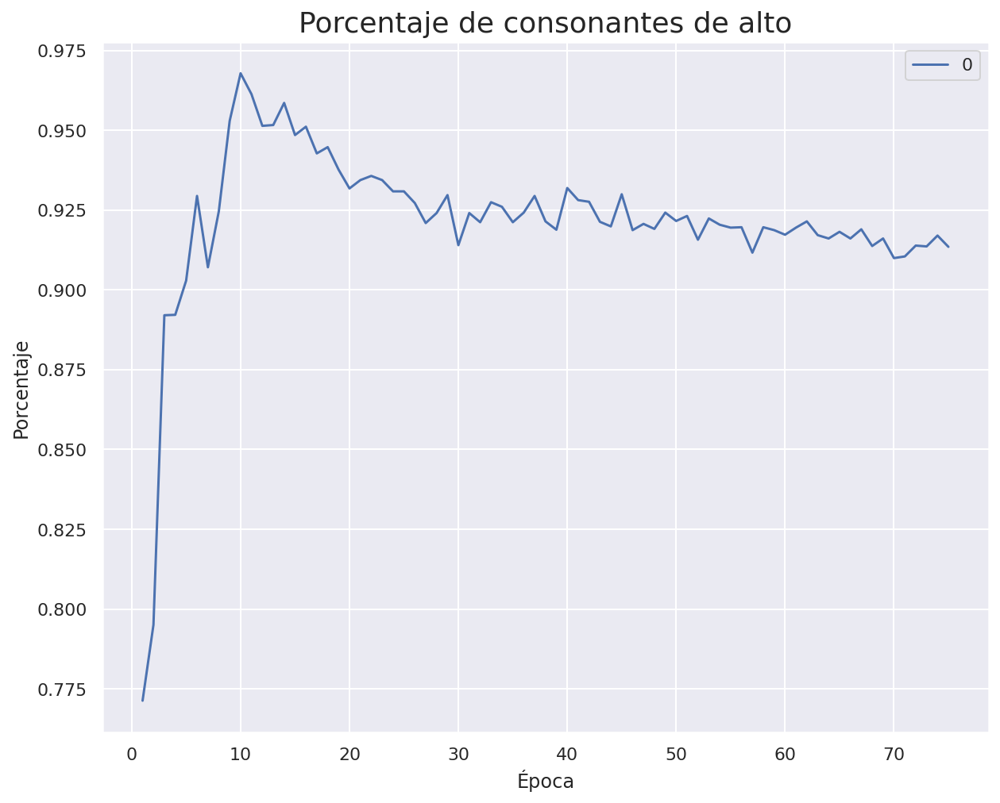

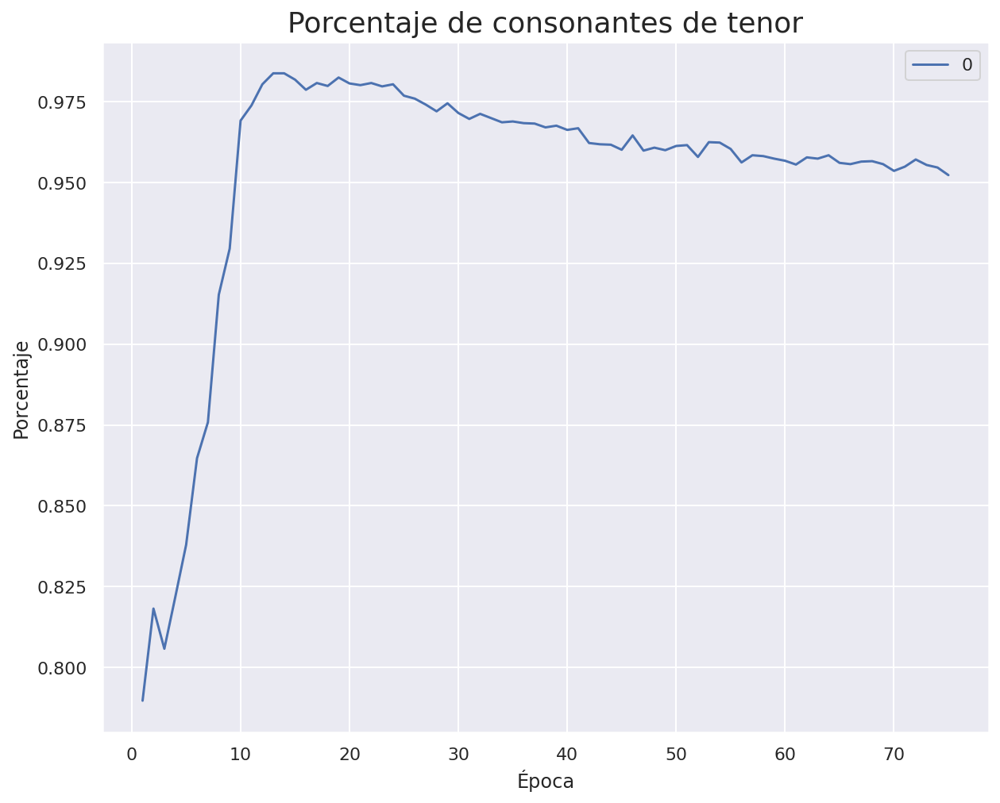

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_84 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_84 (LSTM)                 (None, 52)           16016       ['embedding_84[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

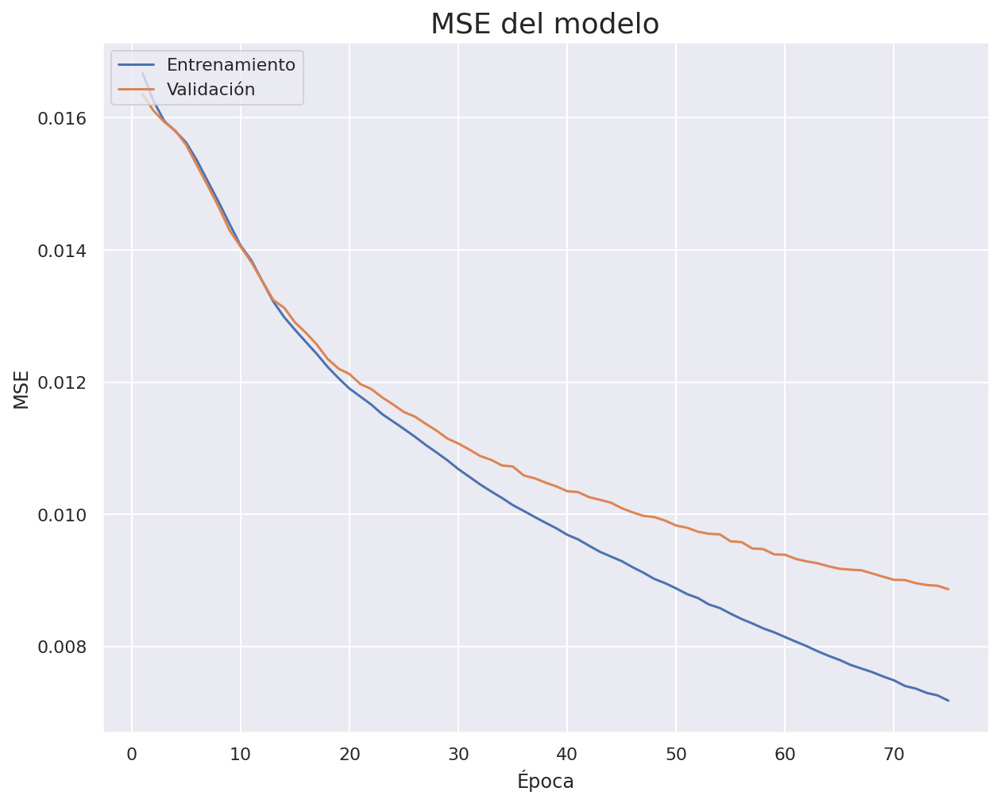

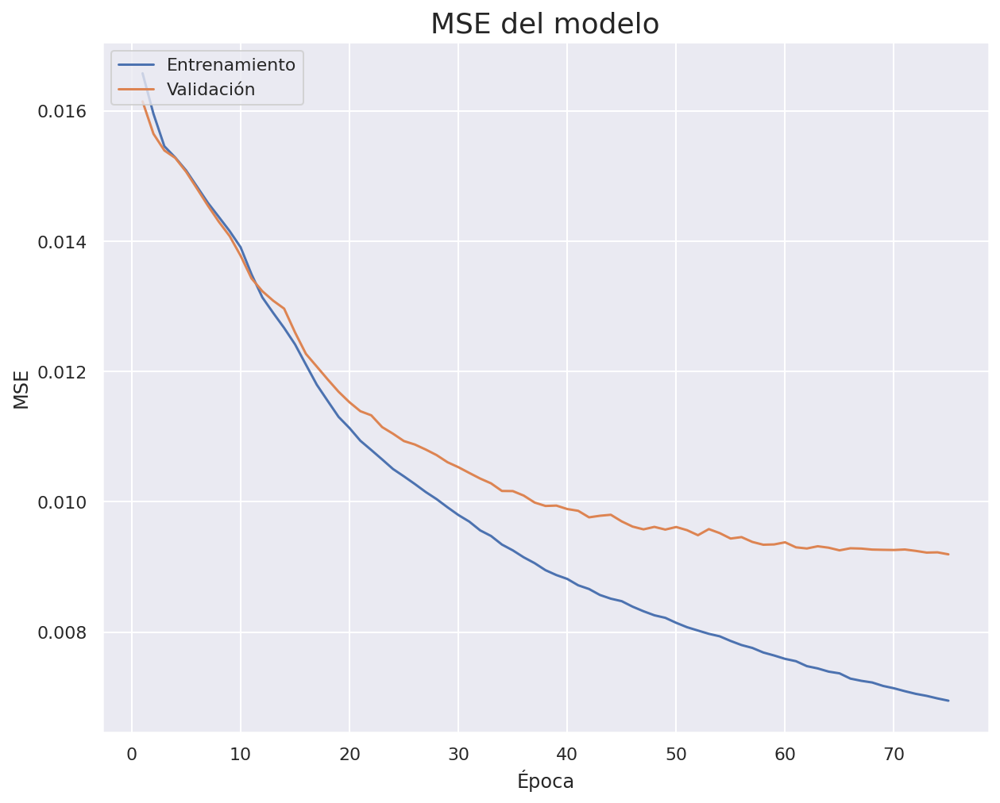

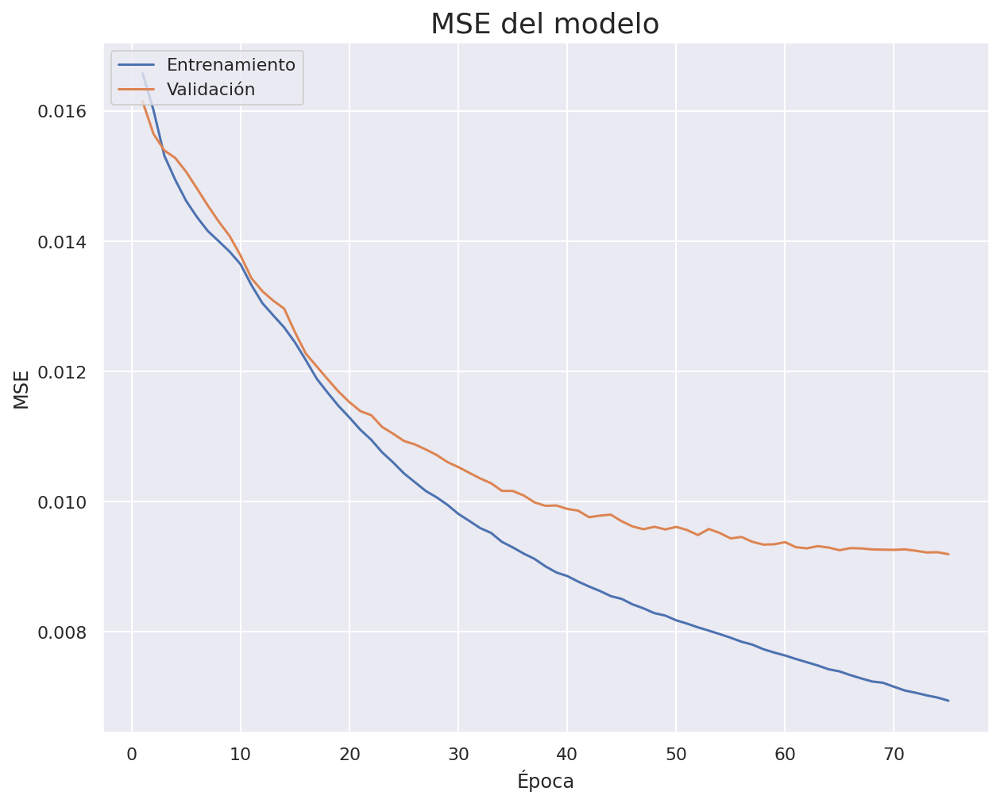

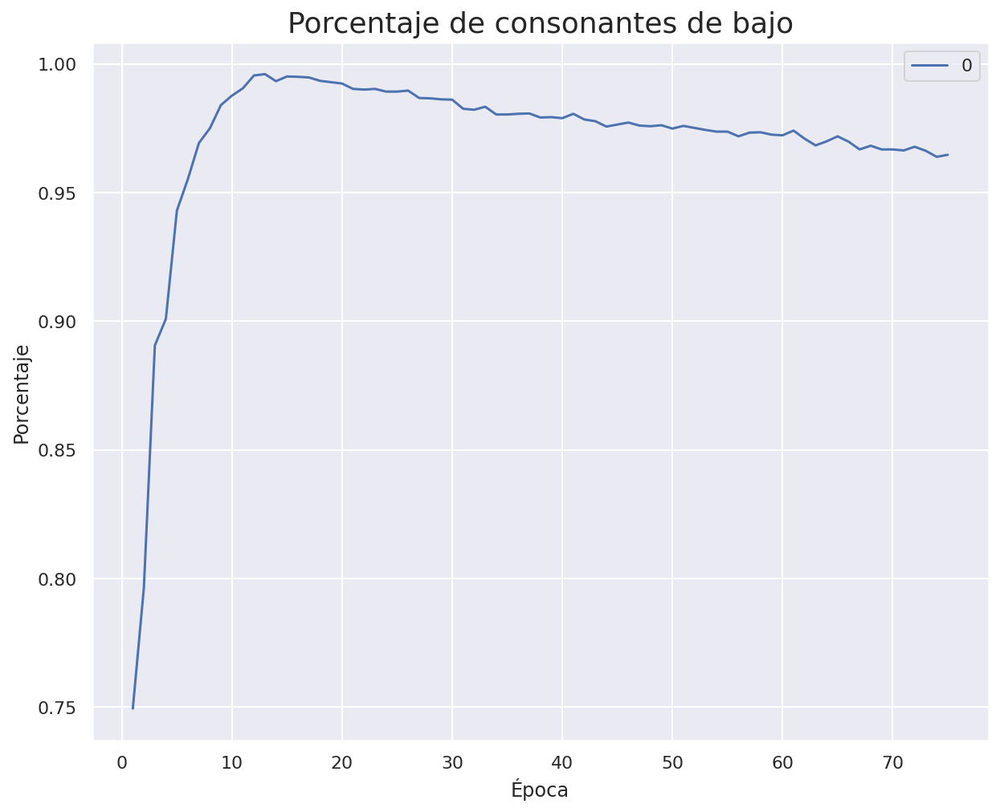

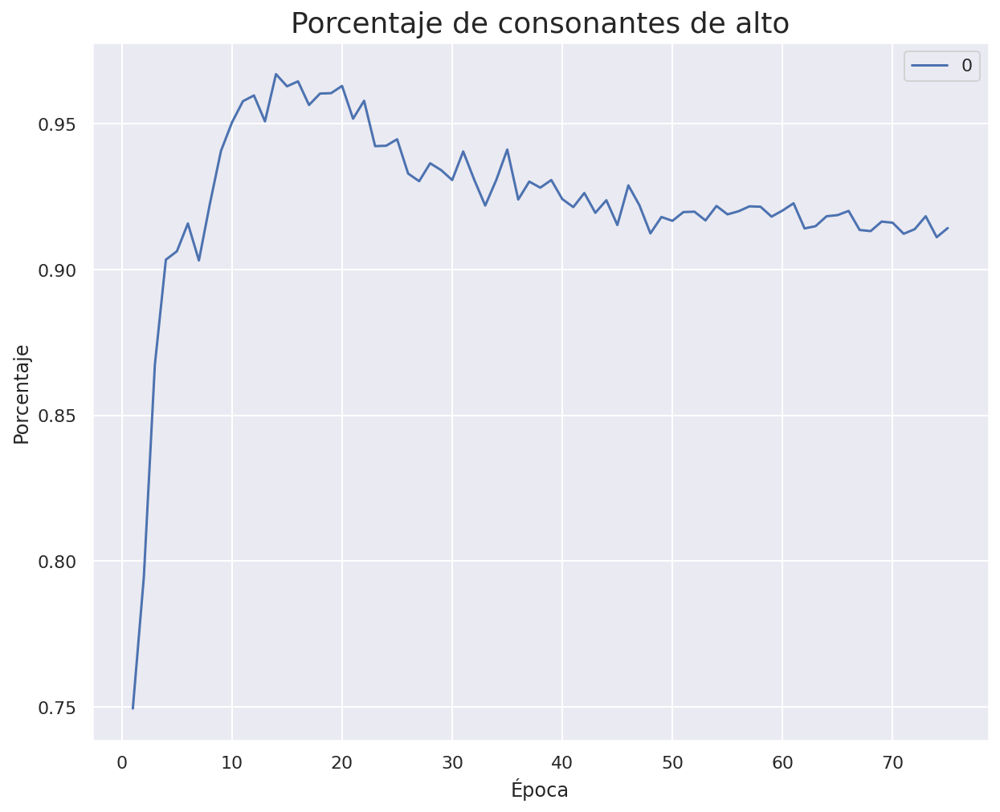

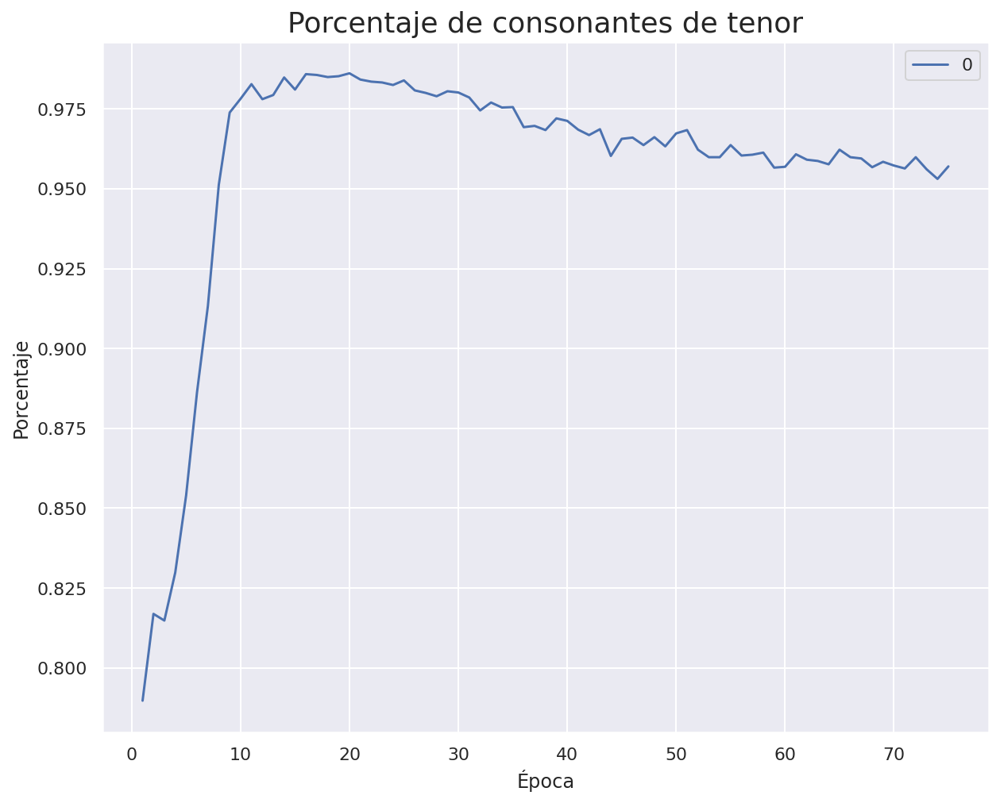

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_86 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_86 (LSTM)                 (None, 53)           16536       ['embedding_86[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

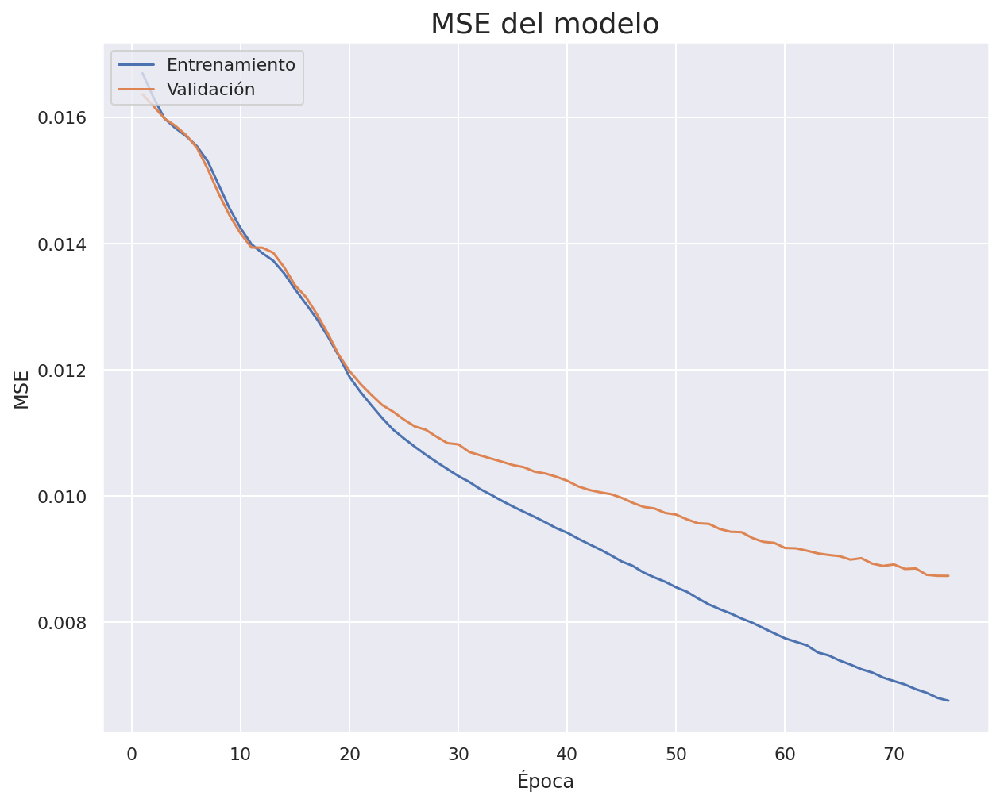

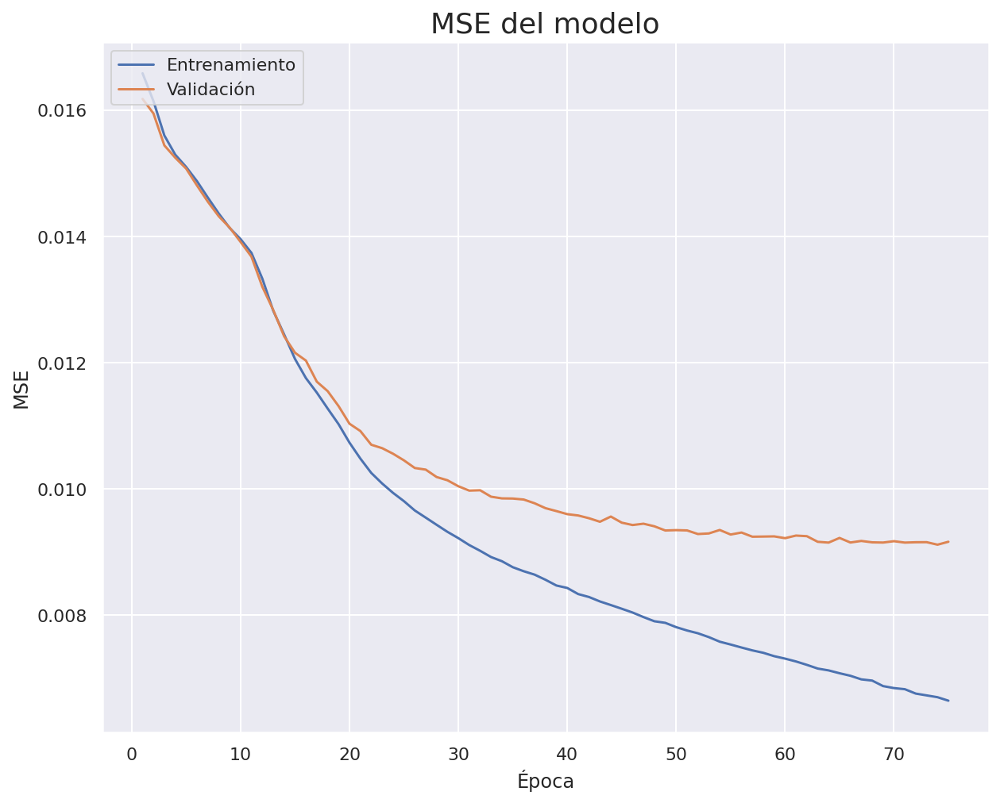

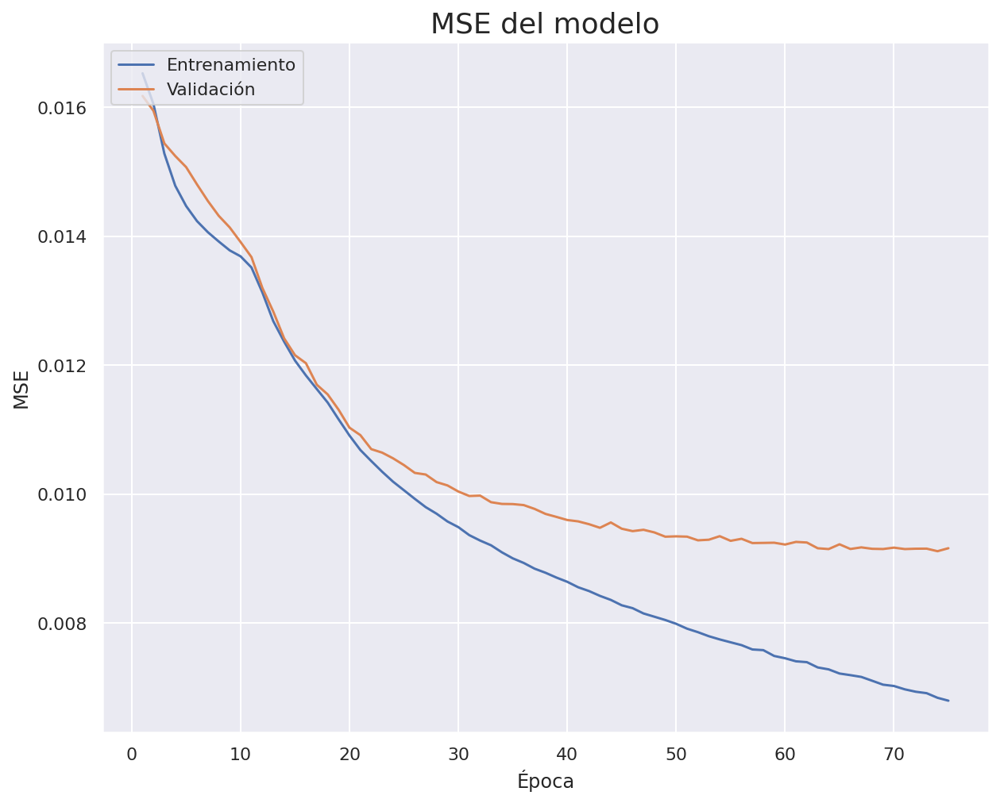

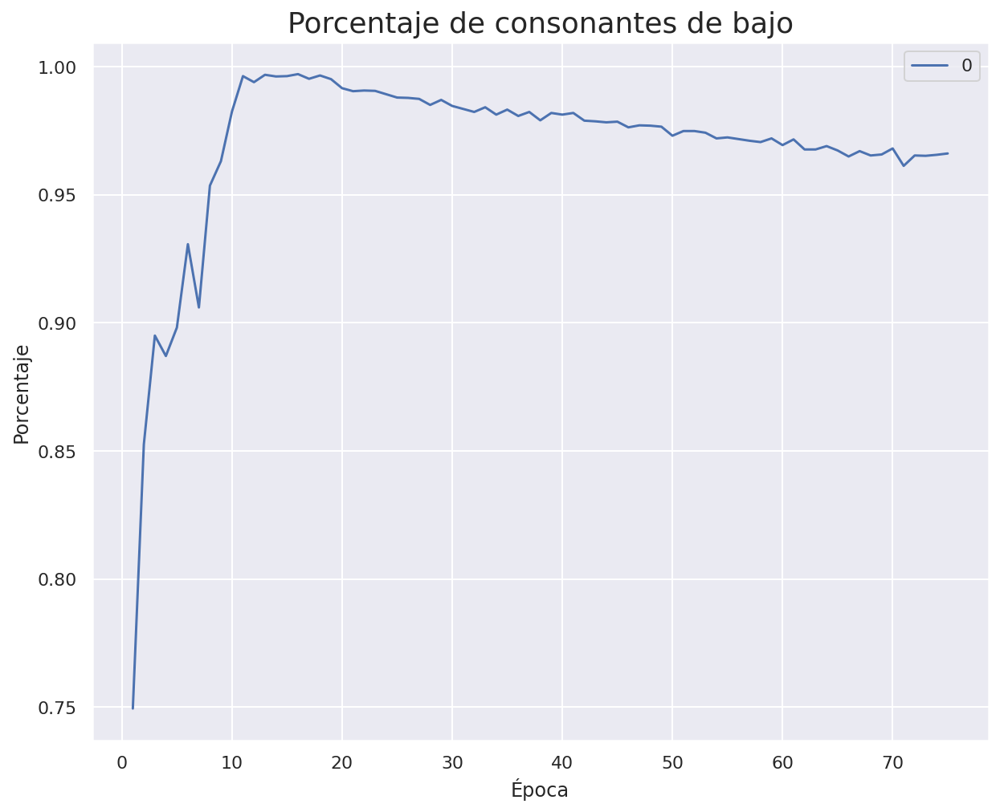

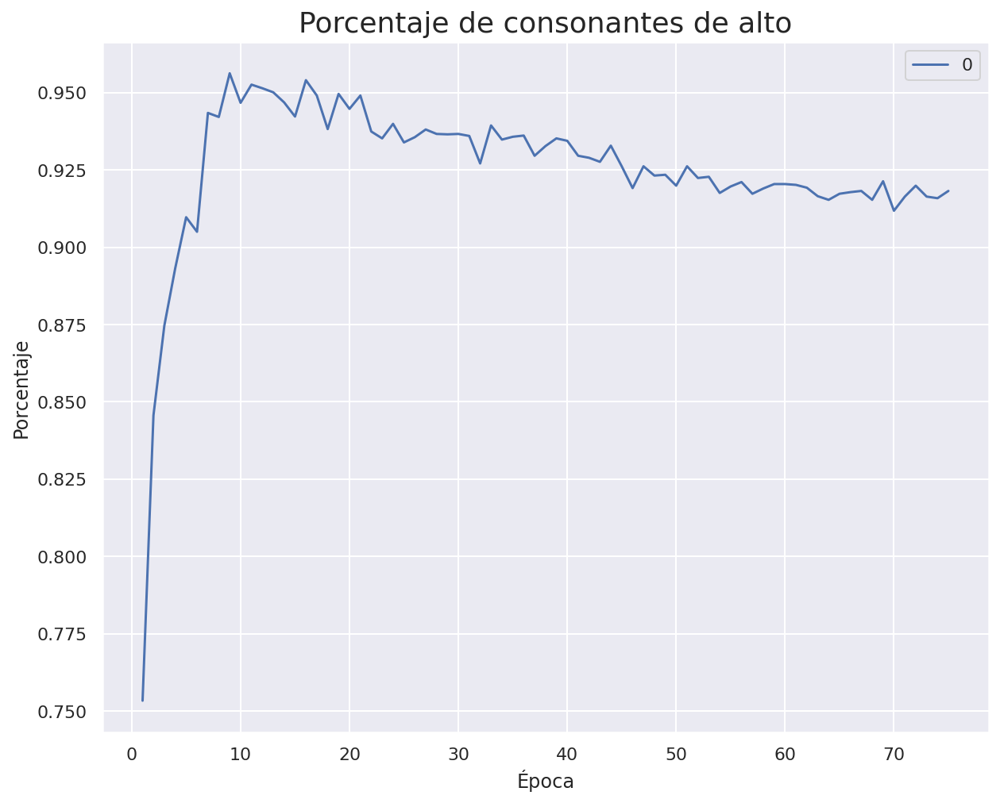

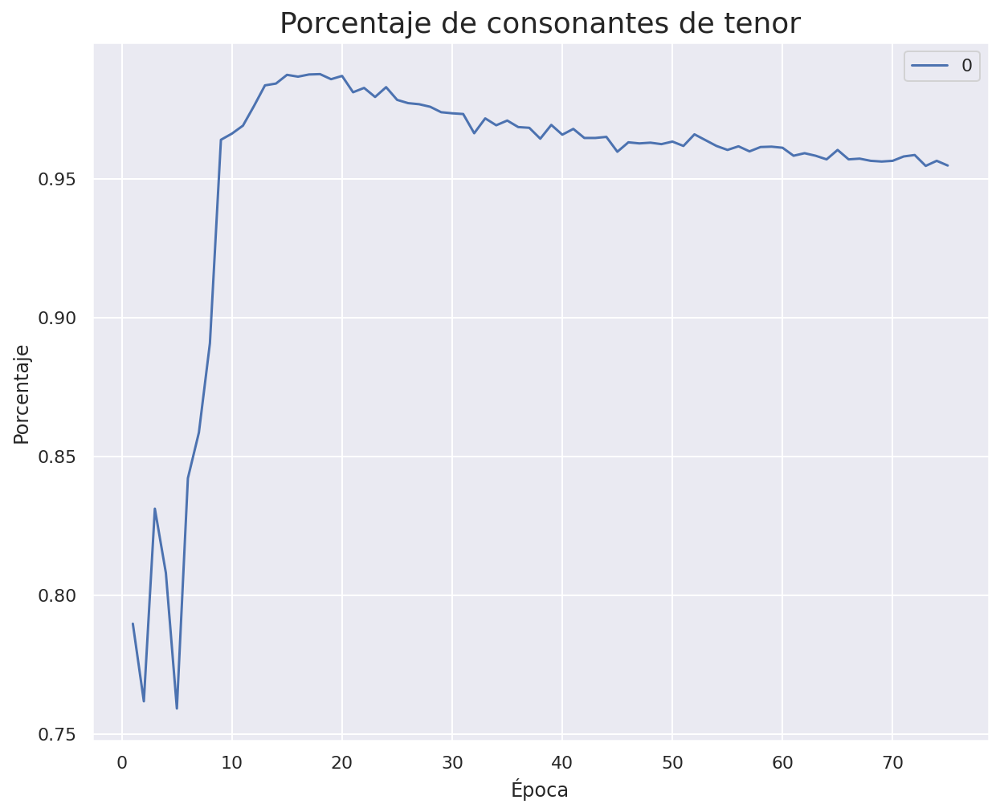

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_88 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_88 (LSTM)                 (None, 54)           17064       ['embedding_88[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

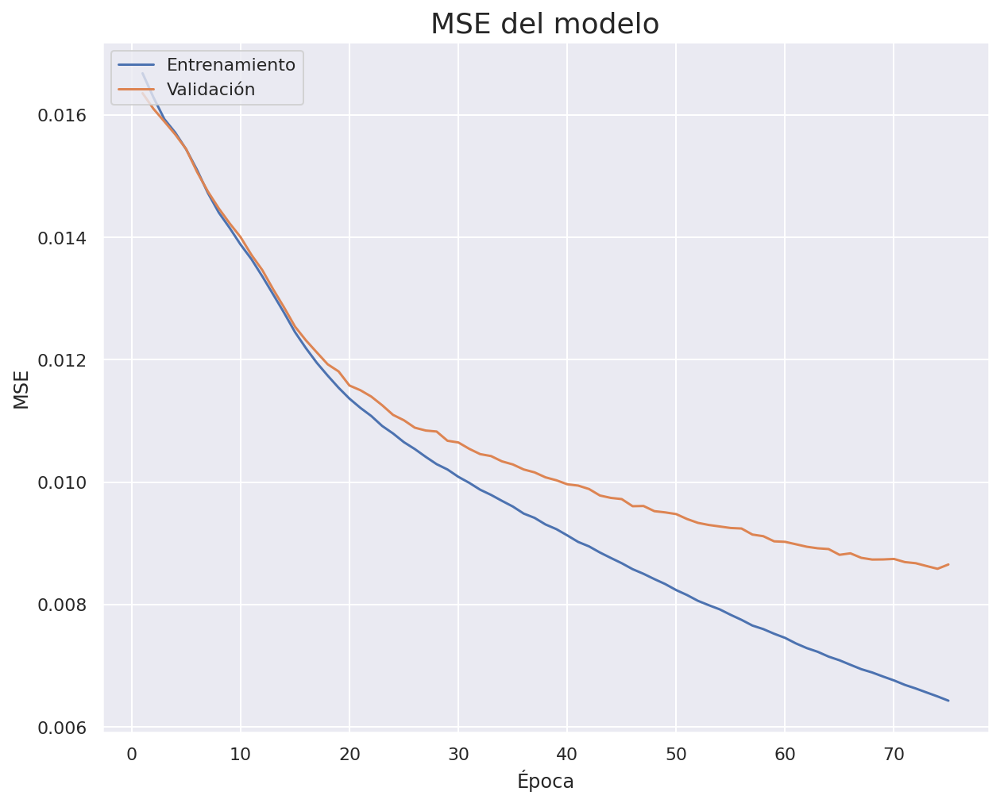

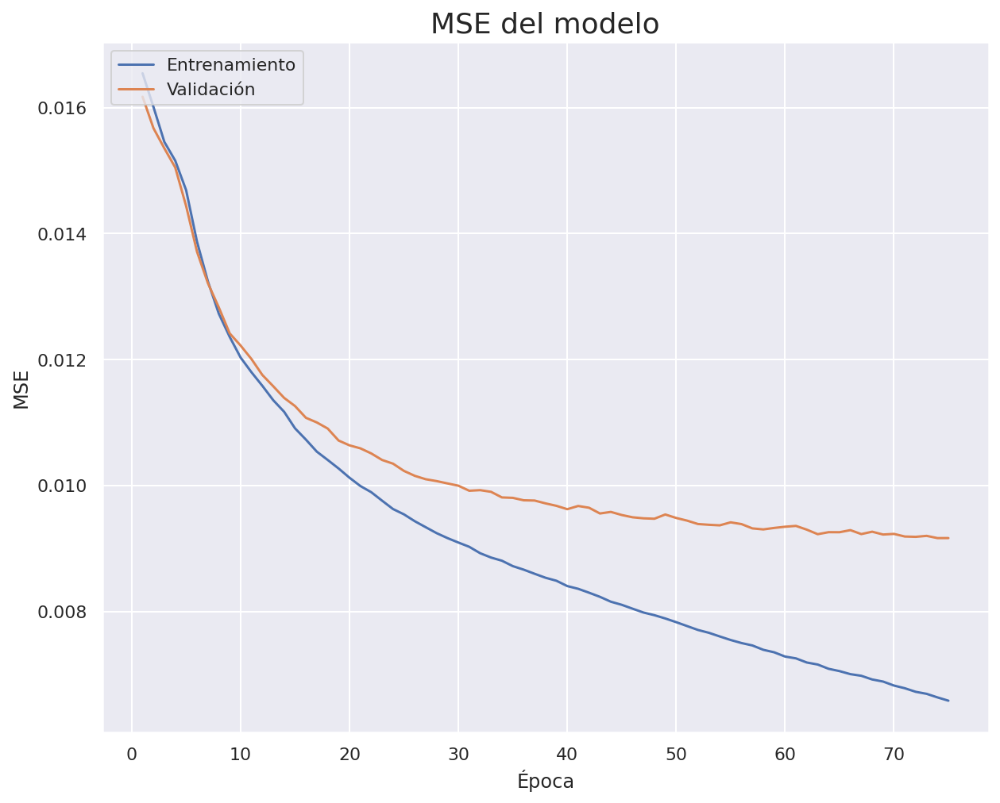

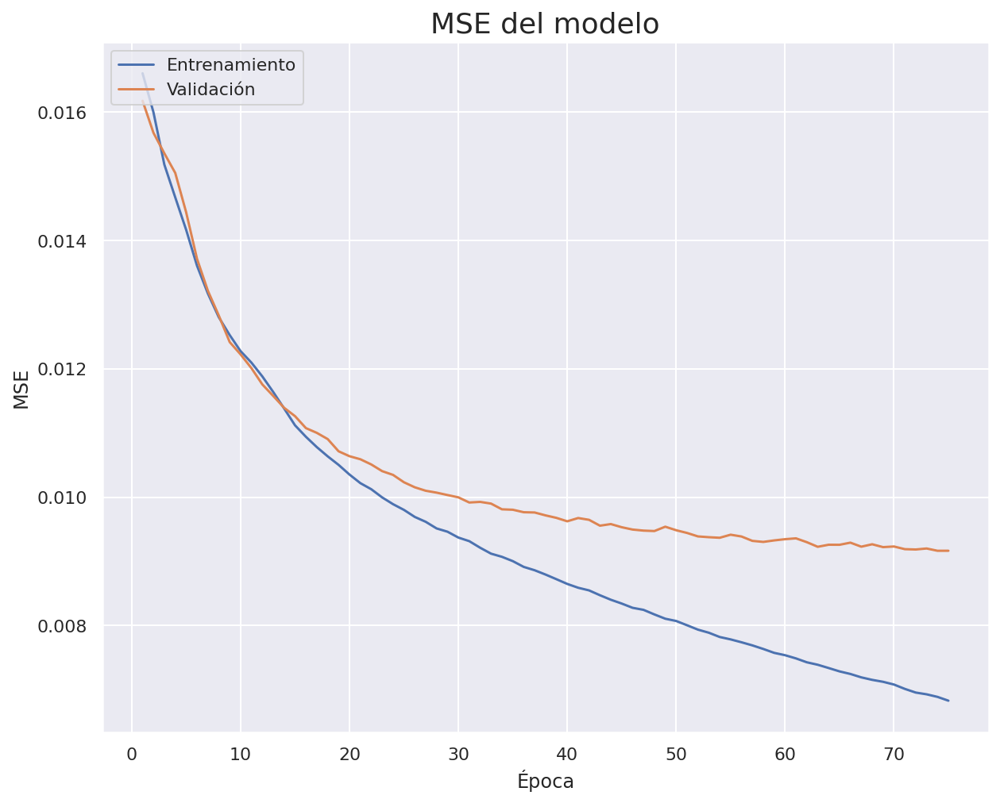

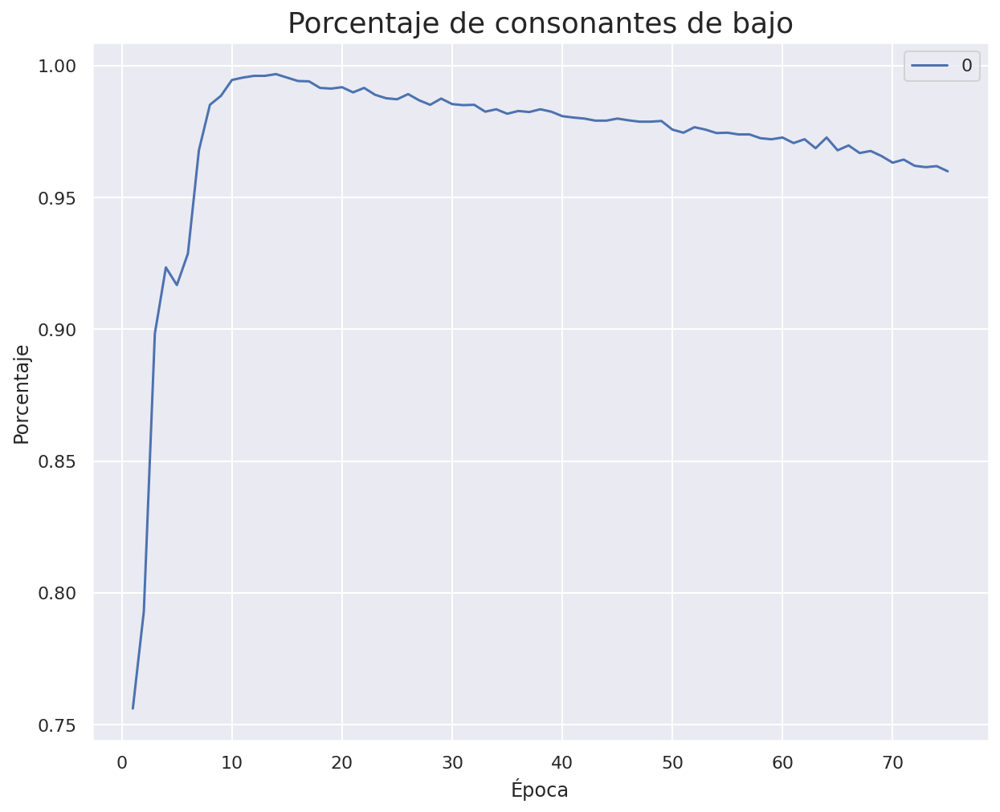

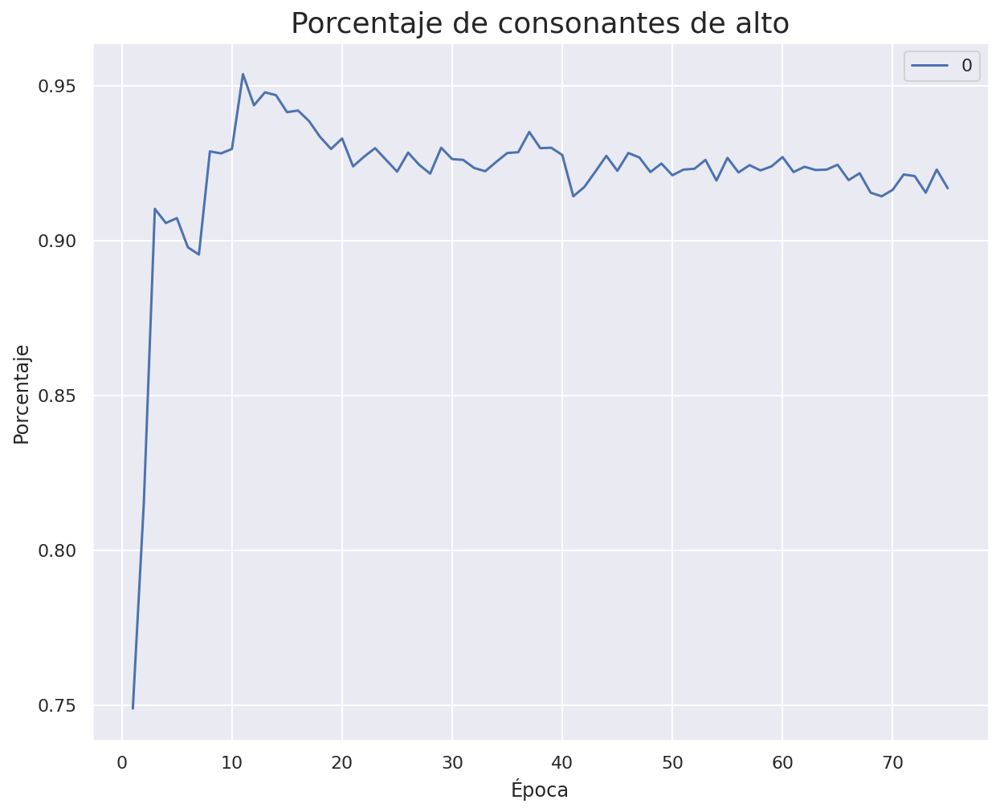

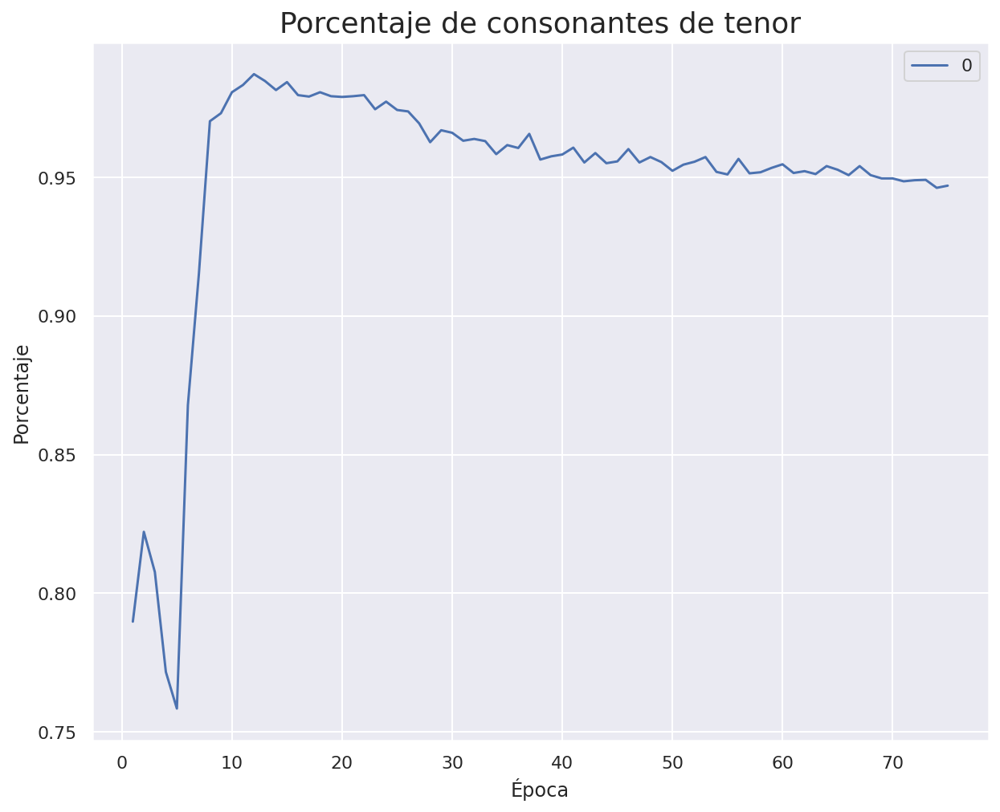

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_90 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_90 (LSTM)                 (None, 55)           17600       ['embedding_90[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

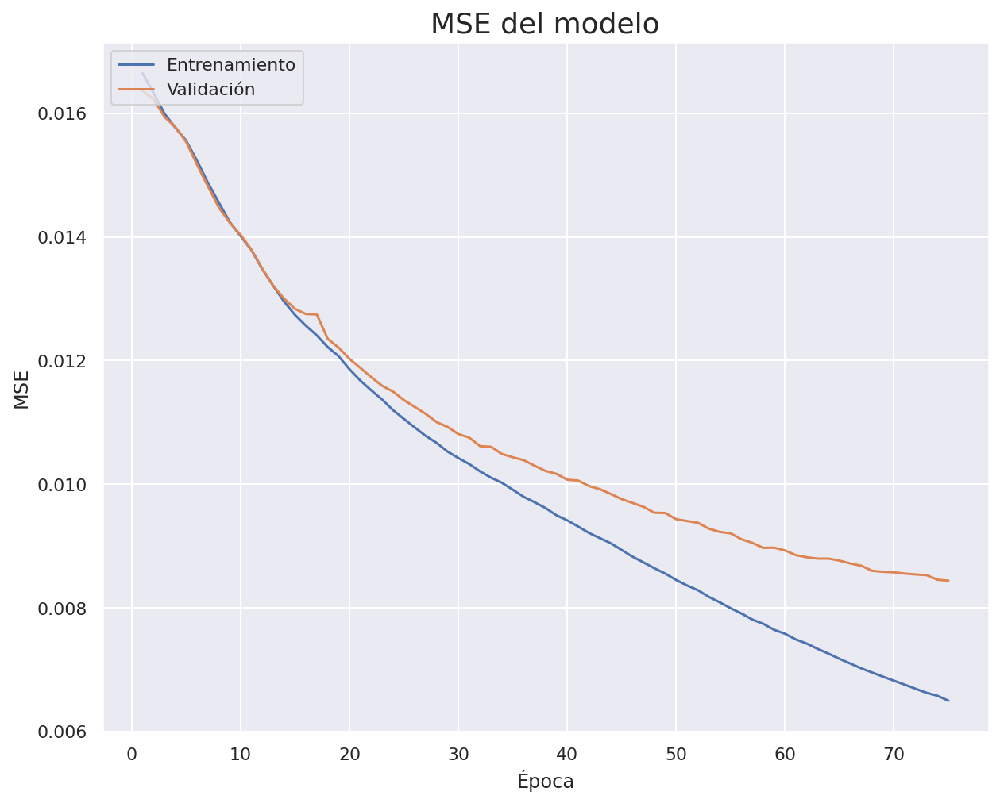

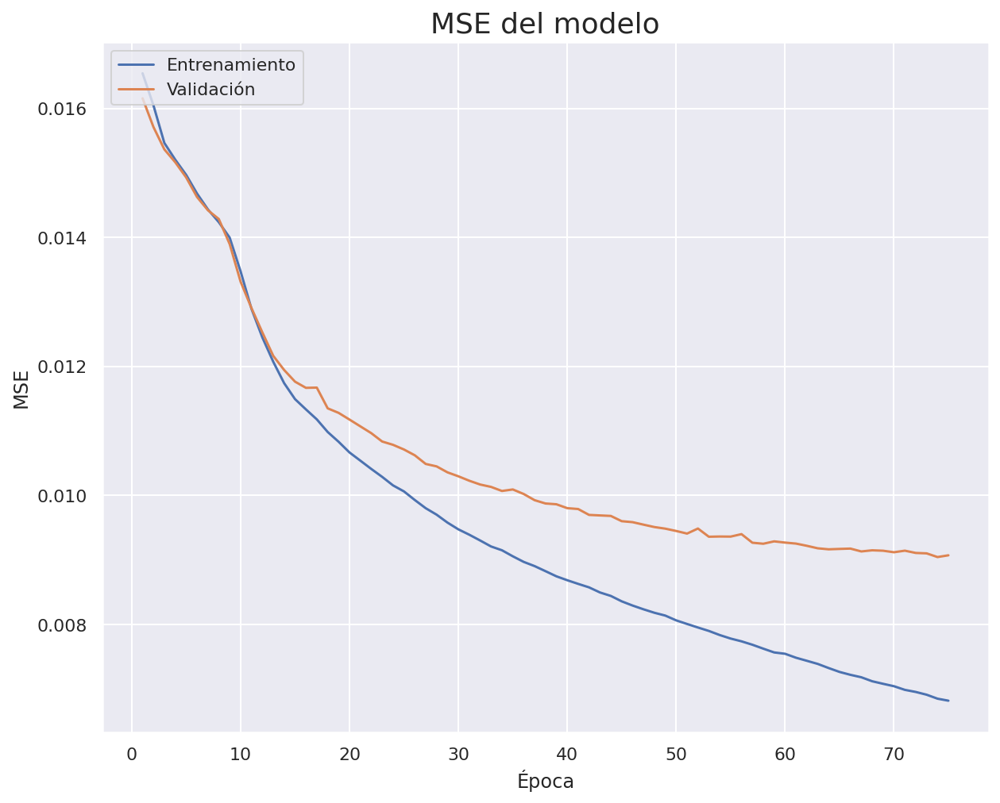

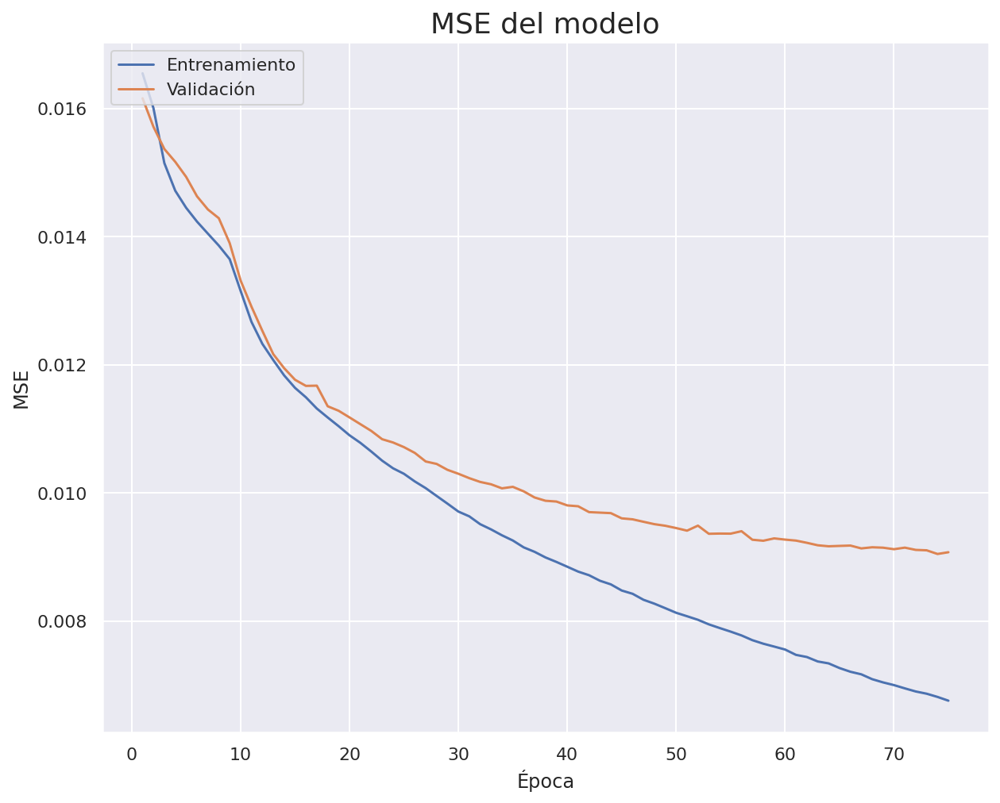

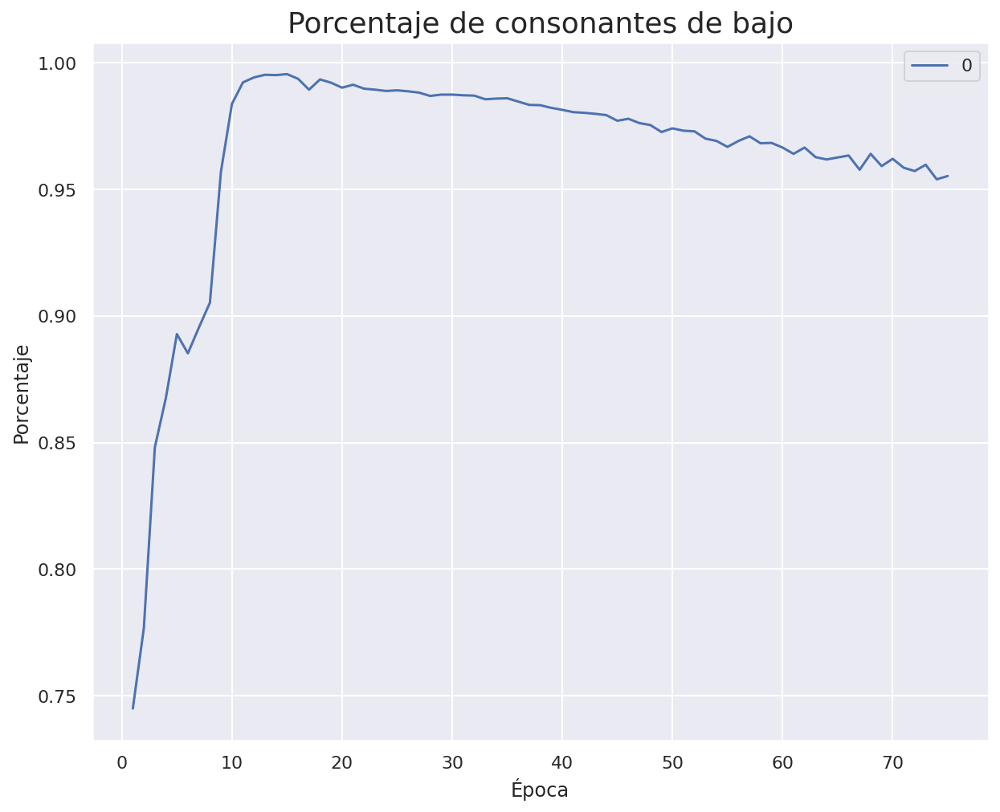

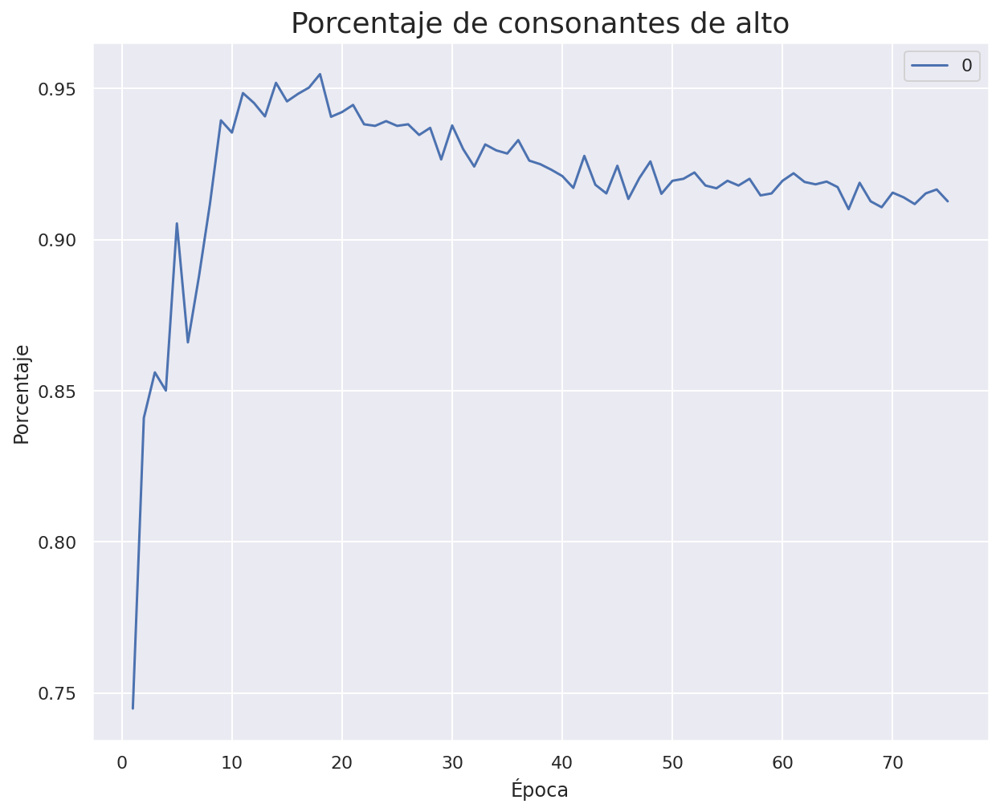

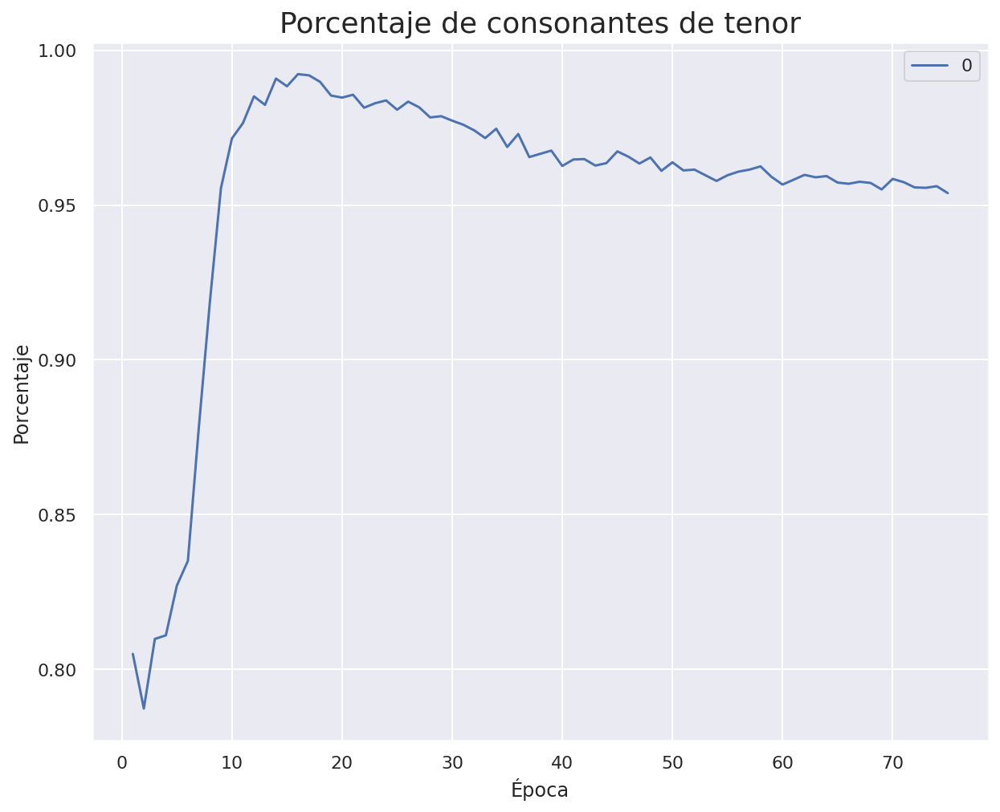

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_92 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_92 (LSTM)                 (None, 56)           18144       ['embedding_92[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

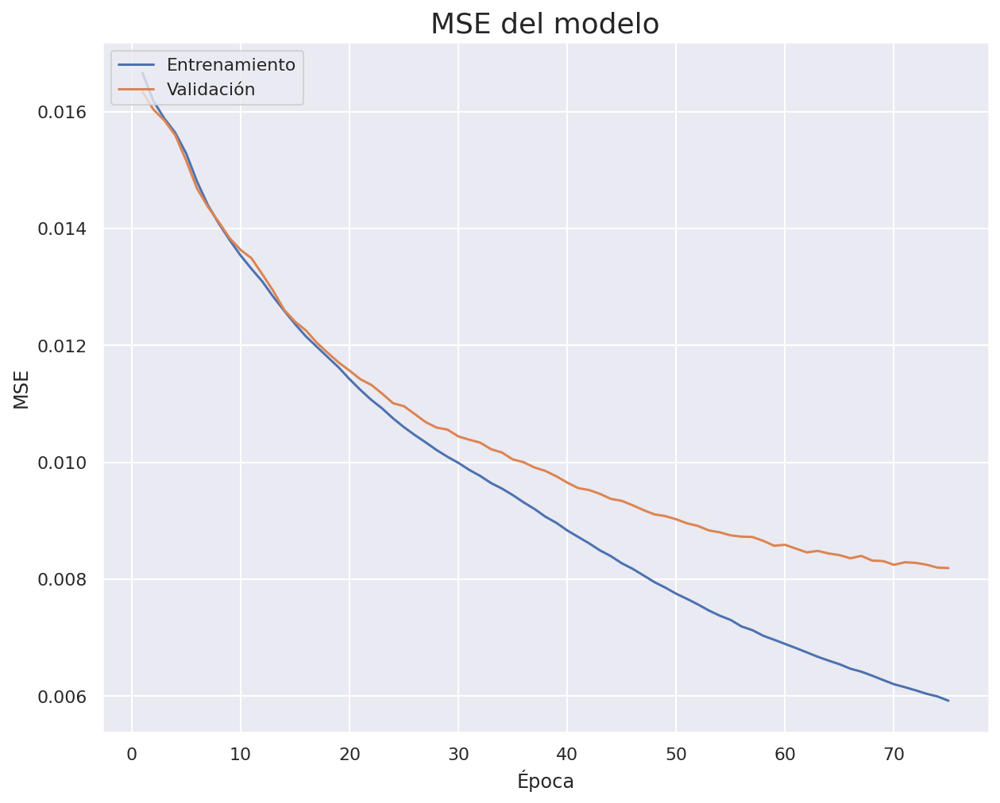

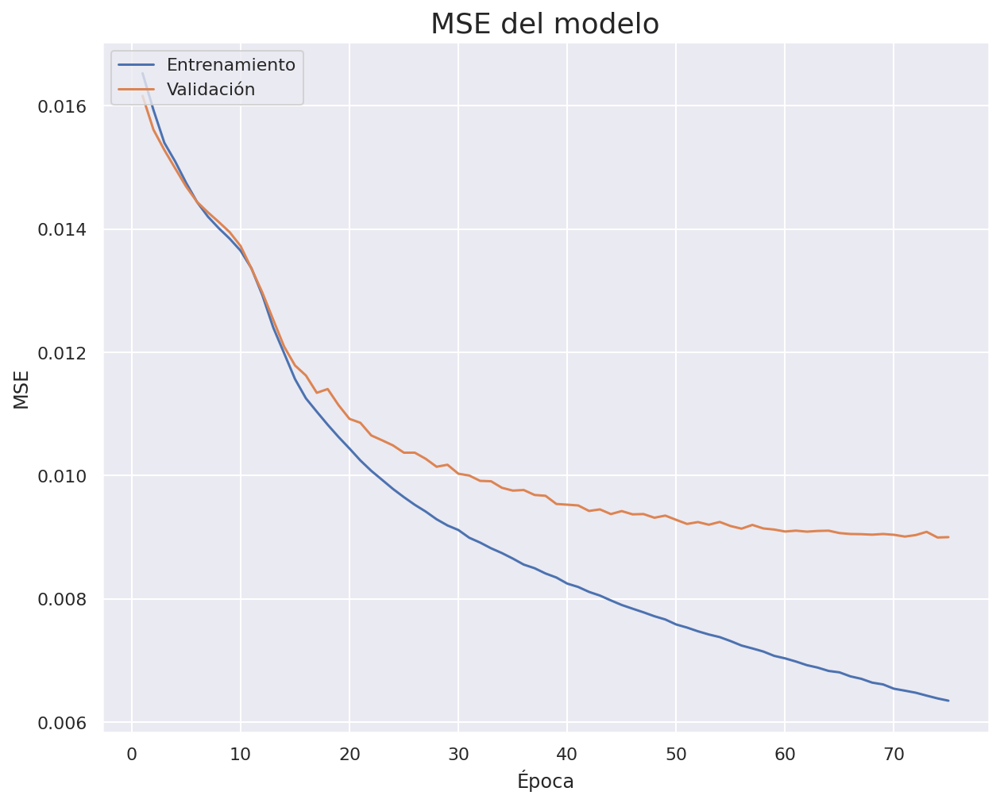

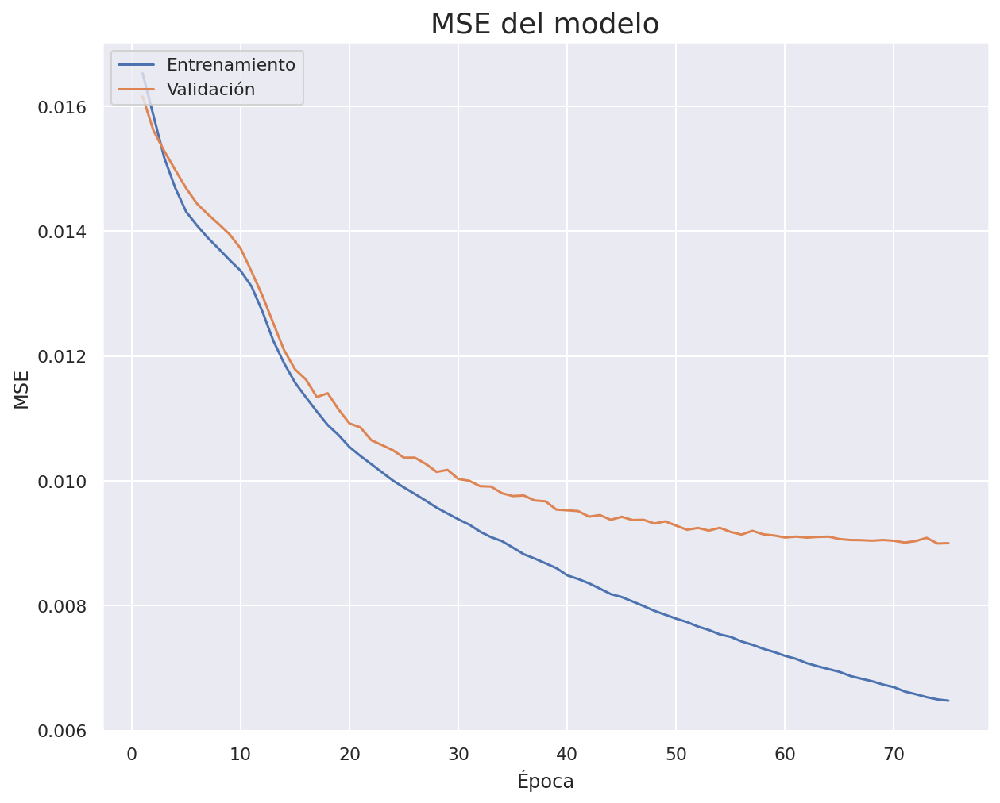

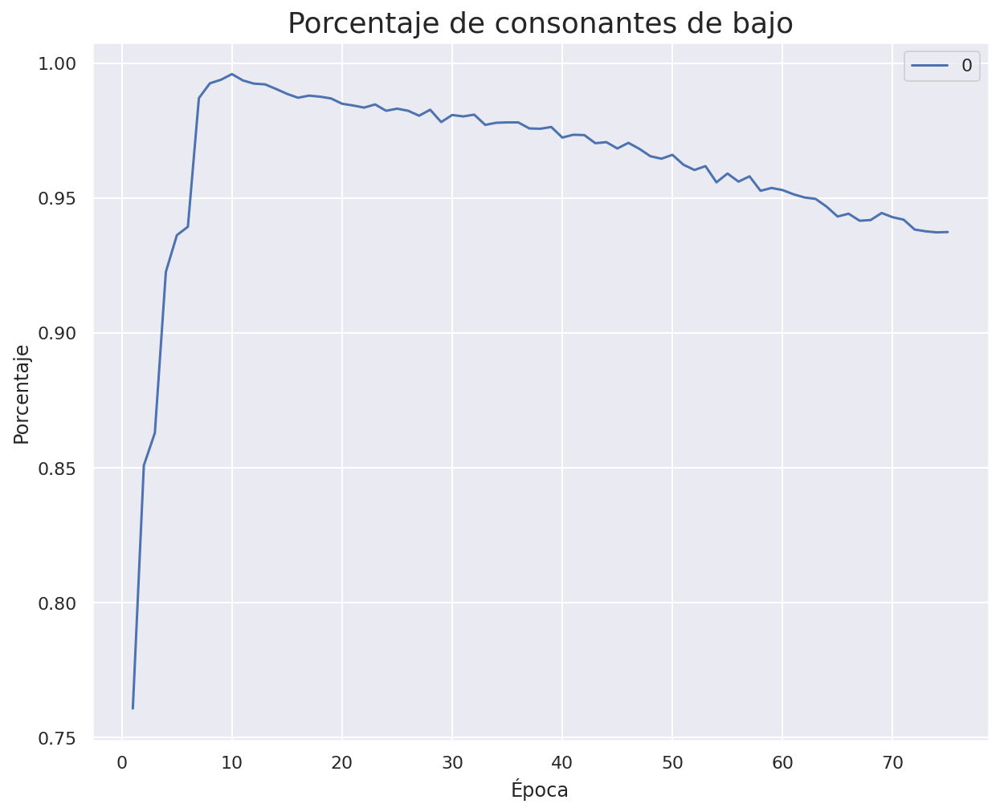

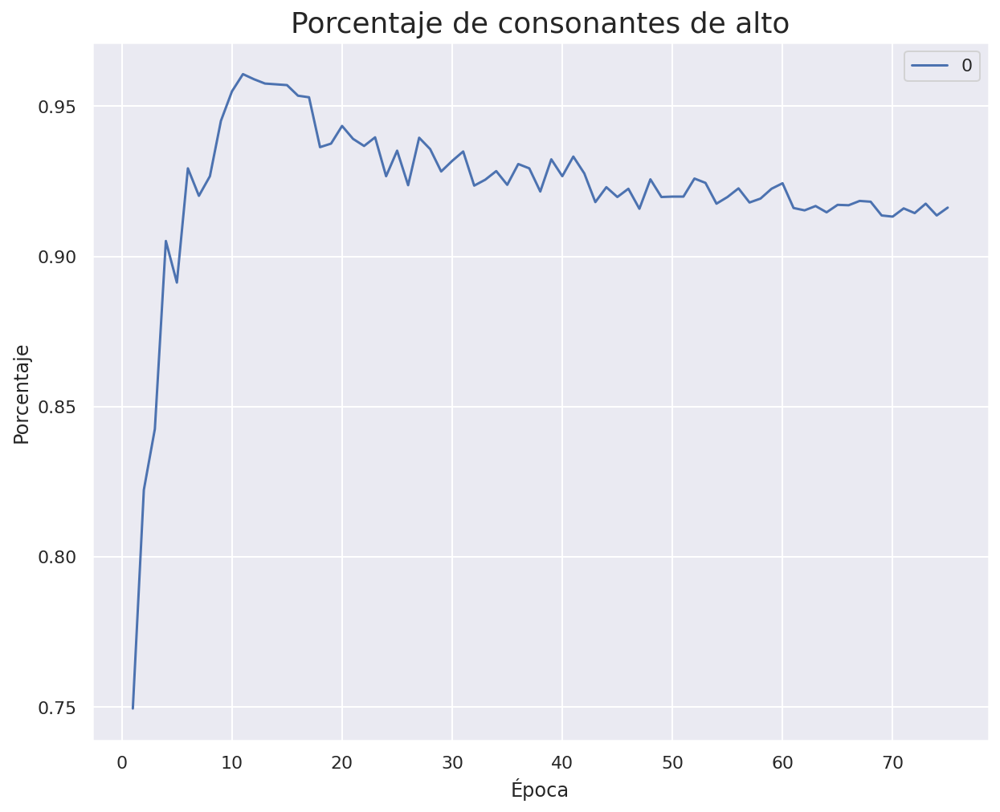

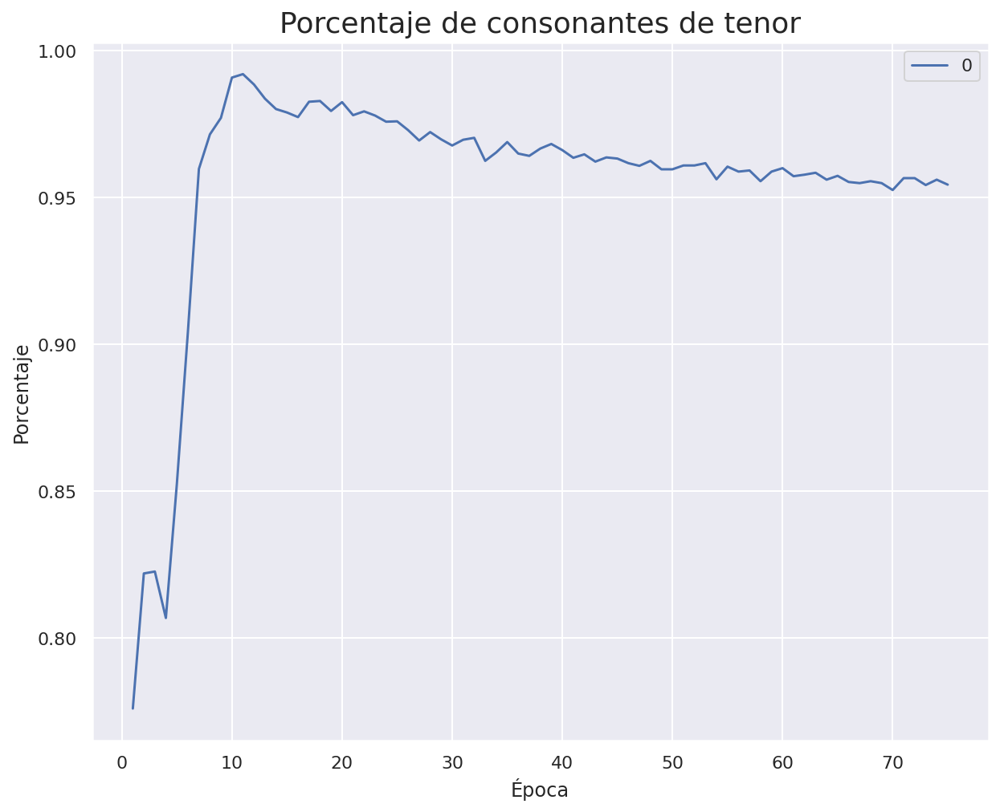

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_94 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_94 (LSTM)                 (None, 57)           18696       ['embedding_94[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

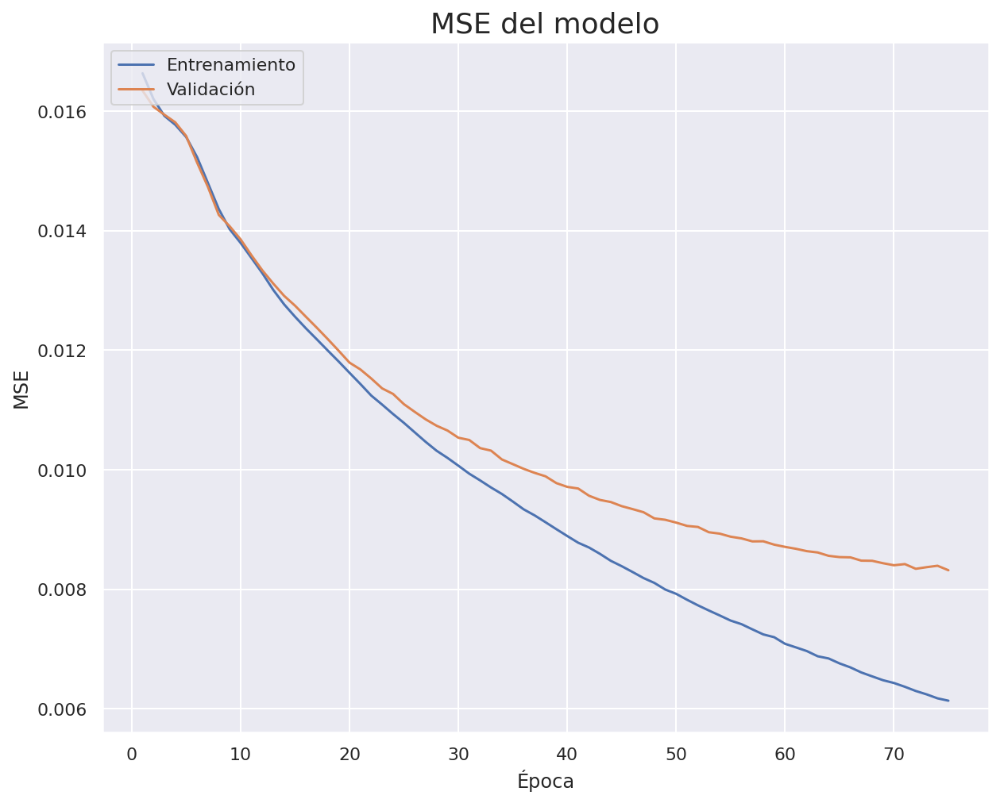

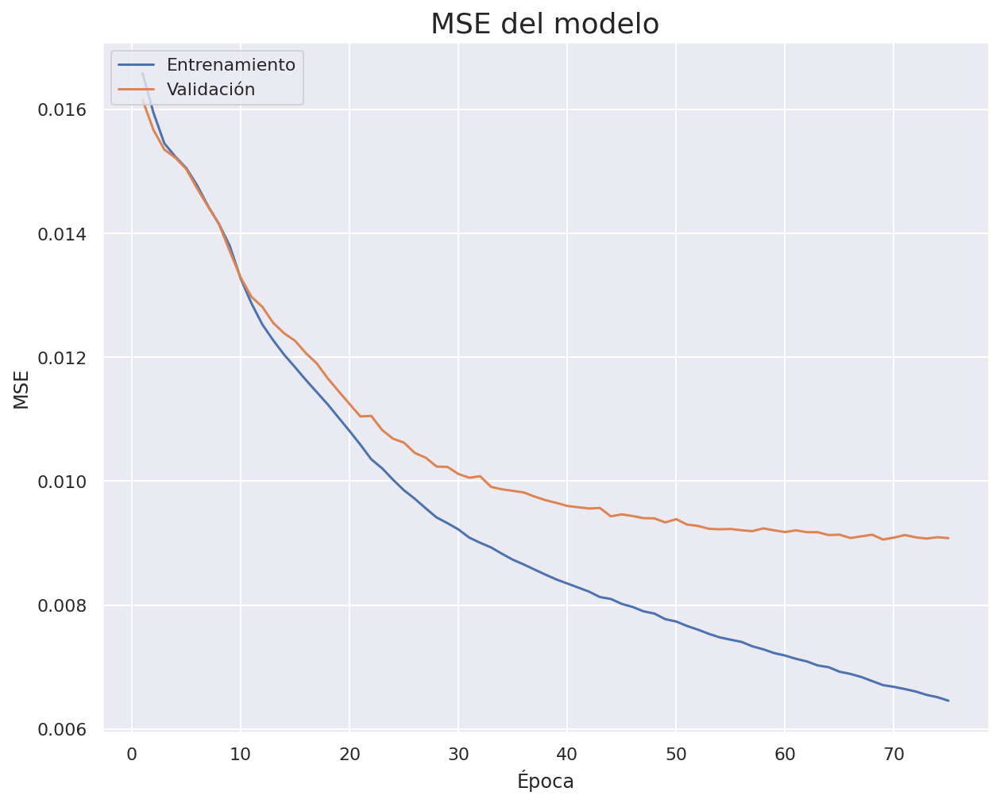

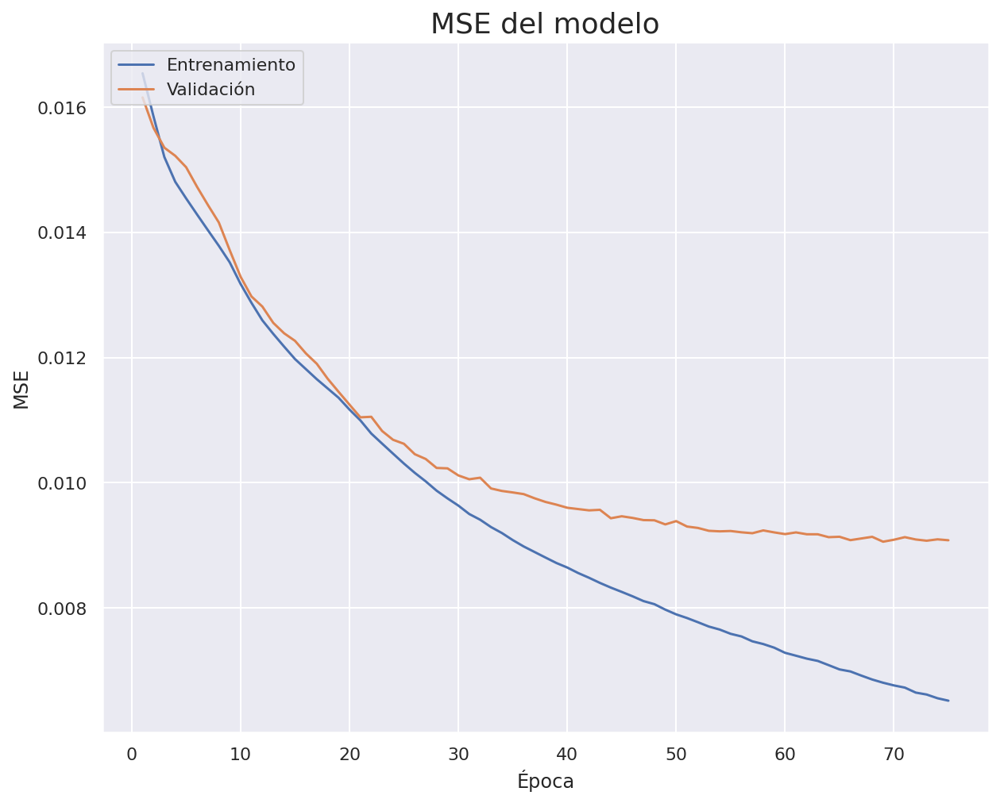

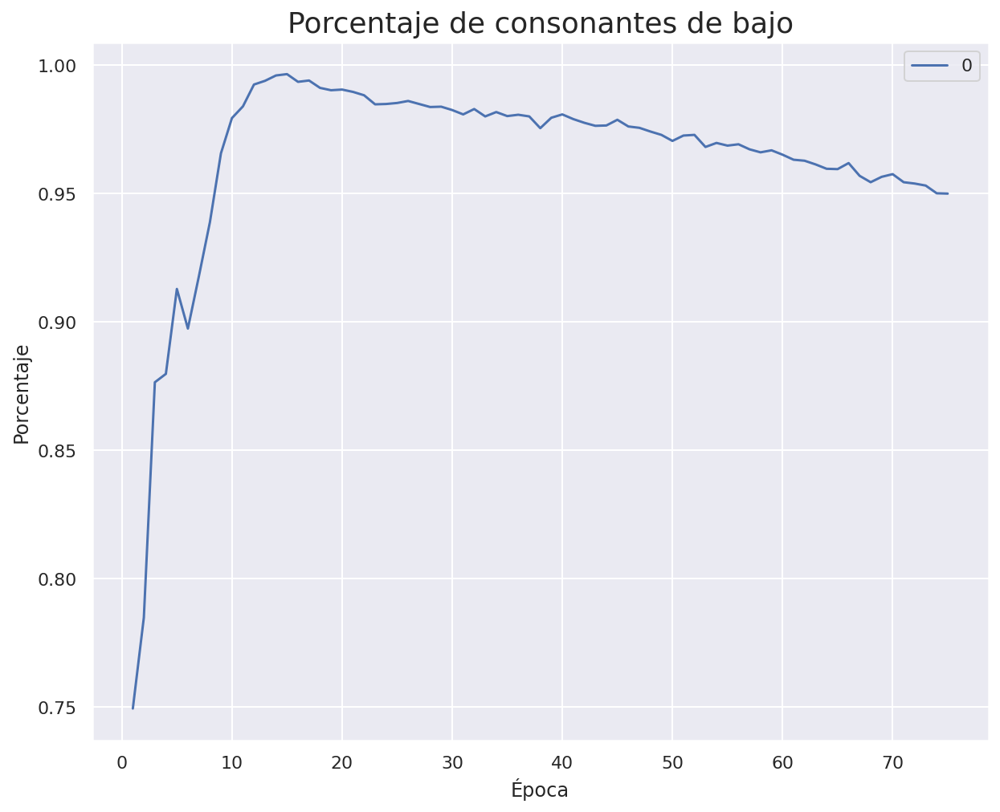

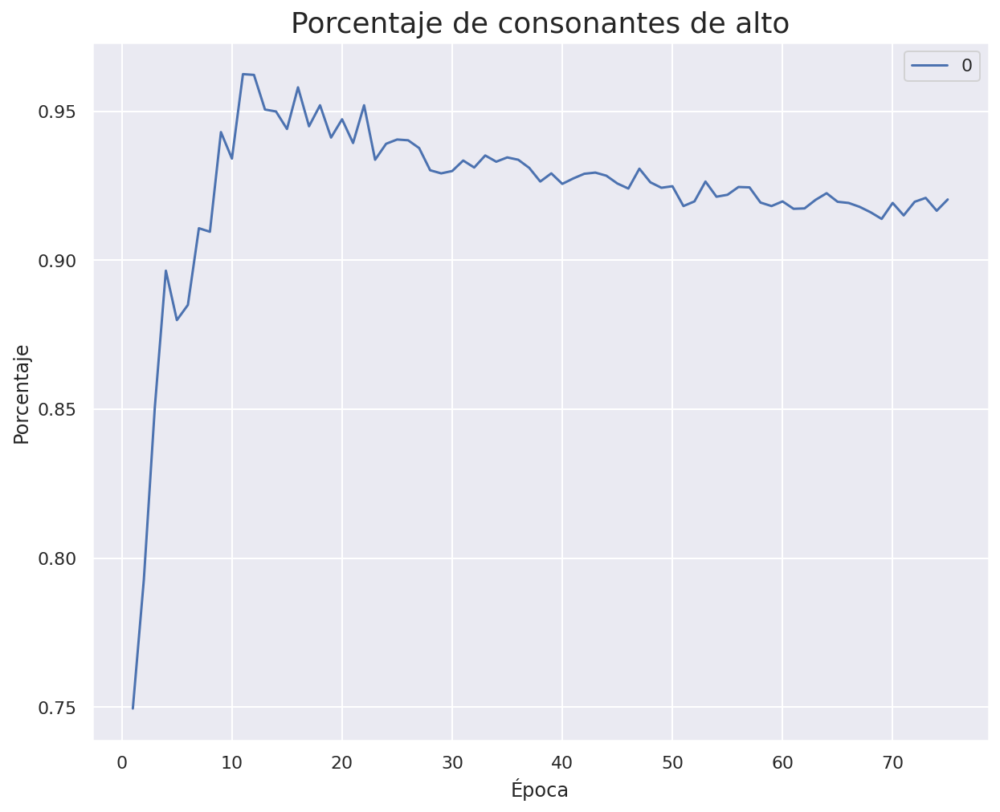

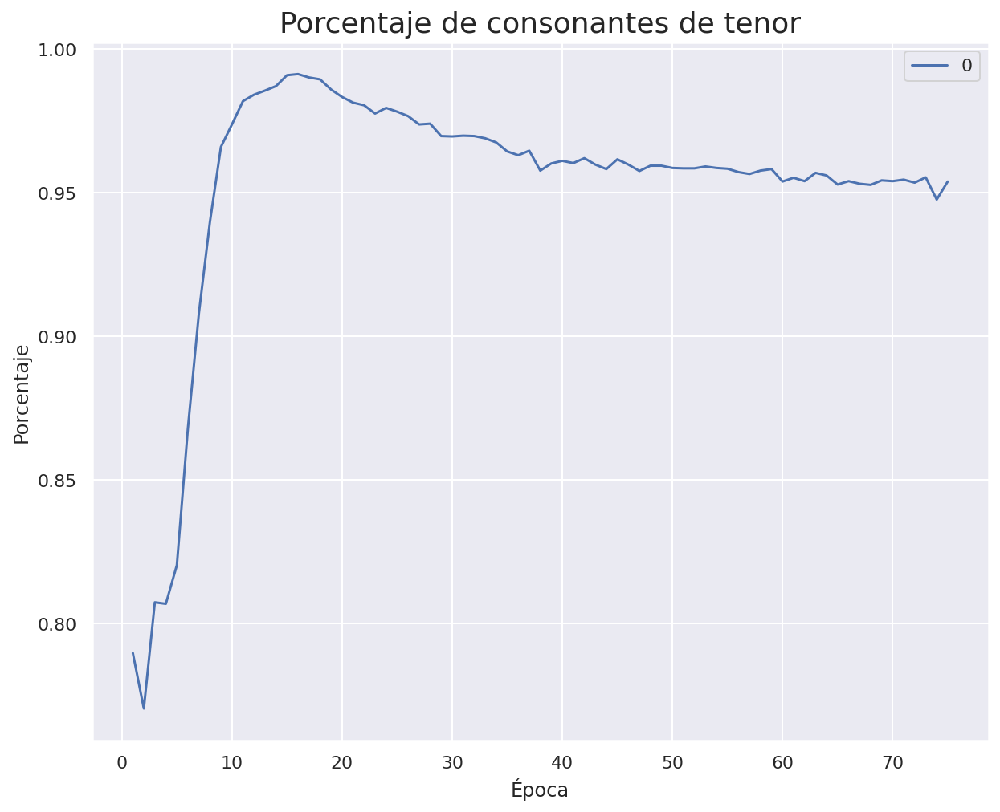

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_96 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_96 (LSTM)                 (None, 58)           19256       ['embedding_96[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

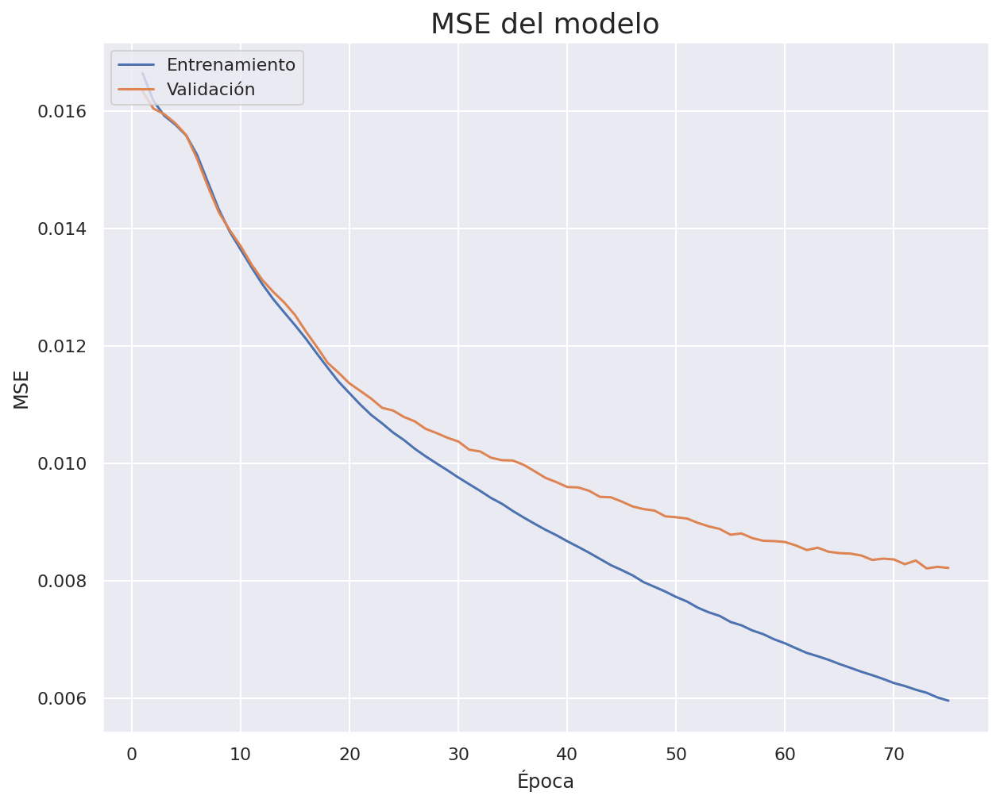

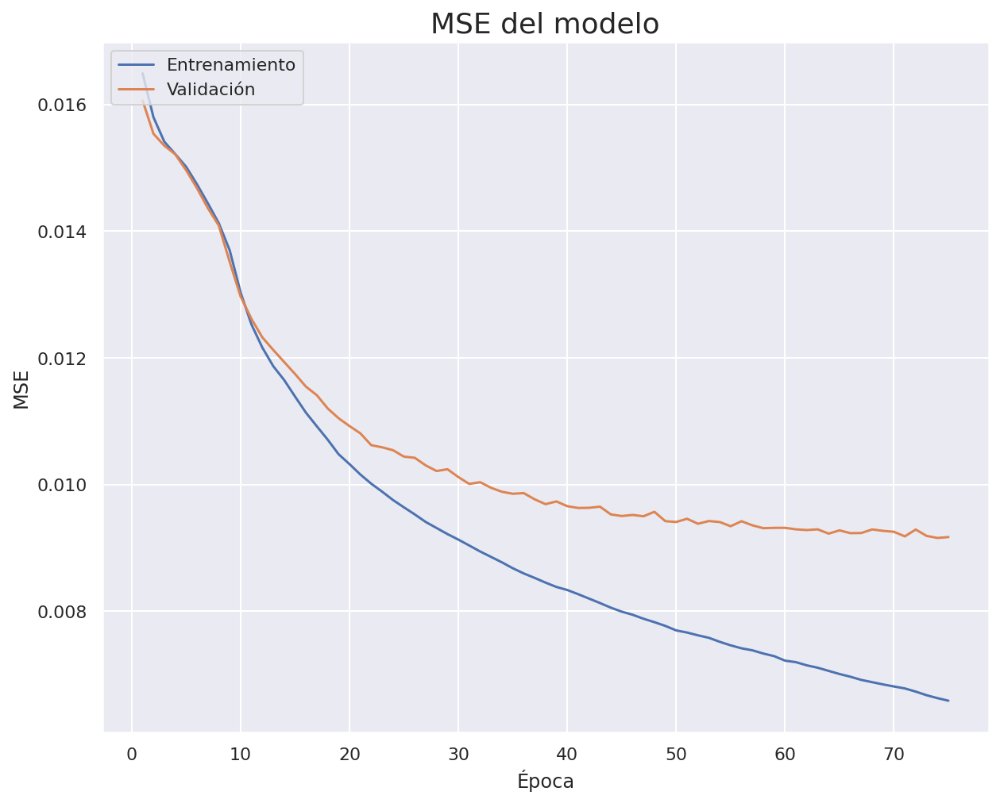

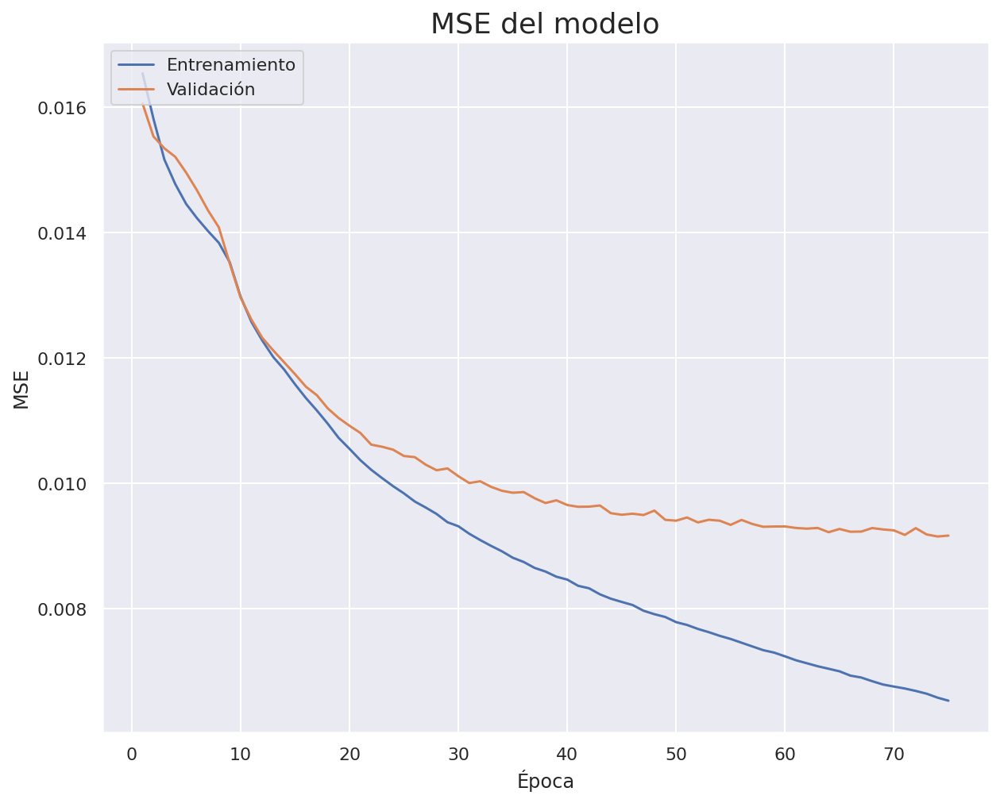

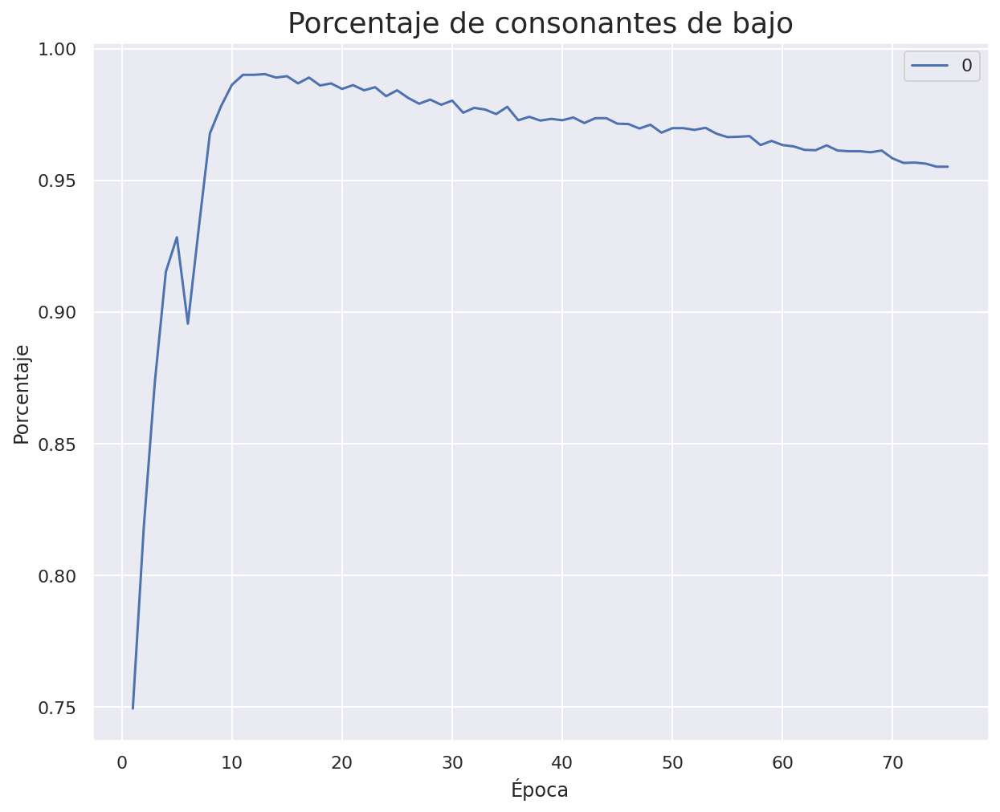

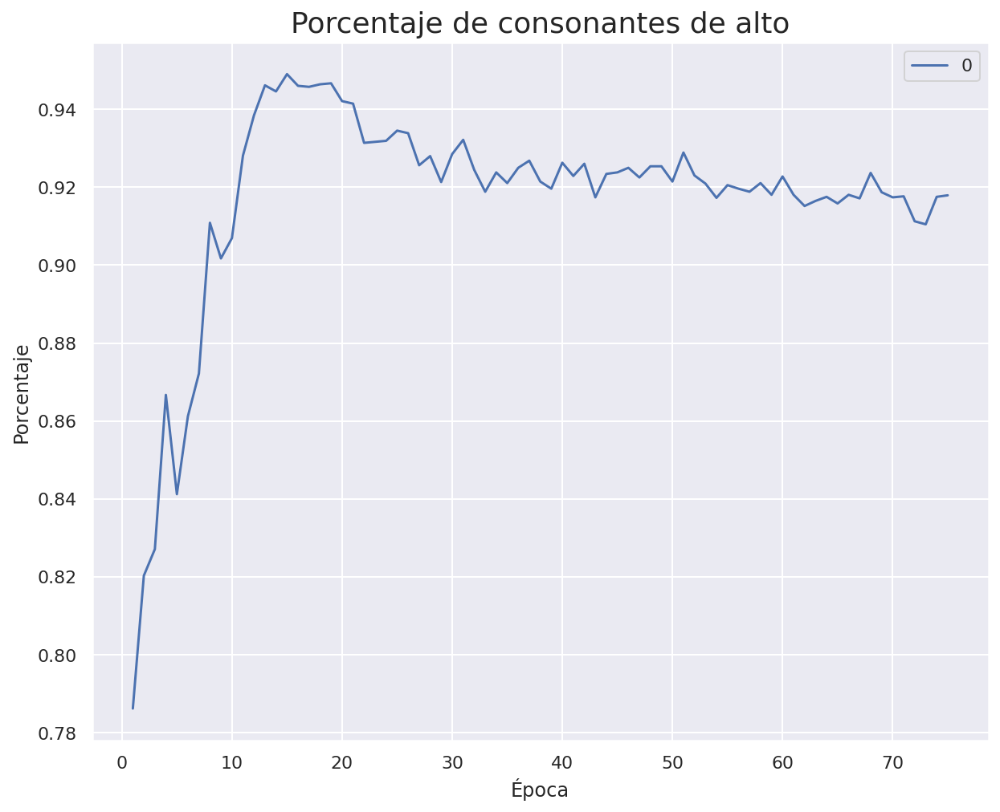

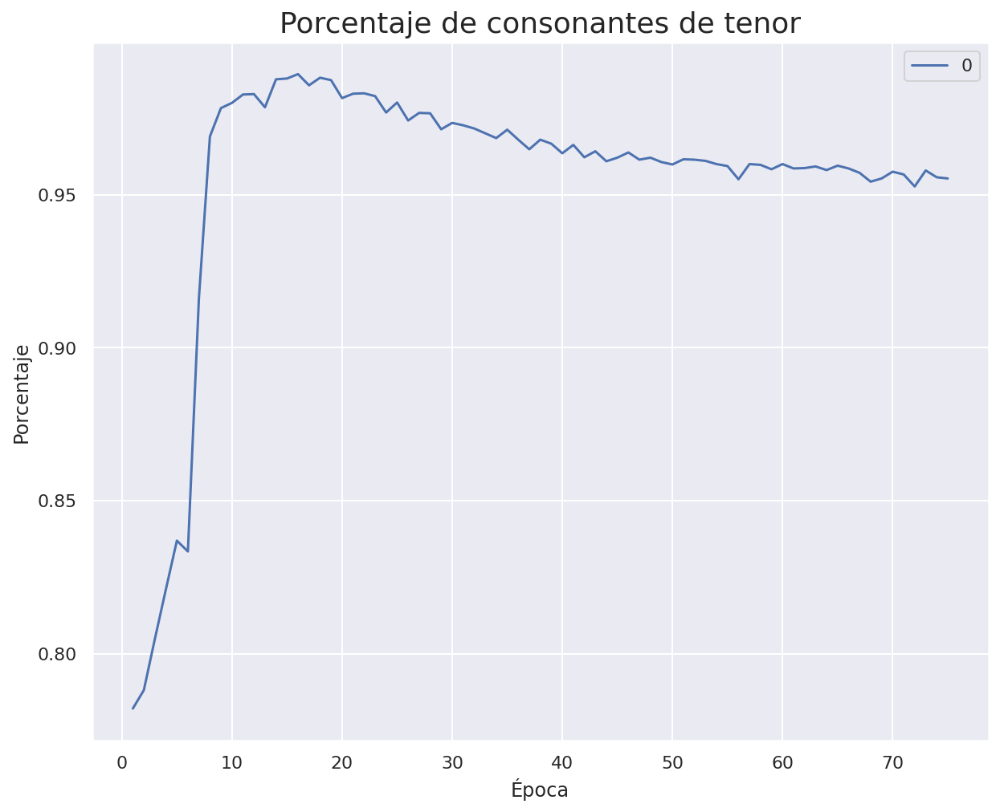

75 75 75 75
Model: "embed"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 corales (InputLayer)           [(None, 16)]         0           []                               
                                                                                                  
 embedding_98 (Embedding)       (None, 16, 24)       1368        ['corales[0][0]']                
                                                                                                  
 lstm_98 (LSTM)                 (None, 59)           19824       ['embedding_98[0][0]']           
                                                                                                  
 soprano (InputLayer)           [(None, 4)]          0           []                               
                                                                                  

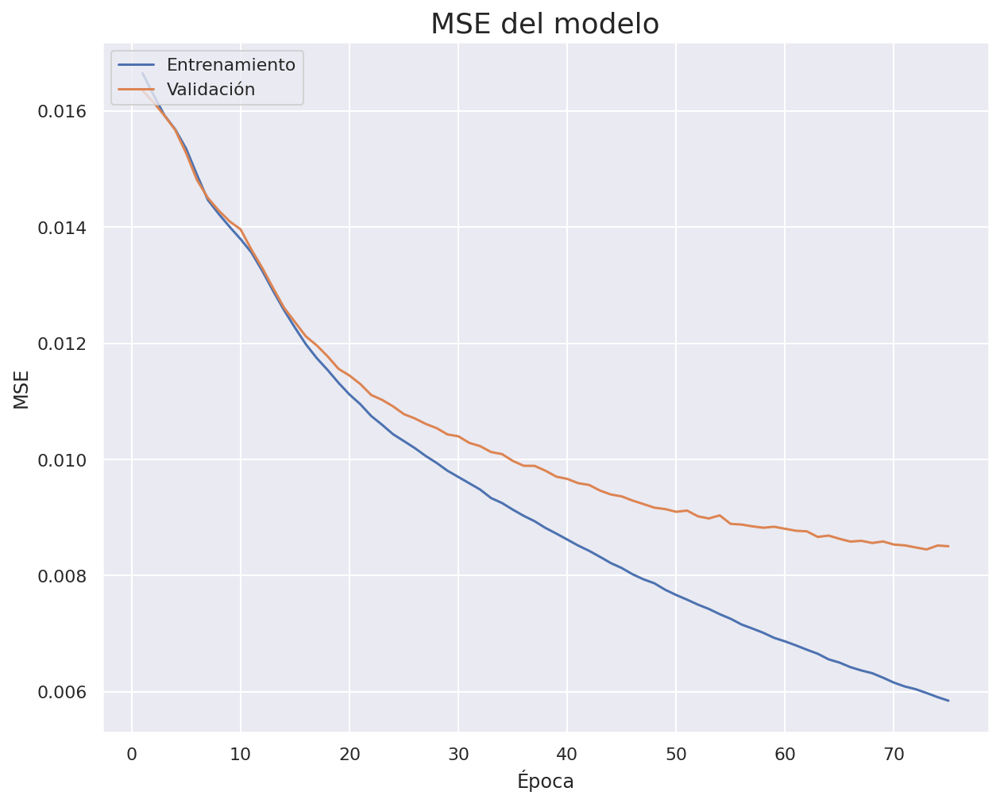

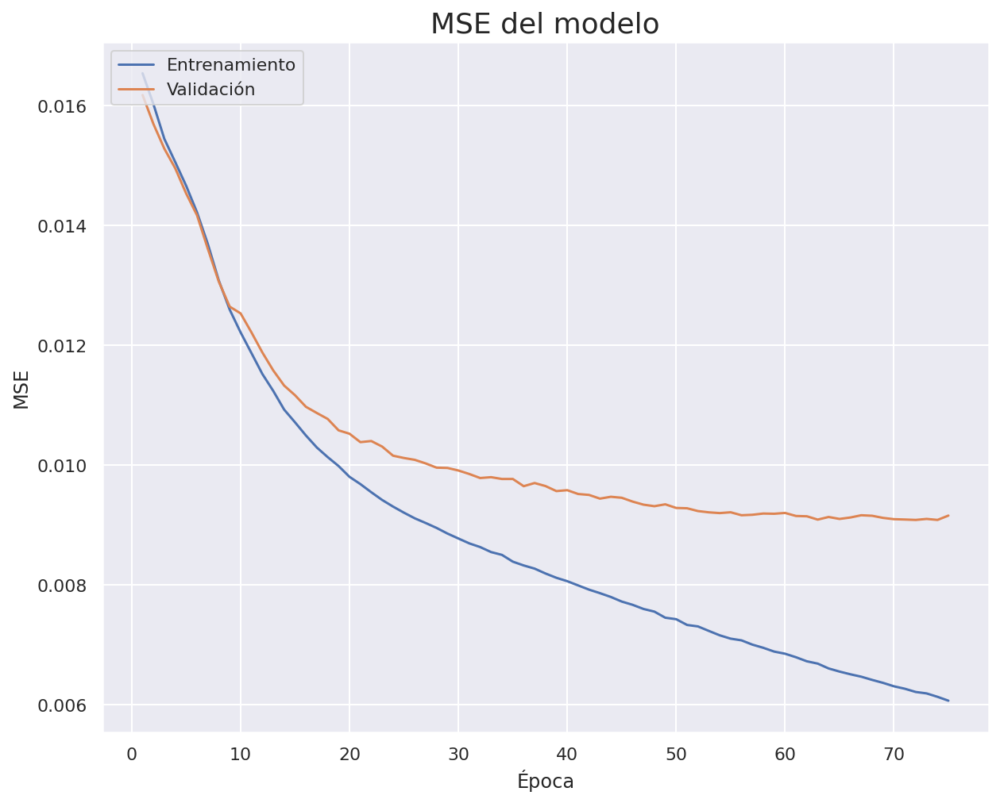

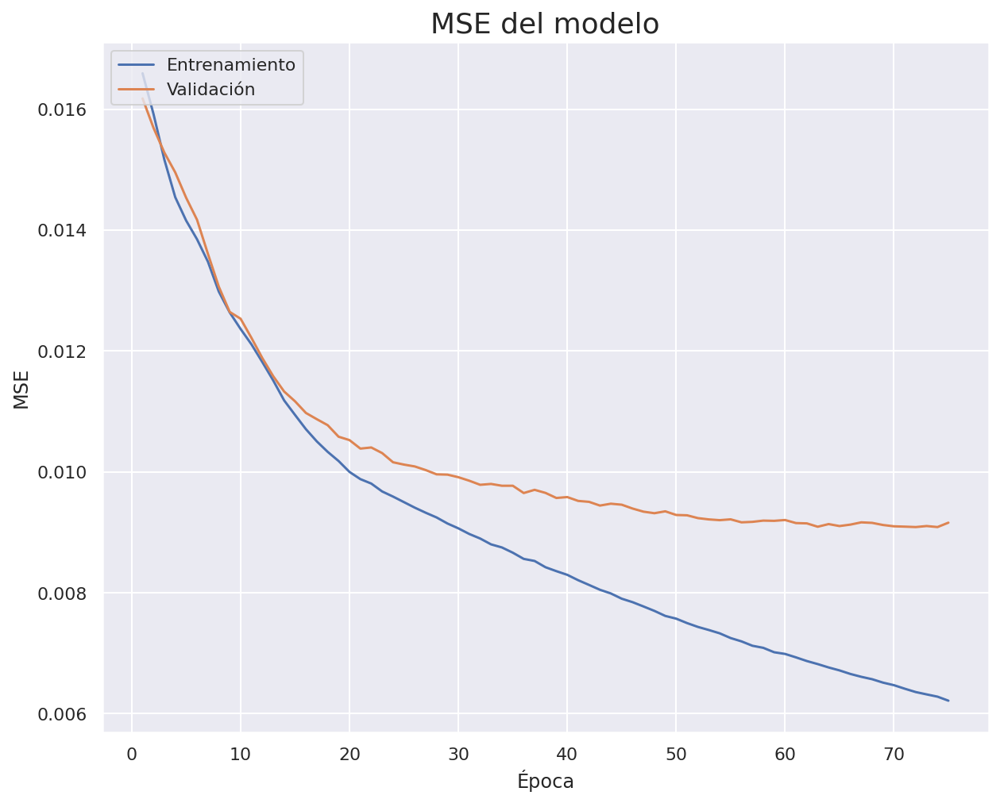

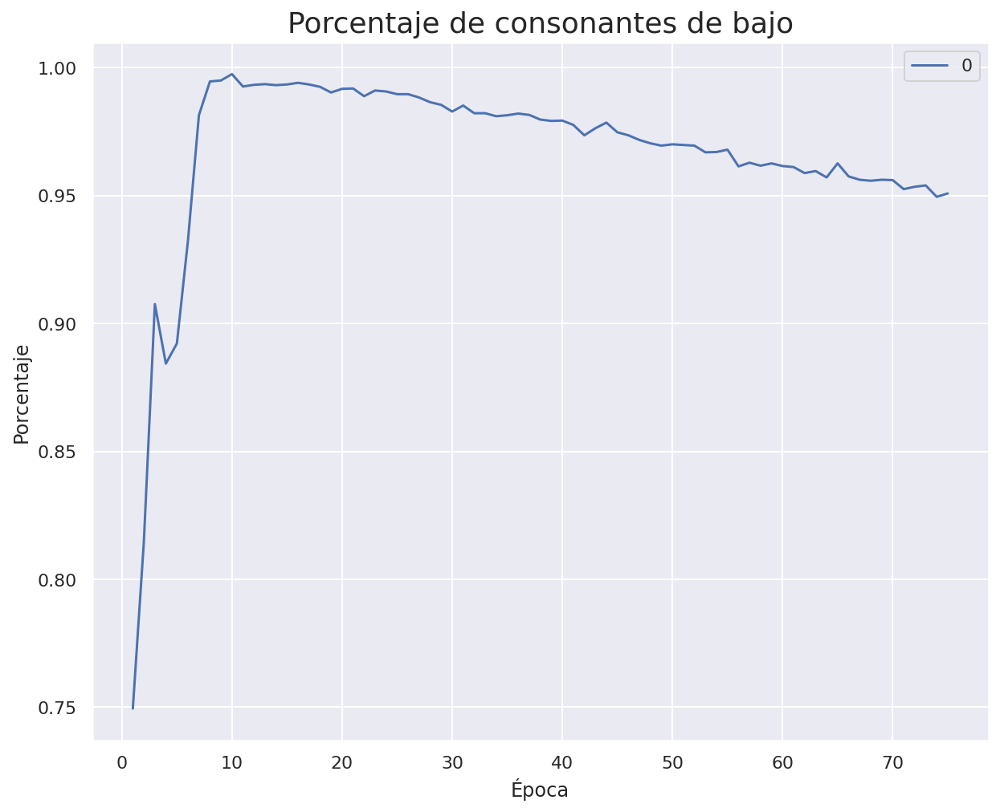

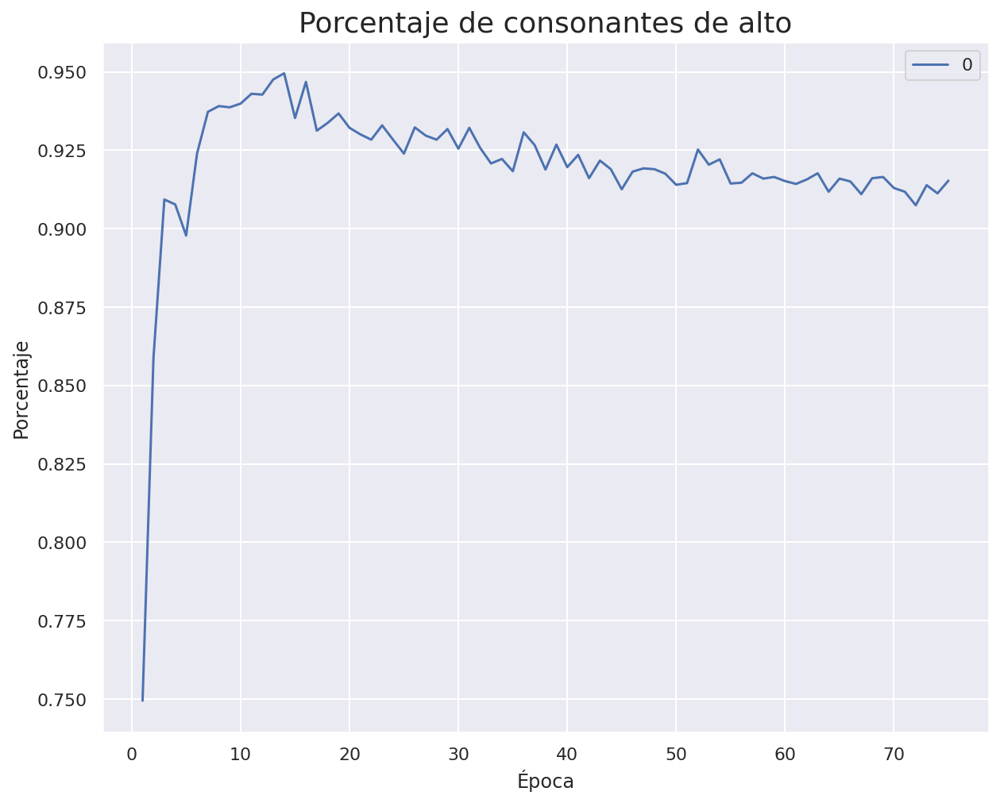

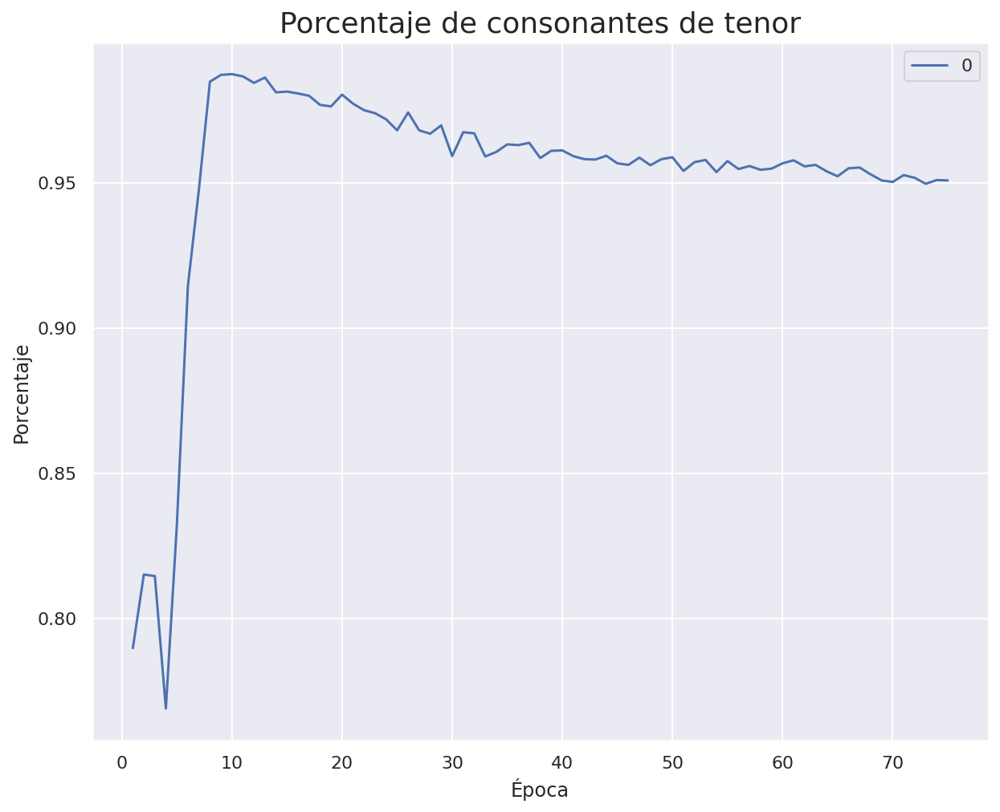

75 75 75 75


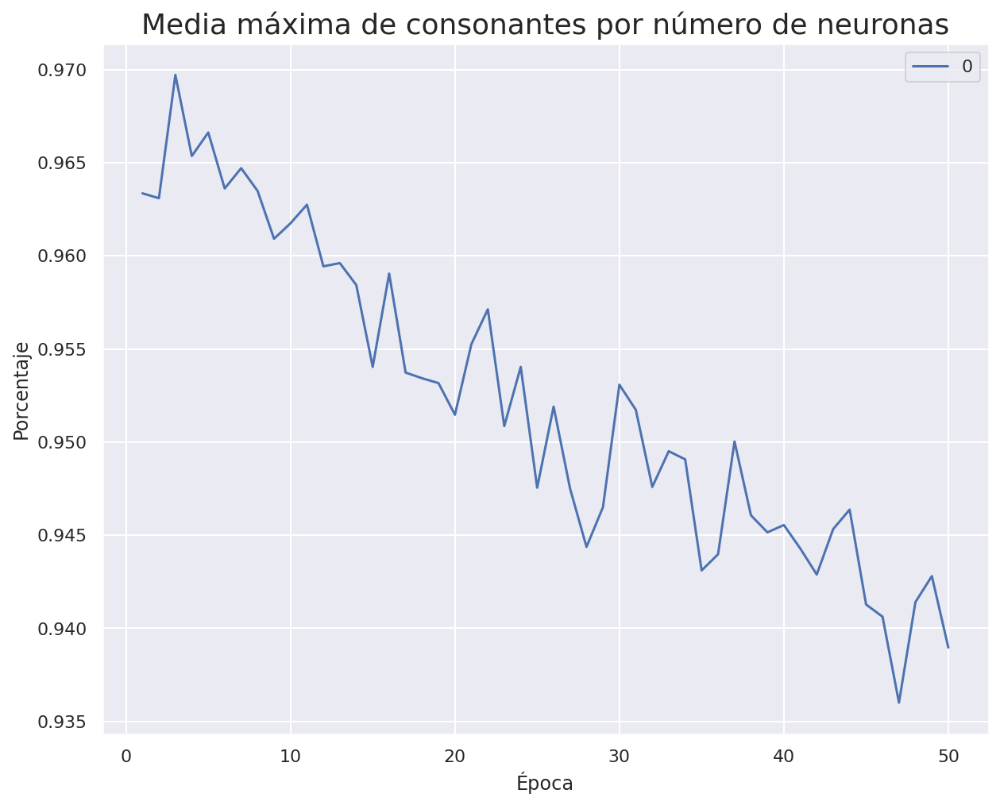

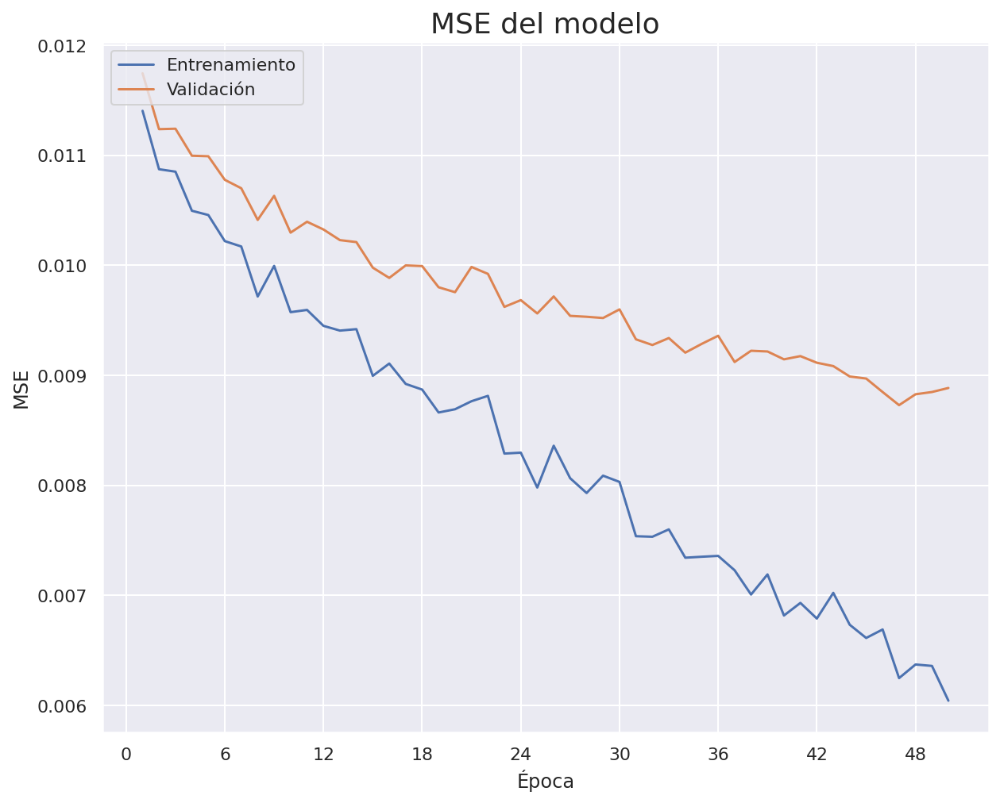

In [ ]:
epoch_gen = 0
media_con = 0
acum_media = []
acum_mse_tra = []
acum_mse_val = []
for num_neu in range(10,60):
    input_1 = keras.Input(shape=(num_notas*4),name='corales')
    input_2 = keras.Input(shape=(num_notas),name='soprano')

    layers_1 = layers.Embedding(int(np.unique(embed)[-1]) + 1,24)(input_1)
    layers_1 = layers.LSTM(num_neu)(layers_1)
    layers_1 = layers.RepeatVector(num_notas)(layers_1)

    layers_2 = layers.Embedding(int(np.unique(embed)[-1]) + 1,24)(input_2)
    red_final = layers.concatenate([layers_1,layers_2])

    red_final = LSTM(num_neu,return_sequences=True)(red_final)
    output_1 = layers.Dense(n_notas, activation='softmax',name='bajo')(red_final)
    output_2 = layers.Dense(n_notas, activation='softmax',name='alto')(red_final)
    output_3 = layers.Dense(n_notas, activation='softmax',name='tenor')(red_final)

    model = keras.Model([input_1,input_2],[output_1,output_2,output_3],name="embed")
    model.summary()

    keras.utils.plot_model(model, "embed.png", show_shapes=True)

    # lstm bidireccional
    # ver si ha escrito lo de bach
    log_path = 'log/'

    tb_callback = TensorBoard(
    log_dir=log_path,
    histogram_freq=2,
    write_graph=True
    )
    tb_callback.set_model(model)
    callbacks = []
    callbacks.append(tb_callback)

    # A continuación se trata de crear el directorio log:
    # - Si no existe se crea
    # - Si ya existe se borran los datos que haya dentro de él

    try:
        os.mkdir(log_path)
    except:
        if OS_WINDOWS:
            !del log\*
    else:
        !rm log/*

    # Entrenamos la red neuronal para diferentes epocas
    # Batch nomalization
    # Model.save
    # Mirar accuaracy individualmente (buscar calculo del accuaracy)
    epochs = 75
    batch_size = 64
    control_sobreajuste_val = True
    grabar_detalles_training_para_tensorboard = True
    met_mod = None
    met_max = np.zeros(num_notas)
    met_epoch = np.zeros(num_notas)

    met_mod_1 = None
    met_max_1 = np.zeros(num_notas)
    met_epoch_1 = np.zeros(num_notas)

    met_mod_2 = None
    met_max_2 = np.zeros(num_notas)
    met_epoch_2 = np.zeros(num_notas)

    met_mod_con = None
    met_max_con = 0
    met_epoch_con = 0

    met_mod_con_1 = None
    met_max_con_1 = 0
    met_epoch_con_1 = 0

    met_mod_con_2 = None
    met_max_con_2 = np.zeros(num_notas)
    met_epoch_con_2 = np.zeros(num_notas)

    met_quin = None
    met_min_quin = np.ones(2)
    met_epoch_quin = np.zeros(2)
    # si no se van a analizar estos detalles en tensorboard mejor
    # poner este flag a False ya que el grabarlos enlentence
    # bastante el trainingmodel_current_best
    model.compile(loss=['categorical_crossentropy','categorical_crossentropy','categorical_crossentropy'],
            optimizer='adam',
            #optimizer=Adam(learning_rate=0.01), # más rápido
            metrics=['mse']) 

    if not control_sobreajuste_val:
        history = model.fit([embed_train[:-1],embed_sop_train[1:]],
                    y_train, epochs=epochs,
                    batch_size=batch_size, verbose=2)
    else:    
        acum_tr_mse = []
        acum_tr_mse_1 = []
        acum_val_mse = []
        acum_val_mse_1 = []
        acum_tr_mse_2 = []
        acum_val_mse_2 = []

        acum_met = []
        acum_met_1 = []
        acum_met_2 = []
        acum_met_con = []
        acum_met_con_1 = []
        acum_met_con_2 = []
        acum_met_quin = []
        filepath="model_current_best.h5"
        checkpoint = ModelCheckpoint(filepath, monitor='bajo_mse', verbose=2, 
                                    save_best_only=True,
                                    mode='min') # graba sólo los que mejoran en validación

        if grabar_detalles_training_para_tensorboard:
            callbacks_list = callbacks + [checkpoint]
        else:
            callbacks_list = [checkpoint]


        for e in range(epochs):
            aux_1 = embed_train
            aux_2 = embed_sop_train
            history = model.fit([aux_1[:-1],aux_2[1:]], 
                                [embed_baj_train_oh[1:],embed_alt_train_oh[1:],embed_ten_train_oh[1:]],
                                batch_size=batch_size,
                                epochs=1,
                                callbacks=callbacks_list,
                                verbose=0,
                                validation_data=([embed_val[:-1],embed_sop_val[1:]],
                                                    [embed_baj_val_oh[1:],embed_alt_val_oh[1:],embed_ten_val_oh[1:]]))



            [prediccion,prediccion_1,prediccion_2] = model.predict([embed_test,embed_sop_test])
            pred_buena = np.zeros((prediccion.shape[0],prediccion.shape[1]))
            for i in range(pred_buena.shape[0]):
                for j in range(pred_buena.shape[1]):
                    max_m = np.max(prediccion[i][j])
                    pred_buena[i][j] = np.where(prediccion[i][j]==max_m )[0][0]
            res_prediction = to_nota(pred_buena,voc)

            met_con = metrica_consonante(res_prediction,to_nota(embed_sop_test,voc))
            acum_met_con.append(met_con)
            if met_con > met_max_con:
                print('Metrica consonante bajo mejorada de ' + str(met_max_con) + ' a ' + str(met_con))
                met_max_con = met_con
                met_mod_con = model
                model.save(path + str(num_neu) +'_met_mod_con.h5')
                met_epoch_con = epochs
                
            pred_buena = np.zeros((prediccion_1.shape[0],prediccion.shape[1]))
            for i in range(pred_buena.shape[0]):
                for j in range(pred_buena.shape[1]):
                    max_m = np.max(prediccion_1[i][j])
                    pred_buena[i][j] = np.where(prediccion_1[i][j]==max_m )[0][0]
            res_prediction_1 = to_nota(pred_buena,voc)

            met_con_1 = metrica_consonante(res_prediction_1,to_nota(embed_sop_test,voc))
            acum_met_con_1.append(met_con_1)
            if met_con_1 > met_max_con_1:
                print('Metrica consonante alto mejorada de ' + str(met_max_con_1) + ' a ' + str(met_con_1))
                met_max_con_1 = met_con_1
                met_mod_con_1 = model
                model.save(path + str(num_neu) +'_met_mod_con_1.h5')
                met_epoch_con_1 = e

            pred_buena = np.zeros((prediccion_2.shape[0],prediccion.shape[1]))
            for i in range(pred_buena.shape[0]):
                for j in range(pred_buena.shape[1]):
                    max_m = np.max(prediccion_2[i][j])
                    pred_buena[i][j] = np.where(prediccion_2[i][j]==max_m )[0][0]
            res_prediction_2 = to_nota(pred_buena,voc)

            met_con_2 = metrica_consonante(res_prediction_2,to_nota(embed_sop_test,voc))
            acum_met_con_2.append(met_con_2)
            if np.sum(met_con_2) > np.sum(met_max_con_2):
                print('Metrica consonante tenor mejorada de ' + str(met_max_con_2) + ' a ' + str(met_con_2))
                met_max_con_2 = met_con_2
                met_mod_con_2 = model
                model.save(path + str(num_neu) +'_met_mod_con_2.h5')
                met_epoch_con_2 = e
            acum_tr_mse  += history.history['bajo_mse'] # mean_squared_error
            acum_val_mse += history.history['val_bajo_mse'] # val_mean_squared_error

            acum_tr_mse_1  += history.history['tenor_mse'] # mean_squared_error
            acum_val_mse_1 += history.history['val_tenor_mse'] # val_mean_squared_error

            acum_tr_mse_2  += history.history['alto_mse'] # mean_squared_error
            acum_val_mse_2 += history.history['val_tenor_mse'] # val_mean_squared_error

    grafica_entrenamiento(acum_tr_mse, acum_val_mse,"final_cons_bajo_mse" + str(num_neu))
    grafica_entrenamiento(acum_tr_mse_1, acum_val_mse_1,"final_cons_alto_mse" + str(num_neu))
    grafica_entrenamiento(acum_tr_mse_2, acum_val_mse_2,"final_cons_tenor_mse" + str(num_neu))
    grafica_metrica(acum_met_con,"Porcentaje de consonantes de bajo","final_cons_bajo_cons" + str(num_neu))
    grafica_metrica(acum_met_con_1,"Porcentaje de consonantes de alto","final_cons_alto_cons" + str(num_neu))
    grafica_metrica(acum_met_con_2,"Porcentaje de consonantes de tenor","final_cons_tenor_cons" + str(num_neu))

    epoch_neu = 0
    if met_epoch_con > met_epoch_con_1:
        if met_epoch_con_2 > met_epoch_con:
            epoch_neu = met_epoch_con_2
            model_baj = keras.models.load_model(path + str(num_neu) +'_met_mod_con_2.h5')
        else:
            epoch_neu = met_epoch_con
            model_baj = keras.models.load_model(path + str(num_neu) +'_met_mod_con.h5')
    else:
        if met_epoch_con_2 > met_epoch_con_1:
            epoch_neu = met_epoch_con_2
            model_baj = keras.models.load_model(path + str(num_neu) +'_met_mod_con_2.h5')
        else:
            epoch_neu = met_epoch_con_1
            model_baj = keras.models.load_model(path + str(num_neu) +'_met_mod_con_1.h5')
    print(epoch_neu,len(acum_met_con),len(acum_met_con_1),len(acum_met_con_2))
    media = acum_met_con[epoch_neu-1] + acum_met_con_1[epoch_neu-1] + acum_met_con_2[epoch_neu-1]

    training_mse_model_min = min(np.array(acum_tr_mse) + np.array(acum_tr_mse_1) + np.array(acum_tr_mse_2))
    val_mse_model_min = min(np.array(acum_val_mse) + np.array(acum_val_mse_1) + np.array(acum_val_mse_2))

    acum_media.append(media/3)
    acum_mse_tra.append(training_mse_model_min/3)
    acum_mse_val.append(val_mse_model_min/3)

    if media > media_con:
        media_con = media
        epoch_gen = num_neu

keras.utils.plot_model(model, graf_path + "final_cons.png", show_shapes=True)
grafica_metrica(acum_media,"Media máxima de consonantes por número de neuronas","final_cons")
grafica_entrenamiento(acum_mse_tra, acum_mse_val,"final_cons")

In [ ]:
print(epoch_gen,media_con)

12 2.9091740721380033
